In [1]:
#下面这行代码，是为了把自己编写的代码文件当作一共模块导入，这里是把Utilities文件夹中的plotting.py文件当作python的模块导入，对应的是下面的from plotting import newfig, savefig。路径要随着不同设备的系统做相应的修改
import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../Utilities/') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。



In [2]:
num_gpus = torch.cuda.device_count()
print('Number of available GPUs: ', num_gpus)

for i in range(num_gpus):
    torch.cuda.set_device(i)
    allocated = torch.cuda.memory_allocated()
    reserved = torch.cuda.memory_reserved()
    print('GPU {}: {}, Allocated: {}, Reserved: {}'.format(i, torch.cuda.get_device_name(i), allocated, reserved))

Number of available GPUs:  1
GPU 0: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0


In [3]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [4]:
# the deep neural network
class DNN(torch.nn.Module):
    #第一个方法
    def __init__(self, layers):
        super(DNN, self).__init__() #调用父类的__init__方法进行初始化
        
        # parameters
        self.depth = len(layers) - 1 #定义名为depth的属性，表示神经网络的深度，等于层数-1
        
        # set up layer order dict
        self.activation = torch.nn.Tanh #设置激活函数为tanh
         
        layer_list = list() #定义一个空列表layer_list
        for i in range(self.depth - 1):  #循环depth次
            #将每一层（全连接层）添加到layer_list中
            layer_list.append(
                ('layer_%d' % i, torch.nn.Linear(layers[i], layers[i+1]))
            )
            #将每一层的激活函数添加到layer_list中
            layer_list.append(('activation_%d' % i, self.activation()))

        #循环结束后，将最后一层的线性变换添加到layer_list中（因为没有激活函数了）
        layer_list.append(
            ('layer_%d' % (self.depth - 1), torch.nn.Linear(layers[-2], layers[-1]))
        )
        #然后使用OrderedDict将layer_list中的元素转换为有序字典
        layerDict = OrderedDict(layer_list)
        
        # deploy layers，将layerDict转换为一个神经网络模型，赋值给self.layers
        self.layers = torch.nn.Sequential(layerDict)
    
    #第二个方法，定义了模型的前向传播过程
    def forward(self, x):  #接收输入x
        out = self.layers(x) #将输入x传入神经网络模型self.layers中，得到输出out
        return out #返回输出out
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        # 遍历每一层，直到最后一个隐藏层
        for i in range(self.depth - 1):
            # 获取当前层的线性变换
            x = self.layers[i*2](x)
            # 获取当前层的激活函数
            x = self.layers[i*2 + 1](x)
        # 返回最后一个隐藏层的输出
        return x

In [ ]:
#set the class of PINN

#定义了一个名为`PhysicsInformedNN'的类，用于实现基于物理的神经网络。
class PhysicsInformedNN:
    # Initialize the class
    def __init__(self, x0, u0, tb, X_f, layers, lb, ub, X_star, u_star): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数
        
        
        #`numpy.concatenate`是一个用于数组拼接的函数。它可以将多个数组沿指定的轴拼接在一起，形成一个新的数组：numpy.concatenate((a1,a2, ...), axis=0)其中，`a1,a2, ...`是需要拼接的数组（只能接受数组或序列类型的参数，且参数形状必须相同），可以是多个。`axis`参数用于指定拼接的轴向，`axis=0`表示沿着第一个轴（即行）进行拼接，不指定`axis`参数默认值是0。
        X0 = np.concatenate((x0,0*x0), 1) # [x0, 0],将x0和0*x0两个数组在第二个维度（即列）上进行了合并。0*x0会生成一个与x0形状相同，但所有元素都为0的数组。因此，X0的结果是一个新的二维数组，其中第一列是x0的值，第二列全为0
        X_lb = np.concatenate((0*tb+lb[0],tb), 1) # [lb[0], tb],将0*tb+lb[0]和tb两个数组在第二个维度（即列）上进行了合并。0*tb+lb[0]会生成一个与tb形状相同，但所有元素都为lb[0]的数组。因此，X_lb的结果是一个新的二维数组，其中第一列全为lb[0]的值，第二列是tb的值。
        X_ub = np.concatenate((0*tb+ub[0],tb), 1) # [ub[0], tb],同上生成一个与tb形状相同，但所有元素都为ub[0]的数组。因此，X_ub的结果是一个新的二维数组，其中第一列全为ub[0]的值，第二列是tb的值
        
        #Python使用self关键字来表示类的实例。当在类的方法中定义一个变量时，例如lb和ub，这些变量只在该方法内部可见，也就是说它们的作用域仅限于该方法。当方法执行完毕后，这些变量就会被销毁，无法在其他方法中访问它们。但如果希望在类的其他方法中也能访问这些变量就需要将它们保存为类的实例属性。这就是self.lb和self.ub的作用。
            #通过将lb和ub赋值给self.lb和self.ub，就可以在类的其他方法中通过self.lb和self.ub来访问这些值。总的来说，self.lb和self.ub是类的实例属性，它们的作用域是整个类，而不仅仅是定义它们的方法。
        self.lb = torch.tensor(lb).float().to(device) #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.ub = torch.tensor(ub).float().to(device)


        self.x0 = torch.tensor(X0[:,0:1], requires_grad=True).float().to(device) #将X0的第一列赋值给self.x0（:表示取所有行,0：1实际上表示取第一列，因为python是左闭右开的）,将X0的第二列赋值给self.t0。这样可以在类的其他方法中通过self.x0和self.t0来访问这些值。
        self.t0 = torch.tensor(X0[:,1:2], requires_grad=True).float().to(device) #将x0的第二列赋值给self.t0

        self.x_lb = torch.tensor(X_lb[:,0:1], requires_grad=True).float().to(device) #将X_lb的第一列赋值给self.x_lb
        self.t_lb = torch.tensor(X_lb[:,1:2], requires_grad=True).float().to(device) #将X_lb的第二列赋值给self.t_lb

        self.x_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第一列赋值给self.x_ub
        self.t_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第二列赋值给self.t_ub
        
        self.x_f = torch.tensor(X_f[:,0:1], requires_grad=True).float().to(device) #将X_f的第一列赋值给self.x_f
        self.t_f = torch.tensor(X_f[:,1:2], requires_grad=True).float().to(device) #将X_f的第二列赋值给self.t_f
        
        self.u0 = torch.tensor(u0).float().to(device) #将传入的u0和v0参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u0和self.v0来访问这些值。


        self.x_star = torch.tensor(X_star[:,0:1], requires_grad=True).float().to(device) #将X_star的第一列赋值给self.x_star
        self.t_star = torch.tensor(X_star[:,1:2], requires_grad=True).float().to(device) #将X_star的第二列赋值给self.t_star
        self.u_star = torch.tensor(u_star).float().to(device) #将传入的u_star和v_star参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u_star和self.v_star来访问这些值。
        
        
        # Initialize NNs 
        self.layers = layers #将传入的layers参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.layers来访问这些值。
        
        
        # deep neural networks
        self.dnn = DNN(layers).to(device) #创建一个DNN类的实例，传入layers参数来实现神经网络的初始化，然后将这个实例移动到指定的设备上



        # optimizers: using the same settings，这里是使用pytorch库进行优化的部分
        #创建优化器optimizer，使用LBFGS算法，具体每个参数意义见下方
        self.optimizer_LBFGS = torch.optim.LBFGS(
            self.dnn.parameters(), #要优化的参数，这里返回的是一个生成器，包含了self.dnn中的所有参数（神经网络权重、偏置以及两个新加的变量）
            lr=1.0,  #学习率设置为1
            max_iter=50000,  #最大迭代次数为50000
            max_eval=50000,  #最大评估次数为50000
            history_size=50, #历史大小为50，即用于计算Hessian矩阵近似的最近几步的信息
            tolerance_grad=1e-5,  #优化的第一个停止条件，当梯度的L2范数小于1e-5时停止优化
            tolerance_change=1.0 * np.finfo(float).eps, #优化的第二个停止条件，当优化的目标函数值的变化小于1.0 * np.finfo(float).eps时停止优化
            line_search_fn="strong_wolfe"       # 制定了用于一维搜索的方法，这里表示用强Wolfe条件
        )
        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())
                

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

        self.test_error = [] #创建一个空列表，用于存储测试误差
    
    #这个函数与下面的net_u函数功能相同，只是不计算梯度，因为在记录每个epoch的error时，使用with torch.no_grad()情况下调用net_u函数会报错，不知道为啥？
    def net_u_error(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        
        return u #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #pytorch中
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_u(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u

        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]

        return u,u_x #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f(self, x, t):
        """ The pytorch autograd version of calculating residual """

        u,u_x=self.net_u(x,t) #调用上面的函数/方法，计算神经网络的输出（两个）以及输出关于输入x的梯度（两个）
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度

        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f=u_t-0.0001*u_xx+5*u**3-5*u    #计算f,定义见论文

        return f  #返回计算得到的f


    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）

        u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
        u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
        u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
        f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

        loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        
        self.iter += 1 #每调用一次损失函数，迭代次数加1


        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

        #record the test error
        self.dnn.eval() #将神经网络切换为评估模式
        with torch.no_grad():
            u_real_pred = self.net_u_error(self.x_star, self.t_star)

        error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
        
        self.test_error.append(error_test)
        

        return loss #返回loss



    
    #定义了一个名为train的函数/方法，用于训练神经网络。这个方法接受一个参数nIter，表示训练的迭代次数。
    def train(self, nIter, nIterLBFGS):
        self.dnn.train()#将神经网络设置为训练模式而不是评估模式

        #先使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
            u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
            u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
            f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

            loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            

            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中
            

            #record the test error
            self.dnn.eval() #将神经网络切换为评估模式
            with torch.no_grad():
                u_real_pred = self.net_u_error(self.x_star, self.t_star)

            error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
            
            self.test_error.append(error_test)



        #Backward the optimize，使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.optimizer_LBFGS.step(self.loss_func)  #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入计算损失函数的方法self.loss_func，进行优化   

                                    
    #定义了一个名为predict的函数/方法，用于预测神经网络的输出。这个方法接受一个参数X_star，表示输入数据。最后返回预测的两个输出和两个输出的梯度。
    def predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        u, _ = self.net_u(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        f = self.net_f(x, t) 

        u = u.detach().cpu().numpy() #将张量u和v先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        f = f.detach().cpu().numpy()

        return u, f 
    
    #定义函数获得隐藏层的输出
    def hidden_predict(self, x,t):
        x = torch.tensor(x, requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(t, requires_grad=True).float().to(device)
        self.dnn.eval() #将神经网络切换为评估模式
        hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=1)) #调用上一个神经网络类中的hidden_output方法，得到最后一个隐藏层的输出
        hidden_output_x = hidden_output[:, 0] #将输出的第一列赋值给hidden_output_x
        hidden_output_t = hidden_output[:, 1] #将输出的第二列赋值给hidden_output_t
        hidden_output_x = hidden_output_x.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        hidden_output_t = hidden_output_t.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        return hidden_output_x, hidden_output_t #返回隐藏层的输出


In [6]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [7]:
#定义根据模型计算给定输入（点集中的点）的混沌度的函数，这个函数接受三个参数，分别是模型、输入数据和迭代次数
def calculate_chaos(model, X, num_iter):
    """
    计算模型混沌情况的函数。
    参数:
    - model: 用于预测的模型对象，必须有一个名为hidden_predict的方法。模型的hidden_predict为倒数第二层的输出，倒数第二层的维度必须和输入维度相同。
    - X: 输入数据，形状为(N_f_new, 2)，其中第一列为x0，第二列为t0。
    - num_iter: 计算混沌情况的迭代次数。
    返回:
    - distances: 每个采样点（与该采样点加上微扰比较）在最后一次迭代后的欧氏距离数组，形状为(N_f_new,)。
    """
    #对于所有的采样点
    x0 = X[:, 0:1] #取X_f_train_new的第一列，赋值给x0，(N_f_new,1)形状
    t0 = X[:, 1:2] #取X_f_train_new的第二列，赋值给t0
    # 利用x0和t0计算x{t}和t{t}，存储在xs中
    xs = [] #初始化xs
    x,t = model.hidden_predict(x0,t0) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    
    # 迭代预测
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        xs.append([x,t]) #将x的数据添加到xs中
    #最后得到的xs是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应原始采样点的迭代结果


    # 给所有采样点加上一个很小的扰动
    x1 = x0 + np.random.normal(0, 0.0001) #加上一个很小的扰动，(N_f_new,1)形状
    t1 = t0 + np.random.normal(0, 0.0001)
    # 利用x0{1}和t0{1}计算x{t1}和t{t1}，存储在xs1中
    xs1 = [] #初始化xs1
    x,t = model.hidden_predict(x1,t1) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）

    # 迭代预测（扰动后）
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)
        xs1.append([x,t]) #将x的数据添加到xs1中
    #最后得到的xs1是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应加了扰动后的采样点的迭代结果

    # 计算最后一次迭代的隐藏层输出，即最后一次迭代的x和t
    last_iter_xs = np.array(xs[-1]) #转换为数组，便于之后计算距离
    last_iter_xs1 = np.array(xs1[-1])
    #这两个数组的形状均为(2,N_f_new,1)，第一个代表x和t，第二个代表N_f_new个样本点得到的结果，第三个代表1个数

    # 计算这两个点的欧氏距离
    distances = np.linalg.norm(last_iter_xs - last_iter_xs1, axis=0)
    #得到的是一个形状为（N_f_new,1）的数组，每个元素代表了两个点之间的欧氏距离，这里点在xt平面上

    distances = distances.flatten()

    #对distances进行归一化
    distances = distances / np.linalg.norm(distances)
    # 对distances进行归一化前，检查分母是否接近零
    # norm = np.linalg.norm(distances)
    # if norm < 1e-10:  # 1e-10是一个非常小的数，用于检测norm是否接近于零
    #     distances = np.zeros_like(distances)  # 如果分母接近0，将distances设置为全零数组，因为范数为0时，distances中的值想对于彼此几乎没有差异，意味着所有点都几乎处于同一混沌度水平
    # else:
    #     distances = distances / norm

    # 现在可以安全地根据distances对点进行排序，即使在所有值都相同的情况下

    return distances

In [ ]:
seeds = [0, 1, 12, 21, 123, 321, 1234, 4321, 12345, 54321]

#设置噪声水平为0
noise = 0.0        

# Doman bounds，定义两个一维数组lb和ub，问题域是一个二维空间，其中 x 的范围是 -5 到 5，t 的范围是 0 到 π/2(竖着的)
lb = np.array([-1.0, 0.0])
ub = np.array([1.0, 1.0])
#定义三个整数，分别表示初始条件点数量、边界条件点数量和配位点的数量（这些点用于训练神经网络）
N0 = 500
N_b = 100
N_f = 10000
#定义一个列表layers，其中包含了神经网络的层数和每一层的神经元数量
# layers = [2, 200, 200, 200, 200, 2, 1]
layers = [2,30,30,30,30,30,30,30,30,2,1]

#读取名为burgers_shock的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改 
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组         

###########################

#从0~数组x的行数(256)中随机选择N0个数，replace=False表示不允许重复选择，最后将这N0个数赋值给idx_x
idx_x = np.random.choice(x.shape[0], N0, replace=False)
#从x中选择N0个对应的行(idx_x对应的行)，最后将这N0行赋值给x0
x0 = x[idx_x,:]
#从Exact_u中选择N0个对应的行(idx_x对应的行)的第一列元素，最后将这N0个元素赋值给u0
# u0 = Exact[idx_x,0:1]
u0 = Exact[0:1,idx_x].T

#从0~数组t的行数中随机选择N_b个数，replace=False表示不允许重复选择，最后将这N_b个数赋值给idx_t
idx_t = np.random.choice(t.shape[0], N_b, replace=False)
#从t中选择N_b个对应的行(idx_t对应的行)，最后将这N_b行赋值给tb
tb = t[idx_t,:]

error = [] #创建一个空列表，用于存储误差

i = 0 #初始化i为0

nIter = 100000 #设置迭代次数为10000
nIterLBFGS = 100 #设置LBFGS迭代次数为500

for seed in seeds:
    set_seed(seed) #设置随机种子

    num_iter = 1000 #迭代次数（用于混沌度）
    #1.先训练一定次数（总次数/100）

    N_f_1 = N_f // 100 #将N_f除以100，得到的整数赋值给N_f_1
    #采样初步训练点
    X_f = lb + (ub-lb)*lhs(2, N_f_1) #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，返回的是一个形状为（$N_f$，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本$X_f$。



    #创建PINN模型并输入各种参数        
    model = PhysicsInformedNN(x0, u0, tb, X_f, layers, lb, ub, X_star, u_star)
    #获取当前时间并赋值给start_time          
    start_time = time.time()       
    #训练模型50000次         
    model.train(nIter//100, 0)

    #2.训练结束后，每总次数的1/100次训练，重新采样N_f//10个点，从中选出N_f//100个点加入训练
    for iter in range(nIter//100+1, nIter+1, nIter//100): #每500次迭代

        N_f_new = N_f_1 * 10 #重新总训练点数的1%个训练点的10倍
        # 生成新的X_f_new数据
        X_f_new = lb + (ub-lb)*lhs(2, N_f_new)

        #计算混沌情况
        distances = calculate_chaos(model, X_f_new, num_iter) #计算混沌度

        _, residual = model.predict(X_f_new)

        # 计算残差的绝对值
        abs_residual = np.abs(residual)
        #将二维数组转换为一维数组
        abs_residual = abs_residual.flatten()


        #对distances进行归一化
        distances = distances / np.linalg.norm(distances)

        #对abs_residual进行归一化
        abs_residual = abs_residual / np.linalg.norm(abs_residual)

        #计算信息量
        xinxi = distances + abs_residual

        # 找出绝对值最大的N_f_1个值的索引
        topk_indices = np.argpartition(xinxi, -N_f_1)[-N_f_1:] #该函数会对数组进行排序，使得指定的k个最大值出现在数组的最后k给位置上，并获取最后1000个元素

        # 使用这些索引来提取对应的数据
        X_f_topk = X_f_new[topk_indices]

        # 将这些数据添加到原来的训练数据中
        X_f = np.vstack((X_f, X_f_topk)) #与之前的训练数据合并

        # 更新模型中的X_f_train数据
        model.x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
        model.t_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)

        # 在更新数据后的模型上进行训练500次
        model.train(nIter//100, 0)


    model.train(0, nIterLBFGS) #训练模型500次

    #获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time                
    #打印训练所需时间
    print('Training time: %.4f' % (elapsed))





    #用训练好的模型进行预测，返回四个值（均为数组）    
    u_pred, f_pred = model.predict(X_star)

    #计算误差（基于2范数）        
    error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)
    print(np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2))

    #打印误差
    print('Error u: %e' % (error_u))

    #将误差添加到error列表中

    #计算误差（基于2范数）
    error.append(error_u) #计算误差，然后将误差添加到error列表中

    i += 1 #i加1
    print(f'当前为第{i}次循环，种子为{seed}')


# #使用griddata函数将X_star、u_pred、v_pred和h_pred插值到网格上，得到U_pred、V_pred和H_pred
# U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')

# #同上，使用griddata函数将X_star、f_u_pred和f_v_pred插值到网格上，得到FU_pred和FV_pred
# F_pred = griddata(X_star, f_pred.flatten(), (X, T), method='cubic')

#计算误差（基于2范数）        
print(np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2))
 


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:00<03:19,  7.50it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:13, 111.30it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:09, 152.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:08, 168.96it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 179.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 189.29it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 191.22it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.52it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.87it/s]


Adam:  12%|█▏        | 186/1500 [00:01<00:06, 199.15it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.96it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.80it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.89it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.16it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.56it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.70it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.99it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.44it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.17it/s]


Adam:  26%|██▌       | 390/1500 [00:02<00:05, 201.00it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.41it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.79it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.65it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.24it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 202.85it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 205.03it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 206.78it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 203.44it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 200.47it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 199.13it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 198.46it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.04it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 200.73it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.29it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.13it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.09it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.52it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.15it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.10it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.05it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.72it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.07it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.43it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.01it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.34it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 189.80it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.12it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 194.43it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.06it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.40it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.81it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.43it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.01it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.11it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.31it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.44it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.67it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 202.84it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 203.00it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.86it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.39it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.73it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.56it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.25it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.13it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.82it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.88it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 198.09it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.57it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.24it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.26it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.04it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]

/tmp/ipykernel_3198001/1414517622.py:59: RuntimeWarning: invalid value encountered in divide
  distances = distances / np.linalg.norm(distances)



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.20it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.10it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.16it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.42it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.68it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.45it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.84it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.34it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.88it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.06it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.26it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.17it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 199.88it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.02it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.61it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 199.87it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.32it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 200.40it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 203.03it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 204.88it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 205.78it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 206.94it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 203.62it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 200.10it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.65it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.23it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 196.94it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 193.38it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.87it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.48it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.15it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.85it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 200.35it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 201.37it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 201.07it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.47it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 202.11it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 202.51it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 202.89it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 203.47it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 204.79it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 206.78it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 206.19it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 206.64it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 205.71it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 206.97it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 205.30it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 204.28it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 206.14it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 207.68it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 208.53it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 209.36it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 206.72it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 207.93it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 204.12it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 205.93it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 207.21it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 208.09it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 208.81it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 209.28it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 205.61it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.84it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.89it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 207.04it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 205.61it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 205.07it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 206.74it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 207.80it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 208.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.52it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 207.87it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.11it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.98it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.28it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 210.88it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 210.48it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 210.53it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 205.60it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 206.36it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 206.45it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 205.15it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 203.62it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 205.41it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 206.61it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 207.71it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 204.73it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 205.56it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 206.67it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 207.91it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 205.65it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 206.96it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 207.80it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 208.29it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 208.84it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 209.28it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 209.41it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 182.52it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.21it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.21it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.81it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 200.49it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 203.43it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 205.21it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 206.76it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 207.60it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 208.30it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 208.59it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 209.14it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 206.98it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 203.81it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.21it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 206.18it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.06it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 208.10it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.50it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 205.78it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 207.17it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.09it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.59it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.04it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.40it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.24it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.47it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.50it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 207.14it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 207.63it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 208.63it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 206.04it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 207.02it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.19it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 209.01it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 209.51it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 210.08it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 209.35it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 209.66it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 209.64it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 209.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.40it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 206.36it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 206.76it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.13it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.78it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 204.17it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.01it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.64it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 204.25it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 206.47it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 206.89it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 207.30it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 208.50it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 207.38it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 200.92it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 201.50it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 199.82it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 198.81it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 202.51it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 204.99it/s]


Adam:  31%|███       | 468/1500 [00:02<00:04, 206.89it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 207.58it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 208.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 205.10it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 205.89it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 207.51it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 208.11it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 205.73it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.04it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.29it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.41it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.66it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.25it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.32it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.53it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 200.19it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 200.64it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.94it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.90it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.19it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.31it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.16it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.11it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 190.11it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.97it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 193.56it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 194.71it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.57it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.83it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.84it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.67it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.30it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.13it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.31it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.45it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 196.15it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.25it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.76it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.78it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.47it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.40it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.40it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.76it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.60it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.08it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 192.04it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.06it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.11it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.57it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.85it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.19it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.89it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.49it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.79it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.69it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.60it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.00it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.81it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.86it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.60it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.71it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.11it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.48it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.28it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.46it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.83it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.74it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 200.46it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 200.17it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.25it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 198.23it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 197.17it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.31it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.56it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 198.08it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 196.52it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 197.91it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.48it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.05it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 194.43it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.49it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 195.76it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.30it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 197.77it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 201.17it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 200.12it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 197.34it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.95it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.43it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.69it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 198.37it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 199.99it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 202.24it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 200.97it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 202.31it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 203.32it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 203.85it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 201.26it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.79it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.00it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.79it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.12it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.65it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 203.55it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.51it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.59it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.53it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.60it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.08it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.10it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.74it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.99it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 196.36it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.53it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.95it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 200.92it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 200.59it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 201.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.83it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.54it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.75it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.40it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.86it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.64it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.07it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.45it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.37it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.58it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.93it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.51it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 194.15it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 194.88it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.16it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.23it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.62it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.74it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 196.49it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.06it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.01it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.49it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.57it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 203.05it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 200.62it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.92it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.88it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 199.47it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 199.47it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.24it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 199.65it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.97it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.10it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.79it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 201.53it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.36it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 201.00it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 201.89it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.08it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 202.41it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 200.93it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 203.05it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 198.71it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.19it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 198.32it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.01it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.91it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.42it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.14it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.65it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 195.31it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.50it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.04it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.51it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 198.79it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.63it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 200.41it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 200.31it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 199.48it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 200.55it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 199.22it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.95it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 191.02it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 194.24it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.80it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.36it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 195.09it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 196.31it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.98it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.21it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.80it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.51it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.78it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.11it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.56it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.99it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.86it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.09it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.49it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.57it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.62it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.24it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.91it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.83it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.75it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 196.59it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.31it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.93it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.32it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.76it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 202.53it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 204.60it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 206.64it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 207.16it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 207.91it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 208.63it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 209.22it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 209.07it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 207.23it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 207.82it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 208.80it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 209.40it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 210.13it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:02, 210.36it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 208.07it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.01it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 205.90it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 206.56it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.76it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 206.41it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.18it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.24it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.81it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.99it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.80it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.73it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.37it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.66it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.81it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.88it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.50it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.10it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.17it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 203.84it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 204.84it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 201.61it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 199.69it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 197.20it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 195.51it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.55it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.79it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.74it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.70it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.81it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.99it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.46it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.40it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.02it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.53it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.57it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.61it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.48it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.04it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.41it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.71it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.65it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.85it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.31it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.63it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.81it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.06it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 201.78it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.57it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.02it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.89it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.24it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.90it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.15it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.12it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 190.08it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 188.49it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:04, 189.88it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.25it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.53it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 201.08it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 203.40it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 200.78it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 199.17it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.30it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.12it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.02it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.76it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.86it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 197.61it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.16it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.26it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.63it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.29it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.10it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 201.97it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.59it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.59it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 201.40it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 201.49it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.55it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.56it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.15it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.43it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.43it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.82it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.56it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.57it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.66it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.24it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 197.86it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.28it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.53it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.20it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.85it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 211.20it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 207.07it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 208.99it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.97it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.48it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 208.34it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 208.53it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 208.04it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 208.84it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:05, 207.46it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 208.45it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 209.14it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 207.17it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 206.80it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 207.34it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 208.22it/s]


Adam:  27%|██▋       | 410/1500 [00:01<00:05, 208.32it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 208.95it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 206.79it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 203.47it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.44it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 198.60it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 200.22it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 201.41it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 193.16it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 196.01it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.28it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 182.55it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 189.01it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.21it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.79it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.80it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.01it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.44it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.44it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.14it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 199.54it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 202.80it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.53it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.27it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.34it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 205.79it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 205.43it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 206.05it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 205.06it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.11it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.22it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.09it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.31it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.33it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.58it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.87it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.44it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 201.13it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 202.47it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.14it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.73it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.49it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.08it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.70it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.06it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.28it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 198.15it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 197.58it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.05it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.23it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.56it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.45it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 205.19it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 206.80it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 204.76it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 206.00it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 207.35it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 208.52it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 206.96it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 207.85it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 208.84it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 209.40it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 210.07it/s]


Adam:  27%|██▋       | 407/1500 [00:01<00:05, 209.39it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 209.46it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 209.15it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 209.99it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 208.26it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 207.30it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 207.86it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 208.91it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 204.56it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 204.34it/s]


Adam:  41%|████▏     | 619/1500 [00:02<00:04, 202.30it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 204.87it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 206.55it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 207.91it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 208.81it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 209.48it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 209.21it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 209.54it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 205.82it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 207.14it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 206.18it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 207.20it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 208.19it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 208.98it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 209.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 209.67it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 210.01it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 201.00it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 197.18it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 196.41it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.79it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.48it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.05it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.56it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.34it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.33it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.93it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 207.40it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 208.24it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 208.98it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 209.59it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 209.94it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 209.60it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 209.96it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 206.62it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 203.52it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 201.58it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 199.18it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 181.61it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 189.88it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.49it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.63it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 202.86it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 202.31it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.38it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 201.40it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 198.16it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 200.45it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 200.97it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 199.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.58it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 197.97it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.81it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.19it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.50it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.73it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.78it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 203.68it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 201.64it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.20it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.65it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.50it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.82it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.35it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.73it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.91it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.76it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.51it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.65it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.16it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.48it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 198.07it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.28it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.81it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.06it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.62it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.36it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.69it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.34it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 189.88it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 188.83it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 195.20it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.74it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.72it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.87it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.97it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.13it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.18it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.04it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 203.65it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 205.35it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 202.92it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 202.08it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.31it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 200.52it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.20it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 200.74it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.89it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 201.30it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.96it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 201.70it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.48it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 202.61it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.08it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.98it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.99it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 207.32it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 201.35it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 200.44it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:07, 198.69it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 199.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.48it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.21it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.43it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.21it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 195.33it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 194.78it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.40it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 194.58it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 193.47it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.57it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.41it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 199.11it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 200.28it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 197.61it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.40it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 199.46it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 201.18it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.20it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.61it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.68it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.20it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.87it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 200.20it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 199.48it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.28it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.95it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.32it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.16it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.83it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.08it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.53it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.13it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.16it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 199.31it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 202.33it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.33it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.73it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.40it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 200.39it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 199.78it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.44it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 194.74it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 195.24it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.05it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.51it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.19it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.82it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.65it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 204.58it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 206.46it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 207.64it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 205.89it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 201.69it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 201.31it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.57it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.34it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.78it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.97it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.26it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.69it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.16it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.12it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.99it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.16it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.91it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.25it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.53it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.06it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.59it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.56it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.91it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.37it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.46it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.17it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.55it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.75it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 203.05it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 204.87it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.93it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 200.46it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 203.04it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 205.19it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 206.18it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 203.38it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.29it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 198.58it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.20it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.45it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 194.80it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.58it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 198.41it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.85it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.58it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.63it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.33it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.94it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 196.03it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.03it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 198.76it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.64it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.72it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.48it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.38it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.53it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.66it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.11it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.72it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.36it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.31it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.77it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.50it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.33it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.36it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.49it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.37it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.29it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.38it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.47it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 197.05it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.45it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 199.78it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 198.57it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 200.06it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.29it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.65it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.28it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.34it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.54it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.33it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.25it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.85it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.29it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.72it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.26it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.99it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.72it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 202.84it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 203.99it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 203.18it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.34it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.89it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.78it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 204.04it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 189.53it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 194.40it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.09it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.49it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 200.28it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.91it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.16it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.57it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.84it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.03it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.14it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.89it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.34it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.82it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 196.60it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.93it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.56it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.77it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.05it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.26it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.30it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.08it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.51it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.51it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 195.89it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 193.86it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.25it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.61it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.39it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.80it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.97it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 199.48it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.15it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.95it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.89it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.05it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.27it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.26it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.35it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.45it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.45it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 202.73it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.66it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 199.22it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.47it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.16it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.80it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 199.71it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.01it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 203.72it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.39it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 206.99it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 203.58it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 204.87it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 203.70it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 197.94it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 201.06it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 202.44it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 203.37it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 204.82it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 205.28it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 205.30it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 202.33it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 203.13it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 204.88it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 206.81it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 204.40it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 206.27it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 208.00it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 207.23it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 208.56it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 209.58it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 210.20it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 207.81it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 208.26it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 209.52it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 209.58it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 209.64it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 210.34it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 206.24it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.81it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.96it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 200.40it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.20it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.51it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.62it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.09it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 196.14it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.47it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.30it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.48it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 196.96it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 195.95it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.81it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.42it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 199.94it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 201.27it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 201.75it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.14it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.72it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 197.56it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 196.57it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.74it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.05it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.75it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.66it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.03it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.23it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.67it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.90it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 195.09it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 194.06it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.36it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.81it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.61it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.76it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.48it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.41it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.91it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.90it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.69it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.66it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.08it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.99it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.79it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.53it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.42it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.32it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.80it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.50it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 198.31it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.89it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.95it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.33it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 198.86it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.34it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 196.13it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.33it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.96it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.65it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 201.77it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.63it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 196.99it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 200.29it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.36it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.01it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 201.38it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.38it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.53it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.68it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.29it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.48it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.92it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.50it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.31it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 200.28it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.64it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.43it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.75it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 201.11it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 203.85it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 205.79it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 206.85it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 207.81it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 208.35it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 208.83it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 208.67it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 208.32it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 208.53it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 209.11it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 209.24it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 208.92it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 206.32it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 204.97it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 206.60it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 207.51it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 204.79it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 206.44it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 207.63it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 208.58it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 209.08it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 209.43it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 207.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.33it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.01it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.75it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.66it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.16it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.30it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.54it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.98it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.76it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.20it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.65it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.20it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.79it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.86it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.20it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.58it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.57it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.95it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.03it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.95it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.52it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.60it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.85it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.24it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.26it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.22it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.71it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.94it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.83it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.34it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.46it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.89it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 207.10it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.38it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.63it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.96it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.12it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 206.01it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.11it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.28it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.29it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.22it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.36it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 199.87it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.69it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.09it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.42it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.43it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.49it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.81it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.91it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 193.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 195.56it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 198.64it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.78it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.83it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.02it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.06it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.25it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.13it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.64it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 201.03it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 199.90it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.06it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.20it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.14it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 198.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.17it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.15it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.80it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.54it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.00it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.07it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.93it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.13it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.22it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.44it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.60it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.69it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.68it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.74it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.76it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.26it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.04it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.94it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.78it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 198.69it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.81it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.74it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.52it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.02it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.43it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 198.10it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.23it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.41it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.81it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.78it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.98it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.95it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.31it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.63it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.08it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.37it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.90it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.68it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.11it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 202.94it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 203.58it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 201.17it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.17it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.36it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 196.14it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.05it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.19it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 200.94it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.26it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 202.99it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.62it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 197.24it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.53it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 196.67it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 198.73it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.24it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.99it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.58it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.66it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.75it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 194.53it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 194.55it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.09it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 193.50it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.82it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.99it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.91it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.21it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 201.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.24it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.03it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.30it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.96it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.29it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.94it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.57it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.93it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.38it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.57it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.78it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.74it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.26it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.80it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 199.60it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.56it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.97it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.92it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.00it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.96it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.15it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.10it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 194.51it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 196.22it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 195.29it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.36it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 198.96it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.18it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.21it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 199.58it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 200.53it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 201.19it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 201.78it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.07it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.57it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 200.53it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.91it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.27it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.73it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.74it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 200.16it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 200.43it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 200.35it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 198.17it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.48it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.82it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.79it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 200.81it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 201.50it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 202.01it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 202.35it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 202.52it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.19it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.90it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 200.34it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 199.39it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.50it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.73it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.93it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.24it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.38it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.08it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.73it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 195.28it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 195.39it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.63it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.14it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.43it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 184.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.59it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.56it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.26it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.04it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.93it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.31it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.05it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.23it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.07it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.47it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.52it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.94it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.06it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.13it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 188.13it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 188.23it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:06, 189.28it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 191.55it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.07it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.12it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 194.02it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.17it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.09it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.04it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 194.14it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 192.46it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 188.35it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 187.46it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 189.34it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.00it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 192.25it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.21it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.08it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 191.88it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 192.07it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.75it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.63it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 196.76it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.07it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.74it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.80it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 198.73it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.30it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 199.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.98it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.09it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.19it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 197.39it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.18it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.29it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.02it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 193.44it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.54it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.06it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 198.16it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.05it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 199.56it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 199.63it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.54it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 199.62it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.96it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 200.23it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 200.35it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.55it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.20it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.32it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 198.35it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 198.80it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.40it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.97it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.26it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 200.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.73it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.22it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.95it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 186.62it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 189.29it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.82it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 192.38it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.62it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 193.51it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 192.11it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.36it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 189.65it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.78it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 190.74it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 191.98it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.33it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 191.56it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 189.80it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 192.11it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 190.94it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.10it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 190.10it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 189.73it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 189.11it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 190.08it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 189.22it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:05, 183.27it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 184.61it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 183.88it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 187.44it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 188.84it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 189.61it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 189.37it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 191.98it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 193.50it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 189.66it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 189.42it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 190.94it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.75it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 182.96it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 183.50it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 184.36it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 184.93it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 186.73it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 189.06it/s]


Adam:  63%|██████▎   | 949/1500 [00:05<00:02, 188.85it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.85it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 190.64it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 189.89it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 188.32it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 188.25it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 186.10it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 187.38it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 189.21it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 187.54it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 186.25it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 189.30it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 188.72it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 188.07it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 187.14it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 187.52it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 185.79it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 188.96it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 188.94it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 191.72it/s]


Adam:  89%|████████▉ | 1338/1500 [00:07<00:00, 193.79it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 195.21it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.83it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.51it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.35it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.61it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.73it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.89it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.02it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.67it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.33it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.17it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.80it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.12it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.06it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 196.15it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.24it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.23it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.34it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 196.26it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.46it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.67it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.69it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.78it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.79it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 196.11it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 196.23it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.22it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.16it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.23it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.18it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.45it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.50it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.48it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.38it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.92it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.13it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.50it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.72it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.94it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 195.89it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.06it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.04it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.10it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.13it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.21it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.16it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.16it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.01it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.11it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.01it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.88it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.93it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.04it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 196.01it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.15it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.05it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.14it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.23it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.00it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.61it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.93it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.16it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.00it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.55it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.83it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.65it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.04it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.38it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.82it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.90it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.03it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.48it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.48it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.07it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.57it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.58it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.29it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.67it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.97it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.19it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.33it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.37it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.00it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.08it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.15it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.91it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 189.44it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 189.26it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 188.18it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 186.69it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 186.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 188.55it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 187.60it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 189.69it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 190.71it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 191.13it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 189.50it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 190.80it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 191.97it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 192.62it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.09it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 193.45it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 193.86it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 193.94it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 194.26it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.16it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.33it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.32it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.25it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.25it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 194.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.28it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.41it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 194.05it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 192.89it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.45it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.67it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 193.25it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.47it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 189.30it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 190.55it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 191.69it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.60it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 193.32it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.73it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.57it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.62it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.89it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 190.99it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 191.89it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 189.53it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 190.87it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 191.94it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 192.71it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.12it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.67it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.74it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.94it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.10it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.13it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.20it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.35it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 194.38it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.46it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.40it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.50it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.14it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 191.44it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.16it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.09it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 209.65it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.89it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 208.38it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 207.35it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 208.36it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 207.04it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 204.00it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 197.16it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 196.80it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 197.07it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 200.29it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 197.36it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 199.07it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 198.02it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 197.07it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.26it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.44it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.78it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.07it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.74it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.36it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.05it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 192.89it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.29it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.87it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.96it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.87it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.71it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.49it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 193.80it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.35it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.27it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.11it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.39it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.80it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 196.64it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 196.28it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.40it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.99it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 198.74it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.13it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.74it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 197.58it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.34it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 198.97it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.85it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.24it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.51it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.07it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.69it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.79it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.25it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.08it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.33it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.13it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.49it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.99it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.47it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.48it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.82it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.53it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.37it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 195.64it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.64it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.21it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.65it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.29it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.15it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.60it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 205.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.48it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.11it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.49it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.97it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.79it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.62it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.30it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.50it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.56it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.13it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.84it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.75it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.59it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.66it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.49it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.51it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.56it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.69it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.79it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 194.02it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 194.45it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 191.53it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 192.15it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 192.37it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 190.68it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 189.79it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 189.50it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.37it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.39it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.20it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.06it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 193.38it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.50it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.55it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 200.01it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 197.43it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.43it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.65it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.10it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.48it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.24it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.37it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.02it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 194.80it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.47it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.91it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.94it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.40it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.67it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.01it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.72it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.41it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 201.10it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 203.14it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.80it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.74it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 201.60it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 200.06it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.87it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.26it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.27it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.16it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.88it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.06it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.03it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.64it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.05it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 200.92it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.92it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.78it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.45it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.20it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.67it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.61it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.96it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.13it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.40it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.63it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.43it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.53it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.82it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.28it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.96it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 195.35it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.78it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.13it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.05it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 201.32it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 203.41it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 205.02it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 206.04it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 206.87it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 207.47it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 207.96it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 208.12it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 207.41it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 206.02it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 200.26it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 202.74it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 204.54it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 205.65it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 206.64it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 207.31it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 204.19it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 205.50it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 206.03it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 206.65it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 207.22it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 207.30it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 207.83it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 208.08it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 208.57it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 208.71it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 208.81it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 209.01it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 208.92it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:01, 209.05it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 207.23it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 207.57it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 207.65it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 207.98it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 208.32it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 208.48it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 208.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 208.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 208.43it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 208.47it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 208.60it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 208.55it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 208.74it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 208.81it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 209.04it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 209.10it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 208.94it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 209.07it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 208.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.45it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.66it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 210.53it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 210.58it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.22it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 209.74it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 209.65it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 209.53it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 209.50it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 209.51it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 208.84it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:05, 208.25it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 203.67it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 201.00it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 199.10it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 197.75it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 200.49it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 201.89it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 198.97it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.80it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.92it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.37it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.12it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.39it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.95it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.75it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.96it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.56it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.22it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.04it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.70it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.86it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.70it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.65it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.39it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.41it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.86it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.28it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.79it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.14it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.45it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.74it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.89it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.92it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.02it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.75it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 201.46it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 203.75it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 203.83it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 205.11it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 205.65it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.99it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.96it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 203.35it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 203.93it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 200.85it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.23it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.58it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.38it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 198.00it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.00it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.35it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.29it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.68it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.22it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 195.54it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.95it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.19it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.89it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.27it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.14it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.16it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 205.55it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.02it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.97it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.24it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.55it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.38it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.61it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.04it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.65it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.59it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.15it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.27it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.80it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.17it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.97it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.38it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.09it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.06it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.81it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.72it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.89it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.47it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.46it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.65it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.32it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.98it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.28it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.66it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.50it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.76it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.57it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.02it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.49it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.30it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.19it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.44it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.30it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.33it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 192.03it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.18it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.10it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.57it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.14it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.70it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 198.57it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 200.11it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 201.71it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 199.44it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.79it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 201.13it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 200.44it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.50it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.41it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 199.62it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 202.13it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.46it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 200.31it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.43it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 200.17it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.76it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.27it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.57it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 195.37it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.69it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 201.40it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.26it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.61it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.32it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.12it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.69it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.37it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.96it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.87it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.86it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.03it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.08it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.85it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.09it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.68it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.44it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.39it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.72it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.46it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.08it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.66it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.56it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 192.86it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.06it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.27it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.28it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.30it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.01it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.64it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.96it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.98it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.49it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.39it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.22it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.77it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.17it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.36it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.47it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.74it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 191.72it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.83it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 192.43it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 193.03it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.52it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.39it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.78it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.65it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.28it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.25it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.14it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.54it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.27it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.21it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 201.36it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.05it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.19it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.53it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.60it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.22it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 195.57it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 199.05it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.93it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.73it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.15it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.94it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.89it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.59it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 194.72it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.83it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.77it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.41it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.54it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.41it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.32it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.06it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.77it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.31it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.82it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.88it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 201.26it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.82it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.35it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.52it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.65it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.74it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.65it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.67it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.80it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.49it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.15it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.45it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.51it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.46it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.38it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 201.62it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 202.81it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 201.07it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 203.01it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 201.40it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 203.17it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 204.64it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 201.36it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 198.24it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.48it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.23it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.41it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 197.41it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 200.17it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.01it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 202.34it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 204.54it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 206.07it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 207.10it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 207.71it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 208.58it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 208.54it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 208.76it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 209.05it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 209.42it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 206.64it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 207.33it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 207.90it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 208.15it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 208.41it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 208.44it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 208.49it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 208.57it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 208.59it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 208.89it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 208.94it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 208.99it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 209.07it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 208.76it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.13it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.29it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 205.46it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 201.19it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 201.64it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.64it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.98it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 195.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.37it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.15it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.12it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.67it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.12it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.82it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.33it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.83it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.46it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.14it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.41it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.81it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.63it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.81it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.99it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 198.61it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.66it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.59it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.21it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.45it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.07it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.28it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.78it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.49it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.81it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.43it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.68it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.27it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.65it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.27it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.16it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.65it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.19it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.77it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.72it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.97it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.76it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.31it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.14it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 197.38it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 200.43it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.61it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.67it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.24it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 199.15it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 197.58it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.44it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.02it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 198.99it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 201.60it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 198.88it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.49it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.24it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.48it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.22it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.88it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.05it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.63it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 191.40it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 189.75it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 191.13it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.13it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.42it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.31it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.56it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.42it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.16it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.36it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.68it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.02it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.35it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.24it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.30it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.80it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.82it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.62it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.97it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.17it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 195.05it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.43it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 192.44it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.67it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 193.92it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 190.65it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.00it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 192.68it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.59it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.83it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.54it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.93it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.38it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.04it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.79it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.14it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.00it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.32it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.60it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.40it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 190.90it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.23it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.86it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.76it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.65it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.73it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 202.28it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.18it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.98it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.82it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.46it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.48it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.07it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.70it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.72it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.50it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.44it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.60it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.52it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.31it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.47it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 190.62it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 191.06it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.99it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.70it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.38it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 191.58it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.15it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 192.11it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 190.77it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.31it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.06it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.83it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 195.01it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.80it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.36it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.99it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 200.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.54it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.03it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.78it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.52it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.01it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.20it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.97it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.60it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.84it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.32it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.73it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.82it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.97it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.70it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.41it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.96it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.55it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.21it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.08it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.76it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.58it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.12it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.19it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.57it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.86it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.55it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.35it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.49it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.47it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.75it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.72it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.90it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.00it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.91it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.87it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.13it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.62it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.16it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.67it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.71it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.16it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.52it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 193.65it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 197.34it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.37it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.34it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.47it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.04it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.70it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.70it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.88it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 195.69it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.38it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.28it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.49it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.34it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.40it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.98it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.43it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.47it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.98it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 196.91it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.96it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.13it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.54it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.70it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.10it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.55it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.31it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.05it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.16it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.64it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 194.02it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.45it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.91it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 199.23it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 201.54it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.06it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.56it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.49it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.96it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.89it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 202.77it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 203.57it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 203.79it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.85it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.28it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.48it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.99it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 199.18it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.23it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.69it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.66it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.30it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 201.13it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 202.30it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.83it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.03it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 197.15it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 199.96it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.26it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.37it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.52it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 196.15it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.25it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.88it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.58it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 193.64it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.96it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 190.76it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 190.99it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.22it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.87it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 191.02it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 191.06it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 195.62it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 195.61it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.88it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.66it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.98it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.86it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.70it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 191.56it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 191.48it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 190.64it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.65it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.91it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.28it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 192.22it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.22it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.37it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.10it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.50it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.86it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.56it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.62it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.49it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.42it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.93it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.41it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.59it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.88it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.70it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.10it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.28it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.82it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.08it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.19it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.68it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.85it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.28it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.23it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.17it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.92it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.88it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.75it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.41it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.40it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.90it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.55it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.92it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.03it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.75it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 190.77it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.56it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.04it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.17it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.27it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.89it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.52it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.95it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.11it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.93it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 201.15it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.21it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.30it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.76it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.87it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.95it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.91it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 200.04it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.66it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.58it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.99it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.81it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.38it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.81it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.59it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.37it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.81it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.04it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 194.04it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.33it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.50it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.67it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.01it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.74it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.65it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.57it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.73it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.87it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.74it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 192.28it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 189.93it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 190.55it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 191.24it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.45it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 198.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.27it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.16it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.82it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.94it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.25it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.82it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.30it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.62it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.01it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.26it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.91it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.17it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.45it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.60it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.14it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.70it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.30it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.49it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.45it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.69it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.33it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.72it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.13it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.30it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.32it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.98it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.76it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.48it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.76it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.63it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 190.56it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 189.18it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 188.30it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 188.38it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:04, 185.16it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 191.52it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.26it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.64it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.10it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.74it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.50it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.66it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 191.42it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 191.92it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 191.36it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 191.01it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 191.76it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.62it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.91it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.40it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.24it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.36it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.77it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.53it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.10it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.74it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.58it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.28it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.87it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.57it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.16it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.32it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.82it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.93it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.32it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 192.61it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.39it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 191.98it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 193.08it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.50it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.58it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.18it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.87it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.37it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.00it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.46it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 194.88it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.08it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 196.12it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.53it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 198.38it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 196.21it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 194.80it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.47it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.92it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 195.57it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.18it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.17it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 198.00it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 200.74it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.53it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 203.96it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 205.10it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 205.78it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 206.34it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 206.61it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 206.90it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 206.84it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 206.74it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 206.67it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 206.52it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 206.66it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 206.82it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 206.86it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 207.11it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 206.99it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.66it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.21it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 204.26it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 205.00it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 205.30it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 205.45it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 205.98it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 206.26it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 206.73it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 206.78it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 206.98it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 206.99it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 207.01it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 207.11it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 206.90it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 206.94it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 202.96it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 204.22it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 204.95it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 205.65it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 206.13it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.73it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.60it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.23it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.70it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.68it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.43it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.93it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.19it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.19it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.50it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.16it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.55it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.01it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.04it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.90it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.82it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.73it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.00it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.06it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.99it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.99it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 191.70it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.33it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 192.45it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.20it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.36it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 198.49it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.42it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.38it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 190.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.27it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.84it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.36it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.93it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 193.10it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 191.15it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 191.12it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 192.92it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.80it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.37it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.38it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.68it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.39it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.44it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.07it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.11it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.65it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.15it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.50it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 193.49it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.46it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 191.46it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 191.62it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.88it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.86it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.76it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.45it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.11it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.03it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.88it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.40it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.18it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.63it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.97it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.66it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.57it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.31it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.61it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.93it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.81it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.75it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.11it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.90it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.09it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 189.12it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 189.88it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.32it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 189.50it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.30it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.14it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.61it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.46it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.97it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.15it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.03it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.12it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.19it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.92it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 200.44it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.49it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.27it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.89it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.67it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.64it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.76it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.96it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.09it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 191.91it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 190.94it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 190.75it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 190.93it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 191.34it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 189.25it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.79it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.72it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.23it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 191.45it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 189.37it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 189.25it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.29it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.10it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 191.94it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.12it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 191.76it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.48it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.24it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 188.07it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.07it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.07it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.92it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 190.83it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 194.24it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 191.18it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.01it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.75it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.80it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.77it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.62it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.41it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.65it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.65it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 195.38it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 194.53it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.77it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.40it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.16it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 190.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.32it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 192.03it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 192.91it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.70it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.24it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.11it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.84it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.25it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.53it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.92it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.34it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.46it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.43it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.38it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.53it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.89it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.95it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.52it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.77it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.72it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.41it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.88it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 198.73it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.82it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.60it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.34it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.73it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.87it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 189.22it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.40it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.71it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.62it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.33it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.57it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.92it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.65it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.69it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.75it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.94it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.47it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.01it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 192.10it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 192.34it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 192.44it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 191.91it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.81it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.50it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.97it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.09it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 198.41it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.66it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 201.56it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.75it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.56it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 201.53it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.95it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.29it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.32it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.57it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.48it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.41it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.90it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.48it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.46it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.41it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.17it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.75it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.56it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.76it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.71it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.69it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.70it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.42it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.75it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.78it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.12it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.67it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.49it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.24it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.87it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.19it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 196.20it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.99it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.51it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 199.60it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.25it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.50it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.94it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.79it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.90it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.78it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.26it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.49it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.31it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.28it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.37it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.92it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.66it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.49it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.53it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.41it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.03it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.92it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 191.54it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.50it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.36it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.85it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.36it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.57it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.32it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.20it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.23it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.95it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.04it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.85it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.47it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.15it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.75it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.52it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.65it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 194.30it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.87it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.49it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.06it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.09it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.47it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.36it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.13it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.78it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.46it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 196.47it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 196.17it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.22it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 193.91it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.74it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.11it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.35it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.68it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.24it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.06it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 202.49it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.56it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.50it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.07it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.05it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.09it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.13it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.18it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.24it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.25it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.30it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 200.68it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.25it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.33it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.48it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.75it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.32it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.80it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 197.87it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.96it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 201.55it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.67it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.45it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 192.17it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.10it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.75it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.69it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 192.49it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 191.38it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:04, 190.12it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.73it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 189.00it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 192.63it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.13it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.51it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.93it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.08it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.92it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.77it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.93it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.56it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 195.55it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 196.59it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.92it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.46it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 191.55it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.40it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.45it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.86it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.93it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.13it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 199.65it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.21it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.26it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.04it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.95it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.69it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.50it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.77it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.19it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 194.00it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.04it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.91it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.00it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.60it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.53it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.59it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 194.33it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.20it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 190.61it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.77it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 192.34it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 191.31it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 191.48it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.62it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.30it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.50it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.92it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 193.82it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.60it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.20it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 193.77it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.00it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 190.80it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.14it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.27it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.99it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.30it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 188.40it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 189.25it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.02it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.57it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 193.50it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.84it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.66it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.48it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.56it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.10it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 190.90it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 193.70it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.25it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.55it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 191.28it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.54it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.32it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.00it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 193.94it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 190.73it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.09it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 190.77it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 193.80it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.05it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.58it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.80it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.96it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.63it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 191.94it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.94it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.15it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 190.43it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.20it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.46it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.38it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.29it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 200.57it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 194.19it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.54it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.61it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.05it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.33it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.89it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.87it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.36it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.06it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.28it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.67it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.71it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.49it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.25it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.97it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.20it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.28it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.30it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.74it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.07it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.78it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.26it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.34it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.06it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 200.28it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.40it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.17it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 198.94it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.96it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.58it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.59it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.49it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.50it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.61it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.19it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.83it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.58it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.74it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 202.62it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.94it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 197.30it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.06it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.16it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.62it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.82it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.14it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.95it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.27it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 205.18it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.85it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.05it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.43it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.88it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.70it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.06it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.81it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.01it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 203.51it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 204.56it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.40it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.50it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.76it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.19it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.12it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.96it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 206.07it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.25it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 202.05it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.53it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 204.41it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 205.16it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.47it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.15it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.39it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.26it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.92it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.96it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.36it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 194.95it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 194.07it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.83it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.86it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.35it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.81it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.26it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.62it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.10it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.38it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 192.47it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.58it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.42it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.44it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.80it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 199.85it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 200.89it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.21it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.00it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.58it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.32it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 199.53it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.21it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.77it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.64it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.15it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.79it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 199.11it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.94it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 200.20it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 201.81it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.94it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 200.02it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 198.22it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.85it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.46it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 196.25it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.16it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.11it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 192.84it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.65it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.83it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 187.74it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 188.13it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 189.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.83it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.40it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.74it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.74it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.38it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.95it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.94it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.94it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.36it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.03it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 191.79it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 191.47it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 190.34it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.71it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.93it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.83it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.63it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.76it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.70it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 202.08it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 200.04it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.89it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.11it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 193.85it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 192.65it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 189.80it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 191.47it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 193.80it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.86it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 198.07it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.88it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.00it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.62it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.99it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.42it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.32it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.18it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.74it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.87it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 198.15it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.28it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.75it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.07it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.84it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.16it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.22it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.42it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 192.07it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 191.75it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.73it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.46it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.07it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.57it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 199.49it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.31it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.70it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.54it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 197.99it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.42it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 201.95it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 200.75it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 201.63it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 200.11it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.34it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 199.42it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 197.55it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.12it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.80it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.44it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.97it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.44it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.18it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.35it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.74it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 194.04it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.71it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.76it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 188.85it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.02it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.98it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.39it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.06it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.19it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.72it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.79it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.86it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.80it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.85it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.12it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.45it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.84it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.82it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.39it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.56it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.57it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.88it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.48it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.77it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.19it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.57it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.98it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.56it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.57it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.64it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.47it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.02it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.61it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.22it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.36it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.91it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.92it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.07it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.32it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 193.13it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.76it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.29it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.41it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 199.72it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 201.84it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.70it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.45it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.27it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.65it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.71it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 194.32it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.28it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.80it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.83it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.78it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.00it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.31it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.55it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.77it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 193.52it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 187.11it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.59it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.95it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.97it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.82it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 195.78it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 194.56it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.25it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.28it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.04it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.60it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.96it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.65it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.17it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.11it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.21it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.75it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.87it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.10it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.25it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.92it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.99it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.55it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.94it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.38it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.73it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.15it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.29it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.15it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.31it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.73it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.58it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.08it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.95it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.95it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.52it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.18it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.92it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.26it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.33it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.39it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.12it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.86it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.43it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.96it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.07it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.22it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.52it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.87it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.53it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.47it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.31it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.49it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.24it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 202.47it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.96it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.83it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.93it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.29it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.11it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.73it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.32it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.63it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.25it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.66it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.79it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.43it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.88it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.67it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.49it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.30it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.25it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.67it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.77it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.66it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.56it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 199.79it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.36it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.92it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.38it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.23it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.12it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.76it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.89it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.26it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.63it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.22it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.79it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.62it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.77it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.51it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.66it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.49it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.27it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.49it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.86it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.81it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.82it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.93it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.97it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.45it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.99it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.55it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.17it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.92it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.22it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.19it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.91it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.28it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.19it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.52it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.80it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.06it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.71it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.43it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.72it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.95it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.77it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.25it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.75it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.70it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 186.10it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 187.66it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 191.49it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 190.46it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.63it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.47it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.83it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.19it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.67it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 189.92it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 189.05it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 190.87it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.30it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.24it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.43it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.10it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 190.19it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.00it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.98it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.54it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 194.10it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.78it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.19it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.73it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.26it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.64it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.31it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.56it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.50it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 192.04it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 195.22it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.20it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.96it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.71it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 188.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.95it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.46it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.29it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.84it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 195.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.05it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.68it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.23it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.57it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.82it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.29it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.32it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.60it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.70it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.08it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.73it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.70it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.95it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.70it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.90it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.15it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.38it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.97it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.86it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.71it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.12it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.57it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.00it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.01it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.11it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.01it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.64it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.69it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.70it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.50it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.39it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.53it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.94it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.88it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.55it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.94it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.09it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.34it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.63it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.72it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.59it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.75it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.44it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.51it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.64it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.14it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.70it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.22it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.01it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.42it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.06it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.45it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.00it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.72it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.90it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.26it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.56it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.72it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.24it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.51it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.70it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.91it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.61it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.39it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.04it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.45it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 199.97it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.24it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.23it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.43it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.10it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.34it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.49it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.75it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.50it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.20it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.45it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.45it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.29it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.68it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.65it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.92it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.23it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.66it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.76it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.99it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.99it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.09it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.67it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.79it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.25it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.74it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.98it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.05it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.20it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.25it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.19it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.42it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.85it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.94it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.92it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.07it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.01it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.09it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.95it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.20it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.20it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.66it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.68it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.01it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.25it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.07it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.39it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 195.38it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 193.08it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 193.69it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 191.09it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 193.58it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 193.52it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 193.81it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 193.81it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 194.37it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 193.64it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 193.55it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.85it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 192.88it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.95it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 198.54it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 200.42it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.91it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.55it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 195.06it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 196.89it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.89it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 191.18it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 192.25it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.66it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.56it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.07it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.32it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.33it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 189.78it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.56it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.92it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.53it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.92it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.89it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.03it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.64it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 194.91it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 194.49it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.22it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.82it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.55it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.26it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.84it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.86it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.85it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.17it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 194.78it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 194.25it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 189.86it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.29it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.27it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.36it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.48it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.97it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.36it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.14it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.16it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.71it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.80it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.57it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.60it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.49it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 189.58it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.73it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.26it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.57it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.28it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.94it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.94it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.43it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 201.48it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.92it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.30it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.15it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.99it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.46it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.53it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 200.82it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.43it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 196.92it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 199.44it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 197.44it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.73it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.77it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.66it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 192.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 191.87it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.89it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.61it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.34it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.82it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.54it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.06it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.96it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.55it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.88it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.44it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.41it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.29it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.47it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.41it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.02it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.07it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.52it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.48it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.68it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.75it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 191.14it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.64it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.65it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.09it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.74it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.69it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.29it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 197.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 197.47it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.68it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.65it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.76it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.74it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.67it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.26it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.91it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.78it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.33it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.10it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.25it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.90it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.78it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.34it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.50it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.80it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 193.75it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.31it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.02it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.40it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.43it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.27it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.50it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.82it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.48it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.61it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.78it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.79it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.84it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.74it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.41it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.40it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 200.16it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.41it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.62it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 200.31it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.70it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 201.24it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 202.16it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.68it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 197.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.17it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.91it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.65it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.46it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.44it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 195.23it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.87it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.36it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.89it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.46it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.67it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.04it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.03it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.61it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.85it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.52it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.91it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 193.14it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.36it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.72it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.99it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.78it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.37it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.66it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.97it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.93it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.52it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 199.42it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.94it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.88it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.87it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.76it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.50it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.90it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 189.41it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 190.46it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 186.35it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 186.84it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 185.44it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 187.63it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.15it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.36it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.82it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.48it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 190.75it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.86it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.19it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.31it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.66it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.44it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.20it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 191.47it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 190.96it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.57it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.17it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.22it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.21it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.56it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.29it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 199.07it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 201.27it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.33it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.31it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.66it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.89it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.10it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.44it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.73it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.42it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 201.58it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 203.37it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 204.50it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.27it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 198.52it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 201.16it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 202.97it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 204.42it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 205.35it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 206.12it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 206.57it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 206.80it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 206.83it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 207.24it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 206.02it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.45it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.82it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 203.47it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 204.84it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 205.71it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 200.77it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.68it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.06it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.74it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.52it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.38it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.64it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.82it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.04it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.60it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.85it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.48it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.92it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 185.86it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 191.32it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.06it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.94it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.16it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.61it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.57it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.21it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.66it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.59it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.94it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 200.66it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.34it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.13it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 201.74it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 199.65it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 198.39it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 198.45it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.67it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 197.33it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 199.85it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 201.06it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 202.92it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 203.84it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 200.90it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 198.38it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.89it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.15it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.71it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.64it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.43it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.71it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.23it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.49it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.57it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.29it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.14it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.94it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.92it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.22it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 192.83it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.19it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.08it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.42it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.91it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.72it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 198.71it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.95it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 191.75it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.20it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.35it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.99it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.61it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.94it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.69it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 193.58it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 191.03it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 192.71it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.38it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.43it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.67it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.54it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.53it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.21it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.53it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.15it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.84it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.36it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.48it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.48it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.60it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.40it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.76it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.44it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.01it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.18it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.91it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.09it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.44it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.44it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.50it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.77it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.91it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.26it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.54it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.35it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.26it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.51it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.47it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.87it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.50it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.89it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.40it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 205.32it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.48it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.28it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.97it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.91it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.62it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.25it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.47it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.05it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.78it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.53it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.05it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.09it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.09it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.18it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.27it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.06it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.51it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.00it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.06it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.87it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.79it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.26it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.87it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.50it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.55it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.23it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.57it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.86it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.21it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.33it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.36it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.43it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.63it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.32it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.57it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.89it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.16it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.47it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.14it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.79it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.09it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.55it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.01it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.50it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.15it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.93it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.46it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.95it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.71it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.67it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.78it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.20it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.92it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.47it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.63it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.07it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.34it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.35it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.93it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.49it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.13it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.12it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.36it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.54it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.38it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.57it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.73it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.89it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.34it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.47it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.56it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.00it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.59it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.73it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.59it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.82it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.94it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.04it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.24it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.25it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.13it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.34it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.42it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.78it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.56it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.04it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.41it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.78it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.96it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.85it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.29it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.65it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.13it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.13it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.51it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.34it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.23it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.61it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.98it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.76it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.05it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.54it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.53it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.03it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.09it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 198.94it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.33it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.89it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.08it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.32it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.12it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.07it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.37it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.20it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.12it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.80it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.54it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.09it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.00it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.45it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.87it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.43it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.39it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.15it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.65it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.11it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.45it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.27it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 189.16it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 187.85it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 186.89it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 189.00it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 189.11it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 189.94it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 188.92it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 191.45it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 191.55it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.10it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 191.64it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.78it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.19it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.50it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.15it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.26it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.33it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 196.50it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.16it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.74it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.53it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 193.89it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.73it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.12it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.40it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.56it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.72it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.70it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.14it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.20it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.08it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.56it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.24it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.59it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.41it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.46it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.77it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.19it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.66it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.48it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.50it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.20it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 188.36it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 188.45it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.55it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.32it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.12it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.40it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.88it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.43it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.82it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.04it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.21it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.97it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.49it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.99it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.56it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.82it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.89it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 197.47it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.82it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.73it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.15it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.75it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.95it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.89it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.95it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.06it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.47it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 193.23it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 190.44it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 190.25it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.44it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.41it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.28it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.41it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.41it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 190.18it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.06it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 189.43it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.12it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.18it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 191.30it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.27it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.09it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.58it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.60it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 197.15it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.68it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.13it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.09it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.74it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.58it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.33it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.58it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.92it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.04it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 200.19it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 202.22it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.52it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.39it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.50it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.86it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.61it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.89it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.67it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.94it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.29it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.26it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.52it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.20it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.25it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 200.52it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.38it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.19it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.74it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.98it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.90it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 198.21it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.88it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.64it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.87it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.43it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.29it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.11it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.89it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.14it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.26it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.72it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.49it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.33it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.45it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.83it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.75it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.81it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.66it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 198.13it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 196.87it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 189.78it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.95it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 193.55it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.48it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.39it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.54it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.67it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 191.14it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 195.11it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.71it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.33it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 188.63it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 189.90it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 188.28it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 184.64it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 186.56it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.28it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.41it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 198.23it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.64it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 193.34it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.24it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 194.79it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.19it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.66it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:07, 190.16it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:07, 181.38it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 185.08it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 185.37it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 187.56it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.01it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.22it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.65it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 188.80it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.27it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.35it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 195.53it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.57it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.88it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.00it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.52it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.06it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.35it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.95it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.69it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.47it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.25it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.89it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.90it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.50it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.28it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.96it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.92it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.93it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.58it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 192.42it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 191.46it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 191.80it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 192.43it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.40it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.05it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.74it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.80it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.91it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 192.90it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.97it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.88it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.42it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.81it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.19it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.78it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.77it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.08it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 199.92it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 202.35it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 203.84it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.91it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.57it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.07it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.38it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.65it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.51it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 206.82it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 206.91it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 204.56it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.28it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.69it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.82it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 197.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.07it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.87it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.78it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.42it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.40it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.45it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.67it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.55it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.28it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.97it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.21it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.75it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 192.81it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.85it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 191.01it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 192.80it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 193.45it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.11it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.49it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.74it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.71it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.33it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.83it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.35it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.04it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 196.50it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.57it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.51it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.44it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.39it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.48it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.33it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.80it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.28it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 198.25it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 197.36it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.97it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.89it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 191.18it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.42it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 179.47it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 182.26it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 187.47it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 187.66it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 190.21it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.25it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.02it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.64it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.36it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.28it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.77it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.70it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.66it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.59it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.52it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 190.58it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 190.70it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 191.70it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.42it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.61it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.74it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.71it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.44it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.47it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.41it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.97it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.68it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.45it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.25it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 191.69it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.69it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.38it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.70it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.86it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.76it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.36it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.95it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.97it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.53it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.92it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 191.75it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.70it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.51it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.68it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.31it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.24it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.50it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.53it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.66it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.71it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.25it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.00it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.21it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.49it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.58it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.50it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.61it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.83it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 191.63it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.37it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.69it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.66it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.45it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.65it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.14it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.50it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.64it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.71it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.75it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.99it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.54it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.49it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.19it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.64it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.39it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.11it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 193.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.21it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.84it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.40it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.40it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.97it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.84it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.61it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.80it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.86it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.93it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.60it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.27it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.47it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 199.43it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 201.10it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.92it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.21it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.13it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.64it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 201.55it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.79it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.34it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.59it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 191.00it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.05it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.01it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.68it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.91it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.13it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 200.17it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.56it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 198.88it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.45it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.13it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.68it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.43it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.96it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.42it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.43it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.21it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.95it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.54it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.21it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.88it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.45it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.76it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 194.69it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.32it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.03it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.93it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.13it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.49it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 188.63it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 188.86it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 190.74it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 190.86it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 194.98it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 198.23it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.35it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.66it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.19it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.44it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 196.24it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.68it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.44it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.89it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.83it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 194.64it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.93it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.23it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.12it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.20it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.34it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.49it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.71it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.48it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.02it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:07, 184.63it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 188.00it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.00it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.73it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.21it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.39it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.71it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.11it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.86it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.92it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.30it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.59it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 199.77it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.16it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.32it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.03it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.69it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.28it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.23it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.36it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.68it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.43it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.75it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.77it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.25it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.43it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.81it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.23it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.29it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.77it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.10it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.69it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.91it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.16it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.73it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.78it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.18it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.25it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.50it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.97it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.52it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.69it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 190.89it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 190.35it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 189.62it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 190.98it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.04it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.19it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.43it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 200.72it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 202.77it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.39it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.63it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 190.18it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 189.57it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 190.98it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 189.41it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 191.07it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.26it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.01it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.28it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.12it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 187.84it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 189.09it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 188.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.72it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.81it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 188.29it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 188.04it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 187.99it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.13it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 187.58it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 191.32it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.95it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.12it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.83it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.85it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.54it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.12it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.71it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.52it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.45it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.36it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.16it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 199.18it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.29it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.71it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.85it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.84it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 189.03it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:05, 187.09it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 189.22it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.88it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.23it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.28it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.25it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.92it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.36it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.35it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.70it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.63it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.21it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.92it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.81it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.69it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.85it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.86it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.59it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.02it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.02it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.15it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.30it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.90it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.66it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.85it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.51it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.43it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.93it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.74it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.71it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.51it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.63it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.73it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.61it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 200.39it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 202.68it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 203.74it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 204.89it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 205.72it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 206.29it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 206.60it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 203.42it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 203.56it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 199.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.43it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.15it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.25it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.18it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.58it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.94it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.14it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.32it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.47it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 195.44it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 194.79it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 193.22it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.93it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.92it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.23it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 190.16it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.44it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 193.29it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.57it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.28it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.76it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.10it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 192.33it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.71it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.37it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.93it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.33it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 202.43it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 203.92it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 204.76it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 205.58it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 206.26it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.13it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 198.92it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.51it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.15it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 196.95it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.97it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.68it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.22it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.56it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 195.28it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.29it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.84it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.07it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 196.13it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.43it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.57it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 197.95it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.92it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.93it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.92it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.83it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.93it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.65it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.42it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.06it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.11it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.04it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.51it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.09it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.65it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.33it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.28it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.89it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.01it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.85it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.82it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.88it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.89it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.23it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.83it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.74it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.88it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.45it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 191.09it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.78it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.02it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.84it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.90it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.55it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.62it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.73it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.10it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.93it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.27it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 201.28it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.79it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.91it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.51it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.06it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.11it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.67it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.70it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.08it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.13it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.20it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.24it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.50it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 198.04it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.60it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.17it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.41it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.37it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.79it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.36it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.68it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.91it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.32it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.39it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.72it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.62it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.72it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.11it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.08it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.71it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.14it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.62it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.23it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.76it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.72it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.43it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 190.87it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 191.81it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 192.70it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 197.17it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.20it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 202.21it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 203.72it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 203.72it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 202.42it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 201.68it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.35it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.53it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.26it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 203.15it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 204.32it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 205.20it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.77it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 206.37it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 205.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.68it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.46it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.81it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.10it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.41it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.14it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.29it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.38it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.61it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.40it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.96it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.55it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.94it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.70it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.76it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 194.48it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 194.94it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 193.52it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.08it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.27it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.22it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.01it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.68it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 204.79it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 205.60it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 206.27it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 206.75it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 206.81it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 206.81it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 206.67it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 206.58it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 206.83it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 207.22it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 207.14it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 207.52it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 207.57it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 207.71it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 207.66it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 207.69it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 207.55it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 207.40it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 207.39it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.21it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.91it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.47it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 197.22it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 195.84it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.94it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.45it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.81it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.63it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.94it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.76it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 199.83it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.77it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 199.80it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 195.09it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.30it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.62it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 198.22it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 200.69it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 202.59it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.85it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 205.09it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 205.71it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 206.46it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 206.86it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 206.98it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 206.78it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 206.91it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 207.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.60it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.40it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.95it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.67it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.18it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.00it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.66it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.98it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.71it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.25it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.71it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.66it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.71it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.69it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.97it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.33it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.12it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.54it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.41it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.10it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.05it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.15it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.86it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 206.30it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.07it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 207.40it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.20it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.48it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.70it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.59it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.13it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.70it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.91it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.22it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.46it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.78it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.72it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 199.03it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.78it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.67it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.13it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.12it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.68it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 199.67it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.54it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.80it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 197.14it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.55it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.17it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.29it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.88it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.65it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.67it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.59it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.84it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.60it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.83it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.16it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.64it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.44it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.63it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.49it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.05it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.23it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.44it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 199.43it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 201.37it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.61it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.62it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.70it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.15it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.67it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.14it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.87it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 194.27it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.44it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.09it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.41it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.78it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.29it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.59it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.61it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.14it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.08it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.41it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.12it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 201.39it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 202.93it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 204.04it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.56it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.95it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.28it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.23it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.70it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.45it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.45it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.91it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.07it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.13it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 198.68it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.83it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 199.27it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.76it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 200.69it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 198.31it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.52it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.33it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.88it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.96it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.13it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.67it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.45it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.69it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 195.71it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.74it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.19it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.39it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.46it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 199.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.25it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:08, 169.46it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 175.28it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 178.28it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 181.82it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 185.76it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 188.08it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 192.13it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 195.64it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 196.13it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.29it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 192.77it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 190.31it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.41it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 190.10it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 191.90it/s]


Adam:  25%|██▌       | 379/1500 [00:02<00:05, 192.65it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 190.88it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 191.30it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.06it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.77it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.35it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.48it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.07it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.85it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.87it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 195.80it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.65it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.81it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 199.02it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.64it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.77it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.36it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.25it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.85it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.53it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.16it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.07it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.53it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.46it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.64it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.41it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.86it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.06it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.67it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 196.63it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 199.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 198.57it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.28it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.52it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.01it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 190.69it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.71it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 193.04it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.39it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 197.51it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.79it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.25it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 198.82it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.81it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.45it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.21it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.87it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.25it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 193.06it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.53it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.18it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.65it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.19it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.70it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.19it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.25it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.85it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.34it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.46it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.43it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.87it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.77it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.99it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.25it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.89it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.27it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.58it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.13it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 195.22it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 192.05it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 192.11it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.21it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.92it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.01it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.34it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.20it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 192.66it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.37it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 189.38it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.90it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.48it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.43it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.84it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.04it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.85it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 196.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.91it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 196.79it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.86it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.31it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.63it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 190.96it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.08it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 191.20it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.67it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.53it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.56it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.02it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.00it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.82it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.78it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.94it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.53it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.90it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 190.14it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.80it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.33it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 197.12it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 199.63it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.71it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.20it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 197.33it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.03it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.35it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.43it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.99it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.53it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.57it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.14it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.16it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.50it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.67it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.53it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.09it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.01it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.45it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.07it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.26it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.04it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.64it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.28it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.48it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.03it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.02it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.26it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.07it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.23it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.13it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.65it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.01it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.45it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.27it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.10it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 199.18it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 201.34it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 202.67it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 203.95it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 202.69it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 202.33it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 201.50it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.89it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 204.04it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.94it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 201.57it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.73it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.75it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.87it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 198.78it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 200.83it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 202.59it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 203.89it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 204.64it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 205.26it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 205.48it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 205.73it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 205.69it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 205.88it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 201.97it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 203.16it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 204.12it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 204.90it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 205.25it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 205.68it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 202.24it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 202.96it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 204.14it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 200.23it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 201.93it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 203.21it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 204.19it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 204.75it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 202.26it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 200.78it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 202.23it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 203.29it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 199.86it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 201.71it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 202.93it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 202.91it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 202.27it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 203.38it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 204.34it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 204.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.62it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.99it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.20it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.08it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.59it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.22it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.64it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.61it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.66it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.69it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.34it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.53it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.54it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.01it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.64it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.70it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.31it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.67it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.86it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.34it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 200.19it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.44it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.76it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.61it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.98it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.86it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 190.82it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.44it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.56it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.20it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.45it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.85it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.84it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.22it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.69it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.16it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.72it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.60it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.09it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.49it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.43it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 192.71it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.26it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.89it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.80it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.50it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.33it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 191.77it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.72it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 189.84it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.31it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.48it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.03it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 194.33it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.60it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 198.82it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 200.65it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.63it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.97it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.18it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.32it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.53it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.30it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.65it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 203.07it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 200.27it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.13it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.53it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 199.19it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.20it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.60it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.62it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.91it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.13it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.73it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.40it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.47it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.20it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 204.87it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.88it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.65it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.55it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.43it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 195.02it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.42it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.85it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.04it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.91it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.65it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 201.63it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 202.95it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 202.18it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 201.02it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.57it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.60it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 200.95it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.60it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.95it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.80it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.73it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.63it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 202.23it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.21it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.98it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 203.01it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 202.76it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 203.83it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 204.60it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 204.87it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 205.20it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 204.65it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 205.10it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 205.37it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 205.46it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 202.57it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 202.06it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.82it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 200.13it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 200.06it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.15it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.05it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.31it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.84it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 201.16it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 201.69it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 198.38it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 200.59it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 202.14it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 203.05it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 202.61it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 202.17it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 203.14it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 203.98it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 204.51it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 205.10it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.28it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 205.63it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.23it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.11it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.61it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.58it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.84it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.43it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.27it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.33it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.19it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.94it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.77it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.09it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.06it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.38it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.66it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.19it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.18it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.00it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.39it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.03it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.81it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.19it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.95it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.41it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.49it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.34it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.52it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.15it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.98it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.72it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.41it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.22it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 198.07it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.59it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.86it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.00it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.29it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.25it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.04it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 192.99it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.58it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.38it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 194.25it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.24it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 191.35it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 191.59it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.35it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.92it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.57it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 193.05it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.02it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 190.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.81it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.78it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.85it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.84it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.11it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.57it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.64it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.16it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.62it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.42it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 204.94it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.93it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.58it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.59it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.96it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.20it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.66it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.53it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.10it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.83it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.62it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.58it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.75it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.05it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.31it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.98it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.99it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.64it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.55it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.12it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.23it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.62it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.67it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.29it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.99it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.12it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.21it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.83it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.09it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.62it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.81it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.19it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.21it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.10it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.30it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.13it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.85it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 200.93it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.01it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.85it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 198.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.93it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.73it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.98it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.46it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.40it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 199.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.09it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.58it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.75it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.04it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.63it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.88it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.54it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.76it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.13it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.68it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.07it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.00it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.93it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.09it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.86it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.06it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.51it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.47it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.64it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.64it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.83it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.81it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.63it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.65it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.31it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.81it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.90it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.65it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.18it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.72it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.86it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.06it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.24it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.11it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.23it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.32it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.59it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.32it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.02it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.38it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.41it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.73it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.49it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.32it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.75it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.74it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.51it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.30it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.90it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.49it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.71it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.50it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.03it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.44it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.79it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.15it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.57it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.47it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.14it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.50it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.75it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 197.99it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.35it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.39it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.80it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 194.06it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 193.06it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.89it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.24it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.37it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.85it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.72it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.70it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.36it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 193.40it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 192.44it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 196.07it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.77it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.99it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.10it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.49it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 188.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 193.79it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.13it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.48it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.81it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.15it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.38it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.81it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.68it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.75it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.17it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.39it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.42it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.12it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.35it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.18it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.76it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.03it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.06it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.67it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.52it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.26it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.29it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.97it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.95it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.33it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.20it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.80it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.23it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.79it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.38it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.12it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.86it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.54it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.30it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.69it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.93it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.82it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.01it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.76it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.12it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.19it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.55it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 189.54it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 187.68it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 188.73it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.43it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.87it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.90it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 191.43it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 191.38it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.40it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.15it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.77it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 195.28it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.68it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 193.57it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 191.67it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.05it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.18it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.81it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.68it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.69it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.08it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.02it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 190.59it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 190.68it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.01it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 187.47it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 189.20it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 188.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.95it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 188.47it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.79it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.76it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.23it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.55it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.88it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.28it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.94it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.32it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.49it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.27it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.20it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.34it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.10it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.74it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.83it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.92it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.60it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.33it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 188.08it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 187.17it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 188.30it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 189.03it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 189.44it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 187.82it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 188.14it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.11it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.92it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.82it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 178.19it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 176.44it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:04, 181.05it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:04, 184.92it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 186.83it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 187.24it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 187.70it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.87it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.02it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 185.98it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 187.53it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 188.73it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 189.59it/s]


Adam:  64%|██████▍   | 957/1500 [00:05<00:02, 187.32it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 187.58it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 189.21it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.17it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 188.57it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 186.52it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 186.38it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 183.80it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 188.82it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 191.93it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 194.54it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.35it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.39it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.98it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.52it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.14it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.01it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.94it/s]


Adam:  89%|████████▉ | 1337/1500 [00:07<00:00, 192.45it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 193.95it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 190.65it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 193.86it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.17it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.45it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.92it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.09it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.94it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 190.69it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 179.26it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 182.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 188.97it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.60it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.41it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.91it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.81it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.55it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.41it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.17it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.50it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 199.55it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 200.00it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.04it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.65it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.20it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.28it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.84it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.28it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.71it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.07it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.09it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.93it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.48it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.58it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.77it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.95it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.69it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.84it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 192.13it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.07it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.07it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 191.17it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.37it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.56it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.67it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.46it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.58it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.58it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.50it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.32it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.75it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.48it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 197.55it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.09it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 194.88it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.21it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.46it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 200.25it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.05it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.33it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 204.22it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.73it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 199.97it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 201.82it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.86it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.53it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.22it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.81it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.52it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.77it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 203.54it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.89it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 202.63it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 203.90it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.89it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.84it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.31it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.22it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.85it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.87it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.79it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.38it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.19it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.53it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.38it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.14it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.21it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.10it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.42it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.95it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.72it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.73it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.68it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.69it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.72it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.54it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.38it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.40it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.92it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.16it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.22it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.21it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.05it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.51it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.07it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.99it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.47it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.29it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.58it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.55it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.77it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.90it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.94it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.61it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.30it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.67it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.60it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.50it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.92it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.06it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.28it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.50it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.20it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.19it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.97it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.36it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.61it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.16it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.93it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.79it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.92it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.10it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.56it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.09it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.11it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.06it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.35it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.19it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.06it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.90it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.89it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.89it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.62it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.01it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.34it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.27it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.09it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.32it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.15it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.75it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.10it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.76it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.75it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.59it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.75it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.31it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.59it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.26it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.54it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.04it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.78it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.57it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.79it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.60it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.76it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.13it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.20it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.89it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.76it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.26it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.75it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.73it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.18it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.96it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.73it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.91it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.14it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.20it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.22it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.29it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.54it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.11it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.41it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.53it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.81it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.69it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.93it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.12it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.24it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.45it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.24it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.33it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.76it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.73it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.97it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.97it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.55it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.98it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.33it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.88it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.86it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 192.54it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.69it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.74it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.02it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 193.85it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.26it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 191.61it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 191.66it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.84it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.64it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.49it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 196.19it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 189.61it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 191.45it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.52it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.29it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.00it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.24it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.31it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.37it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.89it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.45it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.57it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.55it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.67it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.34it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.47it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.10it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.29it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.61it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.82it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.10it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.38it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.78it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 200.32it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.75it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.97it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.97it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.58it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.74it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.90it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.05it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.28it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.00it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 197.11it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.81it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.65it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.57it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.06it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.02it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 200.09it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.08it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.67it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 201.07it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.52it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.93it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 201.05it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 202.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.75it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.25it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.25it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.05it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.05it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.66it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.43it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.41it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.33it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.81it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.66it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.72it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.31it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.40it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.48it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 204.89it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 206.15it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 207.05it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 207.68it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 206.55it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 200.82it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.10it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.58it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.80it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 206.44it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 206.77it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 207.18it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 207.46it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 207.69it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.08it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.58it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.46it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.71it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.32it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.04it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 194.31it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.74it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.16it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.70it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.25it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.75it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.50it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.64it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.60it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.79it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 196.29it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.81it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.55it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.09it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.55it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.30it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.78it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.25it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 193.67it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 193.52it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 194.19it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.35it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.12it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.08it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.98it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.14it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.68it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.90it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.09it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.50it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.03it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.49it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.05it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.40it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.58it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.63it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.16it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.52it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.49it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.55it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.52it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.42it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.36it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.08it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.58it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.51it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.76it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.27it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.69it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.51it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.88it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.72it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.71it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.20it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.48it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.63it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.19it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.83it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.83it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.55it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.71it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.17it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.79it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 200.42it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.67it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.88it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 196.21it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.10it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.94it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.51it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.64it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.41it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.99it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.83it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.41it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.08it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 196.41it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.47it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.27it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.46it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 200.07it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.00it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.26it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.46it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 201.60it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 200.34it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.74it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.28it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.24it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.66it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.79it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.39it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.90it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.24it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.32it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.31it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.72it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 200.00it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 202.26it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.85it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.50it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.73it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.06it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.45it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.76it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.86it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.83it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 209.72it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 209.44it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 209.45it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.28it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 209.05it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 209.19it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:05, 209.22it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 209.21it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 209.06it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 208.95it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 209.10it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 209.07it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 209.11it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 209.14it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 208.95it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 209.12it/s]


Adam:  31%|███       | 466/1500 [00:02<00:04, 209.40it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 209.49it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 206.27it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 207.01it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 207.70it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 208.16it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 208.60it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 208.49it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 208.71it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 209.11it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 209.16it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 209.34it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 209.27it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 209.39it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 209.48it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 209.44it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 209.41it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 209.14it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 206.11it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 206.22it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 207.22it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 208.01it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 208.25it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 208.61it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 208.89it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 208.95it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 209.24it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 209.03it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 209.04it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 209.11it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 209.31it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 209.54it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 209.45it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 209.40it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 209.49it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 208.08it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 208.52it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 208.53it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 208.62it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 208.83it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 208.93it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 209.04it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 209.06it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 209.00it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 209.08it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 208.54it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 208.70it/s]


Adam:  97%|█████████▋| 1455/1500 [00:06<00:00, 208.56it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 208.68it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 207.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.01it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.99it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 208.69it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.87it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.11it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.28it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 209.19it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 209.34it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 209.37it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 209.62it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 204.71it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 204.72it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 205.73it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 206.67it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 204.32it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 204.53it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 206.03it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 205.28it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 205.94it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 206.83it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 207.55it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 208.00it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 208.34it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.66it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 209.10it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 209.15it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 209.36it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 209.37it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 209.42it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 209.46it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 209.39it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 208.99it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 208.82it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 206.65it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 207.53it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 208.03it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 205.86it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 201.48it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 203.85it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 205.45it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 206.59it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 207.07it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 207.18it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 205.56it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 205.18it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 196.13it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 195.65it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.19it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.35it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 188.54it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 190.06it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.24it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.90it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.94it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.39it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 199.48it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 198.18it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.30it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.28it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.70it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.71it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.90it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.15it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.65it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.09it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.51it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 202.73it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.65it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.85it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.62it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.77it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.58it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.99it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.68it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.30it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.25it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.78it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.36it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.90it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.18it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.97it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.30it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.66it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.22it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.56it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.68it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.15it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.78it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.97it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.34it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 200.37it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 198.09it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.38it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 198.49it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.19it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 201.26it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.71it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 202.49it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 203.53it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.00it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 197.75it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 195.54it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 193.95it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 192.52it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 193.35it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.83it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.33it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.95it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.65it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.45it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.26it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.70it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.55it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.74it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.24it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.27it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.02it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.09it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.63it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.72it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.97it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.49it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.73it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.54it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.68it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.39it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.35it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.11it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.08it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.66it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.88it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.79it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 197.31it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.02it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.37it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.93it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.53it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.26it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.89it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.81it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.62it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.50it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.12it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.43it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.14it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.07it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.75it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 194.85it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.96it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.33it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.62it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.33it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 196.81it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.84it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.13it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.68it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.33it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.21it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.36it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.56it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.92it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.04it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.46it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 196.06it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.57it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.54it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.12it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.08it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 200.49it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.26it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.72it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.73it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.11it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.44it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.25it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.30it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.71it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.88it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 194.38it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.57it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.23it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.25it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.30it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.71it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 198.92it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.89it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.84it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.19it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 199.65it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 199.26it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.79it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.83it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.37it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.56it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.40it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.47it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 193.38it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 193.62it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.84it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.10it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 201.70it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.54it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.06it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.92it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.00it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.02it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.42it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.01it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.65it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.97it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.53it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.15it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.69it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.10it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 177.44it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 178.60it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 185.16it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 190.34it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.37it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.31it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.43it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.82it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 201.17it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 203.38it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 204.63it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 205.64it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 203.44it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 203.30it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 205.07it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 205.40it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 206.32it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 207.05it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 207.45it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 207.98it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 204.54it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 204.65it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 206.01it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 207.04it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 207.69it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 207.14it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 207.51it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 208.00it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 208.19it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 208.39it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 208.06it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 208.04it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 208.37it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 208.58it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 208.52it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 208.58it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 208.55it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 208.65it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 208.67it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 208.77it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 208.49it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 208.65it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 203.73it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 205.07it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 205.90it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 206.19it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 206.84it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 207.48it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 207.98it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 208.25it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 208.07it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 208.39it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 208.66it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 209.16it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 209.20it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 206.34it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 206.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.34it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.88it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.28it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.52it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.71it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.42it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.33it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.69it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.60it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.63it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.47it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.13it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 208.72it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 208.93it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.26it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 204.73it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 206.09it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 206.65it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 207.25it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 207.53it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 207.83it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 208.27it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 208.46it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 208.67it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 208.85it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 208.87it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 209.06it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 205.95it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 206.82it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 204.51it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 205.31it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.51it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 207.64it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 208.24it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 205.95it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 206.78it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 207.67it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 208.23it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 208.46it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 207.64it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 207.66it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 208.32it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 208.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.88it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.45it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.36it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.71it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 208.41it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 206.89it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 207.41it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 207.84it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 208.18it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:05, 208.30it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 208.39it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 208.69it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 208.84it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 209.04it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 205.97it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 205.59it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 206.74it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 207.24it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 207.65it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 207.83it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 208.18it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 208.50it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.74it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.86it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 204.31it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 203.75it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 204.42it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 205.76it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 206.67it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 205.82it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 204.47it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 205.75it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 207.05it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 207.72it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 208.13it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 208.34it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 208.71it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 204.64it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 205.83it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 206.37it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 205.36it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 206.44it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 207.39it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 207.77it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 208.04it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 208.27it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 208.61it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 208.61it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.52it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 206.93it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 207.68it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.24it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 208.49it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.50it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 205.66it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 206.52it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 207.26it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 207.97it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 208.12it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 208.08it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.34it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 208.58it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 208.22it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 208.31it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 203.16it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 204.79it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.96it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 207.08it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 207.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:48<00:00, 48.91s/it]


LBFGS: 100%|██████████| 1/1 [00:48<00:00, 48.91s/it]

Training time: 843.1016
0.027401961364532032
Error u: 2.740196e-02
当前为第1次循环，种子为0



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.16it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.57it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.41it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 210.11it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 210.81it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 211.03it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 211.11it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 210.00it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 211.30it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 211.89it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 211.51it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 210.60it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 211.01it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 211.54it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 212.35it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 212.59it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 212.78it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 213.16it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 213.59it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 213.73it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 213.80it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 212.06it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 210.53it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 210.96it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 209.58it/s]


Adam:  42%|████▏     | 632/1500 [00:02<00:04, 209.56it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 210.64it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 211.62it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 212.31it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 212.85it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 213.17it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 212.65it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 208.68it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 210.38it/s]


Adam:  55%|█████▌    | 830/1500 [00:03<00:03, 211.17it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 211.67it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:02, 212.02it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 212.58it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 212.90it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 213.44it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 213.44it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 208.91it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 209.12it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 210.73it/s]


Adam:  70%|██████▉   | 1049/1500 [00:04<00:02, 211.77it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 212.28it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 212.84it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 213.46it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 213.63it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 214.11it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 212.59it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 209.76it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 209.56it/s]


Adam:  83%|████████▎ | 1246/1500 [00:05<00:01, 210.82it/s]


Adam:  85%|████████▍ | 1268/1500 [00:05<00:01, 211.53it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:00, 211.70it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 212.30it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 212.83it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 213.07it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 213.21it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 213.11it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 212.99it/s]


Adam:  96%|█████████▋| 1444/1500 [00:06<00:00, 213.16it/s]


Adam:  98%|█████████▊| 1466/1500 [00:06<00:00, 213.13it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 211.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 211.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.12it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.70it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 211.02it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 211.37it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 211.17it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 211.22it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 211.55it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.85it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 212.07it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.96it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.99it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.91it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 212.00it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 211.72it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 208.05it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 208.53it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 209.61it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 210.09it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 210.69it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 209.82it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 208.51it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 209.47it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 210.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 210.74it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 209.82it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 209.00it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 210.09it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 210.82it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 211.40it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 210.76it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 211.00it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 210.90it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 211.03it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 208.37it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 208.55it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 209.43it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 210.11it/s]


Adam:  55%|█████▌    | 831/1500 [00:03<00:03, 210.70it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 210.77it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:02, 208.46it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 209.26it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 210.12it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 210.20it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 210.21it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 210.42it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 210.97it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 210.72it/s]


Adam:  70%|███████   | 1051/1500 [00:04<00:02, 211.07it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 210.39it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 206.02it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 207.59it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.58it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.83it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 208.88it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 206.27it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 205.55it/s]


Adam:  83%|████████▎ | 1246/1500 [00:05<00:01, 207.29it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 208.26it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 209.26it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 209.64it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 210.23it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 210.30it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 210.53it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 210.57it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 211.02it/s]


Adam:  96%|█████████▋| 1444/1500 [00:06<00:00, 210.82it/s]


Adam:  98%|█████████▊| 1466/1500 [00:06<00:00, 210.98it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 210.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.48it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.94it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.30it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.79it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.64it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 207.79it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 208.80it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 209.78it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 209.90it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 210.07it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 210.29it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 210.69it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 210.83it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 210.93it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 210.70it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 210.90it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 210.19it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 208.47it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 206.16it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 207.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:04, 208.38it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 209.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 209.79it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 210.00it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 209.61it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 205.84it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 207.51it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 208.21it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 207.64it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 207.64it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 208.94it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 209.38it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 210.10it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 210.01it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 208.47it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 208.96it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 208.44it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 208.89it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 205.83it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 207.34it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 208.74it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 209.29it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 210.09it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 208.86it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 207.84it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 208.84it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 205.72it/s]


Adam:  70%|██████▉   | 1044/1500 [00:04<00:02, 206.84it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 207.93it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 208.98it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 209.77it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 210.33it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 210.51it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.33it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 205.14it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 204.17it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 203.02it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 204.99it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 206.86it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 207.89it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 208.84it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 208.34it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 208.25it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 208.72it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 208.78it/s]


Adam:  97%|█████████▋| 1453/1500 [00:06<00:00, 205.41it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.08it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 204.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.92it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.06it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.87it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.03it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.21it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.36it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.96it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.36it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.01it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 203.05it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 198.89it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 201.43it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 204.17it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 206.09it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 204.19it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 204.52it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 206.24it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 207.25it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 208.15it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 208.81it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 202.34it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 201.35it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 200.54it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 203.24it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 205.10it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 202.41it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.53it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.69it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.72it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 197.58it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.46it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 202.38it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 200.37it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.85it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.52it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.75it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 199.76it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 203.52it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 205.55it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 207.20it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 208.60it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 209.37it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 209.76it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 210.20it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 210.75it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 209.17it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 209.99it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 210.32it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 207.73it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 209.12it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 210.11it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 210.93it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 207.23it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 207.49it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 208.74it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 209.50it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 210.06it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 210.30it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 209.50it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 207.48it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 208.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 212.23it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 212.04it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 205.88it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 208.43it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 209.93it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.96it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 210.24it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 209.93it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 208.52it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 209.38it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 210.12it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 210.77it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 211.34it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 211.39it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 211.56it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 211.46it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 211.70it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 211.94it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 212.05it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 212.02it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 211.85it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 211.99it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 211.99it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 212.20it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 212.08it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 208.71it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 209.32it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 210.13it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 210.62it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:03, 211.21it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 211.53it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 211.59it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 211.72it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 211.87it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 212.01it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 211.94it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 212.10it/s]


Adam:  56%|█████▌    | 835/1500 [00:03<00:03, 207.71it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 209.00it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 209.96it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 210.43it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 210.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 209.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.67it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 209.77it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 210.66it/s]


Adam:  70%|███████   | 1053/1500 [00:04<00:02, 211.26it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 211.79it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 212.03it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 212.21it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 212.19it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 212.27it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 212.13it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 212.07it/s]


Adam:  82%|████████▏ | 1229/1500 [00:05<00:01, 211.90it/s]


Adam:  83%|████████▎ | 1251/1500 [00:05<00:01, 212.21it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 212.23it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 212.38it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 212.15it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 212.22it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 212.21it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 212.40it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 210.99it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.72it/s]


Adam:  97%|█████████▋| 1448/1500 [00:06<00:00, 206.04it/s]


Adam:  98%|█████████▊| 1469/1500 [00:06<00:00, 205.60it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.59it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 206.63it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 208.71it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.21it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.82it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 211.16it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.85it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.09it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.37it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.34it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 209.88it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 209.56it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 209.89it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 210.22it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 210.37it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 204.50it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.09it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.63it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 199.34it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.62it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.81it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.43it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 202.44it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 204.78it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.22it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 205.51it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.88it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 206.23it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 207.88it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 208.82it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:03, 209.53it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 210.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 210.68it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 211.00it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 211.24it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 211.21it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 211.21it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 211.43it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 211.36it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 208.26it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 205.75it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 207.25it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 208.33it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 206.55it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 207.77it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 208.63it/s]


Adam:  68%|██████▊   | 1020/1500 [00:04<00:02, 209.42it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 209.76it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 206.10it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 206.88it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 208.03it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 209.10it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 209.65it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 210.20it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 210.49it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 209.44it/s]


Adam:  83%|████████▎ | 1238/1500 [00:05<00:01, 209.85it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 209.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 209.85it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 209.87it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 210.26it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 206.87it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 203.91it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 203.39it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 199.15it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 195.25it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.73it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.48it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.75it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.22it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.03it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.74it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.33it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.85it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.55it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.46it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.62it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.53it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.43it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.83it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.61it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.74it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.85it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.51it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.72it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 201.10it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 201.17it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.15it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 202.90it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 204.54it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 206.14it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 207.07it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 208.19it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 208.72it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 209.11it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.46it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 205.16it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 204.92it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 204.88it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 202.74it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.60it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.05it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.29it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 197.52it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.58it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.34it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.64it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 202.21it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.63it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 205.79it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.95it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 205.94it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 206.77it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 206.13it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 206.80it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 206.39it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.01it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 202.68it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.66it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.29it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.49it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.14it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 197.12it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 196.89it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.23it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.35it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.67it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 201.25it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.00it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.18it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.51it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 196.08it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 193.39it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.58it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.04it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.06it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.22it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.35it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.32it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.21it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.31it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.47it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.57it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.53it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.33it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.93it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.59it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.52it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.67it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.63it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.73it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.62it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.21it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 197.06it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.09it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 200.31it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 201.69it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.26it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.39it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 203.77it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 202.31it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 200.43it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 199.75it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.54it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 199.28it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.95it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 202.14it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.81it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 203.10it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 205.08it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 206.75it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 207.61it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 208.21it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 209.05it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 209.23it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 206.65it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 207.13it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 207.86it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 203.69it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 201.37it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.91it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.84it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.87it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.26it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.39it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.88it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 193.86it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 196.04it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.92it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.21it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.89it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.40it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.38it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.62it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.54it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.30it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 196.30it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 196.95it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.71it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.25it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.89it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.36it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.58it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.92it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 207.75it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 207.21it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 203.31it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 201.07it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 198.51it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 201.33it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 204.05it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 202.59it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 202.90it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 204.00it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 204.27it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 202.11it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 200.95it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 201.14it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 200.69it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 197.45it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 199.70it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 198.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.36it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 202.14it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 200.44it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.70it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 200.08it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 198.73it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.51it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 202.81it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 205.05it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 206.26it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 204.01it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 200.89it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 202.23it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 203.96it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 205.59it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 202.81it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 201.21it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 201.06it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 201.30it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 200.63it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 203.62it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.06it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.67it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 203.00it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 201.89it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 200.98it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.84it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.65it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 200.90it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 200.10it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 203.25it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 205.54it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 205.40it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 206.30it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 204.98it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 172.16it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 179.19it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 185.19it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 190.61it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.72it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.80it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 202.16it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.62it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 206.08it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 207.87it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 207.71it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 205.60it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 207.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.72it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 212.49it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.88it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 210.74it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 208.63it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 207.19it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 201.29it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 204.74it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 202.65it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 205.59it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 207.24it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 208.85it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 209.92it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 210.66it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 205.11it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 206.39it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 207.32it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 207.33it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 205.74it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 206.80it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 207.32it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 208.75it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 197.62it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.20it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.08it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 202.81it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 205.32it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 205.69it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 204.82it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 203.59it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 204.15it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 206.76it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 205.12it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 206.16it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.89it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.20it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 207.75it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 205.80it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 207.89it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 209.12it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 207.97it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 209.25it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 210.23it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 210.48it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 211.27it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 211.50it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 211.71it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 211.59it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 211.81it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:01, 212.00it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 212.01it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 211.92it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 211.79it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 211.84it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 211.79it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 211.82it/s]


Adam:  82%|████████▏ | 1232/1500 [00:05<00:01, 206.84it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 208.22it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 209.34it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 209.94it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 210.38it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 210.64it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 208.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 209.57it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 209.87it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 209.84it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 210.15it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 210.59it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 211.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.33it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.48it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 207.42it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 207.53it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 209.10it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.80it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.39it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.84it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 210.82it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.06it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.24it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.47it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 211.27it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 210.99it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 211.32it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 211.32it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 211.31it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 211.50it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 209.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 210.33it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 210.72it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 210.77it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 210.80it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 210.99it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 211.19it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 211.21it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 211.19it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 210.52it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 210.45it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:03, 210.65it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 210.72it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 210.71it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 210.83it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 211.18it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 211.23it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 211.40it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 211.23it/s]


Adam:  56%|█████▌    | 835/1500 [00:03<00:03, 207.22it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 205.17it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 206.68it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 207.22it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 208.22it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 209.13it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 209.86it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 210.22it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 210.40it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 210.54it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 208.91it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 206.91it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 208.07it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 208.77it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 209.30it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 209.82it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 210.35it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 210.60it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 210.62it/s]


Adam:  83%|████████▎ | 1250/1500 [00:05<00:01, 208.06it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 206.86it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 208.12it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 202.68it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.80it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.30it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 200.67it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 201.07it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 204.10it/s]


Adam:  96%|█████████▌| 1442/1500 [00:06<00:00, 206.33it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 201.97it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 205.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 212.13it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 207.34it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.48it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 209.76it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.56it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.84it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 210.95it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.01it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.00it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.00it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.16it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.18it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 211.04it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 210.96it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 210.85it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 210.97it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 211.07it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 209.36it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 209.95it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 210.21it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 210.39it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 206.13it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 202.45it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 201.55it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 204.62it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 205.92it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 203.02it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 205.53it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 206.52it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 207.33it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 207.57it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 208.08it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 204.35it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 205.00it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 204.10it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 204.55it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 206.47it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 207.00it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 205.31it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 205.93it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 207.49it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 206.99it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 205.98it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 206.93it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 207.94it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 206.55it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 203.43it/s]


Adam:  69%|██████▉   | 1036/1500 [00:04<00:02, 205.93it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.13it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 205.42it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 207.19it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 206.14it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 205.93it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 207.47it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 208.82it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 205.75it/s]


Adam:  82%|████████▏ | 1229/1500 [00:05<00:01, 205.93it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 207.24it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 207.57it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 208.57it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 208.61it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 208.40it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 209.37it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 208.90it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 207.21it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 206.01it/s]


Adam:  96%|█████████▋| 1444/1500 [00:06<00:00, 207.48it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.69it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 204.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.74it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 208.00it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.98it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 208.40it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 208.17it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 209.02it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 207.24it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 207.47it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 207.81it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 209.03it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 209.58it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 209.96it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 210.34it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 209.49it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 210.02it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 210.01it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 210.28it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 209.65it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 209.90it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 207.48it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 207.50it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 206.82it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 208.22it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 208.35it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 204.06it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.60it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.39it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 201.92it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.67it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 206.36it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.34it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.79it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 207.02it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 207.20it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 207.40it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 208.53it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 208.50it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 209.19it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 209.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 209.90it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.52it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.19it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 207.77it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 208.21it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 209.33it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 209.85it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 207.45it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.13it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 206.29it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 208.09it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 207.49it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 207.03it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 208.07it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 204.98it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 207.03it/s]


Adam:  83%|████████▎ | 1246/1500 [00:05<00:01, 208.48it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 209.32it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:00, 210.05it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 210.73it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 209.40it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 207.54it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 205.87it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 206.71it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 206.56it/s]


Adam:  96%|█████████▌| 1440/1500 [00:06<00:00, 208.00it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 209.02it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 209.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.28it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.00it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 206.25it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 205.67it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 206.30it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 206.73it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 206.84it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 206.48it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 206.22it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 202.81it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 202.45it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 205.22it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 204.58it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 201.99it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 201.79it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 201.58it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 202.77it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 202.92it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 197.91it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.75it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.15it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.52it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 200.01it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.75it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 200.19it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 203.19it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 201.42it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 200.77it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 203.07it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.89it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 192.12it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.88it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.50it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 200.68it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.32it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 190.74it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 193.76it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 197.71it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.67it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.97it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.69it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.55it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.73it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.83it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.46it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.38it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.46it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 199.43it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.25it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.90it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.24it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.89it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.11it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.32it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.66it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.47it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 198.70it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.22it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.40it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.03it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.68it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.20it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.23it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.44it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 192.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 195.77it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 195.56it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.42it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.90it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.93it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 199.27it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.70it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.00it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.64it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.90it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.09it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 202.17it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.70it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.43it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.04it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.84it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 204.01it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.66it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.25it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.06it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.01it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.23it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.33it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.31it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.09it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 200.62it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.97it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.52it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.31it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.34it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.87it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.18it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.37it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.94it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.76it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 198.82it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.12it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.03it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.45it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 208.24it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 209.39it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 206.69it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 207.94it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 209.15it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 208.65it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 207.32it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 205.32it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 205.24it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 203.61it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 206.21it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 203.02it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 205.60it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 205.66it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 207.69it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 206.07it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 205.81it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 207.43it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 204.27it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.78it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 200.99it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.09it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 197.11it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.60it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 198.20it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 199.23it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.81it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 199.79it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.87it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.37it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.87it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.83it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.69it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.06it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.15it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.80it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.23it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.96it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.67it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 202.21it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 202.97it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 203.97it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 203.51it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.86it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.77it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.40it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.41it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.56it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.03it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.12it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 201.19it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.60it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 205.37it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 206.51it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 202.69it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 203.31it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 204.85it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 202.65it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 202.98it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.75it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.72it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.35it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.96it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.40it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.08it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.86it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 203.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.75it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 200.58it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.65it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.16it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.70it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.17it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.04it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.43it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.91it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.23it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 188.54it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.44it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.63it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 193.55it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 198.05it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.32it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.60it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 198.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.59it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.39it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.30it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.24it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.29it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.68it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 198.73it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.30it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.98it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.05it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.81it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.33it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.49it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.75it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.63it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.63it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.82it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.00it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.10it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.91it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.76it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 200.95it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 202.25it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.39it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.71it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.67it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.27it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.46it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.97it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 199.02it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 198.46it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 201.33it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 198.54it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.48it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 198.63it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 201.35it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 203.41it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 203.43it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.19it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.94it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.62it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.80it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.43it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.17it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.24it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.36it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 199.99it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.62it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 198.83it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 201.14it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 200.89it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 199.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 198.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.72it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.47it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.99it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 198.37it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.34it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.15it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.40it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.35it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.96it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 198.92it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.83it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.77it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.03it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.13it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.26it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.44it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.59it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.03it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.40it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 195.93it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.13it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 198.94it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.98it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.15it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 200.68it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.74it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.58it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.47it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.63it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.04it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.41it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.47it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.35it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.09it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.69it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.67it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.20it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.45it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.47it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.98it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.71it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 202.04it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 200.60it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.50it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.69it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.42it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 190.46it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 186.62it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 190.00it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 191.57it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.41it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 191.34it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.96it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.89it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.90it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.74it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.50it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.65it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.21it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 200.34it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 198.66it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.92it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 192.71it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 193.84it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.87it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 198.89it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.41it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.65it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.84it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.80it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.31it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.54it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.97it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.95it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.94it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.84it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.03it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 200.43it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 199.18it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.28it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 198.49it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.60it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.79it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 198.93it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 199.45it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.08it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 199.87it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.64it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 200.00it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.67it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.99it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.26it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.58it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 200.82it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.40it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.44it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.50it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.06it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.30it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.00it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.43it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.37it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.83it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.37it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.56it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.35it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.15it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 190.84it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.38it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.31it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.03it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 188.52it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 188.82it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 191.42it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 189.42it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 191.50it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.63it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 192.43it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.92it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.50it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.43it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 197.36it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 198.69it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.90it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.03it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.80it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 197.29it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.15it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.79it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.60it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.79it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.15it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.27it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 199.47it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.60it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.09it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.02it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.88it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.58it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.08it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.87it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.15it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.67it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 201.67it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.41it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.84it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.33it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.46it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.14it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.61it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.10it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.57it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.44it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.74it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.52it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.36it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.41it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.32it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.42it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.20it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.97it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.05it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.92it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.28it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.94it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.78it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.91it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.75it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.08it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.43it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.24it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.15it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.56it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.78it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 200.40it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.41it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 198.91it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.97it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.66it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.06it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.47it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.53it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 199.62it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.09it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.58it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.09it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.93it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.28it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.99it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.56it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.10it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.45it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.13it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.37it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.64it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.42it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.69it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.27it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.68it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.62it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 193.29it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 191.25it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 192.96it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 190.96it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.15it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 188.54it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 188.78it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 189.92it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 187.89it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 190.07it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 190.74it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 191.24it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.11it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 191.78it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 190.35it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 191.02it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 190.64it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.38it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.11it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.48it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.52it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.63it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.84it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.20it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.38it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.56it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 199.63it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 199.54it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.71it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.79it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 199.70it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 199.36it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 199.44it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.53it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.39it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.26it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 197.89it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.62it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 199.14it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 199.29it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 199.58it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.53it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.67it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.07it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.75it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 197.74it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.20it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.73it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.21it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.53it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.74it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.79it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.27it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.38it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.67it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 196.54it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.33it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.88it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.38it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.65it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.54it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.16it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.46it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.56it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.46it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 198.13it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.63it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.11it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.28it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 199.52it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.56it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.65it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.46it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.60it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.81it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.69it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.20it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.28it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.41it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.87it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.86it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.66it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.29it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.64it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 199.12it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 199.25it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.56it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.59it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.78it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.83it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.80it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.54it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.60it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.91it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.29it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.40it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 188.06it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.86it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.48it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.79it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.36it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 190.57it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.93it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.74it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.56it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.97it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 188.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 190.79it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 189.38it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 190.83it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.52it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.59it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 189.83it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.91it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.17it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 189.70it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.04it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 192.47it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.06it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 191.17it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 190.50it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 190.31it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 189.94it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 187.91it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 187.15it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 187.11it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 188.56it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 190.65it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 192.25it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 190.96it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 188.27it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 184.20it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 185.58it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:03, 187.72it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 188.72it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 188.74it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 188.34it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 188.04it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 189.78it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.68it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 190.86it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 186.86it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 187.22it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 187.11it/s]


Adam:  77%|███████▋  | 1149/1500 [00:06<00:01, 187.00it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 185.49it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 184.46it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 184.87it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 186.27it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 188.59it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 188.62it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 188.37it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 186.67it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 188.18it/s]


Adam:  89%|████████▉ | 1342/1500 [00:07<00:00, 188.72it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 186.40it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 187.33it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 188.35it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 187.76it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 189.23it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 188.69it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 190.53it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 190.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.84it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.46it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 182.38it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 184.62it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 186.90it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 186.92it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 186.21it/s]


Adam:  10%|█         | 153/1500 [00:00<00:07, 186.49it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 187.81it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:06, 188.23it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 189.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 189.81it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 190.55it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 191.24it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 191.72it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 191.87it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 192.35it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 192.29it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 190.51it/s]


Adam:  26%|██▌       | 391/1500 [00:02<00:05, 190.16it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 187.70it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 186.76it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 186.04it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 185.34it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 187.12it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 187.39it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 188.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 187.15it/s]


Adam:  38%|███▊      | 566/1500 [00:03<00:04, 189.39it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 188.32it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 189.31it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 187.17it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 187.57it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 188.48it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 187.29it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 187.20it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 188.66it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 190.06it/s]


Adam:  51%|█████     | 761/1500 [00:04<00:03, 187.83it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 187.85it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 189.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 187.35it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 185.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 183.73it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 182.97it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 184.06it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 185.23it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:03, 186.15it/s]


Adam:  63%|██████▎   | 952/1500 [00:05<00:02, 186.96it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 187.00it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 187.01it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 186.61it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 186.59it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 186.93it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 186.64it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 187.06it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 188.09it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:02, 187.93it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 189.38it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 190.37it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 171.02it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 173.06it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 178.90it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 181.19it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 182.25it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 182.31it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 183.07it/s]


Adam:  88%|████████▊ | 1317/1500 [00:07<00:00, 184.07it/s]


Adam:  89%|████████▉ | 1336/1500 [00:07<00:00, 183.59it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 185.38it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 188.05it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 189.34it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 188.44it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.10it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 189.97it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 188.77it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 187.88it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.00it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 205.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.33it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 207.11it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.16it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.37it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.61it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 192.00it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 193.19it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.11it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.70it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.42it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.45it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.65it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.34it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.87it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.85it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.69it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.26it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.56it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.59it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 201.17it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.48it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.52it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.59it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.84it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.93it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 194.96it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.64it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.31it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.48it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.54it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.31it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.81it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.62it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.99it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.15it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.99it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.12it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.82it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.32it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.65it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.69it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.18it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.27it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.58it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.25it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.29it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.04it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.85it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.47it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.18it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.90it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.34it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 203.83it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 205.23it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 201.93it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 203.65it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 203.95it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.98it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 200.04it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.39it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.24it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 202.56it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.91it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.24it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.17it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.23it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.69it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.83it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.53it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.80it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 194.87it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 196.86it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.77it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.36it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.18it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.46it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.78it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.57it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 188.37it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 192.37it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 193.37it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 195.95it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.04it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 195.32it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 195.07it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.36it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.59it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 192.82it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.28it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.41it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.97it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.22it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.91it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.26it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.14it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 200.72it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 199.40it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 199.18it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.96it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.56it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.45it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.70it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.45it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 196.10it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.08it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.69it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 194.88it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.68it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.54it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.50it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.55it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 197.04it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.70it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.30it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.20it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 199.59it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 198.52it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.14it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 203.32it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 203.26it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.58it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.57it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.77it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.49it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 195.04it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.80it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.96it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.04it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.88it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.59it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.46it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.48it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.69it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.67it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 208.03it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 206.13it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 202.82it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 203.48it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 201.36it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 201.95it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 202.30it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 201.02it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 203.44it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 205.19it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 206.68it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 207.53it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 204.44it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 205.89it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 206.21it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 203.03it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 205.33it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 204.00it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 205.90it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 207.26it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 208.06it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 206.76it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 206.39it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 207.26it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 203.80it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 205.70it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 206.65it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 207.51it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 208.08it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 208.55it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 208.88it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 207.43it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 207.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 205.25it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 202.90it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 203.61it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 200.06it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 202.79it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 204.87it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 206.30it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 207.18it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 208.07it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 207.93it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 208.81it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 207.90it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 208.50it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 206.51it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 207.32it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 207.60it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 208.39it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 204.30it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 205.77it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 206.92it/s]


Adam:  82%|████████▏ | 1229/1500 [00:05<00:01, 207.73it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 208.29it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 208.97it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 209.22it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 209.41it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 208.99it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 206.40it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 207.14it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.28it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 205.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:06<00:00, 205.46it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 205.03it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.14it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.29it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 209.42it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 209.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 209.29it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 209.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 209.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 209.14it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 209.23it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 209.28it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 209.43it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 209.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 209.48it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 209.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 209.42it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 209.41it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 209.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 209.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.29it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 209.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 209.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 209.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 209.07it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 209.08it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 209.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.88it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.41it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.82it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.27it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.33it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.86it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.54it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.70it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.70it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.04it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.79it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.12it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 203.08it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 204.81it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 206.19it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 205.26it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 206.62it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 207.61it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 208.45it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 208.58it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 208.90it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 209.16it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 208.95it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 209.06it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 209.44it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 209.39it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 209.55it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 209.67it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 209.88it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 209.56it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 209.72it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 209.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.51it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 209.40it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.74it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.15it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.32it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 209.43it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 209.35it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 205.84it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 204.00it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 198.85it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 202.28it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 204.80it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 206.27it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 203.17it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 204.97it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 206.53it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 207.17it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 207.97it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 208.27it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 208.68it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 208.97it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:04, 209.43it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 209.08it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 209.27it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 209.08it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 209.22it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 209.19it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 209.28it/s]


Adam:  41%|████      | 616/1500 [00:02<00:04, 208.52it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 208.69it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 208.93it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 209.18it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 209.06it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 209.16it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 209.21it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 209.33it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 209.12it/s]


Adam:  54%|█████▎    | 805/1500 [00:03<00:03, 209.21it/s]


Adam:  55%|█████▌    | 826/1500 [00:03<00:03, 206.14it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 206.39it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 205.29it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.45it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 202.30it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 202.87it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 201.39it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.13it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 201.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 203.69it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 205.21it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 206.46it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 207.27it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 207.86it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 206.13it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 207.17it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 207.67it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 208.18it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 208.62it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 207.47it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 208.00it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 208.38it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 208.62it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 208.89it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 209.00it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 209.15it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 209.14it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 209.11it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 209.29it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 209.31it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 209.46it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 209.56it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 209.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.12it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.04it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 199.23it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 201.83it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.76it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 203.96it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.35it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 202.48it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 204.45it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.45it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.61it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.95it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.32it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.00it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.69it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 204.61it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.85it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 203.73it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.73it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 201.10it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.29it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.06it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 204.29it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.40it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 198.39it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 199.99it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.72it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.82it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.64it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.99it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 202.92it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.08it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.39it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.62it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.68it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.08it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.85it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 202.86it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.69it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.25it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.78it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.35it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.68it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.05it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 200.81it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.07it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 203.06it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.51it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.04it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 202.64it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.77it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.48it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.47it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 199.18it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.26it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.19it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 198.69it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.37it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.73it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.60it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.69it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.93it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.97it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 193.82it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.01it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.93it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 203.45it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.41it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 201.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.27it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.19it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.07it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.50it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.39it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.94it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.74it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.34it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.91it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.92it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.21it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.80it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.65it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.76it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.29it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.17it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.76it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.00it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.35it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.63it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.14it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.16it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.97it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 199.45it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.64it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.33it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 199.77it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.44it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.96it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 200.21it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 202.53it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.84it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.92it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.98it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.45it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 197.18it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.50it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.87it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 198.97it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.90it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.85it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 201.68it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.92it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 198.00it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.89it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 197.35it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.94it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 198.10it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.71it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 201.54it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 202.56it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 203.35it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 204.57it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 206.29it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 207.29it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 205.39it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 200.97it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.43it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.84it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 203.57it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 205.35it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 206.70it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 207.79it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 208.22it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.60it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 204.90it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 206.17it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 207.25it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 208.00it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.32it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.30it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.75it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.21it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.31it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.75it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.92it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.09it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.45it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.67it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.73it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 199.99it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.01it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.15it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.49it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.48it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.38it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.60it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.26it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.94it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 197.81it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.99it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.19it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.74it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.65it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.37it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.99it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.57it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.79it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.88it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 193.71it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.29it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.67it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 189.47it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 192.10it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.74it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.38it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.23it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.09it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 198.31it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.47it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.95it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.33it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.53it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.58it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.05it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 197.82it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.04it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.48it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.71it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.86it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.46it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.22it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.88it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.66it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.29it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 199.47it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 201.58it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.95it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.04it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.53it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 201.95it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.29it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.73it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.40it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.55it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 200.49it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.62it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.47it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.86it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.30it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.90it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.26it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.69it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.14it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.70it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 198.10it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 199.35it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 200.63it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.14it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.75it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.56it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.52it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.74it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.93it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.38it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 195.66it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.65it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.09it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.35it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.51it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.41it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.68it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.25it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 195.62it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.64it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 200.23it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.24it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 204.00it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.17it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.89it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.74it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.95it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.33it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.06it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 194.96it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.47it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.34it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.83it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 202.59it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 204.50it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.84it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 206.65it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.51it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.55it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 204.71it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 204.28it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 204.80it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 205.63it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 206.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.92it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.19it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.53it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.38it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.52it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.05it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.49it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.24it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.97it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.48it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.28it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.92it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.18it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.33it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.12it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 205.80it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.32it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.11it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.47it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.63it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 194.92it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.83it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.83it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.95it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.78it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 202.54it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 203.62it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 204.63it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.42it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 206.17it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 206.57it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.73it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.74it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.96it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.52it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.57it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.53it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.76it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.66it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.41it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.26it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 204.62it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 205.04it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 205.79it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 206.55it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 207.03it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 207.29it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 207.56it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:01, 207.75it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 204.91it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.95it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.96it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.90it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.12it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 204.72it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 205.69it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 206.38it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 206.78it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.36it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.69it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 207.90it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 208.06it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 208.09it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 208.22it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 208.33it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 208.56it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 208.33it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 208.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.27it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.94it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.40it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.99it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.68it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.99it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.12it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.95it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.86it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 195.70it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.47it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.42it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.82it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.55it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.21it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.94it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.32it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.03it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.37it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.64it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.91it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.96it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.55it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.93it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.64it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.03it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.42it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.12it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.34it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.29it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.15it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.97it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.10it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.21it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.53it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.87it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 206.24it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 207.19it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 207.60it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 207.81it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 208.02it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.92it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 208.09it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 208.05it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 207.95it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 208.09it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 208.08it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 208.13it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 208.31it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 208.43it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 208.39it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 207.20it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.30it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.85it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.41it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.49it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.33it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.97it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 207.23it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.30it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 207.48it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.38it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.41it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.41it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.49it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.47it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.21it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.84it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.23it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.25it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 206.17it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.76it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.85it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.66it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.06it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.37it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.74it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.87it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.36it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.35it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 203.13it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.54it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.55it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.22it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.91it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 207.18it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.48it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.90it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.92it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.89it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 208.01it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.70it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.63it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 207.77it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.92it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.71it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.24it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.94it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 201.07it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 199.60it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.43it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.01it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.89it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.97it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.24it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.05it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.21it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.51it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.74it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.76it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.92it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.84it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.49it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 198.78it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.57it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.98it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.43it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.40it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.73it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.08it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.12it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.07it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.66it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 201.59it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.97it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 196.87it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 196.05it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.69it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 198.06it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.62it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.40it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.55it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.57it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.95it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.21it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.62it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.99it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.37it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.74it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.67it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.93it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.45it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.00it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.49it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 198.74it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 198.33it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.28it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.47it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.48it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.03it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.57it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.44it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.66it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.58it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 195.97it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.11it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.41it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.55it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 190.36it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 191.77it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 189.27it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 188.97it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.77it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.15it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 197.14it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.32it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.18it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.42it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.51it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.10it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.67it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.93it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.92it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.79it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.49it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.67it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.49it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 193.60it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.25it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.50it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.33it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.89it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.74it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.68it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.67it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.09it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.97it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.33it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.68it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.07it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.43it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.64it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.48it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.08it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.77it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.60it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 198.32it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.12it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.03it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.54it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 196.95it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.44it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.57it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.47it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.06it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 197.00it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.14it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.32it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.47it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.59it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.82it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.65it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.11it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.25it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 190.97it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.32it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.05it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.10it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.68it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.47it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.13it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.92it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.69it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 194.91it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.76it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.18it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.42it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.11it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.01it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.97it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.48it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.29it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.18it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.20it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.36it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.75it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.43it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.52it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.54it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.02it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.78it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.72it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.26it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 189.81it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 188.00it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.69it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.84it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.31it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.76it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.31it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.01it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.62it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.43it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.21it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.02it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.11it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.35it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.00it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.01it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.36it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.92it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.89it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 201.30it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.30it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.67it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.52it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.93it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.34it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.47it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.31it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.06it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.20it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.52it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.73it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.58it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.79it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.56it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.30it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.49it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.95it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.64it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.82it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.29it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 191.00it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 191.29it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.22it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.39it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.04it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.82it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.92it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.81it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.72it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 197.23it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.76it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.71it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.24it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.24it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.42it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.88it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.49it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.13it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.18it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.29it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.22it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.38it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.75it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.82it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.17it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.40it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.41it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.88it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.34it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.27it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.28it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.95it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.08it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.80it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.63it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.29it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 206.77it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 207.07it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 207.48it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 207.80it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 208.15it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 208.24it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 208.18it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 208.27it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.82it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.07it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.06it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.40it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.01it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.23it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.06it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 201.56it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.25it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.31it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.23it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.45it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.34it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.76it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.04it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.88it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.64it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.91it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.68it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.33it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.55it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.31it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 196.27it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.81it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.07it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.17it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 203.31it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.58it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.77it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.05it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 203.11it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.62it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.34it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 200.83it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 199.27it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 196.05it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 187.34it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 189.49it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 189.91it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 191.29it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.98it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.19it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.89it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.06it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.95it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 190.68it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 190.25it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.74it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.72it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 188.66it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 192.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.89it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.28it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.59it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 201.39it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.02it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.25it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.44it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.34it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.95it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.86it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.29it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.65it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.44it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.12it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.67it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.17it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.49it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.94it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.78it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.34it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.77it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.12it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 197.04it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.82it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.49it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.03it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 194.40it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.49it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.61it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.68it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.65it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.83it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.14it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.40it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.91it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 196.85it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.98it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.18it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.11it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.30it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.61it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.84it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.30it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.27it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.72it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.05it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.51it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.69it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.99it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.43it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.71it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.27it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.83it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 201.50it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.66it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.56it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.24it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.82it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.99it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.76it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.89it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.00it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.34it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.40it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.35it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.89it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.14it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 193.30it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.51it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.05it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.71it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.58it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.10it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.32it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.85it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.69it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.79it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.17it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.22it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.51it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.34it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.06it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.83it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.67it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.47it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.01it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 191.89it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.13it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.54it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.88it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.21it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.32it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.35it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.24it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.98it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.98it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.61it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.44it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.34it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.15it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.75it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.17it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.64it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.25it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.15it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.15it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.85it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.66it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 198.19it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 196.85it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.21it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.17it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.49it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.00it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 192.90it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.18it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 190.61it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.98it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.67it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.81it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.30it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.39it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 190.58it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.40it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.17it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.31it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.01it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.11it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.99it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.37it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.88it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.62it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 197.23it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.22it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.47it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.69it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.16it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.92it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.88it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.16it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.59it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.43it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.06it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.45it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.02it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.43it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.64it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.98it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.54it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.64it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.93it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.56it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.75it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.22it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.26it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.99it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 198.45it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.52it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.98it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.22it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 194.68it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.83it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.47it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.22it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.45it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 192.88it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.39it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.71it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 196.64it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 187.06it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 192.04it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 191.81it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 193.09it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.12it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.71it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.49it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.85it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.96it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.83it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.40it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 194.60it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.24it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.44it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.02it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.10it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.05it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.96it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.90it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 196.56it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 189.84it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 190.70it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 188.28it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.73it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.56it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.62it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 194.84it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 193.98it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.50it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.98it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.37it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.21it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.12it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.11it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.78it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.10it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.27it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.18it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.70it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.20it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.51it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.26it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.27it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.45it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.86it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.25it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.09it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.19it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.88it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.89it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.92it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.57it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.76it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.06it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.02it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 200.83it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 202.76it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 201.31it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 201.25it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 203.24it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 199.13it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.35it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 200.30it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.98it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.76it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 199.55it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.23it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 204.02it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 205.38it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 206.31it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 207.08it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 205.76it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.92it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.67it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 201.53it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 203.57it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 204.92it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 205.89it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 206.40it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 206.98it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 207.44it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 207.80it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 207.82it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 207.98it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.03it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.30it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 208.36it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 208.41it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 208.48it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 208.34it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 208.19it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 208.34it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 208.36it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 208.40it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 208.46it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.49it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 196.69it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.30it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.63it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.69it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.88it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 204.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.67it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:07, 159.35it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 171.59it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 181.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 188.80it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 194.39it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.51it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.33it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.45it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.58it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.96it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.21it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.84it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.11it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.73it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.07it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.77it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.07it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.90it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.67it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.07it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.26it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 198.39it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.96it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.51it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.23it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.33it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.37it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.23it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.09it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.64it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.27it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.31it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 192.94it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.61it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.82it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.34it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 197.04it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 199.55it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.46it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.93it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 200.33it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.13it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.53it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.47it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 198.36it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.15it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.27it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 199.26it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.09it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.07it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.46it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.53it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.60it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.75it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.86it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.55it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.14it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.93it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.17it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.07it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.97it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.27it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.59it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.59it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.40it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.73it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.02it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 193.25it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 190.59it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 192.86it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 193.43it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.07it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.44it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.19it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.86it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.24it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.01it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.01it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.25it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.53it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.48it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.14it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.54it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.39it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.52it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 193.13it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.55it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.33it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.95it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.50it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.88it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 201.33it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.98it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.88it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.57it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.86it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.20it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.97it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.19it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.56it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.49it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.90it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.11it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.22it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.59it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 200.63it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 198.81it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.27it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.80it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.07it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.69it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.55it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.41it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 192.86it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.09it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.09it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.71it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.19it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.60it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.14it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.65it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.86it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.30it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.39it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.70it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.86it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.42it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.94it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.92it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.52it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.23it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.40it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.20it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.29it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.50it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.56it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.38it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.22it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.76it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.67it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.08it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.23it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.54it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.41it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.22it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.47it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.17it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.74it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.99it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.10it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.86it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.48it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.91it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.07it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 207.25it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.53it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 207.92it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 207.89it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.84it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 208.10it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 208.02it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 208.02it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.82it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.92it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 207.97it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 208.02it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.97it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.42it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.97it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.50it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.61it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.37it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.73it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.19it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.34it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.23it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.94it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.20it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 207.50it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 207.70it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 207.88it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 208.01it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.89it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.44it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.47it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.24it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.90it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.31it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.92it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.04it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.77it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.02it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.05it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.51it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.77it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.67it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.55it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.76it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.72it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.86it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.89it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.90it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.95it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.52it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.77it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.77it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.40it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.97it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.51it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.44it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.59it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.81it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.80it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.83it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.93it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.11it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.82it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.80it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.55it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.62it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.69it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.96it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.88it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.59it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.96it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.93it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.92it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.18it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.27it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.25it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.19it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.06it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.75it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.98it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.22it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.08it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.13it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.07it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.93it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.82it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.87it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.82it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.84it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.96it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.71it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.66it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.55it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.55it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.51it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.52it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.97it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.03it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.31it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.24it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.31it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.41it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.76it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.26it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.21it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 204.95it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.63it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.88it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.37it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.38it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.97it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.58it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.81it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.54it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.01it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.44it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.44it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.35it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 206.46it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.63it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.85it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 207.10it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 207.15it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 207.36it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 207.32it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.26it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.17it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.84it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.95it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.77it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.86it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.49it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.03it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.51it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.85it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.59it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.43it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.09it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.26it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.66it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.16it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.26it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.34it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 205.20it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.74it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.11it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.90it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.75it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 199.54it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.76it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.43it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.17it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.60it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.61it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.49it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.72it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.34it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.89it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.24it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.64it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.25it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.04it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.59it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.89it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.14it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.28it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.72it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.38it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.25it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.53it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.02it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.48it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.65it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.94it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.77it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.67it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.72it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.51it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.46it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.99it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.22it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.22it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.14it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.61it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.31it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.80it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.41it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.47it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.66it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.88it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.98it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.66it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.09it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.04it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.51it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.75it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.17it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.49it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.80it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.78it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.25it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.67it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.61it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.90it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.09it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.34it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.25it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.32it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.38it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.62it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.58it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.65it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.20it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.78it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.23it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.66it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.53it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.29it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.61it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 197.95it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.70it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.94it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.60it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.66it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.93it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.21it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.55it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.84it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 192.95it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.00it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.86it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.49it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.75it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.57it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.75it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.60it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.92it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.37it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 199.27it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.12it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.48it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.47it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.22it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.75it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.90it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.22it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.95it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 206.78it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.27it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.73it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.34it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.74it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.52it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.75it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 206.96it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.40it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.45it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.15it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.88it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.11it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.01it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.87it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.15it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.22it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.21it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.09it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.17it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.16it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.52it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.68it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.06it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.95it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.01it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.22it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.19it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.31it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.98it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.44it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.37it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.45it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.02it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.74it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.11it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.46it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.55it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.18it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.01it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.61it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.46it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.01it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.58it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.85it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.75it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.80it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.72it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.04it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.03it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.18it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.71it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.14it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.44it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.19it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.56it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.86it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.04it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.27it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.75it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.49it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.54it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.77it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.56it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.69it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.78it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.85it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.14it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.35it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.75it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.62it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.18it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.28it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.41it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.56it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.48it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.35it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.40it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.28it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.36it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.28it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.36it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.39it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.93it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.20it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.47it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.39it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.01it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 205.07it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.77it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.91it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.36it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.69it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.55it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.23it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.62it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 197.94it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 200.82it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.26it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.53it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.53it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 196.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.97it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:07, 193.00it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 192.91it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.94it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.82it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.41it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.41it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.28it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.65it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.28it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.26it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.92it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.93it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.32it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.03it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 191.87it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.24it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.51it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.64it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.30it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 193.72it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.12it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.14it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.29it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.74it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.90it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.17it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.69it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 194.93it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 197.90it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 200.42it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 198.59it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 200.78it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 198.75it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.80it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 202.43it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.49it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 201.11it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 202.61it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 199.90it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.84it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 196.89it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 196.35it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.91it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.91it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 199.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.44it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.26it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.90it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.67it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.63it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 200.57it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.36it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.60it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.32it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.15it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.59it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.71it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.74it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.98it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 198.35it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.47it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.71it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.50it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.84it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.96it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.26it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.45it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.36it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.87it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.08it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.65it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.97it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.96it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.10it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.85it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.72it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.12it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.00it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.40it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.72it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.76it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.02it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.62it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.65it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 200.50it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.54it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.47it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.97it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.32it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 195.58it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.66it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 199.15it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 199.95it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.71it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.24it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.99it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.10it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.36it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.29it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.70it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.72it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.34it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.85it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.14it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.85it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.48it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.31it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.80it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.76it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.06it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.14it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.61it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.46it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.11it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.08it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.77it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.24it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.23it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.31it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 199.50it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.31it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 200.32it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 199.73it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.40it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 196.15it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 199.07it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.49it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 198.11it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.41it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.17it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.71it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.21it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.28it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.85it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.45it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.14it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.20it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.82it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.23it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.88it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.45it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.64it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.44it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 190.94it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.02it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 190.50it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.56it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.80it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.78it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.62it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 200.50it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.77it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.87it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.42it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.91it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 201.53it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 199.54it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.55it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 198.00it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 199.36it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.59it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 200.10it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.62it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 199.23it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.82it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.63it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.64it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.12it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 203.03it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 204.16it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 203.09it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 202.98it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 202.97it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 200.91it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.70it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 196.98it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 195.92it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 194.60it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.16it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.39it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.56it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.16it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.85it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 196.16it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.20it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.36it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.37it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.91it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.65it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.97it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 190.17it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.62it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.66it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.97it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.97it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.83it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.20it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 197.78it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.59it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.53it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.53it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.17it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.02it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.15it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.51it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.34it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.04it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.79it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.91it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.92it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.77it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.48it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.64it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.62it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.64it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 199.52it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 201.09it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 202.16it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.41it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 200.50it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.83it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 195.88it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 193.07it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 193.19it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 193.01it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 191.83it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 192.06it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 192.12it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 192.88it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 192.35it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.19it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.18it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.12it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.15it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 200.16it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 201.71it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 201.08it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.91it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 196.40it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 195.89it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.88it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.61it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.08it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.31it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 193.43it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 193.84it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.29it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 190.91it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.82it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.95it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.82it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.10it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 204.52it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 205.55it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 206.50it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 207.14it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 207.71it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 206.88it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 207.53it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.69it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.92it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 208.11it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 208.12it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 207.85it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 208.00it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 207.97it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 208.11it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 207.91it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 208.13it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 207.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.20it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.99it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.55it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.76it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.31it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.93it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.21it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.27it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.78it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 207.17it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 207.23it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.43it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.31it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 207.52it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.49it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.59it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.52it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.08it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.63it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.36it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.05it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.87it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.14it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.39it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.55it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 193.57it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 196.78it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.26it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.16it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 200.73it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.03it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.54it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.98it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.30it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.12it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 196.54it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.92it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 196.95it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.85it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.45it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.33it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.28it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.61it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.03it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.60it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 196.85it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.55it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.02it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.10it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.80it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.40it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.52it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.02it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.41it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 198.69it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.78it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.53it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.66it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.31it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.72it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 201.05it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.76it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.37it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.36it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.43it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.96it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.66it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.06it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.51it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.27it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.75it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.25it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.54it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.59it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.96it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.45it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.56it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.02it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.61it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.46it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.72it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.35it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.17it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.67it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.20it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.77it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.30it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.53it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.61it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 200.09it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.85it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.12it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.07it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.67it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.58it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.50it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.51it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.81it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.44it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.07it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.96it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.68it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.93it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.38it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.42it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 192.52it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.08it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 192.75it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 189.63it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.46it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.41it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.36it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.61it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.88it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.30it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.10it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.46it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.11it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.40it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 200.85it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 202.47it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.27it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 196.10it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.08it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.16it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 194.27it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.36it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.31it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.26it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.44it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.34it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.22it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.12it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.57it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 177.84it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 178.25it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 184.91it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 188.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.75it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.59it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.54it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.97it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.90it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.93it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.17it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.83it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.78it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.71it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.04it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.53it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 190.91it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.59it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.13it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 192.13it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.49it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.61it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.91it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 188.31it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 190.43it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.58it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 190.04it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 191.92it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.54it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.11it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.50it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.60it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.43it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.44it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.36it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.19it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.91it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.43it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.76it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.34it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.25it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 198.50it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.44it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.37it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 194.09it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.06it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.29it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 195.30it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.63it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.42it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 186.24it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.06it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.43it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.42it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.87it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.54it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 198.33it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.58it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 198.31it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.29it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 194.98it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.26it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.56it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.26it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 200.18it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 200.79it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.94it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 204.27it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 205.47it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 206.03it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 206.60it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 206.82it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 207.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.73it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.29it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.29it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.42it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.04it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.56it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.75it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.93it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.99it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.39it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.71it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.87it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.90it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.73it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.89it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.58it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.08it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.66it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.54it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.20it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.13it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.93it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.61it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.44it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.91it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.13it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.03it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.47it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.59it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.13it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.80it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.00it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.10it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.32it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.29it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.01it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.19it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.74it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.27it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.93it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.73it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.13it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.15it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.20it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.68it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.99it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.04it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.96it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.41it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.63it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.47it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.91it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.01it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.25it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.82it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.12it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.31it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.29it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.29it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.36it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.60it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.96it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.50it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.22it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.95it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.74it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.97it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.39it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.96it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.47it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.40it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.34it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.44it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.08it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.51it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.76it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.10it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.10it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.24it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.11it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.18it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.13it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.47it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.51it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.02it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.50it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.25it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.49it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.39it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.46it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.02it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.80it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.34it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.94it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.98it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.65it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.98it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.46it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.88it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.03it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 197.11it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.63it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.75it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 198.69it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.43it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.27it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 196.38it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 196.20it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.75it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 194.59it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.01it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.42it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 196.73it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.96it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.43it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.27it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 195.44it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.39it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 194.39it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.90it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 181.94it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 189.02it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.27it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.33it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 200.40it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 202.28it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 203.92it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 205.01it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 205.56it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 206.20it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 206.49it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 206.67it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 202.50it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 203.90it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 205.09it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 205.73it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 206.39it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 206.59it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 206.71it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 205.19it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.32it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 204.46it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 205.43it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 205.94it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 206.48it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 206.65it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 207.11it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 206.96it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 207.20it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 207.16it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 206.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 185.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 193.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.13it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.94it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.70it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.42it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.71it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.89it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.63it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.27it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.17it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.98it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.82it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.04it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.41it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.67it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.97it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.98it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.18it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.74it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.06it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.52it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.46it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.70it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.06it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.27it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.67it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.67it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.63it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.80it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.07it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.31it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.10it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.36it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.58it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.28it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.78it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.68it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.08it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.90it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.02it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.05it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.69it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.03it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.08it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.70it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.64it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.18it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.48it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.15it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 193.45it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 192.29it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.47it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 194.84it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 193.94it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.63it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 193.35it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.03it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.31it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.09it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.69it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 199.04it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.59it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.61it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.21it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.04it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.05it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.08it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.18it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.53it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.96it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.19it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 201.55it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.43it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 195.57it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.26it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.04it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.66it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.00it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.99it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.69it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.05it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 196.65it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.20it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 199.91it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.25it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.76it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 200.22it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.86it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 195.74it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.31it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.48it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.76it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.37it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.16it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.59it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.44it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.37it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.16it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 197.24it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.78it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.12it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.32it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.02it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.46it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.86it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.13it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.28it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.07it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.76it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.80it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.67it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.38it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.60it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.78it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.34it/s]


Adam:  20%|██        | 306/1500 [00:01<00:08, 141.02it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:07, 150.66it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:07, 162.20it/s]


Adam:  24%|██▍       | 366/1500 [00:02<00:06, 173.41it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:06, 179.37it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 182.86it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 184.14it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 186.50it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 189.10it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.91it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.32it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.93it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.13it/s]


Adam:  38%|███▊      | 566/1500 [00:03<00:04, 192.60it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.10it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.90it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.72it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.71it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.10it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.69it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.66it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.20it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.99it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 196.91it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 198.59it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.37it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.43it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.44it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.79it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.44it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.93it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.70it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.35it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.42it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.58it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.21it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.25it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.39it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.07it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.39it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.77it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 194.63it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 191.66it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.41it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 191.02it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.35it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.32it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.84it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.98it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.13it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.63it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 197.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 193.92it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 191.45it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 188.87it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 187.88it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 190.12it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.09it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 191.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.63it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.12it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.99it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.80it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.15it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.30it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.65it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.59it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 207.74it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.73it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 207.69it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.07it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.88it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.56it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.43it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.60it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.80it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.24it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.97it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.75it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.61it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.72it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.74it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.78it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.70it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 194.99it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 196.38it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.05it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.93it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.89it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.85it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.36it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.59it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.06it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.12it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 203.32it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 204.77it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 205.67it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 205.13it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 206.13it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 206.57it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 206.68it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 206.65it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 206.79it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 207.14it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 207.34it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 207.62it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 207.52it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.81it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 205.76it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 206.22it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 206.40it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 206.31it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 206.34it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 206.42it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 206.75it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 206.91it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 207.00it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 206.95it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 206.90it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 206.85it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 206.94it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 206.51it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 206.78it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 206.86it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 207.03it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 206.97it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 206.09it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.30it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.49it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.26it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.84it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.35it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.02it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.45it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.31it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.72it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.43it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.10it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.18it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.72it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.71it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.16it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.46it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.77it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.61it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.82it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.76it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.97it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.35it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.34it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.35it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.35it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.36it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.42it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.24it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 199.64it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.28it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.65it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.50it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.63it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.77it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.97it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.58it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.87it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.69it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 206.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.96it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.30it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 207.63it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.61it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.41it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.08it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.69it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.22it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.76it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.74it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.80it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.84it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.67it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.15it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.12it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.99it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.11it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 195.90it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 195.68it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.58it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.56it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.87it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 199.15it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.52it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.32it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.26it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 194.74it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 194.05it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 196.18it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.68it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.24it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.15it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.35it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.65it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.13it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.93it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.62it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.21it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.51it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.27it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.78it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.84it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.85it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.73it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.37it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.30it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.53it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.37it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.31it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.83it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.63it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.81it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.14it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.73it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.04it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 200.50it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.13it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.21it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 199.34it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.11it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 199.20it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.56it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.85it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 202.07it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 203.47it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 204.45it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 205.03it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 205.43it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 206.01it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.46it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.61it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.49it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 206.51it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 206.70it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 206.67it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 206.59it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 206.62it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.62it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.67it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 200.97it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 202.80it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 203.95it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 201.46it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 202.90it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 204.22it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 205.23it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 205.52it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 206.00it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.36it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 202.97it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 204.21it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 204.99it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 205.55it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 206.04it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 206.01it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 201.89it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 202.41it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 203.79it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 204.93it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 205.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.53it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.78it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.40it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.04it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.16it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.59it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.12it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.73it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.64it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.67it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.87it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.79it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.85it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.87it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.01it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 193.52it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.23it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.10it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 195.51it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 193.56it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.41it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.83it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.47it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 193.44it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.12it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.79it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 194.95it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 191.89it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.87it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 188.84it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 189.62it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.75it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 192.22it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.94it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.80it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.96it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.90it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.24it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.49it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.45it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.08it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.80it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 201.16it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.01it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 193.74it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.98it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.45it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.87it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.29it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.40it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.63it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.65it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 199.97it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 202.43it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 203.94it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 205.07it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 205.41it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 205.66it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.26it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.37it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.63it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.42it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.27it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 196.00it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 199.32it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.87it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 196.58it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.03it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.97it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.18it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.82it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.18it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.43it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.03it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.75it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.94it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.69it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.56it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.09it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.23it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.61it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.52it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.29it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.40it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.29it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 203.96it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 205.07it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 205.81it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 203.11it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 204.23it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 203.69it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 204.81it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 205.51it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.95it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 203.33it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 204.41it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.01it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 205.63it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 205.98it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 205.74it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 206.29it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 206.66it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.81it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.50it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 201.48it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.67it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.08it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.84it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 205.03it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 205.72it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 206.20it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 206.63it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 206.99it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 204.51it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 203.04it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 204.34it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 205.26it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 205.98it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 206.47it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 205.50it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 204.72it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.23it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.62it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 201.45it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 201.81it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.38it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 204.58it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 205.22it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 205.83it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 206.39it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 206.84it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 207.22it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 207.42it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 204.60it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 204.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 205.57it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 206.09it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 206.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.47it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 205.54it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.38it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.75it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.28it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.60it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.82it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.97it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 207.90it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.92it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 207.96it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 207.87it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.72it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.16it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.07it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.69it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.06it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.18it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.95it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.30it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.79it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.09it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.08it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.10it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.97it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.51it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.61it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.12it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.58it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.99it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 207.08it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.78it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.02it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.60it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.46it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.46it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.15it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 206.57it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.03it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.42it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 207.51it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.47it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 207.48it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 207.46it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.58it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.68it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.82it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 207.86it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.82it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.76it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.99it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.50it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.46it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.73it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.19it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.48it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.24it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.71it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.82it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.92it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.45it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.39it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.97it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.42it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.08it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.05it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.24it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.15it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.40it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.42it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.06it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.74it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.07it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.18it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.16it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.70it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.46it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.36it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.90it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.13it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.25it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.61it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.14it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.31it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.50it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 192.97it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.51it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 199.31it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.41it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.47it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 193.95it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 194.26it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.03it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.55it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.69it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.81it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.98it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.08it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 192.25it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 192.44it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 192.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 191.70it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 198.38it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.59it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.96it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.84it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.76it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.98it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.38it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.76it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 192.94it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 192.74it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.61it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.05it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.72it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 194.37it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.02it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.79it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.57it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.62it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.88it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 200.48it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 202.54it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 203.12it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.53it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.63it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 191.54it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.08it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 187.90it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 187.60it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 189.91it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.30it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.22it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.05it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.11it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.02it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.30it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.89it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.61it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.87it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 191.85it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.27it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.51it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 191.73it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.23it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.93it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.67it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.42it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.60it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.67it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 200.53it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.82it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.42it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.29it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 191.13it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 190.17it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:05, 187.64it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.99it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.04it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 191.72it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.82it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.00it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.82it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.20it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.71it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.77it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.03it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.27it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.03it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.14it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.61it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.07it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 191.99it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.73it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.85it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 191.25it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 192.53it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.63it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.37it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.39it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.57it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.03it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 198.18it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.62it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.44it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.94it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.94it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.44it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.88it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 189.84it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 190.61it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 191.17it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.23it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.51it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.71it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.73it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.69it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 199.93it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.89it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.97it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.84it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.91it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.79it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.21it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.63it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.63it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.69it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.68it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.24it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.71it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.67it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.63it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.96it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.28it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.14it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.30it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.24it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.71it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.06it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.67it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.97it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.66it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.91it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.76it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.11it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.54it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.36it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.88it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.68it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.26it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.20it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.97it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.47it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.34it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.97it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.01it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.25it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.72it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.39it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.36it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.11it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.22it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.04it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.14it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.94it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.98it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.15it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.28it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.62it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.91it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.24it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.13it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.04it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.67it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.14it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.99it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.23it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.97it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.60it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.90it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.65it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.84it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.29it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.86it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 201.82it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.67it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.66it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.48it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 204.38it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.79it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.56it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.49it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.88it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.86it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.85it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.46it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.43it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.45it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.51it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.98it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.09it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.33it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.24it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.12it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.93it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.77it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.28it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.18it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.73it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.39it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.44it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 197.40it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.42it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.14it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.11it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.49it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.50it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.01it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.69it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 196.13it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 195.20it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 198.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.57it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.33it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.43it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.63it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.03it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.65it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.40it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.41it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.91it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 199.57it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.83it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.67it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.07it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.76it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.01it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.57it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.66it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.97it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 195.91it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.37it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.14it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.42it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.57it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.80it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.61it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.22it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.99it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.56it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.36it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.00it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.20it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 200.49it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.76it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.44it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.50it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 195.94it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.03it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.95it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.05it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.23it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.83it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.72it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.34it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.32it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.09it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.62it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.72it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.71it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.26it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.63it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.34it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.03it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.91it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.57it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.96it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.01it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.35it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.82it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 197.63it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.78it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.57it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.31it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.25it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.67it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.41it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.52it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.70it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.64it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.58it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.94it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.78it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.65it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.50it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.82it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.95it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.46it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.49it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 198.99it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.92it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.14it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.51it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.65it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.92it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.89it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.67it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.51it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.16it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 192.20it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 192.47it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.40it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.51it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.73it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.94it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.48it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.40it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.48it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.66it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.61it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.66it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.77it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.90it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.48it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.00it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.34it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.94it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.10it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.45it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.00it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.26it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.20it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.41it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.43it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.33it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.55it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 193.08it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 195.36it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.79it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.40it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 192.46it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 192.92it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.58it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.69it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.54it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 197.63it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 195.75it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 193.99it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 192.44it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.63it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 195.40it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.40it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.96it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.87it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.22it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.75it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 197.34it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 199.75it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.50it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.38it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 191.65it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 191.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.11it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.60it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.33it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.36it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.57it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.21it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.01it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.36it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.35it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.31it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.68it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.20it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.95it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.82it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.02it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.30it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.22it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.85it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.82it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.33it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.61it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.16it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.22it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.29it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 199.46it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.43it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.68it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.46it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.25it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.62it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.40it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.37it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.66it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.61it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.10it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 205.47it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.02it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.20it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 206.44it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 206.66it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.58it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.44it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.50it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.60it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.52it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 204.51it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.76it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.09it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.64it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.21it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.43it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.53it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.37it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.18it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.00it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.38it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.53it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.21it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.58it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 201.37it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.95it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.18it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.22it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.55it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.70it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.15it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.60it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.65it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.39it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.72it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.02it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.50it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 202.24it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 203.32it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 204.29it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.63it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.25it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 204.29it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 205.07it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.96it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 203.98it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.69it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 204.12it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.53it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.25it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 192.88it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.74it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.71it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.79it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.40it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 200.22it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.12it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.32it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 204.15it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 202.25it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 203.17it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 203.93it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 204.95it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 205.29it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 205.56it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 205.59it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.78it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.75it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.96it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 205.69it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 205.96it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 205.50it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 205.83it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.16it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.73it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.46it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.97it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 203.67it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.85it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.09it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 204.14it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 204.94it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 205.38it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 205.78it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 204.99it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.21it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.01it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 204.03it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.09it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 201.20it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 201.63it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.54it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.15it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 202.51it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.75it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 203.67it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 202.53it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.70it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.23it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.78it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 205.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.10it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.93it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.30it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.30it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.35it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.42it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.30it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.64it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.09it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.00it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.21it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.78it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.51it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.36it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.39it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.55it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.61it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.74it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.70it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.66it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.44it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.39it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.30it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.30it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.96it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.11it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.36it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.26it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.77it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.73it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.95it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.60it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.61it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.12it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.86it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.01it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.24it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.06it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 200.82it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.39it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.98it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.14it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.71it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.81it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.07it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.45it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.72it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.71it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.46it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.08it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.71it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.90it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.23it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.33it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.76it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.24it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.58it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.66it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.91it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.61it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.55it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 199.82it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.23it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.84it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.48it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.62it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.37it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.74it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.33it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.41it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.50it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.57it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.03it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.38it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.89it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 198.56it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.80it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.22it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.87it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 195.69it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.93it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.10it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.35it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.32it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.76it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 193.39it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.57it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.03it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.62it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 193.74it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.55it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.88it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.52it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.20it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 196.41it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.04it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 200.01it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.18it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 198.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.22it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.37it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 192.10it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 192.26it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.25it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 195.05it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.22it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 193.99it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 189.01it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 189.03it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 190.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.44it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.92it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.27it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.84it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.21it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.11it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.89it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.66it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.33it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 207.39it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.42it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.36it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.18it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.15it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.80it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.79it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.94it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.09it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.14it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.11it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.09it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.97it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.83it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.35it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.40it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.89it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.00it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.03it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.38it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.16it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.50it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.21it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.27it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.34it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.49it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.76it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.76it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.76it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.66it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.96it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.73it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.96it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.73it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.12it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.93it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.00it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.05it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.56it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.69it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.86it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.99it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.90it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.75it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.72it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.68it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.47it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.67it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.55it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.79it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.75it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.74it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.83it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.52it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.69it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.24it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.65it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.55it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.38it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.86it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.80it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.12it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.95it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.68it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.97it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.36it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.06it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.89it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.34it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.18it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.50it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.52it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.33it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.11it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.72it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.39it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.35it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.95it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.52it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.92it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.35it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 193.52it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.73it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 192.49it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 192.65it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 190.80it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 191.69it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.25it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.52it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.82it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 192.46it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 191.46it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 192.56it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.95it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 192.63it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.24it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 191.99it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 188.53it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 189.06it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 191.68it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 193.46it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 194.75it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.87it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.62it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.42it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.47it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.59it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.01it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 195.62it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 191.63it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 191.29it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 195.06it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.68it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.86it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.20it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.13it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.23it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.82it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.15it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.82it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.59it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.83it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.33it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.10it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.66it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.36it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.46it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.71it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.09it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.82it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.99it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.69it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.48it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.56it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.61it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.12it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.22it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.69it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.59it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.35it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.76it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.89it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.77it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.09it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.48it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.42it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.22it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.84it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.12it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.39it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.23it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.51it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.81it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.06it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.12it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.21it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.94it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.55it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.94it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.36it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.48it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.54it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.17it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.21it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.73it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.92it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 199.91it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.37it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.49it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.02it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.71it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.09it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.64it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.92it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.01it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.98it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.99it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.92it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.91it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.70it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.06it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.28it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.11it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.08it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.55it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.56it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.22it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.54it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.74it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.33it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.94it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.04it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.56it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.97it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.63it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.98it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.06it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.25it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.33it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.32it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.19it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.03it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.07it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.02it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.81it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.01it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.18it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.21it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.14it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.15it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.09it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.28it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.66it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.51it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.61it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 193.42it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.69it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.14it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.05it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.02it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.26it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.27it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.53it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.96it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.22it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 198.19it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.82it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 201.00it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.53it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.19it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.14it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.87it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.84it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.66it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 195.94it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 194.58it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 192.25it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.67it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.21it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.34it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.90it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.45it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.30it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.27it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 195.99it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.42it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.62it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.96it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 196.95it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 198.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.69it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.60it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.33it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.73it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.11it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.50it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.81it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.77it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.76it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.03it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.98it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.93it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.50it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.24it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.99it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 202.31it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 200.30it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.69it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.03it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.80it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.30it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.02it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.99it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 193.88it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 193.35it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 193.27it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 192.75it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.57it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 199.32it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 200.94it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.18it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.14it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 194.77it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 194.83it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 192.97it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 191.68it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 192.27it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 193.75it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.07it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.58it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 198.61it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.26it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.49it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.54it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 195.01it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.71it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 193.48it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.92it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 191.96it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.61it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.99it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.46it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.74it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.65it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.92it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 193.70it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 192.77it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 191.61it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 186.59it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 189.15it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.15it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.18it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.65it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.12it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 200.33it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 202.49it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 204.05it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 204.94it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 205.64it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.91it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 206.10it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 202.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.46it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.31it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.82it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.40it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.57it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.08it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 202.44it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 203.86it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 205.16it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 205.82it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 206.22it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:05, 206.38it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.79it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.44it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.04it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.87it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.64it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.54it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.46it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 194.84it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.05it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.50it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 192.33it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.05it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.67it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.37it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.05it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 197.49it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.70it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.14it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.48it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.72it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 192.57it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.40it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.61it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.46it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 193.91it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 193.78it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.12it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 195.55it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.24it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.59it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.37it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.22it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.68it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.42it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 205.64it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 206.24it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 206.83it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 206.54it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 206.78it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 206.79it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 206.80it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 207.08it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 207.24it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 207.52it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 207.33it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 207.26it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 207.12it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 207.11it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 206.97it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 206.96it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 206.81it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 206.93it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 207.17it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 207.38it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 207.41it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 207.65it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 206.05it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.03it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.29it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.70it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.55it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.32it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.12it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.46it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.63it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.64it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.48it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.23it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.48it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.15it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.39it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.43it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.50it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.32it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.54it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.95it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.57it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.42it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.32it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.62it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.20it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.51it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.70it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.02it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.97it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.75it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.81it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.45it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.75it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.12it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.15it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.97it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.05it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.92it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.93it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.05it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.26it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.44it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.26it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.85it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 193.17it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.68it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.96it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.24it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.22it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 188.27it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 190.09it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 192.17it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 192.68it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.11it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 192.13it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.47it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.40it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 189.79it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.94it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.28it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.01it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 201.23it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 202.86it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 204.08it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 201.71it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 203.56it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 204.93it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 204.48it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 201.00it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.65it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.75it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 194.33it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.82it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.96it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.35it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.85it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.86it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 199.25it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 197.76it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.02it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.54it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.76it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 201.14it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.22it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.82it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.02it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.55it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.39it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.95it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.92it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 201.29it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 202.02it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.50it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.50it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.22it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.35it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.65it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.32it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.62it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 194.72it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 197.40it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.94it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.85it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.32it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.86it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.86it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.91it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.64it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.48it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.50it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.69it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.13it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.61it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.67it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.28it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.76it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.86it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.75it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.91it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.41it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.71it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.08it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.51it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.15it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.16it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.83it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.38it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.75it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.69it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.37it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.44it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.61it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.53it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.71it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.00it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 198.80it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 197.43it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.33it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.50it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.04it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.86it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.12it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.64it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.22it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 197.57it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 198.79it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.10it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.29it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.26it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 201.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.26it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.84it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.66it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.17it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.04it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.82it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.82it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.84it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.27it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.03it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.22it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.20it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.02it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.33it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.90it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.78it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.42it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.43it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.09it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.64it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.18it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.62it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.51it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.71it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.10it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.49it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.91it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.99it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.49it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.69it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.28it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.34it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.02it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.51it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.09it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.25it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.02it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 204.28it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.25it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.08it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.48it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.15it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.29it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.72it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.11it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.99it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.82it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.64it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.31it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.27it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.40it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.59it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.84it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.56it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.66it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.62it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.49it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.25it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.68it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.45it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.89it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.77it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.29it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.69it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.11it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.31it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.33it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.19it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.17it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.58it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.96it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.18it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.03it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.92it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.53it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.48it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.32it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.94it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.65it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.79it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 198.84it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.76it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 202.76it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.01it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.74it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 205.49it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 206.23it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 206.85it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.09it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.21it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 204.88it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.60it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 206.06it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 206.23it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.26it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.22it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.92it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.43it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.71it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.16it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.36it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 205.12it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 204.20it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.14it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.51it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.75it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.57it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.04it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.89it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.85it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.82it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 204.01it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.56it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.66it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.96it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.67it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.64it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.19it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.76it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.15it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.30it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.61it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.61it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.66it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.24it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.85it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.98it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.52it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.69it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.96it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.80it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.72it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.61it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.25it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.23it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.50it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.00it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.63it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.93it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.43it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.04it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.82it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.91it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.65it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.96it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.83it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 195.64it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.69it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.10it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.96it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.90it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.89it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.45it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.71it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.80it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 191.84it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 189.84it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 192.38it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 191.17it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.20it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 191.88it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.29it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.53it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 200.19it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 202.56it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 204.22it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 205.48it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 205.98it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.31it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.20it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.25it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.48it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.52it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.08it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.26it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.72it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.71it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.63it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.78it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.51it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.93it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.11it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.87it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.05it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.95it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.26it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.92it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.67it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.83it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.05it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.26it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.58it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.95it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.82it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.50it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.91it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.61it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.68it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.35it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.80it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.42it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 198.68it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 201.05it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.48it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.89it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.17it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 197.69it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.59it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.80it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.04it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.83it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.07it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.19it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.30it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.26it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.04it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.14it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.70it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.16it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.58it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.25it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.09it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.51it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.36it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.47it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 196.87it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.74it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.70it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.20it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.52it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.89it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 195.59it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.50it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.08it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 196.25it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 197.06it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.70it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.23it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.65it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.51it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.92it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.50it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.62it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.13it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.34it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.71it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.84it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 190.30it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 187.41it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 191.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.23it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.80it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.74it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.90it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.07it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.74it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.18it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.47it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.12it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.19it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 205.01it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.76it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 203.11it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.15it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.05it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.17it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.61it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.08it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.80it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.60it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.90it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.71it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 199.92it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.20it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.51it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 200.01it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.41it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.12it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.88it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.62it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.05it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 205.69it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.84it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 205.75it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 206.30it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.67it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 204.49it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.62it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.03it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.67it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.84it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.24it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.31it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.21it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.85it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.43it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.73it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 207.00it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.91it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.87it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.10it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.36it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.25it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.85it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.16it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.46it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.69it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.83it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.21it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.63it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.57it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.87it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.08it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.92it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.38it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.61it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 204.14it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.92it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.67it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.52it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.10it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.69it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.68it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.31it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.72it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.51it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.74it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.05it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 194.61it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.81it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.62it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.94it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.25it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.14it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.30it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.14it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.48it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.15it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.49it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.20it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.35it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.39it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.96it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.40it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 205.88it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.26it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 204.87it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.58it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.28it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.25it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.83it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 205.15it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.96it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.44it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 204.77it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.31it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.08it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.35it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.11it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.62it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.94it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.23it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.92it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.54it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.87it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.14it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.03it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.88it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.48it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.42it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.16it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.84it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 207.09it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 207.20it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.12it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 207.36it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.17it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.41it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.37it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.94it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.53it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.12it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.91it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.24it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.03it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.51it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.60it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.82it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.79it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.06it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.11it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.94it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.49it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.26it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.58it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.92it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.20it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.51it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.67it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.65it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.55it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.83it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.16it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.29it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.63it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.73it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.88it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.57it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.31it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.59it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.28it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.22it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.19it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.12it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.55it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.91it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.36it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.16it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.81it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.02it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.30it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.55it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.20it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.77it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.42it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.37it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.39it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.99it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.50it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.16it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.64it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.27it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.27it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.54it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.62it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.56it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.80it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.33it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.26it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.73it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.89it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.09it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.37it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.06it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.85it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.06it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 196.96it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 200.34it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 202.71it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.80it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.42it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.05it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.49it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.63it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 206.22it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.97it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.07it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.52it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 204.42it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.16it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.34it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:16<00:00, 16.20s/it]


LBFGS: 100%|██████████| 1/1 [00:16<00:00, 16.20s/it]

Training time: 801.3642
0.01724497417081825
Error u: 1.724497e-02
当前为第2次循环，种子为1



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:46,  4.43s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:38,  6.77it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:31, 15.84it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:52, 27.51it/s]


Adam:   6%|▌         | 88/1500 [00:04<00:33, 41.97it/s]


Adam:   7%|▋         | 110/1500 [00:04<00:23, 59.15it/s]


Adam:   9%|▉         | 132/1500 [00:05<00:17, 78.45it/s]


Adam:  10%|█         | 154/1500 [00:05<00:13, 98.93it/s]


Adam:  12%|█▏        | 175/1500 [00:05<00:11, 117.92it/s]


Adam:  13%|█▎        | 197/1500 [00:05<00:09, 136.96it/s]


Adam:  15%|█▍        | 218/1500 [00:05<00:08, 152.62it/s]


Adam:  16%|█▌        | 240/1500 [00:05<00:07, 167.72it/s]


Adam:  17%|█▋        | 262/1500 [00:05<00:06, 179.69it/s]


Adam:  19%|█▉        | 284/1500 [00:05<00:06, 189.16it/s]


Adam:  20%|██        | 306/1500 [00:05<00:06, 196.03it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:05, 201.40it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:05, 199.67it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:05, 203.75it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:05, 206.12it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:05, 208.08it/s]


Adam:  29%|██▉       | 438/1500 [00:06<00:05, 209.31it/s]


Adam:  31%|███       | 460/1500 [00:06<00:04, 210.59it/s]


Adam:  32%|███▏      | 482/1500 [00:06<00:04, 210.79it/s]


Adam:  34%|███▎      | 504/1500 [00:06<00:04, 211.52it/s]


Adam:  35%|███▌      | 526/1500 [00:06<00:04, 211.97it/s]


Adam:  37%|███▋      | 548/1500 [00:07<00:04, 212.33it/s]


Adam:  38%|███▊      | 570/1500 [00:07<00:04, 212.52it/s]


Adam:  39%|███▉      | 592/1500 [00:07<00:04, 212.73it/s]


Adam:  41%|████      | 614/1500 [00:07<00:04, 212.51it/s]


Adam:  42%|████▏     | 636/1500 [00:07<00:04, 211.87it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:03, 212.46it/s]


Adam:  45%|████▌     | 680/1500 [00:07<00:03, 212.83it/s]


Adam:  47%|████▋     | 702/1500 [00:07<00:03, 213.17it/s]


Adam:  48%|████▊     | 724/1500 [00:07<00:03, 213.29it/s]


Adam:  50%|████▉     | 746/1500 [00:07<00:03, 213.60it/s]


Adam:  51%|█████     | 768/1500 [00:08<00:03, 213.42it/s]


Adam:  53%|█████▎    | 790/1500 [00:08<00:03, 213.56it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:03, 213.31it/s]


Adam:  56%|█████▌    | 834/1500 [00:08<00:03, 213.37it/s]


Adam:  57%|█████▋    | 856/1500 [00:08<00:03, 213.25it/s]


Adam:  59%|█████▊    | 878/1500 [00:08<00:02, 213.36it/s]


Adam:  60%|██████    | 900/1500 [00:08<00:02, 213.35it/s]


Adam:  61%|██████▏   | 922/1500 [00:08<00:02, 213.35it/s]


Adam:  63%|██████▎   | 944/1500 [00:08<00:02, 213.26it/s]


Adam:  64%|██████▍   | 966/1500 [00:08<00:02, 213.41it/s]


Adam:  66%|██████▌   | 988/1500 [00:09<00:02, 213.02it/s]


Adam:  67%|██████▋   | 1010/1500 [00:09<00:02, 213.29it/s]


Adam:  69%|██████▉   | 1032/1500 [00:09<00:02, 212.79it/s]


Adam:  70%|███████   | 1054/1500 [00:09<00:02, 212.79it/s]


Adam:  72%|███████▏  | 1076/1500 [00:09<00:01, 212.81it/s]


Adam:  73%|███████▎  | 1098/1500 [00:09<00:01, 213.06it/s]


Adam:  75%|███████▍  | 1120/1500 [00:09<00:01, 213.04it/s]


Adam:  76%|███████▌  | 1142/1500 [00:09<00:01, 213.18it/s]


Adam:  78%|███████▊  | 1164/1500 [00:09<00:01, 213.25it/s]


Adam:  79%|███████▉  | 1186/1500 [00:10<00:01, 213.26it/s]


Adam:  81%|████████  | 1208/1500 [00:10<00:01, 213.23it/s]


Adam:  82%|████████▏ | 1230/1500 [00:10<00:01, 213.08it/s]


Adam:  83%|████████▎ | 1252/1500 [00:10<00:01, 212.93it/s]


Adam:  85%|████████▍ | 1274/1500 [00:10<00:01, 212.63it/s]


Adam:  86%|████████▋ | 1296/1500 [00:10<00:00, 212.73it/s]


Adam:  88%|████████▊ | 1318/1500 [00:10<00:00, 212.90it/s]


Adam:  89%|████████▉ | 1340/1500 [00:10<00:00, 213.04it/s]


Adam:  91%|█████████ | 1362/1500 [00:10<00:00, 213.04it/s]


Adam:  92%|█████████▏| 1384/1500 [00:10<00:00, 212.91it/s]


Adam:  94%|█████████▎| 1406/1500 [00:11<00:00, 212.86it/s]


Adam:  95%|█████████▌| 1428/1500 [00:11<00:00, 212.77it/s]


Adam:  97%|█████████▋| 1450/1500 [00:11<00:00, 207.55it/s]


Adam:  98%|█████████▊| 1472/1500 [00:11<00:00, 208.75it/s]


Adam: 100%|█████████▉| 1494/1500 [00:11<00:00, 209.59it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 130.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.28it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 204.39it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 201.98it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 200.03it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 201.02it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 200.13it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 203.36it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 202.12it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 200.50it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 203.57it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 201.62it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 203.67it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 201.04it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 201.10it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 199.67it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 203.12it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 200.89it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 203.41it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 200.82it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 198.93it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.32it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.79it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.24it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 199.13it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.49it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 195.21it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.81it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.09it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.78it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.52it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.50it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.68it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.78it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.47it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 201.40it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 198.80it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.74it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.20it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.88it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 205.53it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.10it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.57it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 199.37it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.96it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.38it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.52it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.77it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 198.48it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.61it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.55it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 196.42it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.04it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.76it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 195.79it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 198.55it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.82it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.17it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.12it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.62it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.96it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.68it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 204.59it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 205.87it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 207.24it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 208.25it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.33it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.86it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.93it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.04it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 204.72it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.25it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 207.63it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 207.47it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 208.30it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 209.10it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 209.88it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 210.33it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 210.71it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:04, 210.89it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 210.79it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 210.96it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 210.77it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 210.78it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 210.73it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 211.08it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 211.14it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 206.86it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 207.88it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:03, 208.39it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.20it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.35it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.87it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.02it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.00it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.94it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 205.86it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.19it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.70it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 209.19it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 208.69it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 209.15it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 209.51it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 210.15it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 210.41it/s]


Adam:  69%|██████▉   | 1035/1500 [00:04<00:02, 210.66it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 210.61it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:01, 210.69it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 205.80it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 201.21it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.63it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.12it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.34it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 199.09it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 197.38it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.53it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.86it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.70it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 200.21it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.96it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 199.22it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.93it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 198.52it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 195.15it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 197.83it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.21it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.76it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 200.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.74it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.84it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.75it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 196.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.98it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.01it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.63it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 209.58it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:05, 210.02it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 210.56it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 210.66it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 210.43it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 207.64it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 207.05it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 206.66it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 207.07it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 208.49it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 209.49it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 210.28it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 209.46it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 209.11it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 209.70it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 210.39it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 210.06it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 210.30it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 208.50it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 206.63it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 208.08it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 209.27it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 207.12it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 206.44it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 204.43it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 205.86it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.15it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 206.67it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.64it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.15it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.74it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.07it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.90it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.05it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 207.64it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 200.57it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 198.60it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 200.71it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 203.96it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 206.27it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 207.98it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 206.96it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 207.05it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 202.94it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 205.40it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 206.72it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 207.68it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 208.67it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 209.43it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 208.05it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 209.03it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 209.60it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 210.06it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 205.74it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 204.95it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 204.51it/s]


Adam:  96%|█████████▌| 1439/1500 [00:06<00:00, 200.57it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.70it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.47it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.53it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 210.02it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 210.82it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 211.27it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 211.63it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 211.91it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 211.72it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 211.98it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:05, 211.65it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 211.55it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 211.69it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 210.48it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 208.81it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 209.87it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 210.34it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 205.41it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 206.99it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 208.31it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.28it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.77it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.50it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.17it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 209.46it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 209.45it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 209.45it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 209.12it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 207.91it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.19it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.80it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.98it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 209.66it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 209.04it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 207.53it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 207.53it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 208.42it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 209.41it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 210.50it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 207.08it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 207.58it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 208.78it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 209.82it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 207.93it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 208.38it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 209.47it/s]


Adam:  68%|██████▊   | 1019/1500 [00:04<00:02, 209.86it/s]


Adam:  69%|██████▉   | 1041/1500 [00:04<00:02, 210.35it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 210.79it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 206.54it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 207.40it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 208.81it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 210.03it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 210.63it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 210.75it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 210.23it/s]


Adam:  83%|████████▎ | 1238/1500 [00:05<00:01, 209.40it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 208.10it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 209.18it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.33it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.66it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.19it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.95it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 210.23it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 208.75it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 208.26it/s]


Adam:  97%|█████████▋| 1452/1500 [00:06<00:00, 208.42it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 209.08it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 209.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.46it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.22it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.81it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 207.83it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 209.16it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 206.21it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 207.57it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 203.74it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 205.44it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 202.87it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 205.48it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:05, 207.10it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 207.63it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 208.52it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 207.47it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 205.64it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 207.16it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 208.47it/s]


Adam:  27%|██▋       | 410/1500 [00:01<00:05, 208.84it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 209.66it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 206.95it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 207.43it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 204.93it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 205.96it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 207.14it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 208.21it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 206.74it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 207.51it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 206.57it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 208.15it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 204.56it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 205.76it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 207.25it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 208.30it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 208.77it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 209.29it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 209.91it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 210.30it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 208.05it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 208.25it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.53it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.22it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.62it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.32it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 208.33it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 209.38it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 209.88it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 210.39it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 205.43it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 206.90it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 205.53it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 205.58it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.19it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 206.04it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 207.62it/s]


Adam:  82%|████████▏ | 1227/1500 [00:05<00:01, 208.79it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 209.55it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 210.06it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 208.07it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 208.79it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 209.51it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.90it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 203.19it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 201.90it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 204.93it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 206.17it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 205.86it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 207.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.87it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 206.51it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.45it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.40it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.10it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 210.27it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 210.56it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 210.06it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 209.98it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:05, 210.08it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 210.53it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 209.27it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 208.38it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 209.33it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 210.05it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 209.07it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 207.86it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 207.89it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 208.90it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 206.42it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 208.10it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 209.34it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 210.09it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 210.53it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 210.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 210.32it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.41it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.91it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 209.14it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.02it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 209.08it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 210.02it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 210.56it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 210.72it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 207.61it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 208.82it/s]


Adam:  55%|█████▌    | 827/1500 [00:03<00:03, 207.42it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 208.22it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 207.52it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 206.83it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 207.04it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 208.22it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 207.80it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 207.29it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 204.34it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 205.24it/s]


Adam:  69%|██████▉   | 1039/1500 [00:04<00:02, 205.60it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.46it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 204.35it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 206.34it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 207.74it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 208.71it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 205.23it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 206.93it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 208.22it/s]


Adam:  82%|████████▏ | 1234/1500 [00:05<00:01, 207.53it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 206.36it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 207.36it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 207.62it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 207.85it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.22it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.70it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 207.43it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 208.35it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 209.23it/s]


Adam:  96%|█████████▋| 1447/1500 [00:06<00:00, 203.12it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.37it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.35it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 201.98it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 205.34it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 207.42it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 208.59it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.81it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 207.91it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 206.30it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 207.38it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 208.69it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 207.97it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 206.80it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 205.18it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 203.08it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 203.43it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 205.76it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 207.31it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 208.62it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 208.81it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 209.55it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 208.53it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 207.30it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 205.42it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 207.08it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 208.35it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 209.47it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 209.84it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 210.21it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 207.64it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 207.60it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 204.92it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 204.24it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 203.81it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.84it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 207.58it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 207.75it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.17it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 206.17it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.48it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.94it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.35it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.81it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.25it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.24it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.17it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 206.92it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 207.98it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 208.84it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.12it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 208.86it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 206.41it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 207.71it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 205.49it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 207.31it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 203.25it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 205.42it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 207.19it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 207.95it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 208.91it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 206.08it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 206.14it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 207.41it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 208.58it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 207.77it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 206.97it/s]


Adam:  96%|█████████▌| 1439/1500 [00:06<00:00, 205.63it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 206.91it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.59it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 211.56it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 211.57it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 211.68it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 211.71it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 211.55it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 208.17it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 206.42it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 208.08it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 209.33it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 209.59it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 210.32it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 207.66it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 208.91it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 209.81it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 210.10it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 208.54it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 209.39it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 210.11it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 209.65it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 208.24it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 209.17it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 209.87it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 209.78it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 210.25it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.79it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.65it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 207.93it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 209.06it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 205.72it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 207.44it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 204.62it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 206.79it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 203.90it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 205.92it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 205.35it/s]


Adam:  54%|█████▎    | 805/1500 [00:03<00:03, 207.08it/s]


Adam:  55%|█████▌    | 827/1500 [00:03<00:03, 208.62it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 209.69it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 209.31it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 210.03it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 210.33it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 210.28it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 209.15it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 207.88it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 206.18it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 205.18it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 206.03it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.75it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 206.94it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 207.90it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 208.95it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 209.54it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 210.01it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 210.07it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 210.24it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 209.07it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 209.26it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 208.91it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 207.76it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 208.73it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 209.52it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 208.14it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 204.15it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 204.46it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 206.62it/s]


Adam:  97%|█████████▋| 1454/1500 [00:06<00:00, 207.81it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 206.27it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 205.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.96it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.76it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 207.67it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.80it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 207.89it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 209.21it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 204.66it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 205.16it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 201.58it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 202.47it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 203.72it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 206.25it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 207.22it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 208.69it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 204.00it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 206.27it/s]


Adam:  27%|██▋       | 406/1500 [00:01<00:05, 207.57it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 208.42it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 208.28it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 205.66it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 206.57it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 204.29it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 203.52it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 206.10it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 207.83it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 208.40it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 206.47it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 205.62it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 207.48it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 208.54it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 209.92it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 210.61it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 211.26it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.81it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 208.92it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 208.52it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.09it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 204.24it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.44it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 208.32it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 209.66it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 210.32it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 211.13it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 208.39it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 209.46it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 210.25it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 208.38it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 206.08it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 208.04it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 209.56it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 210.63it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 211.12it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 211.24it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 211.58it/s]


Adam:  82%|████████▏ | 1231/1500 [00:05<00:01, 210.20it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 208.33it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 209.13it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 209.76it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 210.46it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 211.12it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 209.24it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 210.01it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 210.54it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 210.87it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 207.44it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 206.78it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 207.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.37it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.66it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:07, 203.00it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 202.37it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 199.53it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 199.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.65it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.94it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.52it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 206.17it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 207.69it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 208.84it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 207.21it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 206.42it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 202.46it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 204.81it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 203.31it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 205.82it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 205.40it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 205.59it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 204.42it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:04, 206.44it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 207.69it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 208.39it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 206.37it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 207.15it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 204.27it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 205.43it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 207.23it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 208.33it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:03, 209.18it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 204.67it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 204.35it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 202.45it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 204.39it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 201.68it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.79it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 206.94it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 208.52it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 209.56it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 210.18it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.90it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 208.91it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.81it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.97it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 209.77it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 210.49it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 206.55it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 207.23it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 207.11it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 207.58it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 206.08it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 207.59it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 208.00it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 208.44it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 209.57it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 207.18it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 207.10it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.51it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 205.72it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 207.41it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 208.43it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 208.62it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 209.43it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 210.04it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 210.52it/s]


Adam:  96%|█████████▌| 1442/1500 [00:06<00:00, 208.99it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 207.52it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.40it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 212.29it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.86it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.41it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.41it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.36it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 210.33it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 210.35it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 210.30it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 210.65it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 210.54it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 210.59it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 208.05it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 208.86it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 209.44it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 207.71it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 208.25it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 205.45it/s]


Adam:  28%|██▊       | 414/1500 [00:01<00:05, 202.66it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 205.14it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 207.08it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 207.76it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.48it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 205.47it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.33it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 208.52it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.19it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 209.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 209.30it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 210.14it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 210.34it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 210.68it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 210.94it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 211.08it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 211.19it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 211.11it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 209.53it/s]


Adam:  55%|█████▌    | 827/1500 [00:03<00:03, 209.05it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 209.78it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:02, 210.52it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 210.79it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 211.20it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.79it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 202.38it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 205.03it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 206.95it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 203.80it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.99it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 205.73it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 207.67it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.02it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.30it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.83it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 208.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 209.42it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 209.94it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 209.89it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 210.42it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 210.84it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 207.86it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 206.73it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 208.00it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 208.96it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 209.37it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 209.93it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 208.31it/s]


Adam:  97%|█████████▋| 1457/1500 [00:06<00:00, 208.78it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 209.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.95it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 206.93it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 208.87it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 206.31it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 206.04it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 208.13it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 209.11it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 210.04it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 207.18it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 208.08it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 209.08it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 209.76it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 206.64it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 206.53it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 202.43it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 199.64it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 202.27it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 203.70it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 205.91it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 205.39it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 205.09it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.95it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.91it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 197.07it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.54it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.55it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 198.67it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 198.56it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 201.22it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 201.98it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 204.02it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.63it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 201.76it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 204.11it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 201.76it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 202.15it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 199.91it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 203.00it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.83it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 200.04it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.53it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.44it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 199.30it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.73it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 201.99it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.92it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 197.22it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 200.66it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.76it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 199.29it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.46it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.55it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.62it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.48it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.78it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 203.15it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 205.00it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 204.13it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.12it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 202.10it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 202.78it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 201.01it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.22it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.81it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.54it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 195.57it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 199.33it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.63it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.54it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 191.46it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 190.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.46it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.08it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.53it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.76it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.57it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.35it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.83it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.04it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.16it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.76it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.50it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.88it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.37it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.38it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.18it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.65it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.11it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.54it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.57it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.71it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.04it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.81it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.41it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 184.68it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 186.74it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.09it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.26it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.20it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.07it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.16it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.06it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 204.61it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.22it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.24it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.80it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.18it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.61it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.72it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.74it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.84it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.92it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.88it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 200.68it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.29it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.71it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.32it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.94it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 196.67it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.16it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.63it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.61it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 199.28it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 199.83it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.29it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.32it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.29it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.68it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.95it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.87it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.86it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.04it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 205.31it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 206.98it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 207.59it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 208.38it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 208.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.79it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 205.18it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.69it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 209.80it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.60it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 207.61it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 205.66it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 205.11it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 206.54it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 206.53it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 202.29it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 202.53it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 201.97it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 204.11it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 206.27it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 207.66it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 207.79it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 207.43it/s]


Adam:  27%|██▋       | 407/1500 [00:01<00:05, 202.38it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 201.96it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 202.28it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 202.73it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 205.33it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 206.93it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 207.95it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 205.67it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 205.72it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 201.22it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.26it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.21it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 197.95it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.05it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 192.54it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 193.23it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.46it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.34it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 196.97it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 198.09it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 197.56it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 197.17it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.99it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 197.10it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 196.49it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.83it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.21it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.76it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.97it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 198.87it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.48it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.63it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.18it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.31it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 208.25it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.91it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 208.74it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 209.21it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 209.52it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 209.91it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 205.73it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 204.14it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 200.09it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.10it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.43it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 198.06it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 197.38it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 197.40it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.39it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.26it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.50it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 197.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.90it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.94it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.71it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.38it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.11it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.38it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.02it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.19it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.29it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.97it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.30it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.21it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.12it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.84it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.84it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 204.00it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.64it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.61it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.72it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.07it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.14it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.57it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.62it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.50it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.10it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.15it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.12it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.66it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.51it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.65it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.54it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.00it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.26it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 198.12it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 199.86it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.36it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.59it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.13it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.04it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.36it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.29it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.47it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.91it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.92it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 204.79it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.64it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.45it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.19it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.50it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.19it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 200.66it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.56it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.65it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.11it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.22it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.47it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.32it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.42it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.27it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.14it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.99it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.24it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 197.49it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 194.67it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.66it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.92it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.87it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 201.22it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.90it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 192.68it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.02it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.32it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.13it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.58it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.89it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.90it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.54it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.05it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.36it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.92it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.53it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.81it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.56it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.82it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 202.03it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.48it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.98it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.54it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 197.42it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.95it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.61it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 200.07it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.91it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.39it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.49it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.08it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.23it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.80it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.77it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.49it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.26it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 200.46it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.14it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.02it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.10it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.89it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.94it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.90it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.80it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.70it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.07it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 203.19it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.86it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.95it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.55it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.08it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.32it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.48it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.10it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.21it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.99it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.71it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.25it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 198.41it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.55it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.87it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.08it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.97it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.97it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.40it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.76it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.93it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.65it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.82it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.81it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.23it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.01it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.62it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.46it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.18it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.84it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.20it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.41it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 201.02it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.42it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 201.05it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.02it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.87it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.22it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.46it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.40it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.67it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.19it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.90it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.30it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.68it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.00it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.71it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.92it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 198.66it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.67it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.93it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.61it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.67it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 199.10it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 200.84it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 201.96it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.42it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.60it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.03it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.93it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.48it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 201.63it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 199.68it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 198.20it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.58it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.53it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.72it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.56it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.46it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.72it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.24it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.47it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.11it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 193.48it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 191.42it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.45it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.01it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 200.15it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.74it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 198.44it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 200.43it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.89it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.44it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.21it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.77it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.49it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.27it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.39it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 197.16it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 197.36it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.66it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 200.89it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.58it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.56it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.02it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.33it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.79it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.57it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.84it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.19it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.71it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.24it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.55it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.20it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.28it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.18it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.78it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.11it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.92it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.47it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.08it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.55it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 194.69it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 194.28it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.95it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.75it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 197.37it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.95it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.76it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.19it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 196.68it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.70it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.41it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.75it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.47it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.06it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 197.12it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.50it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 197.03it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 195.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 196.03it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 197.46it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.41it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.83it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.08it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 192.65it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.69it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.75it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 191.26it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 192.14it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 192.50it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 192.90it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 194.50it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.87it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.85it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.28it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.52it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.12it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 199.94it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 200.92it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 198.21it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.07it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 197.97it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.31it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 193.96it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.31it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.41it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.42it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 192.52it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.57it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.38it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.38it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.96it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.36it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.89it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.41it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.34it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.00it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.39it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.71it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.50it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.57it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.14it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.72it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.93it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.63it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.28it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.47it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.32it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.64it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.55it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.46it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.81it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.17it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.05it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.23it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.01it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.79it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.46it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.62it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.13it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.13it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.57it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.11it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.38it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.03it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.43it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.12it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.01it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.22it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.25it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.78it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.03it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.39it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.59it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 192.72it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.89it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 190.58it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.04it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.73it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.48it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.20it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.69it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.27it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.45it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 190.53it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.27it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.11it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.37it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.81it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.79it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.94it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 192.68it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 191.84it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.74it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.27it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 190.33it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 189.92it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 190.36it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.41it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.58it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.32it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.79it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.39it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.69it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.76it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.46it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.39it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.75it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.79it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.04it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.31it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.40it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.14it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.39it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.45it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.35it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.23it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.23it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.44it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.42it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.63it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.74it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.47it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.53it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.66it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.53it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.47it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.55it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.70it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.55it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.40it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.22it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.96it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.73it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.26it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.84it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.78it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.38it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.47it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 194.71it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.88it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.18it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.88it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 191.42it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 190.12it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 191.08it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 190.42it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 191.69it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 189.55it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 189.21it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 187.03it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 187.54it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 187.84it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 187.75it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 187.48it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 188.99it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 188.52it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 191.38it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 193.42it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.50it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.00it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.80it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 191.39it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 190.21it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 188.79it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 190.94it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.13it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.12it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 189.81it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 187.99it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 189.47it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 188.39it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 190.06it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 189.65it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 189.49it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 188.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.01it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 188.86it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 187.31it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 190.55it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 189.39it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 191.89it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 193.25it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 192.07it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 189.82it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 188.49it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 188.60it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 189.26it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 188.35it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 185.30it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 185.85it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 183.96it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 184.91it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 186.16it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 185.94it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:06, 185.17it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 187.63it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 190.03it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 189.71it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.85it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 189.91it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.03it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.65it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 191.12it/s]


Adam:  38%|███▊      | 568/1500 [00:03<00:04, 190.79it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 188.49it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 187.80it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 186.83it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 185.03it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 185.80it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 189.18it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 191.17it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.03it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 189.15it/s]


Adam:  51%|█████     | 764/1500 [00:04<00:03, 190.40it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.39it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.36it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 189.84it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 189.96it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 191.46it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 190.25it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 190.90it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.59it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.95it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.33it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 190.70it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.23it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 191.08it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 189.10it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 189.92it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 189.76it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 187.60it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 186.67it/s]


Adam:  76%|███████▌  | 1140/1500 [00:06<00:01, 186.84it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 186.91it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 185.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 185.91it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 184.79it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 186.71it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 186.11it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 186.90it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 186.41it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:01, 185.50it/s]


Adam:  89%|████████▉ | 1332/1500 [00:07<00:00, 186.97it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 189.19it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 191.01it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 191.44it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 191.23it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.74it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.03it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 189.46it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 189.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.76it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.27it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.11it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 188.13it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 185.16it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 177.75it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 182.75it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 183.48it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:07, 183.90it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:07, 181.18it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 184.89it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 185.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 184.61it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 184.44it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 187.20it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 186.58it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 188.98it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 189.85it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 191.15it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 189.63it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 187.66it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 187.20it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 185.96it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 185.66it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 185.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 187.83it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 188.38it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 187.92it/s]


Adam:  37%|███▋      | 561/1500 [00:03<00:05, 185.67it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 186.81it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 186.65it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 188.44it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 188.00it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 187.46it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 187.97it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 186.68it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 186.19it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 188.41it/s]


Adam:  50%|█████     | 754/1500 [00:04<00:03, 189.94it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:03, 190.89it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 189.08it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 190.55it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 190.02it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 190.44it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 190.70it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 186.55it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 188.01it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:03, 186.86it/s]


Adam:  64%|██████▎   | 953/1500 [00:05<00:02, 188.82it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 187.70it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 187.12it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 185.95it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 186.06it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 188.33it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 187.96it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 189.73it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 191.32it/s]


Adam:  75%|███████▌  | 1128/1500 [00:06<00:01, 192.55it/s]


Adam:  77%|███████▋  | 1148/1500 [00:06<00:01, 193.16it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.79it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 194.22it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.63it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.87it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.90it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.98it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.05it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.04it/s]


Adam:  89%|████████▊ | 1328/1500 [00:07<00:00, 195.08it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 194.97it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 195.17it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.07it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.21it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 190.45it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 183.14it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 186.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 185.58it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.47it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.65it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.77it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.20it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.49it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.76it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.32it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.85it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.20it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.15it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.95it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.75it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.38it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.18it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.91it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.54it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.59it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.98it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.95it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.58it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 201.83it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.68it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.89it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.79it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 201.50it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 199.94it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.98it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 199.95it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.55it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.20it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.98it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.16it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.91it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.03it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.99it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.18it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.90it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.92it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.79it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 198.33it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.25it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 196.25it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.62it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.59it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.89it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.40it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.71it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.74it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.24it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.32it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.40it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.07it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.00it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.39it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 194.74it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.88it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.05it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.37it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.70it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.59it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.63it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 198.49it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.84it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.96it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 200.00it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 200.45it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 197.56it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.53it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.64it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.21it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.21it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.38it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.86it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.83it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.01it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.28it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.29it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.04it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.54it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.63it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.54it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.04it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.58it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.24it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.66it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.64it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.97it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.58it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.22it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.92it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.79it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.27it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.82it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.31it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.44it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 192.93it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.13it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 192.56it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.09it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.06it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.80it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 200.04it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.36it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 199.62it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.02it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 199.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.81it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.13it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.36it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.05it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.43it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 207.64it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 208.09it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 205.50it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 202.58it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 200.87it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.24it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.40it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.93it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.72it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.28it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.11it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.19it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.34it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.47it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.95it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.58it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.90it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.98it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.63it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 207.11it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 208.10it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 208.61it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.60it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.31it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.70it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 204.63it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.66it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.37it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 204.30it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 205.42it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 197.73it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 201.14it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 203.65it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 205.32it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.46it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 206.95it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.82it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 207.94it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.55it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.74it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 208.61it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.82it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.93it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 209.02it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.23it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 206.54it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.96it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.15it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 207.54it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 205.37it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 204.01it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 205.62it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 206.87it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 207.64it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 207.84it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.07it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.38it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 207.07it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 206.22it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 206.96it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 207.82it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 208.55it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 209.05it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 209.29it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 209.13it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 209.32it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 209.28it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 209.23it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 209.37it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 209.20it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 209.41it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 209.55it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 209.68it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 209.62it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 209.54it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 209.53it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 209.41it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 209.54it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 209.67it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 209.51it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 206.22it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.53it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.61it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 206.09it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 203.90it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.23it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 206.09it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 206.62it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 207.14it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 207.48it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 207.85it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.76it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 200.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.79it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.86it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.02it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.22it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.31it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.42it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.85it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.45it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.04it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.72it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.74it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.29it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.65it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.85it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.61it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 203.10it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 204.99it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 206.16it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 207.03it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 202.83it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 204.72it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 206.13it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 207.04it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 207.53it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 208.04it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 208.24it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 208.21it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 208.26it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 208.38it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 208.61it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 208.95it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 209.01it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 209.08it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 209.21it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 209.35it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 209.05it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 209.25it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 209.20it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 209.13it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 209.17it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 209.23it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 209.44it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 209.56it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 209.10it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 209.37it/s]


Adam:  68%|██████▊   | 1017/1500 [00:04<00:02, 209.14it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 209.32it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 209.31it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 209.20it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 209.25it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 209.46it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 209.42it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 209.40it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 208.97it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 206.37it/s]


Adam:  82%|████████▏ | 1227/1500 [00:05<00:01, 206.89it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 207.77it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 208.05it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 208.15it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 208.42it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 208.83it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 208.94it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 208.95it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 208.90it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 208.87it/s]


Adam:  96%|█████████▌| 1437/1500 [00:06<00:00, 208.68it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 208.59it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 208.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.21it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.69it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.44it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.57it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.37it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 209.52it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.24it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 199.61it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 197.80it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 199.27it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.39it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.70it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.36it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.97it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 194.42it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.52it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.08it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.62it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 191.31it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.14it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.48it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.82it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.93it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 203.10it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 203.14it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 201.19it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 201.38it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.27it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.94it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.64it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 198.80it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.04it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.67it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.10it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 194.56it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.26it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.52it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.26it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.88it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.26it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.50it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.75it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.04it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.75it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 200.06it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.54it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.10it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.51it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.27it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.86it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.54it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.93it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.11it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.45it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.48it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.04it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.16it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.94it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.82it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.63it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.30it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 195.35it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.05it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.86it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.06it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.35it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.29it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.17it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.83it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.49it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.69it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.31it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.92it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.39it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.90it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.54it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.17it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 200.70it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.14it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.07it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.27it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.44it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.66it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.38it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 203.09it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 204.37it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 201.38it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 202.73it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.35it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.27it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.86it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.77it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.98it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.57it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.72it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 199.06it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 201.90it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 204.00it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 205.34it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 206.59it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 207.67it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 205.65it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 202.18it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 203.64it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 205.26it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.33it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 203.13it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 205.22it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 206.23it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 207.12it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 208.07it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 208.71it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 208.24it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 205.71it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 205.99it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 206.80it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 207.53it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 207.74it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 208.01it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 208.41it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 207.60it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 206.08it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 205.66it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 206.77it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 207.52it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 207.87it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 208.44it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 207.69it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 206.64it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 207.73it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 208.54it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 209.02it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 207.49it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 207.89it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 208.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.01it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 209.11it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 209.02it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.93it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.65it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.94it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.11it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.54it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 198.58it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.59it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.93it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.49it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.29it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.73it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.52it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 198.88it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 201.03it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.79it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 204.45it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.54it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.87it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.08it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.58it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.49it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.08it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.67it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.88it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 193.17it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.97it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.18it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.76it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.86it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 188.34it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 190.16it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.47it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.35it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 200.65it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.11it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 196.54it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.69it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.12it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 202.82it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 204.01it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 202.92it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 202.57it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 200.58it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 199.88it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.62it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 200.59it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 199.38it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 201.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.99it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.10it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.97it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.10it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.50it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.91it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.07it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.59it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.84it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.22it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.28it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.23it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.85it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.84it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.00it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.45it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.58it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.23it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.41it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.13it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.38it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.57it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.42it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.75it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.21it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 200.29it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 201.85it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 202.24it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 202.66it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 203.47it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 200.18it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 199.06it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.50it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.42it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.28it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 193.96it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.81it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.72it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 195.55it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 197.24it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.25it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.13it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.07it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.54it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.87it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 203.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.52it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.83it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.86it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.58it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 198.78it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.35it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.07it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.29it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.18it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.58it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 197.53it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 196.45it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.38it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.02it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.49it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.42it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 195.10it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 198.48it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.92it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.97it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.89it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.20it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.79it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.30it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.60it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.68it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.67it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.16it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.15it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.38it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.67it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.63it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.10it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.25it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.55it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.92it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.25it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.88it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.30it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 202.13it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.80it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 204.42it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 205.35it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.47it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.08it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 194.87it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.20it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 196.58it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.93it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.79it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.50it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.14it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.59it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.10it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 191.92it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.23it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.14it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.68it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.57it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 198.80it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.45it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.57it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 192.81it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.34it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.36it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.53it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.62it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 191.83it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 196.19it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.69it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.45it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.03it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.76it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.25it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.05it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.86it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.81it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 198.33it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.85it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 198.00it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.51it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.95it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.82it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.04it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.27it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 187.90it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 189.58it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 191.88it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.72it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 194.92it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.63it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.05it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.19it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.39it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.62it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.19it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.65it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.59it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 194.71it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 193.35it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 192.50it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 191.10it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.20it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.73it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 201.05it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 203.32it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 204.93it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 205.94it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 206.40it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 207.08it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 207.55it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 203.99it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.15it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 203.13it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.59it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 203.51it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 204.61it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 205.42it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 205.62it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.35it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.69it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.34it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 200.36it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.13it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.86it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.03it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.95it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.23it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.45it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.87it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 191.68it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 190.16it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.64it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.87it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.09it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.30it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.43it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.96it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 200.77it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 197.20it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.45it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.61it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.50it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.36it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.95it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.86it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.20it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.22it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.09it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 197.24it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 200.00it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.52it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.92it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.86it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.66it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.91it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.55it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.54it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 194.07it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.04it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.48it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.74it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.78it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.77it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.29it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.60it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.21it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.84it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.70it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.63it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.70it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.17it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.15it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.99it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 198.32it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.45it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 198.26it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.51it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.93it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.70it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 199.51it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.73it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.76it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.84it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.10it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.18it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.45it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.21it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.26it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.18it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.98it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.95it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.45it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.17it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.21it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.82it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.02it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 195.40it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.74it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.72it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.68it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 189.70it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 190.57it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.29it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 190.45it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.49it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.63it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.07it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.49it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.33it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.18it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.42it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.54it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.67it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.59it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.39it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.72it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.64it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.75it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.68it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.87it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.58it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.98it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.84it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.91it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.11it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.07it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.89it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.74it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.50it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.04it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.20it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.76it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.38it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.13it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.29it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 200.39it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.26it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.17it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.07it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.07it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.23it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.76it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.25it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.42it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.22it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.69it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 198.42it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.84it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 197.17it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.26it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.94it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.57it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 191.51it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.60it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.09it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.37it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.62it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.74it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 203.33it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 204.54it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.89it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.25it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 204.17it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.51it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.62it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 204.44it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 205.38it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 205.99it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 206.65it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 206.69it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 207.12it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 207.07it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:01, 207.05it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 207.12it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 207.15it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 207.11it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 207.21it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.99it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.29it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.39it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 205.55it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 206.05it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 205.30it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 205.55it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 206.22it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 206.61it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 206.77it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 206.74it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 206.91it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 207.06it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 207.38it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 206.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.84it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.31it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.29it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.91it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.93it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.45it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.16it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.10it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.44it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.40it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.55it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.57it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.21it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.28it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.33it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.62it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.92it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.51it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.97it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.95it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.75it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.01it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.78it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.71it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.86it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.83it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.64it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.88it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.80it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.66it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.38it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.95it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.86it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.89it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 200.56it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 201.85it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.40it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 200.57it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.35it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.44it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.82it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.20it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.05it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.81it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.72it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.54it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.18it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.85it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.27it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.65it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.70it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.85it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.81it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.58it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.19it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.87it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 204.80it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 205.67it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 206.21it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 204.65it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 205.03it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 205.70it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 205.90it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.30it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.34it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 203.38it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.78it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 204.16it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.04it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.58it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 204.52it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 205.04it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 205.69it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.95it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.93it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.68it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 204.02it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 205.10it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.34it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.39it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 205.32it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 205.95it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 206.61it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.59it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 206.98it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 207.02it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 207.37it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.50it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 207.49it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 207.29it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 207.23it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 207.00it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 207.19it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 206.74it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 206.83it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 206.90it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 207.19it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 207.14it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.50it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 204.26it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 201.09it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.98it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.97it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.53it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.90it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.42it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.25it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.65it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.09it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.21it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.84it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.89it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.55it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.46it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.86it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.16it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 192.14it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 191.74it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.68it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.46it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.49it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.12it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.14it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.70it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.39it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.97it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.23it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.51it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 196.27it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 193.99it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.75it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.83it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.94it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.04it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.58it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.56it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.25it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.80it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.60it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.00it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.38it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.88it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.22it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.52it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 189.60it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 187.09it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 188.72it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 191.94it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 191.62it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 187.74it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 186.77it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.09it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.08it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.72it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.81it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.51it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.85it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.99it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.47it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.45it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.54it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.58it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.97it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.00it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.28it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.77it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.73it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 190.88it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 190.93it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.20it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.77it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.02it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 189.40it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.08it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.02it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.53it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.69it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.58it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.22it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.12it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.20it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.04it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.67it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.48it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.96it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.93it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.13it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.66it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.04it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.71it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.09it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.60it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.31it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.05it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.55it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.09it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.28it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.77it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.61it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.04it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.46it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.87it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.67it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.30it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.34it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 200.04it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.85it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.71it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.24it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.14it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.65it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.36it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.89it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.32it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 191.51it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 191.39it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.53it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 192.99it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 191.97it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.58it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.53it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.20it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 197.97it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 199.23it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 197.30it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.73it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 192.73it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 191.94it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 192.26it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.24it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.24it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.36it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 196.98it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 195.52it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 198.20it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.63it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.57it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.60it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.18it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.81it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.39it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.51it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.99it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.63it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.97it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.29it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.23it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.93it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.03it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.22it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.17it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.24it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.54it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.23it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.50it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.03it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 200.79it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 202.39it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.61it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.74it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.20it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.10it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.57it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.70it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.45it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.22it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.02it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 193.58it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.17it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.88it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 191.43it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 188.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.78it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.13it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 187.29it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 190.26it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.85it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.19it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.40it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.59it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.38it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.88it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.77it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.15it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 194.14it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 190.35it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 193.05it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 192.40it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 194.36it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.14it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.76it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.70it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.48it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.14it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 197.96it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.82it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.19it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.16it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.02it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.40it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.21it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.72it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.56it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 192.69it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.59it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.91it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.83it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.51it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.96it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.25it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 195.89it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 185.85it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 188.88it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 189.45it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 190.71it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 191.61it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.79it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.59it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.66it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.78it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 196.51it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 191.35it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 193.51it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.02it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.48it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 192.85it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 190.59it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 192.63it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.43it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.73it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 199.03it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.61it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.83it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.35it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.27it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 193.60it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.74it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.03it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.03it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.33it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.01it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.66it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 194.79it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.59it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.30it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.75it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.91it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.68it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.61it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.90it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.24it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 193.45it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.27it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.19it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.33it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.32it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.07it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.02it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.54it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.13it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.04it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.14it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 195.12it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 194.60it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.81it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.65it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.04it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.26it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.43it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.30it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.07it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.13it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.86it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.54it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.40it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.16it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.70it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.23it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 204.06it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 204.47it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.26it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.75it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.64it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 203.21it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 204.26it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.50it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.40it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.65it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.83it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 200.42it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.80it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.72it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.54it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.13it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.76it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.78it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.43it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.62it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.00it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.04it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.66it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 198.31it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 197.19it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.46it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.79it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.79it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.49it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.20it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.46it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.58it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 190.81it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 194.33it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.44it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.52it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.82it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.81it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.32it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.64it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.68it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.71it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.65it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.57it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.56it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.67it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.06it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.84it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.46it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.63it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.04it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 198.35it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 200.12it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.03it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.49it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.31it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.87it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.48it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.09it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.25it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.85it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 193.37it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.16it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.95it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.42it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 190.23it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.86it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.60it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.51it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.35it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.00it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.68it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.98it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.24it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 201.52it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.93it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.46it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.11it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 195.05it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.25it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 200.50it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 201.78it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 202.86it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 202.33it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 203.76it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 201.94it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.86it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 198.39it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.81it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.87it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.74it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.25it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.08it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.19it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.35it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.59it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.71it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 195.14it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 198.53it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 201.10it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 200.62it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.24it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 197.05it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.49it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.25it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.78it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 196.73it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 198.57it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.09it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.67it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.77it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.72it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.32it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.43it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.14it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.49it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.37it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 202.76it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 203.58it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.79it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.02it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 192.28it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 190.66it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 191.51it/s]


Adam:  11%|█         | 165/1500 [00:00<00:07, 190.37it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.13it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.15it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.94it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.82it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.02it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.23it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.15it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.49it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.32it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.33it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.87it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.52it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 200.13it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.70it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.86it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.03it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.10it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.91it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.77it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 193.60it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 189.67it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 190.99it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 191.24it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 187.98it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.66it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 192.53it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.91it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.24it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.29it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.13it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.37it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.21it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.07it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.96it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.07it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.42it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.00it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.19it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 195.59it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.70it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.92it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.13it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.60it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.69it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.13it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.38it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.85it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 198.27it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 196.92it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.63it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.81it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.37it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 187.20it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 188.84it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 187.09it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 192.79it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.56it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 191.13it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 191.94it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.09it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.89it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.21it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.87it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.81it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.60it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.81it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.66it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.96it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.33it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.98it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.74it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.78it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.08it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.33it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.09it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.75it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.09it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.54it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.27it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.75it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.75it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.33it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.09it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.41it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.31it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.90it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.74it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.75it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.93it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.69it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.53it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.63it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.75it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.81it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.51it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.24it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.58it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.50it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.92it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.91it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.66it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.87it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.07it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.17it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.77it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.03it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.06it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.13it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.69it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.46it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.89it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.21it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.33it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.48it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.16it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 199.41it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 197.71it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.41it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.26it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.48it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.61it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 191.84it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.39it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 191.90it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 190.36it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 190.60it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.31it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.39it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 191.83it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.12it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.11it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.58it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.83it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.19it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.86it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.37it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.24it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.22it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.59it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.64it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.08it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.62it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.97it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.03it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.51it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.89it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.78it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.19it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 191.99it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.28it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.73it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 190.99it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.09it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.45it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.08it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.80it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.09it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.71it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.24it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.27it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.53it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.43it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.60it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.65it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.15it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.61it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.35it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.42it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.31it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.12it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.46it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.23it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.15it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.51it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.23it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 196.29it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.30it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.82it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.83it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.63it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.98it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.53it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.93it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.76it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 203.11it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 204.50it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 205.10it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 205.88it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 206.27it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 201.99it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 203.64it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 204.65it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 205.61it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 206.25it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 205.80it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 204.41it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 205.06it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.73it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.52it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 204.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.26it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.83it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.82it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.99it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.24it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.81it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.59it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.77it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.25it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.23it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.06it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.77it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.86it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.33it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.33it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.69it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.86it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.54it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.17it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.60it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.03it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 198.71it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.86it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 200.66it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.92it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.76it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.44it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.70it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.15it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.71it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.52it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.62it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.49it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.23it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.87it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 192.75it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.89it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.38it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.19it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.16it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.51it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.68it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.18it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 190.20it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 189.67it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 190.34it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.49it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.50it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 193.46it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.27it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.52it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 198.45it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.15it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 193.64it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.20it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.46it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.39it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 196.07it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.18it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.82it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.17it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.39it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.43it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.41it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 202.55it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.16it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.23it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.50it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.56it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.85it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.90it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.48it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.09it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.86it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.83it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.61it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.60it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.46it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 197.59it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.90it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.11it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.98it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.47it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.17it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.47it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.56it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.43it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 189.92it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.71it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 190.36it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.72it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.13it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.57it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.50it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.26it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.43it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.35it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 193.64it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.98it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.69it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.11it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 201.68it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 202.84it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 203.22it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 203.92it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 201.41it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.71it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.17it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.01it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.95it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.15it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.41it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.48it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.41it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.72it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.13it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 198.77it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.32it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.02it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.25it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.00it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.56it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.65it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.51it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.12it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.63it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.18it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.07it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.13it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.16it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.16it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.34it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.48it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 189.96it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.70it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.24it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.76it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.46it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.13it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.88it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.34it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.46it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.55it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.86it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.02it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 199.56it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.21it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.68it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.23it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.45it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.41it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.51it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 193.62it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.79it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.71it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.35it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.84it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.13it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.50it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.44it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.35it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.84it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 199.53it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 200.66it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.77it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 200.03it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 200.15it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 198.82it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 199.89it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.83it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.25it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 200.48it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.72it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.93it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.83it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.72it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 189.71it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 190.29it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.54it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.34it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.30it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.91it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.38it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.23it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.49it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.72it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.30it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.09it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.78it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.65it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.50it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.27it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.80it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.86it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.77it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.51it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.78it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.96it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.33it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.83it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.17it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.84it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.22it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.60it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.50it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.85it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.06it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.49it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.43it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.02it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.97it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.92it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.56it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.80it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.56it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.85it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.41it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.47it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.42it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.89it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.56it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 199.25it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 199.88it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.46it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.00it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.14it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.45it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.93it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.56it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.01it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 197.19it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 198.45it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.15it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.36it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.16it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.43it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.98it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.83it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.79it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.59it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.88it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.02it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.94it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.06it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.63it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.53it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.77it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.17it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.80it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.59it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.02it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.58it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.67it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.12it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.75it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 193.98it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 191.96it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.10it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 194.40it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.20it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.48it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.30it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.93it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.47it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.29it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.59it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.30it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.35it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.58it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.25it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.90it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.45it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 190.73it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 191.40it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.53it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.73it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.04it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.63it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.86it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.03it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 194.19it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 194.22it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.21it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 194.09it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.66it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.96it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.34it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.27it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.50it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.01it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 196.67it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 198.56it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.10it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.20it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.71it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.54it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.33it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.39it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.51it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 193.63it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 188.49it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 185.81it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 188.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 188.55it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 190.73it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.26it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.98it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.90it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.64it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.30it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.10it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.25it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.03it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.03it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.50it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.25it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.30it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.95it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.25it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.96it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.12it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.00it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.26it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.31it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.23it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.73it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 199.20it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.80it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 201.79it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.41it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.89it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.78it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.43it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.87it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.94it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.62it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.55it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.47it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.09it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.65it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.10it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.62it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.59it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.61it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.49it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.73it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.61it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.35it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.44it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 193.71it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.74it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.52it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.66it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.66it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.19it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.88it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.83it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.57it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.68it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 198.82it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.42it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.11it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.63it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.02it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.51it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.45it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.09it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.01it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 201.17it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 200.28it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.81it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.15it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.46it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.66it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.23it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.26it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.81it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.44it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.14it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 197.88it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.13it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.83it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.85it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 195.00it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.93it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.16it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 194.81it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.40it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.05it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.80it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.82it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.36it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 197.26it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.79it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.50it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.50it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.83it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.32it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.35it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.16it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.72it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.47it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 194.93it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.78it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.84it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.62it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 198.43it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 196.25it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.89it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 194.62it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.00it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.01it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.15it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.52it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 194.33it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.47it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 194.59it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.32it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.38it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 196.46it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 194.68it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.92it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.69it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.46it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.82it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 191.77it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 191.98it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 190.97it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.85it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 191.86it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.41it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.65it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 197.97it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.98it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.40it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.33it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.51it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.36it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.35it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.25it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.55it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.79it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.09it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.23it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.33it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.38it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.41it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.12it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.03it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.33it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.81it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.42it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.46it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.76it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.89it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.56it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.11it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.94it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.82it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.69it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.41it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.39it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.71it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.96it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.43it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.67it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.26it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.99it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.13it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.18it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.93it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.21it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.87it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.47it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 206.80it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 206.95it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.20it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.06it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.38it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 207.30it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 207.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 207.13it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 207.46it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 207.63it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.71it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.92it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.22it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.99it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.61it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.82it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.06it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.29it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.64it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.95it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.18it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 207.02it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.21it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.04it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.71it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.24it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.34it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.31it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.85it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 208.14it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.92it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.77it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.51it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.50it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.06it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.76it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.11it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.97it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.13it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.93it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.24it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.45it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.64it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.21it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.39it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.38it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.49it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.43it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.70it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 197.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.90it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.72it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.27it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.02it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.79it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.29it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.45it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.63it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.61it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.89it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.98it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.03it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.13it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.02it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.39it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.04it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.17it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.23it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 192.52it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.47it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.30it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.20it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 195.92it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 196.60it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 195.72it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.35it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.55it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 200.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.12it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.36it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.45it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.01it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.47it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.84it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.73it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.00it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.86it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.05it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.17it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.42it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.15it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.08it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 195.97it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.21it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.58it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.90it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.65it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.09it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.82it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.03it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.59it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.40it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.32it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.68it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.01it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.44it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.62it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.80it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.53it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.13it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.87it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.92it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.67it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.53it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.89it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.17it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.24it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.68it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 192.12it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 192.83it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.72it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.93it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.68it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.06it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.25it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.02it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.95it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.29it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.22it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.76it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.74it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.52it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.79it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.23it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.68it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.20it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.21it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.91it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.98it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.17it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.01it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.52it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.44it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.06it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.62it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.48it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.48it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.07it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.03it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.97it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.68it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.86it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.26it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.85it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.79it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.14it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.65it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.96it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.37it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.64it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.87it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.49it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.12it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 204.11it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.80it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.03it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.90it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.67it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.89it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.58it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.45it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.17it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 193.71it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 192.58it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.16it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.58it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.14it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.37it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.58it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.07it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 192.12it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.74it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.51it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.47it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.02it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.01it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.05it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.60it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.63it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.62it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.83it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.03it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.92it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.51it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.59it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.64it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.33it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.62it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.94it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 198.24it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.38it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 194.86it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.03it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.10it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.84it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.88it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.69it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.90it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.61it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.16it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.31it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.54it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.83it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.20it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.18it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.52it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.68it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.54it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.64it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.49it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.88it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.76it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.97it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.87it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 197.16it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 195.38it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 193.91it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 193.90it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 194.36it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 195.11it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.89it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.11it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.55it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.77it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 196.55it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.48it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.07it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.25it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 197.72it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.41it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 195.15it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.33it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.14it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 193.58it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.98it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.21it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.33it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.44it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.06it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.34it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.60it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.53it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.98it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.31it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.05it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.58it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.88it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.83it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 197.02it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.80it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 196.32it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.89it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 199.41it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 201.33it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 202.72it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 202.12it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.79it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.35it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.10it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.11it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 202.37it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 203.96it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 205.07it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 206.22it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 206.80it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 207.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.28it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.88it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.10it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.94it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.09it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.97it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.96it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.38it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 189.19it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.06it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.41it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.92it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.10it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.77it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.84it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.76it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.16it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.59it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.75it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.81it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.57it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.55it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 201.52it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 203.18it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 204.06it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 202.75it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 203.54it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 204.23it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.60it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 201.79it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 203.00it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.38it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.21it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 199.03it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 197.90it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.27it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 202.01it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 203.52it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 201.13it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 202.73it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 204.06it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 204.88it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 205.15it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 205.42it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.55it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 202.97it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 203.14it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 203.98it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 204.88it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 202.55it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 202.46it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 200.56it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 202.51it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 203.88it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 204.67it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 203.67it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.22it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 204.39it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 205.16it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 201.06it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.71it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 203.83it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 204.76it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 205.30it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 205.51it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 205.87it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 206.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.22it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.30it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.53it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.20it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.95it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.51it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.45it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.05it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 195.41it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.39it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.33it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.66it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.60it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.59it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.43it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.64it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.27it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 200.90it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.51it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.27it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.88it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.80it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.35it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.37it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.41it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.77it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.59it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 196.55it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.50it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.03it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 190.03it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.03it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.22it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.31it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.95it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 199.66it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.16it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 196.14it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.83it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.72it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.37it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.40it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.91it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.50it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 191.33it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 192.90it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 193.13it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 189.83it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.08it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.86it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 194.69it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.99it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.79it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.85it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.57it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.81it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.40it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.31it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 190.99it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.69it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.48it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.59it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.61it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.16it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.27it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.53it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.19it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.54it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.72it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.02it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.23it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 197.39it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 198.57it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.98it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.09it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.29it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.45it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 191.28it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.15it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 190.58it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.21it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.65it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.32it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.54it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.71it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.34it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.73it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.09it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.92it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.86it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.80it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.94it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.60it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.90it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.02it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.26it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.41it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.09it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.99it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.79it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.63it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.06it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.68it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.11it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 197.81it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 200.20it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.39it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.40it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.54it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.18it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.22it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.79it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.55it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.90it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.35it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.05it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.35it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.80it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 199.00it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 201.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.09it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.13it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.10it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.45it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.90it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.91it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.93it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.22it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.58it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.12it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.03it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.05it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 200.24it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.41it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.44it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.02it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.09it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.76it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.59it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.59it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.85it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.07it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.60it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.69it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.58it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.88it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.51it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.23it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.50it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.41it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.79it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 192.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.76it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.79it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.93it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.97it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.27it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 190.58it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 190.81it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 189.34it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 190.88it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 186.52it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 188.39it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.17it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.49it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 188.74it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.62it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.58it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.18it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.06it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 198.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.75it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.36it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.59it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.47it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.79it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.92it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.40it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.69it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.91it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 201.55it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.67it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.40it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.82it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.52it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 201.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.32it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.46it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.43it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.04it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.57it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.39it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.50it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.11it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.96it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.45it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.47it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.19it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.99it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.11it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.51it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.41it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.17it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.95it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.52it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.33it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.64it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.56it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 194.03it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.71it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.22it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.76it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.71it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.83it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.21it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.32it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.43it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.55it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.25it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.44it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.20it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 201.21it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.20it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.71it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.83it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.15it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.38it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.62it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.00it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.20it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.26it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.50it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.85it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.51it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.22it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.53it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.39it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 205.78it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 205.89it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 206.18it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 206.55it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 206.82it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 206.82it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 206.71it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 206.76it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 206.84it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 207.22it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 207.15it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 207.11it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 207.10it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 204.62it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 205.04it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.93it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.69it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.38it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.98it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.03it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.88it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.80it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.24it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.64it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.83it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.05it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.95it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.19it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.11it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.61it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.23it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.59it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.21it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.11it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.07it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.88it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.94it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.58it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.37it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.54it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.18it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.93it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 202.54it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 201.01it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 201.94it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.13it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 201.10it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 202.65it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 204.05it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 205.22it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 205.92it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 206.17it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 206.61it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 205.14it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 203.87it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 204.68it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 205.30it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 205.97it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 206.50it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 206.78it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 206.94it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 206.98it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 207.28it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 207.25it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 207.39it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.21it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 207.17it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 207.22it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 207.59it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 207.57it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 207.67it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 207.56it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 207.64it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 205.37it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 205.24it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 205.57it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 206.19it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 206.46it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 206.78it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 206.84it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 207.00it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 206.96it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 206.08it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 204.06it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.46it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 200.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.29it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.62it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.51it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.60it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.95it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.64it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.41it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.98it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.58it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.24it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.23it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.25it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.98it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.40it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.48it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.99it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.02it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.64it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.91it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.48it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.06it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.62it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.86it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.70it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.45it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.67it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.07it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.95it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.12it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.65it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.29it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.36it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.43it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.17it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 204.92it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.60it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.16it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.60it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.79it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.34it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.70it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.91it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.03it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 194.87it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.12it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.95it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.73it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.57it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.05it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.04it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.89it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.70it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.31it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.11it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.82it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.72it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.92it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.93it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 193.04it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.23it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.66it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.99it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.59it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.76it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.36it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.56it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.98it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.96it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.38it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.53it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.64it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.39it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.73it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.50it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.42it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.48it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.67it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.61it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.16it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.56it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.41it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.08it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.62it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.50it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.44it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.34it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.35it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.94it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.18it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.21it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.54it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.44it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.08it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.19it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.08it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.34it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.74it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.47it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.65it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.13it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.78it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.25it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.86it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.19it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.87it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.61it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.57it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.09it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.60it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.12it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.44it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.56it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.89it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.17it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.78it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.36it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.52it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.57it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.78it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.57it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.89it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.89it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.14it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.56it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 198.51it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.87it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.45it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.55it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.93it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.88it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.28it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.48it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.64it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.75it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 202.95it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.04it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.82it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.78it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.45it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.90it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.65it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.85it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.33it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 202.32it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.86it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.11it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.60it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.20it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.52it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 195.75it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 193.64it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 190.20it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 193.65it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 193.32it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 194.34it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 191.28it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 191.88it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 190.59it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 191.64it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 191.82it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 193.38it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.15it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.05it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.29it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.58it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 200.02it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 198.97it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.45it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 200.25it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 199.68it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 200.51it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 201.35it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 202.97it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 204.14it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 199.71it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 201.93it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 203.78it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 204.71it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 203.86it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 202.88it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 204.16it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 205.05it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 202.03it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 203.59it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.88it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 202.70it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 201.81it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.10it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 204.18it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 201.97it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 203.63it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 203.38it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 202.01it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 203.32it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 204.64it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 203.97it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 202.28it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.34it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 201.78it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.02it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 204.08it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 205.02it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.10it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 205.59it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 205.87it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.44it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.55it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 202.73it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.95it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.70it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.02it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.58it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.40it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.44it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.19it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.03it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.31it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.48it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.37it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 199.57it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 201.62it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 203.24it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 201.23it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 200.60it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 202.39it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 203.64it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 204.55it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 205.02it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 203.73it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.82it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.27it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.62it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.18it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.51it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 201.64it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.87it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.45it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 192.61it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 194.14it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.19it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.72it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.57it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.97it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.07it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.70it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.30it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.47it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.61it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.60it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.40it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.22it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 197.06it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.82it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.10it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 197.80it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.23it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.86it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 196.27it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.00it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 193.14it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 192.31it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.34it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.45it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.48it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.67it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.65it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.69it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 200.56it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 202.46it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.83it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.72it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 205.55it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 205.80it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.21it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 202.87it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 200.03it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.47it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.16it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.18it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.65it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.57it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.15it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.78it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.04it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.78it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.97it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.13it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.92it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.28it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 196.93it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.45it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.03it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 197.66it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.45it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.11it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.34it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.79it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 198.15it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 196.81it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 194.20it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 193.90it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 193.59it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 190.56it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 191.04it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 190.06it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 191.00it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.33it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.91it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 194.09it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 197.51it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.71it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 193.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.62it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.07it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.39it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 192.37it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.99it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.13it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.56it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.40it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.27it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.13it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 196.77it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.00it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.65it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 187.79it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.64it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.17it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.40it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.09it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 194.98it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.12it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.65it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 199.17it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.16it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 198.21it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.92it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.01it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.97it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 201.63it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 203.14it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.13it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 203.12it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 204.30it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 205.36it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 206.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.32it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.69it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.59it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.72it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.72it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.31it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.74it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.81it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.68it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.90it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.47it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.69it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.40it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.35it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.13it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.80it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.22it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.79it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.70it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.50it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.46it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.69it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.20it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.91it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.80it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.05it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.55it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.40it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.80it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.27it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.04it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.96it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.16it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.01it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.21it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.26it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.00it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.24it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.57it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.08it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.08it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.93it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.50it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.85it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.40it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 196.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.47it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 195.19it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.58it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.75it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.73it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.66it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.53it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.65it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 194.27it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 193.47it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.90it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 199.09it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.45it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.33it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.70it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.23it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 194.43it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 198.06it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.22it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 195.80it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 194.86it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 192.32it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 191.46it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 195.49it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.51it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 197.62it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 195.55it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.76it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.64it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.85it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.20it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.38it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.30it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.58it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.40it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.08it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 193.68it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 197.27it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.62it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 194.44it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.81it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.39it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.45it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.44it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.65it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.03it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 197.60it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.49it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.63it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 197.28it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.16it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 201.35it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.17it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.48it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.15it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.99it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.54it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 196.19it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.60it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.45it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.73it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.65it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.61it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.31it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.77it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.94it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.50it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.62it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.92it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.36it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.21it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.16it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.43it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.12it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.95it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.52it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.36it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.06it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.64it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.09it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.31it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.77it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.18it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.69it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.14it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.49it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.17it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 198.04it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.02it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.74it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.34it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.47it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.04it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.24it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.55it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.93it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.18it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 198.47it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.67it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.19it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.98it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 195.57it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.06it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.12it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.81it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.14it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.82it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 200.47it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.32it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.98it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.59it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.00it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.85it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.80it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 201.46it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.41it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 204.77it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 205.67it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 205.91it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 206.26it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 206.48it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 206.90it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 206.86it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.60it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 201.87it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.47it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 204.64it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 205.45it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 206.01it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.47it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 201.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.44it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.35it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.20it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.41it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.92it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.51it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.12it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.64it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 203.48it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 204.67it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 205.55it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.05it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.51it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.74it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 207.10it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.73it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 206.96it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 207.21it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 207.54it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 207.60it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.65it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 207.07it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 207.10it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.71it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.79it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.87it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.46it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.36it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.63it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.12it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.57it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.70it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 205.54it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.32it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.03it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.94it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.86it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.63it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 207.08it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.18it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.09it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.24it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.43it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.87it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.81it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 194.77it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 198.00it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 196.52it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.35it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 200.33it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.89it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 206.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 207.32it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 207.36it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.53it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.57it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.45it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.70it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.86it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.46it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.79it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.23it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.18it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.89it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.82it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.15it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 194.91it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 193.88it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 194.64it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.64it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.51it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 201.77it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 203.37it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 204.51it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 205.46it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.25it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 202.18it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 203.62it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.07it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.13it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.33it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.89it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.57it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.41it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.52it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 200.89it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 202.82it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.38it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 205.49it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 206.38it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 206.79it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 206.90it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 206.94it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 206.49it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 203.78it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 202.19it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 201.92it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.50it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.17it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.84it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.42it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.38it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.34it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.30it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.95it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 196.09it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 196.33it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.72it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.11it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.76it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.71it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.19it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.63it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.58it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.77it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 199.34it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.35it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.40it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.48it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.84it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.64it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.61it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.66it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.44it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.37it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.95it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.47it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.39it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.92it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.37it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.41it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 194.08it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.81it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.95it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 190.13it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 191.14it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.53it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 194.87it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.26it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.39it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 196.03it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.00it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.37it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.85it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.20it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.88it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.37it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.06it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.76it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 190.72it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 191.66it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.38it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.71it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.42it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.58it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.08it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.94it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.71it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.65it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.22it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.73it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.21it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.65it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.26it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 202.08it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 199.69it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.99it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.60it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.63it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.12it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.91it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.59it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.81it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.76it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.31it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.73it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.71it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.60it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.79it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.45it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.41it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.25it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.70it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.11it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.85it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.05it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.07it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.14it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.66it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.81it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.02it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.18it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.69it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.77it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.20it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.78it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 199.08it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.98it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.15it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.97it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.06it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.97it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.90it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.96it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.39it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.52it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.00it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.08it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.01it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.41it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.02it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.94it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.81it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.94it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.78it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 196.35it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.49it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.89it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.25it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.06it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 198.83it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.18it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 195.70it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 196.30it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.35it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.57it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.44it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.78it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.77it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.07it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.07it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.84it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.62it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.87it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.31it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.19it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.27it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.89it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.01it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 198.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.46it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.01it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.15it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.05it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.43it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.21it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.21it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.41it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.58it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.10it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.08it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.81it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.33it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.40it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.56it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.47it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.70it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.62it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 199.03it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.84it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.69it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.86it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.08it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.59it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.90it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.32it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.72it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.40it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.97it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.41it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 190.71it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.25it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.41it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.69it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.12it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.77it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.86it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.84it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.03it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.29it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 199.16it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.75it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.97it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.28it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.16it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.36it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.00it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.89it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.08it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.19it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.68it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.90it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.20it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.27it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.68it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.03it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.05it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.54it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.93it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.05it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.52it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 195.54it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 198.42it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.79it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.64it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 185.15it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 189.21it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.38it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.52it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.98it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.59it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.96it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.70it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.36it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.67it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.97it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.26it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.23it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.08it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.70it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.01it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.41it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.86it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.87it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.20it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.68it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.44it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.65it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.76it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.85it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.98it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.88it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.59it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.37it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.86it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 200.00it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.35it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.67it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.24it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.12it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 192.91it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.76it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 199.19it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.59it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.93it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.15it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.40it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.92it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.31it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.21it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.46it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.59it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 202.89it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.06it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.97it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 205.52it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 205.79it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 206.05it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 206.19it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 205.43it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 198.28it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.28it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 191.90it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.71it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.41it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 200.96it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 202.62it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 203.84it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 204.81it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 203.34it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 204.29it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 204.92it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 205.49it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 206.00it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 206.08it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 206.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.99it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.16it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.97it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.48it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.88it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.15it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.24it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.31it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.91it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 197.97it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.82it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.51it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.07it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.76it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.32it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 192.01it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.68it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.23it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 196.68it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.17it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.82it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.20it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 201.45it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.60it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 202.21it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.43it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.37it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 204.90it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 202.93it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 201.39it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 202.78it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 203.86it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 204.47it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 200.96it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 199.74it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.85it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.07it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 197.47it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 195.81it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.59it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.44it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.26it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.11it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 203.49it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 202.10it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.30it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 204.16it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 203.28it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 202.01it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 201.35it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 202.89it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.80it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.82it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.12it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.58it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.48it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.62it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.46it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.52it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.86it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.44it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.79it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.16it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.22it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.92it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.78it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.36it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 198.37it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.81it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 199.51it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.84it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.38it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.22it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.27it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 200.88it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.48it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.78it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.49it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.51it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.12it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.85it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.47it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.24it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.70it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.66it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 197.18it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 199.79it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 201.53it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 198.27it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.87it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.95it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 198.65it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 198.10it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.64it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 197.19it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.37it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.75it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.08it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 201.65it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.77it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 203.65it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 204.21it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 204.85it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 205.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.93it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.18it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.85it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.63it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.65it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.16it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.10it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 198.56it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.18it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.46it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.12it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.97it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 193.37it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 193.43it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.63it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.99it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.41it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.17it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.37it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.38it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.00it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.87it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 195.57it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.87it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.15it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.43it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.39it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.87it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.77it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 192.11it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.35it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.87it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 197.22it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.64it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.57it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.36it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.83it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.41it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.26it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.05it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 193.95it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.41it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 191.66it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.33it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.21it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.06it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.71it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.67it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.69it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.93it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.60it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.55it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.79it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.19it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.32it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.45it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.06it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 193.51it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.92it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.08it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.29it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.50it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.47it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.46it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 191.83it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 192.75it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 191.67it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 189.91it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.38it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.16it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.49it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.39it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.71it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.45it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.01it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.72it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 200.04it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 201.83it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.28it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.29it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.70it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.14it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.73it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.90it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.52it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 197.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.35it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.09it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.03it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.72it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 191.46it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.27it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.67it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.57it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 194.23it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.85it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.25it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 193.22it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.16it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.47it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.64it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.80it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 203.46it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 204.40it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 203.11it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 204.07it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 204.74it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 205.47it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.45it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 202.56it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 203.52it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 204.47it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 205.29it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 205.83it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 206.11it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 206.18it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 206.50it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 203.67it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 202.44it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.64it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.77it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 205.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.37it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.71it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.03it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.94it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.80it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.16it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.91it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.49it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.14it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.80it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.14it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.04it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 200.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.23it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.88it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.10it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.39it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.94it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.88it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.84it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.56it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.02it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.25it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.15it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.54it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.67it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.97it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.57it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.99it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.66it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.13it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.21it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.83it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.26it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.06it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.44it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.49it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.55it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.39it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.46it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.85it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 203.01it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.73it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.18it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.11it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.20it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.77it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.35it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.58it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.08it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 199.85it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.42it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.72it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.64it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.04it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.14it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.06it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.36it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.71it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.93it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.03it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.84it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.22it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.16it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.11it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.37it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.99it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.31it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.24it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.68it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.32it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.53it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.43it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.70it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.68it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.55it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.15it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.15it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.95it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.68it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 199.18it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.70it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.13it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.54it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.78it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.43it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.69it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.54it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.07it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.86it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.03it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.32it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.11it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.93it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.44it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.63it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.83it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 199.48it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.97it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.00it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.57it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.39it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.27it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 199.57it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.25it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.14it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.85it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.84it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 193.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.14it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.26it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.94it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.72it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.89it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.18it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.72it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.22it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.41it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 199.81it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.28it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.14it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.90it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.43it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.39it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.67it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.62it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.52it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.74it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.67it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.87it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.66it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.11it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.07it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.49it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.13it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.94it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.64it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.17it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.84it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.24it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.16it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.42it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.45it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.97it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.96it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.26it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.14it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.84it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.85it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.29it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 191.68it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 192.58it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 188.08it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 187.72it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 189.28it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 189.30it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.33it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.00it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.89it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.31it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.32it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.19it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.36it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.92it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 190.44it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.61it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.96it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.69it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 191.40it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.18it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.06it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 192.29it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 190.54it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 190.78it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 189.53it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.06it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.47it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.99it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.34it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.48it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.17it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.42it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.06it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.88it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.90it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 191.62it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.36it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 193.94it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.29it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.33it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 193.54it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.14it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.19it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.04it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.22it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.22it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.80it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.43it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.88it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.27it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.09it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.21it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.10it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.40it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.87it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.66it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.36it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 199.91it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 201.71it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.63it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 202.16it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 201.63it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.05it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.99it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 203.03it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 203.70it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 204.45it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 204.75it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 204.80it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 203.56it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 202.56it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 197.15it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 184.45it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 180.87it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 182.29it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 187.16it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 186.66it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 192.20it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.99it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.69it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 200.79it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.54it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.83it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 202.19it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 203.10it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 203.88it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 204.15it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 204.29it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 204.43it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 204.81it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 204.75it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.02it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 203.11it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 204.33it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 204.69it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 205.11it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 205.10it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 204.88it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 205.09it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.89it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 200.49it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 200.26it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 197.19it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.97it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.56it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.13it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.40it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.52it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.04it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.29it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.32it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.39it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.78it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.94it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.74it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.25it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.13it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.21it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.83it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.86it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.77it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 190.04it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 191.19it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.74it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.07it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.71it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.00it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.56it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.50it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.05it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.69it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.23it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.33it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.05it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.48it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.04it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.37it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.24it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.93it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.64it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.04it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.45it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.92it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.49it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.10it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.26it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.11it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.94it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.01it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.51it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.82it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 191.52it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 190.83it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 191.98it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.80it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.20it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.87it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.06it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.28it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 188.75it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 181.48it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 186.65it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 190.88it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 191.35it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.64it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.84it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.66it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.26it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.01it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.38it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.65it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.47it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.77it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.41it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.09it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.30it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.44it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 191.16it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.69it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.81it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.31it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 201.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.62it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.27it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.31it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.32it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.75it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.61it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.52it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.75it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.15it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.33it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.07it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.65it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.87it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.84it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.85it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.41it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.71it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.45it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.43it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.34it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.25it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.83it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.37it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.13it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.90it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.86it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 204.93it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.44it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.46it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.27it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.81it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.03it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.39it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.27it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.04it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.40it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.35it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.05it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.16it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.41it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.37it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.37it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.01it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.06it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.91it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.26it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.57it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.80it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.12it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.34it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.19it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.29it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.07it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.66it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.24it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.93it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.02it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.45it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.58it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.56it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.31it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.02it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.96it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 200.06it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.76it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.28it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.80it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.30it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.17it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.28it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.22it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.57it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.88it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.60it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.07it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.45it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.10it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.63it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.87it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.78it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.63it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.98it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.13it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.34it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.44it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.33it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.63it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.99it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.97it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.61it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.25it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.49it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.45it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.54it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.71it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.57it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.23it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.70it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.88it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.68it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.25it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.61it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 206.61it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.52it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.82it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.05it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.83it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.73it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.19it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.93it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.65it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.88it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.94it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.05it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.43it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.66it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.55it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.14it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.64it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.99it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.30it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.19it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.16it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.12it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.33it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.06it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.39it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.52it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.23it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.93it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.18it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.10it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.32it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.46it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.48it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.78it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.87it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.92it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.66it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.59it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.94it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.66it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.47it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.34it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.16it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.40it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.66it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.21it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.74it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.81it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.20it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.21it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.66it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.80it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.47it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.98it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.67it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.39it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 197.54it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.61it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.61it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.38it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.00it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.75it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.81it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.12it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.51it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 195.49it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 194.98it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 197.55it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.28it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.95it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.52it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.35it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.35it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.32it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.93it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.41it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 201.23it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 203.14it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 204.50it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 205.27it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 205.88it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 206.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.74it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.55it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.40it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.50it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.99it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.85it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.49it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.83it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.00it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.40it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.04it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.23it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.56it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.72it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.45it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.32it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.67it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.83it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.12it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.54it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.14it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.07it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.49it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.08it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 195.19it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 193.22it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 192.59it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.55it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.80it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.56it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.45it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.66it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 199.53it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.08it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 195.27it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 196.43it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 196.47it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.03it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.90it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.69it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.03it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.09it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.57it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.85it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.22it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.27it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.37it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.93it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.09it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.80it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.87it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.90it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.53it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.56it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.20it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.39it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.17it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 192.93it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.98it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.72it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.53it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.32it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.14it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.81it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.46it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 195.52it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.16it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.05it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.23it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.58it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.51it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.89it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.27it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.71it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 200.90it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.01it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.21it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.29it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.97it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.40it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.49it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.74it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.06it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.79it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 201.21it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.17it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.57it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.62it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.31it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.78it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.98it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.43it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.26it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.36it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 205.99it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.41it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.76it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.17it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.47it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.39it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.57it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.16it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.51it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 198.86it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.27it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.25it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.64it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:08, 180.27it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 191.94it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.46it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.58it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.08it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.48it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.52it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.36it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.69it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.15it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 201.03it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.77it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.12it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.87it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.69it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.95it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.83it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.35it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 203.86it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.29it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.22it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.84it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.46it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.81it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 204.00it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.16it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.40it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.92it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.91it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.67it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.18it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.45it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.47it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.61it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 206.77it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.57it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.82it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.82it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 206.51it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.09it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.84it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.47it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.61it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 199.53it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.80it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.97it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.13it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.61it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.68it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.01it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.77it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 196.46it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 199.27it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.26it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.24it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.63it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.56it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.87it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.22it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.19it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.00it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.27it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.74it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.08it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.63it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.38it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.48it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.21it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.26it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.02it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.44it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.97it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 190.25it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 192.05it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.50it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.90it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.37it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.02it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 205.11it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 205.85it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 206.25it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 206.47it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 205.95it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 206.30it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 206.61it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.53it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.80it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 203.61it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 204.94it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 205.17it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 205.85it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 206.13it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 206.40it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 204.26it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 205.22it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.83it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.63it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.51it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 205.62it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 206.29it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 206.58it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 206.26it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.85it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 203.74it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 204.85it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 205.84it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 206.47it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 206.98it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 207.30it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 206.62it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.22it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.53it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 205.46it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 206.17it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 206.62it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.19it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 207.39it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 205.66it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 206.34it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 206.43it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 206.82it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 206.43it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 206.74it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 206.86it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 207.08it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 207.38it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 207.45it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 207.63it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 207.66it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 207.65it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 207.27it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 207.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.36it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.86it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.25it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.81it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.38it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.77it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.29it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.90it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.82it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.48it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.80it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.08it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.20it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.66it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.93it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.54it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.12it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.38it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.02it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.07it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.46it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.76it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.11it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.31it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.67it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.80it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.87it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.67it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.89it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.08it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.93it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.44it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.63it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.10it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.27it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 206.50it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.63it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.72it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 206.65it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.65it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.20it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.42it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.63it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.79it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.05it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.15it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.12it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.17it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.75it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.63it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.48it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.54it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.62it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.71it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 202.52it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.18it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.40it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.21it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.90it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.22it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.33it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.04it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.00it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 199.91it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 196.77it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.61it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.00it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.09it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.59it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.15it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.78it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.20it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.59it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.62it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.70it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.36it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.74it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.73it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.98it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.83it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.78it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.59it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.57it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.07it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.23it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.10it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.89it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.20it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.20it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.69it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.67it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.46it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.05it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.46it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.57it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.03it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 196.87it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 198.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.97it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.14it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.56it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.18it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.38it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.97it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.57it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.89it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.21it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.42it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.63it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.90it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.07it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.91it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.53it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.85it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.62it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.08it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.06it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.16it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.89it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.97it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.35it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.79it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.46it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 197.29it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.61it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 191.52it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.83it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.05it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.68it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.33it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.25it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.96it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.20it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 199.62it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.96it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 201.90it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 200.20it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 201.43it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 202.75it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 203.72it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 196.12it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.06it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 200.13it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 199.58it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.45it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.41it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.85it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.58it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.89it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.49it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.94it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.98it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 189.23it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.98it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.21it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.83it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.81it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.98it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.92it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.33it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.47it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.77it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.17it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 194.60it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.77it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.29it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.22it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.00it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.07it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.74it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.08it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.90it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.16it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 198.66it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.26it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.06it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.23it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 199.15it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.41it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.82it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.19it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.21it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.48it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.97it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.68it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.33it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.51it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.96it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.28it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.20it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.91it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.18it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 191.88it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 192.03it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.05it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.59it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 192.02it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 192.76it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 192.53it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.66it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.68it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.91it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.58it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.74it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.35it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.07it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.33it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.29it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.13it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.22it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.45it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.23it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.81it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.02it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.61it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.88it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.71it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.69it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.63it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.41it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.80it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.60it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.16it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.41it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.83it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.99it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.29it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.60it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.50it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 199.03it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 200.88it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.64it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 197.22it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 198.27it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 200.85it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.54it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.08it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.70it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 197.83it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.31it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 199.05it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 201.16it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 202.42it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.96it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.30it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.83it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.40it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.46it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.86it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.54it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.74it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.90it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.63it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.12it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.55it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.45it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.84it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.76it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.69it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.85it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.28it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 200.11it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.40it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.17it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.38it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.69it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.15it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.07it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.51it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.18it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.65it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.67it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.58it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.09it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.45it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.42it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.96it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.50it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.71it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.68it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.80it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.07it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.99it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.01it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.77it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.37it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.57it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.49it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.66it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.67it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.44it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.11it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.74it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 198.35it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.21it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.26it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.43it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.63it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.44it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.96it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.65it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.00it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.56it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.36it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.83it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.17it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.22it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.44it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.60it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.66it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.12it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.88it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:33<00:00, 33.42s/it]


LBFGS: 100%|██████████| 1/1 [00:33<00:00, 33.42s/it]

Training time: 828.2688
0.004388726326255258
Error u: 4.388726e-03
当前为第3次循环，种子为12



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:49:52,  4.40s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:36,  6.82it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:31, 15.96it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:51, 27.70it/s]


Adam:   6%|▌         | 88/1500 [00:04<00:33, 42.26it/s]


Adam:   7%|▋         | 109/1500 [00:04<00:23, 58.60it/s]


Adam:   9%|▊         | 130/1500 [00:05<00:17, 77.05it/s]


Adam:  10%|█         | 151/1500 [00:05<00:14, 96.06it/s]


Adam:  11%|█▏        | 172/1500 [00:05<00:11, 115.51it/s]


Adam:  13%|█▎        | 194/1500 [00:05<00:09, 135.29it/s]


Adam:  14%|█▍        | 215/1500 [00:05<00:08, 151.33it/s]


Adam:  16%|█▌        | 236/1500 [00:05<00:07, 161.38it/s]


Adam:  17%|█▋        | 257/1500 [00:05<00:07, 169.62it/s]


Adam:  19%|█▊        | 278/1500 [00:05<00:06, 178.85it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:06, 184.24it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:06, 189.52it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:05, 193.20it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:05, 196.08it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:05, 196.93it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:05, 198.23it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:05, 200.95it/s]


Adam:  30%|██▉       | 447/1500 [00:06<00:05, 203.59it/s]


Adam:  31%|███       | 468/1500 [00:06<00:05, 202.51it/s]


Adam:  33%|███▎      | 489/1500 [00:06<00:05, 201.29it/s]


Adam:  34%|███▍      | 510/1500 [00:06<00:04, 198.69it/s]


Adam:  35%|███▌      | 530/1500 [00:07<00:04, 197.48it/s]


Adam:  37%|███▋      | 550/1500 [00:07<00:04, 197.72it/s]


Adam:  38%|███▊      | 570/1500 [00:07<00:04, 198.33it/s]


Adam:  39%|███▉      | 590/1500 [00:07<00:04, 195.92it/s]


Adam:  41%|████      | 612/1500 [00:07<00:04, 200.28it/s]


Adam:  42%|████▏     | 634/1500 [00:07<00:04, 203.39it/s]


Adam:  44%|████▎     | 655/1500 [00:07<00:04, 200.57it/s]


Adam:  45%|████▌     | 676/1500 [00:07<00:04, 197.72it/s]


Adam:  46%|████▋     | 697/1500 [00:07<00:04, 200.69it/s]


Adam:  48%|████▊     | 718/1500 [00:07<00:03, 200.18it/s]


Adam:  49%|████▉     | 739/1500 [00:08<00:03, 201.98it/s]


Adam:  51%|█████     | 760/1500 [00:08<00:03, 200.15it/s]


Adam:  52%|█████▏    | 782/1500 [00:08<00:03, 203.53it/s]


Adam:  54%|█████▎    | 803/1500 [00:08<00:03, 197.73it/s]


Adam:  55%|█████▍    | 823/1500 [00:08<00:03, 197.93it/s]


Adam:  56%|█████▋    | 844/1500 [00:08<00:03, 199.63it/s]


Adam:  58%|█████▊    | 864/1500 [00:08<00:03, 199.07it/s]


Adam:  59%|█████▉    | 884/1500 [00:08<00:03, 198.89it/s]


Adam:  60%|██████    | 905/1500 [00:08<00:02, 199.95it/s]


Adam:  62%|██████▏   | 927/1500 [00:08<00:02, 203.35it/s]


Adam:  63%|██████▎   | 948/1500 [00:09<00:02, 204.13it/s]


Adam:  65%|██████▍   | 969/1500 [00:09<00:02, 202.48it/s]


Adam:  66%|██████▌   | 990/1500 [00:09<00:02, 200.88it/s]


Adam:  67%|██████▋   | 1011/1500 [00:09<00:02, 200.78it/s]


Adam:  69%|██████▉   | 1032/1500 [00:09<00:02, 201.83it/s]


Adam:  70%|███████   | 1053/1500 [00:09<00:02, 201.19it/s]


Adam:  72%|███████▏  | 1074/1500 [00:09<00:02, 201.75it/s]


Adam:  73%|███████▎  | 1095/1500 [00:09<00:01, 202.53it/s]


Adam:  74%|███████▍  | 1116/1500 [00:09<00:01, 200.92it/s]


Adam:  76%|███████▌  | 1138/1500 [00:10<00:01, 204.05it/s]


Adam:  77%|███████▋  | 1159/1500 [00:10<00:01, 204.19it/s]


Adam:  79%|███████▊  | 1180/1500 [00:10<00:01, 204.05it/s]


Adam:  80%|████████  | 1201/1500 [00:10<00:01, 198.89it/s]


Adam:  81%|████████▏ | 1222/1500 [00:10<00:01, 201.44it/s]


Adam:  83%|████████▎ | 1244/1500 [00:10<00:01, 204.84it/s]


Adam:  84%|████████▍ | 1266/1500 [00:10<00:01, 207.42it/s]


Adam:  86%|████████▌ | 1287/1500 [00:10<00:01, 206.94it/s]


Adam:  87%|████████▋ | 1308/1500 [00:10<00:00, 207.41it/s]


Adam:  89%|████████▊ | 1330/1500 [00:10<00:00, 208.89it/s]


Adam:  90%|█████████ | 1352/1500 [00:11<00:00, 210.01it/s]


Adam:  92%|█████████▏| 1374/1500 [00:11<00:00, 206.98it/s]


Adam:  93%|█████████▎| 1395/1500 [00:11<00:00, 206.90it/s]


Adam:  94%|█████████▍| 1417/1500 [00:11<00:00, 208.31it/s]


Adam:  96%|█████████▌| 1439/1500 [00:11<00:00, 209.93it/s]


Adam:  97%|█████████▋| 1461/1500 [00:11<00:00, 210.81it/s]


Adam:  99%|█████████▉| 1483/1500 [00:11<00:00, 211.61it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 127.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.91it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 207.82it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.92it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.74it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.07it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 209.62it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 205.46it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 206.76it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 206.67it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 207.52it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 205.95it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 200.88it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 201.57it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 204.44it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 206.26it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 206.20it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 204.57it/s]


Adam:  27%|██▋       | 406/1500 [00:01<00:05, 200.64it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 203.73it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 205.75it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 207.45it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 204.85it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 206.87it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 203.83it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 204.29it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 201.99it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 204.81it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 202.79it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 202.68it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 204.60it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 205.78it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 201.65it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 204.45it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 206.77it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 208.14it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 209.09it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 209.59it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.55it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.43it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.04it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.79it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.39it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.36it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.64it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.91it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.63it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 202.19it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.66it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.44it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.23it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 197.43it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 197.27it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.88it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.82it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 200.47it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 197.81it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.82it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 199.37it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.94it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.07it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 205.96it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 207.12it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 205.98it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.10it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.30it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 204.97it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.68it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.19it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 201.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.13it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.57it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.61it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.43it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.19it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.51it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.30it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.76it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.69it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.73it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.59it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.13it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.83it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.98it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.80it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.76it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.34it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.33it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.43it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.27it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.19it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.32it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.26it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 197.16it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.19it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.08it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.85it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.99it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.00it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.75it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.45it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 198.62it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.92it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.73it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.45it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.82it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.22it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.46it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.33it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.43it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.10it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 195.39it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.51it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.02it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.51it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.12it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.30it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 192.29it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.98it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.38it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 197.17it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.47it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.17it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.65it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 197.94it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.85it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.34it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.74it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.06it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.31it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 198.52it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 201.31it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 200.18it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.53it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.45it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.77it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.87it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.32it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.62it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.98it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.02it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.35it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.17it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 191.49it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.93it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.43it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.16it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.52it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.93it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.10it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.61it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.07it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.15it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.94it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.08it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.70it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.29it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.93it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.98it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.99it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.55it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.88it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.76it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.14it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 198.26it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.50it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 198.80it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.62it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 201.34it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.80it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.33it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.17it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.67it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 199.38it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.54it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 197.30it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.74it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.64it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 200.65it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.79it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.45it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 199.30it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.40it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.18it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.61it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.69it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.77it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.80it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.05it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.55it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.23it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.71it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.62it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.45it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.30it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.59it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.72it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.60it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.01it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 190.02it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.11it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.68it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.41it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.72it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.33it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.39it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 205.71it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.77it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.21it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 207.02it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.64it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 207.25it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 206.94it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 208.40it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 207.21it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 207.05it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 205.92it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 206.59it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 208.18it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 207.41it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 207.32it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 208.72it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 209.00it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 209.67it/s]


Adam:  31%|███       | 468/1500 [00:02<00:04, 209.99it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 210.45it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 210.49it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 209.21it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 207.99it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 205.57it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 207.71it/s]


Adam:  41%|████▏     | 620/1500 [00:02<00:04, 208.91it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 209.99it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:03, 210.29it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 210.21it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 210.45it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 210.96it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.89it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 209.22it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 210.22it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 210.98it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 211.33it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 211.72it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 211.65it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 205.40it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 206.91it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 208.14it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 209.36it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 208.14it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 208.83it/s]


Adam:  69%|██████▉   | 1037/1500 [00:04<00:02, 209.80it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 210.44it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:01, 210.85it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 210.92it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 211.13it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 211.42it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 211.71it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 212.02it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 211.19it/s]


Adam:  82%|████████▏ | 1235/1500 [00:05<00:01, 211.61it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 211.77it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 211.95it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 211.99it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 211.92it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 211.79it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 208.70it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 209.65it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 209.45it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 208.65it/s]


Adam:  97%|█████████▋| 1453/1500 [00:06<00:00, 209.96it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 210.52it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 211.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.43it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.48it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.86it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.45it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.82it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.30it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.95it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.00it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.26it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.55it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.14it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.35it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.82it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.09it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.64it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.06it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.23it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.57it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 191.90it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.29it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.37it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 202.63it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.51it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.17it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.91it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 203.92it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.89it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 201.30it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 198.44it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.82it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.53it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.94it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.07it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.34it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.29it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.04it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 200.22it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.34it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 200.13it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.60it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.63it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.43it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.67it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 202.13it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.14it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 200.65it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.64it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.72it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.93it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 199.44it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.89it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.33it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.80it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.64it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.77it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.11it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.66it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.57it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.63it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.94it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.04it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 190.30it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 191.79it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.02it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.63it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.10it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 201.40it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 203.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.65it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.78it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.00it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.86it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.27it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.76it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 194.99it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.77it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.64it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.36it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.48it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.04it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.45it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 197.27it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.16it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.20it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 196.94it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.85it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 196.77it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.18it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.98it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.79it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 187.52it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 189.35it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.25it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.64it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 196.65it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.63it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 200.76it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 201.28it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 201.47it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 199.54it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.85it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.14it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.91it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.07it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 198.02it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.55it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 199.66it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.66it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.52it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.48it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.69it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.31it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.91it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.12it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 200.04it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 198.79it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.99it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.23it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.97it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.63it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.29it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.97it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.51it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 198.64it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 198.17it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.62it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.72it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.81it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 203.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.10it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.30it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.16it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.43it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.46it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.24it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.31it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.80it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.00it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.50it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.01it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.17it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.94it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.39it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.64it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 199.57it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.94it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.23it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.33it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 198.47it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.04it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.47it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.64it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.51it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.46it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.17it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.71it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.26it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.27it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.29it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.09it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 205.57it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.17it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.30it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 198.73it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.83it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.45it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.38it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.39it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.40it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.40it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.22it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.11it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.13it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.32it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.29it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.70it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.81it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.15it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 202.36it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 205.20it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 207.16it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 203.41it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.51it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 206.10it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 207.80it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 209.24it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 209.20it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 209.79it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 209.56it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 209.62it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 209.51it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 207.71it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 207.68it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 207.50it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.34it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.53it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.88it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.35it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 201.44it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 199.95it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 201.76it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 200.72it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 199.84it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 203.29it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 200.16it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 202.17it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 199.50it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 200.64it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 199.38it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 202.24it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 200.44it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 202.33it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.84it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.40it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.99it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.54it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 194.92it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.38it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.45it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.01it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.15it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.23it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.03it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.50it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.04it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.77it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 196.97it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.73it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.91it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 190.52it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.05it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.30it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.63it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.23it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.55it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.62it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 199.97it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.29it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 198.70it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.65it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.29it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.23it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 200.90it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 199.68it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.55it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.40it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 201.72it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 203.96it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 204.47it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 206.14it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 206.58it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 204.31it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 206.62it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 208.06it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 209.12it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 209.30it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 209.91it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 208.71it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 207.23it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 206.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.03it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.44it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.21it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.27it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.48it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.91it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 206.37it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 207.89it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 205.64it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 207.62it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 208.55it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 209.56it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 209.66it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 203.64it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 205.45it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 205.07it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 204.42it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 205.08it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 204.61it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 204.43it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 204.72it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.85it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 202.09it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 204.78it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 207.02it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 204.26it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 205.24it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 207.16it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 208.64it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 209.48it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.27it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 207.07it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 208.40it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 207.31it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.81it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.66it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 209.24it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 210.05it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 210.60it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 209.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.26it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.85it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 207.05it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 203.73it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 204.82it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 204.16it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 203.35it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 202.86it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 205.59it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 207.48it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 208.50it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 209.32it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 205.98it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 207.89it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 205.99it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 205.08it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 204.07it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 206.42it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 204.73it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 206.75it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 205.95it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 207.40it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 208.89it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 209.90it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 206.71it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 208.05it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 209.03it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 207.21it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 207.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.57it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 207.26it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 203.05it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 204.78it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 201.42it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 200.12it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 196.45it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 198.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 197.81it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.00it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.51it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.96it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.04it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.99it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.10it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.13it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 199.02it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.88it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.61it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.19it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 194.84it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.05it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 196.84it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.23it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 201.02it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 201.58it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.83it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.99it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.67it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.49it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.57it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.74it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 200.88it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.50it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.66it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.54it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.63it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.59it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.17it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.51it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 194.33it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.22it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.42it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.83it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.80it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 202.27it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 201.89it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 203.11it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.01it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 198.41it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.83it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.34it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.52it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.80it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.31it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 202.78it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 204.69it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 206.24it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.11it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 201.04it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 200.23it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.14it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.67it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.31it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 202.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.03it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 196.29it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.01it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.19it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.27it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.27it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.26it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.09it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.33it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.00it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.95it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.38it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.00it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 198.19it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.14it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.09it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.02it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.07it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 196.97it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.60it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.25it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.53it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 200.80it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.80it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 202.79it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.79it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.00it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 204.22it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.69it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 203.30it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.97it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.79it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.77it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.63it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.99it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 201.08it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.11it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.12it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 200.69it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.46it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.78it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 200.03it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 198.02it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.48it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.41it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.74it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.72it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 193.71it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.88it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.10it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.90it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 198.96it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 201.07it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.94it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.04it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.73it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.85it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 195.56it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 198.25it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 197.18it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 200.79it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 201.75it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 204.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 210.00it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 211.96it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 212.45it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 212.57it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 212.37it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 212.12it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 211.61it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.57it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.70it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.80it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.87it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.92it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 210.27it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 210.17it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 210.47it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 210.77it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 210.56it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 210.49it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 210.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 210.72it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 211.20it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.45it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.41it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 209.18it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 210.18it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 210.32it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 210.52it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 210.66it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 205.49it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 207.17it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 208.32it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 209.39it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 210.07it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 210.34it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 210.53it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 210.48it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 210.72it/s]


Adam:  56%|█████▌    | 835/1500 [00:03<00:03, 210.76it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.76it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 207.37it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.67it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 205.45it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.91it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.99it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.26it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.87it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 209.61it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 210.14it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 210.56it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 210.74it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 211.07it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 211.26it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 211.40it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 211.25it/s]


Adam:  82%|████████▏ | 1227/1500 [00:05<00:01, 211.15it/s]


Adam:  83%|████████▎ | 1249/1500 [00:05<00:01, 210.79it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 208.11it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:00, 208.10it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.96it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 206.70it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 208.27it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 208.04it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 206.50it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 207.73it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 208.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:06<00:00, 209.20it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 207.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.97it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.16it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:07, 204.05it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 206.93it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 208.56it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.71it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 207.19it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 208.54it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 208.06it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 209.11it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 209.61it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 209.97it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 210.47it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 210.99it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 211.37it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 210.86it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 209.24it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 209.98it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 210.50it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 210.87it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 210.98it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 210.87it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 210.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.94it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 209.61it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 210.03it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 210.34it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 210.60it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 210.82it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:03, 210.79it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 210.87it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 210.90it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 210.94it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 211.01it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 210.79it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 208.46it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 209.52it/s]


Adam:  56%|█████▌    | 833/1500 [00:03<00:03, 210.25it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 210.63it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 208.40it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 209.31it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.64it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.61it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 208.16it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.33it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.89it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.04it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.08it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 204.65it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 206.70it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 207.98it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 209.10it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 209.88it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 205.42it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 207.31it/s]


Adam:  83%|████████▎ | 1246/1500 [00:05<00:01, 208.53it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.94it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 202.59it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 205.03it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 206.69it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 206.22it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 206.69it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 208.12it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 209.22it/s]


Adam:  96%|█████████▌| 1440/1500 [00:06<00:00, 210.10it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 209.39it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 208.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.96it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 208.40it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 209.67it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.29it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 210.33it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 210.97it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 206.82it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 208.51it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 206.16it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 206.41it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:05, 208.06it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 209.20it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 209.81it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 210.16it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 210.61it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 211.07it/s]


Adam:  27%|██▋       | 412/1500 [00:01<00:05, 211.42it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 211.09it/s]


Adam:  30%|███       | 456/1500 [00:02<00:04, 209.40it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 210.30it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 210.63it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 211.06it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 211.15it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 211.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 211.14it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.02it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.99it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 208.62it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 206.07it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 207.87it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 207.14it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 207.45it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 206.03it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 207.82it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 209.00it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 210.00it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 210.75it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 205.61it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 207.50it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 208.77it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 209.53it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 209.99it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 210.52it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 210.75it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 209.41it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.48it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.45it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 208.45it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.46it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 208.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 209.69it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.32it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 208.08it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.47it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.86it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 209.80it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 209.09it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 206.21it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.92it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 209.17it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 209.72it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 209.45it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 209.87it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 208.86it/s]


Adam:  97%|█████████▋| 1455/1500 [00:06<00:00, 209.53it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 210.45it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 210.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.25it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.55it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.81it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.91it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.12it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.98it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.59it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.65it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.51it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.36it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.09it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.89it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.25it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 194.56it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.99it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.84it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.11it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 197.14it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 196.23it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.54it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 198.04it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.77it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.37it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 204.10it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.28it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 203.00it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.06it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 191.32it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.23it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.01it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.46it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.57it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.45it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.36it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.08it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.43it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.18it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 200.65it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.75it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.18it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 202.40it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.80it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.71it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.32it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.58it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.13it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 202.46it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 200.60it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 201.59it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.61it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 196.51it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 199.20it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 201.54it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.82it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.55it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.00it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 199.81it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.98it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 201.78it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.67it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.01it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 203.48it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 204.32it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 202.16it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.38it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.12it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.42it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.10it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.26it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.50it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.87it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.07it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.73it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.71it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.68it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.35it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.80it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.58it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.75it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.40it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.53it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.84it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.00it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 191.75it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.42it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 192.77it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.79it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.51it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.25it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.06it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 200.72it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 202.47it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 203.17it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 201.09it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.75it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.55it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 199.45it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 200.26it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 201.60it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 203.09it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 203.86it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.09it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.35it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.30it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.92it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.14it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 200.34it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.69it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.22it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.35it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.86it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 202.85it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 201.83it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.35it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.75it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 200.79it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 200.74it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 201.61it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.76it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 202.14it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 201.76it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.06it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 199.54it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 200.04it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 200.87it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 202.53it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 202.45it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.06it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.64it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 204.52it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 205.39it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.35it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 202.69it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.05it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.65it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 195.76it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 193.67it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.26it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.46it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.82it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.16it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.80it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.71it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.38it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.41it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.20it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.93it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.57it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.46it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.35it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.90it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.74it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.56it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 199.63it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 198.12it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.93it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 198.07it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.66it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 195.91it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.32it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.04it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.12it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.82it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.44it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.56it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.40it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.37it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.26it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.37it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.27it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.59it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.57it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.03it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.79it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 186.13it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 188.14it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 183.59it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 187.02it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 190.03it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.74it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 195.02it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 167.84it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 175.33it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 183.27it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 188.34it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.06it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.15it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.40it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.84it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.35it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 193.37it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.75it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.55it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.42it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.86it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.00it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.55it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.29it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.45it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.70it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.11it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.36it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.94it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.78it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.67it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.42it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.67it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.05it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.64it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.22it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.80it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 195.81it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 196.81it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.51it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 197.49it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.67it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.74it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.15it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.41it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.01it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.04it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.36it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 190.00it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.61it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.47it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.57it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.02it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.06it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.86it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 196.50it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.02it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.17it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 198.86it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.84it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.84it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.62it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.66it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.09it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 197.38it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.91it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.71it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.31it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.70it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.25it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.17it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.06it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.80it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.04it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.44it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.22it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.37it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.47it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.81it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.03it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.98it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.36it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.62it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.35it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.48it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.13it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.71it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.12it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.17it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.40it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.59it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.90it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.73it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.01it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.79it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.78it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.28it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.45it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.11it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.65it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.85it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.75it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.08it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.62it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.04it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.37it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.15it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.97it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.45it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 189.92it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.68it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.94it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.18it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.69it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 195.07it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.75it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.86it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.07it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.40it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.58it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.01it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.62it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.69it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.58it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.82it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 191.08it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.93it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.52it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.83it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.52it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.50it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.22it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.75it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.14it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.70it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.39it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 193.15it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 190.02it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:03, 161.08it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 170.08it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 170.38it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 177.65it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 182.67it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 186.17it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 189.03it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 190.62it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 191.64it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 175.53it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 174.04it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 179.80it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 177.90it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 182.63it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 186.44it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 187.91it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 189.42it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 190.14it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 190.87it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.74it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.72it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.44it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.15it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.07it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.76it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.71it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 198.40it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.14it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.50it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 198.11it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 198.55it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 198.65it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 197.16it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.65it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 197.58it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 197.96it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 198.23it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.11it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.01it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:06, 185.92it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 185.45it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 188.05it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 187.52it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 187.99it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 188.93it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 189.65it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 190.79it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 189.34it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 189.17it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:05, 170.65it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:05, 167.76it/s]


Adam:  41%|████      | 611/1500 [00:03<00:05, 170.49it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:05, 155.33it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:06, 142.32it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:05, 141.20it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:06, 129.67it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:05, 143.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:05, 155.24it/s]


Adam:  49%|████▊     | 730/1500 [00:04<00:04, 158.73it/s]


Adam:  50%|████▉     | 747/1500 [00:04<00:04, 151.72it/s]


Adam:  51%|█████     | 763/1500 [00:04<00:05, 125.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:06, 114.64it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:06, 110.79it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:06, 106.15it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:06, 101.36it/s]


Adam:  55%|█████▍    | 824/1500 [00:05<00:06, 97.79it/s] 


Adam:  56%|█████▌    | 834/1500 [00:05<00:06, 96.13it/s]


Adam:  56%|█████▋    | 844/1500 [00:05<00:06, 95.36it/s]


Adam:  57%|█████▋    | 854/1500 [00:05<00:06, 95.90it/s]


Adam:  58%|█████▊    | 864/1500 [00:05<00:06, 96.50it/s]


Adam:  58%|█████▊    | 874/1500 [00:05<00:06, 94.49it/s]


Adam:  59%|█████▉    | 884/1500 [00:05<00:06, 92.21it/s]


Adam:  60%|█████▉    | 894/1500 [00:05<00:06, 90.85it/s]


Adam:  60%|██████    | 904/1500 [00:05<00:06, 89.81it/s]


Adam:  61%|██████    | 914/1500 [00:06<00:06, 91.86it/s]


Adam:  62%|██████▏   | 924/1500 [00:06<00:06, 90.76it/s]


Adam:  62%|██████▏   | 934/1500 [00:06<00:06, 92.95it/s]


Adam:  63%|██████▎   | 944/1500 [00:06<00:06, 92.56it/s]


Adam:  64%|██████▎   | 954/1500 [00:06<00:06, 89.49it/s]


Adam:  64%|██████▍   | 964/1500 [00:06<00:05, 89.76it/s]


Adam:  65%|██████▍   | 974/1500 [00:06<00:05, 90.65it/s]


Adam:  66%|██████▌   | 984/1500 [00:06<00:06, 85.84it/s]


Adam:  66%|██████▋   | 994/1500 [00:06<00:05, 86.92it/s]


Adam:  67%|██████▋   | 1003/1500 [00:07<00:05, 86.51it/s]


Adam:  67%|██████▋   | 1012/1500 [00:07<00:05, 87.00it/s]


Adam:  68%|██████▊   | 1022/1500 [00:07<00:05, 87.19it/s]


Adam:  69%|██████▉   | 1032/1500 [00:07<00:05, 90.54it/s]


Adam:  69%|██████▉   | 1042/1500 [00:07<00:05, 90.97it/s]


Adam:  70%|███████   | 1052/1500 [00:07<00:04, 91.89it/s]


Adam:  71%|███████   | 1062/1500 [00:07<00:04, 93.45it/s]


Adam:  71%|███████▏  | 1072/1500 [00:07<00:04, 92.12it/s]


Adam:  72%|███████▏  | 1082/1500 [00:07<00:04, 90.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:07<00:04, 92.49it/s]


Adam:  73%|███████▎  | 1102/1500 [00:08<00:04, 94.11it/s]


Adam:  74%|███████▍  | 1112/1500 [00:08<00:04, 90.66it/s]


Adam:  75%|███████▍  | 1122/1500 [00:08<00:04, 91.74it/s]


Adam:  75%|███████▌  | 1132/1500 [00:08<00:04, 90.32it/s]


Adam:  76%|███████▌  | 1142/1500 [00:08<00:03, 90.70it/s]


Adam:  77%|███████▋  | 1152/1500 [00:08<00:03, 91.34it/s]


Adam:  77%|███████▋  | 1162/1500 [00:08<00:03, 90.46it/s]


Adam:  78%|███████▊  | 1172/1500 [00:08<00:03, 89.44it/s]


Adam:  79%|███████▉  | 1182/1500 [00:08<00:03, 88.85it/s]


Adam:  79%|███████▉  | 1192/1500 [00:09<00:03, 89.66it/s]


Adam:  80%|████████  | 1202/1500 [00:09<00:03, 91.16it/s]


Adam:  81%|████████  | 1212/1500 [00:09<00:03, 92.95it/s]


Adam:  81%|████████▏ | 1222/1500 [00:09<00:03, 88.27it/s]


Adam:  82%|████████▏ | 1232/1500 [00:09<00:03, 88.48it/s]


Adam:  83%|████████▎ | 1241/1500 [00:09<00:02, 87.51it/s]


Adam:  83%|████████▎ | 1251/1500 [00:09<00:02, 88.92it/s]


Adam:  84%|████████▍ | 1261/1500 [00:09<00:02, 91.42it/s]


Adam:  85%|████████▍ | 1271/1500 [00:09<00:02, 90.55it/s]


Adam:  85%|████████▌ | 1281/1500 [00:10<00:02, 92.65it/s]


Adam:  86%|████████▌ | 1291/1500 [00:10<00:02, 91.10it/s]


Adam:  87%|████████▋ | 1301/1500 [00:10<00:02, 92.95it/s]


Adam:  87%|████████▋ | 1311/1500 [00:10<00:02, 91.63it/s]


Adam:  88%|████████▊ | 1321/1500 [00:10<00:01, 90.47it/s]


Adam:  89%|████████▊ | 1331/1500 [00:10<00:01, 89.63it/s]


Adam:  89%|████████▉ | 1340/1500 [00:10<00:01, 87.14it/s]


Adam:  90%|████████▉ | 1349/1500 [00:10<00:01, 87.70it/s]


Adam:  91%|█████████ | 1359/1500 [00:10<00:01, 88.24it/s]


Adam:  91%|█████████▏| 1369/1500 [00:11<00:01, 89.01it/s]


Adam:  92%|█████████▏| 1378/1500 [00:11<00:01, 88.99it/s]


Adam:  93%|█████████▎| 1388/1500 [00:11<00:01, 88.51it/s]


Adam:  93%|█████████▎| 1398/1500 [00:11<00:01, 91.34it/s]


Adam:  94%|█████████▍| 1408/1500 [00:11<00:01, 90.41it/s]


Adam:  95%|█████████▍| 1418/1500 [00:11<00:00, 92.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:11<00:00, 91.36it/s]


Adam:  96%|█████████▌| 1438/1500 [00:11<00:00, 89.65it/s]


Adam:  97%|█████████▋| 1448/1500 [00:11<00:00, 91.02it/s]


Adam:  97%|█████████▋| 1458/1500 [00:12<00:00, 88.70it/s]


Adam:  98%|█████████▊| 1467/1500 [00:12<00:00, 88.70it/s]


Adam:  98%|█████████▊| 1477/1500 [00:12<00:00, 91.41it/s]


Adam:  99%|█████████▉| 1487/1500 [00:12<00:00, 88.39it/s]


Adam: 100%|█████████▉| 1497/1500 [00:12<00:00, 90.16it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 119.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 10/1500 [00:00<00:15, 95.35it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:16, 91.95it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:17, 84.11it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:17, 82.92it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:16, 87.49it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:16, 86.12it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:16, 87.67it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:15, 89.42it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:15, 88.75it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:15, 89.31it/s]


Adam:   7%|▋         | 108/1500 [00:01<00:15, 90.67it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:15, 89.45it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:15, 89.92it/s]


Adam:   9%|▉         | 138/1500 [00:01<00:15, 90.68it/s]


Adam:  10%|▉         | 148/1500 [00:01<00:14, 92.65it/s]


Adam:  11%|█         | 158/1500 [00:01<00:14, 90.90it/s]


Adam:  11%|█         | 168/1500 [00:01<00:14, 91.08it/s]


Adam:  12%|█▏        | 178/1500 [00:01<00:14, 91.36it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:14, 88.28it/s]


Adam:  13%|█▎        | 197/1500 [00:02<00:14, 88.43it/s]


Adam:  14%|█▍        | 207/1500 [00:02<00:14, 87.98it/s]


Adam:  14%|█▍        | 216/1500 [00:02<00:14, 87.15it/s]


Adam:  15%|█▌        | 226/1500 [00:02<00:14, 89.18it/s]


Adam:  16%|█▌        | 236/1500 [00:02<00:13, 90.91it/s]


Adam:  16%|█▋        | 246/1500 [00:02<00:13, 93.06it/s]


Adam:  17%|█▋        | 256/1500 [00:02<00:13, 89.90it/s]


Adam:  18%|█▊        | 266/1500 [00:02<00:13, 90.74it/s]


Adam:  18%|█▊        | 276/1500 [00:03<00:13, 92.38it/s]


Adam:  19%|█▉        | 286/1500 [00:03<00:13, 87.69it/s]


Adam:  20%|█▉        | 296/1500 [00:03<00:13, 87.60it/s]


Adam:  20%|██        | 305/1500 [00:03<00:13, 87.23it/s]


Adam:  21%|██        | 314/1500 [00:03<00:13, 87.23it/s]


Adam:  22%|██▏       | 324/1500 [00:03<00:13, 87.71it/s]


Adam:  22%|██▏       | 333/1500 [00:03<00:13, 87.09it/s]


Adam:  23%|██▎       | 342/1500 [00:03<00:13, 87.35it/s]


Adam:  23%|██▎       | 352/1500 [00:03<00:13, 87.53it/s]


Adam:  24%|██▍       | 361/1500 [00:04<00:13, 86.83it/s]


Adam:  25%|██▍       | 370/1500 [00:04<00:12, 87.54it/s]


Adam:  25%|██▌       | 380/1500 [00:04<00:12, 89.80it/s]


Adam:  26%|██▌       | 390/1500 [00:04<00:12, 89.78it/s]


Adam:  27%|██▋       | 399/1500 [00:04<00:12, 88.99it/s]


Adam:  27%|██▋       | 409/1500 [00:04<00:12, 90.01it/s]


Adam:  28%|██▊       | 419/1500 [00:04<00:11, 92.01it/s]


Adam:  29%|██▊       | 429/1500 [00:04<00:11, 90.50it/s]


Adam:  29%|██▉       | 439/1500 [00:04<00:11, 92.61it/s]


Adam:  30%|██▉       | 449/1500 [00:05<00:11, 90.94it/s]


Adam:  31%|███       | 459/1500 [00:05<00:11, 89.63it/s]


Adam:  31%|███       | 468/1500 [00:05<00:11, 88.82it/s]


Adam:  32%|███▏      | 478/1500 [00:05<00:11, 91.12it/s]


Adam:  33%|███▎      | 488/1500 [00:05<00:11, 91.81it/s]


Adam:  33%|███▎      | 498/1500 [00:05<00:10, 93.26it/s]


Adam:  34%|███▍      | 508/1500 [00:05<00:10, 94.14it/s]


Adam:  35%|███▍      | 518/1500 [00:05<00:10, 92.48it/s]


Adam:  35%|███▌      | 528/1500 [00:05<00:10, 91.85it/s]


Adam:  36%|███▌      | 538/1500 [00:05<00:10, 92.12it/s]


Adam:  37%|███▋      | 548/1500 [00:06<00:10, 88.38it/s]


Adam:  37%|███▋      | 557/1500 [00:06<00:10, 88.36it/s]


Adam:  38%|███▊      | 567/1500 [00:06<00:10, 90.94it/s]


Adam:  38%|███▊      | 577/1500 [00:06<00:10, 87.97it/s]


Adam:  39%|███▉      | 587/1500 [00:06<00:10, 89.51it/s]


Adam:  40%|███▉      | 597/1500 [00:06<00:09, 91.33it/s]


Adam:  40%|████      | 607/1500 [00:06<00:10, 88.41it/s]


Adam:  41%|████      | 616/1500 [00:06<00:10, 87.83it/s]


Adam:  42%|████▏     | 626/1500 [00:06<00:09, 90.81it/s]


Adam:  42%|████▏     | 636/1500 [00:07<00:09, 92.45it/s]


Adam:  43%|████▎     | 646/1500 [00:07<00:09, 88.76it/s]


Adam:  44%|████▎     | 656/1500 [00:07<00:09, 89.88it/s]


Adam:  44%|████▍     | 666/1500 [00:07<00:09, 88.92it/s]


Adam:  45%|████▌     | 676/1500 [00:07<00:09, 89.53it/s]


Adam:  46%|████▌     | 685/1500 [00:07<00:09, 88.89it/s]


Adam:  46%|████▋     | 694/1500 [00:07<00:09, 86.41it/s]


Adam:  47%|████▋     | 703/1500 [00:07<00:09, 85.95it/s]


Adam:  47%|████▋     | 712/1500 [00:07<00:09, 86.38it/s]


Adam:  48%|████▊     | 722/1500 [00:08<00:08, 90.06it/s]


Adam:  49%|████▉     | 732/1500 [00:08<00:08, 89.12it/s]


Adam:  49%|████▉     | 742/1500 [00:08<00:08, 91.82it/s]


Adam:  50%|█████     | 752/1500 [00:08<00:08, 90.35it/s]


Adam:  51%|█████     | 762/1500 [00:08<00:07, 92.28it/s]


Adam:  51%|█████▏    | 772/1500 [00:08<00:07, 93.56it/s]


Adam:  52%|█████▏    | 782/1500 [00:08<00:07, 92.35it/s]


Adam:  53%|█████▎    | 792/1500 [00:08<00:07, 90.65it/s]


Adam:  53%|█████▎    | 802/1500 [00:08<00:07, 89.57it/s]


Adam:  54%|█████▍    | 811/1500 [00:09<00:07, 88.35it/s]


Adam:  55%|█████▍    | 821/1500 [00:09<00:07, 89.89it/s]


Adam:  55%|█████▌    | 831/1500 [00:09<00:07, 91.92it/s]


Adam:  56%|█████▌    | 841/1500 [00:09<00:07, 88.86it/s]


Adam:  57%|█████▋    | 850/1500 [00:09<00:07, 88.88it/s]


Adam:  57%|█████▋    | 860/1500 [00:09<00:07, 88.26it/s]


Adam:  58%|█████▊    | 869/1500 [00:09<00:07, 87.14it/s]


Adam:  59%|█████▊    | 879/1500 [00:09<00:06, 89.11it/s]


Adam:  59%|█████▉    | 889/1500 [00:09<00:06, 88.56it/s]


Adam:  60%|█████▉    | 899/1500 [00:10<00:06, 91.40it/s]


Adam:  61%|██████    | 909/1500 [00:10<00:06, 91.22it/s]


Adam:  61%|██████▏   | 919/1500 [00:10<00:06, 91.69it/s]


Adam:  62%|██████▏   | 929/1500 [00:10<00:06, 90.50it/s]


Adam:  63%|██████▎   | 939/1500 [00:10<00:06, 90.90it/s]


Adam:  63%|██████▎   | 949/1500 [00:10<00:06, 90.90it/s]


Adam:  64%|██████▍   | 959/1500 [00:10<00:06, 88.24it/s]


Adam:  65%|██████▍   | 969/1500 [00:10<00:05, 89.76it/s]


Adam:  65%|██████▌   | 979/1500 [00:10<00:05, 91.46it/s]


Adam:  66%|██████▌   | 989/1500 [00:11<00:05, 90.39it/s]


Adam:  67%|██████▋   | 999/1500 [00:11<00:05, 90.40it/s]


Adam:  67%|██████▋   | 1009/1500 [00:11<00:05, 90.99it/s]


Adam:  68%|██████▊   | 1019/1500 [00:11<00:05, 88.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:11<00:05, 90.87it/s]


Adam:  69%|██████▉   | 1039/1500 [00:11<00:05, 91.49it/s]


Adam:  70%|██████▉   | 1049/1500 [00:11<00:04, 90.32it/s]


Adam:  71%|███████   | 1059/1500 [00:11<00:04, 89.11it/s]


Adam:  71%|███████▏  | 1069/1500 [00:11<00:04, 88.62it/s]


Adam:  72%|███████▏  | 1078/1500 [00:12<00:04, 87.66it/s]


Adam:  72%|███████▏  | 1087/1500 [00:12<00:04, 87.74it/s]


Adam:  73%|███████▎  | 1097/1500 [00:12<00:04, 90.65it/s]


Adam:  74%|███████▍  | 1107/1500 [00:12<00:04, 89.87it/s]


Adam:  74%|███████▍  | 1117/1500 [00:12<00:04, 90.25it/s]


Adam:  75%|███████▌  | 1127/1500 [00:12<00:04, 91.38it/s]


Adam:  76%|███████▌  | 1137/1500 [00:12<00:03, 93.03it/s]


Adam:  76%|███████▋  | 1147/1500 [00:12<00:03, 94.83it/s]


Adam:  77%|███████▋  | 1157/1500 [00:12<00:03, 95.79it/s]


Adam:  78%|███████▊  | 1167/1500 [00:12<00:03, 96.22it/s]


Adam:  78%|███████▊  | 1177/1500 [00:13<00:03, 93.95it/s]


Adam:  79%|███████▉  | 1187/1500 [00:13<00:03, 93.13it/s]


Adam:  80%|███████▉  | 1197/1500 [00:13<00:03, 93.21it/s]


Adam:  80%|████████  | 1207/1500 [00:13<00:03, 91.34it/s]


Adam:  81%|████████  | 1217/1500 [00:13<00:03, 90.03it/s]


Adam:  82%|████████▏ | 1227/1500 [00:13<00:03, 88.84it/s]


Adam:  82%|████████▏ | 1237/1500 [00:13<00:02, 91.43it/s]


Adam:  83%|████████▎ | 1247/1500 [00:13<00:02, 90.21it/s]


Adam:  84%|████████▍ | 1257/1500 [00:13<00:02, 89.21it/s]


Adam:  84%|████████▍ | 1266/1500 [00:14<00:02, 88.17it/s]


Adam:  85%|████████▌ | 1276/1500 [00:14<00:02, 91.14it/s]


Adam:  86%|████████▌ | 1286/1500 [00:14<00:02, 91.45it/s]


Adam:  86%|████████▋ | 1296/1500 [00:14<00:02, 90.59it/s]


Adam:  87%|████████▋ | 1306/1500 [00:14<00:02, 90.35it/s]


Adam:  88%|████████▊ | 1316/1500 [00:14<00:02, 91.32it/s]


Adam:  88%|████████▊ | 1326/1500 [00:14<00:01, 90.51it/s]


Adam:  89%|████████▉ | 1336/1500 [00:14<00:01, 90.46it/s]


Adam:  90%|████████▉ | 1346/1500 [00:14<00:01, 91.68it/s]


Adam:  90%|█████████ | 1356/1500 [00:15<00:01, 90.26it/s]


Adam:  91%|█████████ | 1366/1500 [00:15<00:01, 90.27it/s]


Adam:  92%|█████████▏| 1376/1500 [00:15<00:01, 85.67it/s]


Adam:  92%|█████████▏| 1385/1500 [00:15<00:01, 85.58it/s]


Adam:  93%|█████████▎| 1395/1500 [00:15<00:01, 86.27it/s]


Adam:  94%|█████████▎| 1405/1500 [00:15<00:01, 87.42it/s]


Adam:  94%|█████████▍| 1415/1500 [00:15<00:00, 90.53it/s]


Adam:  95%|█████████▌| 1425/1500 [00:15<00:00, 91.04it/s]


Adam:  96%|█████████▌| 1435/1500 [00:15<00:00, 89.54it/s]


Adam:  96%|█████████▋| 1445/1500 [00:16<00:00, 89.65it/s]


Adam:  97%|█████████▋| 1455/1500 [00:16<00:00, 90.34it/s]


Adam:  98%|█████████▊| 1465/1500 [00:16<00:00, 91.90it/s]


Adam:  98%|█████████▊| 1475/1500 [00:16<00:00, 90.79it/s]


Adam:  99%|█████████▉| 1485/1500 [00:16<00:00, 90.81it/s]


Adam: 100%|█████████▉| 1495/1500 [00:16<00:00, 93.09it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 89.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 10/1500 [00:00<00:15, 96.31it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:16, 90.47it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:16, 88.78it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:16, 87.36it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:16, 87.69it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:16, 87.22it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:16, 88.36it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:16, 88.06it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:15, 90.52it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:16, 87.37it/s]


Adam:   7%|▋         | 106/1500 [00:01<00:15, 87.29it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:15, 90.39it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:14, 91.94it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:15, 90.22it/s]


Adam:  10%|▉         | 146/1500 [00:01<00:15, 89.10it/s]


Adam:  10%|█         | 156/1500 [00:01<00:15, 88.61it/s]


Adam:  11%|█         | 165/1500 [00:01<00:15, 87.47it/s]


Adam:  12%|█▏        | 175/1500 [00:01<00:14, 89.05it/s]


Adam:  12%|█▏        | 185/1500 [00:02<00:14, 90.96it/s]


Adam:  13%|█▎        | 195/1500 [00:02<00:14, 88.11it/s]


Adam:  14%|█▎        | 205/1500 [00:02<00:14, 90.75it/s]


Adam:  14%|█▍        | 215/1500 [00:02<00:13, 92.57it/s]


Adam:  15%|█▌        | 225/1500 [00:02<00:13, 94.12it/s]


Adam:  16%|█▌        | 235/1500 [00:02<00:13, 93.57it/s]


Adam:  16%|█▋        | 245/1500 [00:02<00:13, 89.80it/s]


Adam:  17%|█▋        | 255/1500 [00:02<00:13, 90.87it/s]


Adam:  18%|█▊        | 265/1500 [00:02<00:13, 89.66it/s]


Adam:  18%|█▊        | 275/1500 [00:03<00:13, 92.17it/s]


Adam:  19%|█▉        | 285/1500 [00:03<00:12, 94.00it/s]


Adam:  20%|█▉        | 295/1500 [00:03<00:12, 92.82it/s]


Adam:  20%|██        | 305/1500 [00:03<00:12, 92.45it/s]


Adam:  21%|██        | 315/1500 [00:03<00:12, 91.17it/s]


Adam:  22%|██▏       | 325/1500 [00:03<00:13, 86.25it/s]


Adam:  22%|██▏       | 334/1500 [00:03<00:13, 85.79it/s]


Adam:  23%|██▎       | 343/1500 [00:03<00:13, 85.84it/s]


Adam:  23%|██▎       | 352/1500 [00:03<00:13, 84.82it/s]


Adam:  24%|██▍       | 362/1500 [00:04<00:13, 86.62it/s]


Adam:  25%|██▍       | 372/1500 [00:04<00:12, 88.69it/s]


Adam:  25%|██▌       | 382/1500 [00:04<00:12, 87.96it/s]


Adam:  26%|██▌       | 391/1500 [00:04<00:12, 87.00it/s]


Adam:  27%|██▋       | 400/1500 [00:04<00:12, 86.30it/s]


Adam:  27%|██▋       | 409/1500 [00:04<00:12, 85.61it/s]


Adam:  28%|██▊       | 418/1500 [00:04<00:12, 85.13it/s]


Adam:  28%|██▊       | 427/1500 [00:04<00:12, 85.73it/s]


Adam:  29%|██▉       | 437/1500 [00:04<00:11, 88.61it/s]


Adam:  30%|██▉       | 446/1500 [00:05<00:12, 86.43it/s]


Adam:  30%|███       | 456/1500 [00:05<00:11, 89.79it/s]


Adam:  31%|███       | 466/1500 [00:05<00:11, 92.31it/s]


Adam:  32%|███▏      | 476/1500 [00:05<00:11, 91.57it/s]


Adam:  32%|███▏      | 486/1500 [00:05<00:10, 93.42it/s]


Adam:  33%|███▎      | 496/1500 [00:05<00:11, 89.84it/s]


Adam:  34%|███▎      | 506/1500 [00:05<00:11, 88.68it/s]


Adam:  34%|███▍      | 516/1500 [00:05<00:10, 90.78it/s]


Adam:  35%|███▌      | 526/1500 [00:05<00:11, 87.58it/s]


Adam:  36%|███▌      | 536/1500 [00:06<00:10, 90.45it/s]


Adam:  36%|███▋      | 546/1500 [00:06<00:10, 91.26it/s]


Adam:  37%|███▋      | 556/1500 [00:06<00:10, 92.67it/s]


Adam:  38%|███▊      | 566/1500 [00:06<00:10, 91.13it/s]


Adam:  38%|███▊      | 576/1500 [00:06<00:10, 89.66it/s]


Adam:  39%|███▉      | 585/1500 [00:06<00:10, 89.75it/s]


Adam:  40%|███▉      | 594/1500 [00:06<00:10, 87.70it/s]


Adam:  40%|████      | 604/1500 [00:06<00:10, 88.22it/s]


Adam:  41%|████      | 613/1500 [00:06<00:10, 88.08it/s]


Adam:  42%|████▏     | 623/1500 [00:06<00:09, 90.42it/s]


Adam:  42%|████▏     | 633/1500 [00:07<00:10, 86.16it/s]


Adam:  43%|████▎     | 642/1500 [00:07<00:10, 84.53it/s]


Adam:  43%|████▎     | 651/1500 [00:07<00:10, 84.72it/s]


Adam:  44%|████▍     | 660/1500 [00:07<00:09, 85.58it/s]


Adam:  45%|████▍     | 670/1500 [00:07<00:09, 85.73it/s]


Adam:  45%|████▌     | 680/1500 [00:07<00:09, 87.18it/s]


Adam:  46%|████▌     | 690/1500 [00:07<00:09, 88.90it/s]


Adam:  47%|████▋     | 699/1500 [00:07<00:09, 88.91it/s]


Adam:  47%|████▋     | 709/1500 [00:07<00:08, 88.60it/s]


Adam:  48%|████▊     | 719/1500 [00:08<00:08, 88.88it/s]


Adam:  49%|████▊     | 729/1500 [00:08<00:08, 89.67it/s]


Adam:  49%|████▉     | 739/1500 [00:08<00:08, 91.45it/s]


Adam:  50%|████▉     | 749/1500 [00:08<00:08, 92.91it/s]


Adam:  51%|█████     | 759/1500 [00:08<00:08, 89.54it/s]


Adam:  51%|█████     | 768/1500 [00:08<00:08, 88.97it/s]


Adam:  52%|█████▏    | 778/1500 [00:08<00:08, 88.26it/s]


Adam:  53%|█████▎    | 788/1500 [00:08<00:08, 88.77it/s]


Adam:  53%|█████▎    | 797/1500 [00:08<00:07, 88.57it/s]


Adam:  54%|█████▍    | 807/1500 [00:09<00:07, 90.79it/s]


Adam:  54%|█████▍    | 817/1500 [00:09<00:07, 89.81it/s]


Adam:  55%|█████▌    | 826/1500 [00:09<00:07, 88.43it/s]


Adam:  56%|█████▌    | 835/1500 [00:09<00:07, 88.11it/s]


Adam:  56%|█████▋    | 845/1500 [00:09<00:07, 87.59it/s]


Adam:  57%|█████▋    | 854/1500 [00:09<00:07, 86.77it/s]


Adam:  58%|█████▊    | 864/1500 [00:09<00:07, 88.30it/s]


Adam:  58%|█████▊    | 873/1500 [00:09<00:07, 83.59it/s]


Adam:  59%|█████▉    | 882/1500 [00:09<00:07, 84.72it/s]


Adam:  59%|█████▉    | 892/1500 [00:10<00:06, 87.86it/s]


Adam:  60%|██████    | 902/1500 [00:10<00:06, 87.56it/s]


Adam:  61%|██████    | 912/1500 [00:10<00:06, 88.51it/s]


Adam:  61%|██████▏   | 921/1500 [00:10<00:06, 82.76it/s]


Adam:  62%|██████▏   | 931/1500 [00:10<00:06, 85.82it/s]


Adam:  63%|██████▎   | 941/1500 [00:10<00:06, 88.54it/s]


Adam:  63%|██████▎   | 950/1500 [00:10<00:06, 87.30it/s]


Adam:  64%|██████▍   | 959/1500 [00:10<00:06, 86.64it/s]


Adam:  65%|██████▍   | 968/1500 [00:10<00:06, 86.98it/s]


Adam:  65%|██████▌   | 978/1500 [00:11<00:05, 87.03it/s]


Adam:  66%|██████▌   | 987/1500 [00:11<00:05, 86.43it/s]


Adam:  66%|██████▋   | 996/1500 [00:11<00:05, 86.38it/s]


Adam:  67%|██████▋   | 1006/1500 [00:11<00:05, 86.49it/s]


Adam:  68%|██████▊   | 1016/1500 [00:11<00:05, 89.50it/s]


Adam:  68%|██████▊   | 1026/1500 [00:11<00:05, 92.14it/s]


Adam:  69%|██████▉   | 1036/1500 [00:11<00:05, 90.13it/s]


Adam:  70%|██████▉   | 1046/1500 [00:11<00:05, 88.94it/s]


Adam:  70%|███████   | 1055/1500 [00:11<00:05, 87.80it/s]


Adam:  71%|███████   | 1064/1500 [00:11<00:04, 88.07it/s]


Adam:  72%|███████▏  | 1074/1500 [00:12<00:04, 90.31it/s]


Adam:  72%|███████▏  | 1084/1500 [00:12<00:04, 89.66it/s]


Adam:  73%|███████▎  | 1094/1500 [00:12<00:04, 89.68it/s]


Adam:  74%|███████▎  | 1103/1500 [00:12<00:04, 89.02it/s]


Adam:  74%|███████▍  | 1113/1500 [00:12<00:04, 91.14it/s]


Adam:  75%|███████▍  | 1123/1500 [00:12<00:04, 90.60it/s]


Adam:  76%|███████▌  | 1133/1500 [00:12<00:04, 89.18it/s]


Adam:  76%|███████▌  | 1143/1500 [00:12<00:03, 91.16it/s]


Adam:  77%|███████▋  | 1153/1500 [00:12<00:03, 88.26it/s]


Adam:  77%|███████▋  | 1162/1500 [00:13<00:03, 88.30it/s]


Adam:  78%|███████▊  | 1172/1500 [00:13<00:03, 87.86it/s]


Adam:  79%|███████▉  | 1182/1500 [00:13<00:03, 90.27it/s]


Adam:  79%|███████▉  | 1192/1500 [00:13<00:03, 90.09it/s]


Adam:  80%|████████  | 1202/1500 [00:13<00:03, 90.50it/s]


Adam:  81%|████████  | 1212/1500 [00:13<00:03, 87.63it/s]


Adam:  81%|████████▏ | 1222/1500 [00:13<00:03, 89.51it/s]


Adam:  82%|████████▏ | 1232/1500 [00:13<00:03, 88.74it/s]


Adam:  83%|████████▎ | 1242/1500 [00:13<00:02, 89.03it/s]


Adam:  83%|████████▎ | 1251/1500 [00:14<00:02, 89.04it/s]


Adam:  84%|████████▍ | 1261/1500 [00:14<00:02, 88.38it/s]


Adam:  85%|████████▍ | 1270/1500 [00:14<00:02, 87.33it/s]


Adam:  85%|████████▌ | 1279/1500 [00:14<00:02, 87.53it/s]


Adam:  86%|████████▌ | 1289/1500 [00:14<00:02, 89.73it/s]


Adam:  87%|████████▋ | 1299/1500 [00:14<00:02, 92.11it/s]


Adam:  87%|████████▋ | 1309/1500 [00:14<00:02, 91.21it/s]


Adam:  88%|████████▊ | 1319/1500 [00:14<00:02, 89.49it/s]


Adam:  89%|████████▊ | 1329/1500 [00:14<00:01, 91.18it/s]


Adam:  89%|████████▉ | 1339/1500 [00:15<00:01, 90.48it/s]


Adam:  90%|████████▉ | 1349/1500 [00:15<00:01, 92.63it/s]


Adam:  91%|█████████ | 1359/1500 [00:15<00:01, 92.21it/s]


Adam:  91%|█████████▏| 1369/1500 [00:15<00:01, 93.72it/s]


Adam:  92%|█████████▏| 1379/1500 [00:15<00:01, 93.22it/s]


Adam:  93%|█████████▎| 1389/1500 [00:15<00:01, 87.56it/s]


Adam:  93%|█████████▎| 1399/1500 [00:15<00:01, 89.84it/s]


Adam:  94%|█████████▍| 1409/1500 [00:15<00:01, 86.71it/s]


Adam:  95%|█████████▍| 1418/1500 [00:15<00:00, 87.03it/s]


Adam:  95%|█████████▌| 1427/1500 [00:16<00:00, 85.71it/s]


Adam:  96%|█████████▌| 1436/1500 [00:16<00:00, 85.60it/s]


Adam:  96%|█████████▋| 1446/1500 [00:16<00:00, 87.53it/s]


Adam:  97%|█████████▋| 1455/1500 [00:16<00:00, 85.28it/s]


Adam:  98%|█████████▊| 1464/1500 [00:16<00:00, 85.19it/s]


Adam:  98%|█████████▊| 1474/1500 [00:16<00:00, 88.43it/s]


Adam:  99%|█████████▉| 1483/1500 [00:16<00:00, 88.32it/s]


Adam: 100%|█████████▉| 1493/1500 [00:16<00:00, 90.82it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 88.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 9/1500 [00:00<00:16, 89.92it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:16, 92.32it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:15, 93.32it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:15, 93.36it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:16, 90.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:15, 93.03it/s]


Adam:   5%|▍         | 70/1500 [00:00<00:15, 93.36it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:15, 93.53it/s]


Adam:   6%|▌         | 90/1500 [00:00<00:15, 92.25it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:15, 91.52it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:15, 89.26it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:15, 91.09it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:14, 91.97it/s]


Adam:   9%|▉         | 140/1500 [00:01<00:14, 92.59it/s]


Adam:  10%|█         | 150/1500 [00:01<00:14, 93.09it/s]


Adam:  11%|█         | 160/1500 [00:01<00:14, 93.63it/s]


Adam:  11%|█▏        | 171/1500 [00:01<00:13, 96.22it/s]


Adam:  12%|█▏        | 181/1500 [00:01<00:13, 94.58it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:13, 94.40it/s]


Adam:  13%|█▎        | 201/1500 [00:02<00:13, 94.42it/s]


Adam:  14%|█▍        | 211/1500 [00:02<00:13, 94.32it/s]


Adam:  15%|█▍        | 221/1500 [00:02<00:13, 93.67it/s]


Adam:  15%|█▌        | 231/1500 [00:02<00:13, 92.43it/s]


Adam:  16%|█▌        | 241/1500 [00:02<00:14, 89.28it/s]


Adam:  17%|█▋        | 251/1500 [00:02<00:14, 89.04it/s]


Adam:  17%|█▋        | 261/1500 [00:02<00:13, 90.39it/s]


Adam:  18%|█▊        | 271/1500 [00:02<00:13, 92.13it/s]


Adam:  19%|█▊        | 281/1500 [00:03<00:13, 92.41it/s]


Adam:  19%|█▉        | 291/1500 [00:03<00:13, 90.54it/s]


Adam:  20%|██        | 301/1500 [00:03<00:12, 92.49it/s]


Adam:  21%|██        | 311/1500 [00:03<00:12, 91.48it/s]


Adam:  21%|██▏       | 321/1500 [00:03<00:12, 93.56it/s]


Adam:  22%|██▏       | 331/1500 [00:03<00:12, 92.19it/s]


Adam:  23%|██▎       | 341/1500 [00:03<00:12, 94.22it/s]


Adam:  23%|██▎       | 351/1500 [00:03<00:12, 92.80it/s]


Adam:  24%|██▍       | 361/1500 [00:03<00:12, 94.59it/s]


Adam:  25%|██▍       | 371/1500 [00:04<00:12, 92.75it/s]


Adam:  25%|██▌       | 381/1500 [00:04<00:11, 94.77it/s]


Adam:  26%|██▌       | 391/1500 [00:04<00:11, 93.14it/s]


Adam:  27%|██▋       | 402/1500 [00:04<00:11, 94.13it/s]


Adam:  27%|██▋       | 412/1500 [00:04<00:11, 94.12it/s]


Adam:  28%|██▊       | 422/1500 [00:04<00:11, 93.85it/s]


Adam:  29%|██▉       | 432/1500 [00:04<00:11, 94.14it/s]


Adam:  29%|██▉       | 442/1500 [00:04<00:11, 94.14it/s]


Adam:  30%|███       | 452/1500 [00:04<00:11, 94.13it/s]


Adam:  31%|███       | 462/1500 [00:04<00:11, 94.34it/s]


Adam:  31%|███▏      | 472/1500 [00:05<00:10, 95.90it/s]


Adam:  32%|███▏      | 483/1500 [00:05<00:10, 95.99it/s]


Adam:  33%|███▎      | 493/1500 [00:05<00:10, 95.34it/s]


Adam:  34%|███▎      | 503/1500 [00:05<00:10, 94.70it/s]


Adam:  34%|███▍      | 513/1500 [00:05<00:10, 94.75it/s]


Adam:  35%|███▍      | 523/1500 [00:05<00:10, 94.33it/s]


Adam:  36%|███▌      | 533/1500 [00:05<00:10, 94.35it/s]


Adam:  36%|███▌      | 543/1500 [00:05<00:10, 94.49it/s]


Adam:  37%|███▋      | 553/1500 [00:05<00:10, 94.68it/s]


Adam:  38%|███▊      | 563/1500 [00:06<00:09, 95.02it/s]


Adam:  38%|███▊      | 573/1500 [00:06<00:09, 94.79it/s]


Adam:  39%|███▉      | 583/1500 [00:06<00:09, 95.06it/s]


Adam:  40%|███▉      | 593/1500 [00:06<00:09, 94.63it/s]


Adam:  41%|████      | 609/1500 [00:06<00:07, 113.43it/s]


Adam:  42%|████▏     | 630/1500 [00:06<00:06, 139.86it/s]


Adam:  43%|████▎     | 650/1500 [00:06<00:05, 156.26it/s]


Adam:  45%|████▍     | 670/1500 [00:06<00:04, 168.16it/s]


Adam:  46%|████▌     | 690/1500 [00:06<00:04, 175.24it/s]


Adam:  47%|████▋     | 710/1500 [00:06<00:04, 179.66it/s]


Adam:  49%|████▊     | 730/1500 [00:07<00:04, 183.80it/s]


Adam:  50%|█████     | 750/1500 [00:07<00:03, 188.41it/s]


Adam:  51%|█████▏    | 770/1500 [00:07<00:03, 191.53it/s]


Adam:  53%|█████▎    | 790/1500 [00:07<00:03, 193.79it/s]


Adam:  54%|█████▍    | 810/1500 [00:07<00:03, 195.42it/s]


Adam:  55%|█████▌    | 830/1500 [00:07<00:03, 196.69it/s]


Adam:  57%|█████▋    | 850/1500 [00:07<00:03, 197.47it/s]


Adam:  58%|█████▊    | 870/1500 [00:07<00:03, 197.86it/s]


Adam:  59%|█████▉    | 890/1500 [00:07<00:03, 198.20it/s]


Adam:  61%|██████    | 910/1500 [00:07<00:02, 198.65it/s]


Adam:  62%|██████▏   | 930/1500 [00:08<00:02, 198.73it/s]


Adam:  63%|██████▎   | 950/1500 [00:08<00:02, 198.10it/s]


Adam:  65%|██████▍   | 970/1500 [00:08<00:02, 198.27it/s]


Adam:  66%|██████▌   | 990/1500 [00:08<00:02, 198.41it/s]


Adam:  67%|██████▋   | 1010/1500 [00:08<00:02, 198.53it/s]


Adam:  69%|██████▊   | 1030/1500 [00:08<00:02, 189.10it/s]


Adam:  70%|███████   | 1050/1500 [00:08<00:03, 131.61it/s]


Adam:  71%|███████   | 1066/1500 [00:09<00:03, 111.59it/s]


Adam:  72%|███████▏  | 1080/1500 [00:09<00:04, 97.08it/s] 


Adam:  73%|███████▎  | 1092/1500 [00:09<00:04, 91.71it/s]


Adam:  74%|███████▎  | 1103/1500 [00:09<00:04, 87.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:09<00:04, 83.36it/s]


Adam:  75%|███████▍  | 1122/1500 [00:09<00:04, 82.91it/s]


Adam:  75%|███████▌  | 1131/1500 [00:09<00:04, 80.22it/s]


Adam:  76%|███████▌  | 1140/1500 [00:10<00:04, 77.00it/s]


Adam:  77%|███████▋  | 1148/1500 [00:10<00:04, 77.04it/s]


Adam:  77%|███████▋  | 1156/1500 [00:10<00:04, 77.21it/s]


Adam:  78%|███████▊  | 1164/1500 [00:10<00:04, 77.27it/s]


Adam:  78%|███████▊  | 1172/1500 [00:10<00:04, 77.15it/s]


Adam:  79%|███████▊  | 1180/1500 [00:10<00:04, 77.23it/s]


Adam:  79%|███████▉  | 1188/1500 [00:10<00:04, 77.39it/s]


Adam:  80%|███████▉  | 1196/1500 [00:10<00:03, 77.35it/s]


Adam:  80%|████████  | 1204/1500 [00:10<00:03, 77.36it/s]


Adam:  81%|████████  | 1212/1500 [00:11<00:03, 77.22it/s]


Adam:  81%|████████▏ | 1220/1500 [00:11<00:03, 77.13it/s]


Adam:  82%|████████▏ | 1228/1500 [00:11<00:03, 77.25it/s]


Adam:  82%|████████▏ | 1236/1500 [00:11<00:03, 77.23it/s]


Adam:  83%|████████▎ | 1244/1500 [00:11<00:03, 77.30it/s]


Adam:  83%|████████▎ | 1252/1500 [00:11<00:03, 77.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:11<00:03, 77.39it/s]


Adam:  85%|████████▍ | 1268/1500 [00:11<00:03, 77.21it/s]


Adam:  85%|████████▌ | 1276/1500 [00:11<00:02, 77.22it/s]


Adam:  86%|████████▌ | 1284/1500 [00:11<00:02, 77.36it/s]


Adam:  86%|████████▌ | 1292/1500 [00:12<00:02, 77.37it/s]


Adam:  87%|████████▋ | 1300/1500 [00:12<00:02, 77.37it/s]


Adam:  87%|████████▋ | 1308/1500 [00:12<00:02, 77.37it/s]


Adam:  88%|████████▊ | 1316/1500 [00:12<00:02, 77.28it/s]


Adam:  88%|████████▊ | 1324/1500 [00:12<00:02, 77.52it/s]


Adam:  89%|████████▉ | 1332/1500 [00:12<00:02, 77.43it/s]


Adam:  89%|████████▉ | 1340/1500 [00:12<00:02, 77.31it/s]


Adam:  90%|████████▉ | 1348/1500 [00:12<00:01, 77.21it/s]


Adam:  90%|█████████ | 1356/1500 [00:12<00:01, 77.13it/s]


Adam:  91%|█████████ | 1364/1500 [00:12<00:01, 77.11it/s]


Adam:  91%|█████████▏| 1372/1500 [00:13<00:01, 77.27it/s]


Adam:  92%|█████████▏| 1380/1500 [00:13<00:01, 77.31it/s]


Adam:  93%|█████████▎| 1388/1500 [00:13<00:01, 77.56it/s]


Adam:  93%|█████████▎| 1396/1500 [00:13<00:01, 77.42it/s]


Adam:  94%|█████████▎| 1404/1500 [00:13<00:01, 77.29it/s]


Adam:  94%|█████████▍| 1412/1500 [00:13<00:01, 77.29it/s]


Adam:  95%|█████████▍| 1420/1500 [00:13<00:01, 77.41it/s]


Adam:  95%|█████████▌| 1428/1500 [00:13<00:00, 77.37it/s]


Adam:  96%|█████████▌| 1436/1500 [00:13<00:00, 77.45it/s]


Adam:  96%|█████████▋| 1444/1500 [00:14<00:00, 77.33it/s]


Adam:  97%|█████████▋| 1452/1500 [00:14<00:00, 77.50it/s]


Adam:  97%|█████████▋| 1460/1500 [00:14<00:00, 77.27it/s]


Adam:  98%|█████████▊| 1468/1500 [00:14<00:00, 77.33it/s]


Adam:  98%|█████████▊| 1476/1500 [00:14<00:00, 77.22it/s]


Adam:  99%|█████████▉| 1484/1500 [00:14<00:00, 77.26it/s]


Adam:  99%|█████████▉| 1492/1500 [00:14<00:00, 77.26it/s]


Adam: 100%|██████████| 1500/1500 [00:14<00:00, 77.29it/s]


Adam: 100%|██████████| 1500/1500 [00:14<00:00, 101.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 8/1500 [00:00<00:22, 67.08it/s]


Adam:   1%|          | 16/1500 [00:00<00:20, 72.64it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:19, 74.45it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:19, 75.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:19, 75.97it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:19, 76.31it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:19, 75.88it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:18, 76.22it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:18, 76.53it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:18, 77.28it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:18, 76.75it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:18, 77.01it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:18, 77.05it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:18, 77.09it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:17, 76.92it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:17, 77.04it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:17, 77.45it/s]


Adam:  10%|▉         | 144/1500 [00:01<00:17, 76.79it/s]


Adam:  10%|█         | 152/1500 [00:01<00:17, 76.63it/s]


Adam:  11%|█         | 160/1500 [00:02<00:17, 76.71it/s]


Adam:  11%|█         | 168/1500 [00:02<00:17, 76.75it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:17, 76.86it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:17, 74.94it/s]


Adam:  13%|█▎        | 192/1500 [00:02<00:17, 75.33it/s]


Adam:  13%|█▎        | 200/1500 [00:02<00:17, 73.83it/s]


Adam:  14%|█▍        | 208/1500 [00:02<00:17, 74.65it/s]


Adam:  14%|█▍        | 216/1500 [00:02<00:17, 75.37it/s]


Adam:  15%|█▍        | 224/1500 [00:02<00:16, 75.87it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:16, 76.10it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:17, 72.03it/s]


Adam:  17%|█▋        | 248/1500 [00:03<00:17, 71.48it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:17, 72.92it/s]


Adam:  18%|█▊        | 264/1500 [00:03<00:17, 72.25it/s]


Adam:  18%|█▊        | 272/1500 [00:03<00:16, 73.60it/s]


Adam:  19%|█▊        | 280/1500 [00:03<00:16, 74.63it/s]


Adam:  19%|█▉        | 288/1500 [00:03<00:16, 75.36it/s]


Adam:  20%|█▉        | 296/1500 [00:03<00:15, 75.86it/s]


Adam:  20%|██        | 304/1500 [00:04<00:15, 76.15it/s]


Adam:  21%|██        | 312/1500 [00:04<00:15, 76.56it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:15, 76.60it/s]


Adam:  22%|██▏       | 328/1500 [00:04<00:15, 76.56it/s]


Adam:  22%|██▏       | 336/1500 [00:04<00:15, 76.63it/s]


Adam:  23%|██▎       | 344/1500 [00:04<00:15, 76.79it/s]


Adam:  23%|██▎       | 352/1500 [00:04<00:14, 76.89it/s]


Adam:  24%|██▍       | 360/1500 [00:04<00:14, 76.92it/s]


Adam:  25%|██▍       | 368/1500 [00:04<00:14, 76.88it/s]


Adam:  25%|██▌       | 376/1500 [00:04<00:14, 76.80it/s]


Adam:  26%|██▌       | 384/1500 [00:05<00:14, 76.89it/s]


Adam:  26%|██▌       | 392/1500 [00:05<00:14, 77.02it/s]


Adam:  27%|██▋       | 400/1500 [00:05<00:14, 77.17it/s]


Adam:  27%|██▋       | 408/1500 [00:05<00:14, 77.08it/s]


Adam:  28%|██▊       | 416/1500 [00:05<00:14, 77.04it/s]


Adam:  28%|██▊       | 424/1500 [00:05<00:13, 77.13it/s]


Adam:  29%|██▉       | 432/1500 [00:05<00:13, 77.03it/s]


Adam:  29%|██▉       | 440/1500 [00:05<00:13, 76.99it/s]


Adam:  30%|██▉       | 448/1500 [00:05<00:13, 76.85it/s]


Adam:  30%|███       | 456/1500 [00:06<00:13, 76.83it/s]


Adam:  31%|███       | 464/1500 [00:06<00:13, 76.82it/s]


Adam:  31%|███▏      | 472/1500 [00:06<00:13, 76.82it/s]


Adam:  32%|███▏      | 480/1500 [00:06<00:13, 76.84it/s]


Adam:  33%|███▎      | 488/1500 [00:06<00:13, 76.82it/s]


Adam:  33%|███▎      | 496/1500 [00:06<00:12, 77.41it/s]


Adam:  34%|███▎      | 504/1500 [00:06<00:12, 76.85it/s]


Adam:  34%|███▍      | 512/1500 [00:06<00:12, 76.90it/s]


Adam:  35%|███▍      | 520/1500 [00:06<00:12, 76.96it/s]


Adam:  35%|███▌      | 528/1500 [00:06<00:12, 77.02it/s]


Adam:  36%|███▌      | 536/1500 [00:07<00:12, 77.05it/s]


Adam:  36%|███▋      | 544/1500 [00:07<00:12, 77.11it/s]


Adam:  37%|███▋      | 552/1500 [00:07<00:12, 77.05it/s]


Adam:  37%|███▋      | 560/1500 [00:07<00:12, 76.94it/s]


Adam:  38%|███▊      | 568/1500 [00:07<00:12, 76.93it/s]


Adam:  38%|███▊      | 576/1500 [00:07<00:12, 76.88it/s]


Adam:  39%|███▉      | 584/1500 [00:07<00:11, 76.92it/s]


Adam:  39%|███▉      | 592/1500 [00:07<00:11, 76.95it/s]


Adam:  40%|████      | 600/1500 [00:07<00:11, 77.04it/s]


Adam:  41%|████      | 608/1500 [00:08<00:14, 60.62it/s]


Adam:  41%|████      | 616/1500 [00:08<00:13, 64.79it/s]


Adam:  42%|████▏     | 624/1500 [00:08<00:12, 68.13it/s]


Adam:  42%|████▏     | 632/1500 [00:08<00:12, 70.69it/s]


Adam:  43%|████▎     | 640/1500 [00:08<00:11, 72.45it/s]


Adam:  43%|████▎     | 648/1500 [00:08<00:11, 73.77it/s]


Adam:  44%|████▎     | 656/1500 [00:08<00:11, 74.69it/s]


Adam:  44%|████▍     | 664/1500 [00:08<00:11, 75.35it/s]


Adam:  45%|████▍     | 672/1500 [00:08<00:10, 75.95it/s]


Adam:  45%|████▌     | 680/1500 [00:09<00:10, 76.74it/s]


Adam:  46%|████▌     | 688/1500 [00:09<00:10, 76.78it/s]


Adam:  46%|████▋     | 697/1500 [00:09<00:10, 78.31it/s]


Adam:  47%|████▋     | 705/1500 [00:09<00:10, 78.06it/s]


Adam:  48%|████▊     | 713/1500 [00:09<00:10, 77.66it/s]


Adam:  48%|████▊     | 721/1500 [00:09<00:09, 77.93it/s]


Adam:  49%|████▊     | 729/1500 [00:09<00:09, 77.17it/s]


Adam:  49%|████▉     | 737/1500 [00:09<00:09, 77.02it/s]


Adam:  50%|████▉     | 745/1500 [00:09<00:09, 77.07it/s]


Adam:  50%|█████     | 753/1500 [00:09<00:09, 76.94it/s]


Adam:  51%|█████     | 761/1500 [00:10<00:09, 76.88it/s]


Adam:  51%|█████▏    | 769/1500 [00:10<00:09, 76.98it/s]


Adam:  52%|█████▏    | 777/1500 [00:10<00:09, 77.03it/s]


Adam:  52%|█████▏    | 785/1500 [00:10<00:09, 77.04it/s]


Adam:  53%|█████▎    | 793/1500 [00:10<00:09, 76.93it/s]


Adam:  53%|█████▎    | 801/1500 [00:10<00:09, 76.90it/s]


Adam:  54%|█████▍    | 809/1500 [00:10<00:09, 76.74it/s]


Adam:  54%|█████▍    | 817/1500 [00:10<00:09, 74.57it/s]


Adam:  55%|█████▌    | 825/1500 [00:10<00:08, 75.25it/s]


Adam:  56%|█████▌    | 833/1500 [00:10<00:08, 75.64it/s]


Adam:  56%|█████▌    | 841/1500 [00:11<00:08, 76.02it/s]


Adam:  57%|█████▋    | 849/1500 [00:11<00:08, 76.21it/s]


Adam:  57%|█████▋    | 857/1500 [00:11<00:08, 76.43it/s]


Adam:  58%|█████▊    | 865/1500 [00:11<00:08, 76.59it/s]


Adam:  58%|█████▊    | 873/1500 [00:11<00:08, 76.63it/s]


Adam:  59%|█████▊    | 881/1500 [00:11<00:08, 76.72it/s]


Adam:  59%|█████▉    | 889/1500 [00:11<00:07, 76.74it/s]


Adam:  60%|█████▉    | 897/1500 [00:11<00:07, 76.79it/s]


Adam:  60%|██████    | 905/1500 [00:11<00:07, 76.76it/s]


Adam:  61%|██████    | 913/1500 [00:12<00:07, 76.77it/s]


Adam:  61%|██████▏   | 921/1500 [00:12<00:07, 76.80it/s]


Adam:  62%|██████▏   | 929/1500 [00:12<00:07, 76.85it/s]


Adam:  62%|██████▏   | 937/1500 [00:12<00:07, 76.93it/s]


Adam:  63%|██████▎   | 945/1500 [00:12<00:07, 76.97it/s]


Adam:  64%|██████▎   | 953/1500 [00:12<00:07, 76.88it/s]


Adam:  64%|██████▍   | 961/1500 [00:12<00:07, 76.83it/s]


Adam:  65%|██████▍   | 969/1500 [00:12<00:07, 70.20it/s]


Adam:  65%|██████▌   | 977/1500 [00:12<00:07, 71.93it/s]


Adam:  66%|██████▌   | 985/1500 [00:13<00:06, 73.70it/s]


Adam:  66%|██████▌   | 993/1500 [00:13<00:06, 74.73it/s]


Adam:  67%|██████▋   | 1001/1500 [00:13<00:06, 75.41it/s]


Adam:  67%|██████▋   | 1009/1500 [00:13<00:06, 75.89it/s]


Adam:  68%|██████▊   | 1017/1500 [00:13<00:06, 76.24it/s]


Adam:  68%|██████▊   | 1025/1500 [00:13<00:06, 76.57it/s]


Adam:  69%|██████▉   | 1033/1500 [00:13<00:06, 76.78it/s]


Adam:  69%|██████▉   | 1041/1500 [00:13<00:05, 76.86it/s]


Adam:  70%|██████▉   | 1049/1500 [00:13<00:05, 77.01it/s]


Adam:  70%|███████   | 1057/1500 [00:13<00:05, 77.07it/s]


Adam:  71%|███████   | 1065/1500 [00:14<00:05, 77.21it/s]


Adam:  72%|███████▏  | 1073/1500 [00:14<00:05, 77.17it/s]


Adam:  72%|███████▏  | 1081/1500 [00:14<00:05, 77.32it/s]


Adam:  73%|███████▎  | 1089/1500 [00:14<00:05, 77.17it/s]


Adam:  73%|███████▎  | 1097/1500 [00:14<00:05, 77.32it/s]


Adam:  74%|███████▎  | 1105/1500 [00:14<00:05, 77.28it/s]


Adam:  74%|███████▍  | 1113/1500 [00:14<00:05, 77.19it/s]


Adam:  75%|███████▍  | 1121/1500 [00:14<00:04, 77.02it/s]


Adam:  75%|███████▌  | 1129/1500 [00:14<00:04, 76.79it/s]


Adam:  76%|███████▌  | 1137/1500 [00:14<00:04, 76.91it/s]


Adam:  76%|███████▋  | 1145/1500 [00:15<00:04, 76.93it/s]


Adam:  77%|███████▋  | 1153/1500 [00:15<00:04, 77.02it/s]


Adam:  77%|███████▋  | 1161/1500 [00:15<00:04, 77.04it/s]


Adam:  78%|███████▊  | 1169/1500 [00:15<00:04, 76.92it/s]


Adam:  78%|███████▊  | 1177/1500 [00:15<00:04, 76.96it/s]


Adam:  79%|███████▉  | 1185/1500 [00:15<00:04, 76.92it/s]


Adam:  80%|███████▉  | 1193/1500 [00:15<00:03, 77.03it/s]


Adam:  80%|████████  | 1201/1500 [00:15<00:03, 76.87it/s]


Adam:  81%|████████  | 1209/1500 [00:15<00:03, 76.94it/s]


Adam:  81%|████████  | 1217/1500 [00:16<00:03, 77.10it/s]


Adam:  82%|████████▏ | 1225/1500 [00:16<00:03, 77.06it/s]


Adam:  82%|████████▏ | 1233/1500 [00:16<00:03, 76.92it/s]


Adam:  83%|████████▎ | 1241/1500 [00:16<00:03, 76.98it/s]


Adam:  83%|████████▎ | 1249/1500 [00:16<00:03, 76.90it/s]


Adam:  84%|████████▍ | 1257/1500 [00:16<00:03, 76.89it/s]


Adam:  84%|████████▍ | 1265/1500 [00:16<00:03, 75.70it/s]


Adam:  85%|████████▍ | 1273/1500 [00:16<00:02, 76.19it/s]


Adam:  85%|████████▌ | 1281/1500 [00:16<00:02, 76.31it/s]


Adam:  86%|████████▌ | 1289/1500 [00:16<00:02, 76.58it/s]


Adam:  86%|████████▋ | 1297/1500 [00:17<00:02, 76.58it/s]


Adam:  87%|████████▋ | 1305/1500 [00:17<00:02, 76.69it/s]


Adam:  88%|████████▊ | 1313/1500 [00:17<00:02, 76.83it/s]


Adam:  88%|████████▊ | 1321/1500 [00:17<00:02, 76.94it/s]


Adam:  89%|████████▊ | 1329/1500 [00:17<00:02, 76.80it/s]


Adam:  89%|████████▉ | 1337/1500 [00:17<00:02, 76.94it/s]


Adam:  90%|████████▉ | 1345/1500 [00:17<00:02, 76.83it/s]


Adam:  90%|█████████ | 1353/1500 [00:17<00:01, 76.83it/s]


Adam:  91%|█████████ | 1361/1500 [00:17<00:01, 76.90it/s]


Adam:  91%|█████████▏| 1369/1500 [00:17<00:01, 76.93it/s]


Adam:  92%|█████████▏| 1377/1500 [00:18<00:01, 77.06it/s]


Adam:  92%|█████████▏| 1385/1500 [00:18<00:01, 75.89it/s]


Adam:  93%|█████████▎| 1400/1500 [00:18<00:01, 97.05it/s]


Adam:  94%|█████████▍| 1412/1500 [00:18<00:00, 103.23it/s]


Adam:  95%|█████████▍| 1424/1500 [00:18<00:00, 106.64it/s]


Adam:  96%|█████████▌| 1436/1500 [00:18<00:00, 108.82it/s]


Adam:  97%|█████████▋| 1448/1500 [00:18<00:00, 110.50it/s]


Adam:  97%|█████████▋| 1460/1500 [00:18<00:00, 111.96it/s]


Adam:  98%|█████████▊| 1472/1500 [00:18<00:00, 114.15it/s]


Adam:  99%|█████████▉| 1484/1500 [00:19<00:00, 113.62it/s]


Adam: 100%|█████████▉| 1496/1500 [00:19<00:00, 114.14it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 78.22it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 12/1500 [00:00<00:12, 118.96it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:12, 116.67it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:12, 115.59it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:12, 114.76it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:12, 114.59it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:12, 115.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:12, 115.25it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:12, 114.59it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:12, 114.46it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:12, 114.72it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:11, 117.34it/s]


Adam:  10%|▉         | 145/1500 [00:01<00:11, 116.65it/s]


Adam:  10%|█         | 157/1500 [00:01<00:11, 115.68it/s]


Adam:  11%|█▏        | 169/1500 [00:01<00:11, 114.88it/s]


Adam:  12%|█▏        | 181/1500 [00:01<00:11, 115.06it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:11, 115.49it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:11, 115.27it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:11, 116.25it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:10, 116.97it/s]


Adam:  16%|█▌        | 241/1500 [00:02<00:10, 116.43it/s]


Adam:  17%|█▋        | 253/1500 [00:02<00:10, 116.04it/s]


Adam:  18%|█▊        | 265/1500 [00:02<00:10, 115.77it/s]


Adam:  18%|█▊        | 277/1500 [00:02<00:10, 115.64it/s]


Adam:  19%|█▉        | 289/1500 [00:02<00:10, 116.00it/s]


Adam:  20%|██        | 301/1500 [00:02<00:10, 115.39it/s]


Adam:  21%|██        | 313/1500 [00:02<00:10, 115.22it/s]


Adam:  22%|██▏       | 325/1500 [00:02<00:10, 114.97it/s]


Adam:  22%|██▏       | 337/1500 [00:02<00:10, 115.13it/s]


Adam:  23%|██▎       | 349/1500 [00:03<00:09, 116.01it/s]


Adam:  24%|██▍       | 361/1500 [00:03<00:09, 115.67it/s]


Adam:  25%|██▍       | 373/1500 [00:03<00:09, 115.31it/s]


Adam:  26%|██▌       | 385/1500 [00:03<00:09, 114.61it/s]


Adam:  26%|██▋       | 397/1500 [00:03<00:09, 114.80it/s]


Adam:  27%|██▋       | 409/1500 [00:03<00:09, 113.09it/s]


Adam:  28%|██▊       | 421/1500 [00:03<00:09, 113.31it/s]


Adam:  29%|██▉       | 433/1500 [00:03<00:09, 114.45it/s]


Adam:  30%|██▉       | 445/1500 [00:03<00:09, 114.21it/s]


Adam:  30%|███       | 457/1500 [00:03<00:09, 114.13it/s]


Adam:  31%|███▏      | 469/1500 [00:04<00:09, 114.04it/s]


Adam:  32%|███▏      | 481/1500 [00:04<00:08, 114.20it/s]


Adam:  33%|███▎      | 493/1500 [00:04<00:08, 115.42it/s]


Adam:  34%|███▎      | 505/1500 [00:04<00:08, 115.25it/s]


Adam:  34%|███▍      | 517/1500 [00:04<00:08, 115.09it/s]


Adam:  35%|███▌      | 529/1500 [00:04<00:08, 114.94it/s]


Adam:  36%|███▌      | 541/1500 [00:04<00:08, 115.03it/s]


Adam:  37%|███▋      | 553/1500 [00:04<00:08, 115.79it/s]


Adam:  38%|███▊      | 565/1500 [00:04<00:08, 113.96it/s]


Adam:  38%|███▊      | 577/1500 [00:05<00:07, 115.63it/s]


Adam:  39%|███▉      | 589/1500 [00:05<00:07, 115.24it/s]


Adam:  40%|████      | 601/1500 [00:05<00:07, 114.98it/s]


Adam:  41%|████      | 613/1500 [00:05<00:07, 115.61it/s]


Adam:  42%|████▏     | 625/1500 [00:05<00:07, 115.23it/s]


Adam:  42%|████▏     | 637/1500 [00:05<00:07, 114.97it/s]


Adam:  43%|████▎     | 649/1500 [00:05<00:07, 115.00it/s]


Adam:  44%|████▍     | 661/1500 [00:05<00:07, 114.93it/s]


Adam:  45%|████▍     | 673/1500 [00:05<00:07, 116.07it/s]


Adam:  46%|████▌     | 685/1500 [00:05<00:07, 115.56it/s]


Adam:  46%|████▋     | 697/1500 [00:06<00:06, 114.93it/s]


Adam:  47%|████▋     | 709/1500 [00:06<00:06, 113.36it/s]


Adam:  48%|████▊     | 721/1500 [00:06<00:06, 113.35it/s]


Adam:  49%|████▉     | 733/1500 [00:06<00:06, 113.74it/s]


Adam:  50%|████▉     | 745/1500 [00:06<00:06, 114.07it/s]


Adam:  50%|█████     | 757/1500 [00:06<00:06, 114.95it/s]


Adam:  51%|█████▏    | 769/1500 [00:06<00:06, 115.12it/s]


Adam:  52%|█████▏    | 781/1500 [00:06<00:06, 114.98it/s]


Adam:  53%|█████▎    | 793/1500 [00:06<00:06, 114.82it/s]


Adam:  54%|█████▎    | 805/1500 [00:06<00:06, 114.74it/s]


Adam:  54%|█████▍    | 817/1500 [00:07<00:05, 115.39it/s]


Adam:  55%|█████▌    | 829/1500 [00:07<00:05, 115.40it/s]


Adam:  56%|█████▌    | 841/1500 [00:07<00:05, 115.30it/s]


Adam:  57%|█████▋    | 853/1500 [00:07<00:05, 114.89it/s]


Adam:  58%|█████▊    | 865/1500 [00:07<00:05, 114.87it/s]


Adam:  58%|█████▊    | 877/1500 [00:07<00:05, 115.87it/s]


Adam:  59%|█████▉    | 889/1500 [00:07<00:05, 115.47it/s]


Adam:  60%|██████    | 901/1500 [00:07<00:05, 114.93it/s]


Adam:  61%|██████    | 913/1500 [00:07<00:05, 114.64it/s]


Adam:  62%|██████▏   | 925/1500 [00:08<00:05, 114.80it/s]


Adam:  62%|██████▏   | 937/1500 [00:08<00:04, 115.38it/s]


Adam:  63%|██████▎   | 949/1500 [00:08<00:04, 115.11it/s]


Adam:  64%|██████▍   | 961/1500 [00:08<00:04, 114.77it/s]


Adam:  65%|██████▍   | 973/1500 [00:08<00:04, 114.64it/s]


Adam:  66%|██████▌   | 985/1500 [00:08<00:04, 114.86it/s]


Adam:  66%|██████▋   | 997/1500 [00:08<00:04, 115.74it/s]


Adam:  67%|██████▋   | 1009/1500 [00:08<00:04, 115.24it/s]


Adam:  68%|██████▊   | 1021/1500 [00:08<00:04, 114.72it/s]


Adam:  69%|██████▉   | 1033/1500 [00:08<00:04, 114.68it/s]


Adam:  70%|██████▉   | 1045/1500 [00:09<00:03, 114.89it/s]


Adam:  70%|███████   | 1057/1500 [00:09<00:03, 116.02it/s]


Adam:  71%|███████▏  | 1069/1500 [00:09<00:03, 115.79it/s]


Adam:  72%|███████▏  | 1086/1500 [00:09<00:03, 130.15it/s]


Adam:  74%|███████▎  | 1104/1500 [00:09<00:02, 144.59it/s]


Adam:  75%|███████▍  | 1124/1500 [00:09<00:02, 160.16it/s]


Adam:  76%|███████▋  | 1144/1500 [00:09<00:02, 170.91it/s]


Adam:  77%|███████▋  | 1162/1500 [00:09<00:01, 173.37it/s]


Adam:  79%|███████▊  | 1181/1500 [00:09<00:01, 177.34it/s]


Adam:  80%|███████▉  | 1199/1500 [00:10<00:01, 152.18it/s]


Adam:  81%|████████  | 1215/1500 [00:10<00:02, 139.55it/s]


Adam:  82%|████████▏ | 1230/1500 [00:10<00:02, 131.01it/s]


Adam:  83%|████████▎ | 1244/1500 [00:10<00:02, 125.79it/s]


Adam:  84%|████████▍ | 1257/1500 [00:10<00:01, 122.04it/s]


Adam:  85%|████████▍ | 1270/1500 [00:10<00:01, 120.51it/s]


Adam:  86%|████████▌ | 1283/1500 [00:10<00:01, 116.92it/s]


Adam:  86%|████████▋ | 1295/1500 [00:10<00:01, 114.08it/s]


Adam:  87%|████████▋ | 1307/1500 [00:11<00:01, 112.06it/s]


Adam:  88%|████████▊ | 1319/1500 [00:11<00:01, 110.92it/s]


Adam:  89%|████████▊ | 1331/1500 [00:11<00:01, 110.02it/s]


Adam:  90%|████████▉ | 1343/1500 [00:11<00:01, 110.49it/s]


Adam:  90%|█████████ | 1355/1500 [00:11<00:01, 111.58it/s]


Adam:  91%|█████████ | 1367/1500 [00:11<00:01, 112.32it/s]


Adam:  92%|█████████▏| 1379/1500 [00:11<00:01, 113.98it/s]


Adam:  93%|█████████▎| 1391/1500 [00:11<00:00, 114.11it/s]


Adam:  94%|█████████▎| 1403/1500 [00:11<00:00, 111.95it/s]


Adam:  94%|█████████▍| 1415/1500 [00:11<00:00, 111.49it/s]


Adam:  95%|█████████▌| 1427/1500 [00:12<00:00, 111.48it/s]


Adam:  96%|█████████▌| 1439/1500 [00:12<00:00, 109.83it/s]


Adam:  97%|█████████▋| 1451/1500 [00:12<00:00, 111.67it/s]


Adam:  98%|█████████▊| 1463/1500 [00:12<00:00, 113.37it/s]


Adam:  98%|█████████▊| 1476/1500 [00:12<00:00, 116.33it/s]


Adam:  99%|█████████▉| 1488/1500 [00:12<00:00, 114.87it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 114.38it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 117.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 11/1500 [00:00<00:14, 100.26it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:13, 108.18it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:13, 106.82it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:13, 108.31it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:12, 111.07it/s]


Adam:   5%|▍         | 70/1500 [00:00<00:12, 110.10it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:13, 109.02it/s]


Adam:   6%|▌         | 93/1500 [00:00<00:12, 109.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:12, 109.18it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:12, 109.06it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:12, 107.89it/s]


Adam:   9%|▉         | 138/1500 [00:01<00:12, 106.93it/s]


Adam:  10%|▉         | 149/1500 [00:01<00:12, 107.65it/s]


Adam:  11%|█         | 160/1500 [00:01<00:12, 107.74it/s]


Adam:  11%|█▏        | 171/1500 [00:01<00:12, 106.76it/s]


Adam:  12%|█▏        | 183/1500 [00:01<00:12, 109.12it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:11, 109.82it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:11, 110.92it/s]


Adam:  15%|█▍        | 220/1500 [00:02<00:11, 113.49it/s]


Adam:  15%|█▌        | 232/1500 [00:02<00:11, 113.24it/s]


Adam:  16%|█▋        | 244/1500 [00:02<00:11, 111.06it/s]


Adam:  17%|█▋        | 256/1500 [00:02<00:11, 109.65it/s]


Adam:  18%|█▊        | 268/1500 [00:02<00:11, 109.84it/s]


Adam:  19%|█▊        | 279/1500 [00:02<00:11, 109.38it/s]


Adam:  19%|█▉        | 291/1500 [00:02<00:10, 109.98it/s]


Adam:  20%|██        | 302/1500 [00:02<00:11, 108.60it/s]


Adam:  21%|██        | 313/1500 [00:02<00:11, 106.48it/s]


Adam:  22%|██▏       | 325/1500 [00:02<00:10, 109.33it/s]


Adam:  22%|██▏       | 336/1500 [00:03<00:10, 109.13it/s]


Adam:  23%|██▎       | 347/1500 [00:03<00:10, 107.90it/s]


Adam:  24%|██▍       | 359/1500 [00:03<00:10, 110.00it/s]


Adam:  25%|██▍       | 371/1500 [00:03<00:10, 111.16it/s]


Adam:  26%|██▌       | 383/1500 [00:03<00:10, 110.15it/s]


Adam:  26%|██▋       | 395/1500 [00:03<00:09, 111.69it/s]


Adam:  27%|██▋       | 407/1500 [00:03<00:09, 109.75it/s]


Adam:  28%|██▊       | 419/1500 [00:03<00:09, 110.87it/s]


Adam:  29%|██▊       | 431/1500 [00:03<00:09, 110.84it/s]


Adam:  30%|██▉       | 443/1500 [00:04<00:09, 109.65it/s]


Adam:  30%|███       | 455/1500 [00:04<00:09, 111.02it/s]


Adam:  31%|███       | 467/1500 [00:04<00:09, 109.73it/s]


Adam:  32%|███▏      | 478/1500 [00:04<00:09, 109.61it/s]


Adam:  33%|███▎      | 490/1500 [00:04<00:09, 109.06it/s]


Adam:  33%|███▎      | 502/1500 [00:04<00:08, 110.91it/s]


Adam:  34%|███▍      | 514/1500 [00:04<00:08, 111.96it/s]


Adam:  35%|███▌      | 526/1500 [00:04<00:08, 111.36it/s]


Adam:  36%|███▌      | 538/1500 [00:04<00:08, 110.20it/s]


Adam:  37%|███▋      | 550/1500 [00:05<00:08, 109.19it/s]


Adam:  37%|███▋      | 562/1500 [00:05<00:08, 111.62it/s]


Adam:  38%|███▊      | 574/1500 [00:05<00:08, 111.36it/s]


Adam:  39%|███▉      | 586/1500 [00:05<00:08, 110.36it/s]


Adam:  40%|███▉      | 598/1500 [00:05<00:08, 108.99it/s]


Adam:  41%|████      | 609/1500 [00:05<00:08, 109.07it/s]


Adam:  41%|████▏     | 620/1500 [00:05<00:08, 108.71it/s]


Adam:  42%|████▏     | 632/1500 [00:05<00:07, 109.43it/s]


Adam:  43%|████▎     | 644/1500 [00:05<00:07, 110.89it/s]


Adam:  44%|████▎     | 656/1500 [00:05<00:07, 109.68it/s]


Adam:  44%|████▍     | 667/1500 [00:06<00:07, 109.54it/s]


Adam:  45%|████▌     | 679/1500 [00:06<00:07, 111.89it/s]


Adam:  46%|████▌     | 691/1500 [00:06<00:07, 110.27it/s]


Adam:  47%|████▋     | 703/1500 [00:06<00:07, 108.91it/s]


Adam:  48%|████▊     | 714/1500 [00:06<00:07, 108.51it/s]


Adam:  48%|████▊     | 725/1500 [00:06<00:07, 107.27it/s]


Adam:  49%|████▉     | 737/1500 [00:06<00:06, 110.31it/s]


Adam:  50%|████▉     | 749/1500 [00:06<00:06, 109.37it/s]


Adam:  51%|█████     | 761/1500 [00:06<00:06, 109.80it/s]


Adam:  52%|█████▏    | 773/1500 [00:07<00:06, 111.44it/s]


Adam:  52%|█████▏    | 785/1500 [00:07<00:06, 109.67it/s]


Adam:  53%|█████▎    | 797/1500 [00:07<00:06, 111.30it/s]


Adam:  54%|█████▍    | 809/1500 [00:07<00:06, 113.09it/s]


Adam:  55%|█████▍    | 821/1500 [00:07<00:06, 112.31it/s]


Adam:  56%|█████▌    | 833/1500 [00:07<00:06, 110.46it/s]


Adam:  56%|█████▋    | 845/1500 [00:07<00:05, 109.17it/s]


Adam:  57%|█████▋    | 857/1500 [00:07<00:05, 109.90it/s]


Adam:  58%|█████▊    | 869/1500 [00:07<00:05, 108.85it/s]


Adam:  59%|█████▊    | 880/1500 [00:08<00:05, 108.11it/s]


Adam:  59%|█████▉    | 892/1500 [00:08<00:05, 109.76it/s]


Adam:  60%|██████    | 904/1500 [00:08<00:05, 109.92it/s]


Adam:  61%|██████    | 915/1500 [00:08<00:05, 109.39it/s]


Adam:  62%|██████▏   | 926/1500 [00:08<00:05, 109.56it/s]


Adam:  63%|██████▎   | 938/1500 [00:08<00:05, 111.51it/s]


Adam:  63%|██████▎   | 950/1500 [00:08<00:05, 109.88it/s]


Adam:  64%|██████▍   | 961/1500 [00:08<00:04, 109.20it/s]


Adam:  65%|██████▍   | 972/1500 [00:08<00:04, 108.08it/s]


Adam:  66%|██████▌   | 984/1500 [00:08<00:04, 109.63it/s]


Adam:  66%|██████▋   | 995/1500 [00:09<00:04, 108.51it/s]


Adam:  67%|██████▋   | 1006/1500 [00:09<00:04, 107.80it/s]


Adam:  68%|██████▊   | 1018/1500 [00:09<00:04, 107.63it/s]


Adam:  69%|██████▊   | 1029/1500 [00:09<00:04, 108.00it/s]


Adam:  69%|██████▉   | 1040/1500 [00:09<00:04, 108.46it/s]


Adam:  70%|███████   | 1051/1500 [00:09<00:04, 107.49it/s]


Adam:  71%|███████   | 1063/1500 [00:09<00:03, 109.42it/s]


Adam:  72%|███████▏  | 1075/1500 [00:09<00:03, 109.94it/s]


Adam:  72%|███████▏  | 1087/1500 [00:09<00:03, 111.00it/s]


Adam:  73%|███████▎  | 1099/1500 [00:10<00:03, 111.91it/s]


Adam:  74%|███████▍  | 1111/1500 [00:10<00:03, 112.86it/s]


Adam:  75%|███████▍  | 1123/1500 [00:10<00:03, 114.37it/s]


Adam:  76%|███████▌  | 1135/1500 [00:10<00:03, 113.24it/s]


Adam:  76%|███████▋  | 1147/1500 [00:10<00:03, 112.57it/s]


Adam:  77%|███████▋  | 1159/1500 [00:10<00:03, 111.79it/s]


Adam:  78%|███████▊  | 1172/1500 [00:10<00:02, 114.11it/s]


Adam:  79%|███████▉  | 1184/1500 [00:10<00:02, 115.32it/s]


Adam:  80%|███████▉  | 1196/1500 [00:10<00:02, 115.15it/s]


Adam:  81%|████████  | 1208/1500 [00:10<00:02, 112.96it/s]


Adam:  81%|████████▏ | 1220/1500 [00:11<00:02, 111.43it/s]


Adam:  82%|████████▏ | 1232/1500 [00:11<00:02, 112.70it/s]


Adam:  83%|████████▎ | 1246/1500 [00:11<00:02, 118.54it/s]


Adam:  84%|████████▍ | 1265/1500 [00:11<00:01, 139.03it/s]


Adam:  86%|████████▌ | 1285/1500 [00:11<00:01, 156.49it/s]


Adam:  87%|████████▋ | 1305/1500 [00:11<00:01, 168.87it/s]


Adam:  88%|████████▊ | 1325/1500 [00:11<00:00, 177.58it/s]


Adam:  90%|████████▉ | 1345/1500 [00:11<00:00, 182.20it/s]


Adam:  91%|█████████ | 1365/1500 [00:11<00:00, 187.33it/s]


Adam:  92%|█████████▏| 1385/1500 [00:12<00:00, 190.88it/s]


Adam:  94%|█████████▎| 1405/1500 [00:12<00:00, 193.56it/s]


Adam:  95%|█████████▌| 1425/1500 [00:12<00:00, 194.91it/s]


Adam:  96%|█████████▋| 1445/1500 [00:12<00:00, 195.15it/s]


Adam:  98%|█████████▊| 1466/1500 [00:12<00:00, 196.67it/s]


Adam:  99%|█████████▉| 1486/1500 [00:12<00:00, 196.37it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 119.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.43it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.04it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.43it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:08, 158.59it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:11, 119.78it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:13, 103.26it/s]


Adam:  10%|▉         | 144/1500 [00:01<00:14, 95.23it/s] 


Adam:  10%|█         | 155/1500 [00:01<00:15, 88.12it/s]


Adam:  11%|█         | 165/1500 [00:01<00:16, 81.82it/s]


Adam:  12%|█▏        | 174/1500 [00:01<00:16, 80.98it/s]


Adam:  12%|█▏        | 183/1500 [00:01<00:16, 80.13it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:16, 77.09it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:16, 76.90it/s]


Adam:  14%|█▍        | 208/1500 [00:02<00:16, 76.87it/s]


Adam:  14%|█▍        | 216/1500 [00:02<00:16, 76.86it/s]


Adam:  15%|█▍        | 224/1500 [00:02<00:16, 76.84it/s]


Adam:  15%|█▌        | 232/1500 [00:02<00:16, 76.70it/s]


Adam:  16%|█▌        | 240/1500 [00:02<00:16, 76.66it/s]


Adam:  17%|█▋        | 248/1500 [00:02<00:16, 76.67it/s]


Adam:  17%|█▋        | 256/1500 [00:02<00:16, 76.70it/s]


Adam:  18%|█▊        | 264/1500 [00:02<00:16, 76.70it/s]


Adam:  18%|█▊        | 272/1500 [00:02<00:16, 76.59it/s]


Adam:  19%|█▊        | 280/1500 [00:02<00:15, 76.51it/s]


Adam:  19%|█▉        | 288/1500 [00:03<00:15, 76.50it/s]


Adam:  20%|█▉        | 296/1500 [00:03<00:15, 76.70it/s]


Adam:  20%|██        | 304/1500 [00:03<00:15, 76.79it/s]


Adam:  21%|██        | 312/1500 [00:03<00:15, 76.69it/s]


Adam:  21%|██▏       | 320/1500 [00:03<00:15, 77.17it/s]


Adam:  22%|██▏       | 328/1500 [00:03<00:15, 76.45it/s]


Adam:  22%|██▏       | 336/1500 [00:03<00:15, 76.47it/s]


Adam:  23%|██▎       | 344/1500 [00:03<00:15, 76.34it/s]


Adam:  23%|██▎       | 352/1500 [00:03<00:14, 76.84it/s]


Adam:  24%|██▍       | 360/1500 [00:04<00:14, 76.30it/s]


Adam:  25%|██▍       | 368/1500 [00:04<00:14, 76.38it/s]


Adam:  25%|██▌       | 376/1500 [00:04<00:14, 76.45it/s]


Adam:  26%|██▌       | 384/1500 [00:04<00:14, 76.41it/s]


Adam:  26%|██▌       | 392/1500 [00:04<00:14, 76.43it/s]


Adam:  27%|██▋       | 400/1500 [00:04<00:14, 76.40it/s]


Adam:  27%|██▋       | 408/1500 [00:04<00:14, 77.02it/s]


Adam:  28%|██▊       | 416/1500 [00:04<00:14, 76.31it/s]


Adam:  28%|██▊       | 424/1500 [00:04<00:14, 76.38it/s]


Adam:  29%|██▉       | 432/1500 [00:04<00:13, 76.30it/s]


Adam:  29%|██▉       | 440/1500 [00:05<00:13, 76.36it/s]


Adam:  30%|██▉       | 448/1500 [00:05<00:13, 76.36it/s]


Adam:  30%|███       | 456/1500 [00:05<00:13, 75.67it/s]


Adam:  31%|███       | 464/1500 [00:05<00:13, 76.04it/s]


Adam:  31%|███▏      | 472/1500 [00:05<00:13, 76.22it/s]


Adam:  32%|███▏      | 480/1500 [00:05<00:13, 76.45it/s]


Adam:  33%|███▎      | 488/1500 [00:05<00:13, 76.59it/s]


Adam:  33%|███▎      | 496/1500 [00:05<00:13, 76.60it/s]


Adam:  34%|███▎      | 504/1500 [00:05<00:13, 76.55it/s]


Adam:  34%|███▍      | 512/1500 [00:05<00:12, 76.57it/s]


Adam:  35%|███▍      | 520/1500 [00:06<00:12, 76.47it/s]


Adam:  35%|███▌      | 528/1500 [00:06<00:12, 76.54it/s]


Adam:  36%|███▌      | 536/1500 [00:06<00:12, 76.50it/s]


Adam:  36%|███▋      | 544/1500 [00:06<00:12, 76.51it/s]


Adam:  37%|███▋      | 552/1500 [00:06<00:12, 76.58it/s]


Adam:  37%|███▋      | 560/1500 [00:06<00:12, 76.52it/s]


Adam:  38%|███▊      | 568/1500 [00:06<00:12, 76.54it/s]


Adam:  38%|███▊      | 576/1500 [00:06<00:12, 76.48it/s]


Adam:  39%|███▉      | 584/1500 [00:06<00:11, 76.57it/s]


Adam:  39%|███▉      | 592/1500 [00:07<00:11, 76.57it/s]


Adam:  40%|████      | 600/1500 [00:07<00:11, 76.69it/s]


Adam:  41%|████      | 608/1500 [00:07<00:11, 76.57it/s]


Adam:  41%|████      | 616/1500 [00:07<00:11, 77.27it/s]


Adam:  42%|████▏     | 624/1500 [00:07<00:11, 77.09it/s]


Adam:  42%|████▏     | 632/1500 [00:07<00:11, 76.95it/s]


Adam:  43%|████▎     | 640/1500 [00:07<00:11, 77.28it/s]


Adam:  43%|████▎     | 648/1500 [00:07<00:11, 77.08it/s]


Adam:  44%|████▎     | 656/1500 [00:07<00:11, 76.39it/s]


Adam:  44%|████▍     | 665/1500 [00:07<00:10, 77.85it/s]


Adam:  45%|████▍     | 673/1500 [00:08<00:10, 77.35it/s]


Adam:  45%|████▌     | 681/1500 [00:08<00:10, 77.12it/s]


Adam:  46%|████▌     | 689/1500 [00:08<00:10, 77.06it/s]


Adam:  46%|████▋     | 697/1500 [00:08<00:10, 76.87it/s]


Adam:  47%|████▋     | 705/1500 [00:08<00:10, 76.86it/s]


Adam:  48%|████▊     | 713/1500 [00:08<00:10, 75.48it/s]


Adam:  48%|████▊     | 721/1500 [00:08<00:10, 75.72it/s]


Adam:  49%|████▊     | 729/1500 [00:08<00:10, 76.02it/s]


Adam:  49%|████▉     | 737/1500 [00:08<00:10, 76.13it/s]


Adam:  50%|████▉     | 745/1500 [00:09<00:09, 76.36it/s]


Adam:  50%|█████     | 753/1500 [00:09<00:09, 76.42it/s]


Adam:  51%|█████     | 761/1500 [00:09<00:09, 76.22it/s]


Adam:  51%|█████▏    | 769/1500 [00:09<00:09, 74.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:09<00:09, 75.02it/s]


Adam:  52%|█████▏    | 785/1500 [00:09<00:09, 75.38it/s]


Adam:  53%|█████▎    | 793/1500 [00:09<00:09, 75.74it/s]


Adam:  53%|█████▎    | 801/1500 [00:09<00:09, 76.07it/s]


Adam:  54%|█████▍    | 809/1500 [00:09<00:09, 76.21it/s]


Adam:  54%|█████▍    | 817/1500 [00:09<00:08, 76.29it/s]


Adam:  55%|█████▌    | 825/1500 [00:10<00:08, 76.39it/s]


Adam:  56%|█████▌    | 833/1500 [00:10<00:08, 76.39it/s]


Adam:  56%|█████▌    | 841/1500 [00:10<00:08, 76.55it/s]


Adam:  57%|█████▋    | 849/1500 [00:10<00:08, 76.49it/s]


Adam:  57%|█████▋    | 858/1500 [00:10<00:08, 78.40it/s]


Adam:  58%|█████▊    | 866/1500 [00:10<00:08, 77.82it/s]


Adam:  58%|█████▊    | 874/1500 [00:10<00:08, 77.38it/s]


Adam:  59%|█████▉    | 882/1500 [00:10<00:08, 77.13it/s]


Adam:  59%|█████▉    | 890/1500 [00:10<00:07, 77.03it/s]


Adam:  60%|█████▉    | 898/1500 [00:11<00:07, 76.85it/s]


Adam:  60%|██████    | 906/1500 [00:11<00:07, 76.83it/s]


Adam:  61%|██████    | 914/1500 [00:11<00:07, 76.13it/s]


Adam:  61%|██████▏   | 922/1500 [00:11<00:07, 76.18it/s]


Adam:  62%|██████▏   | 930/1500 [00:11<00:07, 76.27it/s]


Adam:  63%|██████▎   | 938/1500 [00:11<00:07, 76.39it/s]


Adam:  63%|██████▎   | 946/1500 [00:11<00:07, 76.40it/s]


Adam:  64%|██████▎   | 954/1500 [00:11<00:07, 76.55it/s]


Adam:  64%|██████▍   | 962/1500 [00:11<00:07, 76.54it/s]


Adam:  65%|██████▍   | 970/1500 [00:11<00:06, 76.62it/s]


Adam:  65%|██████▌   | 978/1500 [00:12<00:06, 76.71it/s]


Adam:  66%|██████▌   | 986/1500 [00:12<00:06, 76.85it/s]


Adam:  66%|██████▋   | 994/1500 [00:12<00:06, 76.94it/s]


Adam:  67%|██████▋   | 1002/1500 [00:12<00:06, 77.00it/s]


Adam:  67%|██████▋   | 1010/1500 [00:12<00:06, 76.96it/s]


Adam:  68%|██████▊   | 1018/1500 [00:12<00:06, 77.08it/s]


Adam:  68%|██████▊   | 1026/1500 [00:12<00:06, 76.90it/s]


Adam:  69%|██████▉   | 1034/1500 [00:12<00:06, 76.84it/s]


Adam:  69%|██████▉   | 1042/1500 [00:12<00:05, 77.00it/s]


Adam:  70%|███████   | 1050/1500 [00:13<00:05, 77.24it/s]


Adam:  71%|███████   | 1058/1500 [00:13<00:05, 76.78it/s]


Adam:  71%|███████   | 1066/1500 [00:13<00:05, 76.73it/s]


Adam:  72%|███████▏  | 1074/1500 [00:13<00:05, 76.72it/s]


Adam:  72%|███████▏  | 1082/1500 [00:13<00:05, 76.98it/s]


Adam:  73%|███████▎  | 1090/1500 [00:13<00:05, 76.81it/s]


Adam:  73%|███████▎  | 1098/1500 [00:13<00:05, 76.65it/s]


Adam:  74%|███████▎  | 1106/1500 [00:13<00:05, 76.72it/s]


Adam:  74%|███████▍  | 1114/1500 [00:13<00:05, 76.51it/s]


Adam:  75%|███████▍  | 1122/1500 [00:13<00:04, 76.60it/s]


Adam:  75%|███████▌  | 1130/1500 [00:14<00:04, 76.56it/s]


Adam:  76%|███████▌  | 1138/1500 [00:14<00:04, 76.55it/s]


Adam:  76%|███████▋  | 1146/1500 [00:14<00:04, 76.49it/s]


Adam:  77%|███████▋  | 1154/1500 [00:14<00:04, 76.60it/s]


Adam:  77%|███████▋  | 1162/1500 [00:14<00:04, 76.75it/s]


Adam:  78%|███████▊  | 1170/1500 [00:14<00:04, 76.81it/s]


Adam:  79%|███████▊  | 1178/1500 [00:14<00:04, 76.93it/s]


Adam:  79%|███████▉  | 1186/1500 [00:14<00:04, 77.01it/s]


Adam:  80%|███████▉  | 1194/1500 [00:14<00:03, 76.97it/s]


Adam:  80%|████████  | 1202/1500 [00:14<00:03, 77.06it/s]


Adam:  81%|████████  | 1210/1500 [00:15<00:03, 76.99it/s]


Adam:  81%|████████  | 1218/1500 [00:15<00:03, 76.95it/s]


Adam:  82%|████████▏ | 1226/1500 [00:15<00:03, 76.77it/s]


Adam:  82%|████████▏ | 1234/1500 [00:15<00:03, 76.77it/s]


Adam:  83%|████████▎ | 1242/1500 [00:15<00:03, 76.86it/s]


Adam:  83%|████████▎ | 1250/1500 [00:15<00:03, 76.91it/s]


Adam:  84%|████████▍ | 1258/1500 [00:15<00:03, 76.63it/s]


Adam:  84%|████████▍ | 1266/1500 [00:15<00:03, 76.58it/s]


Adam:  85%|████████▍ | 1274/1500 [00:15<00:02, 76.39it/s]


Adam:  85%|████████▌ | 1282/1500 [00:16<00:02, 76.54it/s]


Adam:  86%|████████▌ | 1290/1500 [00:16<00:02, 76.54it/s]


Adam:  87%|████████▋ | 1298/1500 [00:16<00:02, 76.59it/s]


Adam:  87%|████████▋ | 1306/1500 [00:16<00:02, 76.56it/s]


Adam:  88%|████████▊ | 1314/1500 [00:16<00:02, 76.65it/s]


Adam:  88%|████████▊ | 1322/1500 [00:16<00:02, 76.64it/s]


Adam:  89%|████████▊ | 1330/1500 [00:16<00:02, 76.55it/s]


Adam:  89%|████████▉ | 1338/1500 [00:16<00:02, 76.50it/s]


Adam:  90%|████████▉ | 1346/1500 [00:16<00:02, 76.47it/s]


Adam:  90%|█████████ | 1354/1500 [00:16<00:01, 76.47it/s]


Adam:  91%|█████████ | 1362/1500 [00:17<00:01, 76.62it/s]


Adam:  91%|█████████▏| 1370/1500 [00:17<00:01, 76.61it/s]


Adam:  92%|█████████▏| 1379/1500 [00:17<00:01, 78.35it/s]


Adam:  92%|█████████▏| 1387/1500 [00:17<00:01, 78.04it/s]


Adam:  93%|█████████▎| 1395/1500 [00:17<00:01, 77.53it/s]


Adam:  94%|█████████▎| 1403/1500 [00:17<00:01, 77.05it/s]


Adam:  94%|█████████▍| 1411/1500 [00:17<00:01, 77.02it/s]


Adam:  95%|█████████▍| 1419/1500 [00:17<00:01, 76.82it/s]


Adam:  95%|█████████▌| 1427/1500 [00:17<00:00, 76.82it/s]


Adam:  96%|█████████▌| 1435/1500 [00:18<00:00, 76.78it/s]


Adam:  96%|█████████▌| 1443/1500 [00:18<00:00, 76.78it/s]


Adam:  97%|█████████▋| 1451/1500 [00:18<00:00, 76.57it/s]


Adam:  97%|█████████▋| 1459/1500 [00:18<00:00, 76.60it/s]


Adam:  98%|█████████▊| 1467/1500 [00:18<00:00, 76.56it/s]


Adam:  98%|█████████▊| 1475/1500 [00:18<00:00, 76.67it/s]


Adam:  99%|█████████▉| 1483/1500 [00:18<00:00, 76.57it/s]


Adam:  99%|█████████▉| 1491/1500 [00:18<00:00, 76.47it/s]


Adam: 100%|█████████▉| 1499/1500 [00:18<00:00, 76.61it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 79.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 7/1500 [00:00<00:21, 69.89it/s]


Adam:   1%|          | 15/1500 [00:00<00:20, 73.77it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:19, 74.90it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:19, 75.56it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:19, 76.02it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:19, 75.95it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:18, 76.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:18, 76.16it/s]


Adam:   5%|▍         | 71/1500 [00:00<00:18, 76.21it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:18, 76.24it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:18, 76.35it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:18, 76.41it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:18, 76.58it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:18, 76.39it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:18, 76.39it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:19, 71.99it/s]


Adam:   9%|▉         | 135/1500 [00:01<00:18, 73.29it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:18, 74.15it/s]


Adam:  10%|█         | 151/1500 [00:02<00:18, 74.64it/s]


Adam:  11%|█         | 159/1500 [00:02<00:17, 75.61it/s]


Adam:  11%|█         | 167/1500 [00:02<00:17, 75.38it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:17, 75.73it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:17, 75.95it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:17, 76.10it/s]


Adam:  13%|█▎        | 199/1500 [00:02<00:17, 76.28it/s]


Adam:  14%|█▍        | 207/1500 [00:02<00:16, 76.27it/s]


Adam:  14%|█▍        | 215/1500 [00:02<00:16, 75.62it/s]


Adam:  15%|█▍        | 223/1500 [00:02<00:16, 75.90it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:16, 76.76it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:16, 76.78it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:16, 76.60it/s]


Adam:  17%|█▋        | 255/1500 [00:03<00:16, 76.60it/s]


Adam:  18%|█▊        | 263/1500 [00:03<00:16, 76.48it/s]


Adam:  18%|█▊        | 271/1500 [00:03<00:16, 76.42it/s]


Adam:  19%|█▊        | 279/1500 [00:03<00:15, 76.43it/s]


Adam:  19%|█▉        | 287/1500 [00:03<00:15, 76.40it/s]


Adam:  20%|█▉        | 295/1500 [00:03<00:15, 76.38it/s]


Adam:  20%|██        | 303/1500 [00:03<00:15, 76.45it/s]


Adam:  21%|██        | 311/1500 [00:04<00:15, 75.84it/s]


Adam:  21%|██▏       | 319/1500 [00:04<00:15, 76.01it/s]


Adam:  22%|██▏       | 327/1500 [00:04<00:15, 76.17it/s]


Adam:  22%|██▏       | 335/1500 [00:04<00:15, 74.90it/s]


Adam:  23%|██▎       | 343/1500 [00:04<00:15, 75.39it/s]


Adam:  23%|██▎       | 352/1500 [00:04<00:14, 77.67it/s]


Adam:  24%|██▍       | 360/1500 [00:04<00:14, 77.07it/s]


Adam:  25%|██▍       | 368/1500 [00:04<00:14, 76.88it/s]


Adam:  25%|██▌       | 376/1500 [00:04<00:14, 76.63it/s]


Adam:  26%|██▌       | 384/1500 [00:05<00:14, 76.49it/s]


Adam:  26%|██▌       | 392/1500 [00:05<00:14, 76.52it/s]


Adam:  27%|██▋       | 400/1500 [00:05<00:14, 76.43it/s]


Adam:  27%|██▋       | 408/1500 [00:05<00:14, 76.46it/s]


Adam:  28%|██▊       | 416/1500 [00:05<00:14, 76.37it/s]


Adam:  28%|██▊       | 424/1500 [00:05<00:14, 76.28it/s]


Adam:  29%|██▉       | 432/1500 [00:05<00:13, 76.41it/s]


Adam:  29%|██▉       | 440/1500 [00:05<00:13, 76.43it/s]


Adam:  30%|██▉       | 448/1500 [00:05<00:13, 76.42it/s]


Adam:  30%|███       | 456/1500 [00:05<00:13, 76.40it/s]


Adam:  31%|███       | 465/1500 [00:06<00:13, 79.10it/s]


Adam:  32%|███▏      | 485/1500 [00:06<00:08, 113.44it/s]


Adam:  34%|███▎      | 505/1500 [00:06<00:07, 138.21it/s]


Adam:  35%|███▌      | 525/1500 [00:06<00:06, 156.14it/s]


Adam:  36%|███▋      | 545/1500 [00:06<00:05, 168.61it/s]


Adam:  38%|███▊      | 564/1500 [00:06<00:05, 174.11it/s]


Adam:  39%|███▉      | 584/1500 [00:06<00:05, 181.70it/s]


Adam:  40%|████      | 604/1500 [00:06<00:04, 185.17it/s]


Adam:  42%|████▏     | 623/1500 [00:06<00:05, 163.70it/s]


Adam:  43%|████▎     | 640/1500 [00:07<00:06, 140.57it/s]


Adam:  44%|████▍     | 660/1500 [00:07<00:05, 153.43it/s]


Adam:  45%|████▌     | 681/1500 [00:07<00:04, 167.51it/s]


Adam:  47%|████▋     | 702/1500 [00:07<00:04, 177.08it/s]


Adam:  48%|████▊     | 722/1500 [00:07<00:04, 183.06it/s]


Adam:  49%|████▉     | 742/1500 [00:07<00:04, 187.63it/s]


Adam:  51%|█████     | 763/1500 [00:07<00:03, 192.63it/s]


Adam:  52%|█████▏    | 784/1500 [00:07<00:03, 195.93it/s]


Adam:  54%|█████▎    | 804/1500 [00:07<00:03, 197.04it/s]


Adam:  55%|█████▌    | 825/1500 [00:08<00:03, 199.86it/s]


Adam:  56%|█████▋    | 846/1500 [00:08<00:03, 200.33it/s]


Adam:  58%|█████▊    | 867/1500 [00:08<00:03, 198.57it/s]


Adam:  59%|█████▉    | 888/1500 [00:08<00:03, 199.24it/s]


Adam:  61%|██████    | 909/1500 [00:08<00:02, 201.60it/s]


Adam:  62%|██████▏   | 930/1500 [00:08<00:02, 203.64it/s]


Adam:  63%|██████▎   | 951/1500 [00:08<00:02, 202.69it/s]


Adam:  65%|██████▍   | 972/1500 [00:08<00:02, 204.17it/s]


Adam:  66%|██████▌   | 993/1500 [00:08<00:02, 205.36it/s]


Adam:  68%|██████▊   | 1014/1500 [00:08<00:02, 206.46it/s]


Adam:  69%|██████▉   | 1035/1500 [00:09<00:02, 207.42it/s]


Adam:  70%|███████   | 1056/1500 [00:09<00:02, 207.88it/s]


Adam:  72%|███████▏  | 1077/1500 [00:09<00:02, 208.40it/s]


Adam:  73%|███████▎  | 1098/1500 [00:09<00:01, 208.77it/s]


Adam:  75%|███████▍  | 1119/1500 [00:09<00:01, 208.94it/s]


Adam:  76%|███████▌  | 1140/1500 [00:09<00:01, 208.06it/s]


Adam:  77%|███████▋  | 1161/1500 [00:09<00:01, 204.69it/s]


Adam:  79%|███████▉  | 1182/1500 [00:09<00:01, 201.76it/s]


Adam:  80%|████████  | 1203/1500 [00:09<00:01, 199.53it/s]


Adam:  82%|████████▏ | 1223/1500 [00:10<00:01, 197.19it/s]


Adam:  83%|████████▎ | 1243/1500 [00:10<00:01, 194.61it/s]


Adam:  84%|████████▍ | 1263/1500 [00:10<00:01, 193.16it/s]


Adam:  86%|████████▌ | 1283/1500 [00:10<00:01, 191.91it/s]


Adam:  87%|████████▋ | 1303/1500 [00:10<00:01, 189.77it/s]


Adam:  88%|████████▊ | 1322/1500 [00:10<00:00, 185.31it/s]


Adam:  89%|████████▉ | 1342/1500 [00:10<00:00, 189.50it/s]


Adam:  91%|█████████ | 1363/1500 [00:10<00:00, 195.28it/s]


Adam:  92%|█████████▏| 1384/1500 [00:10<00:00, 199.57it/s]


Adam:  94%|█████████▎| 1405/1500 [00:10<00:00, 202.64it/s]


Adam:  95%|█████████▌| 1427/1500 [00:11<00:00, 204.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:11<00:00, 206.56it/s]


Adam:  98%|█████████▊| 1471/1500 [00:11<00:00, 207.81it/s]


Adam: 100%|█████████▉| 1493/1500 [00:11<00:00, 208.58it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 131.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.91it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.31it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.03it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.87it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.25it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.65it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.80it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.34it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.28it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.04it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 206.52it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.26it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 207.82it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.31it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.59it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.83it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.37it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 207.84it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.51it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 205.64it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 206.62it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 207.69it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.23it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.61it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 209.05it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 209.22it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 209.13it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 208.98it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 208.11it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 207.88it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 208.04it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 208.44it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 208.67it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 207.68it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 207.26it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 207.88it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 208.22it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 207.02it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 206.01it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 206.99it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 207.67it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.17it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 208.69it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 209.05it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 205.02it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 206.55it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 207.40it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 208.03it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 207.90it/s]


Adam:  83%|████████▎ | 1243/1500 [00:05<00:01, 208.20it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 208.69it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 208.79it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 209.01it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 209.27it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 209.39it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 209.40it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 209.27it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 209.31it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 208.55it/s]


Adam:  97%|█████████▋| 1453/1500 [00:06<00:00, 208.63it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 208.85it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 209.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.54it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.64it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.08it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.36it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.20it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.25it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.29it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.19it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.27it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.60it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.86it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 209.01it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.82it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.95it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.35it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.46it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.87it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.98it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 209.29it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 209.46it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 209.46it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 209.41it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 207.77it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 207.02it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 207.33it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 207.61it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.09it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.33it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.85it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 209.27it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 209.34it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 209.44it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 209.39it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 208.10it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 208.45it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.80it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 209.15it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 209.29it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 209.43it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 209.57it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 209.57it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 209.33it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 209.25it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 207.79it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.18it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 208.48it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 208.76it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 208.82it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 209.20it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 209.23it/s]


Adam:  97%|█████████▋| 1453/1500 [00:06<00:00, 209.21it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 207.37it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 206.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.09it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.35it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.42it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.45it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.41it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.95it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.46it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.27it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.64it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.85it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.24it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.10it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.46it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.86it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.63it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.62it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:06, 184.23it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 185.06it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 188.99it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 189.10it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.32it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.37it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 192.10it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.78it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.02it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.44it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.40it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.76it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.69it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.56it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.92it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.80it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.10it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.85it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.98it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.59it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.22it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 197.82it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.01it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.28it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.88it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.97it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.45it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.13it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.09it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 198.53it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.16it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 198.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.98it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.30it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.52it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.38it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.50it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.58it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.25it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.63it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.32it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 192.55it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.79it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.28it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.97it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.08it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.24it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.19it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 191.12it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.16it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.90it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.84it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.24it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.09it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.55it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.15it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.43it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.32it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.75it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.29it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.31it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.71it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.60it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.05it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.77it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.61it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.13it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.51it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.16it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.48it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.28it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.69it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.54it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.96it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.85it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.91it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.77it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.53it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.35it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.12it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.98it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.77it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 200.36it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.86it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.81it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.66it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.43it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.56it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.63it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.39it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.49it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.98it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.84it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.35it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.28it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.22it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.26it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.31it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.49it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.81it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.47it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.45it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.89it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.08it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.89it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.77it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.78it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.95it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 195.52it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.51it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.75it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.49it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.16it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.53it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.09it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.92it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.76it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 193.56it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 193.39it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.03it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.97it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.76it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.73it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.81it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.48it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.04it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.04it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.97it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.07it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.32it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.84it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.74it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.11it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.43it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.83it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.36it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.03it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 196.00it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.11it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.92it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.33it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:06, 176.66it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:06, 172.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 178.90it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 182.58it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 176.89it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 180.82it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 184.44it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 187.51it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 189.30it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.57it/s]


Adam:  40%|████      | 600/1500 [00:03<00:05, 178.58it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 180.50it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 183.50it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 187.17it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 189.18it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 190.90it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 192.67it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.68it/s]


Adam:  51%|█████     | 759/1500 [00:04<00:03, 194.34it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 194.94it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 194.37it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.13it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 194.60it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.16it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.96it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.92it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.73it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.02it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 198.29it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 196.68it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.94it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.32it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.38it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.93it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.46it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.89it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.61it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 204.53it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 205.32it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 206.10it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 206.31it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 206.46it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.74it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.47it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.66it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.94it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 201.87it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.80it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.08it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.94it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.74it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.72it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.84it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 179.79it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:11, 123.70it/s]


Adam:   3%|▎         | 50/1500 [00:00<00:11, 121.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:12, 114.57it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:11, 124.23it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:09, 145.62it/s]


Adam:   8%|▊         | 114/1500 [00:00<00:09, 146.84it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:08, 153.69it/s]


Adam:  10%|▉         | 148/1500 [00:01<00:10, 130.45it/s]


Adam:  11%|█         | 162/1500 [00:01<00:11, 116.03it/s]


Adam:  12%|█▏        | 175/1500 [00:01<00:12, 108.59it/s]


Adam:  12%|█▏        | 187/1500 [00:01<00:12, 103.12it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:13, 98.83it/s] 


Adam:  14%|█▍        | 209/1500 [00:01<00:13, 95.23it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:13, 95.22it/s]


Adam:  15%|█▌        | 229/1500 [00:02<00:13, 94.69it/s]


Adam:  16%|█▌        | 239/1500 [00:02<00:13, 94.43it/s]


Adam:  17%|█▋        | 249/1500 [00:02<00:13, 94.41it/s]


Adam:  17%|█▋        | 259/1500 [00:02<00:13, 94.44it/s]


Adam:  18%|█▊        | 269/1500 [00:02<00:13, 94.04it/s]


Adam:  19%|█▊        | 279/1500 [00:02<00:12, 93.94it/s]


Adam:  19%|█▉        | 289/1500 [00:02<00:12, 94.20it/s]


Adam:  20%|█▉        | 299/1500 [00:02<00:12, 94.07it/s]


Adam:  21%|██        | 309/1500 [00:02<00:12, 94.93it/s]


Adam:  21%|██▏       | 320/1500 [00:02<00:12, 95.58it/s]


Adam:  22%|██▏       | 330/1500 [00:03<00:12, 95.11it/s]


Adam:  23%|██▎       | 340/1500 [00:03<00:12, 95.27it/s]


Adam:  23%|██▎       | 350/1500 [00:03<00:11, 96.09it/s]


Adam:  24%|██▍       | 360/1500 [00:03<00:11, 96.83it/s]


Adam:  25%|██▍       | 370/1500 [00:03<00:11, 94.78it/s]


Adam:  25%|██▌       | 380/1500 [00:03<00:11, 96.05it/s]


Adam:  26%|██▌       | 390/1500 [00:03<00:11, 93.96it/s]


Adam:  27%|██▋       | 400/1500 [00:03<00:11, 92.56it/s]


Adam:  27%|██▋       | 410/1500 [00:03<00:11, 93.13it/s]


Adam:  28%|██▊       | 420/1500 [00:04<00:11, 93.77it/s]


Adam:  29%|██▊       | 430/1500 [00:04<00:11, 93.49it/s]


Adam:  29%|██▉       | 440/1500 [00:04<00:11, 94.15it/s]


Adam:  30%|███       | 450/1500 [00:04<00:11, 93.89it/s]


Adam:  31%|███       | 460/1500 [00:04<00:11, 94.35it/s]


Adam:  31%|███▏      | 470/1500 [00:04<00:10, 93.98it/s]


Adam:  32%|███▏      | 480/1500 [00:04<00:10, 93.71it/s]


Adam:  33%|███▎      | 490/1500 [00:04<00:10, 93.90it/s]


Adam:  33%|███▎      | 500/1500 [00:04<00:10, 93.81it/s]


Adam:  34%|███▍      | 510/1500 [00:04<00:10, 94.36it/s]


Adam:  35%|███▍      | 520/1500 [00:05<00:10, 94.15it/s]


Adam:  35%|███▌      | 530/1500 [00:05<00:10, 93.98it/s]


Adam:  36%|███▌      | 540/1500 [00:05<00:10, 94.26it/s]


Adam:  37%|███▋      | 550/1500 [00:05<00:10, 93.72it/s]


Adam:  37%|███▋      | 560/1500 [00:05<00:10, 93.79it/s]


Adam:  38%|███▊      | 570/1500 [00:05<00:09, 93.84it/s]


Adam:  39%|███▊      | 580/1500 [00:05<00:09, 93.69it/s]


Adam:  39%|███▉      | 590/1500 [00:05<00:09, 93.85it/s]


Adam:  40%|████      | 600/1500 [00:05<00:09, 93.67it/s]


Adam:  41%|████      | 610/1500 [00:06<00:09, 93.85it/s]


Adam:  41%|████▏     | 620/1500 [00:06<00:09, 90.82it/s]


Adam:  42%|████▏     | 631/1500 [00:06<00:09, 92.77it/s]


Adam:  43%|████▎     | 641/1500 [00:06<00:09, 92.26it/s]


Adam:  43%|████▎     | 651/1500 [00:06<00:09, 91.38it/s]


Adam:  44%|████▍     | 661/1500 [00:06<00:08, 93.23it/s]


Adam:  45%|████▍     | 671/1500 [00:06<00:08, 92.42it/s]


Adam:  45%|████▌     | 682/1500 [00:06<00:08, 93.72it/s]


Adam:  46%|████▌     | 692/1500 [00:06<00:08, 93.83it/s]


Adam:  47%|████▋     | 702/1500 [00:07<00:08, 94.15it/s]


Adam:  47%|████▋     | 712/1500 [00:07<00:08, 94.08it/s]


Adam:  48%|████▊     | 722/1500 [00:07<00:08, 93.89it/s]


Adam:  49%|████▉     | 732/1500 [00:07<00:08, 94.19it/s]


Adam:  49%|████▉     | 742/1500 [00:07<00:08, 93.85it/s]


Adam:  50%|█████     | 752/1500 [00:07<00:07, 93.91it/s]


Adam:  51%|█████     | 762/1500 [00:07<00:07, 94.05it/s]


Adam:  51%|█████▏    | 772/1500 [00:07<00:07, 93.73it/s]


Adam:  52%|█████▏    | 782/1500 [00:07<00:07, 93.63it/s]


Adam:  53%|█████▎    | 792/1500 [00:07<00:07, 93.85it/s]


Adam:  53%|█████▎    | 802/1500 [00:08<00:07, 93.69it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:07, 93.94it/s]


Adam:  55%|█████▍    | 822/1500 [00:08<00:07, 93.98it/s]


Adam:  55%|█████▌    | 832/1500 [00:08<00:07, 93.48it/s]


Adam:  56%|█████▌    | 842/1500 [00:08<00:07, 93.94it/s]


Adam:  57%|█████▋    | 852/1500 [00:08<00:06, 93.56it/s]


Adam:  57%|█████▋    | 862/1500 [00:08<00:06, 93.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:08<00:06, 93.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:08<00:06, 93.70it/s]


Adam:  59%|█████▉    | 892/1500 [00:09<00:06, 92.30it/s]


Adam:  60%|██████    | 902/1500 [00:09<00:06, 91.49it/s]


Adam:  61%|██████    | 912/1500 [00:09<00:06, 91.17it/s]


Adam:  61%|██████▏   | 922/1500 [00:09<00:06, 91.52it/s]


Adam:  62%|██████▏   | 932/1500 [00:09<00:06, 90.33it/s]


Adam:  63%|██████▎   | 943/1500 [00:09<00:06, 92.11it/s]


Adam:  64%|██████▎   | 953/1500 [00:09<00:05, 92.34it/s]


Adam:  64%|██████▍   | 963/1500 [00:09<00:05, 92.86it/s]


Adam:  65%|██████▍   | 973/1500 [00:09<00:05, 92.86it/s]


Adam:  66%|██████▌   | 983/1500 [00:10<00:05, 90.82it/s]


Adam:  66%|██████▋   | 994/1500 [00:10<00:05, 94.71it/s]


Adam:  67%|██████▋   | 1004/1500 [00:10<00:05, 93.34it/s]


Adam:  68%|██████▊   | 1015/1500 [00:10<00:05, 94.18it/s]


Adam:  68%|██████▊   | 1025/1500 [00:10<00:05, 94.11it/s]


Adam:  69%|██████▉   | 1035/1500 [00:10<00:04, 93.79it/s]


Adam:  70%|██████▉   | 1045/1500 [00:10<00:05, 90.38it/s]


Adam:  70%|███████   | 1055/1500 [00:10<00:04, 89.71it/s]


Adam:  71%|███████   | 1065/1500 [00:10<00:04, 89.40it/s]


Adam:  72%|███████▏  | 1075/1500 [00:11<00:04, 89.22it/s]


Adam:  72%|███████▏  | 1085/1500 [00:11<00:04, 90.58it/s]


Adam:  73%|███████▎  | 1095/1500 [00:11<00:04, 91.73it/s]


Adam:  74%|███████▎  | 1105/1500 [00:11<00:04, 92.14it/s]


Adam:  74%|███████▍  | 1115/1500 [00:11<00:04, 92.55it/s]


Adam:  75%|███████▌  | 1125/1500 [00:11<00:04, 92.75it/s]


Adam:  76%|███████▌  | 1135/1500 [00:11<00:03, 93.03it/s]


Adam:  76%|███████▋  | 1145/1500 [00:11<00:03, 93.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:11<00:03, 91.29it/s]


Adam:  78%|███████▊  | 1166/1500 [00:12<00:03, 92.57it/s]


Adam:  78%|███████▊  | 1176/1500 [00:12<00:03, 93.25it/s]


Adam:  79%|███████▉  | 1186/1500 [00:12<00:03, 93.89it/s]


Adam:  80%|███████▉  | 1196/1500 [00:12<00:03, 93.23it/s]


Adam:  80%|████████  | 1206/1500 [00:12<00:03, 93.80it/s]


Adam:  81%|████████  | 1216/1500 [00:12<00:03, 93.70it/s]


Adam:  82%|████████▏ | 1226/1500 [00:12<00:02, 93.45it/s]


Adam:  82%|████████▏ | 1236/1500 [00:12<00:02, 93.79it/s]


Adam:  83%|████████▎ | 1246/1500 [00:12<00:02, 93.48it/s]


Adam:  84%|████████▎ | 1256/1500 [00:13<00:02, 93.42it/s]


Adam:  84%|████████▍ | 1266/1500 [00:13<00:02, 93.62it/s]


Adam:  85%|████████▌ | 1276/1500 [00:13<00:02, 93.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:13<00:02, 93.94it/s]


Adam:  86%|████████▋ | 1296/1500 [00:13<00:02, 94.04it/s]


Adam:  87%|████████▋ | 1306/1500 [00:13<00:02, 94.25it/s]


Adam:  88%|████████▊ | 1316/1500 [00:13<00:01, 94.07it/s]


Adam:  88%|████████▊ | 1326/1500 [00:13<00:01, 93.99it/s]


Adam:  89%|████████▉ | 1336/1500 [00:13<00:01, 94.04it/s]


Adam:  90%|████████▉ | 1346/1500 [00:13<00:01, 94.47it/s]


Adam:  90%|█████████ | 1356/1500 [00:14<00:01, 94.12it/s]


Adam:  91%|█████████ | 1366/1500 [00:14<00:01, 93.68it/s]


Adam:  92%|█████████▏| 1376/1500 [00:14<00:01, 93.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:14<00:01, 91.33it/s]


Adam:  93%|█████████▎| 1396/1500 [00:14<00:01, 93.75it/s]


Adam:  94%|█████████▎| 1406/1500 [00:14<00:01, 92.40it/s]


Adam:  94%|█████████▍| 1416/1500 [00:14<00:00, 94.08it/s]


Adam:  95%|█████████▌| 1426/1500 [00:14<00:00, 92.93it/s]


Adam:  96%|█████████▌| 1436/1500 [00:14<00:00, 94.61it/s]


Adam:  96%|█████████▋| 1446/1500 [00:15<00:00, 93.45it/s]


Adam:  97%|█████████▋| 1456/1500 [00:15<00:00, 95.08it/s]


Adam:  98%|█████████▊| 1466/1500 [00:15<00:00, 93.61it/s]


Adam:  98%|█████████▊| 1476/1500 [00:15<00:00, 95.37it/s]


Adam:  99%|█████████▉| 1486/1500 [00:15<00:00, 93.39it/s]


Adam: 100%|█████████▉| 1496/1500 [00:15<00:00, 94.96it/s]


Adam: 100%|██████████| 1500/1500 [00:15<00:00, 96.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 9/1500 [00:00<00:16, 89.07it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:16, 91.90it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:15, 92.97it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:15, 93.42it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:15, 93.64it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:15, 94.00it/s]


Adam:   5%|▍         | 69/1500 [00:00<00:15, 94.53it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:15, 94.15it/s]


Adam:   6%|▌         | 89/1500 [00:00<00:15, 93.95it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:14, 94.18it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:14, 93.12it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:14, 92.85it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:14, 92.76it/s]


Adam:   9%|▉         | 139/1500 [00:01<00:14, 93.24it/s]


Adam:  10%|▉         | 149/1500 [00:01<00:14, 93.26it/s]


Adam:  11%|█         | 159/1500 [00:01<00:14, 93.87it/s]


Adam:  11%|█▏        | 169/1500 [00:01<00:14, 93.54it/s]


Adam:  12%|█▏        | 179/1500 [00:01<00:14, 93.04it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:14, 93.53it/s]


Adam:  13%|█▎        | 199/1500 [00:02<00:14, 92.33it/s]


Adam:  14%|█▍        | 209/1500 [00:02<00:14, 88.59it/s]


Adam:  15%|█▍        | 220/1500 [00:02<00:13, 92.21it/s]


Adam:  15%|█▌        | 230/1500 [00:02<00:13, 92.65it/s]


Adam:  16%|█▌        | 240/1500 [00:02<00:13, 92.85it/s]


Adam:  17%|█▋        | 250/1500 [00:02<00:13, 93.25it/s]


Adam:  17%|█▋        | 260/1500 [00:02<00:13, 89.72it/s]


Adam:  18%|█▊        | 270/1500 [00:02<00:13, 90.77it/s]


Adam:  19%|█▊        | 280/1500 [00:03<00:13, 91.87it/s]


Adam:  19%|█▉        | 290/1500 [00:03<00:13, 92.58it/s]


Adam:  20%|██        | 300/1500 [00:03<00:13, 91.65it/s]


Adam:  21%|██        | 310/1500 [00:03<00:13, 90.96it/s]


Adam:  21%|██▏       | 321/1500 [00:03<00:12, 92.71it/s]


Adam:  22%|██▏       | 331/1500 [00:03<00:12, 92.74it/s]


Adam:  23%|██▎       | 341/1500 [00:03<00:12, 92.82it/s]


Adam:  23%|██▎       | 351/1500 [00:03<00:12, 93.13it/s]


Adam:  24%|██▍       | 361/1500 [00:03<00:12, 93.77it/s]


Adam:  25%|██▍       | 371/1500 [00:03<00:12, 93.50it/s]


Adam:  25%|██▌       | 381/1500 [00:04<00:11, 93.52it/s]


Adam:  26%|██▌       | 391/1500 [00:04<00:11, 93.81it/s]


Adam:  27%|██▋       | 401/1500 [00:04<00:11, 93.79it/s]


Adam:  27%|██▋       | 411/1500 [00:04<00:11, 94.20it/s]


Adam:  28%|██▊       | 421/1500 [00:04<00:11, 94.06it/s]


Adam:  29%|██▊       | 431/1500 [00:04<00:11, 94.25it/s]


Adam:  29%|██▉       | 441/1500 [00:04<00:11, 94.26it/s]


Adam:  30%|███       | 451/1500 [00:04<00:11, 94.13it/s]


Adam:  31%|███       | 461/1500 [00:04<00:11, 93.84it/s]


Adam:  31%|███▏      | 471/1500 [00:05<00:10, 93.95it/s]


Adam:  32%|███▏      | 481/1500 [00:05<00:10, 94.04it/s]


Adam:  33%|███▎      | 491/1500 [00:05<00:10, 93.26it/s]


Adam:  33%|███▎      | 501/1500 [00:05<00:10, 91.34it/s]


Adam:  34%|███▍      | 512/1500 [00:05<00:10, 92.79it/s]


Adam:  35%|███▍      | 522/1500 [00:05<00:10, 92.98it/s]


Adam:  35%|███▌      | 532/1500 [00:05<00:10, 93.30it/s]


Adam:  36%|███▌      | 542/1500 [00:05<00:10, 93.68it/s]


Adam:  37%|███▋      | 552/1500 [00:05<00:10, 93.79it/s]


Adam:  37%|███▋      | 562/1500 [00:06<00:10, 93.74it/s]


Adam:  38%|███▊      | 572/1500 [00:06<00:09, 93.90it/s]


Adam:  39%|███▉      | 582/1500 [00:06<00:09, 93.66it/s]


Adam:  39%|███▉      | 592/1500 [00:06<00:09, 93.78it/s]


Adam:  40%|████      | 602/1500 [00:06<00:09, 93.86it/s]


Adam:  41%|████      | 612/1500 [00:06<00:09, 93.90it/s]


Adam:  41%|████▏     | 622/1500 [00:06<00:09, 93.93it/s]


Adam:  42%|████▏     | 632/1500 [00:06<00:09, 93.81it/s]


Adam:  43%|████▎     | 642/1500 [00:06<00:09, 89.87it/s]


Adam:  43%|████▎     | 652/1500 [00:07<00:09, 90.63it/s]


Adam:  44%|████▍     | 662/1500 [00:07<00:09, 91.75it/s]


Adam:  45%|████▍     | 672/1500 [00:07<00:08, 92.09it/s]


Adam:  45%|████▌     | 682/1500 [00:07<00:08, 92.73it/s]


Adam:  46%|████▌     | 692/1500 [00:07<00:08, 93.02it/s]


Adam:  47%|████▋     | 702/1500 [00:07<00:08, 93.69it/s]


Adam:  47%|████▋     | 712/1500 [00:07<00:08, 92.60it/s]


Adam:  48%|████▊     | 722/1500 [00:07<00:08, 91.61it/s]


Adam:  49%|████▉     | 732/1500 [00:07<00:08, 91.07it/s]


Adam:  49%|████▉     | 742/1500 [00:07<00:08, 91.87it/s]


Adam:  50%|█████     | 752/1500 [00:08<00:08, 92.76it/s]


Adam:  51%|█████     | 762/1500 [00:08<00:07, 93.24it/s]


Adam:  51%|█████▏    | 772/1500 [00:08<00:07, 93.51it/s]


Adam:  52%|█████▏    | 782/1500 [00:08<00:07, 93.30it/s]


Adam:  53%|█████▎    | 792/1500 [00:08<00:07, 93.93it/s]


Adam:  53%|█████▎    | 802/1500 [00:08<00:07, 93.29it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:07, 93.27it/s]


Adam:  55%|█████▍    | 822/1500 [00:08<00:07, 93.42it/s]


Adam:  55%|█████▌    | 832/1500 [00:08<00:07, 93.36it/s]


Adam:  56%|█████▌    | 842/1500 [00:09<00:07, 93.65it/s]


Adam:  57%|█████▋    | 852/1500 [00:09<00:06, 93.67it/s]


Adam:  57%|█████▋    | 862/1500 [00:09<00:06, 93.62it/s]


Adam:  58%|█████▊    | 872/1500 [00:09<00:06, 93.45it/s]


Adam:  59%|█████▉    | 882/1500 [00:09<00:06, 93.84it/s]


Adam:  59%|█████▉    | 892/1500 [00:09<00:06, 91.05it/s]


Adam:  60%|██████    | 903/1500 [00:09<00:06, 92.83it/s]


Adam:  61%|██████    | 913/1500 [00:09<00:06, 92.68it/s]


Adam:  62%|██████▏   | 923/1500 [00:09<00:06, 92.30it/s]


Adam:  62%|██████▏   | 933/1500 [00:10<00:06, 92.93it/s]


Adam:  63%|██████▎   | 943/1500 [00:10<00:05, 93.07it/s]


Adam:  64%|██████▎   | 953/1500 [00:10<00:05, 93.56it/s]


Adam:  64%|██████▍   | 963/1500 [00:10<00:05, 89.63it/s]


Adam:  65%|██████▍   | 973/1500 [00:10<00:05, 90.80it/s]


Adam:  66%|██████▌   | 983/1500 [00:10<00:05, 92.06it/s]


Adam:  66%|██████▌   | 993/1500 [00:10<00:05, 92.78it/s]


Adam:  67%|██████▋   | 1003/1500 [00:10<00:05, 92.79it/s]


Adam:  68%|██████▊   | 1013/1500 [00:10<00:05, 93.17it/s]


Adam:  68%|██████▊   | 1023/1500 [00:11<00:05, 93.44it/s]


Adam:  69%|██████▉   | 1033/1500 [00:11<00:04, 93.62it/s]


Adam:  70%|██████▉   | 1043/1500 [00:11<00:04, 93.36it/s]


Adam:  70%|███████   | 1053/1500 [00:11<00:04, 93.62it/s]


Adam:  71%|███████   | 1063/1500 [00:11<00:04, 93.79it/s]


Adam:  72%|███████▏  | 1073/1500 [00:11<00:04, 93.12it/s]


Adam:  72%|███████▏  | 1083/1500 [00:11<00:04, 93.42it/s]


Adam:  73%|███████▎  | 1093/1500 [00:11<00:04, 93.56it/s]


Adam:  74%|███████▎  | 1103/1500 [00:11<00:04, 93.63it/s]


Adam:  74%|███████▍  | 1113/1500 [00:11<00:04, 93.69it/s]


Adam:  75%|███████▍  | 1123/1500 [00:12<00:04, 93.93it/s]


Adam:  76%|███████▌  | 1133/1500 [00:12<00:03, 93.74it/s]


Adam:  76%|███████▋  | 1144/1500 [00:12<00:03, 95.97it/s]


Adam:  77%|███████▋  | 1154/1500 [00:12<00:03, 95.39it/s]


Adam:  78%|███████▊  | 1164/1500 [00:12<00:03, 91.11it/s]


Adam:  78%|███████▊  | 1174/1500 [00:12<00:03, 91.76it/s]


Adam:  79%|███████▉  | 1184/1500 [00:12<00:03, 89.98it/s]


Adam:  80%|███████▉  | 1194/1500 [00:12<00:03, 92.52it/s]


Adam:  80%|████████  | 1204/1500 [00:12<00:03, 90.40it/s]


Adam:  81%|████████  | 1214/1500 [00:13<00:03, 91.54it/s]


Adam:  82%|████████▏ | 1224/1500 [00:13<00:03, 91.84it/s]


Adam:  82%|████████▏ | 1235/1500 [00:13<00:02, 94.21it/s]


Adam:  83%|████████▎ | 1245/1500 [00:13<00:02, 93.79it/s]


Adam:  84%|████████▎ | 1255/1500 [00:13<00:02, 94.51it/s]


Adam:  84%|████████▍ | 1265/1500 [00:13<00:02, 94.17it/s]


Adam:  85%|████████▌ | 1275/1500 [00:13<00:02, 93.98it/s]


Adam:  86%|████████▌ | 1285/1500 [00:13<00:02, 94.09it/s]


Adam:  86%|████████▋ | 1295/1500 [00:13<00:02, 94.03it/s]


Adam:  87%|████████▋ | 1305/1500 [00:14<00:02, 93.99it/s]


Adam:  88%|████████▊ | 1315/1500 [00:14<00:01, 94.00it/s]


Adam:  88%|████████▊ | 1325/1500 [00:14<00:01, 95.34it/s]


Adam:  89%|████████▉ | 1336/1500 [00:14<00:01, 98.96it/s]


Adam:  90%|████████▉ | 1346/1500 [00:14<00:01, 95.73it/s]


Adam:  90%|█████████ | 1356/1500 [00:14<00:01, 96.80it/s]


Adam:  91%|█████████ | 1366/1500 [00:14<00:01, 94.32it/s]


Adam:  92%|█████████▏| 1376/1500 [00:14<00:01, 95.44it/s]


Adam:  92%|█████████▏| 1386/1500 [00:14<00:01, 93.75it/s]


Adam:  93%|█████████▎| 1396/1500 [00:14<00:01, 92.06it/s]


Adam:  94%|█████████▎| 1406/1500 [00:15<00:01, 88.97it/s]


Adam:  94%|█████████▍| 1416/1500 [00:15<00:00, 90.34it/s]


Adam:  95%|█████████▌| 1426/1500 [00:15<00:00, 91.37it/s]


Adam:  96%|█████████▌| 1436/1500 [00:15<00:00, 92.14it/s]


Adam:  96%|█████████▋| 1446/1500 [00:15<00:00, 92.58it/s]


Adam:  97%|█████████▋| 1456/1500 [00:15<00:00, 93.12it/s]


Adam:  98%|█████████▊| 1466/1500 [00:15<00:00, 93.23it/s]


Adam:  98%|█████████▊| 1476/1500 [00:15<00:00, 89.69it/s]


Adam:  99%|█████████▉| 1486/1500 [00:15<00:00, 87.39it/s]


Adam: 100%|█████████▉| 1496/1500 [00:16<00:00, 89.41it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 92.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 10/1500 [00:00<00:16, 91.13it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:15, 94.21it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:15, 93.39it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:15, 93.53it/s]


Adam:   3%|▎         | 51/1500 [00:00<00:15, 93.48it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:15, 94.14it/s]


Adam:   5%|▍         | 71/1500 [00:00<00:15, 93.74it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:15, 93.75it/s]


Adam:   6%|▌         | 91/1500 [00:00<00:14, 93.96it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:14, 93.95it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:14, 93.95it/s]


Adam:   8%|▊         | 121/1500 [00:01<00:14, 93.59it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:14, 93.69it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:14, 92.50it/s]


Adam:  10%|█         | 151/1500 [00:01<00:14, 92.86it/s]


Adam:  11%|█         | 161/1500 [00:01<00:14, 93.80it/s]


Adam:  11%|█▏        | 171/1500 [00:01<00:14, 93.97it/s]


Adam:  12%|█▏        | 181/1500 [00:01<00:14, 93.73it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:13, 93.95it/s]


Adam:  13%|█▎        | 201/1500 [00:02<00:13, 93.85it/s]


Adam:  14%|█▍        | 211/1500 [00:02<00:13, 93.56it/s]


Adam:  15%|█▍        | 221/1500 [00:02<00:14, 90.99it/s]


Adam:  15%|█▌        | 231/1500 [00:02<00:14, 90.35it/s]


Adam:  16%|█▌        | 241/1500 [00:02<00:13, 91.33it/s]


Adam:  17%|█▋        | 251/1500 [00:02<00:13, 92.02it/s]


Adam:  17%|█▋        | 261/1500 [00:02<00:13, 92.50it/s]


Adam:  18%|█▊        | 271/1500 [00:02<00:13, 92.95it/s]


Adam:  19%|█▊        | 281/1500 [00:03<00:13, 93.33it/s]


Adam:  19%|█▉        | 291/1500 [00:03<00:13, 91.39it/s]


Adam:  20%|██        | 302/1500 [00:03<00:12, 92.49it/s]


Adam:  21%|██        | 312/1500 [00:03<00:12, 92.82it/s]


Adam:  21%|██▏       | 322/1500 [00:03<00:12, 93.64it/s]


Adam:  22%|██▏       | 332/1500 [00:03<00:12, 93.19it/s]


Adam:  23%|██▎       | 342/1500 [00:03<00:12, 93.29it/s]


Adam:  23%|██▎       | 352/1500 [00:03<00:12, 93.27it/s]


Adam:  24%|██▍       | 362/1500 [00:03<00:12, 90.87it/s]


Adam:  25%|██▍       | 372/1500 [00:04<00:12, 90.12it/s]


Adam:  25%|██▌       | 382/1500 [00:04<00:12, 91.31it/s]


Adam:  26%|██▌       | 392/1500 [00:04<00:12, 91.99it/s]


Adam:  27%|██▋       | 402/1500 [00:04<00:11, 92.65it/s]


Adam:  27%|██▋       | 412/1500 [00:04<00:11, 93.29it/s]


Adam:  28%|██▊       | 422/1500 [00:04<00:11, 92.19it/s]


Adam:  29%|██▉       | 432/1500 [00:04<00:11, 91.57it/s]


Adam:  29%|██▉       | 442/1500 [00:04<00:11, 93.55it/s]


Adam:  30%|███       | 452/1500 [00:04<00:11, 92.15it/s]


Adam:  31%|███       | 463/1500 [00:04<00:11, 93.27it/s]


Adam:  32%|███▏      | 473/1500 [00:05<00:10, 93.40it/s]


Adam:  32%|███▏      | 483/1500 [00:05<00:10, 93.26it/s]


Adam:  33%|███▎      | 493/1500 [00:05<00:10, 92.69it/s]


Adam:  34%|███▎      | 503/1500 [00:05<00:11, 88.78it/s]


Adam:  34%|███▍      | 513/1500 [00:05<00:10, 90.25it/s]


Adam:  35%|███▍      | 523/1500 [00:05<00:10, 91.32it/s]


Adam:  36%|███▌      | 533/1500 [00:05<00:10, 92.53it/s]


Adam:  36%|███▌      | 543/1500 [00:05<00:10, 93.07it/s]


Adam:  37%|███▋      | 553/1500 [00:05<00:10, 93.94it/s]


Adam:  38%|███▊      | 563/1500 [00:06<00:09, 93.93it/s]


Adam:  38%|███▊      | 573/1500 [00:06<00:09, 94.19it/s]


Adam:  39%|███▉      | 583/1500 [00:06<00:09, 94.10it/s]


Adam:  40%|███▉      | 593/1500 [00:06<00:09, 94.13it/s]


Adam:  40%|████      | 603/1500 [00:06<00:09, 94.06it/s]


Adam:  41%|████      | 613/1500 [00:06<00:09, 93.88it/s]


Adam:  42%|████▏     | 623/1500 [00:06<00:09, 93.86it/s]


Adam:  42%|████▏     | 633/1500 [00:06<00:09, 93.57it/s]


Adam:  43%|████▎     | 643/1500 [00:06<00:09, 93.65it/s]


Adam:  44%|████▎     | 653/1500 [00:07<00:09, 93.69it/s]


Adam:  44%|████▍     | 663/1500 [00:07<00:08, 93.45it/s]


Adam:  45%|████▍     | 673/1500 [00:07<00:08, 93.46it/s]


Adam:  46%|████▌     | 683/1500 [00:07<00:08, 93.40it/s]


Adam:  46%|████▌     | 693/1500 [00:07<00:08, 93.47it/s]


Adam:  47%|████▋     | 703/1500 [00:07<00:08, 93.78it/s]


Adam:  48%|████▊     | 713/1500 [00:07<00:08, 94.14it/s]


Adam:  48%|████▊     | 723/1500 [00:07<00:08, 93.61it/s]


Adam:  49%|████▉     | 733/1500 [00:07<00:08, 93.63it/s]


Adam:  50%|████▉     | 743/1500 [00:07<00:08, 93.27it/s]


Adam:  50%|█████     | 753/1500 [00:08<00:07, 93.63it/s]


Adam:  51%|█████     | 763/1500 [00:08<00:07, 93.42it/s]


Adam:  52%|█████▏    | 774/1500 [00:08<00:07, 94.66it/s]


Adam:  52%|█████▏    | 784/1500 [00:08<00:07, 94.68it/s]


Adam:  53%|█████▎    | 794/1500 [00:08<00:07, 94.41it/s]


Adam:  54%|█████▎    | 804/1500 [00:08<00:07, 94.05it/s]


Adam:  54%|█████▍    | 814/1500 [00:08<00:07, 94.03it/s]


Adam:  55%|█████▍    | 824/1500 [00:08<00:07, 93.71it/s]


Adam:  56%|█████▌    | 834/1500 [00:08<00:07, 93.80it/s]


Adam:  56%|█████▋    | 844/1500 [00:09<00:06, 93.99it/s]


Adam:  57%|█████▋    | 854/1500 [00:09<00:06, 93.59it/s]


Adam:  58%|█████▊    | 864/1500 [00:09<00:06, 93.91it/s]


Adam:  58%|█████▊    | 874/1500 [00:09<00:06, 93.78it/s]


Adam:  59%|█████▉    | 884/1500 [00:09<00:06, 93.33it/s]


Adam:  60%|█████▉    | 894/1500 [00:09<00:06, 92.90it/s]


Adam:  60%|██████    | 904/1500 [00:09<00:06, 93.01it/s]


Adam:  61%|██████    | 914/1500 [00:09<00:06, 90.65it/s]


Adam:  62%|██████▏   | 924/1500 [00:09<00:06, 92.88it/s]


Adam:  62%|██████▏   | 934/1500 [00:10<00:06, 91.42it/s]


Adam:  63%|██████▎   | 944/1500 [00:10<00:06, 90.82it/s]


Adam:  64%|██████▎   | 954/1500 [00:10<00:05, 91.79it/s]


Adam:  64%|██████▍   | 964/1500 [00:10<00:05, 89.55it/s]


Adam:  65%|██████▍   | 973/1500 [00:10<00:06, 87.34it/s]


Adam:  65%|██████▌   | 982/1500 [00:10<00:05, 86.51it/s]


Adam:  66%|██████▌   | 991/1500 [00:10<00:05, 86.81it/s]


Adam:  67%|██████▋   | 1000/1500 [00:10<00:05, 85.59it/s]


Adam:  67%|██████▋   | 1010/1500 [00:10<00:05, 86.88it/s]


Adam:  68%|██████▊   | 1021/1500 [00:11<00:05, 89.51it/s]


Adam:  69%|██████▊   | 1031/1500 [00:11<00:05, 90.85it/s]


Adam:  69%|██████▉   | 1041/1500 [00:11<00:05, 91.76it/s]


Adam:  70%|███████   | 1051/1500 [00:11<00:04, 92.53it/s]


Adam:  71%|███████   | 1061/1500 [00:11<00:04, 92.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:11<00:04, 92.91it/s]


Adam:  72%|███████▏  | 1081/1500 [00:11<00:04, 91.34it/s]


Adam:  73%|███████▎  | 1091/1500 [00:11<00:04, 93.32it/s]


Adam:  73%|███████▎  | 1101/1500 [00:11<00:04, 90.12it/s]


Adam:  74%|███████▍  | 1111/1500 [00:12<00:04, 88.95it/s]


Adam:  75%|███████▍  | 1122/1500 [00:12<00:04, 91.26it/s]


Adam:  75%|███████▌  | 1132/1500 [00:12<00:04, 91.75it/s]


Adam:  76%|███████▌  | 1142/1500 [00:12<00:03, 92.79it/s]


Adam:  77%|███████▋  | 1152/1500 [00:12<00:03, 92.92it/s]


Adam:  77%|███████▋  | 1162/1500 [00:12<00:03, 92.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:12<00:03, 93.29it/s]


Adam:  79%|███████▉  | 1182/1500 [00:12<00:03, 90.49it/s]


Adam:  79%|███████▉  | 1192/1500 [00:12<00:03, 89.87it/s]


Adam:  80%|████████  | 1202/1500 [00:12<00:03, 90.81it/s]


Adam:  81%|████████  | 1212/1500 [00:13<00:03, 91.49it/s]


Adam:  81%|████████▏ | 1222/1500 [00:13<00:03, 91.74it/s]


Adam:  82%|████████▏ | 1232/1500 [00:13<00:02, 91.67it/s]


Adam:  83%|████████▎ | 1242/1500 [00:13<00:02, 92.29it/s]


Adam:  83%|████████▎ | 1252/1500 [00:13<00:02, 92.95it/s]


Adam:  84%|████████▍ | 1262/1500 [00:13<00:02, 93.33it/s]


Adam:  85%|████████▍ | 1272/1500 [00:13<00:02, 93.72it/s]


Adam:  85%|████████▌ | 1282/1500 [00:13<00:02, 93.52it/s]


Adam:  86%|████████▌ | 1292/1500 [00:13<00:02, 93.66it/s]


Adam:  87%|████████▋ | 1302/1500 [00:14<00:02, 93.71it/s]


Adam:  87%|████████▋ | 1312/1500 [00:14<00:02, 93.71it/s]


Adam:  88%|████████▊ | 1322/1500 [00:14<00:01, 93.89it/s]


Adam:  89%|████████▉ | 1332/1500 [00:14<00:01, 93.86it/s]


Adam:  89%|████████▉ | 1342/1500 [00:14<00:01, 93.99it/s]


Adam:  90%|█████████ | 1352/1500 [00:14<00:01, 93.97it/s]


Adam:  91%|█████████ | 1362/1500 [00:14<00:01, 94.03it/s]


Adam:  91%|█████████▏| 1372/1500 [00:14<00:01, 93.87it/s]


Adam:  92%|█████████▏| 1382/1500 [00:14<00:01, 94.01it/s]


Adam:  93%|█████████▎| 1392/1500 [00:15<00:01, 93.50it/s]


Adam:  93%|█████████▎| 1402/1500 [00:15<00:01, 93.66it/s]


Adam:  94%|█████████▍| 1412/1500 [00:15<00:00, 93.68it/s]


Adam:  95%|█████████▍| 1422/1500 [00:15<00:00, 93.76it/s]


Adam:  95%|█████████▌| 1432/1500 [00:15<00:00, 93.68it/s]


Adam:  96%|█████████▌| 1442/1500 [00:15<00:00, 93.65it/s]


Adam:  97%|█████████▋| 1452/1500 [00:15<00:00, 93.71it/s]


Adam:  97%|█████████▋| 1462/1500 [00:15<00:00, 93.13it/s]


Adam:  98%|█████████▊| 1472/1500 [00:15<00:00, 91.36it/s]


Adam:  99%|█████████▉| 1482/1500 [00:15<00:00, 93.76it/s]


Adam:  99%|█████████▉| 1492/1500 [00:16<00:00, 93.63it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 92.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 180.85it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 187.90it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.20it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.46it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.30it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.58it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 195.22it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 196.57it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 195.94it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 196.26it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 197.19it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 198.03it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 198.11it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 184.58it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 187.77it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.20it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 191.82it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:07, 149.12it/s]


Adam:  25%|██▌       | 376/1500 [00:02<00:09, 120.20it/s]


Adam:  26%|██▌       | 390/1500 [00:02<00:10, 106.85it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:11, 95.63it/s] 


Adam:  28%|██▊       | 414/1500 [00:02<00:11, 92.69it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:12, 87.60it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:12, 82.19it/s]


Adam:  30%|██▉       | 443/1500 [00:03<00:12, 81.81it/s]


Adam:  30%|███       | 452/1500 [00:03<00:12, 81.41it/s]


Adam:  31%|███       | 461/1500 [00:03<00:12, 80.20it/s]


Adam:  31%|███▏      | 470/1500 [00:03<00:13, 77.12it/s]


Adam:  32%|███▏      | 478/1500 [00:03<00:13, 76.97it/s]


Adam:  32%|███▏      | 486/1500 [00:03<00:13, 76.96it/s]


Adam:  33%|███▎      | 494/1500 [00:03<00:13, 77.00it/s]


Adam:  33%|███▎      | 502/1500 [00:03<00:12, 76.80it/s]


Adam:  34%|███▍      | 510/1500 [00:03<00:12, 76.77it/s]


Adam:  35%|███▍      | 518/1500 [00:04<00:12, 76.85it/s]


Adam:  35%|███▌      | 526/1500 [00:04<00:12, 76.82it/s]


Adam:  36%|███▌      | 534/1500 [00:04<00:12, 76.78it/s]


Adam:  36%|███▌      | 542/1500 [00:04<00:12, 76.72it/s]


Adam:  37%|███▋      | 550/1500 [00:04<00:12, 76.74it/s]


Adam:  37%|███▋      | 558/1500 [00:04<00:12, 76.73it/s]


Adam:  38%|███▊      | 566/1500 [00:04<00:12, 76.58it/s]


Adam:  38%|███▊      | 574/1500 [00:04<00:12, 76.61it/s]


Adam:  39%|███▉      | 582/1500 [00:04<00:12, 74.61it/s]


Adam:  39%|███▉      | 590/1500 [00:04<00:12, 75.13it/s]


Adam:  40%|███▉      | 598/1500 [00:05<00:11, 75.64it/s]


Adam:  40%|████      | 606/1500 [00:05<00:11, 76.09it/s]


Adam:  41%|████      | 614/1500 [00:05<00:11, 76.18it/s]


Adam:  41%|████▏     | 622/1500 [00:05<00:11, 76.25it/s]


Adam:  42%|████▏     | 630/1500 [00:05<00:11, 76.40it/s]


Adam:  43%|████▎     | 638/1500 [00:05<00:11, 76.41it/s]


Adam:  43%|████▎     | 646/1500 [00:05<00:11, 76.49it/s]


Adam:  44%|████▎     | 654/1500 [00:05<00:11, 76.60it/s]


Adam:  44%|████▍     | 662/1500 [00:05<00:11, 74.55it/s]


Adam:  45%|████▍     | 670/1500 [00:06<00:11, 74.81it/s]


Adam:  45%|████▌     | 678/1500 [00:06<00:10, 75.48it/s]


Adam:  46%|████▌     | 686/1500 [00:06<00:10, 75.82it/s]


Adam:  46%|████▋     | 694/1500 [00:06<00:10, 75.92it/s]


Adam:  47%|████▋     | 702/1500 [00:06<00:10, 76.10it/s]


Adam:  47%|████▋     | 710/1500 [00:06<00:10, 76.37it/s]


Adam:  48%|████▊     | 718/1500 [00:06<00:10, 76.56it/s]


Adam:  48%|████▊     | 726/1500 [00:06<00:10, 76.71it/s]


Adam:  49%|████▉     | 734/1500 [00:06<00:09, 76.70it/s]


Adam:  49%|████▉     | 742/1500 [00:06<00:09, 76.87it/s]


Adam:  50%|█████     | 751/1500 [00:07<00:09, 79.01it/s]


Adam:  51%|█████     | 759/1500 [00:07<00:10, 72.09it/s]


Adam:  51%|█████     | 767/1500 [00:07<00:10, 71.60it/s]


Adam:  52%|█████▏    | 775/1500 [00:07<00:09, 73.12it/s]


Adam:  52%|█████▏    | 783/1500 [00:07<00:09, 74.18it/s]


Adam:  53%|█████▎    | 791/1500 [00:07<00:09, 74.98it/s]


Adam:  53%|█████▎    | 799/1500 [00:07<00:09, 75.46it/s]


Adam:  54%|█████▍    | 807/1500 [00:07<00:09, 75.71it/s]


Adam:  54%|█████▍    | 815/1500 [00:07<00:09, 71.79it/s]


Adam:  55%|█████▍    | 823/1500 [00:08<00:09, 72.71it/s]


Adam:  55%|█████▌    | 831/1500 [00:08<00:09, 73.93it/s]


Adam:  56%|█████▌    | 839/1500 [00:08<00:08, 74.81it/s]


Adam:  56%|█████▋    | 847/1500 [00:08<00:08, 75.50it/s]


Adam:  57%|█████▋    | 855/1500 [00:08<00:08, 75.99it/s]


Adam:  58%|█████▊    | 863/1500 [00:08<00:08, 76.24it/s]


Adam:  58%|█████▊    | 871/1500 [00:08<00:08, 76.39it/s]


Adam:  59%|█████▊    | 879/1500 [00:08<00:08, 76.60it/s]


Adam:  59%|█████▉    | 887/1500 [00:08<00:08, 76.60it/s]


Adam:  60%|█████▉    | 895/1500 [00:09<00:07, 76.79it/s]


Adam:  60%|██████    | 903/1500 [00:09<00:07, 75.82it/s]


Adam:  61%|██████    | 911/1500 [00:09<00:07, 75.96it/s]


Adam:  61%|██████▏   | 919/1500 [00:09<00:07, 76.15it/s]


Adam:  62%|██████▏   | 927/1500 [00:09<00:07, 76.21it/s]


Adam:  62%|██████▏   | 935/1500 [00:09<00:07, 76.22it/s]


Adam:  63%|██████▎   | 943/1500 [00:09<00:07, 76.31it/s]


Adam:  63%|██████▎   | 951/1500 [00:09<00:07, 76.45it/s]


Adam:  64%|██████▍   | 959/1500 [00:09<00:07, 76.43it/s]


Adam:  64%|██████▍   | 967/1500 [00:09<00:06, 76.55it/s]


Adam:  65%|██████▌   | 975/1500 [00:10<00:06, 76.55it/s]


Adam:  66%|██████▌   | 983/1500 [00:10<00:06, 76.66it/s]


Adam:  66%|██████▌   | 991/1500 [00:10<00:06, 76.56it/s]


Adam:  67%|██████▋   | 999/1500 [00:10<00:06, 76.49it/s]


Adam:  67%|██████▋   | 1007/1500 [00:10<00:06, 76.19it/s]


Adam:  68%|██████▊   | 1015/1500 [00:10<00:06, 76.32it/s]


Adam:  68%|██████▊   | 1023/1500 [00:10<00:06, 74.29it/s]


Adam:  69%|██████▊   | 1031/1500 [00:10<00:06, 75.08it/s]


Adam:  69%|██████▉   | 1039/1500 [00:10<00:06, 75.66it/s]


Adam:  70%|██████▉   | 1047/1500 [00:11<00:05, 76.08it/s]


Adam:  70%|███████   | 1055/1500 [00:11<00:05, 76.49it/s]


Adam:  71%|███████   | 1063/1500 [00:11<00:05, 76.63it/s]


Adam:  71%|███████▏  | 1071/1500 [00:11<00:05, 76.77it/s]


Adam:  72%|███████▏  | 1079/1500 [00:11<00:05, 76.90it/s]


Adam:  72%|███████▏  | 1087/1500 [00:11<00:05, 76.99it/s]


Adam:  73%|███████▎  | 1095/1500 [00:11<00:05, 76.89it/s]


Adam:  74%|███████▎  | 1103/1500 [00:11<00:05, 76.83it/s]


Adam:  74%|███████▍  | 1111/1500 [00:11<00:05, 76.83it/s]


Adam:  75%|███████▍  | 1119/1500 [00:11<00:04, 76.64it/s]


Adam:  75%|███████▌  | 1127/1500 [00:12<00:04, 76.78it/s]


Adam:  76%|███████▌  | 1135/1500 [00:12<00:04, 76.76it/s]


Adam:  76%|███████▌  | 1143/1500 [00:12<00:04, 76.88it/s]


Adam:  77%|███████▋  | 1151/1500 [00:12<00:04, 76.96it/s]


Adam:  77%|███████▋  | 1159/1500 [00:12<00:04, 77.00it/s]


Adam:  78%|███████▊  | 1167/1500 [00:12<00:04, 76.92it/s]


Adam:  78%|███████▊  | 1175/1500 [00:12<00:04, 76.76it/s]


Adam:  79%|███████▉  | 1183/1500 [00:12<00:04, 76.76it/s]


Adam:  79%|███████▉  | 1191/1500 [00:12<00:04, 76.70it/s]


Adam:  80%|████████  | 1200/1500 [00:13<00:03, 78.76it/s]


Adam:  81%|████████  | 1208/1500 [00:13<00:03, 78.26it/s]


Adam:  81%|████████  | 1216/1500 [00:13<00:03, 77.81it/s]


Adam:  82%|████████▏ | 1224/1500 [00:13<00:03, 77.43it/s]


Adam:  82%|████████▏ | 1232/1500 [00:13<00:03, 77.37it/s]


Adam:  83%|████████▎ | 1240/1500 [00:13<00:03, 77.16it/s]


Adam:  83%|████████▎ | 1248/1500 [00:13<00:03, 77.23it/s]


Adam:  84%|████████▎ | 1256/1500 [00:13<00:03, 72.60it/s]


Adam:  84%|████████▍ | 1264/1500 [00:13<00:03, 71.75it/s]


Adam:  85%|████████▍ | 1272/1500 [00:13<00:03, 71.54it/s]


Adam:  85%|████████▌ | 1280/1500 [00:14<00:03, 73.20it/s]


Adam:  86%|████████▌ | 1288/1500 [00:14<00:02, 74.26it/s]


Adam:  86%|████████▋ | 1296/1500 [00:14<00:02, 75.13it/s]


Adam:  87%|████████▋ | 1304/1500 [00:14<00:02, 75.60it/s]


Adam:  87%|████████▋ | 1312/1500 [00:14<00:02, 75.91it/s]


Adam:  88%|████████▊ | 1320/1500 [00:14<00:02, 76.16it/s]


Adam:  89%|████████▊ | 1328/1500 [00:14<00:02, 76.32it/s]


Adam:  89%|████████▉ | 1336/1500 [00:14<00:02, 76.42it/s]


Adam:  90%|████████▉ | 1344/1500 [00:14<00:02, 76.50it/s]


Adam:  90%|█████████ | 1352/1500 [00:15<00:01, 76.59it/s]


Adam:  91%|█████████ | 1360/1500 [00:15<00:01, 76.87it/s]


Adam:  91%|█████████ | 1368/1500 [00:15<00:01, 76.92it/s]


Adam:  92%|█████████▏| 1376/1500 [00:15<00:01, 76.94it/s]


Adam:  92%|█████████▏| 1384/1500 [00:15<00:01, 77.06it/s]


Adam:  93%|█████████▎| 1392/1500 [00:15<00:01, 76.93it/s]


Adam:  93%|█████████▎| 1400/1500 [00:15<00:01, 76.96it/s]


Adam:  94%|█████████▍| 1408/1500 [00:15<00:01, 76.91it/s]


Adam:  94%|█████████▍| 1416/1500 [00:15<00:01, 76.95it/s]


Adam:  95%|█████████▍| 1424/1500 [00:15<00:00, 77.03it/s]


Adam:  95%|█████████▌| 1432/1500 [00:16<00:00, 72.59it/s]


Adam:  96%|█████████▌| 1440/1500 [00:16<00:00, 73.76it/s]


Adam:  97%|█████████▋| 1448/1500 [00:16<00:00, 75.07it/s]


Adam:  97%|█████████▋| 1456/1500 [00:16<00:00, 75.06it/s]


Adam:  98%|█████████▊| 1464/1500 [00:16<00:00, 73.58it/s]


Adam:  98%|█████████▊| 1472/1500 [00:16<00:00, 72.57it/s]


Adam:  99%|█████████▊| 1480/1500 [00:16<00:00, 73.72it/s]


Adam:  99%|█████████▉| 1488/1500 [00:16<00:00, 74.67it/s]


Adam: 100%|█████████▉| 1496/1500 [00:16<00:00, 75.35it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 88.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 8/1500 [00:00<00:19, 76.02it/s]


Adam:   1%|          | 16/1500 [00:00<00:19, 76.41it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:19, 76.63it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:20, 71.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:19, 73.24it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:19, 74.51it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:19, 72.84it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:21, 67.69it/s]


Adam:   5%|▍         | 71/1500 [00:00<00:20, 68.14it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:20, 70.11it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:19, 71.99it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:19, 73.28it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:18, 74.24it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:18, 74.06it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:18, 74.73it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:18, 75.19it/s]


Adam:   9%|▉         | 135/1500 [00:01<00:18, 75.46it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:17, 75.92it/s]


Adam:  10%|█         | 151/1500 [00:02<00:17, 76.14it/s]


Adam:  11%|█         | 159/1500 [00:02<00:17, 76.19it/s]


Adam:  11%|█         | 167/1500 [00:02<00:17, 76.46it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:17, 76.66it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:17, 76.63it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:17, 76.58it/s]


Adam:  13%|█▎        | 199/1500 [00:02<00:16, 76.55it/s]


Adam:  14%|█▍        | 207/1500 [00:02<00:16, 76.42it/s]


Adam:  14%|█▍        | 215/1500 [00:02<00:16, 76.19it/s]


Adam:  15%|█▍        | 223/1500 [00:02<00:16, 76.21it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:16, 76.26it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:16, 76.24it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:16, 76.15it/s]


Adam:  17%|█▋        | 255/1500 [00:03<00:16, 76.33it/s]


Adam:  18%|█▊        | 263/1500 [00:03<00:16, 76.33it/s]


Adam:  18%|█▊        | 271/1500 [00:03<00:16, 76.32it/s]


Adam:  19%|█▊        | 279/1500 [00:03<00:16, 76.29it/s]


Adam:  19%|█▉        | 287/1500 [00:03<00:15, 76.43it/s]


Adam:  20%|█▉        | 295/1500 [00:03<00:15, 76.36it/s]


Adam:  20%|██        | 303/1500 [00:04<00:15, 76.33it/s]


Adam:  21%|██        | 311/1500 [00:04<00:15, 76.27it/s]


Adam:  21%|██▏       | 319/1500 [00:04<00:15, 76.32it/s]


Adam:  22%|██▏       | 327/1500 [00:04<00:15, 76.34it/s]


Adam:  22%|██▏       | 335/1500 [00:04<00:15, 76.37it/s]


Adam:  23%|██▎       | 343/1500 [00:04<00:15, 76.34it/s]


Adam:  23%|██▎       | 351/1500 [00:04<00:15, 76.41it/s]


Adam:  24%|██▍       | 359/1500 [00:04<00:14, 76.32it/s]


Adam:  24%|██▍       | 367/1500 [00:04<00:14, 76.42it/s]


Adam:  25%|██▌       | 375/1500 [00:04<00:14, 76.42it/s]


Adam:  26%|██▌       | 383/1500 [00:05<00:14, 76.41it/s]


Adam:  26%|██▌       | 391/1500 [00:05<00:14, 76.44it/s]


Adam:  27%|██▋       | 399/1500 [00:05<00:14, 76.38it/s]


Adam:  27%|██▋       | 407/1500 [00:05<00:14, 76.33it/s]


Adam:  28%|██▊       | 415/1500 [00:05<00:14, 75.99it/s]


Adam:  28%|██▊       | 423/1500 [00:05<00:14, 76.23it/s]


Adam:  29%|██▊       | 431/1500 [00:05<00:14, 76.30it/s]


Adam:  29%|██▉       | 439/1500 [00:05<00:13, 76.43it/s]


Adam:  30%|██▉       | 447/1500 [00:05<00:13, 76.41it/s]


Adam:  30%|███       | 455/1500 [00:06<00:13, 76.50it/s]


Adam:  31%|███       | 463/1500 [00:06<00:13, 76.62it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:13, 76.68it/s]


Adam:  32%|███▏      | 479/1500 [00:06<00:13, 76.72it/s]


Adam:  32%|███▏      | 487/1500 [00:06<00:13, 76.74it/s]


Adam:  33%|███▎      | 495/1500 [00:06<00:13, 76.75it/s]


Adam:  34%|███▎      | 503/1500 [00:06<00:12, 76.73it/s]


Adam:  34%|███▍      | 511/1500 [00:06<00:12, 76.79it/s]


Adam:  35%|███▍      | 519/1500 [00:06<00:12, 76.71it/s]


Adam:  35%|███▌      | 527/1500 [00:06<00:12, 76.67it/s]


Adam:  36%|███▌      | 535/1500 [00:07<00:12, 76.43it/s]


Adam:  36%|███▌      | 543/1500 [00:07<00:12, 76.53it/s]


Adam:  37%|███▋      | 551/1500 [00:07<00:12, 76.54it/s]


Adam:  37%|███▋      | 559/1500 [00:07<00:12, 76.54it/s]


Adam:  38%|███▊      | 567/1500 [00:07<00:12, 76.47it/s]


Adam:  38%|███▊      | 575/1500 [00:07<00:12, 76.41it/s]


Adam:  39%|███▉      | 583/1500 [00:07<00:12, 76.40it/s]


Adam:  39%|███▉      | 591/1500 [00:07<00:11, 76.41it/s]


Adam:  40%|███▉      | 599/1500 [00:07<00:11, 76.45it/s]


Adam:  40%|████      | 607/1500 [00:08<00:11, 76.40it/s]


Adam:  41%|████      | 615/1500 [00:08<00:11, 76.37it/s]


Adam:  42%|████▏     | 623/1500 [00:08<00:11, 76.33it/s]


Adam:  42%|████▏     | 631/1500 [00:08<00:11, 76.44it/s]


Adam:  43%|████▎     | 639/1500 [00:08<00:11, 74.11it/s]


Adam:  43%|████▎     | 647/1500 [00:08<00:11, 74.87it/s]


Adam:  44%|████▎     | 655/1500 [00:08<00:11, 75.29it/s]


Adam:  44%|████▍     | 663/1500 [00:08<00:11, 75.72it/s]


Adam:  45%|████▍     | 671/1500 [00:08<00:10, 76.07it/s]


Adam:  45%|████▌     | 679/1500 [00:08<00:10, 76.33it/s]


Adam:  46%|████▌     | 687/1500 [00:09<00:10, 76.42it/s]


Adam:  46%|████▋     | 695/1500 [00:09<00:10, 76.66it/s]


Adam:  47%|████▋     | 703/1500 [00:09<00:10, 76.72it/s]


Adam:  48%|████▊     | 717/1500 [00:09<00:08, 93.26it/s]


Adam:  49%|████▊     | 729/1500 [00:09<00:07, 99.18it/s]


Adam:  49%|████▉     | 741/1500 [00:09<00:07, 103.60it/s]


Adam:  50%|█████     | 753/1500 [00:09<00:06, 108.01it/s]


Adam:  51%|█████     | 765/1500 [00:09<00:06, 110.18it/s]


Adam:  52%|█████▏    | 777/1500 [00:09<00:06, 110.31it/s]


Adam:  53%|█████▎    | 789/1500 [00:10<00:06, 111.55it/s]


Adam:  53%|█████▎    | 801/1500 [00:10<00:06, 112.27it/s]


Adam:  54%|█████▍    | 813/1500 [00:10<00:06, 112.82it/s]


Adam:  55%|█████▌    | 825/1500 [00:10<00:05, 112.98it/s]


Adam:  56%|█████▌    | 837/1500 [00:10<00:05, 114.63it/s]


Adam:  57%|█████▋    | 849/1500 [00:10<00:05, 114.26it/s]


Adam:  57%|█████▋    | 861/1500 [00:10<00:05, 114.00it/s]


Adam:  58%|█████▊    | 873/1500 [00:10<00:05, 110.15it/s]


Adam:  59%|█████▉    | 885/1500 [00:10<00:05, 112.36it/s]


Adam:  60%|█████▉    | 897/1500 [00:10<00:05, 112.97it/s]


Adam:  61%|██████    | 909/1500 [00:11<00:05, 113.50it/s]


Adam:  61%|██████▏   | 921/1500 [00:11<00:05, 113.61it/s]


Adam:  62%|██████▏   | 933/1500 [00:11<00:04, 113.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:11<00:04, 111.06it/s]


Adam:  64%|██████▍   | 957/1500 [00:11<00:04, 111.76it/s]


Adam:  65%|██████▍   | 969/1500 [00:11<00:04, 112.24it/s]


Adam:  65%|██████▌   | 981/1500 [00:11<00:04, 112.72it/s]


Adam:  66%|██████▌   | 993/1500 [00:11<00:04, 114.48it/s]


Adam:  67%|██████▋   | 1005/1500 [00:11<00:04, 114.56it/s]


Adam:  68%|██████▊   | 1017/1500 [00:12<00:04, 114.54it/s]


Adam:  69%|██████▊   | 1029/1500 [00:12<00:04, 114.25it/s]


Adam:  69%|██████▉   | 1042/1500 [00:12<00:03, 116.22it/s]


Adam:  70%|███████   | 1054/1500 [00:12<00:03, 116.76it/s]


Adam:  71%|███████   | 1066/1500 [00:12<00:03, 115.84it/s]


Adam:  72%|███████▏  | 1078/1500 [00:12<00:03, 115.26it/s]


Adam:  73%|███████▎  | 1090/1500 [00:12<00:03, 114.78it/s]


Adam:  73%|███████▎  | 1102/1500 [00:12<00:03, 114.39it/s]


Adam:  74%|███████▍  | 1114/1500 [00:12<00:03, 109.64it/s]


Adam:  75%|███████▌  | 1126/1500 [00:12<00:03, 111.76it/s]


Adam:  76%|███████▌  | 1138/1500 [00:13<00:03, 112.38it/s]


Adam:  77%|███████▋  | 1150/1500 [00:13<00:03, 112.70it/s]


Adam:  77%|███████▋  | 1162/1500 [00:13<00:02, 113.10it/s]


Adam:  78%|███████▊  | 1174/1500 [00:13<00:02, 113.50it/s]


Adam:  79%|███████▉  | 1186/1500 [00:13<00:02, 114.50it/s]


Adam:  80%|███████▉  | 1198/1500 [00:13<00:02, 114.38it/s]


Adam:  81%|████████  | 1210/1500 [00:13<00:02, 114.18it/s]


Adam:  81%|████████▏ | 1222/1500 [00:13<00:02, 114.05it/s]


Adam:  82%|████████▏ | 1234/1500 [00:13<00:02, 114.10it/s]


Adam:  83%|████████▎ | 1246/1500 [00:14<00:02, 114.88it/s]


Adam:  84%|████████▍ | 1258/1500 [00:14<00:02, 114.96it/s]


Adam:  85%|████████▍ | 1270/1500 [00:14<00:02, 114.51it/s]


Adam:  85%|████████▌ | 1282/1500 [00:14<00:01, 113.92it/s]


Adam:  86%|████████▋ | 1294/1500 [00:14<00:01, 114.14it/s]


Adam:  87%|████████▋ | 1306/1500 [00:14<00:01, 114.69it/s]


Adam:  88%|████████▊ | 1318/1500 [00:14<00:01, 110.83it/s]


Adam:  89%|████████▊ | 1330/1500 [00:14<00:01, 111.72it/s]


Adam:  89%|████████▉ | 1342/1500 [00:14<00:01, 112.33it/s]


Adam:  90%|█████████ | 1354/1500 [00:14<00:01, 113.79it/s]


Adam:  91%|█████████ | 1366/1500 [00:15<00:01, 113.93it/s]


Adam:  92%|█████████▏| 1378/1500 [00:15<00:01, 113.93it/s]


Adam:  93%|█████████▎| 1390/1500 [00:15<00:00, 113.59it/s]


Adam:  93%|█████████▎| 1402/1500 [00:15<00:00, 112.97it/s]


Adam:  94%|█████████▍| 1414/1500 [00:15<00:00, 107.61it/s]


Adam:  95%|█████████▌| 1426/1500 [00:15<00:00, 109.30it/s]


Adam:  96%|█████████▌| 1438/1500 [00:15<00:00, 110.78it/s]


Adam:  97%|█████████▋| 1450/1500 [00:15<00:00, 112.74it/s]


Adam:  97%|█████████▋| 1462/1500 [00:15<00:00, 109.81it/s]


Adam:  98%|█████████▊| 1474/1500 [00:16<00:00, 111.03it/s]


Adam:  99%|█████████▉| 1486/1500 [00:16<00:00, 107.85it/s]


Adam: 100%|█████████▉| 1498/1500 [00:16<00:00, 109.74it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 91.98it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 11/1500 [00:00<00:13, 108.55it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:13, 112.38it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:12, 114.90it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:12, 114.92it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:12, 114.79it/s]


Adam:   5%|▍         | 71/1500 [00:00<00:12, 114.63it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:12, 114.73it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:12, 115.89it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:12, 115.47it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:11, 115.26it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:11, 115.06it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:11, 114.60it/s]


Adam:  10%|█         | 155/1500 [00:01<00:11, 115.13it/s]


Adam:  11%|█         | 167/1500 [00:01<00:11, 114.75it/s]


Adam:  12%|█▏        | 179/1500 [00:01<00:11, 114.68it/s]


Adam:  13%|█▎        | 191/1500 [00:01<00:11, 114.42it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:11, 116.23it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:10, 116.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:10, 116.05it/s]


Adam:  16%|█▌        | 240/1500 [00:02<00:10, 114.87it/s]


Adam:  17%|█▋        | 252/1500 [00:02<00:10, 113.79it/s]


Adam:  18%|█▊        | 264/1500 [00:02<00:10, 113.99it/s]


Adam:  18%|█▊        | 276/1500 [00:02<00:10, 114.19it/s]


Adam:  19%|█▉        | 288/1500 [00:02<00:10, 114.49it/s]


Adam:  20%|██        | 300/1500 [00:02<00:10, 115.34it/s]


Adam:  21%|██        | 312/1500 [00:02<00:10, 110.37it/s]


Adam:  22%|██▏       | 324/1500 [00:02<00:10, 111.58it/s]


Adam:  22%|██▏       | 336/1500 [00:02<00:10, 112.43it/s]


Adam:  23%|██▎       | 348/1500 [00:03<00:10, 113.08it/s]


Adam:  24%|██▍       | 360/1500 [00:03<00:10, 113.49it/s]


Adam:  25%|██▍       | 373/1500 [00:03<00:09, 117.04it/s]


Adam:  26%|██▌       | 390/1500 [00:03<00:08, 131.50it/s]


Adam:  27%|██▋       | 410/1500 [00:03<00:07, 149.38it/s]


Adam:  29%|██▊       | 429/1500 [00:03<00:06, 160.58it/s]


Adam:  30%|██▉       | 449/1500 [00:03<00:06, 170.42it/s]


Adam:  31%|███       | 468/1500 [00:03<00:05, 173.58it/s]


Adam:  32%|███▏      | 487/1500 [00:03<00:05, 178.01it/s]


Adam:  34%|███▎      | 505/1500 [00:04<00:06, 160.85it/s]


Adam:  35%|███▍      | 522/1500 [00:04<00:06, 141.88it/s]


Adam:  36%|███▌      | 537/1500 [00:04<00:07, 129.78it/s]


Adam:  37%|███▋      | 551/1500 [00:04<00:07, 124.81it/s]


Adam:  38%|███▊      | 564/1500 [00:04<00:07, 120.90it/s]


Adam:  38%|███▊      | 577/1500 [00:04<00:07, 119.14it/s]


Adam:  39%|███▉      | 590/1500 [00:04<00:07, 116.91it/s]


Adam:  40%|████      | 602/1500 [00:04<00:07, 116.55it/s]


Adam:  41%|████      | 614/1500 [00:04<00:07, 115.60it/s]


Adam:  42%|████▏     | 626/1500 [00:05<00:07, 113.78it/s]


Adam:  43%|████▎     | 638/1500 [00:05<00:07, 111.27it/s]


Adam:  43%|████▎     | 650/1500 [00:05<00:07, 113.01it/s]


Adam:  44%|████▍     | 662/1500 [00:05<00:07, 110.77it/s]


Adam:  45%|████▍     | 674/1500 [00:05<00:07, 112.00it/s]


Adam:  46%|████▌     | 686/1500 [00:05<00:07, 113.77it/s]


Adam:  47%|████▋     | 698/1500 [00:05<00:07, 112.59it/s]


Adam:  47%|████▋     | 710/1500 [00:05<00:07, 110.80it/s]


Adam:  48%|████▊     | 722/1500 [00:05<00:06, 112.47it/s]


Adam:  49%|████▉     | 734/1500 [00:06<00:06, 111.61it/s]


Adam:  50%|████▉     | 746/1500 [00:06<00:06, 108.81it/s]


Adam:  51%|█████     | 758/1500 [00:06<00:06, 109.69it/s]


Adam:  51%|█████▏    | 769/1500 [00:06<00:06, 109.36it/s]


Adam:  52%|█████▏    | 781/1500 [00:06<00:06, 110.34it/s]


Adam:  53%|█████▎    | 793/1500 [00:06<00:06, 106.54it/s]


Adam:  54%|█████▎    | 805/1500 [00:06<00:06, 108.72it/s]


Adam:  54%|█████▍    | 817/1500 [00:06<00:06, 109.38it/s]


Adam:  55%|█████▌    | 829/1500 [00:06<00:06, 111.59it/s]


Adam:  56%|█████▌    | 841/1500 [00:07<00:06, 108.33it/s]


Adam:  57%|█████▋    | 852/1500 [00:07<00:05, 108.27it/s]


Adam:  58%|█████▊    | 864/1500 [00:07<00:05, 110.55it/s]


Adam:  58%|█████▊    | 876/1500 [00:07<00:05, 109.43it/s]


Adam:  59%|█████▉    | 888/1500 [00:07<00:05, 110.61it/s]


Adam:  60%|██████    | 900/1500 [00:07<00:05, 110.58it/s]


Adam:  61%|██████    | 912/1500 [00:07<00:05, 111.49it/s]


Adam:  62%|██████▏   | 924/1500 [00:07<00:05, 110.29it/s]


Adam:  62%|██████▏   | 936/1500 [00:07<00:05, 110.46it/s]


Adam:  63%|██████▎   | 948/1500 [00:08<00:04, 110.58it/s]


Adam:  64%|██████▍   | 960/1500 [00:08<00:04, 110.26it/s]


Adam:  65%|██████▍   | 973/1500 [00:08<00:04, 112.90it/s]


Adam:  66%|██████▌   | 985/1500 [00:08<00:04, 108.48it/s]


Adam:  66%|██████▋   | 997/1500 [00:08<00:04, 110.48it/s]


Adam:  67%|██████▋   | 1009/1500 [00:08<00:04, 109.25it/s]


Adam:  68%|██████▊   | 1021/1500 [00:08<00:04, 110.83it/s]


Adam:  69%|██████▉   | 1033/1500 [00:08<00:04, 110.68it/s]


Adam:  70%|██████▉   | 1045/1500 [00:08<00:04, 112.92it/s]


Adam:  70%|███████   | 1057/1500 [00:08<00:03, 112.19it/s]


Adam:  71%|███████▏  | 1069/1500 [00:09<00:03, 111.08it/s]


Adam:  72%|███████▏  | 1082/1500 [00:09<00:03, 113.59it/s]


Adam:  73%|███████▎  | 1094/1500 [00:09<00:03, 111.35it/s]


Adam:  74%|███████▎  | 1106/1500 [00:09<00:03, 109.91it/s]


Adam:  75%|███████▍  | 1118/1500 [00:09<00:03, 108.62it/s]


Adam:  75%|███████▌  | 1129/1500 [00:09<00:03, 108.75it/s]


Adam:  76%|███████▌  | 1141/1500 [00:09<00:03, 109.22it/s]


Adam:  77%|███████▋  | 1153/1500 [00:09<00:03, 110.61it/s]


Adam:  78%|███████▊  | 1165/1500 [00:09<00:03, 111.54it/s]


Adam:  78%|███████▊  | 1177/1500 [00:10<00:02, 113.07it/s]


Adam:  79%|███████▉  | 1189/1500 [00:10<00:02, 114.24it/s]


Adam:  80%|████████  | 1201/1500 [00:10<00:02, 111.80it/s]


Adam:  81%|████████  | 1213/1500 [00:10<00:02, 111.94it/s]


Adam:  82%|████████▏ | 1225/1500 [00:10<00:02, 111.31it/s]


Adam:  82%|████████▏ | 1237/1500 [00:10<00:02, 111.63it/s]


Adam:  83%|████████▎ | 1250/1500 [00:10<00:02, 113.99it/s]


Adam:  84%|████████▍ | 1262/1500 [00:10<00:02, 114.74it/s]


Adam:  85%|████████▍ | 1274/1500 [00:10<00:01, 114.35it/s]


Adam:  86%|████████▌ | 1286/1500 [00:11<00:01, 113.39it/s]


Adam:  87%|████████▋ | 1298/1500 [00:11<00:01, 113.24it/s]


Adam:  87%|████████▋ | 1310/1500 [00:11<00:01, 113.44it/s]


Adam:  88%|████████▊ | 1322/1500 [00:11<00:01, 113.55it/s]


Adam:  89%|████████▉ | 1334/1500 [00:11<00:01, 112.41it/s]


Adam:  90%|████████▉ | 1346/1500 [00:11<00:01, 112.54it/s]


Adam:  91%|█████████ | 1358/1500 [00:11<00:01, 111.56it/s]


Adam:  91%|█████████▏| 1370/1500 [00:11<00:01, 110.73it/s]


Adam:  92%|█████████▏| 1382/1500 [00:11<00:01, 110.58it/s]


Adam:  93%|█████████▎| 1395/1500 [00:12<00:00, 113.16it/s]


Adam:  94%|█████████▍| 1407/1500 [00:12<00:00, 111.47it/s]


Adam:  95%|█████████▍| 1419/1500 [00:12<00:00, 112.15it/s]


Adam:  95%|█████████▌| 1431/1500 [00:12<00:00, 110.64it/s]


Adam:  96%|█████████▌| 1443/1500 [00:12<00:00, 110.35it/s]


Adam:  97%|█████████▋| 1455/1500 [00:12<00:00, 109.20it/s]


Adam:  98%|█████████▊| 1466/1500 [00:12<00:00, 108.32it/s]


Adam:  98%|█████████▊| 1477/1500 [00:12<00:00, 108.65it/s]


Adam:  99%|█████████▉| 1488/1500 [00:12<00:00, 108.36it/s]


Adam: 100%|█████████▉| 1499/1500 [00:12<00:00, 108.11it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 115.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 12/1500 [00:00<00:13, 111.66it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:13, 111.12it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:13, 112.06it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:13, 109.98it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:12, 110.81it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:12, 112.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:12, 111.73it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:12, 111.49it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:12, 111.24it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:12, 113.22it/s]


Adam:   9%|▉         | 132/1500 [00:01<00:12, 112.34it/s]


Adam:  10%|▉         | 144/1500 [00:01<00:12, 110.33it/s]


Adam:  10%|█         | 156/1500 [00:01<00:12, 111.07it/s]


Adam:  11%|█         | 168/1500 [00:01<00:11, 112.22it/s]


Adam:  12%|█▏        | 180/1500 [00:01<00:12, 109.18it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:11, 109.33it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:11, 111.03it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:11, 111.76it/s]


Adam:  15%|█▌        | 228/1500 [00:02<00:11, 113.28it/s]


Adam:  16%|█▌        | 240/1500 [00:02<00:11, 113.52it/s]


Adam:  17%|█▋        | 252/1500 [00:02<00:10, 113.85it/s]


Adam:  18%|█▊        | 264/1500 [00:02<00:10, 113.99it/s]


Adam:  18%|█▊        | 276/1500 [00:02<00:10, 115.02it/s]


Adam:  19%|█▉        | 288/1500 [00:02<00:10, 112.68it/s]


Adam:  20%|██        | 300/1500 [00:02<00:10, 113.14it/s]


Adam:  21%|██        | 312/1500 [00:02<00:10, 111.38it/s]


Adam:  22%|██▏       | 324/1500 [00:02<00:10, 110.11it/s]


Adam:  22%|██▏       | 336/1500 [00:03<00:10, 111.65it/s]


Adam:  23%|██▎       | 348/1500 [00:03<00:10, 112.53it/s]


Adam:  24%|██▍       | 360/1500 [00:03<00:10, 110.66it/s]


Adam:  25%|██▍       | 372/1500 [00:03<00:10, 109.21it/s]


Adam:  26%|██▌       | 383/1500 [00:03<00:10, 107.76it/s]


Adam:  26%|██▋       | 395/1500 [00:03<00:09, 110.61it/s]


Adam:  27%|██▋       | 407/1500 [00:03<00:09, 110.68it/s]


Adam:  28%|██▊       | 419/1500 [00:03<00:09, 112.02it/s]


Adam:  29%|██▊       | 431/1500 [00:03<00:09, 109.92it/s]


Adam:  30%|██▉       | 443/1500 [00:03<00:09, 111.06it/s]


Adam:  30%|███       | 455/1500 [00:04<00:09, 109.56it/s]


Adam:  31%|███       | 467/1500 [00:04<00:09, 109.61it/s]


Adam:  32%|███▏      | 479/1500 [00:04<00:09, 110.83it/s]


Adam:  33%|███▎      | 491/1500 [00:04<00:09, 111.94it/s]


Adam:  34%|███▎      | 503/1500 [00:04<00:09, 110.67it/s]


Adam:  34%|███▍      | 515/1500 [00:04<00:09, 109.33it/s]


Adam:  35%|███▌      | 527/1500 [00:04<00:08, 110.87it/s]


Adam:  36%|███▌      | 539/1500 [00:04<00:08, 111.36it/s]


Adam:  37%|███▋      | 551/1500 [00:04<00:08, 111.17it/s]


Adam:  38%|███▊      | 563/1500 [00:05<00:08, 113.13it/s]


Adam:  38%|███▊      | 575/1500 [00:05<00:08, 112.03it/s]


Adam:  39%|███▉      | 590/1500 [00:05<00:07, 121.63it/s]


Adam:  41%|████      | 610/1500 [00:05<00:06, 142.86it/s]


Adam:  42%|████▏     | 630/1500 [00:05<00:05, 158.53it/s]


Adam:  43%|████▎     | 650/1500 [00:05<00:04, 170.13it/s]


Adam:  45%|████▍     | 670/1500 [00:05<00:04, 175.93it/s]


Adam:  46%|████▌     | 690/1500 [00:05<00:04, 181.72it/s]


Adam:  47%|████▋     | 710/1500 [00:05<00:04, 186.44it/s]


Adam:  49%|████▊     | 730/1500 [00:05<00:04, 189.13it/s]


Adam:  50%|█████     | 750/1500 [00:06<00:03, 191.92it/s]


Adam:  51%|█████▏    | 770/1500 [00:06<00:03, 193.80it/s]


Adam:  53%|█████▎    | 790/1500 [00:06<00:03, 194.93it/s]


Adam:  54%|█████▍    | 810/1500 [00:06<00:03, 196.09it/s]


Adam:  55%|█████▌    | 830/1500 [00:06<00:03, 196.69it/s]


Adam:  57%|█████▋    | 850/1500 [00:06<00:03, 196.56it/s]


Adam:  58%|█████▊    | 870/1500 [00:06<00:03, 196.49it/s]


Adam:  59%|█████▉    | 890/1500 [00:06<00:03, 195.15it/s]


Adam:  61%|██████    | 910/1500 [00:06<00:03, 195.93it/s]


Adam:  62%|██████▏   | 930/1500 [00:07<00:02, 194.16it/s]


Adam:  63%|██████▎   | 950/1500 [00:07<00:02, 195.20it/s]


Adam:  65%|██████▍   | 970/1500 [00:07<00:02, 196.04it/s]


Adam:  66%|██████▌   | 990/1500 [00:07<00:02, 196.70it/s]


Adam:  67%|██████▋   | 1010/1500 [00:07<00:02, 177.26it/s]


Adam:  69%|██████▊   | 1029/1500 [00:07<00:03, 131.37it/s]


Adam:  70%|██████▉   | 1045/1500 [00:07<00:04, 111.06it/s]


Adam:  71%|███████   | 1058/1500 [00:08<00:04, 98.80it/s] 


Adam:  71%|███████▏  | 1070/1500 [00:08<00:04, 92.61it/s]


Adam:  72%|███████▏  | 1081/1500 [00:08<00:04, 90.37it/s]


Adam:  73%|███████▎  | 1091/1500 [00:08<00:04, 85.78it/s]


Adam:  73%|███████▎  | 1100/1500 [00:08<00:04, 84.18it/s]


Adam:  74%|███████▍  | 1109/1500 [00:08<00:04, 82.33it/s]


Adam:  75%|███████▍  | 1118/1500 [00:08<00:04, 78.75it/s]


Adam:  75%|███████▌  | 1126/1500 [00:08<00:04, 78.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:09<00:04, 77.68it/s]


Adam:  76%|███████▌  | 1142/1500 [00:09<00:04, 77.36it/s]


Adam:  77%|███████▋  | 1150/1500 [00:09<00:04, 73.56it/s]


Adam:  77%|███████▋  | 1158/1500 [00:09<00:04, 74.41it/s]


Adam:  78%|███████▊  | 1166/1500 [00:09<00:04, 75.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:09<00:04, 75.50it/s]


Adam:  79%|███████▉  | 1182/1500 [00:09<00:04, 75.96it/s]


Adam:  79%|███████▉  | 1190/1500 [00:09<00:04, 76.05it/s]


Adam:  80%|███████▉  | 1198/1500 [00:09<00:03, 76.19it/s]


Adam:  80%|████████  | 1206/1500 [00:10<00:03, 76.25it/s]


Adam:  81%|████████  | 1214/1500 [00:10<00:03, 76.38it/s]


Adam:  81%|████████▏ | 1222/1500 [00:10<00:03, 76.02it/s]


Adam:  82%|████████▏ | 1230/1500 [00:10<00:03, 71.14it/s]


Adam:  83%|████████▎ | 1238/1500 [00:10<00:03, 72.75it/s]


Adam:  83%|████████▎ | 1246/1500 [00:10<00:03, 74.11it/s]


Adam:  84%|████████▎ | 1254/1500 [00:10<00:03, 74.86it/s]


Adam:  84%|████████▍ | 1262/1500 [00:10<00:03, 75.47it/s]


Adam:  85%|████████▍ | 1270/1500 [00:10<00:03, 75.78it/s]


Adam:  85%|████████▌ | 1278/1500 [00:10<00:02, 75.88it/s]


Adam:  86%|████████▌ | 1286/1500 [00:11<00:02, 76.02it/s]


Adam:  86%|████████▋ | 1294/1500 [00:11<00:02, 76.25it/s]


Adam:  87%|████████▋ | 1302/1500 [00:11<00:02, 76.43it/s]


Adam:  87%|████████▋ | 1310/1500 [00:11<00:02, 76.55it/s]


Adam:  88%|████████▊ | 1318/1500 [00:11<00:02, 76.65it/s]


Adam:  88%|████████▊ | 1326/1500 [00:11<00:02, 76.66it/s]


Adam:  89%|████████▉ | 1334/1500 [00:11<00:02, 76.58it/s]


Adam:  89%|████████▉ | 1342/1500 [00:11<00:02, 76.62it/s]


Adam:  90%|█████████ | 1350/1500 [00:11<00:01, 76.78it/s]


Adam:  91%|█████████ | 1358/1500 [00:12<00:01, 76.71it/s]


Adam:  91%|█████████ | 1366/1500 [00:12<00:01, 76.87it/s]


Adam:  92%|█████████▏| 1374/1500 [00:12<00:01, 77.55it/s]


Adam:  92%|█████████▏| 1382/1500 [00:12<00:01, 77.22it/s]


Adam:  93%|█████████▎| 1390/1500 [00:12<00:01, 76.97it/s]


Adam:  93%|█████████▎| 1398/1500 [00:12<00:01, 76.89it/s]


Adam:  94%|█████████▎| 1406/1500 [00:12<00:01, 76.85it/s]


Adam:  94%|█████████▍| 1414/1500 [00:12<00:01, 76.77it/s]


Adam:  95%|█████████▍| 1422/1500 [00:12<00:01, 76.69it/s]


Adam:  95%|█████████▌| 1430/1500 [00:12<00:00, 76.78it/s]


Adam:  96%|█████████▌| 1438/1500 [00:13<00:00, 76.75it/s]


Adam:  96%|█████████▋| 1446/1500 [00:13<00:00, 76.89it/s]


Adam:  97%|█████████▋| 1454/1500 [00:13<00:00, 76.78it/s]


Adam:  97%|█████████▋| 1462/1500 [00:13<00:00, 76.81it/s]


Adam:  98%|█████████▊| 1470/1500 [00:13<00:00, 76.84it/s]


Adam:  99%|█████████▊| 1478/1500 [00:13<00:00, 76.94it/s]


Adam:  99%|█████████▉| 1486/1500 [00:13<00:00, 77.02it/s]


Adam: 100%|█████████▉| 1494/1500 [00:13<00:00, 77.37it/s]


Adam: 100%|██████████| 1500/1500 [00:13<00:00, 108.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 8/1500 [00:00<00:19, 76.16it/s]


Adam:   1%|          | 16/1500 [00:00<00:19, 76.80it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:19, 76.27it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:19, 76.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:19, 76.31it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:18, 76.53it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:18, 76.39it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:18, 76.53it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:18, 76.55it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:18, 76.60it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:18, 76.56it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:18, 76.70it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:18, 76.62it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:18, 76.52it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:17, 76.73it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:17, 76.59it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:17, 76.65it/s]


Adam:  10%|▉         | 144/1500 [00:01<00:17, 76.81it/s]


Adam:  10%|█         | 152/1500 [00:01<00:17, 76.69it/s]


Adam:  11%|█         | 160/1500 [00:02<00:17, 76.68it/s]


Adam:  11%|█         | 168/1500 [00:02<00:17, 76.66it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:17, 76.57it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:17, 76.51it/s]


Adam:  13%|█▎        | 192/1500 [00:02<00:17, 76.44it/s]


Adam:  13%|█▎        | 200/1500 [00:02<00:16, 76.50it/s]


Adam:  14%|█▍        | 208/1500 [00:02<00:16, 76.49it/s]


Adam:  14%|█▍        | 216/1500 [00:02<00:16, 76.52it/s]


Adam:  15%|█▍        | 224/1500 [00:02<00:16, 76.51it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:16, 76.65it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:16, 76.44it/s]


Adam:  17%|█▋        | 248/1500 [00:03<00:17, 72.15it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:16, 73.50it/s]


Adam:  18%|█▊        | 264/1500 [00:03<00:16, 74.44it/s]


Adam:  18%|█▊        | 272/1500 [00:03<00:16, 75.04it/s]


Adam:  19%|█▊        | 280/1500 [00:03<00:16, 75.54it/s]


Adam:  19%|█▉        | 288/1500 [00:03<00:15, 75.83it/s]


Adam:  20%|█▉        | 296/1500 [00:03<00:15, 76.03it/s]


Adam:  20%|██        | 304/1500 [00:03<00:15, 75.73it/s]


Adam:  21%|██        | 312/1500 [00:04<00:16, 72.43it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:16, 73.71it/s]


Adam:  22%|██▏       | 328/1500 [00:04<00:15, 74.54it/s]


Adam:  22%|██▏       | 336/1500 [00:04<00:15, 75.12it/s]


Adam:  23%|██▎       | 344/1500 [00:04<00:15, 75.51it/s]


Adam:  23%|██▎       | 352/1500 [00:04<00:15, 75.91it/s]


Adam:  24%|██▍       | 360/1500 [00:04<00:14, 76.07it/s]


Adam:  25%|██▍       | 368/1500 [00:04<00:14, 76.26it/s]


Adam:  25%|██▌       | 376/1500 [00:04<00:14, 76.16it/s]


Adam:  26%|██▌       | 384/1500 [00:05<00:14, 76.33it/s]


Adam:  26%|██▌       | 392/1500 [00:05<00:14, 76.31it/s]


Adam:  27%|██▋       | 400/1500 [00:05<00:14, 76.61it/s]


Adam:  27%|██▋       | 409/1500 [00:05<00:13, 78.40it/s]


Adam:  28%|██▊       | 417/1500 [00:05<00:13, 77.71it/s]


Adam:  28%|██▊       | 425/1500 [00:05<00:13, 77.29it/s]


Adam:  29%|██▉       | 433/1500 [00:05<00:13, 77.09it/s]


Adam:  29%|██▉       | 441/1500 [00:05<00:13, 77.02it/s]


Adam:  30%|██▉       | 449/1500 [00:05<00:13, 76.91it/s]


Adam:  30%|███       | 457/1500 [00:06<00:13, 76.81it/s]


Adam:  31%|███       | 465/1500 [00:06<00:13, 76.73it/s]


Adam:  32%|███▏      | 473/1500 [00:06<00:13, 76.69it/s]


Adam:  32%|███▏      | 481/1500 [00:06<00:13, 76.71it/s]


Adam:  33%|███▎      | 489/1500 [00:06<00:13, 76.61it/s]


Adam:  33%|███▎      | 497/1500 [00:06<00:13, 76.52it/s]


Adam:  34%|███▎      | 505/1500 [00:06<00:12, 76.54it/s]


Adam:  34%|███▍      | 513/1500 [00:06<00:12, 76.60it/s]


Adam:  35%|███▍      | 521/1500 [00:06<00:12, 76.53it/s]


Adam:  35%|███▌      | 529/1500 [00:06<00:12, 76.48it/s]


Adam:  36%|███▌      | 537/1500 [00:07<00:12, 76.58it/s]


Adam:  36%|███▋      | 545/1500 [00:07<00:12, 76.60it/s]


Adam:  37%|███▋      | 553/1500 [00:07<00:12, 76.52it/s]


Adam:  37%|███▋      | 561/1500 [00:07<00:12, 76.71it/s]


Adam:  38%|███▊      | 569/1500 [00:07<00:12, 76.67it/s]


Adam:  39%|███▊      | 578/1500 [00:07<00:11, 79.00it/s]


Adam:  39%|███▉      | 586/1500 [00:07<00:11, 77.94it/s]


Adam:  40%|███▉      | 594/1500 [00:07<00:11, 77.62it/s]


Adam:  40%|████      | 602/1500 [00:07<00:11, 77.19it/s]


Adam:  41%|████      | 610/1500 [00:07<00:11, 77.03it/s]


Adam:  41%|████      | 618/1500 [00:08<00:11, 76.88it/s]


Adam:  42%|████▏     | 626/1500 [00:08<00:11, 76.79it/s]


Adam:  42%|████▏     | 634/1500 [00:08<00:11, 76.70it/s]


Adam:  43%|████▎     | 642/1500 [00:08<00:11, 76.61it/s]


Adam:  43%|████▎     | 650/1500 [00:08<00:11, 76.66it/s]


Adam:  44%|████▍     | 658/1500 [00:08<00:10, 76.70it/s]


Adam:  44%|████▍     | 667/1500 [00:08<00:10, 78.74it/s]


Adam:  45%|████▌     | 675/1500 [00:08<00:10, 78.07it/s]


Adam:  46%|████▌     | 683/1500 [00:08<00:10, 77.60it/s]


Adam:  46%|████▌     | 691/1500 [00:09<00:10, 77.15it/s]


Adam:  47%|████▋     | 699/1500 [00:09<00:10, 76.92it/s]


Adam:  47%|████▋     | 707/1500 [00:09<00:10, 76.79it/s]


Adam:  48%|████▊     | 715/1500 [00:09<00:10, 76.74it/s]


Adam:  48%|████▊     | 723/1500 [00:09<00:10, 76.71it/s]


Adam:  49%|████▊     | 731/1500 [00:09<00:10, 76.65it/s]


Adam:  49%|████▉     | 739/1500 [00:09<00:09, 76.49it/s]


Adam:  50%|████▉     | 747/1500 [00:09<00:09, 76.63it/s]


Adam:  50%|█████     | 755/1500 [00:09<00:09, 76.53it/s]


Adam:  51%|█████     | 763/1500 [00:09<00:09, 76.43it/s]


Adam:  51%|█████▏    | 771/1500 [00:10<00:09, 76.54it/s]


Adam:  52%|█████▏    | 779/1500 [00:10<00:09, 76.61it/s]


Adam:  52%|█████▏    | 787/1500 [00:10<00:09, 76.53it/s]


Adam:  53%|█████▎    | 795/1500 [00:10<00:09, 76.61it/s]


Adam:  54%|█████▎    | 803/1500 [00:10<00:09, 76.65it/s]


Adam:  54%|█████▍    | 811/1500 [00:10<00:08, 76.60it/s]


Adam:  55%|█████▍    | 819/1500 [00:10<00:08, 76.50it/s]


Adam:  55%|█████▌    | 827/1500 [00:10<00:08, 76.56it/s]


Adam:  56%|█████▌    | 835/1500 [00:10<00:08, 76.53it/s]


Adam:  56%|█████▋    | 844/1500 [00:11<00:08, 78.52it/s]


Adam:  57%|█████▋    | 852/1500 [00:11<00:08, 77.81it/s]


Adam:  57%|█████▋    | 860/1500 [00:11<00:08, 77.52it/s]


Adam:  58%|█████▊    | 868/1500 [00:11<00:08, 77.24it/s]


Adam:  58%|█████▊    | 876/1500 [00:11<00:08, 77.11it/s]


Adam:  59%|█████▉    | 884/1500 [00:11<00:08, 76.92it/s]


Adam:  59%|█████▉    | 892/1500 [00:11<00:07, 76.77it/s]


Adam:  60%|██████    | 900/1500 [00:11<00:07, 76.86it/s]


Adam:  61%|██████    | 908/1500 [00:11<00:07, 76.85it/s]


Adam:  61%|██████    | 916/1500 [00:11<00:07, 76.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:12<00:07, 76.57it/s]


Adam:  62%|██████▏   | 932/1500 [00:12<00:07, 76.60it/s]


Adam:  63%|██████▎   | 940/1500 [00:12<00:07, 76.53it/s]


Adam:  63%|██████▎   | 948/1500 [00:12<00:07, 76.57it/s]


Adam:  64%|██████▎   | 956/1500 [00:12<00:07, 76.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:12<00:07, 76.47it/s]


Adam:  65%|██████▍   | 972/1500 [00:12<00:06, 76.44it/s]


Adam:  65%|██████▌   | 981/1500 [00:12<00:06, 78.56it/s]


Adam:  66%|██████▌   | 989/1500 [00:12<00:06, 73.64it/s]


Adam:  66%|██████▋   | 997/1500 [00:13<00:06, 74.47it/s]


Adam:  67%|██████▋   | 1005/1500 [00:13<00:06, 75.01it/s]


Adam:  68%|██████▊   | 1013/1500 [00:13<00:06, 75.53it/s]


Adam:  68%|██████▊   | 1021/1500 [00:13<00:06, 76.35it/s]


Adam:  69%|██████▊   | 1029/1500 [00:13<00:06, 75.85it/s]


Adam:  69%|██████▉   | 1038/1500 [00:13<00:05, 78.15it/s]


Adam:  70%|██████▉   | 1046/1500 [00:13<00:05, 77.77it/s]


Adam:  70%|███████   | 1054/1500 [00:13<00:05, 77.38it/s]


Adam:  71%|███████   | 1062/1500 [00:13<00:05, 77.70it/s]


Adam:  71%|███████▏  | 1070/1500 [00:13<00:05, 76.81it/s]


Adam:  72%|███████▏  | 1078/1500 [00:14<00:05, 75.69it/s]


Adam:  72%|███████▏  | 1086/1500 [00:14<00:05, 75.90it/s]


Adam:  73%|███████▎  | 1094/1500 [00:14<00:05, 76.00it/s]


Adam:  73%|███████▎  | 1102/1500 [00:14<00:05, 76.30it/s]


Adam:  74%|███████▍  | 1110/1500 [00:14<00:05, 76.32it/s]


Adam:  75%|███████▍  | 1118/1500 [00:14<00:05, 76.21it/s]


Adam:  75%|███████▌  | 1126/1500 [00:14<00:04, 76.46it/s]


Adam:  76%|███████▌  | 1134/1500 [00:14<00:04, 76.52it/s]


Adam:  76%|███████▌  | 1142/1500 [00:14<00:04, 76.69it/s]


Adam:  77%|███████▋  | 1150/1500 [00:15<00:04, 76.61it/s]


Adam:  77%|███████▋  | 1158/1500 [00:15<00:04, 76.75it/s]


Adam:  78%|███████▊  | 1166/1500 [00:15<00:04, 76.70it/s]


Adam:  78%|███████▊  | 1174/1500 [00:15<00:04, 76.79it/s]


Adam:  79%|███████▉  | 1182/1500 [00:15<00:04, 76.80it/s]


Adam:  79%|███████▉  | 1190/1500 [00:15<00:04, 76.86it/s]


Adam:  80%|███████▉  | 1198/1500 [00:15<00:03, 76.78it/s]


Adam:  80%|████████  | 1206/1500 [00:15<00:03, 76.78it/s]


Adam:  81%|████████  | 1214/1500 [00:15<00:03, 76.73it/s]


Adam:  81%|████████▏ | 1222/1500 [00:15<00:03, 76.84it/s]


Adam:  82%|████████▏ | 1230/1500 [00:16<00:03, 76.84it/s]


Adam:  83%|████████▎ | 1238/1500 [00:16<00:03, 76.70it/s]


Adam:  83%|████████▎ | 1246/1500 [00:16<00:03, 76.59it/s]


Adam:  84%|████████▎ | 1254/1500 [00:16<00:03, 75.20it/s]


Adam:  84%|████████▍ | 1263/1500 [00:16<00:03, 77.54it/s]


Adam:  85%|████████▍ | 1271/1500 [00:16<00:02, 77.16it/s]


Adam:  85%|████████▌ | 1279/1500 [00:16<00:02, 76.59it/s]


Adam:  86%|████████▌ | 1287/1500 [00:16<00:02, 76.72it/s]


Adam:  86%|████████▋ | 1295/1500 [00:16<00:02, 76.81it/s]


Adam:  87%|████████▋ | 1303/1500 [00:17<00:02, 76.68it/s]


Adam:  87%|████████▋ | 1311/1500 [00:17<00:02, 76.37it/s]


Adam:  88%|████████▊ | 1319/1500 [00:17<00:02, 76.39it/s]


Adam:  88%|████████▊ | 1327/1500 [00:17<00:02, 76.46it/s]


Adam:  89%|████████▉ | 1335/1500 [00:17<00:02, 74.51it/s]


Adam:  90%|████████▉ | 1343/1500 [00:17<00:02, 70.96it/s]


Adam:  90%|█████████ | 1351/1500 [00:17<00:02, 72.61it/s]


Adam:  91%|█████████ | 1359/1500 [00:17<00:01, 73.87it/s]


Adam:  91%|█████████ | 1367/1500 [00:17<00:01, 74.71it/s]


Adam:  92%|█████████▏| 1375/1500 [00:17<00:01, 75.32it/s]


Adam:  92%|█████████▏| 1386/1500 [00:18<00:01, 84.52it/s]


Adam:  94%|█████████▎| 1405/1500 [00:18<00:00, 114.97it/s]


Adam:  95%|█████████▌| 1425/1500 [00:18<00:00, 139.52it/s]


Adam:  96%|█████████▋| 1445/1500 [00:18<00:00, 156.93it/s]


Adam:  98%|█████████▊| 1465/1500 [00:18<00:00, 168.45it/s]


Adam:  99%|█████████▉| 1485/1500 [00:18<00:00, 176.10it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 80.29it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.26it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.24it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.83it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.71it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.64it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.71it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 191.35it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.55it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.86it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.23it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.23it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.18it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.63it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.82it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.61it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.36it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.62it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.95it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.18it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.06it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.75it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.78it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.34it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.74it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.94it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.82it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 202.67it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.12it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.62it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.73it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 202.04it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.26it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.51it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.06it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.95it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.80it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.60it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.21it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.11it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 205.01it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.31it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.23it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.32it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.97it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.89it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 197.27it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.45it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.97it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.79it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.22it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.77it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.20it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.15it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.30it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.89it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.91it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.49it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.51it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.06it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.10it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.13it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.19it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.27it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.28it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.09it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.22it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.24it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.41it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.92it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.36it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 202.36it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.07it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.08it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.44it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.58it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 200.84it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 201.63it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 201.67it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.64it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.03it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.69it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.11it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.22it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.82it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 200.56it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.18it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.29it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.44it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.44it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 191.93it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 186.52it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:03, 188.27it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.33it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 191.37it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.38it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.33it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.49it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.86it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.93it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.03it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.30it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 191.85it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 191.07it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 194.64it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.28it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.65it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 200.58it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 201.89it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 200.07it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 201.44it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 199.94it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 201.51it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 201.10it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.68it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.72it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.35it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.25it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.51it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.41it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.89it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.46it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.40it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.92it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.57it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.57it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.11it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.36it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.41it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 196.17it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 193.58it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.98it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.79it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.45it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 195.45it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.26it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.23it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 196.51it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.72it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.82it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.38it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 198.09it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.95it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.53it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.44it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.27it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.93it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.97it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.17it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 197.55it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 193.48it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.72it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.99it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.21it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.53it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.01it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 191.70it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 194.72it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.39it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.93it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.14it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.66it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.16it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 196.10it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.11it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.52it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.93it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 199.15it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 182.21it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 187.77it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 188.26it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.22it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.41it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.32it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.50it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 194.19it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 193.86it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 192.87it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 193.13it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 191.82it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.42it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.39it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.08it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.24it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.01it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.58it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.39it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.52it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.61it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.06it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.96it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 188.06it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 189.32it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.27it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.88it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 192.01it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.91it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.12it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.78it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.14it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 190.10it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.73it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.67it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.46it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 194.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.82it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.91it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 198.48it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.97it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.13it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.47it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.40it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.03it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.43it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.32it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.30it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 197.62it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 199.99it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.91it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.28it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.39it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.85it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.43it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 191.81it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.61it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.04it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.92it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.78it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.35it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.73it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.88it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.08it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.37it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.73it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.28it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.94it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 195.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.68it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 193.61it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.70it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 187.92it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.15it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.53it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.80it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.60it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.26it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.78it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.72it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.51it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.60it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.66it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.85it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.48it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.96it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.78it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.98it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.55it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.20it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.45it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 200.24it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.44it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.85it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.44it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.19it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.44it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.07it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.93it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.44it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 192.20it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.04it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.37it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.23it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.34it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.10it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 200.47it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.62it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.13it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.15it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.99it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.06it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.81it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.06it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.49it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.49it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.34it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.69it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.61it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.01it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.10it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.49it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.21it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.05it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.79it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.16it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.67it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.82it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.84it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.11it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.49it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.06it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.37it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 201.14it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 202.35it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 203.79it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.11it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.99it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.30it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.02it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.03it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.78it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 189.27it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.95it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.25it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.40it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.04it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.72it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 198.34it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.71it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.00it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.10it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.76it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.73it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.98it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.99it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.95it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.86it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.35it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.03it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.65it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.86it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.74it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.99it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.87it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.06it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.18it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.70it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.83it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.63it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 200.31it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.75it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.44it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.57it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.85it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 191.06it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 191.53it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.32it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.74it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.54it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.35it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.77it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 200.38it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.08it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 199.17it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 200.85it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 200.22it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.25it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 202.49it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 200.72it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.47it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.02it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.58it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.06it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.87it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 194.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.37it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.88it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.36it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.29it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.55it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.06it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.45it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.50it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.72it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.09it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.44it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.18it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 201.32it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 203.35it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 204.56it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.72it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.86it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.76it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.35it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.68it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.22it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.42it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 193.54it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.70it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.32it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.36it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.91it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.09it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 192.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.03it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.04it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.47it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.12it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.94it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.69it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.02it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.41it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.21it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.38it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.68it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 190.66it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.45it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.43it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.08it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.24it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.54it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.12it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 189.81it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.89it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.85it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.16it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.29it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 199.28it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 200.92it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 202.21it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.60it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.90it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.21it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.48it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.09it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.06it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.23it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.55it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.96it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.95it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.32it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.83it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 199.55it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 201.35it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.55it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.43it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.97it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.12it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.08it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.86it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.99it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.93it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.56it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.55it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 192.39it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.93it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.71it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.94it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 200.12it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 201.73it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.76it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 199.48it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 201.17it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 202.46it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 196.88it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.23it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.87it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.25it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.57it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.10it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.83it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.32it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.26it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.02it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.46it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.57it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.91it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.44it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.50it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.36it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.23it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.93it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.13it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.06it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.93it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.88it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 199.45it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.99it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.77it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.77it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.90it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.71it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.41it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.97it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.06it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.31it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.62it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.01it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.41it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.91it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.34it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.95it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.33it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.99it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.16it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.66it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.35it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.76it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.63it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 201.39it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.07it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.23it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.67it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.38it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.21it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.92it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.21it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.45it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 191.38it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.54it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.52it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.06it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.84it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 196.66it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.60it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.61it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.68it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 200.30it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 200.45it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 197.69it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.06it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.56it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.93it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.55it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.71it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.62it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.66it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.68it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 198.86it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 198.36it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 197.15it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.66it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.65it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.24it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.10it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.01it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.67it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.46it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.42it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.82it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.17it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 192.48it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.07it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.30it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.71it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 193.14it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.01it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.05it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.54it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.42it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 192.12it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 191.13it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 190.76it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 189.56it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 191.72it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.85it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.14it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.22it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.38it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.80it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.99it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.89it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.59it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.55it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.91it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.86it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.55it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.49it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.38it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.14it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.73it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.96it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.84it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.96it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.29it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.23it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.23it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.22it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.39it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 187.42it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 189.80it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 190.48it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 191.15it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 191.52it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.39it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.46it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.32it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.42it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.59it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.04it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.81it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.51it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 197.41it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 199.46it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 196.48it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.15it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.82it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.48it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 192.67it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.10it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 180.00it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.66it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.66it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 199.95it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.23it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.06it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.75it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.49it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.67it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.24it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.52it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.99it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.45it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.45it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.50it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.07it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.28it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.12it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.10it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 202.05it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 203.23it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 204.27it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 202.57it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 201.30it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 200.31it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.03it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.16it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.00it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.72it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.99it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.88it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.11it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.71it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 190.97it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 191.56it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 192.78it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 192.04it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 188.95it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.73it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.57it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.85it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.76it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.70it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.16it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.58it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.03it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 194.39it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.23it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.16it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.21it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.91it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.91it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.18it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.48it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.20it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 200.06it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 202.08it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 199.92it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.34it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.56it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.40it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.15it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.48it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.17it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.12it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 197.51it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.57it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.57it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.56it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.88it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.55it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.29it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.34it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.97it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.46it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.03it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.38it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.66it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.64it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.03it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.08it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.82it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.55it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.60it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.38it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.54it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.03it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.08it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.77it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.86it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.40it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.00it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.30it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.15it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.96it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.47it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.52it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.61it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 193.33it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 192.51it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.98it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.03it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.14it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 191.78it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.42it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 192.84it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.09it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.21it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.92it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.36it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.04it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 189.95it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.71it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 194.23it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.03it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.92it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.39it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.87it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.07it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.83it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 202.53it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 202.55it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.64it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.31it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.71it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.69it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.63it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.14it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 191.88it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.13it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 192.59it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.47it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.42it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.65it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.68it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 198.73it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 200.48it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.83it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.22it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.85it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.50it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.78it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.91it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.97it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.09it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.42it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.22it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.39it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.38it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.29it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.69it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 190.98it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.55it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.11it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.61it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.94it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.36it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 194.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.54it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 192.46it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.37it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 191.83it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 195.72it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 197.25it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.98it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 196.95it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.64it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.05it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.19it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.52it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.76it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.10it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.70it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.39it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.04it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.99it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.28it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.48it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.11it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.44it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.94it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.21it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.78it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.05it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.45it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.30it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.43it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.42it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.08it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.38it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.63it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.45it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.53it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.83it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 198.22it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 199.00it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 196.99it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.81it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.87it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.19it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.65it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.93it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.29it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.22it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.87it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 193.53it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.59it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 193.59it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.73it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.43it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.77it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.61it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.32it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.59it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.12it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.64it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.05it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.13it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.73it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.40it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 202.13it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 203.25it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 204.19it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.65it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.68it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.45it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.54it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.53it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 199.81it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.93it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.45it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.57it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.27it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.18it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.05it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 194.78it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.29it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 196.42it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.50it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.57it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.24it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.39it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 192.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.91it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.78it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 192.89it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 191.97it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 192.06it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.36it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.32it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.90it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.59it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.63it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.27it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.17it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.44it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 199.97it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.16it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.36it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.43it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.95it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 193.12it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.94it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.30it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.82it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.61it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 193.11it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.24it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.15it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.92it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.34it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.29it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.38it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.45it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.29it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.18it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 197.73it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.29it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.26it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.53it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.63it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.14it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.95it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.90it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.84it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.89it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.90it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.59it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.67it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.24it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.65it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.14it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.94it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 196.44it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 197.02it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.52it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.30it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.18it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.26it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.08it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.47it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.32it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.82it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 193.66it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 197.32it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.92it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.32it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.04it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.11it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.91it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.34it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 191.25it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.33it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 192.42it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.21it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.45it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.74it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 191.74it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.11it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.26it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.42it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.51it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.33it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 195.64it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.86it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.49it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.74it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.84it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.97it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.64it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 191.42it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.69it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 194.88it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 196.02it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.99it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.70it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.31it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.55it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.63it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.52it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.92it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.59it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.54it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.88it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.76it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.42it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.15it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.41it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.63it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.26it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.02it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.23it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 200.44it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.41it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.42it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.91it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.66it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 193.81it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.74it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.64it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.79it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.93it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.92it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.34it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 200.60it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.82it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 200.59it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 198.52it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.53it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.55it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 201.55it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.64it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 203.31it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 204.04it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 204.56it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 205.00it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 205.27it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 202.47it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 200.33it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 202.29it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.93it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 201.61it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 202.93it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 203.10it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.43it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.91it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 201.38it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.71it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.41it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 199.29it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.28it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 200.53it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 202.16it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.09it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.94it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 197.38it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 200.27it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.13it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 198.00it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 199.64it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 200.82it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 201.35it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 199.28it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.56it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.64it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.28it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.30it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.39it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.58it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.08it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.04it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.40it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.02it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.89it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.28it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.66it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.46it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.93it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 196.01it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.96it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 201.17it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 199.58it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 200.61it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.02it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.19it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 199.67it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.66it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.35it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.60it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.21it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.20it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.31it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.82it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 189.85it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 189.84it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 191.19it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.63it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.22it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 197.84it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 196.98it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.75it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 201.86it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.53it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.37it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.02it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.19it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.98it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.09it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.06it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 205.05it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.13it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.76it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.46it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.19it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.16it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.73it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.80it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 205.47it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.03it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.81it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.67it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.90it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.14it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.31it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.45it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 206.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 207.07it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.68it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.94it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.59it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.54it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.28it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.46it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.42it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.15it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.21it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 201.40it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.86it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.96it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.92it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.26it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.85it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.58it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.92it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.34it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.53it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.15it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.40it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.95it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 206.12it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.79it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.83it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.75it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.12it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.50it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.87it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.99it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.26it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.53it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.38it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.49it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.58it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.32it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.14it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.84it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.98it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.17it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.30it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.60it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.92it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.30it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.58it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 195.74it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 192.90it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 192.79it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 192.13it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.26it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.14it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.15it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.42it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.08it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.13it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.66it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.74it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.07it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.50it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.98it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.33it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.86it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.71it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.84it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.37it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.74it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.12it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.91it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.67it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.08it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.63it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.00it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.85it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 189.89it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 192.44it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 189.94it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.12it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 193.89it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.44it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.37it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.21it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.92it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.69it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 192.38it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.31it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.40it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.90it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.33it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.13it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.03it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.26it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.07it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.01it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.07it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.82it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.55it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.35it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 193.60it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.37it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.81it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 192.51it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.47it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.18it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.45it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.26it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.26it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.36it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.01it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.55it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.43it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.31it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.36it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.59it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.88it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.47it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 198.67it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 196.56it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 195.16it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 197.03it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.97it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 184.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 192.80it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.92it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 190.91it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.23it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.38it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.94it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.07it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.91it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.98it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.86it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.95it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.21it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.26it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.67it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.69it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.22it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.12it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.61it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 184.82it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 185.82it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 187.76it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 190.41it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.07it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.67it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.84it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.26it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 191.23it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 191.95it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 191.21it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.08it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.75it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.63it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.68it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.33it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.26it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.72it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.01it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.07it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.91it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.79it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 200.02it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.36it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.75it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.53it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 196.00it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.10it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.73it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.92it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.61it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.17it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.83it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.70it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.46it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.09it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 195.22it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.99it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.90it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.66it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.44it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.27it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.17it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.23it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.09it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.65it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 198.94it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 196.18it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.53it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.85it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.53it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.86it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.14it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.07it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.26it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.93it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.76it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.88it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.03it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.77it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.64it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.39it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.55it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.07it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.43it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.24it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 200.25it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.43it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.52it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.61it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.34it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.63it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.62it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.64it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 197.89it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.87it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.94it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.46it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.39it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.42it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.01it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.03it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.14it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.06it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.66it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.93it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.43it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.12it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.33it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.26it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 189.61it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 190.56it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.26it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 190.92it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.82it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 192.23it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 190.78it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 191.55it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 192.16it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.98it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.76it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 200.62it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 198.44it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.76it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.79it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 198.70it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 198.79it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.93it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.67it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 200.92it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.46it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 200.64it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 201.86it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 203.21it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 200.15it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 201.32it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.06it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.81it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.53it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.97it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.20it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.96it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.36it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.77it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.52it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.40it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.85it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.44it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.69it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.78it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.08it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 188.63it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.37it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.75it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.20it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 189.19it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.21it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.16it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.62it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.49it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 198.56it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.71it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.81it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 190.02it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 190.16it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.46it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 191.02it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.77it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 191.18it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.78it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.09it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.23it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.27it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.35it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 192.03it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 191.92it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.36it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.97it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.48it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 201.57it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.78it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.21it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 201.75it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 201.98it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.32it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.87it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.15it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.96it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.20it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.23it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.73it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.32it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.13it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.50it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.25it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.39it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.86it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.36it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 188.09it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 189.42it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 191.30it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.89it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 191.75it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 191.94it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 191.14it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.12it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 190.75it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.80it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.56it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.50it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.98it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.15it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.08it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.09it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.83it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.75it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.94it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.87it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.62it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.81it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 191.01it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 190.89it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.46it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.17it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.40it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.19it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.54it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.73it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.57it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 190.38it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 187.22it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 189.46it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 193.97it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.94it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.10it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.38it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.40it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 192.43it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 185.73it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 189.57it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.04it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.86it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.77it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.11it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.60it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 191.88it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.81it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.88it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.20it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.29it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.24it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.20it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.73it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 197.44it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.70it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 194.13it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.80it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.56it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 201.78it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.52it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 201.31it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.04it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 202.61it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 203.89it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 204.78it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 203.27it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.25it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.89it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 202.51it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.01it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.64it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 200.57it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.42it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 203.86it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.48it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.69it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.50it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 205.10it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 205.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.48it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.06it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.35it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.51it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.47it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.68it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.02it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.83it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 201.08it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.64it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.50it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.44it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.74it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.70it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.38it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 197.54it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.31it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.47it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.12it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.68it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.82it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.81it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 191.60it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 192.25it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.00it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.19it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.93it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.68it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 201.37it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 203.26it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 204.53it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 202.61it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 202.09it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 203.80it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 204.92it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 202.00it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 203.69it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.69it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 205.53it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 203.49it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 201.26it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 201.22it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 203.31it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 204.67it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 204.68it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 205.47it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 206.20it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 206.52it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 206.66it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 205.32it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 205.84it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 206.20it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 206.13it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 203.95it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 203.99it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 202.69it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 204.01it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 204.88it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 204.33it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 203.90it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.70it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.05it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.70it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.06it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.03it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.40it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.11it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.62it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.22it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.01it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.25it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.98it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.52it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.94it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.22it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.39it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.89it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.11it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.04it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.25it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.79it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 200.86it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.75it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.61it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.26it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.34it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.64it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.04it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.72it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.25it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.29it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.30it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.94it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.20it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.89it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.77it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.77it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.70it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.72it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.99it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.85it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.63it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.97it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.11it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.37it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.57it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.65it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.84it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.07it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.97it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.18it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.05it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.42it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.54it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.23it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.57it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.95it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 207.08it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.27it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.36it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.29it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.20it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.74it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.93it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.64it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.55it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.62it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.73it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.41it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.24it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.35it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.52it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.73it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.79it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.53it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.69it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.56it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.36it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.94it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.66it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.99it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.03it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.31it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.24it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.76it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.52it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.57it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.20it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.12it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.35it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.08it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.42it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.57it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.94it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.09it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.56it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.13it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.55it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.98it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.02it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.18it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.13it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 204.94it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.63it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.82it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.13it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.34it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.19it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.50it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.80it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 204.02it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 204.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.42it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.33it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.57it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.85it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.73it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.36it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 205.59it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.85it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.65it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.11it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.26it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.02it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.31it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.27it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.31it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.84it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.08it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.73it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.50it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.29it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 201.40it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.21it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 204.52it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 205.41it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.47it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.73it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 200.70it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.77it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.58it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 196.71it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 197.91it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.22it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.85it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.70it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.77it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.29it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 204.37it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.12it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 204.18it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.94it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.64it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.33it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.81it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.32it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.48it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.48it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.51it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 205.09it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 200.66it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.51it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 197.37it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 196.49it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.56it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.43it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.03it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.54it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 195.42it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 194.41it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.24it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.29it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.28it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.35it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.77it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.72it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.69it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.56it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.58it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.63it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.00it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.21it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.82it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.24it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.95it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.41it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.84it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.62it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.05it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.48it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.92it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.59it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.09it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.86it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.88it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.64it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.49it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.36it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.76it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.98it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 193.64it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.55it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.05it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.60it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.84it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.41it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.41it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.88it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 200.99it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.66it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 198.50it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.38it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.03it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.01it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.68it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.67it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.12it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.01it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.49it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 198.21it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.28it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.95it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.39it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.50it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.35it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.81it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.19it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.56it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.47it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.92it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.64it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.30it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.73it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.68it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.90it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.25it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.45it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.60it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.79it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.08it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.84it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.62it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.97it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 197.37it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.37it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.14it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.30it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.77it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.85it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.71it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.14it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.96it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.38it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.17it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.84it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 197.91it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.23it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.30it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.98it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.39it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.24it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.20it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.47it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.47it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.32it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.70it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.11it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.48it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.74it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 206.61it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.77it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.49it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.30it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.94it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.56it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.86it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.39it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.31it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 198.30it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.76it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.84it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.17it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.64it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.49it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.69it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.37it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.05it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.16it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.01it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.80it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.53it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.14it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.90it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.63it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.59it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.26it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.37it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 195.94it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 190.99it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 190.23it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.11it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.12it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.35it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.77it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.40it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.37it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 190.99it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 187.91it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 189.82it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.49it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.97it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.49it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.82it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.58it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.01it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.96it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.64it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.45it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.55it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.78it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.18it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.81it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.35it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.68it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.14it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.08it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:06, 188.67it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.40it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 190.15it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 186.37it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 189.49it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 189.96it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 191.04it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.66it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.61it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.35it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.53it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.84it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.60it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.67it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.68it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.33it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 190.77it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 189.19it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.10it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 192.47it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.14it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.99it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.64it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.30it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.85it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.62it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.49it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.53it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.00it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 197.92it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 197.89it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.63it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.88it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.99it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 200.97it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 198.68it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.76it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.00it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.33it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.28it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.92it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.85it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.74it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.74it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.52it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.81it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.32it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.67it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 196.25it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.55it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.77it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.61it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.75it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.86it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 205.85it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.64it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.49it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.26it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.99it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.02it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.07it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.03it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.91it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.37it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.00it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.13it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.21it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.60it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.15it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.05it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 203.06it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.01it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 203.36it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 204.33it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.36it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.80it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.34it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 202.55it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 204.14it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 205.24it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 202.55it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.37it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 202.27it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 198.40it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 198.53it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.95it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.07it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 199.69it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 201.89it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.17it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 189.23it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 189.16it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.64it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.13it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 199.45it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.87it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.76it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 201.59it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 203.30it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 201.77it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 200.16it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 201.75it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 203.53it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.88it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.78it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 200.98it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 203.15it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 204.68it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 205.49it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 205.98it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 204.68it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 205.81it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 204.71it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 205.12it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 205.14it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 202.32it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 203.46it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 204.58it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 205.51it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 204.68it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.54it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 201.12it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.33it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.27it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.89it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.06it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.32it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.83it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.37it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.32it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.82it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.31it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.52it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.60it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.31it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.24it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.88it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.70it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.68it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.61it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.08it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.55it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.35it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.66it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.73it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.19it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.36it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.39it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.54it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.09it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.49it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.38it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.48it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.22it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.60it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.85it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.32it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.42it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 206.76it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.17it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.21it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.18it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.10it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.63it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.99it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.34it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.93it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.93it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.39it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.73it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.65it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.22it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.59it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.74it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.42it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 196.86it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 197.59it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 194.74it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.37it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 197.42it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.16it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.92it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.29it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.40it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 198.38it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 196.90it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 196.91it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.48it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.28it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.30it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.47it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.06it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.75it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.16it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.19it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.85it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.63it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.82it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.47it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.85it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.95it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 188.80it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.61it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.11it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.48it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.69it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 187.07it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 189.94it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.14it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.35it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.20it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.48it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.80it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.54it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.82it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 186.14it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 188.91it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.29it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 189.67it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.77it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.76it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.05it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.40it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.98it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 198.03it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.74it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.22it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.43it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.12it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.49it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.98it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.32it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.30it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 199.74it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 201.50it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.06it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.88it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.15it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 199.02it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.14it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.34it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 191.12it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 195.02it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.99it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 195.62it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.53it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 193.71it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.56it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 197.66it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 199.11it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.57it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 201.34it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 199.39it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 201.00it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 199.29it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 198.58it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.90it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.45it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.69it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.59it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.64it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.64it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.12it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.61it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.23it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.35it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.63it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.52it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.90it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.83it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.69it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.81it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.47it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.49it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.94it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.83it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 204.19it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 204.52it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 204.92it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 201.00it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 200.66it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.06it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 203.76it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 204.34it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 205.22it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 204.96it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 205.58it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 206.08it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 205.78it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 201.41it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.65it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.81it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.84it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.62it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 205.38it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.65it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.72it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.79it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.05it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.25it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.94it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 201.42it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.69it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.03it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 204.89it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.65it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 206.42it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.56it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 189.95it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 184.08it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:02, 186.62it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.06it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.30it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 197.39it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 200.06it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 202.32it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.78it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.66it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.57it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.16it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 205.03it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 205.93it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 205.34it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 206.05it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.19it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.20it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 205.07it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.20it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.37it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.78it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.25it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.41it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.27it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.65it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.58it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.93it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.69it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.15it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.65it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.17it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.79it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.54it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.15it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.01it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.39it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.59it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.26it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.56it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.92it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.50it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.69it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.85it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.49it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.90it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.62it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.37it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.50it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.53it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.73it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.88it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.95it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.74it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.71it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.01it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.54it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.30it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.91it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.46it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.53it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.88it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.40it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.68it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.60it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.08it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.23it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.74it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.71it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.06it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.38it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.59it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.40it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.00it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.85it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.33it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 200.26it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.80it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.11it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.18it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.63it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.86it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.45it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 197.12it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.10it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 193.72it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 193.61it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.93it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.62it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.02it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.42it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.64it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.69it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.62it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.14it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 196.80it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.24it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.75it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.48it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 188.01it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 192.99it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.93it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.68it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.40it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 194.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 192.50it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.09it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.73it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 189.93it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 189.36it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 191.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.49it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.17it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.57it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.92it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.05it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.54it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 189.90it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 188.19it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 192.97it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 195.68it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.80it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.91it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.92it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 197.54it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.65it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.31it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 194.67it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 193.69it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.08it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.23it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.22it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.56it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 197.26it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.77it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 198.56it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.34it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.14it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.93it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 197.10it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.26it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 193.80it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 193.09it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 191.65it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 192.88it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.68it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.15it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.33it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.13it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 197.91it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 199.16it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.82it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.55it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.63it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.42it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.06it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.51it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.87it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 198.55it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.93it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.36it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.46it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.87it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.13it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.15it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.78it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.21it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.06it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 197.52it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.06it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.34it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.71it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.33it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.60it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.79it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.31it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.06it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.86it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.27it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.45it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.31it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.77it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.45it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.95it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.00it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 196.98it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 198.34it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 199.00it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.41it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.69it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.21it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.53it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.56it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 198.35it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.42it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.36it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.07it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.64it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 195.86it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.35it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.30it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.07it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.94it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.64it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.80it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.85it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.87it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.59it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 190.17it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.86it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.25it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.53it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.54it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.98it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.00it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.53it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.63it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 196.51it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.70it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.61it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.40it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.36it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.91it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.64it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.56it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.22it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.84it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.63it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.30it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.87it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.83it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.56it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.17it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.72it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.48it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.15it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 199.19it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 201.03it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 202.41it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 202.82it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 199.92it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.56it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.70it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.86it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.89it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.75it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.94it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.13it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.00it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.72it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.17it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.07it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.52it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.13it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.78it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.43it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.96it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.18it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.48it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 190.08it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 191.57it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 191.91it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.42it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.35it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.40it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.74it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.31it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.96it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.35it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 200.65it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.15it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.74it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.19it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 184.24it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 190.60it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 190.94it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.31it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.85it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.74it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.81it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.93it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.62it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.24it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.77it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.12it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.06it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 192.06it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.71it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 193.77it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.76it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 192.91it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.39it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.99it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.33it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.88it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.69it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 191.93it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 190.51it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 190.55it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 190.87it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 190.56it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.59it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.97it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.31it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.46it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.86it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.44it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 192.07it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 194.66it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.70it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.78it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.33it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.64it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.82it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.60it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.14it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.55it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.29it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.57it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.39it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 188.81it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 188.51it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.17it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.51it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.36it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 189.84it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 187.91it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.18it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 191.86it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.34it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 192.00it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.83it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 191.13it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 190.81it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.43it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.35it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 193.12it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.74it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.22it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.89it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 197.13it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.74it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 191.46it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 193.00it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.40it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.47it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 195.11it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.20it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.26it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.98it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.44it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 199.41it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 199.51it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 201.50it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.00it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 200.12it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 199.07it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.07it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 200.46it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.04it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 201.76it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 201.23it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.46it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.70it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.02it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 196.84it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 199.40it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.21it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 202.50it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 203.33it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.25it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.10it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.76it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 200.79it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 202.33it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 203.50it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 204.35it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 203.45it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 203.74it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 204.28it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 204.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.58it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.20it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.13it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.07it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.82it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.64it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.00it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.03it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.11it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.86it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.51it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.10it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.62it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.77it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.99it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.09it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.88it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.59it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.13it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.12it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.17it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.78it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.28it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.57it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.30it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.36it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.40it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.55it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.28it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.70it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.81it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.90it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.19it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.87it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.32it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.80it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 206.08it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.68it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.05it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 196.04it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 195.53it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.75it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.73it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.24it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 195.20it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.23it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 196.93it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.79it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.59it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 194.21it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 195.72it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 195.18it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.60it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.01it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 194.74it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.61it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.07it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.72it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 192.99it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 195.66it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 194.38it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 196.53it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.23it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 200.07it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 200.64it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.89it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.73it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.09it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.39it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.22it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.76it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.83it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.26it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 191.41it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 191.95it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 191.76it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.55it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.57it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.33it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 194.28it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.31it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 191.40it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.07it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 196.18it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.24it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.10it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.67it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 195.82it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.53it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.40it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.32it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.65it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 193.99it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 194.27it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 192.37it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 192.89it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 192.30it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.46it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.37it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 199.74it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.33it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.79it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.60it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.78it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.63it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.16it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.57it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.84it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.45it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.98it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 201.11it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.58it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.74it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.54it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.08it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.28it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.00it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.80it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.71it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.10it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.44it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.77it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 197.68it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.11it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.72it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.94it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.01it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.57it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.62it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.21it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.96it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 200.47it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.75it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.44it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.30it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.99it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.97it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.21it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.45it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.20it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.00it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.88it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.97it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 196.80it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 198.33it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 196.34it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.76it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 200.34it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.21it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 200.64it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.09it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.69it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.52it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 194.66it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.76it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.76it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.24it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.97it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.97it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.16it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.49it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.19it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 194.84it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.69it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.99it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.87it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.41it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.50it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.90it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.16it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.76it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.76it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 188.54it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.60it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.30it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.48it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.10it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.59it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.17it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.45it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.68it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.09it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:05, 186.96it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 186.64it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.40it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.34it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.68it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.76it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.35it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.86it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.16it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.51it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.35it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.59it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.03it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.35it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.21it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.30it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.86it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.87it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.62it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.95it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.61it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.84it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.96it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.92it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 196.78it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.97it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.96it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 198.40it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.82it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 189.74it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 189.06it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.73it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 188.22it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 188.03it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.13it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.86it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 197.13it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.56it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.99it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.59it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.98it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.98it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 204.56it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.88it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.74it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.71it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 203.75it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 202.23it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.65it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.57it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.73it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.64it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 195.13it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.25it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.89it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.85it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.40it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.26it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.21it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.77it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.29it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.06it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.47it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.65it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.44it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.92it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.29it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.09it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.97it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.84it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.08it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.76it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.24it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.88it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.02it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.99it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.46it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.61it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 200.43it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.04it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.81it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.82it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.45it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.75it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.53it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.96it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.95it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.18it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.56it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.07it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.75it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.75it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.81it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.50it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.22it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.16it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.44it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 200.53it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.94it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.83it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.43it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.75it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.39it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.48it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.20it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.64it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.71it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.45it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.35it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.42it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 204.29it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.33it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.73it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.54it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.23it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.96it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.90it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.83it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.79it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.18it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.42it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.68it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.51it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.83it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.86it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.94it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.21it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.16it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.50it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.35it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.42it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.14it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.42it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.35it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.87it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.94it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.21it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.01it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.39it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.47it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.15it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.31it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.32it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.06it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.34it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.80it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.07it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.23it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.33it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.11it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.40it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.84it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.53it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.67it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.43it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.85it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.55it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.79it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.51it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.06it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.83it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.64it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.12it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.28it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.82it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.74it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.54it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.65it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.43it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.45it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.62it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.67it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.84it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.04it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.06it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.33it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.08it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.41it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.40it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.16it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.97it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.17it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.14it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.79it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.55it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.64it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.95it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.36it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.08it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.72it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.95it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.01it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 200.19it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.16it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.68it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.01it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.59it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.87it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 194.03it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.92it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.34it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.36it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.69it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.66it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.59it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.47it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.20it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.10it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.96it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.02it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.01it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.32it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.13it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.23it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.40it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.55it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.77it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.96it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.51it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 191.95it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 191.49it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 191.55it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 191.72it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.00it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 193.42it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 191.78it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 186.84it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 188.52it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.30it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.43it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.61it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.78it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.51it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.55it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.01it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.86it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.77it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.15it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.50it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 194.03it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.08it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 192.69it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 192.99it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 190.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.78it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.99it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.73it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.95it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.26it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.66it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.60it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.45it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.68it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.04it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.92it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.37it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.15it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.28it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.46it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.98it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.65it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.44it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.45it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.18it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.37it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 192.73it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.97it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.62it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.22it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.58it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.46it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.82it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.83it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.32it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.48it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.46it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.06it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.37it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.92it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.80it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.15it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.14it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.16it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.79it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.62it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.59it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.80it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.01it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.87it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 197.19it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.53it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.72it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.11it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 203.92it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 204.66it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 205.52it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 205.92it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.18it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 206.32it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 206.14it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 206.02it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 206.34it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 206.32it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 206.41it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 206.59it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 206.71it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 206.99it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 206.95it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.26it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.60it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 201.40it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.48it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.76it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.31it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.57it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.29it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.26it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 186.40it/s]


Adam:  11%|█         | 165/1500 [00:00<00:07, 188.54it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 189.43it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 188.61it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 189.98it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 189.74it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.68it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.74it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.75it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.65it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.27it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.28it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.34it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.18it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.01it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.59it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.84it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.16it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.24it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.67it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.54it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.21it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.91it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.84it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.17it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.06it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.15it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.76it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.34it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.03it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.40it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.00it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.23it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.77it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.90it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.05it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.30it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.26it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.10it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 199.19it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.31it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 195.38it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.31it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.35it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.98it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.57it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.07it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.31it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.15it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.62it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.56it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.14it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.49it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.35it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.92it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.95it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.37it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.49it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.89it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.63it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.56it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 197.83it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 196.71it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.58it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 196.95it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.18it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.30it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.65it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.44it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.45it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.19it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.69it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.36it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.10it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.63it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.81it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.45it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.82it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.28it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.90it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.10it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.96it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.72it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.87it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.58it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 182.76it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 179.91it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 183.36it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 186.21it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 187.76it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.12it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.48it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.33it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.74it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.59it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 192.20it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.02it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.33it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 188.85it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 188.92it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 190.72it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 191.92it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.40it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 192.20it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.96it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.38it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.67it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 200.25it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.90it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.11it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 199.35it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 201.11it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.89it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.63it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.48it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.67it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.12it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.58it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.66it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 198.31it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 199.35it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 200.85it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.81it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.83it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.14it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 198.13it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.26it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.26it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 200.00it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 201.89it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 197.01it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.98it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.08it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.48it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.71it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.58it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.36it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.21it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.78it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.50it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.92it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.46it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.53it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.34it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.16it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.24it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.18it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 197.80it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.21it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.29it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.65it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.26it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.31it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.47it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.56it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.20it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.08it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 193.60it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.30it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.36it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.46it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.65it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.76it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.63it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.79it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.08it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.52it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.35it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.05it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.91it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.03it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.18it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.18it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 190.89it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 190.78it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 190.71it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.33it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.88it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.55it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.27it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.52it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.53it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.27it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 200.59it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.90it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 199.44it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.25it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.35it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 200.12it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 198.77it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.11it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.72it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.84it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.45it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.29it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 198.57it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.30it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.48it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.69it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.48it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.66it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.01it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.06it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.74it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.87it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.89it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 196.60it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.91it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 192.99it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 193.67it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 195.19it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.06it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.78it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.18it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.36it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.02it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.76it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 193.26it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.75it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.64it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.18it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.92it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.50it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.26it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 194.26it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 194.01it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 197.76it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.18it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.63it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.60it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.10it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.46it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.67it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.42it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.28it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.36it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.70it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.01it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.08it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.09it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.68it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.42it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.78it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.92it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 201.26it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.43it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 200.23it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.20it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.59it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.20it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.28it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.81it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.71it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 196.53it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.68it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.77it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.77it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.06it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.77it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.92it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.42it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.30it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.43it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.31it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.74it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.78it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.10it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.13it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.30it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.44it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.34it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.34it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 201.03it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 202.63it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 204.32it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 205.36it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 204.95it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 205.86it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 206.14it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 206.60it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 206.99it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 207.41it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 207.67it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 207.76it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 207.88it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 207.94it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 207.87it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 207.94it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 205.61it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 201.21it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 203.22it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 204.41it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 205.38it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 206.17it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 206.68it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 206.88it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 207.10it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 207.22it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 207.13it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.01it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 204.24it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 205.32it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 205.94it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 206.48it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 206.80it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 207.12it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 207.47it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 207.35it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 207.31it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 207.44it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 207.22it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 207.27it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 207.50it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 207.54it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 202.35it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 199.87it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 197.09it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.60it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.49it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.84it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.37it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.65it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.40it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.70it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.41it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 198.99it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 196.89it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 199.12it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 198.53it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.49it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.13it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.93it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.83it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.26it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.35it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.35it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.35it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.66it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.76it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.91it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.26it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.06it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.67it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.51it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.79it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 190.78it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.85it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.05it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.27it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.34it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.19it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 189.63it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.48it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.63it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.17it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.08it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.94it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.86it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 185.24it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 186.98it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 187.46it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.59it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.75it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.87it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.39it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 198.68it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.95it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 198.26it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.72it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.60it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 199.16it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.74it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.85it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.49it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 197.63it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 199.42it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.39it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 197.78it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.71it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 188.18it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 190.87it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.34it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.85it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.85it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.56it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.61it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.22it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.62it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.52it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.54it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.89it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.98it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.88it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.64it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 197.37it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 197.90it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.91it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.81it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.03it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.14it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.44it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.27it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.86it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.47it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 191.85it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.37it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.89it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.95it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.47it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.65it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.27it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.25it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.50it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 200.66it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.40it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.94it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.74it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.54it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.96it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.70it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.99it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 192.95it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.34it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.09it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 200.81it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 199.41it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.78it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.56it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 200.90it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.06it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 197.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.13it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.85it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.58it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.73it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 193.98it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.29it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.74it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.93it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.77it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.52it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.62it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.96it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.01it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 193.76it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.76it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.88it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.29it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.52it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.12it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.12it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.43it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 192.23it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.75it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 192.99it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.11it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.42it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.99it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.87it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.83it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.90it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.85it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 200.04it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 195.49it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.59it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.64it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.30it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.59it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.48it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.71it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.12it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.87it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.24it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 193.78it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 186.99it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 190.14it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 191.09it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 190.63it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 191.28it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.52it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.40it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.90it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.20it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.12it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.99it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.71it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.43it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.30it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 197.15it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.15it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.13it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.12it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.99it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.51it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.88it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.95it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 192.80it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 191.38it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.76it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.70it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 198.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 197.09it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 195.28it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.27it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.49it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.07it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.09it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.17it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.11it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.11it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.90it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 197.36it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.66it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.58it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.84it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.32it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.81it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.63it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.40it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.46it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.99it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 191.41it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.71it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.55it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.64it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.51it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.05it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.68it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.69it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.23it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.37it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 195.59it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.80it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.97it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.87it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.62it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.73it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.04it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.31it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.62it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.55it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.76it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.17it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.29it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.38it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.71it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.68it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.47it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.27it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.34it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.47it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.59it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.32it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.88it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.46it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.77it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.02it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.98it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.28it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.10it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.10it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.40it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.59it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.35it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 191.89it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.09it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.40it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.34it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.10it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 188.99it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.15it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.39it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.76it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.11it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.36it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 201.78it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.63it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.05it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.20it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.31it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.09it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.19it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.89it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 190.65it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.03it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.95it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.14it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.96it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.59it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.39it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 194.42it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.64it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.57it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 192.63it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.44it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.57it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.28it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.95it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.55it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.63it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 202.95it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 200.04it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.89it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.95it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.70it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.79it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.63it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.97it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.78it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.40it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.67it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.89it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.27it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.90it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.64it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 200.98it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.65it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.81it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.47it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.47it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.89it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.23it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.04it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.09it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.61it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.73it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 197.18it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 188.90it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.64it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.12it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.88it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.54it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.24it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.45it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.56it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.42it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.49it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.53it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.84it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.99it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.94it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.99it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.58it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 192.38it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 190.50it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.58it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.51it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.02it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.65it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.85it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.41it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.49it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.82it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.88it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.38it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.01it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.93it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.27it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.99it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 197.98it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.36it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 197.61it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.94it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.43it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.77it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 198.78it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.76it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 195.22it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.37it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.78it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.86it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.13it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.95it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.57it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.06it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.26it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.00it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.19it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.02it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.57it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.46it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 201.97it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.61it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 202.05it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.24it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.29it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.11it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.02it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.62it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.71it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 205.31it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.75it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.09it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.88it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.46it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.48it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 204.87it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 205.45it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.87it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 206.29it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 206.66it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 206.94it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 206.91it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 206.93it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 206.60it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 206.63it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 206.62it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 206.67it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 206.87it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 206.93it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 206.90it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 207.14it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 207.18it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.37it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.08it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 207.22it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.02it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.90it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 207.21it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.47it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 207.57it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 207.85it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.56it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 207.50it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 204.30it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.34it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.94it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.06it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 206.32it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.38it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.54it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.41it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.75it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.80it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 201.80it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.15it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.55it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:14<00:00, 14.45s/it]


LBFGS: 100%|██████████| 1/1 [00:14<00:00, 14.45s/it]

Training time: 976.9090
0.017237676170346463
Error u: 1.723768e-02
当前为第4次循环，种子为21



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:48:11,  4.33s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:33,  6.92it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:29, 16.18it/s]


Adam:   4%|▍         | 65/1500 [00:04<00:52, 27.51it/s]


Adam:   6%|▌         | 87/1500 [00:04<00:33, 42.26it/s]


Adam:   7%|▋         | 109/1500 [00:04<00:23, 59.67it/s]


Adam:   9%|▊         | 130/1500 [00:04<00:17, 77.96it/s]


Adam:  10%|█         | 152/1500 [00:05<00:13, 98.77it/s]


Adam:  12%|█▏        | 174/1500 [00:05<00:11, 119.29it/s]


Adam:  13%|█▎        | 196/1500 [00:05<00:09, 138.53it/s]


Adam:  15%|█▍        | 218/1500 [00:05<00:08, 155.45it/s]


Adam:  16%|█▌        | 240/1500 [00:05<00:07, 169.71it/s]


Adam:  17%|█▋        | 262/1500 [00:05<00:06, 180.50it/s]


Adam:  19%|█▉        | 284/1500 [00:05<00:06, 189.26it/s]


Adam:  20%|██        | 306/1500 [00:05<00:06, 194.62it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:05, 197.32it/s]


Adam:  23%|██▎       | 350/1500 [00:05<00:05, 201.97it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:05, 204.53it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:05, 206.80it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:05, 208.50it/s]


Adam:  29%|██▉       | 438/1500 [00:06<00:05, 206.40it/s]


Adam:  31%|███       | 460/1500 [00:06<00:04, 208.50it/s]


Adam:  32%|███▏      | 482/1500 [00:06<00:04, 207.20it/s]


Adam:  34%|███▎      | 504/1500 [00:06<00:04, 209.06it/s]


Adam:  35%|███▌      | 525/1500 [00:06<00:04, 208.67it/s]


Adam:  36%|███▋      | 547/1500 [00:06<00:04, 209.19it/s]


Adam:  38%|███▊      | 568/1500 [00:07<00:04, 205.20it/s]


Adam:  39%|███▉      | 589/1500 [00:07<00:04, 203.16it/s]


Adam:  41%|████      | 610/1500 [00:07<00:04, 203.58it/s]


Adam:  42%|████▏     | 632/1500 [00:07<00:04, 206.28it/s]


Adam:  44%|████▎     | 654/1500 [00:07<00:04, 208.22it/s]


Adam:  45%|████▌     | 676/1500 [00:07<00:03, 208.76it/s]


Adam:  46%|████▋     | 697/1500 [00:07<00:03, 207.36it/s]


Adam:  48%|████▊     | 719/1500 [00:07<00:03, 208.48it/s]


Adam:  49%|████▉     | 740/1500 [00:07<00:03, 208.57it/s]


Adam:  51%|█████     | 762/1500 [00:07<00:03, 209.68it/s]


Adam:  52%|█████▏    | 784/1500 [00:08<00:03, 210.82it/s]


Adam:  54%|█████▎    | 806/1500 [00:08<00:03, 208.74it/s]


Adam:  55%|█████▌    | 827/1500 [00:08<00:03, 208.48it/s]


Adam:  57%|█████▋    | 849/1500 [00:08<00:03, 209.47it/s]


Adam:  58%|█████▊    | 871/1500 [00:08<00:02, 210.51it/s]


Adam:  60%|█████▉    | 893/1500 [00:08<00:02, 209.41it/s]


Adam:  61%|██████    | 914/1500 [00:08<00:02, 208.85it/s]


Adam:  62%|██████▏   | 936/1500 [00:08<00:02, 209.75it/s]


Adam:  64%|██████▍   | 957/1500 [00:08<00:02, 205.24it/s]


Adam:  65%|██████▌   | 978/1500 [00:09<00:02, 205.53it/s]


Adam:  67%|██████▋   | 999/1500 [00:09<00:02, 202.86it/s]


Adam:  68%|██████▊   | 1020/1500 [00:09<00:02, 202.25it/s]


Adam:  69%|██████▉   | 1042/1500 [00:09<00:02, 205.64it/s]


Adam:  71%|███████   | 1064/1500 [00:09<00:02, 207.62it/s]


Adam:  72%|███████▏  | 1085/1500 [00:09<00:02, 203.41it/s]


Adam:  74%|███████▎  | 1106/1500 [00:09<00:01, 204.17it/s]


Adam:  75%|███████▌  | 1128/1500 [00:09<00:01, 207.03it/s]


Adam:  77%|███████▋  | 1149/1500 [00:09<00:01, 205.05it/s]


Adam:  78%|███████▊  | 1171/1500 [00:09<00:01, 207.36it/s]


Adam:  79%|███████▉  | 1192/1500 [00:10<00:01, 204.70it/s]


Adam:  81%|████████  | 1213/1500 [00:10<00:01, 204.21it/s]


Adam:  82%|████████▏ | 1235/1500 [00:10<00:01, 206.51it/s]


Adam:  84%|████████▎ | 1256/1500 [00:10<00:01, 202.97it/s]


Adam:  85%|████████▌ | 1277/1500 [00:10<00:01, 202.60it/s]


Adam:  87%|████████▋ | 1299/1500 [00:10<00:00, 205.73it/s]


Adam:  88%|████████▊ | 1321/1500 [00:10<00:00, 208.14it/s]


Adam:  89%|████████▉ | 1342/1500 [00:10<00:00, 208.46it/s]


Adam:  91%|█████████ | 1364/1500 [00:10<00:00, 209.50it/s]


Adam:  92%|█████████▏| 1385/1500 [00:10<00:00, 207.55it/s]


Adam:  94%|█████████▎| 1406/1500 [00:11<00:00, 207.14it/s]


Adam:  95%|█████████▌| 1427/1500 [00:11<00:00, 203.70it/s]


Adam:  97%|█████████▋| 1449/1500 [00:11<00:00, 206.04it/s]


Adam:  98%|█████████▊| 1471/1500 [00:11<00:00, 207.64it/s]


Adam: 100%|█████████▉| 1493/1500 [00:11<00:00, 208.98it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 130.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.77it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.31it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 206.71it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 208.02it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 203.73it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 204.22it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 203.83it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 206.22it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 207.74it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 208.26it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 209.14it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 196.89it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 201.08it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 203.79it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 206.09it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 203.01it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 205.39it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 206.40it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 203.77it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 205.82it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 206.41it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 205.96it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 207.51it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 207.85it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 205.74it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 206.05it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 205.21it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 204.72it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.35it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 203.60it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.12it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.85it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.07it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.22it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.12it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.08it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 196.97it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 198.20it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.36it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.51it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.87it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.21it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.28it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.01it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.04it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.89it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 205.54it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 205.03it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.60it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.43it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.92it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 201.09it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.70it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.87it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.71it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.99it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 201.34it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.64it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 199.96it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.44it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.78it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.33it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.53it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.28it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 182.60it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 190.53it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.49it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.45it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.43it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.31it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.37it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 195.29it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.80it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.56it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.23it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.04it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 208.84it/s]


Adam:  31%|███       | 465/1500 [00:02<00:04, 209.48it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 209.67it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 209.85it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 210.16it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 210.22it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 210.36it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 210.67it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 210.65it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 210.77it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:03, 210.74it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 208.64it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 207.73it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 208.77it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 209.40it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.69it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.73it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 204.00it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.66it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.39it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.43it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 190.73it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.70it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.79it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.48it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.71it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 197.40it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 201.01it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.43it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.96it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.63it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 204.47it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 202.45it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.80it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.93it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 201.16it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 199.71it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 201.20it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.32it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 201.85it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 200.44it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 200.50it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.78it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 202.18it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 203.18it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 203.75it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 204.48it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 203.34it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 201.34it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 199.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.99it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.42it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.09it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.13it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.76it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.11it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.14it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 209.23it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.88it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 205.48it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 206.95it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 208.11it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 209.10it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 209.90it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 203.63it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 206.01it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:04, 207.52it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 208.36it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 208.96it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 209.57it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 209.88it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 210.38it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 210.55it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 209.45it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 207.96it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 203.70it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 205.93it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 207.33it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 208.26it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.96it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 208.91it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 209.54it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 210.26it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 209.13it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.37it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.32it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 205.74it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 207.14it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 208.05it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 208.19it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 204.47it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 205.34it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 206.82it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 208.00it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 209.03it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 209.79it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 210.03it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 208.43it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 203.33it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 205.51it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 207.23it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 208.49it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 206.44it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 207.39it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 208.75it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 209.84it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 210.57it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 210.88it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 210.73it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 211.04it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 211.24it/s]


Adam:  97%|█████████▋| 1448/1500 [00:06<00:00, 211.60it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 210.12it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 210.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.61it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 211.67it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 212.42it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.46it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 209.43it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.37it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.96it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.55it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.74it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.68it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.78it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.89it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 212.37it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 212.19it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 212.43it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 212.46it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 212.34it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 212.26it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 209.93it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 209.48it/s]


Adam:  31%|███       | 460/1500 [00:02<00:04, 210.59it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 211.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 211.42it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 211.85it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 211.95it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 212.08it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 212.06it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 210.00it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 210.56it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:03, 210.98it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 211.30it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 211.77it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 211.18it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 208.48it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 207.70it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 208.27it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 209.28it/s]


Adam:  55%|█████▌    | 831/1500 [00:03<00:03, 208.31it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 208.66it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 205.35it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.59it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 205.98it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.36it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.54it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.78it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 200.15it/s]


Adam:  68%|██████▊   | 1022/1500 [00:04<00:02, 203.41it/s]


Adam:  70%|██████▉   | 1043/1500 [00:04<00:02, 202.95it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 205.20it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 206.98it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.27it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 206.77it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 208.76it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 209.95it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 210.78it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 211.12it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 208.55it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 202.22it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 203.68it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 200.72it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 197.83it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.73it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 202.08it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 205.12it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 207.49it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 208.74it/s]


Adam:  97%|█████████▋| 1454/1500 [00:06<00:00, 209.32it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 208.79it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 209.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.37it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.81it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 211.10it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.52it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 208.73it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 209.71it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 210.58it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 208.31it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 208.71it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 209.49it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 209.90it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 210.17it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 210.27it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 208.13it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 208.83it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 209.39it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 209.99it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 210.34it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 210.74it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 210.98it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 210.80it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 209.76it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.90it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 208.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 209.15it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 209.64it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.40it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 207.51it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.80it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 209.55it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 210.29it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 210.60it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 208.18it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 209.25it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 209.96it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 210.78it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 210.99it/s]


Adam:  55%|█████▌    | 830/1500 [00:03<00:03, 211.49it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 211.62it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:02, 211.63it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 211.31it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 209.21it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 209.38it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 209.84it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 210.18it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 210.46it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 210.63it/s]


Adam:  70%|██████▉   | 1049/1500 [00:04<00:02, 210.79it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 210.76it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 210.93it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 209.69it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 208.72it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 207.98it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 208.54it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 209.36it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 209.07it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 206.28it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 207.86it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 209.01it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 209.73it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 209.18it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 205.55it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 205.82it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 207.35it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 208.69it/s]


Adam:  96%|█████████▌| 1437/1500 [00:06<00:00, 209.54it/s]


Adam:  97%|█████████▋| 1458/1500 [00:06<00:00, 207.36it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 208.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.24it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.72it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 210.27it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 205.16it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 200.78it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 203.13it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 199.38it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 197.00it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 194.67it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 194.77it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 193.89it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 194.65it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.76it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.75it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.93it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.39it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.03it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.76it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.66it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.19it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.57it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.29it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.07it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.01it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.43it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 198.97it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.97it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.57it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 200.39it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 203.00it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.27it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.71it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.22it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.57it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 199.74it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.51it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.45it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.36it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.90it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.44it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.67it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.17it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.34it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.53it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.42it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 196.78it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.41it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.11it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.00it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.26it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 203.26it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 204.97it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 206.05it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 203.21it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.06it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 199.80it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.15it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 200.20it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.51it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 200.98it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.81it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.73it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.91it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 197.08it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 200.75it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 200.58it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.89it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.74it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 207.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.68it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.75it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.43it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.00it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.83it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.00it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.11it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.47it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.73it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.18it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.91it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.24it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.12it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.41it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 201.12it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 200.72it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.73it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.50it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.24it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 201.29it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 203.42it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 203.79it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 202.90it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.15it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.48it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.94it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 202.20it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 204.08it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.79it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 199.90it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 201.80it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.51it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 199.57it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.60it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 197.97it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 197.72it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 200.04it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 201.61it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 201.30it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 199.46it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.71it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.34it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.87it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 197.07it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 195.54it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.65it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 199.09it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.16it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 200.50it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.47it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.15it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.89it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.41it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.87it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.88it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.27it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.29it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.20it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.24it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.55it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.71it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.03it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 200.53it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.74it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.35it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.99it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.93it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.31it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.68it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.36it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.34it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.38it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.18it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.99it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.02it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.97it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.45it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.12it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.38it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 198.02it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.41it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.58it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.41it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.36it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.02it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.20it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.91it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.01it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.49it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.06it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.62it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.66it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.08it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.75it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.12it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.21it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.13it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.32it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.40it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.05it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.56it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.20it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.89it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.36it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 205.71it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.37it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.01it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.98it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.19it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.24it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.29it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.73it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.35it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 197.68it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.98it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.66it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.37it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.43it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.28it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.57it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.70it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.10it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 201.71it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 201.69it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.52it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.36it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.38it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.73it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 207.39it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 208.14it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 208.72it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.30it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 201.68it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 198.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.85it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.09it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.58it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 202.16it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 202.34it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 204.45it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 205.89it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.53it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.37it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.08it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.22it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.42it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 204.44it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 203.30it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 205.18it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 201.19it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 199.24it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.07it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.15it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.50it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.78it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.96it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.35it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.03it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.82it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.24it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.16it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.08it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.50it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.39it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.40it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.40it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 196.86it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 198.70it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.67it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.05it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.73it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.86it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.17it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 201.39it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.20it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 199.18it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.22it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.27it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.11it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.10it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.12it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.49it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.14it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.01it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.55it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.33it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 198.91it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 198.22it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.46it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.86it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.04it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.69it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.63it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.60it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.69it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.38it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.76it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.21it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.25it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.22it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.66it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.08it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.16it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.04it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.25it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.98it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.67it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.33it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.65it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.10it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.20it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.01it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.84it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.40it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.65it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.08it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.54it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.26it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.21it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.84it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.15it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.36it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.91it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.42it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.27it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.48it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.87it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.95it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.30it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.95it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.68it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.51it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.16it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 199.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 196.96it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.10it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.05it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.05it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.44it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.84it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.37it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 198.32it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.92it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.31it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.19it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.62it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.68it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.31it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 191.73it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.13it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.46it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.09it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.00it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.12it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 203.79it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.93it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 204.87it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 203.36it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 202.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.39it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.81it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.98it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.09it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.35it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.29it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.42it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.36it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.19it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.55it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.71it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 206.10it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 207.84it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 209.02it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 209.75it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 209.67it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 208.34it/s]


Adam:  31%|███       | 467/1500 [00:02<00:04, 209.04it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 209.40it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 209.50it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 210.06it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 207.44it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 208.72it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 209.72it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 210.02it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 210.49it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:03, 209.65it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 209.22it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 206.18it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 207.78it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 207.48it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 207.43it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 208.86it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 209.86it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 208.37it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 208.90it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 209.44it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 209.22it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 208.60it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 209.32it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 207.28it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 208.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 209.26it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 209.85it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 206.99it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 207.83it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 206.58it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 206.26it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 204.59it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 201.22it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 200.21it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 203.42it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 205.90it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 207.18it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 208.41it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 208.19it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 207.82it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 206.60it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 205.79it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 205.88it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 206.96it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 207.13it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 208.05it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 209.04it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 210.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.07it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.81it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.33it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.45it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.21it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.59it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.85it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.54it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.47it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.45it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.40it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.46it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.29it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.43it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.48it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.13it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.09it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.98it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.14it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.89it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 199.70it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.96it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.74it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 203.68it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 204.20it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 202.48it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.48it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 194.50it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 198.13it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 196.31it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.99it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.55it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.50it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.69it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.84it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 199.47it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.25it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 198.87it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 200.58it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 200.97it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 199.39it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 201.79it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 200.21it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 202.57it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 201.34it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 200.29it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 201.90it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.84it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 202.13it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 201.27it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 200.24it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 202.58it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.34it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 201.56it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 201.76it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 202.76it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 205.12it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 206.91it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 208.03it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 208.83it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 209.26it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 207.95it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 206.29it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 204.30it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 206.26it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 207.71it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 208.78it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 209.64it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 210.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.41it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.72it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.42it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 208.23it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 209.61it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.34it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 208.94it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 203.32it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 202.57it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 205.30it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 207.22it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 204.84it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 206.27it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 207.48it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 208.40it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 208.54it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 206.49it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 207.09it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 208.50it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 209.19it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 209.69it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 210.38it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 207.31it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 207.61it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 208.69it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 209.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 209.75it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 210.04it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 210.49it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 210.64it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 210.87it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 211.19it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 211.32it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 211.38it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 211.14it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 210.99it/s]


Adam:  55%|█████▌    | 829/1500 [00:03<00:03, 210.01it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 210.28it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:02, 210.53it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 208.38it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 209.36it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 209.93it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 210.39it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 209.71it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 209.60it/s]


Adam:  68%|██████▊   | 1025/1500 [00:04<00:02, 208.75it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.32it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.02it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.04it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.74it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.10it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.79it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.61it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.35it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.05it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 202.21it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.86it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.82it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 208.15it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 207.72it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 208.24it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 209.12it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 209.82it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 205.91it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 202.78it/s]


Adam:  97%|█████████▋| 1452/1500 [00:06<00:00, 202.30it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.88it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 201.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.79it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.03it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.80it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.13it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.34it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.81it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 211.56it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 208.39it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 207.15it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 208.76it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 208.57it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 208.91it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 208.12it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 209.20it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 210.13it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 210.22it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 210.79it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 210.97it/s]


Adam:  28%|██▊       | 414/1500 [00:01<00:05, 210.99it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 210.15it/s]


Adam:  31%|███       | 458/1500 [00:02<00:04, 210.36it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 210.52it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 210.81it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 211.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 210.60it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 210.95it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 211.12it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 211.21it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 210.84it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 210.83it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 210.85it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 207.36it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 208.53it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 209.65it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 208.86it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 208.35it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 206.54it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 207.55it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 208.83it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:02, 209.71it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 208.99it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 206.35it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 205.41it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 205.53it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 203.90it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 206.37it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 207.99it/s]


Adam:  70%|██████▉   | 1043/1500 [00:04<00:02, 209.11it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 209.81it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 210.38it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 210.58it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 210.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 210.82it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.19it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.45it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.03it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.33it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 209.06it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 208.75it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 207.31it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 205.53it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 207.50it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 208.91it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 206.52it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 206.05it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 206.57it/s]


Adam:  97%|█████████▋| 1453/1500 [00:06<00:00, 207.98it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 209.09it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 209.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.74it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.92it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.43it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.69it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 186.43it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.28it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.79it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.72it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.99it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.43it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.93it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.13it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.43it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.43it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.58it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.42it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.78it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.65it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.05it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.93it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.62it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 204.76it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.14it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 200.74it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 200.71it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.66it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.84it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 200.08it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 201.93it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 201.50it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.68it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.78it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.03it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.10it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.24it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.30it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.35it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.85it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 203.28it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 202.23it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 201.07it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.72it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.78it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.42it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.14it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.29it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.89it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.53it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 193.92it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.21it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.64it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.04it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.47it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.01it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 200.88it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.56it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.59it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.72it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.68it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.47it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.02it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.87it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.22it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.45it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 201.05it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 189.29it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 186.13it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 189.20it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 191.40it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.90it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.38it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.93it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.85it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.23it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.18it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.43it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.31it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.86it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.34it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.22it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.11it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.67it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.75it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 201.53it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.95it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.00it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.30it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 194.66it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.53it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.63it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.25it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.00it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.23it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.03it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.77it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 200.38it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 200.97it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 199.93it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 200.39it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 201.65it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 197.33it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.37it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.02it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.17it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 200.70it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 201.39it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 196.85it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 191.60it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.16it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.90it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.48it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.12it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 196.05it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.32it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.62it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 197.09it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.17it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.94it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.75it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.06it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.33it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.92it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.32it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.91it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.58it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.85it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.68it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.40it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 197.39it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.40it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.23it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.92it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.50it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.11it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.89it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.29it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.61it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.55it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.63it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.58it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.73it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.92it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.79it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 198.52it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.18it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.03it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.97it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.11it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.72it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.21it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.51it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 198.04it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.08it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.78it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.42it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.53it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.45it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.18it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.34it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.72it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.33it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.54it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.45it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.48it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 193.13it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.00it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 198.66it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.50it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.79it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.10it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 201.13it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 202.53it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 202.81it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 203.52it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.36it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.52it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 202.05it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 197.44it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 200.10it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.70it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.95it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.86it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 204.34it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 203.87it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.25it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.64it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 204.92it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 205.24it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 204.40it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 203.06it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 203.75it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.34it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 205.01it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 205.18it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.08it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 203.93it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 204.46it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 204.46it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 198.01it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.20it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.50it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.65it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.95it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.59it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.72it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.24it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.12it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.14it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.67it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.62it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.11it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.61it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.46it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.05it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.60it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.96it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 194.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 195.78it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.26it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.12it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.08it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.83it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.28it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.84it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.66it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.79it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.71it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.75it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.76it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.86it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.38it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.18it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.13it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.33it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.46it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.12it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.62it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 202.87it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.75it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.13it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 201.96it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.64it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.59it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.44it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 202.84it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.26it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.40it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.51it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.32it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.67it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.87it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.69it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.96it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.77it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.44it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.85it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.27it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 201.44it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.27it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.10it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.75it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.33it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.27it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 196.78it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.04it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 200.61it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.08it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.39it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.63it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.38it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.47it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.21it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.51it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.06it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.46it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.43it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.69it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.12it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.20it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.58it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.33it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.18it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.83it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.24it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.33it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.84it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 193.67it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.66it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 191.57it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.00it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 190.09it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 191.93it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 192.56it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.56it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.22it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.73it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.44it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.61it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.29it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.17it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.57it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.21it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.71it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.57it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.61it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.23it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.09it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.40it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.52it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.54it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.48it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.76it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.04it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.67it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.46it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.92it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.94it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.66it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.57it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 196.03it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.31it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.97it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.16it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.09it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.70it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.02it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.31it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.00it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.84it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.74it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.56it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.31it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 197.90it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.05it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.75it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.91it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 198.36it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.93it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 199.08it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 199.01it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 199.28it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 199.36it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 199.50it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 199.49it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 199.67it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 199.67it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 199.63it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 199.44it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 199.47it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 197.99it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 198.31it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 198.54it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 198.67it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 198.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.85it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.04it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 199.08it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.06it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.02it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.21it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 197.05it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.74it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.22it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.73it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.31it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.75it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 196.81it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.53it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.97it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 198.04it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.23it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 198.45it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 197.78it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.74it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.42it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.01it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 190.09it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 189.98it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 190.94it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 191.80it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 191.86it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.03it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 191.91it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.80it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 190.66it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 190.26it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 190.95it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 191.28it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 191.94it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 190.42it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 190.68it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 188.37it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 190.91it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 190.11it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 190.81it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 191.44it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 191.38it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 190.74it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 191.16it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 190.60it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 191.23it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 188.97it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.41it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 190.94it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 189.17it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 189.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.01it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.43it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.90it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.22it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 187.82it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 187.70it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 187.57it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 188.52it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 186.57it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 187.32it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 189.80it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 191.61it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 191.23it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 189.40it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 189.14it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 189.27it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 191.35it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 191.78it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 191.59it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 190.21it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 190.79it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 188.68it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 187.30it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 186.97it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 185.35it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:05, 187.53it/s]


Adam:  38%|███▊      | 570/1500 [00:03<00:04, 187.63it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 189.18it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 190.11it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.16it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.65it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.57it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.25it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.03it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 188.82it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 189.46it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 187.10it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 189.54it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 189.33it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 189.31it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 189.90it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.59it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.05it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 189.35it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 189.42it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 191.31it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 190.01it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 190.55it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 189.19it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 191.24it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.36it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 191.45it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 191.01it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 190.16it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 189.42it/s]


Adam:  76%|███████▋  | 1145/1500 [00:06<00:01, 186.20it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 186.06it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 187.46it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 188.87it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 188.06it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.25it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.01it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.43it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 191.74it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.93it/s]


Adam:  90%|████████▉ | 1343/1500 [00:07<00:00, 193.61it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 193.45it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 189.46it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 187.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 186.52it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 187.72it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 187.30it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 186.96it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 189.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.29it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.91it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.64it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.34it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 188.22it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 189.84it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 190.09it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 189.80it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 189.95it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 187.86it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 187.35it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 187.59it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 187.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 188.50it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 190.03it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 190.43it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 190.90it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 190.42it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 188.82it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 190.36it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 190.12it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 190.64it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 188.19it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 185.92it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 181.76it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 183.69it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:05, 185.98it/s]


Adam:  38%|███▊      | 570/1500 [00:03<00:04, 186.28it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 186.01it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 186.13it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 188.35it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 188.43it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 187.77it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 186.45it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 186.15it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 186.02it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 186.41it/s]


Adam:  51%|█████     | 761/1500 [00:04<00:03, 186.78it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 187.17it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 186.53it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 188.66it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 190.43it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 189.91it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 189.02it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 187.65it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 186.58it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:03, 186.18it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 187.69it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 186.93it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 188.67it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 189.05it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 187.92it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 187.08it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 186.91it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 186.80it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 189.02it/s]


Adam:  75%|███████▌  | 1129/1500 [00:06<00:01, 190.42it/s]


Adam:  77%|███████▋  | 1149/1500 [00:06<00:01, 189.26it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 190.40it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 188.86it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 185.09it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 187.75it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 187.17it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 186.06it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 185.82it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 188.17it/s]


Adam:  88%|████████▊ | 1324/1500 [00:07<00:00, 187.39it/s]


Adam:  90%|████████▉ | 1343/1500 [00:07<00:00, 186.87it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 185.95it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 184.93it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 184.58it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 185.71it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 185.61it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 186.06it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 186.70it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 187.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.84it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.84it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.62it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.15it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.60it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.06it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.60it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.57it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.23it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 204.20it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 205.45it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.76it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 192.38it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 195.45it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.66it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.41it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 201.69it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 204.01it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 205.66it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.85it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 205.29it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.94it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 204.23it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.85it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 203.38it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 204.86it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 205.78it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.99it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.44it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 206.40it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.15it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 206.02it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 206.72it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 207.27it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 207.77it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 206.69it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 207.15it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.68it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 206.05it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 206.83it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.46it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.89it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 207.99it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 208.33it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 208.64it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 208.83it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 209.10it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 209.40it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 209.38it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 209.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 208.45it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 208.29it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 208.08it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 208.44it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 208.87it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 208.98it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 209.09it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 209.22it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 209.29it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 209.00it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 208.77it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 208.82it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 208.37it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 208.40it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 208.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 209.08it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 209.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.00it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.35it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.83it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 209.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 209.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.84it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.68it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.75it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.03it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 209.12it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 209.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 209.26it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 209.22it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.60it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.89it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.88it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 209.07it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 209.17it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 209.12it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.04it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.97it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 198.40it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.78it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.00it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.25it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.47it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.88it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.75it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.56it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.14it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.72it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.85it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.82it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.96it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 209.13it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 209.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 209.33it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 209.59it/s]


Adam:  97%|█████████▋| 1450/1500 [00:06<00:00, 209.40it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 209.44it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 209.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.11it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.70it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.43it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 202.84it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.26it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.45it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 207.20it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.00it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 208.53it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.80it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 205.33it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 206.56it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.33it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.76it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.19it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 207.45it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 203.90it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 205.29it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.50it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 207.07it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.67it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 208.16it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.08it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 205.81it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.63it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 204.94it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.09it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 191.01it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 194.19it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.15it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.36it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.14it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.93it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.80it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.81it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.04it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.89it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.09it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.61it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.24it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.44it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.11it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.80it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.98it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.79it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.87it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.79it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.60it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.55it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.84it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.02it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.06it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.15it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.32it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.46it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.62it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.35it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.70it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.47it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.20it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.78it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.16it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.39it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.84it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.95it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.71it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.00it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.75it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.86it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.43it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.69it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.65it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.66it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.33it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.69it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.22it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.39it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.30it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.23it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.62it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 200.10it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.38it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 197.57it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.81it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.82it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.33it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.05it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 202.20it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.24it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.76it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.80it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.31it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.55it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.19it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.31it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.02it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.75it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.64it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 193.63it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 191.79it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.85it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.19it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.37it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.55it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.16it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.33it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.02it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.87it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 196.88it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 196.36it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.86it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 200.76it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.05it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 194.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.26it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.95it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.58it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.79it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.74it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.34it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.73it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.59it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.38it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 201.90it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.88it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.66it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 195.54it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 195.82it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.81it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.00it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.86it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.92it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.60it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.07it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 194.02it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.47it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.90it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.53it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.06it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.53it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.70it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.79it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.45it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.55it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.09it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.74it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.89it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 197.30it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 199.46it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 196.99it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 198.34it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.46it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.68it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.51it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.64it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.13it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 198.39it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.06it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 202.92it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.14it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.58it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.87it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.14it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.18it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.28it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.39it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.54it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 207.49it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 208.06it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 208.31it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 208.85it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 209.30it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 209.80it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 209.73it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 209.88it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 209.78it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 209.82it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 209.61it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 209.63it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 209.73it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 209.68it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 209.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.55it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 208.45it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 208.98it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.34it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 209.39it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 209.57it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 209.22it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 209.24it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 209.10it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 209.42it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 206.05it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 203.09it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 205.22it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 206.33it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 206.99it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 207.82it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:04, 208.52it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 208.90it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 207.49it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 208.04it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 208.69it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 208.99it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 209.41it/s]


Adam:  41%|████      | 618/1500 [00:02<00:04, 209.37it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 208.99it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 208.91it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 208.95it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 209.14it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 205.59it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 203.25it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 201.14it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 200.60it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 200.51it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 202.55it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 203.89it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 202.49it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.24it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 205.74it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 206.96it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 206.90it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 207.93it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 208.62it/s]


Adam:  68%|██████▊   | 1020/1500 [00:04<00:02, 209.05it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 209.14it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 207.53it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 207.73it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 208.01it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 208.21it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 208.55it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 208.73it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 208.95it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 209.28it/s]


Adam:  82%|████████▏ | 1231/1500 [00:05<00:01, 209.23it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 209.07it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 208.99it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 208.64it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 208.63it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 208.80it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 209.03it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 208.61it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 208.91it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 209.22it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 209.24it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 208.87it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 208.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.28it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.51it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.72it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.13it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.16it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.46it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.28it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.34it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.55it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.84it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.95it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.01it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.90it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.97it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.65it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.19it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.19it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.36it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.48it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.74it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.91it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.61it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.30it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.30it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.77it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.32it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.89it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.89it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.28it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.54it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.78it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.37it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.21it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.27it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.59it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.65it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 196.92it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.26it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.55it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.42it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.90it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.12it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.29it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.36it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.54it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.96it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 195.53it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.00it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.70it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.15it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.17it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.86it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.40it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.38it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.78it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.15it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.31it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.01it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.70it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 191.90it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.64it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.36it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.13it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.25it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.42it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 199.20it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.98it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.49it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.55it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.28it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.70it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.08it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.01it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.63it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 194.81it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 193.69it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.38it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.54it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.17it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.11it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.59it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.85it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.27it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.14it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.83it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.17it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.22it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.76it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.16it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 190.61it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 189.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.74it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.62it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.35it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.37it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.88it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.62it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.93it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.28it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.77it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.31it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.20it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.53it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.11it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.68it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.74it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.22it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.74it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.16it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.47it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.86it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.59it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.13it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.24it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 190.68it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 192.41it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.07it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.53it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.22it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.98it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.28it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.76it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.87it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.13it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.72it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 201.74it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.79it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.57it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.74it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.05it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.34it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.26it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.59it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.96it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.62it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.66it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.83it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.10it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.40it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.01it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.99it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.89it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.57it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.34it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 194.57it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.36it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.29it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.26it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.77it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.30it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.60it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.53it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 197.01it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.49it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 199.04it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.32it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.76it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.07it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.80it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.48it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.46it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.92it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.74it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.05it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.93it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.36it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.91it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.36it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 187.14it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.21it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.07it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.51it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.05it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.15it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.72it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.25it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.59it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 201.23it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.82it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 201.07it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.95it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.83it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.34it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.49it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 192.96it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.97it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.42it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 201.73it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 199.41it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.84it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.74it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.52it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.88it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.84it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.89it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 199.12it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 200.29it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 200.77it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 198.74it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 201.20it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 200.08it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 201.40it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.70it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.70it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 199.14it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.67it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.57it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.63it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.85it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.79it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.18it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.10it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.02it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.63it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.06it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.44it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.22it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.85it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.19it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.43it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.98it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.00it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.04it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.65it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 205.10it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.12it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.70it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.53it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.81it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.88it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.59it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.33it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.91it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.34it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.36it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.26it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.33it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.06it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.18it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.90it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.50it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.60it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.40it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.45it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.48it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.15it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.64it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.96it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.55it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.59it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.09it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.27it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.57it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.86it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.22it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.32it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.52it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.68it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.80it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.88it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.46it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 164.11it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 172.20it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 181.80it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 186.28it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 191.44it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.94it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.44it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.75it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 201.49it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.40it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.80it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.54it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.99it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.99it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.44it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.84it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.23it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.22it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.92it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.28it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.53it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.32it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.49it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.18it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.37it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.10it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.24it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.10it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.10it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.83it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 191.08it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.24it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.81it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.89it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.46it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.99it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.60it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.08it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.04it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.21it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.54it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.41it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.28it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.02it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.35it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.31it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.22it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.30it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 191.77it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.47it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.70it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 185.23it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 185.69it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 188.47it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.73it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.20it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.04it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 195.38it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.95it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.63it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.89it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 191.54it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 192.02it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.03it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.22it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.22it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 192.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.78it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 191.72it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.54it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.56it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.62it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.38it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.68it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.80it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.09it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.49it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 198.80it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.85it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.99it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.98it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 192.42it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 190.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.22it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.36it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.28it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.61it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.84it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.72it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 200.74it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.81it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.30it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.57it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.92it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.30it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 201.03it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 202.83it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 204.38it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.83it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.59it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.81it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.32it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.66it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 192.14it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 188.35it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 192.17it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.01it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 193.91it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.47it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 198.93it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.27it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.92it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.99it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.70it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.84it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 198.06it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.86it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.29it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.29it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 193.16it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.24it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.63it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 198.88it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 199.82it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.88it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.94it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.61it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.53it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.71it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.87it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 197.77it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.29it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.50it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.16it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.19it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.23it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.68it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.16it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 196.71it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 195.43it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.16it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 196.76it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.52it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.80it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.72it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.69it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.19it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 195.81it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.60it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 198.49it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.86it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.76it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.54it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 200.46it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 201.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.05it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.77it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.77it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.50it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.06it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.53it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.41it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.43it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.37it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.29it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.26it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.67it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.83it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 198.65it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 199.91it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 197.76it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 198.21it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 197.18it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 198.49it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 198.60it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 199.42it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 197.22it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.59it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.15it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.32it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.29it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.31it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.82it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.24it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.79it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.54it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.81it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.41it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.71it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.21it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.47it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.32it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.02it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.34it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.84it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.62it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.33it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.03it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.55it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 204.58it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.29it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.72it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.56it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.05it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 199.70it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.72it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.86it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.85it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.65it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 200.54it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.34it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 203.96it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 203.40it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 203.75it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.69it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 201.34it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.25it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 204.50it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 199.66it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 199.68it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 201.86it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.38it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 202.44it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 203.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.93it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.98it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.02it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.86it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.14it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.27it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.56it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.75it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.41it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.13it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.12it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.14it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.83it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.98it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.94it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.70it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.42it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.86it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.84it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.12it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.42it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.19it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.98it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.09it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.94it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.90it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.83it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.95it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.91it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.85it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.63it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.85it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.67it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.23it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.85it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.13it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.49it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.27it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.64it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.07it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.02it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.91it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.03it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.50it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.80it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 196.38it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.20it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.17it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.35it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.45it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.56it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.09it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.30it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.59it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.34it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.57it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.13it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.39it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.72it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.27it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.35it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.99it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.47it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.89it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 207.25it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 207.49it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 206.90it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 206.87it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.89it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.01it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.84it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.46it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.70it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.67it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.27it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.93it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.72it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.36it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.67it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.42it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.77it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.84it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.34it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 204.34it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.08it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.85it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.03it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 200.56it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.17it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.50it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.73it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 205.63it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.27it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.52it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.93it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.62it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.75it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.67it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.01it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.51it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.49it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.71it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.14it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.42it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.35it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.22it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.17it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.30it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.30it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.70it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.45it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.32it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.23it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.99it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.31it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.04it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.23it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.27it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.57it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.91it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.74it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 200.39it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 199.15it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.94it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.23it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.84it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.80it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.74it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.34it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 198.05it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.11it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 194.57it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.73it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.85it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.15it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.23it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.11it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 195.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.47it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.06it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.29it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.95it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.77it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.61it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.33it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.43it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.79it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.38it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.71it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.88it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.28it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.41it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.21it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.71it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.33it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.73it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.14it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.17it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.25it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.88it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.28it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.67it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.02it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.01it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.22it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.37it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.25it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.32it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.50it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.41it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.01it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.12it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.95it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.96it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.09it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.27it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.69it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.79it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.82it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.00it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.62it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.77it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.77it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.51it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.18it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.21it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.05it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.39it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.84it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.06it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.14it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.59it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.02it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.94it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.89it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.39it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.10it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.60it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.65it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.69it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.39it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.38it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.84it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 196.93it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 195.28it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.00it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.08it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 194.89it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 195.43it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.69it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.72it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.70it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.82it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.79it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.57it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 190.59it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 189.72it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 189.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 190.67it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 191.84it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.75it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.74it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.71it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.53it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.89it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.21it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.43it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.79it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 202.87it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.84it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.31it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.30it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 207.07it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.51it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 208.05it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 208.33it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 208.49it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 208.49it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 208.36it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 207.74it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 207.66it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 207.93it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 208.09it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 208.29it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 208.48it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 208.46it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 208.52it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 208.17it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 207.90it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 207.94it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 208.20it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.43it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.57it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.60it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.62it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.73it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.82it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.67it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.66it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.18it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.27it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.35it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.63it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.71it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.74it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.51it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.63it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.76it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.81it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.18it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.46it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.52it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.67it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.68it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.81it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.67it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.96it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.13it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.96it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.12it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.81it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.48it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.36it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.62it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.92it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.10it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.07it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 206.13it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.04it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.99it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.06it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.07it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.39it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.13it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.78it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.87it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.96it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.21it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.36it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.62it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.59it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.38it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.22it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.21it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.32it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.17it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.60it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.61it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.23it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.21it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.29it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.40it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.46it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.25it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.13it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.38it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.06it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.12it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.27it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.37it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.37it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.26it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.88it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.69it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.50it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.73it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.87it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.83it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.55it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.39it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.55it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.66it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.83it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.98it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.06it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.03it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.38it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.08it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.60it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.00it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.07it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.01it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.50it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.65it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.47it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.72it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.00it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.50it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.63it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.53it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.78it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.90it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.92it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.68it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.48it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.58it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.64it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.82it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.88it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.83it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.92it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.58it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.68it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.64it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.57it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.53it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.64it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.76it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.80it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.68it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 203.80it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.49it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.99it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.81it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.50it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.61it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.38it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.05it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.61it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.45it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.27it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.16it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.87it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.54it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.61it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 193.96it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.71it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.27it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.97it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.58it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 199.08it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 201.37it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 201.84it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.72it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.17it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.67it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.71it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.32it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 195.04it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.90it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.49it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.68it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 191.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 191.37it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 190.46it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.49it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.73it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.05it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 196.86it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.09it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 184.68it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 183.93it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 186.42it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 188.84it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 188.34it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 188.54it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 191.90it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 191.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.49it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.68it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.06it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.29it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.06it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.68it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.32it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.02it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 189.97it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 191.24it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.36it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.04it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.01it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.04it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.86it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.00it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 194.59it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 193.04it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 193.99it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.51it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 199.19it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.66it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.49it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.16it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.57it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 199.74it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.63it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.57it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 199.03it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.80it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.80it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.22it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 192.76it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 192.50it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.32it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 195.49it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 195.52it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.22it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.62it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.00it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.80it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 197.49it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 199.86it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 201.52it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 201.36it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.63it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 197.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.88it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.02it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 191.22it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 191.24it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 191.27it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.70it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.70it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 191.38it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 191.16it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.58it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 192.83it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.09it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.16it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.82it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.61it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.82it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.76it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.12it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.41it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 191.61it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.56it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.83it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.95it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.36it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.61it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.18it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.58it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.30it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.30it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.27it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.97it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.61it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.24it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.06it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.26it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.75it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.82it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.26it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.57it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.99it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.03it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.27it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 197.49it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 198.41it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.50it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.64it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 199.31it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 199.89it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.85it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 201.20it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.63it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.24it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.45it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.45it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.98it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.04it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.94it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 198.16it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.42it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.52it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.60it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 198.35it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.63it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.75it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.06it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.07it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.98it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.72it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.04it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.82it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.30it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.52it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.57it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.49it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.34it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.45it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 198.58it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.18it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.69it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.11it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.60it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.36it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.24it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.41it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.74it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.66it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 195.21it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.82it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.10it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.77it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.36it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.01it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 196.66it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.92it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.44it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.20it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.28it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.03it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.53it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.11it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.37it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.55it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.29it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.81it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.81it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.94it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 201.28it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.16it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.06it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.66it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 201.76it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 200.09it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 202.09it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 199.72it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.40it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 196.21it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 195.57it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.82it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.53it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 192.01it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 191.39it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.98it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.26it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.24it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.10it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.61it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 190.84it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 189.03it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 187.10it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 189.29it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 192.23it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.88it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.80it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.20it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.16it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 196.67it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.58it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.24it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 197.36it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.75it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.18it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.26it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.19it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.15it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.55it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 204.42it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 200.03it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.60it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.59it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.80it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.47it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 203.10it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 204.35it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 205.44it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 206.25it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 206.75it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 206.30it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 206.40it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 206.54it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 206.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.01it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.35it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.38it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.93it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.45it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.05it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.26it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.56it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.92it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.05it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.69it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.23it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.30it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.21it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.54it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.49it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.93it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.67it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.71it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.24it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.73it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.35it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.16it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.84it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.81it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.71it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.79it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.66it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.39it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.22it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.55it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 198.51it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 196.76it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.33it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.78it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.33it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.75it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.60it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.12it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 202.12it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.66it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 200.66it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.11it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.49it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 198.40it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.33it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.62it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.68it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.57it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.56it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.15it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 197.90it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.78it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.45it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.03it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.78it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 200.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.73it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.24it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.34it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.45it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.32it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.33it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.87it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.19it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.63it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.74it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.46it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.17it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.97it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.25it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 198.51it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.49it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 195.11it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.82it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.94it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.80it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.82it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.09it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.73it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.71it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 198.97it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.02it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.96it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.62it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.99it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.21it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.76it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.92it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.26it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.46it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.98it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.57it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 197.07it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.98it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.02it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.54it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.78it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.71it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 190.29it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 190.40it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.04it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.09it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 201.68it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 201.07it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.54it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.02it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.73it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.08it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 201.42it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 203.31it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.49it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 205.63it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 204.51it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 205.36it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.90it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 202.77it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 203.60it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 204.25it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 203.13it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 197.07it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 198.41it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 200.81it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 198.22it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 198.63it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.91it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.38it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.88it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 196.70it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 192.71it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 191.04it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.34it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 192.42it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 194.05it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 193.91it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 193.56it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.48it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.37it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 192.75it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.90it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.24it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 197.34it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 195.92it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 193.82it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.49it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.80it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.48it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.56it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 197.15it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 196.55it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.65it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.37it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.16it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.78it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.11it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.88it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.33it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 195.32it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.06it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.06it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.21it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.81it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.52it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.76it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 198.10it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.13it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.14it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 194.28it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.10it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.21it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.80it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.16it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.76it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.66it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.02it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.77it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.52it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 193.72it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 192.93it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.23it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.25it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.20it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.60it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.36it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.84it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.02it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.17it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.96it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.98it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.41it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.24it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.02it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.66it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.28it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.18it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.36it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.96it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.25it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.84it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.92it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.31it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.92it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.94it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 189.90it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.85it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.30it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.56it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.00it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.00it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.24it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.83it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.65it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.10it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.46it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.88it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.24it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.41it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.30it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.03it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 195.31it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.30it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.22it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.50it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.43it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 186.55it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 191.32it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.31it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.32it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.10it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.50it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.93it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.86it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.50it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.33it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.60it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.27it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.61it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 196.86it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.14it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.55it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.23it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.20it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.74it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.36it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.00it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.73it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.10it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 196.52it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.59it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.36it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.72it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.49it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.89it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:08, 169.08it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.13it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 184.47it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 186.26it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 188.08it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 194.12it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 193.58it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 197.79it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 196.32it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 195.41it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 194.74it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 196.04it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 194.63it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 196.46it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 195.18it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 194.10it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 194.86it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 194.17it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 196.37it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.76it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.40it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.81it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.26it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.74it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.28it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.95it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.69it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 192.33it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.42it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.43it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.08it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.18it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 196.97it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.90it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.86it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.36it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.16it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 197.10it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.93it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.61it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.39it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.32it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 191.53it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 188.98it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 189.53it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.29it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 192.74it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 191.64it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.84it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.77it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.77it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 198.56it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.78it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.97it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.31it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.79it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 174.46it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 180.09it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 183.62it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 186.18it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 188.53it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.72it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.76it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.57it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.63it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.35it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 197.75it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 196.65it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.08it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.35it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.71it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.69it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.69it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.92it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.19it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.54it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.60it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.44it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.14it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.95it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.35it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.53it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.81it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.83it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.08it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.47it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.36it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.62it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 199.05it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 201.67it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 202.12it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 202.73it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 202.47it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 200.04it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.49it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 201.09it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.08it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 203.09it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 203.41it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 204.68it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 204.96it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 205.05it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 202.13it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 202.52it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 202.38it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 203.76it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 204.94it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 205.68it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 206.27it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 206.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 201.86it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.37it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 204.57it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 205.26it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 202.23it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 203.58it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 204.73it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 205.23it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 205.97it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 206.08it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 206.16it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 206.65it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 206.83it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 207.00it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 207.24it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.46it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.19it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 202.53it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 204.38it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 205.24it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 205.87it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 203.92it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.43it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.35it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 202.18it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.01it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.26it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.28it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 203.86it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 204.54it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 205.24it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.96it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.47it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 204.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.55it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.19it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.03it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.46it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.84it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 199.65it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.19it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.68it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.86it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.59it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.81it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.78it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.27it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.51it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.17it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.54it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.45it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.91it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.95it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.88it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.03it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.98it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.00it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 202.92it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.34it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.92it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.39it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 201.59it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.29it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.65it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.32it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.97it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.24it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.65it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.27it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.41it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 201.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.79it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.46it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.32it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.02it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.57it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.43it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.20it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.61it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.95it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.23it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.67it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 200.63it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 202.20it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.55it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.44it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.90it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.63it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.42it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.57it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.76it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.67it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 203.81it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 204.73it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 200.69it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.43it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.17it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.46it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 197.87it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.92it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.67it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 198.98it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.75it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.59it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.72it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.46it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 194.33it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 196.70it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 199.09it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 198.46it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 193.38it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 194.37it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.11it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.15it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.91it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.56it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.21it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.72it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.64it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.71it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 195.38it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.15it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.86it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.09it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.22it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.26it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.42it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.77it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.11it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.46it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.14it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.57it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 194.99it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.65it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.61it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 193.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.66it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 192.75it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 191.09it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 192.82it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.85it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.78it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 191.84it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.03it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.36it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.88it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.83it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.84it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.65it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.51it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.92it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.14it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 200.67it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.12it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 200.24it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 200.03it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 197.41it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.95it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.59it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 198.29it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.31it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.33it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.78it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 201.84it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 203.59it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 204.73it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 205.60it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 206.45it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 206.98it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 207.26it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 207.40it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 207.49it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 207.51it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 204.84it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 205.48it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 206.06it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 206.63it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 206.92it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 207.04it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 206.07it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 205.91it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.42it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 204.58it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 205.43it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 205.99it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 205.05it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 204.11it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 204.93it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 205.80it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 206.40it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 206.74it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 206.69it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 206.84it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 207.07it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 207.32it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 207.50it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 207.88it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 207.76it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 207.91it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 208.04it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 208.17it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 207.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.26it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.13it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.06it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.59it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 206.20it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.36it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.64it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 207.01it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.88it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 207.08it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 207.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.80it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.87it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.58it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.72it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.35it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.09it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.56it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.42it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.44it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.03it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.95it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 193.41it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 193.34it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 193.84it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 193.77it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 193.68it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 191.36it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 192.96it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 192.71it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.52it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.25it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.05it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.61it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.94it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 196.65it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.01it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.61it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.70it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.53it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.49it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.57it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 193.30it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 196.82it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.73it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 201.66it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.11it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.06it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.99it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 205.53it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.45it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.11it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.22it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.40it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 204.30it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 205.07it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 205.50it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 205.94it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 206.26it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 206.36it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 205.26it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.80it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 205.24it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.62it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 205.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 206.12it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.15it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.62it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.86it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.79it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.86it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.96it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.72it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.58it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.06it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 196.78it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.27it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.03it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.97it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.36it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.06it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.46it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.61it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 198.24it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.65it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 200.80it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.02it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.22it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.58it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.82it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 198.29it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 200.48it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 198.14it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 198.91it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 200.28it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.33it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 200.07it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.67it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 199.98it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.24it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 199.02it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.94it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.19it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.51it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.66it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.62it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.71it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 194.89it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.58it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.06it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.33it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.09it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.42it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.46it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.60it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.23it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.13it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.27it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.07it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.38it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.50it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.41it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.59it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.65it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.92it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.17it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 193.32it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.96it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.60it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.44it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.80it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.02it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.01it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.36it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.79it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.72it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.56it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.41it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.19it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.28it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.51it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.48it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.76it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.49it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.60it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.33it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.17it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.48it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.41it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.81it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.06it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.46it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.91it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.03it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.70it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.64it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.58it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.47it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.72it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.78it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.71it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.27it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.47it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 203.24it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.94it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 205.02it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 205.70it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 206.43it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 206.86it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 207.24it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 201.77it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.63it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 204.59it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 205.44it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 205.55it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 205.56it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 205.92it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.83it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 205.18it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 206.12it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 206.70it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 207.23it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 207.54it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 207.58it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 207.61it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 207.83it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 207.88it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.47it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 204.36it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 205.12it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 205.86it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 206.10it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 206.55it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.47it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 204.29it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 205.20it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 205.87it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 206.11it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 206.59it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 206.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.32it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.67it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.72it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.83it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.91it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.67it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.63it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.18it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.43it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.66it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.65it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.79it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.74it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.06it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.00it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.93it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.03it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.11it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.23it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.82it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.97it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.88it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.27it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.87it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.00it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.03it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.76it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.78it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.99it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.48it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.19it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.75it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.77it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.54it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.08it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.10it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.67it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.85it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.76it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.61it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.46it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.00it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.20it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.30it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.64it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.58it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.72it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.12it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.44it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.24it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.61it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.82it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.78it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.76it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.01it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.48it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.47it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.28it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.55it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.57it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.86it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.05it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.95it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.06it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.09it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.23it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.66it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.45it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.96it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.71it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.75it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.50it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.00it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.61it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.27it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.94it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.74it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.01it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.35it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.46it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.68it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.69it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.40it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.04it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.43it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.78it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.09it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.12it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.79it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.60it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.46it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.04it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.49it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.83it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 207.13it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.21it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.59it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.84it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.30it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.73it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.67it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.67it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.52it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.40it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.03it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.38it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.77it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.07it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.75it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.01it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.70it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.14it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.63it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 204.92it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.68it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 206.33it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 206.74it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 206.81it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.68it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.33it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.73it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.52it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.38it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.88it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.02it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.43it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.73it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.26it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.59it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.88it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.93it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.45it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.30it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.92it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.97it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.00it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.68it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.34it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.75it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.18it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.54it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 202.30it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.26it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.33it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.72it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.21it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.59it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.19it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.31it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.90it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.52it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.70it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.11it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 191.89it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 189.92it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.45it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 190.87it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.78it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 190.20it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.03it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.47it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.36it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.61it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.92it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.48it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.29it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.25it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.28it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.47it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.75it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 200.57it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 199.05it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.59it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 202.60it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 203.64it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 201.84it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.78it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 201.10it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 202.32it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 203.68it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 204.87it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 205.29it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 205.82it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 206.02it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 204.00it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 204.23it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 205.05it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 205.11it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 205.39it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 205.97it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 206.39it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 203.13it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 204.51it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 203.92it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 192.65it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.88it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 199.98it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 201.52it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 203.15it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 204.34it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 205.10it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 205.22it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 205.47it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.18it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 201.96it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 203.72it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 204.83it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 204.85it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 204.29it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 200.58it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.13it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.62it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.73it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.89it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.13it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 196.68it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 193.27it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 193.06it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 192.53it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 192.28it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 192.25it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 193.46it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.00it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 192.93it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 193.29it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.27it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 194.16it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 191.57it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.93it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 190.12it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 194.68it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 194.43it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 192.87it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 192.37it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 194.40it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.33it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.55it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 191.78it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 192.23it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 191.70it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 193.49it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 191.94it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.04it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.22it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.64it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.16it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.67it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.30it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.70it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.52it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.72it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.04it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 194.81it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.19it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.77it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.57it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.31it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.27it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.18it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.92it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.89it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 190.94it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.80it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.54it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.81it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.70it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.33it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.03it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.06it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.82it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.35it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.40it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.70it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.06it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.04it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.71it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.98it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.93it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.02it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.88it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.14it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.65it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 194.99it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.05it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.11it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.99it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 197.52it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.51it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.96it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 195.24it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.63it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.17it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 194.32it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.22it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.65it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.27it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.71it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.67it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 195.36it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 197.89it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 196.36it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 195.50it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.46it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 192.84it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 191.94it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 192.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 190.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 191.35it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.33it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.47it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.00it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.97it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.42it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.11it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 193.92it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.66it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.60it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.42it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.65it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.52it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.38it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.35it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.09it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.37it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 190.89it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 189.38it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 190.02it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.66it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.33it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 193.71it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.17it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.49it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.85it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.16it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.78it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 194.25it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 191.42it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 193.85it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.28it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.44it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.65it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.93it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.52it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.44it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.39it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.97it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 195.37it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.95it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 194.65it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.30it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.16it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.52it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.16it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 192.86it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.14it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.27it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.35it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.25it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.22it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.23it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.32it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.90it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.71it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.65it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.17it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.69it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 200.15it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 200.22it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 200.03it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.87it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.16it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.37it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.58it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.54it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 199.56it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 200.25it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 200.52it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.97it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.22it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 198.72it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.89it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.70it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.42it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.77it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.80it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 191.16it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 190.69it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 191.22it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 189.47it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 189.53it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.01it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 188.93it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.36it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 192.55it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.59it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.54it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.33it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.94it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.88it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.00it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.25it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.18it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.03it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.63it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.90it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.29it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.00it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.73it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.37it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.76it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.58it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.62it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 187.87it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 188.08it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 193.27it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 193.21it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 195.55it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.78it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 192.85it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.78it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 192.48it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.51it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.65it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.70it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.55it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.58it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 197.45it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.36it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 196.32it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 195.39it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.17it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 196.34it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.38it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.46it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.77it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.27it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.46it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.05it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.18it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.86it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.15it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.73it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.72it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.38it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.65it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.04it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 200.01it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 202.47it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 201.58it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 201.81it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 199.85it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 201.64it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 202.54it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 198.64it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.87it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.09it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.14it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.38it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.73it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 204.04it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 204.60it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 205.24it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 205.58it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 204.64it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 205.06it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 205.68it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 205.85it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 205.53it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 205.82it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 202.07it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 203.47it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.23it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.04it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 205.24it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 205.64it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 206.06it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 206.46it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 206.30it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 206.48it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 204.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.67it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.30it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.21it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.44it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.90it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.41it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.50it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.99it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.20it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.90it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.03it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.49it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.31it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.64it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.97it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.23it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.12it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.70it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.15it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.25it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.05it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.27it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.10it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.69it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.04it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.96it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.62it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 198.07it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 198.03it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.60it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.16it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.05it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.14it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.71it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.17it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.55it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.53it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.17it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 201.89it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.08it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.58it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.66it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.21it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.88it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.98it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.96it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.69it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.56it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.97it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.51it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.59it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.83it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.44it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.95it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.12it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.94it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.52it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.57it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.37it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.29it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.61it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.83it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.42it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.72it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.29it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.59it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.53it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.00it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.62it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.28it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.21it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.07it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.49it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.38it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.52it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 197.69it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 196.15it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.51it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.00it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.28it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.76it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.00it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.89it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.08it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.66it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.28it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.08it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.02it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.43it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.38it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.97it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.87it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.61it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.28it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.79it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.87it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.76it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.91it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.94it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.80it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.53it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.39it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.55it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.19it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.11it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.58it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.96it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.03it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.77it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.22it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.09it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 198.84it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.61it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 200.52it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.01it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 201.25it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.61it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.16it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.99it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.94it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.59it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.64it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.03it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.75it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.78it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.43it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.78it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.07it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.50it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.64it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.35it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.96it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.34it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.38it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 196.68it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 199.19it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.39it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.54it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.92it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.35it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 194.81it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.10it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.97it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.41it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.66it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.51it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.02it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.52it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.34it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.13it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.23it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.15it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.24it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.88it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.33it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.66it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.79it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.60it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.64it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.01it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.82it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.12it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.51it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.57it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.33it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.00it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.43it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.45it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.31it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.02it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.18it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.84it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.21it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.57it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.48it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.45it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.90it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.37it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.06it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.30it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.11it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.77it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.12it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.75it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.88it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 193.81it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.77it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.00it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.23it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.34it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.86it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.38it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.93it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.44it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.98it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.86it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.27it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.94it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.55it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.76it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.06it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.41it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 200.03it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 199.73it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.61it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.03it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.37it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.28it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.08it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.27it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 190.14it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 191.26it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 194.76it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.69it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.48it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.98it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.74it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.26it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.89it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.91it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.16it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 189.09it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 190.98it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 189.65it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.18it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.83it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.42it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.17it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.48it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.13it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.44it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.31it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.69it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.32it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.18it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.99it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.23it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.01it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.94it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.76it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 190.89it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 190.54it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.13it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.65it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 189.18it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.12it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.48it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.81it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.61it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.87it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.11it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 190.28it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.36it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 192.61it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 191.86it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 192.64it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.92it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.74it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 189.63it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 190.70it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 190.11it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 189.27it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 188.97it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 189.76it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 190.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.13it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 188.74it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.35it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 191.88it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.89it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.57it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 188.79it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 189.48it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.02it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.43it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.18it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.08it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.33it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.90it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.22it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 195.75it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.57it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.54it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.14it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.28it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 191.11it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.64it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.81it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.26it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.96it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.23it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.43it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.32it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.83it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.08it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.55it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.72it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.01it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.96it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 199.54it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.10it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.91it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.13it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.51it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.75it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.93it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.29it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.41it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.64it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.03it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.53it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.13it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.20it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.34it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.62it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.48it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.02it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.87it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.03it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.95it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.50it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.26it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.20it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.35it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 192.81it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.71it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 189.65it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 192.31it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.77it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.79it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.99it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.74it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.81it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.11it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.66it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.21it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.19it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.20it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.62it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.67it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.38it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.91it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.53it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.52it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.60it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.54it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.02it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.40it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.36it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.25it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.97it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 198.69it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.32it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.50it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.06it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.55it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.21it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.11it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.21it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.61it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.53it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.83it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.17it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.57it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 200.44it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 201.83it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 203.35it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 202.92it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 202.97it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 203.64it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 204.21it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 203.57it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 202.45it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 202.40it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 202.81it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.62it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.08it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 196.59it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.92it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.64it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 194.18it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.07it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.02it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.82it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.20it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 192.10it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 192.49it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.17it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.32it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 192.49it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.42it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 194.89it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.34it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.75it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.01it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.80it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.51it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.95it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.68it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.04it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 204.23it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.32it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.73it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.16it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.73it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.41it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.68it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 200.70it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 199.89it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 202.03it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.38it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.67it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.41it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.64it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.89it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.02it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.35it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.84it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.41it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.24it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.88it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.93it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.54it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.10it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.21it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.44it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.36it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.28it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.68it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.85it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.54it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.88it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.92it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.32it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 201.71it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 199.37it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 201.13it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.73it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 201.68it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.98it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 204.17it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 204.65it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 205.33it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 205.77it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 206.08it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 203.98it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 204.03it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 204.72it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 201.28it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 202.06it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 203.25it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 204.34it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 205.09it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 203.15it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 204.26it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 204.59it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 204.98it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 204.64it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 198.91it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 201.14it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 202.73it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 204.06it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.21it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 202.12it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 201.78it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.05it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.45it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 201.26it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 202.90it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.04it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.90it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.41it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 204.41it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 205.20it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 205.65it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 206.17it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 206.29it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 205.56it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 205.83it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 206.15it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 206.03it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 206.32it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 206.66it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 206.70it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 203.87it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 204.59it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 203.20it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 202.76it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 201.35it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 203.01it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 204.24it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.00it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.72it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 195.89it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.75it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.73it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.34it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.23it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.97it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.08it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.24it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.34it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.42it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.14it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.05it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.20it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.14it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.44it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.46it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.02it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.86it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.75it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.29it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.93it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.25it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 190.56it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.24it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.79it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 198.52it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.24it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 201.32it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 202.92it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.96it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.48it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.84it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.44it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.89it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.05it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.35it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.94it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 200.71it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.73it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.13it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.58it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.26it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.96it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.27it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.49it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.35it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.82it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.30it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.53it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.89it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.19it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.96it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.20it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.52it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.62it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.98it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.81it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.44it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.00it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.57it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.42it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.60it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.53it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.09it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.78it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.09it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.36it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 204.98it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.15it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.53it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.84it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.15it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.30it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.33it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.56it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.75it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.13it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.24it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.87it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.04it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.45it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 199.87it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.90it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.26it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 201.17it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.65it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.82it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.21it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.31it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.17it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.81it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.36it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.74it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.10it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.28it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.50it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.81it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.65it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.22it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.32it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.39it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.38it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.63it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.92it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.45it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.52it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.78it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.67it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.14it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.70it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.27it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.84it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.06it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.56it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.15it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.50it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.23it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.57it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.90it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.07it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.62it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.29it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.72it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.61it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.18it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.75it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.05it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.18it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.77it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.10it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.20it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.67it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.32it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 198.92it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.12it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.14it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.15it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 197.17it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.90it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.71it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.25it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.12it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.42it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.04it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.46it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.14it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.91it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.74it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.33it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.69it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.19it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.16it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.80it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.22it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.39it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.98it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 200.99it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.16it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.48it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.31it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.36it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.72it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.10it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.71it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.02it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.48it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.32it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.71it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.91it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.60it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.17it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.00it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.20it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.33it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.98it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.45it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.57it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 199.31it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.06it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.50it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.90it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 193.58it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 197.18it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.87it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.63it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.89it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.62it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.16it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.55it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.60it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.50it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 204.10it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 204.57it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.15it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.87it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.47it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.33it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.73it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.67it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.30it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.78it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 201.31it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.06it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.94it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.73it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 195.45it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 194.69it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.63it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.46it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.51it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.37it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.40it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.43it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.49it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.53it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.36it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.23it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.85it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.98it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.66it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.58it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.22it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.16it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.95it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.14it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.22it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.13it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.27it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.78it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.87it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.69it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.78it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.71it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.84it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.72it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.64it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.12it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.43it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.60it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.18it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.98it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.50it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.21it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.41it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 202.95it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.12it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.66it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.51it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.72it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.92it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.09it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.36it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.67it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 202.51it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 203.85it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 204.62it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 205.20it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 205.95it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 206.32it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 206.48it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 206.68it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 206.63it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 206.79it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 206.56it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 206.12it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 206.27it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 206.45it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 206.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.93it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.68it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.85it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.44it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 197.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.96it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.66it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.02it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.87it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.53it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.05it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.89it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.76it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 197.26it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.60it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.10it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.03it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.24it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.16it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.62it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.39it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 193.19it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.25it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.49it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.63it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.97it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.07it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.90it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.03it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.61it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 197.35it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 198.47it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.89it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.97it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.48it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.39it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.89it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.71it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.10it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 194.11it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 195.50it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.77it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.73it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.22it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.87it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.26it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.43it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.31it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 195.13it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 197.20it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.51it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 194.62it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.85it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.71it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.54it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.73it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.65it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.75it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.02it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.23it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.58it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.81it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.93it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.52it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.76it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.86it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.08it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.00it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.82it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.35it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.80it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.82it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.20it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.82it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.83it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.49it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.77it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.34it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.18it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.40it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 196.45it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.76it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.29it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.00it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.69it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.44it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.93it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.90it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.84it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.07it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 200.91it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.41it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.28it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.44it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.36it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.34it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.09it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 194.00it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.12it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.87it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 191.45it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.44it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.88it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.46it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.25it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 200.36it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.48it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 200.08it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 201.53it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 197.70it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.19it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.49it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.57it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 189.90it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 191.25it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.66it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.01it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.37it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.29it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.25it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.07it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 190.11it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 184.87it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 186.12it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 188.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.99it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.96it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.93it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.61it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.85it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.11it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.30it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.99it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.11it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.28it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.63it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.75it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.78it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.39it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.61it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.04it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.09it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.73it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 191.92it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.47it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.55it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.19it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.76it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.55it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.48it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.04it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.42it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.96it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.76it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.05it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.41it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.35it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.23it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.82it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.52it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.01it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.39it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.28it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.16it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.03it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.90it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.12it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.65it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.17it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.83it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.55it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 192.21it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.88it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.66it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.94it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.22it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.83it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.61it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 191.67it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.04it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.82it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 198.16it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.83it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.50it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.52it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.11it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.82it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 199.82it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.04it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.84it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.59it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 189.93it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 190.86it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 188.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.17it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.46it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.25it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.40it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.22it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.26it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.63it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.58it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.05it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.03it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.59it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.48it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.26it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.76it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 188.67it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 186.07it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 189.12it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 186.50it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.49it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.64it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.30it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.23it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 188.99it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 188.80it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 186.45it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 189.02it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 191.09it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.52it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 191.43it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 195.20it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.01it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.93it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.16it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 194.96it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.40it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.82it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 192.01it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.96it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 191.54it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 189.88it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 190.81it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.35it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.59it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.40it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 190.03it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 187.31it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.43it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 191.23it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 190.94it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 190.39it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 190.76it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 189.93it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.94it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.67it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 191.86it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 191.06it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 191.23it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.76it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 194.94it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.42it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 193.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.34it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.70it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.69it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 193.23it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 193.60it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.66it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.99it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.60it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.11it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.18it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.51it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.14it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.04it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.18it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.71it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.02it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.55it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.46it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.28it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.82it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.71it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.66it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.00it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.32it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.96it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.60it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.31it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.93it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.60it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 191.13it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.65it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.40it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.76it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.90it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.61it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 194.74it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.48it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 197.17it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.48it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.76it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.89it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.13it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.30it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.18it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.59it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.03it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.01it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 200.41it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.29it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.65it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 202.85it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 203.77it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 204.33it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.85it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.10it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 199.96it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.58it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 202.86it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.00it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.50it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.93it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 205.16it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 204.88it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.69it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 204.90it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 205.17it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 205.34it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 205.38it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 205.34it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 202.59it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 203.61it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 204.13it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.69it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 204.92it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 204.76it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 205.09it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 202.80it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.56it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 202.87it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.93it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.48it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.12it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.91it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.30it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.34it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.52it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.85it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.99it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.93it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.79it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.98it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.82it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.67it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.05it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.07it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.76it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.46it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.70it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.46it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.93it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.15it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.60it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.75it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.92it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.81it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.91it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.35it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.58it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.64it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.21it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.76it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.69it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.33it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.89it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 202.60it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.85it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.63it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.98it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 202.56it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.71it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.52it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.17it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.10it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.30it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.45it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.05it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.65it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.67it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.36it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.33it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.59it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.55it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.37it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 195.46it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 195.30it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.66it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.99it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.64it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 188.57it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 187.81it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 190.83it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 192.06it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.58it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 198.90it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 200.89it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 202.42it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 203.60it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 204.47it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 204.65it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 205.26it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 205.73it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.46it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.37it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.18it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.82it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 201.95it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.57it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.77it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 205.44it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 206.03it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 206.42it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 206.36it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 206.53it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 206.82it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 205.66it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.46it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 205.04it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.77it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.32it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 200.41it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 202.24it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 199.99it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 201.75it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 203.28it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 203.00it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 204.15it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 205.05it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 205.74it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 206.05it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 206.58it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 206.61it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 206.78it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 206.81it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 206.08it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 206.05it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 206.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.38it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.88it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.47it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.71it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.59it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.16it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.92it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.25it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.99it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.08it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.21it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.24it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.45it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.55it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.30it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.22it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.01it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.11it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.89it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.76it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.05it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.73it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.27it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.34it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.68it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.76it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.18it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.35it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.51it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.56it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.75it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.43it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.59it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.67it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.11it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.24it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.55it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.78it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.65it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.77it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.25it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.53it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.94it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.11it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.08it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.18it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.34it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.25it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 200.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.72it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.81it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.87it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.59it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.02it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.41it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.84it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.91it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.36it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.64it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.70it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.90it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.28it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.35it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.05it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.52it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.36it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.60it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.58it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.25it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.77it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.93it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.12it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.19it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.96it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.80it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.28it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.27it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.27it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.36it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.58it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.04it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.02it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.60it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.75it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.28it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.85it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.98it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.06it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.28it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.79it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.63it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.08it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.33it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.36it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.39it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.95it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.98it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.19it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.41it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.68it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.89it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.86it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.86it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.96it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.21it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.22it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.35it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.37it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.25it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.43it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.97it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.65it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.61it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.67it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.87it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.05it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.21it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.21it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.63it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.28it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.50it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.44it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.30it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.64it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.03it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.18it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.76it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.05it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.09it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.56it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.52it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.38it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.23it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.37it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.63it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.41it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.81it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.86it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.61it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 194.05it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.67it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.08it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.37it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.01it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.18it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.96it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.11it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.32it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.26it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.38it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.36it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 193.77it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.74it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.47it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.33it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.12it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 199.94it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.02it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.04it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 198.38it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 196.71it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.42it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.86it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.62it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.53it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.55it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.27it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.99it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 196.76it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.32it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.82it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.46it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.62it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.34it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.13it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.57it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 194.80it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.01it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.39it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.26it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.30it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.09it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 190.64it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 190.55it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.60it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.52it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.27it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.96it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.67it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.66it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.33it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.37it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.27it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.96it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.16it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.55it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.15it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.02it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 199.35it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 200.50it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 202.16it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.97it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.66it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.20it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.72it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.37it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.31it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.88it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.51it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.19it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.11it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.37it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 199.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.14it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.23it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.26it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.56it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.07it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.74it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.43it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.04it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.27it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.46it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.68it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.87it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.17it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.47it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 195.34it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.23it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.80it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.53it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.43it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.15it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 198.47it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.16it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.55it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 193.54it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.71it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.97it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.82it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.43it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 198.21it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.48it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.04it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.15it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.61it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 194.43it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.36it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.06it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.97it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.38it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.51it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.65it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:09, 161.31it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:08, 177.15it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 186.49it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.76it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.11it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.96it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 199.92it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.81it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.03it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.51it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.66it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.76it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.29it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.88it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.44it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.99it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.94it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.99it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.82it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.41it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.04it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.92it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.95it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.40it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.92it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.01it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.67it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 189.93it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.19it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.59it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 191.88it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 180.66it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 185.80it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 184.01it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 189.47it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.57it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.51it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.16it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 200.98it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 203.06it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.41it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 200.81it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.48it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.57it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 200.69it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.23it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 198.59it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 198.59it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.33it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.43it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.09it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.98it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.93it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.64it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 196.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.41it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.64it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.58it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.13it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.10it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.59it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.73it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.69it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.30it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 193.10it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.65it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.83it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 200.25it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.36it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.94it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.31it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.76it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.73it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.68it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.19it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.63it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.90it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.14it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.96it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.05it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.34it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.65it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.33it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.83it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.26it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.73it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.24it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.44it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.69it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.14it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.70it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.61it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.78it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.00it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 199.62it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.16it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.69it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.02it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.49it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.71it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.21it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.20it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.72it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.07it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.50it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.58it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.95it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.10it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.46it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.47it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.54it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.30it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.75it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.72it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 199.09it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.80it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.58it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 200.32it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.58it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.02it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.85it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.83it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.10it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 196.47it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.29it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.74it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.94it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.37it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.16it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.71it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.09it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.91it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 193.69it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.13it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.64it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.24it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.88it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.72it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.73it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.93it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.36it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.45it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.94it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.20it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.32it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.37it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.51it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.06it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.49it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.38it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.47it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.74it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.77it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.03it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 199.95it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.12it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.90it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.53it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.41it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 200.95it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 198.66it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.41it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.47it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.45it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.09it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.42it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.96it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.22it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.07it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.80it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.71it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.30it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.77it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.26it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.70it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.55it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.92it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.45it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 191.68it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 191.80it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.43it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.87it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 196.11it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.13it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.81it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.71it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.03it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.45it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.30it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 200.75it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 198.67it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 189.78it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 193.03it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.21it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.28it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.18it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.64it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.97it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.49it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.54it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 197.61it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.27it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.54it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.04it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.18it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.75it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.27it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.64it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.14it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.00it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.39it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.95it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 203.56it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 204.61it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 205.30it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 205.75it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 205.25it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.99it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 206.21it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 206.39it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 206.52it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 206.63it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 206.92it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 206.99it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 205.46it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.21it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.17it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 197.55it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 198.54it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.82it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.83it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.38it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 202.77it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.13it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.90it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 204.01it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.04it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.21it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.33it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.53it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.77it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.85it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.57it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.45it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 190.93it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 191.07it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.27it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.80it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.46it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.12it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.50it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.20it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.97it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 204.36it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 205.06it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 205.51it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 205.97it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 204.76it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.79it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.75it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.18it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.88it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.11it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.87it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.19it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 193.27it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 191.98it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.19it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.32it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.20it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.39it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.79it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.72it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.95it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.88it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.03it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.63it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.91it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.71it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.43it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.58it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.65it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.56it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.50it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.91it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.77it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 204.01it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.70it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 199.36it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 200.32it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.98it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.75it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.74it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 203.95it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.66it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.90it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.65it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 199.50it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 196.30it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 195.28it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.51it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 196.16it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.43it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 199.38it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 201.08it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.98it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 200.42it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 201.77it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.72it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.73it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.67it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.61it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.82it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.04it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.63it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.46it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.85it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.64it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.44it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.71it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.45it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.14it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 199.49it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 201.81it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 203.50it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 202.61it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 204.07it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 201.42it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 202.44it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.21it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 202.28it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 203.78it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 204.84it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 204.34it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 204.92it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 203.36it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 202.48it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 202.44it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 199.22it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.35it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 202.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.43it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.31it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.94it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.63it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.29it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 204.10it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.67it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.95it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.37it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.33it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 202.57it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.17it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 205.16it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 205.92it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.23it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 204.07it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.17it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.12it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.37it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.60it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.64it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.94it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.37it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.21it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.60it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.66it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 204.68it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 205.54it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 204.96it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 203.14it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.50it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.65it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.30it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.33it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.17it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 205.56it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.97it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.38it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 206.25it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 206.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.76it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.57it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.83it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 205.17it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.94it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.55it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.79it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.30it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.33it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.69it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.33it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.37it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.23it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.32it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.86it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.31it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.86it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.15it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.42it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.79it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.56it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.35it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.70it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.70it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.26it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 205.05it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.20it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.97it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:16<00:00, 16.19s/it]


LBFGS: 100%|██████████| 1/1 [00:16<00:00, 16.19s/it]

Training time: 808.9720
0.024323642869488078
Error u: 2.432364e-02
当前为第5次循环，种子为123



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:47:52,  4.32s/it]


Adam:   1%|▏         | 20/1500 [00:04<03:54,  6.31it/s] 


Adam:   3%|▎         | 40/1500 [00:04<01:38, 14.76it/s]


Adam:   4%|▍         | 60/1500 [00:04<00:56, 25.64it/s]


Adam:   5%|▌         | 80/1500 [00:04<00:36, 39.11it/s]


Adam:   7%|▋         | 102/1500 [00:04<00:24, 56.88it/s]


Adam:   8%|▊         | 124/1500 [00:04<00:17, 76.79it/s]


Adam:  10%|▉         | 144/1500 [00:05<00:14, 95.09it/s]


Adam:  11%|█         | 164/1500 [00:05<00:11, 113.35it/s]


Adam:  12%|█▏        | 184/1500 [00:05<00:10, 129.75it/s]


Adam:  14%|█▎        | 204/1500 [00:05<00:09, 143.87it/s]


Adam:  15%|█▍        | 224/1500 [00:05<00:08, 156.79it/s]


Adam:  16%|█▋        | 244/1500 [00:05<00:07, 166.91it/s]


Adam:  18%|█▊        | 264/1500 [00:05<00:07, 174.80it/s]


Adam:  19%|█▉        | 285/1500 [00:05<00:06, 183.20it/s]


Adam:  20%|██        | 305/1500 [00:05<00:06, 186.72it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:06, 187.59it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:06, 189.15it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:05, 194.14it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:05, 193.33it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:05, 197.64it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:05, 192.79it/s]


Adam:  30%|██▉       | 447/1500 [00:06<00:05, 194.82it/s]


Adam:  31%|███       | 467/1500 [00:06<00:05, 195.33it/s]


Adam:  32%|███▏      | 487/1500 [00:06<00:05, 195.57it/s]


Adam:  34%|███▍      | 507/1500 [00:06<00:05, 195.50it/s]


Adam:  35%|███▌      | 527/1500 [00:06<00:04, 194.67it/s]


Adam:  37%|███▋      | 548/1500 [00:07<00:04, 198.64it/s]


Adam:  38%|███▊      | 568/1500 [00:07<00:04, 198.44it/s]


Adam:  39%|███▉      | 588/1500 [00:07<00:04, 197.57it/s]


Adam:  41%|████      | 609/1500 [00:07<00:04, 199.86it/s]


Adam:  42%|████▏     | 629/1500 [00:07<00:04, 199.32it/s]


Adam:  43%|████▎     | 649/1500 [00:07<00:04, 198.70it/s]


Adam:  45%|████▍     | 669/1500 [00:07<00:04, 197.14it/s]


Adam:  46%|████▌     | 690/1500 [00:07<00:04, 200.15it/s]


Adam:  47%|████▋     | 711/1500 [00:07<00:03, 200.24it/s]


Adam:  49%|████▉     | 732/1500 [00:08<00:03, 200.04it/s]


Adam:  50%|█████     | 754/1500 [00:08<00:03, 203.78it/s]


Adam:  52%|█████▏    | 775/1500 [00:08<00:03, 201.94it/s]


Adam:  53%|█████▎    | 796/1500 [00:08<00:03, 201.11it/s]


Adam:  54%|█████▍    | 817/1500 [00:08<00:03, 199.69it/s]


Adam:  56%|█████▌    | 839/1500 [00:08<00:03, 202.88it/s]


Adam:  57%|█████▋    | 860/1500 [00:08<00:03, 201.31it/s]


Adam:  59%|█████▊    | 881/1500 [00:08<00:03, 200.32it/s]


Adam:  60%|██████    | 902/1500 [00:08<00:03, 199.13it/s]


Adam:  62%|██████▏   | 923/1500 [00:08<00:02, 201.95it/s]


Adam:  63%|██████▎   | 944/1500 [00:09<00:02, 200.28it/s]


Adam:  64%|██████▍   | 965/1500 [00:09<00:02, 200.33it/s]


Adam:  66%|██████▌   | 986/1500 [00:09<00:02, 200.00it/s]


Adam:  67%|██████▋   | 1007/1500 [00:09<00:02, 199.86it/s]


Adam:  69%|██████▊   | 1029/1500 [00:09<00:02, 203.23it/s]


Adam:  70%|███████   | 1050/1500 [00:09<00:02, 201.81it/s]


Adam:  71%|███████▏  | 1071/1500 [00:09<00:02, 201.31it/s]


Adam:  73%|███████▎  | 1092/1500 [00:09<00:02, 199.84it/s]


Adam:  74%|███████▍  | 1113/1500 [00:09<00:01, 202.44it/s]


Adam:  76%|███████▌  | 1134/1500 [00:10<00:01, 201.23it/s]


Adam:  77%|███████▋  | 1155/1500 [00:10<00:01, 197.66it/s]


Adam:  78%|███████▊  | 1175/1500 [00:10<00:01, 172.31it/s]


Adam:  80%|███████▉  | 1194/1500 [00:10<00:01, 175.95it/s]


Adam:  81%|████████  | 1215/1500 [00:10<00:01, 183.41it/s]


Adam:  82%|████████▏ | 1235/1500 [00:10<00:01, 186.59it/s]


Adam:  84%|████████▎ | 1255/1500 [00:10<00:01, 188.48it/s]


Adam:  85%|████████▌ | 1275/1500 [00:10<00:01, 190.48it/s]


Adam:  86%|████████▋ | 1295/1500 [00:10<00:01, 192.11it/s]


Adam:  88%|████████▊ | 1316/1500 [00:10<00:00, 194.90it/s]


Adam:  89%|████████▉ | 1336/1500 [00:11<00:00, 194.24it/s]


Adam:  90%|█████████ | 1356/1500 [00:11<00:00, 195.81it/s]


Adam:  92%|█████████▏| 1376/1500 [00:11<00:00, 195.83it/s]


Adam:  93%|█████████▎| 1396/1500 [00:11<00:00, 196.71it/s]


Adam:  95%|█████████▍| 1418/1500 [00:11<00:00, 201.27it/s]


Adam:  96%|█████████▌| 1440/1500 [00:11<00:00, 204.44it/s]


Adam:  97%|█████████▋| 1462/1500 [00:11<00:00, 206.20it/s]


Adam:  99%|█████████▉| 1483/1500 [00:11<00:00, 202.78it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 126.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.91it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.31it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.92it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.11it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.90it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.82it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.85it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.99it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.73it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.12it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.10it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.38it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.36it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.36it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.00it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.80it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.81it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.98it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.62it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.73it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.65it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.16it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.46it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.44it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.66it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.86it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 195.74it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.57it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.08it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 200.63it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.57it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.77it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.36it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.30it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.42it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.17it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 201.09it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.27it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.02it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.38it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.65it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.82it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.16it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.73it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.71it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.47it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 198.21it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.83it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.00it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.75it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 194.67it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 192.93it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.84it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.87it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 198.52it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 198.46it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.15it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.93it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 199.24it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.36it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.71it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.88it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.19it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.67it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.05it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 195.76it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.25it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.32it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.19it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.30it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.73it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.31it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.22it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.80it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.45it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.08it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.03it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.19it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.41it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.17it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.76it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.87it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.56it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.91it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.51it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.15it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.45it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.00it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 193.82it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.06it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.54it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.71it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.06it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.46it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.53it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 195.95it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 192.19it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.98it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.91it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.59it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.31it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 201.32it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 202.89it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 203.52it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 202.76it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.94it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.58it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 201.52it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 203.14it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 199.67it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 198.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 193.34it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.60it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.99it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.23it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.82it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.83it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.79it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.85it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.24it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 200.52it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.76it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.05it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.31it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.96it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.17it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.97it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.35it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 194.64it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 193.29it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 192.47it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.37it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.51it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.44it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.95it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 199.63it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 195.65it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.25it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.51it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.53it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.31it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.82it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.85it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.44it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.43it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.88it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.18it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.48it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.00it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.48it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.39it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 203.90it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.06it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 200.69it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.24it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.62it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.72it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.42it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 196.93it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.36it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 198.95it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.43it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.25it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.47it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 199.32it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.76it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 205.64it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.61it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 202.53it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.64it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.01it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.68it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.92it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.15it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.40it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.66it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.56it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.78it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 200.31it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 200.26it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.69it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.88it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.31it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.62it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.14it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.85it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.38it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.31it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.82it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.36it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.15it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.15it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.22it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.44it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.90it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.15it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.37it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 196.69it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.53it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.80it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.30it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.38it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 208.08it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 199.93it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 199.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.94it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.72it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.92it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.12it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.59it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.94it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.59it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.92it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.88it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.93it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.39it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.02it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.95it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.72it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.41it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.26it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.30it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 197.03it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.81it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 196.55it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.98it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.12it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 199.22it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.89it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 201.24it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 202.49it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 202.96it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 202.23it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 200.91it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.40it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.72it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.55it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 199.02it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.02it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.50it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.97it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.44it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.11it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.04it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.43it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 201.09it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.62it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 200.08it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.45it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.67it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.15it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.18it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.36it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.10it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.99it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.59it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 195.22it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.76it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.82it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.99it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.32it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.25it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.84it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.04it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.77it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.77it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.40it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 202.59it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.92it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.53it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.50it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 201.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 188.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.03it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.30it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.49it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.82it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.99it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.27it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.08it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.19it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.87it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.03it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 203.68it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.63it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 202.43it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 204.74it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 206.24it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 206.05it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 202.23it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.68it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.83it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.51it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.15it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.60it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.64it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.57it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.49it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 202.24it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.60it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.94it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 198.61it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 200.31it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.64it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.19it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.53it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 203.95it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 203.55it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 202.02it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.26it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.08it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.98it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.00it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.76it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 200.32it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 199.46it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 201.01it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 202.01it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 202.02it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.37it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 201.56it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 203.75it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.28it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.63it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 203.17it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.11it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.80it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.41it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 200.83it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.32it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.81it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 205.46it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 207.00it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.07it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 200.09it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.24it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.37it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.34it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 202.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.94it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.49it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.51it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.64it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.68it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.14it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.44it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.50it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.50it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.13it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.39it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.85it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.07it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.17it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.82it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.80it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.40it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.64it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.69it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.14it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.93it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 191.71it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.24it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.13it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.02it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 191.91it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.38it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.38it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.96it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 194.37it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.07it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 198.26it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 201.31it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 204.08it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 205.57it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 203.79it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.44it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 196.77it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.25it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.50it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.11it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.94it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.68it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.84it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 197.06it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.53it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.09it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.29it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.03it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.05it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 189.63it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.58it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.44it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 199.17it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.70it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.44it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 200.19it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.09it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.59it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.46it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.09it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.09it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 194.83it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.18it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.05it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.35it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.72it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.93it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.22it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.62it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.96it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.35it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.16it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.48it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.18it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.10it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.77it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.60it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.25it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 203.27it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 204.94it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.23it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.98it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 202.69it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 202.42it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 204.89it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:04, 206.33it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 204.19it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 203.02it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 201.55it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 199.41it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 197.89it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 196.20it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.76it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 196.52it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 197.20it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 198.54it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.82it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 200.18it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.53it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.33it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.28it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 202.02it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 203.78it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 201.18it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 202.32it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 201.44it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 200.23it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 201.11it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.85it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.09it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.00it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.83it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.69it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.35it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.67it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 200.90it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 200.54it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 200.14it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.86it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 203.92it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 201.82it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.13it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 191.41it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.79it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.05it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.32it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.31it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.80it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.78it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 195.03it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.67it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 199.86it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.58it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.16it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 201.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 211.00it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.67it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.62it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.21it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.39it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.44it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 206.24it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 207.82it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 204.19it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 201.27it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 202.37it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 199.18it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 202.27it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 202.82it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 201.31it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.93it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 201.88it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 202.77it/s]


Adam:  27%|██▋       | 407/1500 [00:01<00:05, 203.37it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 204.40it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 205.37it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 205.21it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 202.64it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 204.11it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 202.06it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 202.84it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 205.34it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 202.80it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 201.57it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.28it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.84it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 200.67it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 203.14it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 204.68it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 202.49it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.80it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 196.61it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 201.11it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.65it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.91it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.66it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.25it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.19it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.54it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.00it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.68it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 191.53it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.17it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.25it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 196.52it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.17it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.75it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.77it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.97it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.58it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.20it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 199.20it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.81it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.39it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.00it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.75it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 202.34it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.29it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.10it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.50it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 201.79it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 199.26it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 200.72it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.63it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 202.39it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 194.05it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 193.97it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 188.84it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 192.70it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.22it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.35it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.62it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.67it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.25it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.45it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.26it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.87it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.08it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.78it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.19it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.63it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.39it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.39it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.97it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.20it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.19it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.94it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 201.68it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 200.27it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 200.68it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 200.11it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 202.22it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 203.24it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 202.18it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 201.87it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.29it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.56it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 200.27it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 198.43it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.02it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 199.74it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.47it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 201.58it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 200.12it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.37it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 200.30it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.46it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.18it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 200.02it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.37it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.88it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.97it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.11it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.30it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.74it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.57it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.74it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 193.67it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.29it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.34it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.87it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.51it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.65it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 202.65it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.58it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.23it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.75it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.93it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 202.11it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.09it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.22it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.96it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.79it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.05it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.13it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.20it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.31it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.19it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.57it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.78it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.01it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.03it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.29it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.57it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.75it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.69it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.10it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.06it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.33it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.81it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.17it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.97it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.52it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 191.79it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 186.26it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 189.19it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 191.76it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.11it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.48it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 193.81it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 193.81it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.52it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.93it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.63it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.19it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.83it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.93it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 197.33it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.53it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.73it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.61it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.74it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.08it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.65it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.19it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.20it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.19it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.98it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.53it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.63it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.85it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.89it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.59it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.94it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 202.14it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 200.52it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.44it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.15it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.53it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.23it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.06it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.07it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.03it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.59it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.15it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.41it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.85it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.47it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.01it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.58it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.40it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.16it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.07it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.18it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 198.84it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.06it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.37it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.64it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.23it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.68it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.53it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.95it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.59it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.02it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.97it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.69it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.72it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.82it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.83it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.62it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.30it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.03it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.92it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 198.23it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.40it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.06it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.82it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.55it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 199.06it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.34it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.57it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.26it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 197.75it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.29it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.21it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.37it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.12it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.00it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.34it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.55it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.04it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.94it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 198.94it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 202.36it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 204.48it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 200.97it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.74it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.52it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.68it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.65it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.83it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.42it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.85it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.12it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.94it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.54it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.47it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.34it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.02it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.61it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.26it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.71it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.88it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.67it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.96it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.02it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 201.36it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 204.36it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 206.64it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 208.07it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 209.03it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 209.67it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 210.35it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.78it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 206.48it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 207.94it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 209.09it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 209.85it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 210.38it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 207.44it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 206.83it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 204.63it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 206.96it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 206.34it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 207.67it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 208.62it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 209.41it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 207.08it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 208.60it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 209.55it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 209.45it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 206.68it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 207.99it/s]


Adam:  68%|██████▊   | 1019/1500 [00:04<00:02, 209.22it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 206.04it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 207.47it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:01, 208.64it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 209.59it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 210.07it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 208.86it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 209.28it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 209.85it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 210.17it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.72it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.01it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 208.22it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 209.23it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 209.78it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 210.11it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 209.36it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 209.21it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 209.80it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 210.30it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 208.25it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 209.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.57it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.76it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 212.17it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.95it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.95it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.89it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 212.15it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 210.98it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 208.71it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 207.50it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 205.30it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 204.75it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 206.94it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 207.33it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 208.39it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 209.15it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 206.80it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 203.87it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 202.05it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 203.18it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 205.76it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 207.63it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 208.15it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 203.61it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 201.78it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.35it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 202.71it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 201.79it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 203.99it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 206.16it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 203.76it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 204.86it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.06it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.83it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.99it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.25it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.69it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 198.94it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.19it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.69it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.06it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.97it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 201.21it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.32it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.39it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.48it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 200.35it/s]


Adam:  68%|██████▊   | 1020/1500 [00:04<00:02, 198.78it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.10it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.43it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.07it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 198.90it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.05it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.26it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.75it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 198.89it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 198.64it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.66it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.88it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.86it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.39it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 198.84it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.58it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.58it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 196.50it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 195.36it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 196.48it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.50it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.00it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.40it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.38it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.19it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 205.71it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.77it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.41it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 203.62it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 202.69it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 200.81it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 204.34it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 201.45it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 201.02it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 200.30it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 199.70it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 197.51it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.49it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 203.89it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 205.86it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 203.63it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 202.47it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 204.55it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 201.43it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 201.07it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 201.72it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.29it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 202.31it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 204.99it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 206.66it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 204.25it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 203.11it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 201.54it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 204.35it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 204.67it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 202.58it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 200.10it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 199.64it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 202.62it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 202.23it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 202.00it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.52it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.74it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 198.96it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 200.03it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 201.17it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 201.23it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 199.30it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.80it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.00it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.46it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.52it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 196.95it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 198.89it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.13it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.33it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.37it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.55it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.48it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.89it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.49it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.36it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 198.41it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 198.41it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.75it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 200.15it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.44it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 193.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.54it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.04it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.75it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 209.29it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 210.03it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 210.21it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 210.57it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 210.87it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 207.36it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 206.84it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:05, 208.11it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 208.77it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 209.56it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 209.34it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 207.64it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 208.88it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 209.16it/s]


Adam:  27%|██▋       | 412/1500 [00:01<00:05, 209.94it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 210.38it/s]


Adam:  30%|███       | 456/1500 [00:02<00:04, 210.73it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 210.80it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 210.96it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 211.12it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.90it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.04it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.71it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.81it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 209.64it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 210.07it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 210.39it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 207.11it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 208.34it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 209.24it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 209.33it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 209.67it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 209.94it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 209.52it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 205.61it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.86it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 202.43it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 200.82it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 203.27it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 205.17it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 206.24it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 207.30it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 208.24it/s]


Adam:  69%|██████▉   | 1039/1500 [00:04<00:02, 208.73it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 208.94it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:01, 209.40it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 209.05it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 205.46it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 207.03it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.47it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.07it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 203.93it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 205.39it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.13it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 201.00it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.96it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.78it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.50it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.64it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.22it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 196.44it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 197.01it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 196.21it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.18it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.16it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 202.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.88it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.04it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.33it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.98it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.58it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.40it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.03it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.66it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.51it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.20it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.53it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.65it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.89it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 200.35it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 202.34it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 203.66it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 204.71it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 202.51it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.08it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.99it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.74it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.18it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.18it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.16it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.96it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.04it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 200.38it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.56it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.99it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 202.71it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 200.33it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.73it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.18it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.05it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.53it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.19it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 197.80it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 200.74it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.33it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.19it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 200.26it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.50it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.77it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 199.59it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.22it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.86it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 198.68it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.96it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.73it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.48it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.20it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.88it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.08it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.33it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.56it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.04it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 199.45it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.41it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.29it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.56it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.65it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.97it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.99it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.11it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.62it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 197.04it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.87it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 202.33it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 200.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.29it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.68it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.41it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.96it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.07it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.09it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.38it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.63it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.46it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.75it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.97it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.37it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.58it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.21it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.20it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.86it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.05it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.21it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.23it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.95it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.11it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.49it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.13it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.88it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.49it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.08it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.65it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.60it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 191.94it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.48it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.64it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.19it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.76it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.83it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.43it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.18it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.44it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.24it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 198.76it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.30it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.64it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.51it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.46it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 199.99it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.76it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.28it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.70it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.94it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 199.53it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.61it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.71it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 198.63it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.40it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.75it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.68it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.65it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.47it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.00it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.05it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.19it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.62it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 197.65it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 199.15it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.73it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.89it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.11it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.48it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.13it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 195.93it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.45it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.02it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.41it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.72it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.02it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.44it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.32it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.89it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.36it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.94it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.11it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 188.91it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.05it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.86it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.96it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.08it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.56it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.73it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.99it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.81it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.57it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.09it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 196.77it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.84it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.66it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.40it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.24it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.55it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.98it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 194.84it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.24it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.16it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.29it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.32it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.05it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.74it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.07it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.51it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.88it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 197.30it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.63it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.65it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.58it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.15it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.77it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.44it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.52it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.45it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.60it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.27it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.31it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.05it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.27it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.88it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.43it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.90it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.35it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.05it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 191.90it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 190.70it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 191.30it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.89it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.81it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.46it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.57it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.82it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.78it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.09it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 195.07it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 194.36it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.58it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.78it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.36it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.92it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.53it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.24it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.12it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.66it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.15it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.74it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.74it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.04it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.55it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.75it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.40it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.93it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.26it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 190.55it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.19it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.42it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.32it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.26it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.64it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.56it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.87it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.41it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 185.22it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.73it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 190.06it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 189.03it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 189.16it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 186.97it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 188.52it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.44it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 192.11it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.20it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.46it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.04it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 190.04it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 192.40it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 192.79it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.73it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.45it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.49it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.67it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.39it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.75it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.20it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.76it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 193.11it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 194.29it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.77it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.82it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.94it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.81it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.86it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.02it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.09it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.02it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 190.38it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 190.12it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.17it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 188.63it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.49it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 193.68it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 194.31it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.41it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.86it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.40it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 192.99it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.03it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 196.19it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.52it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 193.82it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.24it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.44it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.27it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.26it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.23it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.62it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.19it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.24it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.71it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.41it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.73it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.27it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.73it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.11it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.49it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.48it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.08it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.34it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 196.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.27it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 185.94it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 189.59it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.88it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 191.36it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.89it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.24it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.31it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 191.14it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 188.78it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 188.87it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 187.50it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.09it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.67it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.49it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 192.68it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.66it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.93it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 196.29it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.25it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 197.74it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.27it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.84it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.16it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.32it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.92it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.86it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.12it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 199.20it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.62it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.47it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.26it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.87it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.40it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.76it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.01it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.11it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 199.25it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 198.27it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.56it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.85it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.81it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 192.92it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.08it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 190.52it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 188.51it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 188.35it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 188.20it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 189.69it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 191.16it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.56it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 189.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.17it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.67it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.42it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.77it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.71it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.15it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 196.56it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.48it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.45it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.74it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 197.05it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.96it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.86it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.19it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.21it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.93it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 196.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 196.29it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.53it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.82it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.93it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.79it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.79it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.06it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.35it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.45it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.88it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.39it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.62it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.83it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.06it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.95it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.94it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.93it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.05it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.08it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.08it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 197.01it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.12it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.06it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.18it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.07it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.74it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.91it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.00it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.04it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.99it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.60it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.31it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 194.73it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.55it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.05it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.47it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.75it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.02it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 197.11it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.74it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.91it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.95it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.19it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.39it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.49it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.60it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.90it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.00it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.79it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.57it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.74it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.92it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 197.07it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.18it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.17it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 186.73it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.62it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.56it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.98it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 193.78it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 194.35it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 190.84it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.02it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 192.88it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.52it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 194.08it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.97it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 194.30it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 194.34it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 194.46it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 193.85it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 191.51it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 191.89it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 192.33it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.16it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.77it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 194.00it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 193.43it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 193.84it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 193.96it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 192.94it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.28it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.57it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.88it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 194.36it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 194.41it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.20it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.09it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 190.71it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 192.01it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 192.56it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 189.88it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 191.44it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 191.42it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 192.58it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.19it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.69it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.17it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.60it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.35it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.29it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 191.70it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 192.63it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.25it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.43it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.68it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.54it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.08it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.46it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 193.38it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.43it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.94it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.60it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.51it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 190.44it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.19it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.17it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.40it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.25it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 191.05it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 192.27it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.18it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.88it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.18it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.79it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.60it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.61it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.23it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.51it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.18it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.25it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.64it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 209.77it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 207.92it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 206.37it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 207.08it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 207.88it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 208.71it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 208.96it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 208.51it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 208.59it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 208.91it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 208.99it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 209.20it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 208.45it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 208.86it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 208.99it/s]


Adam:  31%|███       | 467/1500 [00:02<00:04, 209.33it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 208.25it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 206.23it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 207.42it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 207.13it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 207.17it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 204.61it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 205.09it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 206.50it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 206.21it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 207.14it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 202.83it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 203.95it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.25it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 202.11it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 204.06it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 204.80it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 206.01it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 206.90it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 207.63it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 207.59it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 206.00it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 206.97it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 207.98it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 208.52it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 207.57it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 205.03it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 206.03it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 207.15it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 208.16it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 208.64it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 208.86it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 204.84it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 206.08it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 207.03it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 207.48it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 207.62it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 208.00it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 208.36it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 208.81it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 207.65it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 207.01it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 204.43it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 204.76it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 206.60it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 207.86it/s]


Adam:  96%|█████████▌| 1439/1500 [00:06<00:00, 208.61it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 209.21it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 209.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 209.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 209.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.82it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.87it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.82it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 208.57it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 208.07it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 208.25it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 208.58it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 208.81it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 208.63it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.76it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 205.27it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 204.09it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 203.18it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 204.80it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 201.10it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 203.19it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 204.77it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 206.02it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 206.58it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 207.11it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 207.72it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 208.12it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 208.38it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 208.23it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 205.31it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 206.37it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 207.33it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 204.51it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 203.83it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 205.14it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 206.25it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 207.06it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 207.88it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 208.33it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.15it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 208.49it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 208.76it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 208.84it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 208.72it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 208.73it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 208.68it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 209.13it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 209.28it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 209.37it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 206.06it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 204.80it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 206.04it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 207.08it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 207.85it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 208.22it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.42it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 208.83it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 209.16it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 209.05it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 198.14it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 201.25it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 203.94it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 205.57it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 206.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.63it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.85it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 201.83it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.11it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.66it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 206.91it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.22it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 207.24it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 207.76it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 206.79it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.30it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.84it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.20it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.48it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.06it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.12it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 204.55it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 203.99it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 205.58it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.40it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 207.05it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.75it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.16it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.48it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.62it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.66it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.82it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.75it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.92it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.44it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 208.55it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.75it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.74it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.87it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 207.09it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 207.47it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 207.84it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.18it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 208.42it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 203.66it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 205.32it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.56it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 206.93it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 207.49it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 207.84it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 208.29it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 208.71it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 209.11it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 205.50it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 206.25it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 207.02it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 207.59it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 207.97it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 206.57it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 205.74it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 206.64it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 201.70it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 202.24it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 189.43it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.76it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.13it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 194.30it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.89it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.84it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 197.07it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 200.62it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.14it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.56it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.34it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.78it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 194.36it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.48it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.06it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.73it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 193.95it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.59it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 191.00it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.00it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.60it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 193.67it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.81it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.55it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.11it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.08it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.07it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.70it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.98it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.56it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.08it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.54it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.12it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 193.21it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.42it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.79it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.66it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.60it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 192.89it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.05it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.02it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.87it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.68it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.12it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.51it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.28it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.64it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.72it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 191.97it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.58it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.63it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 194.94it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.66it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.03it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.45it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.01it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.92it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 198.72it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.61it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.96it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.43it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 198.40it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 197.41it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.29it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.45it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.51it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 192.50it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.97it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.53it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.45it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.35it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 189.18it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 184.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.81it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.58it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.91it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.80it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.79it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.69it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.82it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.57it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.75it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.24it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.20it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.21it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 188.16it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.23it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.46it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 190.43it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.42it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.05it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.75it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.39it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.34it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.85it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.48it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.52it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.92it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 194.33it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.96it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.90it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.60it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.14it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.28it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.88it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.61it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.81it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 200.34it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 199.68it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.39it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.96it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.75it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.23it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.68it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 195.91it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.88it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.02it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 200.26it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 200.49it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 201.77it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.62it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.99it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.28it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.27it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.42it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.78it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.29it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 197.03it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.18it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.22it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.63it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.40it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.02it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.48it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.84it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.75it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 192.92it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.98it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.75it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.38it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.79it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.24it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.74it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.92it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.24it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.79it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.49it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.72it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.20it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.48it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.86it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.61it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.82it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.77it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.41it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.32it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.21it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.95it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 207.76it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.97it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.43it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.32it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.04it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 207.64it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 208.04it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 208.15it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 208.48it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 208.70it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 209.01it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 208.92it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:03, 208.85it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 208.46it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 208.66it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 208.88it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 209.08it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 209.06it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 208.99it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 209.14it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 209.18it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 209.30it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 209.23it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.01it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.58it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 208.00it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 208.29it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 208.35it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.47it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 206.57it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.74it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.16it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.68it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 207.21it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 208.17it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 208.25it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 206.51it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 203.61it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 205.09it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 206.17it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 207.27it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 207.82it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.50it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 208.79it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 209.03it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 209.25it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 209.32it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 209.45it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 209.70it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 209.66it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 209.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.79it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.73it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.15it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.50it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.31it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.41it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.55it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.93it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.21it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.81it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.36it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.82it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.33it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.91it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 194.98it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.90it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.84it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.13it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 198.57it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.44it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 201.85it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.25it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.59it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.05it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 199.86it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.14it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 197.33it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.90it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.30it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.62it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.78it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.02it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.20it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 202.09it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 201.43it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 198.37it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.53it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 194.16it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.54it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.44it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.27it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.42it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.45it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 197.05it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.23it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.72it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.68it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.75it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.15it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.66it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.15it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.84it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.72it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.48it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.46it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.20it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.99it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.34it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.03it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.70it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.38it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.71it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 192.46it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.12it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.57it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.18it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.69it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.92it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.87it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.36it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 197.94it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.50it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.71it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.20it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.33it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 200.76it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 202.20it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 203.24it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 200.11it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.52it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 201.70it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 199.85it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.98it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.55it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 198.25it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 201.12it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 203.13it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 200.15it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.53it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.20it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.95it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.60it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 192.42it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 193.75it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 191.84it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 191.73it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.16it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 189.44it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 191.37it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.98it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.31it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.11it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.93it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 195.60it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.40it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.65it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 191.96it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.16it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.15it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 193.88it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.53it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 199.06it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 198.17it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.73it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.84it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.99it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.27it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.68it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 201.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.62it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.72it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.91it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.50it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.62it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.75it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.36it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.05it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.65it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.80it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.97it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.10it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.25it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.56it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.96it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.22it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.67it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 197.18it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.89it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.95it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 199.35it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.57it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.05it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.02it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.17it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.50it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.89it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.92it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.76it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.05it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.01it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.33it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.83it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.57it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.87it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.59it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.77it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.29it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.07it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.34it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.80it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.87it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 191.26it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 190.41it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 184.66it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 187.15it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 186.82it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 188.42it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 190.99it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 191.41it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.99it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.66it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.90it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.89it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.49it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 196.78it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.96it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.94it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.83it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.27it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.63it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.30it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.70it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.64it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.96it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 193.05it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.08it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 196.58it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.48it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 201.35it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.77it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.99it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.73it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.27it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.59it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.49it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.48it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.91it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.68it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.77it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.87it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.69it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.76it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.22it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.09it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.79it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.20it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.83it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.70it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.31it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.78it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.07it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.25it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.20it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.43it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.76it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.61it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 202.59it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 204.25it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 204.59it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 205.72it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 206.41it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 207.16it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 207.51it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 207.57it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 204.55it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 204.36it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 205.38it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 201.91it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 202.92it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 204.42it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 205.84it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 206.35it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 206.84it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 205.12it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 204.02it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 205.27it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 206.31it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 206.92it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 205.21it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 206.31it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 204.68it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 205.96it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 206.96it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 204.52it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 205.58it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 206.65it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 207.41it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 207.38it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 207.49it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 204.81it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 204.87it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.50it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 201.04it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.71it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 198.05it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.69it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.88it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 203.57it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 203.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.46it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.58it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.79it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.72it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.12it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.69it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.28it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.21it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.33it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.05it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.45it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.03it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.59it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.41it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.94it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.20it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.20it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.43it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.01it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.93it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.17it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.62it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.99it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.93it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.28it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.23it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.50it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.19it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.28it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.49it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 207.75it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 208.30it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 208.92it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 209.06it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 208.83it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 204.78it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 204.78it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 205.72it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 206.41it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 206.02it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 206.26it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 206.67it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 207.45it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 207.78it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 207.82it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 205.63it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 206.24it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 206.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.33it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.19it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.82it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 196.81it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.71it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.98it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.59it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.58it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.13it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.43it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.26it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.79it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.47it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 207.16it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 207.47it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 207.32it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.19it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.17it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.63it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.14it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.52it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.30it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 206.54it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.30it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.84it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.52it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.90it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.65it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.63it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.44it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.22it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.70it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.24it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.53it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.82it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 207.59it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.81it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.86it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 208.04it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.70it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.88it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.93it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 208.06it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 208.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 208.22it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.65it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.20it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.40it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 207.30it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 207.23it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 207.42it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.61it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.81it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 208.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.49it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.50it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.03it/s]


Adam:  21%|██        | 315/1500 [00:01<00:07, 164.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 173.75it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 182.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 189.75it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 193.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.23it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.74it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.26it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.80it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.50it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 206.78it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.56it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.33it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.41it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.61it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.42it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.07it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.69it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.32it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 200.56it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 202.91it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.23it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.40it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.26it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 206.99it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.31it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.06it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.84it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.20it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.58it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.57it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.41it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.47it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.52it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.22it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.46it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.73it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.88it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.33it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.47it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.85it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.67it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.49it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 206.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.48it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 193.22it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.43it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.90it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.94it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.34it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.91it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.04it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.17it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.22it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.57it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 193.85it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.57it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 193.45it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.17it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.05it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.77it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.85it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.21it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 198.45it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.77it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.73it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.13it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 199.08it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 201.29it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 200.23it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 201.34it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.73it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 202.34it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 203.38it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 203.75it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.44it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 199.46it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 201.05it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 198.54it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 197.18it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.51it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.63it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.23it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.23it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 184.51it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 191.01it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.37it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 181.73it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 186.01it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.78it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.01it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.17it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.91it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 192.76it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.10it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.88it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.38it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.14it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.87it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.53it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.72it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.67it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.72it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.03it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 194.27it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.23it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.36it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 192.66it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.67it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.42it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.31it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.53it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.51it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.50it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.82it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.82it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.06it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.13it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.03it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.82it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.81it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.75it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.39it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.53it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.91it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.01it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.85it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.89it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.70it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.73it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.47it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.47it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.69it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.50it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.04it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.05it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.10it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.33it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.65it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.68it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.19it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.77it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.33it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.60it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.92it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.23it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.31it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.78it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.29it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.17it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.59it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.39it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.60it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.51it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.36it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.44it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.29it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.13it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.51it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.71it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.69it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.51it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.55it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.08it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.46it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.81it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.56it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.82it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.55it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.92it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.90it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.19it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.24it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.17it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.20it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.17it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.12it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.14it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.34it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.45it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.73it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 208.74it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.45it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.65it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.88it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.68it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.95it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.80it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.47it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.55it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.03it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.31it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.31it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.78it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.29it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.39it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.18it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.24it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.92it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.07it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.21it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.05it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.90it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.10it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.85it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.76it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.93it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.29it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.44it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.02it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.93it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.84it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.15it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.99it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.53it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.29it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.75it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.20it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.39it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.42it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.06it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.16it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.33it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.35it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 208.40it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.53it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.96it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.80it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.47it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.72it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.44it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.20it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.65it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.31it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.53it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.52it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 197.95it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 197.32it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.37it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.68it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.71it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.86it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.32it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.59it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 196.16it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.92it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 200.34it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.63it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.11it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.01it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.84it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.79it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 193.65it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.03it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.99it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 191.73it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 193.77it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.32it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.88it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 198.44it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.72it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.20it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.37it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 194.38it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.92it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 200.68it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 199.40it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.66it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.72it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.89it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.16it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.79it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.39it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.00it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 191.86it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.34it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.53it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.21it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.18it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.28it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.69it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.37it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.09it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.70it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.09it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.52it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.02it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.29it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.24it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 205.17it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 205.97it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 206.64it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 206.50it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.55it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.53it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.10it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.81it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.30it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.10it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.79it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.68it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.17it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.85it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.82it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.81it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.36it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.83it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.94it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.35it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 197.13it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.09it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.87it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 198.30it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.49it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 200.30it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.11it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 201.51it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 201.22it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.19it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 201.73it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 202.68it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 201.41it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.91it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.88it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.60it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 195.07it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 198.06it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.46it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.92it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.81it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.94it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.46it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.79it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 192.90it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 191.28it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 191.41it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.77it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.61it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.08it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.88it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.55it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.50it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.06it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.42it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 196.27it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 199.08it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 201.14it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 198.80it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.00it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.16it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.74it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.72it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.45it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.80it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.77it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.50it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.17it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.20it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.22it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.80it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.83it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 199.65it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.31it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 202.02it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 202.92it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 204.38it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 205.12it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.81it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.14it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 192.59it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 193.66it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.85it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.76it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.82it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.41it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 194.25it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.80it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.11it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.84it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.53it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.50it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.54it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.09it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.95it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.00it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.69it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 193.68it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.59it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.13it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.24it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.84it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.98it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.36it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.79it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.48it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.27it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.50it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.69it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.29it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.29it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 199.57it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 197.91it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 199.56it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.30it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 198.37it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.24it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.63it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.51it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.71it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.48it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.96it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.47it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.99it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.17it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.30it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.21it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.92it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.06it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.68it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.90it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.47it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.01it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.97it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.60it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.81it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.34it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.91it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.70it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.05it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.73it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.77it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.92it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.34it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.89it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.07it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.27it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.79it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.52it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.25it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.00it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.70it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.04it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.10it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.11it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.55it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.89it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.85it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.99it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.48it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.33it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.63it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.48it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 187.58it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 187.92it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 190.34it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.62it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 192.99it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 195.49it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.64it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.36it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.60it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.65it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.97it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.52it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.52it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 191.12it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.76it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 196.76it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 199.55it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 200.99it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.30it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.13it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.13it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.24it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.45it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 199.86it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.51it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 188.51it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.08it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.12it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.95it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.25it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 191.96it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.21it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.26it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 192.15it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.22it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.34it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.04it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.24it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.04it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.36it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.42it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.45it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.86it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.39it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.36it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.88it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.32it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.53it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.77it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.86it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.00it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 192.51it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 192.55it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 192.48it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.93it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.82it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.62it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.06it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.09it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.92it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.10it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.56it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.30it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.44it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.20it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.63it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.22it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.73it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 196.73it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.04it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.52it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 184.24it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 182.28it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:04, 182.34it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 185.74it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 180.03it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 186.86it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.51it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.88it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.62it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.42it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.99it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.77it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.89it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.99it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.45it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 194.46it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.91it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.05it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.94it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.33it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.28it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.35it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 199.14it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.03it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 199.75it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.41it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.98it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.78it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.96it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.81it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 193.93it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 193.62it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.54it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 199.72it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 199.54it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.47it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.14it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.79it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 193.48it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.93it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.65it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.81it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.91it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.92it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.58it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 202.71it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 204.12it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 205.14it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 205.92it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 206.42it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 206.79it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 207.25it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 207.39it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 205.22it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 204.25it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 205.21it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 205.64it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 206.34it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 206.75it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 207.22it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 207.39it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 207.52it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 207.64it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 207.55it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 207.56it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 207.69it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 207.55it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 207.61it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 207.65it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 207.81it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 207.88it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 208.00it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 207.80it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 207.78it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 207.75it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 207.59it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 207.29it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 207.19it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.27it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.41it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.51it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 207.41it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 207.40it/s]


Adam:  68%|██████▊   | 1024/1500 [00:04<00:02, 202.90it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.22it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.21it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.70it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.95it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 205.90it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 206.64it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.62it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 205.98it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 202.19it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.52it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.60it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.62it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.79it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.99it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.03it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.84it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 199.22it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 196.72it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 199.35it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 201.38it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.85it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 200.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.95it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.21it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.51it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.82it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.61it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.15it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.75it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.13it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.78it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.52it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.18it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.37it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.86it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.60it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.49it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 203.73it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.02it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.28it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 197.80it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.97it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.04it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 196.80it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 194.22it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.94it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.28it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 198.76it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.28it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.43it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 198.73it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.56it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.62it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 198.96it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.53it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.51it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 199.31it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.20it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.44it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 195.72it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.64it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 199.07it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 197.33it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.78it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.28it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.90it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 195.58it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 196.32it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.91it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 198.93it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.23it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.68it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.19it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.14it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 192.08it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 192.25it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 191.32it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.49it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 194.63it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.35it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.32it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.12it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.63it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 198.40it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 201.05it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 199.92it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 202.05it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 203.74it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.72it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.54it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 206.04it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.02it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.54it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.72it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.00it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.77it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.02it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.54it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.63it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.15it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.48it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.27it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.75it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.47it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.86it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.68it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.95it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.42it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.87it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.00it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.08it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.99it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.08it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.97it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.68it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.24it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.48it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.42it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.42it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.28it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.29it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.21it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.19it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.26it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.54it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.49it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.42it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.33it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.37it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.59it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.46it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.46it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.39it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.60it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.58it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.61it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.46it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.38it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.58it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.81it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.15it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.08it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.77it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.34it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.42it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.57it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.54it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.82it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.67it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.45it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.05it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.68it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.91it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.08it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.11it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.34it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.02it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.68it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.97it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.05it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.86it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.40it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.59it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.06it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.41it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.69it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.05it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.67it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.12it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.77it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.43it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.51it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.14it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.97it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.41it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.41it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.68it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.43it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.27it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.62it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.87it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.12it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.87it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.08it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.52it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.44it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.01it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.22it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.68it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.61it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.78it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.78it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.93it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.67it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 198.47it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.26it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.78it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.64it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.57it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.42it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 198.17it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.50it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.46it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 199.14it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 199.62it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.85it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.69it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.90it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.88it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.15it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.53it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.12it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 195.08it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 192.18it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.51it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.64it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.86it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.79it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.57it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.30it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.19it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.19it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.40it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.48it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.89it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.56it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.70it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.51it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.92it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.82it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.91it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.37it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.93it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.38it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.94it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.92it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.42it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.70it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.19it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.05it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.86it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.81it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.38it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.70it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.51it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.40it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 205.51it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.03it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.15it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.43it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.59it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.54it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.59it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.26it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.95it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.38it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 202.33it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.75it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.74it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.95it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 201.95it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.59it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.21it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.90it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.49it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.84it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.70it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 202.41it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 200.42it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.13it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.87it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.31it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.08it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.80it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.17it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.06it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.23it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.22it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.86it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.25it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.37it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.78it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.94it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.36it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.75it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.13it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 198.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.38it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.50it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.13it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.22it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.59it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.70it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.06it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.29it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.11it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.33it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.71it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.62it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.52it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.42it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.91it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.36it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.98it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 195.67it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.19it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 191.37it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 191.03it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.53it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.69it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.20it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.23it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.40it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 196.32it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 189.89it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.52it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.40it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 192.08it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.74it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.80it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.49it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.09it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.66it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 194.51it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.78it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.66it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 194.02it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.64it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.36it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.80it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.55it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.96it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.41it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 189.94it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.40it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.27it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.21it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.13it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.10it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.02it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.81it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.87it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.26it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.45it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.37it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.22it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.79it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.36it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.90it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.27it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.52it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.91it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 202.06it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.20it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.36it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.41it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.14it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.95it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.99it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.14it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 203.85it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.85it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.61it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.30it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.72it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.54it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.09it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 199.63it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.54it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.66it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 202.43it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.59it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 204.30it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.67it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.11it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.37it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.29it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.44it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.01it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 205.57it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.98it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.02it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.36it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.11it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.89it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.33it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.75it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.78it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.25it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 206.57it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 206.78it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 206.78it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 206.84it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.03it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.96it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.07it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.41it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.75it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.82it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.41it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.09it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.53it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.45it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.77it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.21it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.80it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.33it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 200.57it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.70it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.28it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.36it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 206.15it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.56it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.83it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.48it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 205.96it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.19it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.73it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.96it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 207.19it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 207.26it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.19it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 207.22it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.23it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.12it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.55it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.97it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.61it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.67it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.68it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.81it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.80it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.66it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.74it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 206.03it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.35it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.69it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 206.97it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.73it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 206.24it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.73it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.12it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.01it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.41it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.26it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.28it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.49it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.01it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.63it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.82it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.45it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.26it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.05it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.00it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.42it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.57it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.76it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.81it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.60it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.48it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.59it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.49it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.31it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.41it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.71it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.91it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.81it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.70it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.59it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.54it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.19it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.65it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.75it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.82it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.73it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.50it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.44it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.55it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.48it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.20it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.59it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.62it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.22it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.99it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.79it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.58it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.92it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.28it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.27it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.31it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.04it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.59it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.38it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.86it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.72it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.38it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.37it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.62it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.79it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.56it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.61it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.26it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.04it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.08it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 196.97it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 199.45it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.49it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.86it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.40it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.49it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.09it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.79it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.47it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.59it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.80it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.00it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.71it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.37it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.15it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.08it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.14it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.10it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.51it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 200.31it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 199.68it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 190.72it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.49it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.89it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.40it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.10it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 199.61it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.70it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 196.35it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 194.24it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.20it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.40it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.09it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.49it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.32it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.47it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.69it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.73it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.09it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 197.21it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.35it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.33it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.99it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.31it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.86it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.53it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.73it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.48it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.33it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.53it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.43it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.58it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.62it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.64it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.79it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.79it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.71it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.25it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.88it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.54it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.76it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.94it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.83it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.16it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.56it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.39it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.46it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.23it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.76it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.26it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.67it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 207.04it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.68it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.20it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.90it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.82it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.81it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.99it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.97it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.67it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.95it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.32it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.22it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.31it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.41it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.81it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.00it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.82it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.97it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 207.34it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 207.46it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 207.57it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.81it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.38it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.11it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.37it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.46it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.65it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.62it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.87it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.88it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.76it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.62it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.84it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 203.39it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 203.37it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 204.10it/s]


Adam:  21%|██        | 309/1500 [00:01<00:07, 150.50it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:07, 164.00it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 172.21it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:06, 178.52it/s]


Adam:  26%|██▌       | 391/1500 [00:02<00:05, 186.22it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 190.40it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 193.90it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 193.63it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.83it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.12it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.77it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.01it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.81it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 192.13it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.70it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.64it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 192.80it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.53it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 193.62it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.85it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 196.80it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.51it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.37it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:03, 195.08it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.84it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.77it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.59it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.66it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.71it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.18it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.42it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.82it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.30it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 201.14it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.68it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.04it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.78it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.15it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.34it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.91it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.34it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.75it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.23it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.73it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 199.35it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 201.26it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.82it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.08it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 201.53it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 201.07it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 199.65it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.87it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 196.51it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 196.27it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.35it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 201.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.08it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.27it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.45it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.58it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.06it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.16it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.87it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.73it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.21it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.42it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.36it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.01it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 198.89it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.78it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.79it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.03it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.09it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.79it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.48it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.25it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.55it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.58it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 196.42it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.95it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.89it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 198.37it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.94it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.67it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.85it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.15it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.68it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.67it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.20it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 197.84it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 199.40it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.20it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.96it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 183.04it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 186.31it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 188.64it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.90it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 193.63it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.83it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.40it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 195.22it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.94it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.26it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.05it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.91it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.61it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.96it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.62it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 195.95it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.97it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 196.78it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 199.65it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.37it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.47it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.60it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.48it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.42it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.63it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.78it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 195.94it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 195.39it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.46it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.52it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.28it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.25it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.36it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.52it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.31it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.42it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.82it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.53it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.43it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.39it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.37it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.12it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.32it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.00it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.69it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.91it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.74it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.04it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.22it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.01it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.74it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.49it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.81it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.81it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.33it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.34it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.54it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.51it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.20it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.26it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.13it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.42it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.69it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.81it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 188.22it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 189.78it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.34it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 193.85it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.41it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.35it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.22it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.99it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 201.18it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 198.89it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.95it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.94it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 203.09it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 204.32it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 205.08it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 205.62it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 206.18it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 206.54it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 206.98it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 207.11it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 207.34it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 207.42it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 207.73it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 207.62it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 205.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 200.05it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 202.21it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 199.69it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 201.44it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.13it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.57it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 205.47it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 206.02it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 206.54it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.64it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.95it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.27it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.30it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.51it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 196.64it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.56it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.69it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.27it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.96it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.19it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 194.67it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.24it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.83it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 192.73it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 191.03it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 190.76it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.42it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.57it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.64it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.54it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.27it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 198.04it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 200.29it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.60it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.93it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 198.08it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.33it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 195.80it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.35it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.49it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 198.35it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 199.87it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.76it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.87it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.03it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.46it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 194.46it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.03it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.29it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.87it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.02it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.93it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.17it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.74it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.23it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.90it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 201.57it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.62it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.83it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.45it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 196.78it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 196.26it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.05it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 198.21it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.14it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.17it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.70it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.39it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.23it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.37it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 191.21it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 186.82it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.82it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.78it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.35it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 187.66it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 187.40it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 187.62it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 188.65it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 190.86it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 191.44it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 189.77it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 190.51it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 192.42it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 194.23it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 194.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 191.50it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 193.41it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 193.61it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.72it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 192.57it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 192.17it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 193.84it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.70it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.63it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.93it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 193.85it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.81it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.09it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.59it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.97it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.80it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.88it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.26it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 195.73it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.32it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 193.97it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 193.15it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.46it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.87it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.33it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.06it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.76it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.14it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.43it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 202.18it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.91it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 198.00it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.05it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.27it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.89it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 190.48it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 189.60it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 190.99it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 191.79it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.61it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.62it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.13it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.85it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.09it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 192.81it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 192.75it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.87it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 190.22it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 190.87it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 191.78it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 187.16it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 187.67it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 188.08it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.60it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.96it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.21it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.79it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.25it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.52it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.65it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.09it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.77it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.46it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.35it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.99it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.92it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.84it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.45it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.44it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.69it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.14it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.98it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.26it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.14it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 200.47it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.99it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.56it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.48it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.65it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.15it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.31it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.25it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.53it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.35it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.33it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.82it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.26it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.45it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.53it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.60it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.41it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.23it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.60it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.04it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.31it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.68it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 198.90it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.60it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 201.94it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 203.53it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 200.27it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.97it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.21it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.43it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.41it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 199.68it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.57it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.44it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.15it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.91it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.28it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 198.52it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.76it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 198.60it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.11it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.80it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.11it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.75it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.10it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 200.51it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 200.45it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.64it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.11it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.07it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.86it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.60it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.45it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.67it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.38it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.83it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.93it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.71it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.57it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.08it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.84it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 199.19it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.14it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.64it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.40it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 201.12it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 202.85it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.23it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.53it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.99it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.41it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.56it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.30it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.09it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.12it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 198.84it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 197.27it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 194.80it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.52it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.81it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.27it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.68it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.97it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 196.94it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.41it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.43it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 193.24it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 194.16it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 192.98it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.73it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.25it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.45it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.49it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.28it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.67it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.68it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.72it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.49it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.74it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.49it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.09it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.31it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.44it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.85it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.91it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 193.61it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.09it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 199.15it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 197.47it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 198.68it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.67it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 194.16it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.57it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.69it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 192.62it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.68it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.53it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.65it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.71it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.39it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.04it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.92it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.20it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.96it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.08it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.42it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.21it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.68it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.20it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.01it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.07it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.85it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.03it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.81it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.82it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.03it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.78it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.48it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.67it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.83it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.96it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.80it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.30it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.65it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.24it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.03it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.15it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.88it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.33it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 195.22it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 195.04it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.35it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.74it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.37it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.59it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.83it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.54it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 197.22it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 200.58it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 203.08it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 204.67it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 205.41it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 205.68it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 206.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.02it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.51it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.11it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.24it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.18it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.54it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.96it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.58it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.09it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.36it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.64it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.49it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.81it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.84it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.20it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.83it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.46it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.40it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.52it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.23it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.92it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.67it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.26it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.12it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.37it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.92it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.40it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.11it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.92it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.95it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.20it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.88it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.47it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.94it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.17it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.34it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.36it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.46it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.37it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.64it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.77it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.76it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.39it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.66it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.09it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.01it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 195.01it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.66it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.72it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.95it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.46it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.60it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 197.31it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.99it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.78it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.35it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 195.02it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.87it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.24it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.62it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.90it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.80it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.86it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.41it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.70it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.91it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 196.57it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.24it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 200.71it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 198.21it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.28it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.26it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.32it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.61it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 192.61it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 192.67it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.43it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.22it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.81it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.64it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.91it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.80it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.20it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.53it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.07it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 196.49it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 195.55it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.41it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.52it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.04it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.23it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.91it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.16it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.26it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.77it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.21it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.42it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.09it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 191.57it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.51it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.40it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.28it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.91it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 198.05it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.86it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.64it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.62it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.09it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.83it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.88it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.55it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 200.43it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 198.86it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 200.74it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 198.31it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 200.96it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.47it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.44it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.18it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.28it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 195.68it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 194.77it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.48it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.80it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 196.75it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 195.62it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.39it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 199.55it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 201.46it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 200.28it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 197.50it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.74it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 198.54it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 200.66it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.11it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.00it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 198.88it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 198.44it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.32it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.47it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.67it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 194.95it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.68it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.61it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 193.06it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 192.89it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 189.92it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.34it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 188.31it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 191.07it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.36it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 192.99it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.43it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 192.52it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 191.85it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 191.93it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 191.05it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 190.57it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 189.53it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.87it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.00it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.20it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.87it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.96it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.44it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.30it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.62it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.10it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.63it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.52it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.39it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.95it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.08it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.65it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.06it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.74it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:06, 188.76it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 186.87it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 189.48it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.92it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.56it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.27it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.55it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.07it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.37it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.96it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.99it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.16it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.73it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.29it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.86it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.78it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.63it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.73it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.26it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.35it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.57it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.89it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.76it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.69it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.70it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.25it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 200.24it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.49it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 199.11it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.86it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.47it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 198.42it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.73it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.33it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.17it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.19it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.63it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.18it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.08it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.36it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.74it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.26it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.90it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.40it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.71it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.40it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.38it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.52it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.34it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 198.83it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.57it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 197.88it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.42it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.51it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.34it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.17it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.29it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.33it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.31it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.90it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.31it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.58it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.65it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.59it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.33it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.66it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.72it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.75it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.66it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.28it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.68it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.30it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.49it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.44it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.58it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.74it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.82it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.87it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.71it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.80it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.58it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.50it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.57it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.72it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.75it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.76it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.64it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.60it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.56it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.18it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 207.06it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.30it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.00it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.41it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.93it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.26it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.13it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.01it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.12it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.17it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.87it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.79it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.72it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.22it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.36it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.08it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.70it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.29it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.22it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.39it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.46it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.37it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.70it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.73it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.69it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.61it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.70it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.86it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.86it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.72it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.69it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.59it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.65it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.68it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.75it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.89it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.92it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.25it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.33it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.46it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.79it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.29it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.97it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.48it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.32it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.86it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.31it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.95it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.10it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.87it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.17it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.65it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.69it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.30it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.55it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.63it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.19it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.56it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.91it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.96it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.34it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.01it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.04it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.43it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.26it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.12it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.07it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.24it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.07it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.87it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.44it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.38it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.27it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.43it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.40it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.86it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.41it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 207.46it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.15it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.37it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.92it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.11it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.27it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.38it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.52it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.54it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.03it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.64it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.59it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.47it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.95it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.34it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.87it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.17it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.26it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.36it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.09it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.33it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.52it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.56it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.69it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.89it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 204.98it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.73it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.30it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.06it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.21it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.08it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.27it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.21it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.46it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.55it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.45it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.55it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.45it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.37it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.42it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.42it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.43it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.31it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.39it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.73it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.28it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.56it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.89it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.90it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.00it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.42it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.86it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.96it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.26it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.33it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.97it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.93it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.75it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.51it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.67it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.74it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.06it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.24it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.21it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.01it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.19it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.44it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 194.48it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 195.14it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 198.45it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.01it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.45it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.07it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.58it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.24it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.58it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.29it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.86it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.00it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.35it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.42it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.43it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.68it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.21it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.20it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.75it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.11it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.27it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.75it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.81it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.13it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.84it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.62it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.43it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.76it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.19it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.22it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.06it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.34it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.28it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.58it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.13it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.56it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.77it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.33it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.88it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.85it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.82it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.94it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.51it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.71it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.27it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.14it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.75it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.49it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.59it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.11it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.96it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.60it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.80it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.00it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.54it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.56it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.55it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 201.31it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 203.10it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 204.31it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 205.08it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 205.85it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 206.50it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 206.75it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 207.11it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 207.11it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 204.44it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 201.22it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 203.02it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 204.24it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.12it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 205.94it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 206.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.99it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.21it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.70it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.37it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.53it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.79it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.73it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.84it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.01it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.80it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.02it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.08it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.92it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 194.81it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.24it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.52it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 193.64it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.73it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 194.52it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.79it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 197.03it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.39it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.39it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.78it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.20it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.41it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.32it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.86it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 197.67it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.09it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 200.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.58it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.11it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.11it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.65it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.28it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.58it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.90it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.99it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 195.37it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.54it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.04it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.32it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.20it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 191.11it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.58it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.59it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.46it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.96it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.54it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.77it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.47it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 186.22it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.33it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.49it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.72it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.07it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.40it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 198.58it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.10it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.76it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.04it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.53it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.40it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.27it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.48it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.03it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.00it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.91it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.19it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.26it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 191.11it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 188.17it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.33it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.66it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.74it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.26it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.49it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.30it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 190.99it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 190.89it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 192.09it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.43it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 199.07it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.30it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.11it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.80it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 191.64it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 191.78it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.92it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.61it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.77it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.69it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.58it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.19it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.53it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.36it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.93it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.05it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.44it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.01it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.85it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 188.81it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 189.65it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 189.86it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.26it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 196.32it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.98it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.63it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.50it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 200.01it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.13it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.64it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.48it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.96it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.98it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 196.81it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.10it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 179.09it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 172.87it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 179.16it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 185.79it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 189.38it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 190.09it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.76it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 195.12it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 192.24it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.22it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.09it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.85it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.36it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.78it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 196.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.19it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.40it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.46it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.95it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.57it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.49it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.73it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.64it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.35it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.26it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.12it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.37it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.48it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.49it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.17it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.00it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.27it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.58it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.58it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.27it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.36it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.27it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.34it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.15it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.05it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.96it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 205.69it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.89it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.20it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.41it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 204.03it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.06it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.65it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 206.15it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.05it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 206.42it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.59it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.79it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 207.03it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 207.09it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 207.20it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.15it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 207.22it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 207.38it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 207.51it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 207.17it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 207.13it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 207.03it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 206.93it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.42it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 204.60it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 205.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.98it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 205.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.06it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.95it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.25it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.05it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.53it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.99it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.50it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.89it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.32it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.87it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.67it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.51it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.19it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.32it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.80it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.05it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.78it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.31it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.60it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.91it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.98it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.26it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.36it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.29it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.01it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.28it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.71it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.72it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.00it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.37it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.65it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.69it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.83it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 201.55it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.02it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.65it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.19it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.64it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.25it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.48it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.41it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.38it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 194.41it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 192.88it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.30it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.01it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.13it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 191.69it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.36it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.16it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.21it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 201.34it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 202.45it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 203.59it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 204.60it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 205.18it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 203.15it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.41it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.10it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 203.00it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 204.26it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 205.10it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 205.70it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 206.00it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 206.49it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 206.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.72it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 193.82it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.48it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.42it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.82it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.65it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.75it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.70it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 195.10it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 191.31it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:06, 188.84it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 192.56it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.33it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 195.44it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 193.98it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 191.74it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 195.05it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.70it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 195.73it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 194.43it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.92it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.81it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 196.94it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.19it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 200.87it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 198.37it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 194.79it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.17it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 183.96it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:04, 189.82it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.57it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 193.88it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 194.48it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 197.73it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 196.11it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 198.79it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.08it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.59it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 192.83it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.64it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 191.94it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 191.92it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.35it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.58it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.54it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 189.63it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 187.29it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 191.74it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 190.58it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.40it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 191.59it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.43it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.79it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.01it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.46it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.22it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.34it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.39it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.79it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.84it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 191.68it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.54it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.65it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.12it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.85it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.79it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.44it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.63it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.49it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.33it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.98it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.94it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.75it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.98it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.07it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.87it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.56it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.90it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.67it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.10it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.60it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.04it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.18it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.96it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.63it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.31it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.97it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.85it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.59it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 200.11it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.89it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 200.21it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 202.09it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 203.24it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 204.04it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 204.47it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 204.75it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 205.25it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 205.40it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 205.63it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 204.55it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 205.07it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 205.26it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 205.04it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 205.27it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 205.20it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 202.45it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 203.57it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 204.30it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 204.80it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 205.16it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 205.70it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 206.08it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 202.17it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.46it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 203.51it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 204.04it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 204.62it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 201.00it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 200.02it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.64it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 198.39it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 197.08it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.54it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.01it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.77it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.03it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.41it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.16it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.86it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.46it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 193.93it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.45it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.43it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.37it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.28it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.18it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.04it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.60it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.61it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.49it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.03it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.18it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.38it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.31it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.08it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.46it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.00it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.80it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.21it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.98it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.01it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.67it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.03it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.19it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.38it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.87it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.88it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.54it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.41it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.53it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.58it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 201.18it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.62it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.55it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.41it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.15it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.02it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.77it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.67it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 192.11it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 190.66it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 190.31it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 192.45it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.80it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.87it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.23it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.36it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.19it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.61it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.32it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.70it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.82it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.72it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.86it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 200.39it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.97it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.28it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.20it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.82it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.71it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 190.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.30it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 192.86it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 191.53it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 191.47it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 191.90it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 189.16it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.65it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.08it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 190.70it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.92it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.74it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 190.90it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 191.84it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.34it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.11it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 192.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.18it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.04it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.84it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.25it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.53it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.69it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.13it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.01it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.43it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.40it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.67it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.84it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.11it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.40it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.46it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.14it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.33it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.45it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.41it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.68it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.59it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.70it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 206.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.86it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.92it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.61it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.41it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.55it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.29it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.05it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.17it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.64it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.92it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.10it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.12it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.82it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 203.65it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.97it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.20it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.30it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.63it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.66it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.72it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.16it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.64it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.43it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.99it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.30it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.62it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.28it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.90it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.91it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.74it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 191.57it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 191.78it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 191.90it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.22it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.06it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.57it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.47it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.78it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.38it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 190.36it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 194.77it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 193.97it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.33it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.16it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.52it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 192.66it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 189.96it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 189.91it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 191.24it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.52it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.63it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 194.16it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.05it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.43it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 195.66it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 194.58it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.64it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 190.32it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 193.94it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.57it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 191.94it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.38it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.58it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 192.76it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 193.14it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.96it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 198.92it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.64it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 192.12it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 192.07it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.68it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.05it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 192.96it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 194.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.05it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.97it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 193.25it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.87it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.69it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.47it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.27it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.29it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.59it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 199.12it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.41it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.53it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.57it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.30it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.20it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.04it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.00it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.99it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.91it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 202.12it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.99it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.79it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 203.40it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 204.70it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.03it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 203.63it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 204.48it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 205.31it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 205.85it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 206.32it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 206.23it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 206.48it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 204.84it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 205.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.80it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.31it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.00it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.00it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.52it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.55it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.54it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.14it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.99it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.45it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.39it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.12it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.78it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.36it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.61it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.16it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.24it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.41it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 197.52it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.99it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.04it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.32it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.21it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.20it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.45it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 190.62it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.60it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.30it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.29it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.71it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.56it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.15it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.38it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.83it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.85it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.50it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.43it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.56it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.64it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.45it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.56it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.40it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 196.68it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.56it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.47it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.61it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.37it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 193.95it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.55it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.75it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 195.09it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 195.94it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.02it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.73it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.29it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.24it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 188.64it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 190.95it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 192.22it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.22it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.99it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.70it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.65it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.99it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.38it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.09it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 200.42it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.24it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.06it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.85it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.60it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 195.55it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.40it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.52it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.10it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.52it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 194.01it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 195.19it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.30it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 198.56it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.39it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.39it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.28it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.82it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.39it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.15it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.60it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 198.47it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 198.79it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.27it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.76it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.49it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.07it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.00it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.65it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 199.05it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 199.64it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.59it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.15it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 198.46it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.25it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.42it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.95it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.91it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.41it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.38it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.64it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 194.38it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.80it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.07it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.98it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.92it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.45it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.07it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.93it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.64it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.25it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.85it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 201.94it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.36it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.66it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.02it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.98it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.84it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 192.02it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.32it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 196.10it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 198.75it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 199.99it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.17it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 197.81it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.17it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.17it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 197.97it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.24it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.96it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.94it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 199.44it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.35it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.50it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.92it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.87it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 185.06it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.48it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.82it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.85it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.31it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.79it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.14it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.05it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.01it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.30it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.53it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.28it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.15it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.11it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.32it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 182.51it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 187.26it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 187.99it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.87it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.58it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.62it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.89it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.32it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.15it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.52it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.56it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.66it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.84it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 190.76it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 191.31it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 189.34it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.99it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.50it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.80it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.29it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.45it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.77it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.22it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 202.48it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.13it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.00it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.29it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 204.52it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.74it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.05it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 205.12it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 205.20it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.37it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 205.37it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 205.57it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 205.33it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 205.66it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 205.38it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.63it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 205.66it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 205.81it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.73it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 205.67it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 205.42it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 205.28it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 205.24it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 205.49it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.37it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.68it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.54it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.72it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.76it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 205.80it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 205.55it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 205.58it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 205.19it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 205.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.13it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.73it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.76it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.09it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.92it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.79it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.00it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.77it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.33it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.75it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.52it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.28it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.16it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.58it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.94it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.22it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.87it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.95it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.89it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.99it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.02it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.01it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.07it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.04it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.23it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.36it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.49it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.39it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.76it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.66it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.81it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.91it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.89it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.83it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.11it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.78it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.90it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.84it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.65it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.60it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.41it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.56it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.84it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.42it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.67it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.39it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.67it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.38it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.00it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.37it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.99it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.61it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.82it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.08it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.17it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.35it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.57it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.45it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.57it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.20it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.15it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.68it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.84it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.16it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.28it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.46it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.60it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.15it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.55it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.31it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.28it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.22it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.59it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.18it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.52it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.04it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.88it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.69it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.35it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.74it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.30it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.17it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.64it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.45it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.24it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.03it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.03it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.03it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.46it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.57it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.77it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.36it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.62it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.60it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.38it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.22it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 186.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.30it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.02it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 190.37it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.90it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.82it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.43it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 187.44it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.38it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.52it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.08it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.90it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.72it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.69it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.31it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.85it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.41it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.30it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.98it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.75it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.65it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.39it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.06it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 198.18it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.30it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 194.74it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.87it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.35it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.61it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 190.93it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.86it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 191.58it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.63it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.74it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 195.98it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 197.38it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.37it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.94it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 201.33it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.42it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.61it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.20it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.98it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.25it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 196.26it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 199.37it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.45it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.66it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.05it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.09it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.02it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.98it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.34it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 195.31it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.61it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.80it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 199.52it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.83it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.07it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 197.67it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.03it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 201.86it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 202.80it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.19it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.03it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.33it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.29it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 197.07it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 194.87it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.13it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.83it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.07it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.65it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.69it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.33it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 192.06it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.22it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.20it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.46it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.06it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.98it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 196.35it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.79it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.16it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.54it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 199.11it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.21it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.30it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.04it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.92it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.57it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.16it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 200.04it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 198.08it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.91it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.71it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.99it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 195.64it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.78it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.87it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.68it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.71it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 197.94it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 200.21it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.56it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.51it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.28it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.19it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.75it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.32it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.25it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.41it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.59it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.74it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.54it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.43it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.96it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.29it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.39it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.85it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.10it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.01it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.75it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.87it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.34it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.99it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.53it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.94it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.63it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.34it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.54it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.75it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.75it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.05it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 199.01it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.09it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.01it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.84it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.93it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.18it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 191.88it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 191.28it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 189.55it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 189.96it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 189.07it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 186.55it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 186.87it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 188.37it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 191.30it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.16it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 194.22it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.50it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.82it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 190.49it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 191.65it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.95it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.87it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.87it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.14it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.60it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.10it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.37it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 201.70it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 203.08it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 204.53it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 205.55it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 206.40it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 206.97it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.14it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 205.27it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.59it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 204.64it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 205.54it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 206.13it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 206.47it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 206.90it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 207.03it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.68it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 205.48it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.69it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 207.23it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.10it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.20it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.83it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.84it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.65it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.95it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.26it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.74it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.91it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.97it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 207.12it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.23it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.23it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.33it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.76it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.15it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.81it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.26it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.46it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.49it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.11it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.03it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.07it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 198.42it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.19it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.89it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.42it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.38it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.07it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.02it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.48it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.16it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.46it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.37it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.94it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.27it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 206.82it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.26it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.45it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.32it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.98it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.43it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.58it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.90it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.63it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.92it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 207.36it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.37it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.68it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.89it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.72it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.32it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.39it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.41it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.55it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.69it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.89it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.94it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.94it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.93it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 207.46it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.20it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 204.89it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.43it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.50it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.29it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.30it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.29it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.88it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.69it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.33it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.21it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.35it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 196.62it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 194.66it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.98it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.96it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.18it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.57it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.31it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.88it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.18it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.39it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 197.93it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.16it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.65it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.55it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.84it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.52it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 200.19it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.02it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.84it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 200.47it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 200.25it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.80it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.76it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.49it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.31it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.84it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.11it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.06it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.24it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 194.51it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 195.55it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.19it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.96it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.03it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.91it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.49it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.02it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 195.97it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 198.48it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.60it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.91it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.54it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.09it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.09it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.98it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.12it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.36it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.04it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.99it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.12it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.13it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.42it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.29it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.32it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.51it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.46it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.61it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.12it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.18it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.38it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.65it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.10it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.42it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.67it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.67it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.62it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 201.09it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 203.03it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.59it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.86it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 200.34it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.49it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 197.15it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.07it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 194.60it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 194.51it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 192.55it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.53it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.34it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 195.65it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.95it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 197.36it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.85it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.91it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.93it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.58it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 192.88it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 191.88it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 191.90it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.46it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 192.21it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.23it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.20it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.28it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.07it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.08it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.82it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.50it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.14it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.70it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.47it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.39it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 200.23it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.80it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 197.19it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.22it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.68it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.00it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.80it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.56it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.31it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.68it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.14it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.23it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.14it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.78it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.62it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.96it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.06it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.45it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.24it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.05it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 202.66it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.74it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 204.02it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 205.14it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 205.65it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 206.11it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 206.48it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 206.77it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.94it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 205.08it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 205.77it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 206.16it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 206.44it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 206.85it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.91it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 207.12it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 207.22it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 207.08it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 207.02it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 207.11it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.20it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.90it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.25it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 205.15it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.95it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.20it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.27it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.22it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.68it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.49it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.72it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.61it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.54it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.66it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 200.13it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.02it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.30it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 198.15it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.70it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.03it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.29it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.10it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.95it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.58it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.15it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 196.79it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 195.35it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 198.65it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 197.37it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.24it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 202.40it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 203.78it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 205.04it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 205.83it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 206.43it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 206.84it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 207.03it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 207.20it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 207.27it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.37it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 205.95it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 206.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.43it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.24it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.50it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.59it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.88it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.24it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.41it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.74it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.93it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.15it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.89it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.59it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.34it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.17it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.14it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.31it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.37it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.21it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.75it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.72it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.50it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.22it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.94it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.16it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.62it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.95it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.82it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.12it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.61it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.39it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 195.68it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 197.87it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.84it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.32it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.38it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.00it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.68it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.16it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.31it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.19it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 196.66it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.34it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.16it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.12it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.19it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.06it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.82it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.10it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.27it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 198.37it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 201.18it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 203.28it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 204.71it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.44it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 206.11it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 206.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.95it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.25it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.80it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.81it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.68it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.47it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.75it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.19it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.18it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.03it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.24it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.38it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.63it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.55it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.90it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.82it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.58it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.14it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.71it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.21it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.54it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.79it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.03it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.21it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.17it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.30it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.40it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.54it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.56it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.23it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.39it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.13it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.19it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.35it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.33it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.42it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.64it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.22it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.51it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.66it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.27it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.48it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.39it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.56it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.56it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.81it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.73it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.02it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.76it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 197.42it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.38it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.57it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.62it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.10it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.68it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.79it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.89it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.16it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 198.06it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 200.17it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.10it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.68it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 195.67it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.36it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 196.12it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.68it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.26it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 193.92it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.66it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.37it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.61it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 198.33it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 195.04it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.05it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.54it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.71it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.16it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.54it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 195.36it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.39it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.20it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.29it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.37it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.53it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 197.23it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.77it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.62it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.71it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 201.10it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.89it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.36it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.14it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.00it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.55it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 191.25it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 191.14it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 191.35it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 191.92it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 192.22it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.77it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.71it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.58it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.00it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.78it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.14it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.37it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.92it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.25it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.81it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.80it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.43it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.79it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.75it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.57it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.84it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.49it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 198.25it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.96it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.71it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.83it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.57it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 203.10it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.50it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.01it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.72it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.75it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 203.99it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 200.58it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.48it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.69it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 204.78it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 205.58it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 204.29it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.59it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 203.11it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.25it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.27it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 204.57it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.24it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.69it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 206.22it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 206.49it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 206.72it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 206.92it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 207.17it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 206.90it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 206.67it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 206.90it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 206.81it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 206.99it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 207.30it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 207.28it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 207.34it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:01, 207.37it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 207.41it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 207.45it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 207.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.90it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 197.19it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 197.69it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.23it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 198.67it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.77it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.21it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.45it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.72it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 201.44it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.23it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 204.56it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 205.60it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 206.31it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 206.84it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 207.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.90it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.60it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.20it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.35it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.04it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.34it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.65it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.96it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.10it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.14it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.14it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.42it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.70it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.94it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.09it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.75it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.28it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.23it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.02it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 194.23it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 193.45it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.20it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.79it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 199.07it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.32it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.08it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.24it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.03it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 195.08it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.60it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.20it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.97it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.26it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 194.64it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 198.17it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 201.06it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.83it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 197.53it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 196.66it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.68it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.00it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.85it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.06it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.76it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 191.47it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 191.47it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.94it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 193.20it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 197.08it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.63it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.72it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.60it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:20<00:00, 20.29s/it]


LBFGS: 100%|██████████| 1/1 [00:20<00:00, 20.29s/it]

Training time: 813.9712
0.013982862157566977
Error u: 1.398286e-02
当前为第6次循环，种子为321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:54,  4.44s/it]


Adam:   1%|▏         | 21/1500 [00:04<03:49,  6.45it/s] 


Adam:   3%|▎         | 42/1500 [00:04<01:36, 15.08it/s]


Adam:   4%|▍         | 62/1500 [00:04<00:56, 25.64it/s]


Adam:   6%|▌         | 83/1500 [00:04<00:35, 39.48it/s]


Adam:   7%|▋         | 103/1500 [00:04<00:25, 54.85it/s]


Adam:   8%|▊         | 125/1500 [00:05<00:18, 74.51it/s]


Adam:  10%|▉         | 146/1500 [00:05<00:14, 94.32it/s]


Adam:  11%|█         | 167/1500 [00:05<00:11, 113.88it/s]


Adam:  13%|█▎        | 189/1500 [00:05<00:09, 133.97it/s]


Adam:  14%|█▍        | 210/1500 [00:05<00:08, 149.00it/s]


Adam:  15%|█▌        | 232/1500 [00:05<00:07, 164.68it/s]


Adam:  17%|█▋        | 254/1500 [00:05<00:07, 177.18it/s]


Adam:  18%|█▊        | 276/1500 [00:05<00:06, 187.07it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:06, 194.25it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:05, 197.78it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:05, 202.60it/s]


Adam:  24%|██▍       | 364/1500 [00:06<00:05, 205.63it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:05, 205.85it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:05, 208.45it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:05, 206.15it/s]


Adam:  30%|███       | 451/1500 [00:06<00:05, 207.14it/s]


Adam:  32%|███▏      | 473/1500 [00:06<00:04, 208.74it/s]


Adam:  33%|███▎      | 494/1500 [00:06<00:04, 207.21it/s]


Adam:  34%|███▍      | 515/1500 [00:06<00:04, 207.70it/s]


Adam:  36%|███▌      | 536/1500 [00:07<00:04, 206.54it/s]


Adam:  37%|███▋      | 558/1500 [00:07<00:04, 208.80it/s]


Adam:  39%|███▊      | 579/1500 [00:07<00:04, 208.70it/s]


Adam:  40%|████      | 601/1500 [00:07<00:04, 209.19it/s]


Adam:  41%|████▏     | 622/1500 [00:07<00:04, 207.93it/s]


Adam:  43%|████▎     | 643/1500 [00:07<00:04, 208.07it/s]


Adam:  44%|████▍     | 665/1500 [00:07<00:03, 209.79it/s]


Adam:  46%|████▌     | 686/1500 [00:07<00:03, 209.23it/s]


Adam:  47%|████▋     | 707/1500 [00:07<00:03, 209.24it/s]


Adam:  49%|████▊     | 728/1500 [00:07<00:03, 208.37it/s]


Adam:  50%|████▉     | 749/1500 [00:08<00:03, 206.68it/s]


Adam:  51%|█████▏    | 770/1500 [00:08<00:03, 204.51it/s]


Adam:  53%|█████▎    | 791/1500 [00:08<00:03, 200.69it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:03, 193.89it/s]


Adam:  55%|█████▌    | 832/1500 [00:08<00:03, 191.16it/s]


Adam:  57%|█████▋    | 852/1500 [00:08<00:03, 191.62it/s]


Adam:  58%|█████▊    | 873/1500 [00:08<00:03, 196.36it/s]


Adam:  60%|█████▉    | 894/1500 [00:08<00:03, 198.54it/s]


Adam:  61%|██████    | 914/1500 [00:08<00:02, 197.93it/s]


Adam:  62%|██████▏   | 935/1500 [00:09<00:02, 198.82it/s]


Adam:  64%|██████▎   | 956/1500 [00:09<00:02, 201.50it/s]


Adam:  65%|██████▌   | 977/1500 [00:09<00:02, 202.61it/s]


Adam:  67%|██████▋   | 998/1500 [00:09<00:02, 203.23it/s]


Adam:  68%|██████▊   | 1019/1500 [00:09<00:02, 204.50it/s]


Adam:  69%|██████▉   | 1040/1500 [00:09<00:02, 205.59it/s]


Adam:  71%|███████   | 1061/1500 [00:09<00:02, 206.56it/s]


Adam:  72%|███████▏  | 1082/1500 [00:09<00:02, 205.00it/s]


Adam:  74%|███████▎  | 1103/1500 [00:09<00:01, 201.10it/s]


Adam:  75%|███████▍  | 1124/1500 [00:09<00:01, 201.64it/s]


Adam:  76%|███████▋  | 1145/1500 [00:10<00:01, 195.19it/s]


Adam:  78%|███████▊  | 1165/1500 [00:10<00:01, 196.48it/s]


Adam:  79%|███████▉  | 1185/1500 [00:10<00:01, 194.83it/s]


Adam:  80%|████████  | 1205/1500 [00:10<00:01, 194.11it/s]


Adam:  82%|████████▏ | 1225/1500 [00:10<00:01, 186.21it/s]


Adam:  83%|████████▎ | 1247/1500 [00:10<00:01, 193.26it/s]


Adam:  84%|████████▍ | 1267/1500 [00:10<00:01, 194.89it/s]


Adam:  86%|████████▌ | 1287/1500 [00:10<00:01, 195.71it/s]


Adam:  87%|████████▋ | 1309/1500 [00:10<00:00, 200.77it/s]


Adam:  89%|████████▊ | 1330/1500 [00:10<00:00, 200.31it/s]


Adam:  90%|█████████ | 1351/1500 [00:11<00:00, 199.33it/s]


Adam:  91%|█████████▏| 1371/1500 [00:11<00:00, 198.41it/s]


Adam:  93%|█████████▎| 1391/1500 [00:11<00:00, 195.28it/s]


Adam:  94%|█████████▍| 1412/1500 [00:11<00:00, 198.51it/s]


Adam:  96%|█████████▌| 1434/1500 [00:11<00:00, 202.59it/s]


Adam:  97%|█████████▋| 1455/1500 [00:11<00:00, 203.59it/s]


Adam:  98%|█████████▊| 1476/1500 [00:11<00:00, 202.42it/s]


Adam: 100%|█████████▉| 1497/1500 [00:11<00:00, 204.15it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 126.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 196.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.88it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.02it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.38it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.63it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.23it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.86it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.00it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.14it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.43it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 194.31it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 194.06it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 192.31it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 195.30it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.70it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 197.39it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.49it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.78it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.05it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 196.34it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.22it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.46it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.62it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.83it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.58it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 199.41it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 198.87it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.30it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.93it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.23it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.54it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 195.30it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.99it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.78it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.06it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 203.86it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 199.55it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.63it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.88it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.99it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.03it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.84it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.60it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.05it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.64it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.91it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.98it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.28it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.19it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 200.28it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.26it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.93it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.57it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.28it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.88it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.76it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.23it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.50it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.25it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 197.56it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 200.28it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.83it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.12it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 178.44it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.00it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 187.71it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.79it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 196.99it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 200.26it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 201.12it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.30it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 202.26it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.13it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.71it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.29it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.47it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.66it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.05it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.02it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.09it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.00it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.00it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.15it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.61it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.12it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.91it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 201.56it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 203.40it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 201.18it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.90it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 198.59it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.92it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.56it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.26it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.30it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.66it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 199.11it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.79it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 197.97it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.62it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.50it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 192.79it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.28it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 188.48it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 189.45it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 188.09it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 188.58it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 190.70it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.02it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 190.71it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 195.78it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.02it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.50it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.95it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.14it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.13it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.76it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.34it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.87it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 201.96it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 202.40it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 200.46it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.83it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.24it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 200.20it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 201.28it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.95it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.57it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.93it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.20it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.94it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.07it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 199.04it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.27it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.09it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 196.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.69it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.02it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.52it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.08it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.51it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.52it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.81it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.94it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.52it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.96it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.73it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.37it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.55it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.76it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.67it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.04it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.32it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 196.95it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.62it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.38it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.20it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.64it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.79it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.93it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 201.87it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 201.10it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 203.22it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.19it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 198.01it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.61it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.55it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.04it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.21it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.55it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.41it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 196.81it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.88it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.33it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.01it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.89it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.56it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.23it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 200.68it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 200.83it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 203.16it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 201.56it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 200.31it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 198.02it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.02it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 196.98it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.67it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.84it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.79it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.44it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.61it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.98it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.79it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.27it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 194.62it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.65it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.68it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.21it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 193.88it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 193.44it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.86it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.98it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.01it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.00it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.90it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 180.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.99it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.92it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.17it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.20it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 201.35it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.66it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 202.10it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 204.97it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 204.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 205.16it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.86it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.42it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.99it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.20it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.86it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.94it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.01it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.55it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.77it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.96it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.70it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.77it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.87it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.66it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.52it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.86it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.93it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 206.85it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.13it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.06it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.41it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 205.97it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 206.14it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 203.85it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 200.84it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 203.74it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 201.03it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.41it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.20it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 201.70it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 204.32it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 206.22it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 207.75it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 203.76it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 203.33it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 203.75it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 201.56it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 202.29it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.35it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.39it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 199.29it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 202.74it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 201.99it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.79it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 201.03it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 200.71it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.20it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 202.04it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 204.54it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 202.33it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.67it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 190.74it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 190.32it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.65it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 200.73it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 202.53it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.00it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 202.45it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 203.39it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 203.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.77it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.80it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.24it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.57it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.35it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.13it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.88it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.01it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.70it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.91it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.83it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.65it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.57it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.60it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.57it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.82it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.97it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.21it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.16it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.45it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.24it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.04it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.60it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.50it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 202.76it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 201.94it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 201.29it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.58it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 187.98it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 187.74it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 190.43it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.62it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 196.95it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 201.06it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 201.24it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.06it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 201.02it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 199.01it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 202.08it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 203.51it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 203.87it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 203.14it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 202.47it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 200.25it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 198.78it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.69it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.43it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.68it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.46it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.78it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.48it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.32it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.15it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.37it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.05it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.60it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.53it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.34it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.27it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.95it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.88it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 197.58it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 197.27it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.07it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 192.01it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.96it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.48it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.08it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.59it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.78it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.12it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 203.34it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 205.45it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 206.90it/s]


Adam:  31%|███       | 466/1500 [00:02<00:04, 207.90it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 208.96it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 207.21it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 207.54it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 204.20it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 206.12it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 207.59it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 208.67it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 205.05it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 206.44it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 207.23it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 208.23it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 206.64it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 208.05it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 209.04it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 209.69it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 210.37it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 209.74it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 210.29it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 208.60it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 207.43it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.53it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 208.64it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 207.34it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.44it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 208.48it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 209.18it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 209.72it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.29it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.09it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.17it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.54it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 209.51it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 210.14it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 210.66it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 208.82it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 209.47it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 210.22it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 210.14it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 207.94it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 209.13it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 209.95it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 206.75it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 206.22it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 207.79it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 209.02it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 209.52it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 209.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.62it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.32it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.37it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.86it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.66it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.72it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.15it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.70it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.03it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.35it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.33it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.06it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.36it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.52it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.79it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.57it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.75it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.70it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.34it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.53it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.35it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 197.71it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 201.15it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 203.71it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 203.08it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 202.53it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 203.27it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.09it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.63it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.78it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 197.64it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 200.44it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 202.56it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 202.01it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.51it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.63it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.20it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.40it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.32it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.06it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.29it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.08it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 198.58it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.35it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.92it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.66it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 196.35it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.27it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.77it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.17it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.50it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 200.40it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.39it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.65it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.04it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.35it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 198.83it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.13it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 198.42it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 196.11it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.81it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.71it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 200.24it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.89it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.99it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.92it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.98it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.97it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 203.52it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 198.76it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 202.39it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 201.60it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 200.95it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 198.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.07it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 193.97it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.22it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.61it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.51it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 191.35it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.82it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.31it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.06it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 200.75it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 203.68it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.19it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.28it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.85it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.90it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.39it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.87it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 198.69it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.72it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.39it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 197.47it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.94it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.18it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.18it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.94it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 201.85it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.44it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 204.25it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 204.38it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 201.40it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 202.72it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 205.12it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 205.24it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 204.11it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.61it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.13it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.94it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 202.84it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 204.26it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 205.12it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 205.01it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.77it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 201.49it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.08it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 202.02it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 202.36it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 204.59it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 206.37it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.00it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.45it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.66it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 192.84it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 194.22it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.03it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.84it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.14it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.10it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 198.05it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 200.39it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.11it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 200.75it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 201.43it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.63it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.50it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.24it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 205.75it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 207.82it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.14it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 210.13it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 207.92it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 206.03it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 208.00it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 209.21it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 206.71it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 207.03it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 204.40it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 206.38it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 208.10it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 209.27it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 204.14it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.13it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.65it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 201.85it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.60it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.22it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 203.01it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 205.42it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 200.84it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 199.13it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 197.68it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.12it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 199.26it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.66it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.45it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.39it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 198.74it/s]


Adam:  54%|█████▎    | 805/1500 [00:03<00:03, 198.39it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 199.95it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 202.86it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 205.14it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 207.09it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 207.81it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 203.94it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 201.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 200.87it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.93it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.42it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.34it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 202.27it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 204.79it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 202.32it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.25it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 197.73it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.96it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 203.34it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 201.63it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.78it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 204.39it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 205.56it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 206.48it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 203.33it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.15it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.80it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.23it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.87it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.52it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.12it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.16it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.20it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 207.75it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 202.83it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 199.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.68it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.93it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.42it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.21it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.61it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.01it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.75it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.10it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.20it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 195.85it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 197.94it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.71it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.62it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.50it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.53it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.23it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.51it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.87it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.24it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.48it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.18it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.92it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.08it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.05it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.94it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 204.58it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 202.72it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.66it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.31it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 202.43it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.70it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.82it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.64it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 203.52it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.62it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 200.33it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 199.42it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.22it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 201.95it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.51it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.38it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.56it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.49it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.72it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 198.21it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.41it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.75it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 193.57it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 193.75it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.75it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.29it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.17it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.64it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.09it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 200.70it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 202.85it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.67it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 199.44it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.02it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.57it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.26it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 200.74it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 200.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.51it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.22it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 201.70it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 200.38it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 202.30it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 201.26it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 200.47it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 199.92it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.11it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.19it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 204.15it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 205.79it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.17it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 200.15it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 202.78it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 204.82it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 205.71it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 206.60it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 204.08it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 204.66it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 201.50it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 199.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.32it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.66it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.80it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.32it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.97it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.29it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.30it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.14it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.35it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.09it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.18it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.40it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.47it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.95it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.76it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 203.13it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 204.77it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 203.11it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 201.99it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 203.11it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 205.02it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 206.63it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 204.01it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 202.27it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.13it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.40it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.76it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.23it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 198.08it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.30it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 199.67it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.82it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 197.93it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.46it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.87it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.18it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.23it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.74it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 201.03it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.57it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.40it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 206.52it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 207.50it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.46it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 201.13it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.07it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 200.50it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.35it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.11it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.92it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.26it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.88it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 202.99it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.81it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.28it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.71it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.95it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.48it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.50it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.30it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.68it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.25it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.08it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.06it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.04it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.13it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.22it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 202.27it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 204.84it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 203.15it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 205.14it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.98it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 200.72it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.64it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.18it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.74it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 204.12it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 205.96it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 205.07it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.35it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.59it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.16it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.06it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.55it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.66it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 203.13it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 203.66it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.74it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.05it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.68it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.75it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 201.68it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.92it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 202.44it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 204.84it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.97it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.18it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 206.15it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 207.98it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 209.02it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 209.84it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 209.24it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 207.81it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 209.22it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 209.66it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 209.27it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 210.20it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 210.12it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 210.61it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 210.12it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 210.60it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 209.26it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 208.20it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 207.90it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 208.10it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 205.08it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.31it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.89it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 207.25it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 208.68it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 208.88it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 208.89it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 207.58it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 208.77it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 209.30it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 209.64it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 207.49it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 206.43it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 207.92it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 209.16it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 209.53it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 210.08it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 210.60it/s]


Adam:  30%|███       | 453/1500 [00:02<00:04, 210.68it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 210.86it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 210.62it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 209.07it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 209.74it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 210.32it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 209.09it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 209.68it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 209.62it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 210.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.08it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.11it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.63it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.49it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.34it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 209.64it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 206.41it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 206.19it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 205.80it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 205.55it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 207.54it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 208.16it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 206.72it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 208.35it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 209.53it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 210.32it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 207.34it/s]


Adam:  69%|██████▉   | 1036/1500 [00:04<00:02, 206.32it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 206.15it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 206.08it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 207.59it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 208.23it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 209.27it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 209.99it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 209.44it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 210.17it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 208.61it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 208.36it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 209.46it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 210.23it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.87it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 209.09it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 210.09it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 210.43it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 210.97it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 211.05it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 211.22it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 210.54it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 209.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.36it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.82it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 210.41it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.62it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.56it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 209.55it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 209.92it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 207.99it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 208.06it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 206.31it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 208.07it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 209.28it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 209.95it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 209.54it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 209.89it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 209.12it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 209.38it/s]


Adam:  27%|██▋       | 410/1500 [00:01<00:05, 209.92it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 210.42it/s]


Adam:  30%|███       | 454/1500 [00:02<00:04, 211.06it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 211.40it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 211.69it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 208.95it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 208.19it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 207.46it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 208.52it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 207.91it/s]


Adam:  42%|████▏     | 626/1500 [00:02<00:04, 207.48it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 208.42it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:03, 209.72it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 210.36it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 211.03it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 209.76it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 210.44it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 205.16it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 207.47it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 209.12it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 210.20it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:02, 210.69it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 209.07it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 209.67it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 210.40it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 210.92it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 210.45it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 205.15it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 204.62it/s]


Adam:  69%|██████▉   | 1042/1500 [00:04<00:02, 205.31it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 202.55it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.12it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.26it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.11it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.74it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 195.50it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 197.76it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 196.61it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 195.75it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.38it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.50it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.92it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.93it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.78it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.02it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 196.08it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 200.33it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 199.77it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.50it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.78it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 202.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.45it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.73it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.98it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.85it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.25it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.00it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.09it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.94it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.57it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.10it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.62it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.33it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.23it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.84it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.31it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.31it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.74it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.87it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.71it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.87it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.08it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.10it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.39it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 201.55it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 202.50it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 203.12it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 205.43it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 206.94it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 208.00it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:03, 208.92it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 209.53it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 209.99it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 210.30it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 210.63it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 205.43it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 204.43it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 202.40it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 202.25it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 203.04it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 203.17it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 200.93it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 199.97it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 196.75it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 198.22it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 197.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.43it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.97it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.58it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.26it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.48it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.30it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.16it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.29it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 196.54it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 197.41it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.01it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.62it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.86it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.77it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.62it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.17it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.67it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.97it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.99it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 200.57it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 200.89it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.53it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.34it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.59it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.80it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.98it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.48it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.60it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.14it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.01it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.88it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.36it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.29it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.64it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.60it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.01it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.83it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.95it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.42it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.38it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 196.91it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.94it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 197.27it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.93it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.06it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.96it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 197.63it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 199.98it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.63it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.93it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.21it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.25it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 203.74it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.57it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.83it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.92it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.01it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.45it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.23it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.90it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.68it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.63it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.48it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 200.81it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.85it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.69it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 201.80it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 202.60it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.94it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.80it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.89it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.10it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.03it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.74it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.77it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 199.71it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 200.88it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.91it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.90it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.37it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.29it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.31it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.91it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 200.25it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 200.62it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 199.10it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.88it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 197.83it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.03it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.86it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.48it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 196.35it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 195.25it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 195.92it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 194.83it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.14it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.68it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.89it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.39it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.42it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.24it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.55it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.34it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.22it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.83it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.27it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.57it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.97it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.73it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.14it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.98it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.51it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 204.43it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.89it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.48it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.01it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.66it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.60it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.41it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.80it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.34it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.39it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.40it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.58it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 202.92it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.85it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.80it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 199.41it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.82it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.75it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.41it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.50it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.37it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.75it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.71it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.29it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 198.05it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.06it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.44it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.12it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.55it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.21it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.49it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.84it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.49it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.40it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 198.68it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.43it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 201.11it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 200.22it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.73it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.44it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.68it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.16it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.59it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.51it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.04it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.29it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.77it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.96it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.01it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.45it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.47it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.89it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.53it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.54it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.97it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.84it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.84it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.85it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.30it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.89it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.38it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.34it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.21it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.84it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.73it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 194.24it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.80it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 191.84it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.18it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 190.59it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.49it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.17it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.86it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.23it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.93it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.83it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.64it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 196.95it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.01it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.50it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 196.17it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 197.48it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.29it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.43it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.50it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.81it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.21it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.10it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.61it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.53it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.58it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.87it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 191.57it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 193.71it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 193.73it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 191.54it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.86it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.99it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 195.14it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.52it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.70it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.81it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 191.74it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.02it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 193.21it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.05it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.09it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.19it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.26it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.18it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.04it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 191.76it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.42it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.01it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.45it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.67it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.86it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.27it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.37it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.47it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.48it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.57it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 196.80it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.76it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.30it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 195.19it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.67it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.44it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.12it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.84it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.67it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.06it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.77it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.20it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.71it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.48it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 189.76it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 189.35it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.83it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.42it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.51it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.41it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 194.65it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.31it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.79it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 191.54it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.41it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.03it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.12it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.74it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.43it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.80it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.45it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.65it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.63it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.19it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.77it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.18it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.69it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 191.56it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 189.54it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.69it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 193.04it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 193.08it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 191.09it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.90it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.04it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.70it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.17it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.19it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.35it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.98it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.86it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 193.37it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 185.33it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 189.89it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 188.40it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.39it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.43it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.87it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.72it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.10it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.84it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.27it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.44it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.12it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.75it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 188.12it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.65it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.30it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.81it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.86it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.12it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.12it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 188.67it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:06, 183.80it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 187.21it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:06, 180.05it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 182.21it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 182.41it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 185.12it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 184.22it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 186.36it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 185.17it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:05, 189.14it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 190.48it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.33it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.85it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.32it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.10it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.10it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.12it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 194.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.60it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.04it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 192.09it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.28it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.62it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 195.90it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.57it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.86it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.95it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.83it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.45it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.57it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 198.19it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 198.19it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.69it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.86it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.79it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.86it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.35it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.34it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.81it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 196.44it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.41it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.85it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.66it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.26it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.38it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.05it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.90it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.40it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.82it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 198.99it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 199.17it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.99it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.53it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.67it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.09it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.30it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.57it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.78it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.99it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.54it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.47it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.69it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.46it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.92it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.22it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.41it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.91it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.32it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.85it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.38it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.05it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.35it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.42it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.53it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.59it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.64it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.06it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.77it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.21it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.45it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.69it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.92it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 196.91it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.93it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.85it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.18it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.43it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.15it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.55it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.88it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.76it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.70it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 194.78it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 191.85it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.85it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.11it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.97it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.74it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.27it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.44it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.33it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.66it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 195.77it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.94it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.55it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.80it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.94it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.00it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.17it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.17it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.02it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.15it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.96it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.12it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.72it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.35it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.74it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.80it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.63it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.02it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.50it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.51it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 194.21it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.28it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.24it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.91it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.16it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.54it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.76it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.69it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.57it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.11it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.84it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.78it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.81it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.05it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.19it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.91it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.31it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.89it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.98it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.30it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.14it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.18it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.53it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.95it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.36it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.72it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.25it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.89it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 188.96it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 187.27it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 189.06it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 189.97it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 191.51it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 192.58it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.41it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 193.64it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.43it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.02it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 188.82it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 189.10it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 187.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 189.53it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 191.35it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 192.69it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.69it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.92it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.47it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.70it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 194.47it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.31it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.41it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 192.76it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.64it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.20it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.47it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.82it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.81it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.85it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.59it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 193.59it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 193.63it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 190.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.25it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.83it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.99it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.82it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 188.91it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 190.27it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.89it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.61it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 193.36it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 194.10it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.57it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.82it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.01it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.19it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.32it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 195.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.23it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.90it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.01it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.06it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.18it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 209.08it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 206.29it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 206.96it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 207.60it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 208.38it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 208.74it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 209.01it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 209.21it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 209.25it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 209.35it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 209.27it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 209.27it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 209.41it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 209.48it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 209.55it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 209.66it/s]


Adam:  31%|███       | 468/1500 [00:02<00:04, 209.77it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 209.74it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 209.78it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 209.84it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 209.84it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 209.79it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 209.83it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 209.61it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 209.77it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 209.84it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 209.82it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 209.77it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 209.63it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 209.73it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 209.97it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 209.74it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 209.73it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 209.89it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 209.83it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 209.57it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 203.63it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 204.80it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 206.10it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 207.14it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 207.97it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 208.24it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 208.21it/s]


Adam:  69%|██████▉   | 1039/1500 [00:04<00:02, 208.66it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 208.95it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 209.18it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 209.33it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 209.43it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 209.45it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 209.66it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 209.74it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 209.69it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 209.54it/s]


Adam:  83%|████████▎ | 1252/1500 [00:05<00:01, 209.87it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 209.82it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 209.91it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 209.83it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 209.79it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 209.58it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 209.65it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 209.61it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 209.60it/s]


Adam:  96%|█████████▌| 1442/1500 [00:06<00:00, 209.34it/s]


Adam:  98%|█████████▊| 1463/1500 [00:06<00:00, 209.48it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 209.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.40it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.09it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.63it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 209.65it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 209.62it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.78it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 209.99it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 209.69it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 209.10it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 209.27it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 209.33it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 209.47it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 209.45it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 209.52it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 209.45it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 209.46it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 209.52it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 209.43it/s]


Adam:  31%|███       | 466/1500 [00:02<00:04, 209.20it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 209.55it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 209.63it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 206.46it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 203.38it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.56it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 196.41it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 198.95it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.22it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.66it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.14it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.96it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 197.28it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.82it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.11it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 198.52it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 199.74it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.49it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.92it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.48it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.23it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.82it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.21it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.36it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.13it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.94it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.91it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.18it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.85it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.01it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.52it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.40it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.52it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 199.54it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 199.58it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 198.29it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.74it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 198.74it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.18it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.34it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.10it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.83it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.99it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 197.25it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 196.96it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 200.21it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 202.34it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.99it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.73it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.19it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.47it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.50it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.98it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.63it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.54it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.49it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.40it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.58it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.94it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.38it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.41it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.38it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.34it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.22it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.11it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.53it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.10it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.60it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.49it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.06it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.90it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.74it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.99it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.80it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.34it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.61it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.12it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 199.83it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.86it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.33it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 200.36it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 202.68it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 204.78it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 206.27it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 207.22it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 207.93it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 208.42it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 208.56it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 208.79it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 208.50it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 208.81it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 208.92it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 209.09it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 209.20it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 209.38it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 209.43it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 209.46it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 209.28it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 209.28it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 209.29it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 209.05it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 208.85it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 209.25it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 209.35it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 209.40it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 209.37it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 209.40it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 207.64it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 208.19it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 208.56it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 209.03it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 209.11it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 209.40it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 209.64it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 209.87it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 209.87it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 209.87it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 209.87it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 210.01it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 209.72it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 209.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.41it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.38it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.39it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.54it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.32it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.65it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 209.49it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 209.72it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.47it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 209.84it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 209.46it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 208.36it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 208.45it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 208.78it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 208.81it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 208.78it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 208.57it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 208.98it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 209.09it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 209.32it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 209.46it/s]


Adam:  31%|███       | 467/1500 [00:02<00:04, 209.65it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 205.74it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 207.07it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 207.66it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 207.96it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 207.14it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 205.80it/s]


Adam:  41%|████      | 616/1500 [00:02<00:04, 207.11it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 207.67it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 205.67it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 206.79it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 207.54it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 208.16it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 208.62it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 208.89it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 208.16it/s]


Adam:  54%|█████▎    | 805/1500 [00:03<00:03, 206.60it/s]


Adam:  55%|█████▌    | 826/1500 [00:03<00:03, 207.55it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 208.12it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 208.35it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 208.54it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 208.94it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 208.91it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 209.14it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 209.06it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 206.00it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 205.82it/s]


Adam:  69%|██████▉   | 1037/1500 [00:04<00:02, 207.11it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 207.57it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.94it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 201.63it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 203.57it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.89it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 195.90it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 195.95it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 198.38it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 198.43it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 196.12it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.98it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.47it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.97it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.27it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.74it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 192.46it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 193.54it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 195.83it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 193.74it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.75it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.62it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.10it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.96it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.05it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.14it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.88it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.23it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.33it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.54it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.95it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.90it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.75it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.73it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.88it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.49it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 206.21it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 207.27it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 207.53it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 208.18it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 207.19it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 206.28it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.70it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 208.21it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 208.89it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 208.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 209.55it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 209.75it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 210.09it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 209.25it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 209.54it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 207.61it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 207.57it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 204.58it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 204.70it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 206.48it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 207.68it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 208.45it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 209.00it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 209.50it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 209.53it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 209.34it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 209.38it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 209.54it/s]


Adam:  68%|██████▊   | 1017/1500 [00:04<00:02, 209.36it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 209.48it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 209.51it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 209.65it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 209.56it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 209.65it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 209.53it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 209.75it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 209.54it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 209.36it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 209.24it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 209.65it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 209.68it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 209.91it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 209.83it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 210.11it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 209.95it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 210.14it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 210.00it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 210.25it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 209.86it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 209.94it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 209.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.86it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.82it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.14it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.88it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 210.05it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.21it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 210.24it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 210.36it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 210.22it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 210.44it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:05, 210.12it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 210.24it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 210.04it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 210.16it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 210.20it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 210.53it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 210.42it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 210.42it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 209.97it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 209.64it/s]


Adam:  31%|███       | 458/1500 [00:02<00:04, 209.59it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 209.33it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 204.84it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.32it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 207.22it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.83it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.03it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 205.48it/s]


Adam:  42%|████▏     | 626/1500 [00:02<00:04, 206.75it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 207.27it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:03, 208.24it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 208.32it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.69it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 206.25it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 207.30it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 208.03it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 208.66it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 207.21it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.87it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.53it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 206.91it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.48it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.09it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.65it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.87it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.59it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.35it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.41it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.25it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.52it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 200.14it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 199.13it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.22it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.07it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.72it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.13it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.07it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.03it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.02it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 198.12it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 196.17it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 195.15it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.46it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.63it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.39it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.57it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.77it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.38it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.66it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.64it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.24it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.31it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 201.34it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.74it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.37it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.20it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 195.82it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.84it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.15it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.75it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.17it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 200.07it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.82it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.82it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.96it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.29it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.49it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.75it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.82it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 200.35it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.37it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 203.85it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 205.40it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 203.44it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 204.26it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 205.19it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 204.88it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 204.06it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 202.28it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 199.92it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.71it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 199.30it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 197.89it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.99it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 198.45it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 196.90it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.59it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.60it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 201.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.07it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.39it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.36it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.99it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.61it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.64it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.20it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 198.43it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.07it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 200.39it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.18it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.03it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.82it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.50it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.31it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.19it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.26it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 199.29it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.44it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.74it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.65it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.01it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.34it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.43it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 194.33it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.86it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 194.98it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 194.65it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.03it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.17it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.95it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.14it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.74it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.19it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.84it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.23it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 197.76it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.49it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.34it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.33it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.51it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.30it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.80it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 193.62it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.37it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 200.28it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 201.73it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 200.91it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 200.40it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 198.74it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 197.63it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 196.17it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.93it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.86it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.40it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 198.40it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.56it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.91it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.54it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.55it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 195.26it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.68it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.92it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.55it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.44it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.81it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.48it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.33it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.52it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.48it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 200.70it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.77it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.07it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.25it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.47it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.53it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.13it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.37it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 202.21it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.46it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 201.40it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 201.16it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.71it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 199.37it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.72it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.82it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.48it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.27it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.59it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.20it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.53it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.96it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.54it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.17it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.92it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.59it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 192.46it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.70it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.96it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.73it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 199.37it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.86it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.84it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.85it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.60it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 195.80it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 194.75it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.14it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.12it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 197.20it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 199.99it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 201.88it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 202.16it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 199.02it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.99it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.41it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 196.42it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.60it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.10it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 192.63it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.77it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.94it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 193.22it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.32it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.50it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.97it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.42it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 189.11it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 188.97it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 193.44it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.41it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.71it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.41it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 199.11it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.71it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.82it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.10it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.73it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 193.01it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.70it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.58it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.10it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.25it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.92it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.54it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.89it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.21it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.40it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.62it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.88it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.40it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.05it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.06it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.47it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 202.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.98it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.91it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.49it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.09it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.89it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.00it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.25it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.36it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.56it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.73it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.21it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 190.37it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 195.68it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.58it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.39it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.21it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.41it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.17it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.48it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.56it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.78it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.21it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.55it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.05it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.85it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.50it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 207.03it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 207.08it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 207.43it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.20it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.38it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.60it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.80it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.38it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.79it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.85it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.91it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.94it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.83it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.45it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.75it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.59it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.26it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.57it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.59it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.23it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.65it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.41it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.63it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.89it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.16it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.85it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.73it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 204.95it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.77it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.57it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.07it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.19it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.73it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.19it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.65it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.02it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.86it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.72it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.28it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 204.62it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.92it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.06it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.61it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.45it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.79it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.35it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.71it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.98it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.95it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.64it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.98it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.42it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.84it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.56it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.93it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.25it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.72it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 207.13it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.42it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.58it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:03, 207.56it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.63it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 207.98it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.03it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.45it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.05it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.39it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 207.89it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 208.30it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 208.32it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.47it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 208.43it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.78it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.62it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.13it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.69it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.76it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.58it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.43it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.93it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.26it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 207.61it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 207.55it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.69it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.81it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.40it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.34it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 207.58it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.31it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.65it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.84it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.75it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.99it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.94it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 199.75it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 199.85it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.78it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.58it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.75it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.04it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.92it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.90it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.26it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.46it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.93it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.40it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.87it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.44it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.90it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.37it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.63it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.78it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.79it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.13it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.42it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.62it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.85it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.92it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.07it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.17it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.76it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.54it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.15it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.47it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.65it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.09it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.13it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.41it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 205.99it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.66it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.12it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.68it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.46it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.61it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.64it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 198.78it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 192.86it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.78it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.53it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.49it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.06it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.15it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.69it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.26it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.77it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.65it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.14it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.96it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.59it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.38it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.74it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.71it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.87it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.60it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.67it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.78it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.82it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.84it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.79it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.77it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.90it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.10it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.09it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.14it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.93it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.86it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.86it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.76it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.83it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.97it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.92it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.12it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 200.48it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.01it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.02it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.14it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.69it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.55it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.55it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.57it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.86it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.07it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.85it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.43it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.26it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.16it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.95it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.79it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.88it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.84it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.44it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.28it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.49it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.18it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.36it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.24it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.53it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.05it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.21it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 201.00it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.07it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.63it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.49it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.94it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.39it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.06it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.46it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.89it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.56it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.25it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.69it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.11it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.63it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.63it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.52it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.05it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 191.87it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 191.63it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 192.31it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.08it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.33it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.61it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.01it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.11it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.33it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.87it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.39it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 201.69it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.94it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.22it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 200.44it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 198.84it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 200.90it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.41it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 195.49it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.29it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 191.60it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 192.27it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.17it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 196.64it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.66it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.05it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.99it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.59it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.87it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.12it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.32it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.67it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.18it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.92it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.76it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.25it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.56it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.00it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.66it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.01it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.06it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.77it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 189.29it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:06, 165.57it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:06, 173.71it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 176.70it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 178.80it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 177.55it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 181.01it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 183.54it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 184.28it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:05, 187.87it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 192.02it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 192.75it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 190.62it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 191.82it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.00it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.11it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.89it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.77it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.46it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.88it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 194.04it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.92it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 193.24it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.14it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.09it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.24it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 193.14it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.40it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 193.43it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 193.48it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.62it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.43it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 198.86it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 200.61it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.18it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.95it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.81it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 204.08it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 205.12it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 205.87it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 206.24it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.36it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.91it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.26it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.77it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.28it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 197.89it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 198.03it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.06it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.27it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.69it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.56it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.03it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.63it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.92it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.58it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.83it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.03it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.81it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.29it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.61it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.90it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.00it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.90it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.13it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.54it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.99it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.23it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.88it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 198.46it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.63it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 199.22it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 201.37it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 200.03it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 199.84it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.35it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 199.45it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.50it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 201.31it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.16it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 201.47it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.64it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 201.93it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.65it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 201.05it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.35it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 201.31it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 199.69it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 197.59it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 198.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.91it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.50it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 192.55it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 193.27it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.01it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.50it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 196.73it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.50it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.10it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.42it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.13it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.83it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.64it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 203.92it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 204.98it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 205.55it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 203.62it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 204.48it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 205.43it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 203.41it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 204.60it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 204.56it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 205.49it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.96it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.23it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.62it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 202.47it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 202.10it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 203.90it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 205.11it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.04it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.32it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.81it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.63it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.96it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.80it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.47it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.98it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.66it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 197.93it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.21it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.73it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.89it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.02it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.49it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.69it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.58it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.46it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.65it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.25it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.21it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.40it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.51it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.07it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.19it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.98it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.70it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.49it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.90it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.56it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.69it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.62it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.72it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.45it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.72it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.53it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.12it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.88it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.36it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.64it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.21it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.30it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.64it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.70it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.44it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.90it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.32it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.61it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.77it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.52it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.20it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.67it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.16it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.34it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.92it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.66it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.65it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.54it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.30it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.22it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.91it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.07it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.37it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.27it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.80it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.28it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.72it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.69it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.82it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.64it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.26it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.76it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.85it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.71it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.39it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.39it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.92it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.88it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.61it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.34it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.87it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.04it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.45it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.52it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.02it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.69it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.05it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.02it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.81it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.12it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.65it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.29it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.32it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.52it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.59it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.97it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.62it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.00it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.03it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 197.98it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.86it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.95it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.25it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.69it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.46it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.91it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.10it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.47it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.75it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.58it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.10it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.23it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.87it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.51it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.01it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.34it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.89it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 206.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 207.01it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 207.23it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 207.52it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.95it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 207.92it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.41it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.29it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.58it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.14it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.92it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 207.26it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 207.55it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 207.79it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 207.91it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.38it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.33it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.48it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.32it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.71it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.38it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 207.56it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.86it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 207.60it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.79it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.74it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.51it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.14it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.74it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.93it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 207.23it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.40it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.72it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 207.90it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 207.94it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.89it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.39it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.82it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.48it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.50it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.43it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.91it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.50it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 204.17it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.18it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.83it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.15it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.30it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.27it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.06it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.79it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.16it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.38it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 206.85it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.98it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.93it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.13it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.05it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.61it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.22it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.74it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.92it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.90it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.50it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.00it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.10it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.06it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.53it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.67it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.95it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.73it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 196.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.45it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.73it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.41it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.62it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.23it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.36it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.14it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.76it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.19it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.11it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.68it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.73it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.46it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.82it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.48it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.04it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.65it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.97it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.46it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.47it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.37it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.29it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 200.15it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.33it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.81it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.06it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.82it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.37it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.97it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.10it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.48it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.49it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.59it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.15it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.79it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.59it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.40it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.28it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.26it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.46it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.11it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 199.47it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 199.16it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.39it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.78it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.54it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.30it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.49it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.19it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.95it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.58it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.78it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.11it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.51it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.77it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.44it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.01it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.49it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:07, 156.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 167.28it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 175.41it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:06, 184.23it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 187.03it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 191.90it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 196.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.84it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.13it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.81it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.08it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.53it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.23it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.64it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.07it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.46it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.24it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.54it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.16it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.65it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.98it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.52it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.96it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 205.46it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.76it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.52it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.39it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.90it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.61it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.80it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.55it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.46it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 200.88it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.05it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.44it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.07it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.11it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.84it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.23it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.52it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.11it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.87it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.71it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.40it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.39it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.92it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.97it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.48it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.25it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.05it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.23it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 204.65it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.41it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.36it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.12it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.04it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.09it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.30it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.53it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 193.95it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.82it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.23it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.88it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.00it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.55it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.48it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.57it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.04it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.60it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 192.83it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.32it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.87it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.59it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.00it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.75it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.49it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.54it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.55it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.07it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.64it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.45it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.67it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.05it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.95it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.26it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.51it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.51it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.84it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.32it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.51it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.66it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.75it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 196.43it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.79it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.70it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.03it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.41it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 190.69it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.39it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.91it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.97it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.19it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.27it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.73it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.81it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.90it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.85it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 188.29it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 189.87it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 190.86it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.66it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.53it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.00it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.96it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.93it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 196.38it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.53it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 189.32it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 188.88it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 190.91it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.83it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.76it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.32it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.84it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 185.91it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 188.08it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 184.42it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.54it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 188.81it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 188.78it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.85it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 196.45it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 199.60it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 197.96it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.24it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.03it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.41it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.20it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.34it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.78it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.46it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.50it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.71it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.53it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.60it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.26it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.71it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.98it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.04it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.70it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.99it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.35it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.42it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.09it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.70it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.80it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.85it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 182.96it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 186.01it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 189.29it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.93it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 192.03it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.12it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 190.75it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 190.75it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.61it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.97it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.88it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.51it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 189.47it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.35it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.62it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.38it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 198.81it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.10it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.67it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.44it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 201.49it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 201.84it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.83it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.35it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.37it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.50it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 193.76it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.36it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.50it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.65it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 193.91it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.27it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.89it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.87it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.86it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.53it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.24it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.74it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.30it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.44it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.68it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.34it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.16it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.44it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.41it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.58it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.43it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.79it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.44it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.53it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.72it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.17it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 191.51it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 192.35it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 190.14it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:05, 186.53it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 188.29it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 190.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.32it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.70it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.38it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.03it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.40it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.39it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 192.45it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.31it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.27it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.05it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.34it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.88it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 192.03it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 190.07it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 191.30it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 187.13it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 186.05it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 191.71it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 195.99it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 198.70it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.51it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.44it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.90it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.79it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.22it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.53it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.72it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.80it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.03it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.17it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.20it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 193.53it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.19it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.52it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.86it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.21it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.92it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 200.84it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 202.58it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.12it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 203.98it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.05it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.69it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.75it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.69it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.23it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.61it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.38it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.97it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.13it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.36it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.59it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.00it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.68it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.49it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 190.65it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.29it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 189.03it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 188.81it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.07it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.94it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.94it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.13it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.52it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.87it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.88it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.17it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.08it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.75it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.81it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.82it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 189.26it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 188.31it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.99it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 198.87it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.23it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.54it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.55it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.90it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 200.50it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.00it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.72it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.33it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.16it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.65it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.17it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.28it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.17it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.75it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.05it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.94it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.94it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.68it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 200.04it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 202.53it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 203.72it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 204.80it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.04it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.42it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.62it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.71it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.65it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.65it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 201.93it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 202.36it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 203.85it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.03it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 205.85it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 206.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.58it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.45it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.54it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.56it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.83it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.23it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.02it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.67it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.47it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.34it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.50it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.15it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.80it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.71it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.33it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.56it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.82it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.95it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.70it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.09it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.13it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.88it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.71it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.43it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.40it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.40it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.62it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.14it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 200.74it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.90it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.09it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.11it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.55it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.81it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.70it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 197.29it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.01it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.00it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.60it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.58it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.40it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.77it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 190.98it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.12it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.40it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.20it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.74it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.73it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.63it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 191.01it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 190.75it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 189.56it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 191.54it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 192.62it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 191.87it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.89it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.38it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.26it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.96it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.57it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.06it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.60it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.04it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.78it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 190.11it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.43it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.50it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.36it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.84it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.24it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.08it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.91it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.64it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.06it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.24it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.13it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.05it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.22it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.57it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.87it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.80it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.95it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.48it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.13it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 191.66it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.79it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 190.61it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 189.75it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 188.84it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 187.75it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 187.50it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.63it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.81it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.14it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.54it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.85it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 197.97it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.08it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.64it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.99it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.71it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 188.76it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.30it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.24it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.53it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.18it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.50it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.68it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.96it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.17it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.12it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.90it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.43it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.96it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.69it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 196.15it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 196.09it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.55it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 192.72it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.57it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.26it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.72it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.57it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.56it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 200.73it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 199.88it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.08it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.69it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.79it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.48it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.66it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.13it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.74it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 200.60it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.43it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.80it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.44it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.21it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.24it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.39it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.13it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.37it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.86it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.13it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.33it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.05it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.33it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.71it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.61it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.69it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.92it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.64it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.48it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 193.65it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.85it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 193.75it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 192.49it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 195.35it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.15it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.15it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.52it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.42it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 191.63it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.72it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.74it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.98it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 197.09it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.43it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.35it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.06it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.48it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.33it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.32it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.24it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.31it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 186.18it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 191.71it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 191.61it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 190.13it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 190.86it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 191.43it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.32it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.13it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.05it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.53it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 197.87it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 200.35it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.78it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.43it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.32it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 199.03it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.98it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 199.11it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 200.85it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.36it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 203.49it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 202.47it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.84it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.31it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.92it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.21it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.02it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 199.72it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.41it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 199.44it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.79it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 195.80it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.50it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.82it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.26it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.33it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.12it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.93it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 193.91it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.45it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.56it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.27it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.12it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.43it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.55it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.26it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.80it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.53it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.49it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.90it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.14it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.32it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.60it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.11it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.50it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 200.11it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.66it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.47it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.17it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.28it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.33it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.04it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.97it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.66it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.14it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.80it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.48it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.31it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.75it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 189.35it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 190.54it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.73it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 190.70it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 190.86it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 191.50it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.94it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 190.90it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.47it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.54it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.34it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.62it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.95it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.94it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.83it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.24it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.17it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.73it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.38it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.98it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.64it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.97it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.56it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.11it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.01it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.07it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.14it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.95it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 197.04it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.04it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.37it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.84it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.90it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.29it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.23it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.92it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.69it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.44it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 190.12it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 190.95it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.29it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.53it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.63it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.08it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.32it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.65it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.11it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 190.95it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.13it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 189.27it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.31it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 190.40it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 189.01it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 188.89it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 188.60it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 188.31it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 189.67it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.23it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 191.08it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 190.79it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 190.88it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.47it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.05it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.27it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.89it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.89it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.72it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.50it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.41it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 191.33it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.20it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.42it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.93it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 189.23it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.92it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 187.89it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 186.65it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 189.12it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.06it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.19it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 195.95it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.66it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.17it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.96it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.53it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.53it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.41it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.22it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 191.26it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.10it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.25it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.42it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.70it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.73it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.92it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 191.31it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.44it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 190.77it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.19it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 193.27it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 194.75it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 196.72it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.75it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 201.92it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 188.03it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 189.93it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.10it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:08, 176.36it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 184.04it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.59it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.45it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 188.46it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.47it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.30it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.49it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.33it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.70it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.34it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.80it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.92it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.93it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.58it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.45it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.42it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.30it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 200.49it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.84it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 201.62it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 200.98it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 201.48it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 203.26it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 204.70it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 204.43it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 201.26it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 192.91it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.72it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 196.54it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 198.96it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 201.39it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 203.03it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 204.25it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 205.16it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 205.72it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 206.29it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 206.44it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 206.03it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 203.49it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 202.89it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 203.89it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 204.93it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 205.65it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 206.24it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 206.12it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 206.35it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 206.41it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 206.40it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 206.40it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 205.62it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 205.99it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 205.24it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 203.44it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 204.38it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 205.19it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 204.55it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 205.23it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.24it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.30it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 197.21it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.96it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.03it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 193.65it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 195.96it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.35it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.88it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.65it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.57it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.36it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.22it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.94it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.75it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.48it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.33it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.17it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.70it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.99it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.70it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.77it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.14it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.56it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 199.43it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.59it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.09it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.24it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.67it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.18it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.57it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 200.39it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.70it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.86it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.18it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.45it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.47it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.57it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.80it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.27it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.22it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.71it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.81it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 202.17it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.86it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 200.99it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.05it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.64it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 202.86it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.91it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 205.04it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.58it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 206.24it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 206.71it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 206.92it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 206.43it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 206.77it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 206.76it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.33it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 205.75it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 206.24it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 206.07it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 206.30it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.58it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 204.12it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 204.99it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 205.91it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.15it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.61it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.50it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.85it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.76it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.18it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 204.99it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 205.64it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 205.95it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 206.22it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 204.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.23it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.35it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.42it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.16it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.55it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 189.26it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 191.78it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 192.58it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.07it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.97it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.54it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.13it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.75it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.95it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.85it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.82it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.20it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.85it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.02it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.26it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 201.39it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.09it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.55it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.88it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.01it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.99it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.10it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.34it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.93it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.01it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 205.58it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.55it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 205.11it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 205.77it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 205.93it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 206.25it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 204.81it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.83it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.94it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.49it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.96it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 198.70it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 198.41it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.12it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 195.74it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.54it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.00it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 200.02it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.97it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.85it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.04it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 200.40it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.85it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.77it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.35it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.13it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.68it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 202.66it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.19it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.74it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.59it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.15it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.34it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.10it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.97it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.55it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.00it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.76it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.63it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.33it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.74it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.10it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.07it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.29it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.20it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.29it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.71it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.20it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.55it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.20it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.91it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.28it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.78it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.37it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.77it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.06it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 204.84it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 205.33it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 205.94it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.16it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.23it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.17it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.13it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.23it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.46it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 198.51it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.44it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.51it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.76it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.36it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.78it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 205.28it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.06it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.54it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.84it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.74it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.99it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 204.19it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.23it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.62it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 206.29it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.35it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.47it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 199.21it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 198.39it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 199.32it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.33it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.08it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.15it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.02it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.39it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.72it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.03it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.11it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 193.86it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.22it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.80it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.72it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.26it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.77it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.15it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.57it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.38it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.29it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.70it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.63it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.01it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.55it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.68it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.24it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.16it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.95it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.20it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 201.22it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.40it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.22it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.57it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 199.85it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 201.71it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 203.22it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 203.36it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 204.44it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 203.95it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 203.07it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 203.28it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 202.47it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.01it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 201.85it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.10it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 201.19it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 201.80it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 203.12it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 202.20it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 200.94it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.89it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.82it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.65it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.12it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 196.91it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.90it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 201.81it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 203.35it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.17it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 203.25it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 199.01it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.18it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.07it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.71it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.71it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 199.05it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 201.24it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 201.57it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 201.86it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 203.23it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 203.21it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 202.19it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.96it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 199.37it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.81it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 202.32it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 201.14it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 202.66it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 202.53it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 203.77it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.62it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.73it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.99it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.59it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.04it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.37it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.96it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.47it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.35it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.84it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.55it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.26it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.16it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.65it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.85it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.73it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.02it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.42it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.35it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 193.97it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 193.51it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.21it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.96it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.49it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.17it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 200.91it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.39it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 200.28it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 201.91it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.66it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.83it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.06it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.46it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.02it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.06it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.20it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.57it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.47it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.37it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.96it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.87it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.41it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.48it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 205.43it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 205.76it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.27it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 204.97it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.51it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.32it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.84it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.77it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 205.56it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.90it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.28it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 206.32it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 196.97it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 188.24it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 189.56it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.38it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.11it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.75it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.68it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.93it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.06it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 205.33it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 204.09it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.68it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.94it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.52it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.52it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.26it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.18it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.97it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.22it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.43it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.36it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.64it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.19it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.06it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.12it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.67it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.87it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.90it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.17it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.08it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.40it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.29it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.83it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.35it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 198.13it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.47it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.97it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.15it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.74it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.96it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 203.04it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.27it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 204.27it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.56it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.38it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.92it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.94it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.62it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 205.92it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 206.32it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 206.00it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.32it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.07it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.37it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.98it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.84it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.32it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.01it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.33it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 192.89it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.11it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.08it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.12it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.02it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.56it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 200.48it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.27it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.96it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 200.48it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.76it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.56it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.71it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 200.04it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 201.50it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.11it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.92it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.46it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 197.51it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 192.72it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 191.58it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 189.66it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 188.21it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 187.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.93it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 188.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.39it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.79it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.41it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.56it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.48it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.87it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.05it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.84it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.99it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.04it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.40it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.01it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.04it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.65it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.12it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.67it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.91it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.35it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.70it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.94it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.66it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.74it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.19it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 199.46it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.49it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.51it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.34it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.75it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.82it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.75it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.66it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.55it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.43it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 200.79it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.83it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.31it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.02it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.15it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.01it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.74it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.96it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.47it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.70it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 204.30it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.18it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.61it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.35it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.76it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.71it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.51it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.11it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.50it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 205.95it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 206.03it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.52it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.04it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 205.56it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.66it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.77it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.70it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.81it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.00it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 204.76it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.80it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.87it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.95it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.31it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.49it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.72it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.73it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.83it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.35it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.28it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.98it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.90it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.87it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.30it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.09it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.84it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.18it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.66it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.27it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.30it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.12it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.24it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.26it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.73it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.40it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.64it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 200.86it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.37it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.35it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.74it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.36it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.23it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.40it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.44it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 205.52it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.99it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.30it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.60it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.46it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.59it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.10it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.23it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.78it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 202.95it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.95it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.49it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.43it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 202.98it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.82it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.21it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.71it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.62it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.99it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.91it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.16it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.67it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 201.42it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.50it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.34it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.18it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.67it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 205.61it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 206.31it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 206.71it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 207.12it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.61it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.48it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.30it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.97it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.56it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.39it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.87it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.50it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.31it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 198.26it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.43it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.89it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.79it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.87it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.70it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.07it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.41it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.12it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.31it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.05it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.62it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.98it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.98it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.50it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.89it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.58it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.92it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.89it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.77it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.71it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.71it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.63it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.32it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.84it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.58it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.61it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.75it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.96it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.68it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.33it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.73it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.83it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.69it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.16it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.15it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.76it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 200.36it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.03it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.35it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.14it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.06it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.20it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.92it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.72it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.72it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.30it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.87it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.51it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.21it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.32it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.29it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.65it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.13it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.63it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.51it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.41it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.03it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.30it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.20it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.82it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.33it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.56it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.55it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.33it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.88it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.60it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.73it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.95it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.82it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.59it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.02it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.10it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.75it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.47it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.06it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.07it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.08it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.79it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.01it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.25it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.93it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.97it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.02it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 196.67it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 194.73it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.79it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 195.80it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.07it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.02it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.42it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.76it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.60it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.77it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 193.26it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.28it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.96it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 194.98it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.07it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.32it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.05it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.83it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.93it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.75it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.04it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.09it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 189.43it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 190.32it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 190.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 190.24it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 190.94it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 191.34it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.29it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 194.70it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.97it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.61it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.69it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 191.16it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.87it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.77it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.41it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.17it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.94it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 192.34it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 191.40it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 190.14it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.26it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.08it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.30it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.71it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.83it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 197.54it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 196.66it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 196.51it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.67it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.15it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.39it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.53it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.49it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.39it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.58it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.12it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.80it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.44it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.28it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 193.76it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.48it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.49it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.54it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.60it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.56it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.24it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.88it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.27it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.24it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.41it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.90it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.64it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 197.64it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.41it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.82it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.74it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.38it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.04it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 204.14it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.78it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 205.49it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 204.27it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 200.21it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.17it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 201.98it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.12it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.76it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.46it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.49it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.82it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.74it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 192.20it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 191.55it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.24it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.44it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.03it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.27it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.82it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 200.78it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.26it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.86it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 197.58it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.93it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 198.43it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.37it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.85it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.01it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.88it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.68it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.74it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 195.35it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.11it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.25it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.89it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.65it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.18it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.57it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.64it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.38it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.14it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.12it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 197.78it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.68it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.09it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.24it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.16it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 190.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.29it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.96it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.71it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.09it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.20it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.27it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.54it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 187.71it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.80it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.51it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.48it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.76it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.61it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.62it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.31it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.31it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.81it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.52it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.61it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.38it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.33it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.45it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.54it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.39it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.96it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.61it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.24it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.49it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.35it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.20it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.78it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.70it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:04, 187.71it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.11it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 189.88it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.09it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.23it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 188.77it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.73it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.24it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.84it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.86it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.53it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 191.27it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.10it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.68it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.96it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.48it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.15it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.74it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.62it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.67it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.19it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.98it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 197.96it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.39it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.41it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.83it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.68it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.82it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 201.27it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.95it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.91it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 193.74it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.81it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.27it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 192.02it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.61it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.92it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.33it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 193.81it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 190.89it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 191.59it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 191.41it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 191.08it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.16it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.94it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.78it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.93it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.92it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.94it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.16it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.95it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.18it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 193.52it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.72it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 187.45it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 189.14it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 189.64it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 188.87it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 190.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 189.28it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 190.76it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.26it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.55it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.39it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.30it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.71it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.02it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.51it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.24it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.17it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.48it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 190.11it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.81it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.20it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.36it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.68it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.23it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 190.57it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.10it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.39it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 195.16it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.19it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.00it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 200.31it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 202.25it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.17it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.42it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.77it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.55it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.70it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 198.82it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 199.67it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.73it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.21it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.12it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.58it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.19it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.29it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.08it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.77it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 194.21it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.50it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.96it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.14it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.46it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.79it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.38it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.77it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.10it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.74it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.20it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.06it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.85it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.01it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.06it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.30it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.69it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.97it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.08it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.74it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.45it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.13it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 200.49it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.84it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.84it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.55it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.38it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.44it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.18it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 192.08it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.24it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.77it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.52it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.12it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.84it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.54it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.25it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.82it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.18it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.95it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 193.56it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.05it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.27it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 192.82it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.34it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.32it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.71it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.56it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.04it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 196.72it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.18it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.42it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 192.78it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.17it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.35it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.05it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 199.55it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.75it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.55it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 199.04it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 200.88it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.44it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.22it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.55it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.81it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.82it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.14it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.02it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.93it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.00it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.96it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.21it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.84it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.40it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.83it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.37it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.91it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.45it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.67it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.20it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.13it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.43it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.33it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.40it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.26it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.17it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.17it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.37it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.41it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.05it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.99it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.03it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.13it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.55it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.29it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.95it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.03it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.90it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.02it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.06it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.78it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.90it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.87it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.81it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.24it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.26it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.01it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.14it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.52it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 198.04it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.72it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.23it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 199.71it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.85it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.54it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.77it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.31it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.74it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.47it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 192.36it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.73it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.69it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.76it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 192.78it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.72it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.85it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 190.77it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.71it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.42it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.99it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.74it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.70it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.26it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.32it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.01it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.71it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.82it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 198.72it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.12it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.43it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.50it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.53it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 190.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.15it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.15it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.83it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.90it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.07it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 190.51it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.48it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 190.99it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.94it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.99it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.19it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.13it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.66it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.45it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.52it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.42it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.61it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.18it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.85it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.70it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.22it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.74it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.29it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.83it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.48it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.71it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.57it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.70it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.64it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 197.40it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.13it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.81it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.70it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.34it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.08it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.54it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.42it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.40it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.67it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.07it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.24it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 201.63it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.51it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 200.50it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.17it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.83it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.01it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.14it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.06it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.20it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 201.43it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.93it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 203.59it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 204.74it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.43it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.30it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.21it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.79it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.73it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 200.04it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.68it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.20it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 202.82it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.06it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 200.59it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 201.26it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.53it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.73it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.09it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.01it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.02it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.13it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.26it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.64it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.00it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.78it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.27it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.54it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.29it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.48it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.37it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.64it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.07it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.21it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.84it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.05it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.45it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.49it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.66it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.72it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.23it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.58it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.90it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.66it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.52it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.69it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.96it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.63it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.05it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.76it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.69it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.44it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.83it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.43it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.58it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.11it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 192.71it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.02it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.51it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 199.28it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.10it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 199.71it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 199.94it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.05it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.92it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.76it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.73it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.79it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.94it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.68it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.18it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 197.24it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.49it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.52it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.98it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.11it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.72it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.23it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.70it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.34it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 198.79it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 201.25it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 203.29it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 204.57it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.51it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 205.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.32it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.25it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.46it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.15it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.42it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.64it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.32it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.36it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.63it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.76it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.55it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.86it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.38it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.24it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.27it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.86it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.01it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.13it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.03it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 199.23it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.36it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.36it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.90it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.49it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.72it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.54it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 198.10it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.58it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.05it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.99it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.23it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.30it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.50it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.19it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:04, 184.69it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 185.55it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 188.25it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 188.09it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 190.42it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.72it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.76it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.38it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.29it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 193.04it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.83it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 192.02it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.69it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 191.19it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 191.51it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.73it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.11it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.48it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.31it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.01it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.38it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.11it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.86it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.98it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.09it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.83it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 192.36it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.33it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.59it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.78it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.18it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.93it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.80it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.58it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.00it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.58it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 191.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.26it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.87it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.39it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.16it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.39it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.59it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.29it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.66it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.34it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.87it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.06it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.13it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.06it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.91it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.30it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.56it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.30it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.54it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.78it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.71it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.38it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.36it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.00it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 200.44it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 202.42it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 204.08it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 201.64it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 203.39it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 204.29it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 205.29it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 206.06it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 203.79it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 202.17it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 203.69it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 204.81it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 203.85it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 203.11it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 204.74it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 205.73it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 206.35it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.93it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 203.54it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 203.13it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 204.63it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 205.77it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 205.18it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 204.31it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 203.08it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 204.64it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 201.41it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 203.35it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 200.22it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.11it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.32it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 201.74it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.05it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 202.25it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 200.07it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.44it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.29it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 204.64it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 205.45it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 204.17it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 203.41it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 201.89it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 202.09it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.12it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 201.59it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.56it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.05it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 205.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.86it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.62it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.57it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 194.66it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.36it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.39it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.68it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.93it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.46it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.00it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.51it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.06it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.56it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.29it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.39it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.90it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.43it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.84it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.70it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.25it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 200.68it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.56it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.21it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.28it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.24it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.06it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.14it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.13it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.19it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.95it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.21it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.02it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.94it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.89it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.80it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.64it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 195.73it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 193.02it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 192.46it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.73it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.51it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.39it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.81it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.96it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.52it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.73it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.00it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.27it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 197.92it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.47it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.23it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.64it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.51it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 197.27it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.42it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.87it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.51it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 199.27it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.23it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.04it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.83it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.01it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.96it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.34it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.62it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.75it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.18it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.67it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.21it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.99it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.61it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.75it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.80it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.04it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.58it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.58it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 195.79it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.36it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.71it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.36it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.81it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.80it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.15it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.95it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.60it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.26it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.22it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.46it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 196.59it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 190.04it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.09it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 193.61it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.04it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 189.57it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 186.25it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 184.02it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 189.45it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 190.16it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.62it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 192.46it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.46it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.49it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.04it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.42it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 189.37it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 188.55it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 191.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.75it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.37it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.12it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.75it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.29it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.00it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.50it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.84it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.11it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 193.66it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.99it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 179.47it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 181.80it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 181.49it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 185.91it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 186.32it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 184.38it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 186.17it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 188.12it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 193.40it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 191.90it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.99it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.78it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 190.89it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.86it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.04it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.70it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.76it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.68it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.36it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.80it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.26it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.62it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.38it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.08it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.99it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.11it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.53it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.52it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 196.35it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.92it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 198.23it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.13it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.65it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.43it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 191.32it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.71it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 190.89it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.58it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 192.65it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.51it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.18it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.60it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 198.95it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.14it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.29it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.09it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.57it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.90it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 193.25it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.42it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.43it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.52it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.17it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.55it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.80it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.44it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.94it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 201.81it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 201.68it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 203.26it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 204.37it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 205.05it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 205.43it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 204.51it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 202.10it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 202.88it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.89it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.02it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 200.43it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 202.18it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 202.93it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 203.80it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 201.79it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 201.13it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 202.71it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 203.82it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 204.79it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 204.08it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.97it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.43it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 200.92it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 202.64it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 199.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.40it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.59it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.80it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.05it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.49it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.54it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.87it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.74it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.69it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.97it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.96it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.75it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.26it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.27it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.95it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.97it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.20it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.49it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.45it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.87it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.81it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.65it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.20it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.97it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.66it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 198.11it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 199.14it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.33it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.57it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.68it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.21it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.59it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.52it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.62it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.56it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.07it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.70it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.09it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.35it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.76it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.96it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.76it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 193.34it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.68it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.21it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.04it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.86it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.50it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.99it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.22it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.05it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.06it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.59it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.18it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 198.38it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.29it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.27it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.46it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.41it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 201.69it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 203.10it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 204.23it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 204.37it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 204.83it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 205.26it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.37it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 204.89it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 205.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.03it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.30it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.17it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.99it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.18it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.69it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.74it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.90it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.78it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.69it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.12it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 195.89it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.58it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.03it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.01it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.03it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.79it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.59it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.50it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.43it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 196.88it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.45it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.08it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.33it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 198.21it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.07it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.24it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.87it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.10it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.80it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 195.44it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.04it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.33it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 190.96it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.19it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.06it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.04it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 191.83it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 191.22it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 192.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 192.48it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 190.95it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.87it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.08it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.99it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.56it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.65it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.05it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.57it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 198.66it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.36it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.43it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.16it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.96it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.21it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.30it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.90it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.72it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.96it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.76it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.54it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.21it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.09it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.45it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.52it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.54it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.69it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.73it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.22it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.59it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.75it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.02it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.96it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.11it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.84it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.84it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.34it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.88it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.60it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.11it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.44it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.16it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.31it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.49it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.27it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.83it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.26it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.67it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.30it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 198.09it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 196.79it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.35it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.87it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.51it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.19it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.42it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.83it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.35it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.65it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.39it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.37it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.18it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.66it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.81it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.27it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.27it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.18it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.75it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.49it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.02it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.26it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.38it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.54it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.10it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.67it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.04it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.24it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.36it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.22it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.04it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.63it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.12it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 199.52it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.16it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.79it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 188.98it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 189.91it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 191.68it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.26it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.19it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.44it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.23it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.31it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.08it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.72it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.52it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.51it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.57it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.77it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.21it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 197.27it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 199.05it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 201.25it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 202.79it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 202.57it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 203.81it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 204.53it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 204.92it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 201.29it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 202.59it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 199.67it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.59it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.77it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.75it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 201.84it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.95it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 202.25it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.80it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.67it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 204.38it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 204.36it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 205.00it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.15it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.70it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 205.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.25it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.05it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.84it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.60it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.22it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.51it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.14it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.53it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.64it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.39it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.80it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.28it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.66it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.92it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.09it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.89it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.02it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.07it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.93it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.76it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.86it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 199.07it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.32it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.24it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.50it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 198.75it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 200.65it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.87it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.90it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.61it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.83it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.16it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.40it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.69it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.97it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 196.87it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.74it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.97it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 185.08it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 190.03it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.08it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.28it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.73it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.31it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.00it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.40it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.67it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.67it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 191.38it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 190.37it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 190.63it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 191.50it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.10it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.86it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.73it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 191.54it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.74it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.97it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.60it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.36it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.31it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.94it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.14it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 192.03it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 190.34it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 191.11it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 192.06it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.51it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.50it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.03it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.54it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.19it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.77it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.00it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.48it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 188.43it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.40it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.44it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.71it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.47it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.89it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 199.45it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.67it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.13it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.59it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.76it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.04it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.18it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.50it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.69it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.71it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.02it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.40it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.49it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.87it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 190.77it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.50it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.92it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.96it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 193.01it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.58it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.92it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.59it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.66it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.39it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.89it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.30it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.66it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.93it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.08it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.58it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.25it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.21it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.89it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.84it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.87it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.64it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.37it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.28it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 198.22it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.66it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.84it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.33it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.54it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.06it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.77it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.08it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.27it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.46it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 194.71it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.60it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.69it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.92it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.97it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 198.45it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 198.38it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.89it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.93it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.39it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 198.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.51it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.96it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.92it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.10it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.81it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.75it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.56it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.30it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.48it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 187.21it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.33it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 189.86it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.99it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 190.59it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.05it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.57it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.49it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.16it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.41it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.22it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.34it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.00it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.03it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.44it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.41it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.78it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.04it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.74it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 189.76it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.50it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.65it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.06it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.58it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.98it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 189.89it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.62it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.67it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 189.81it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 190.96it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.13it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.78it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.68it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.04it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.67it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 190.86it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 190.98it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 195.18it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 196.07it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.28it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.89it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.25it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.62it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.66it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.81it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 201.70it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.53it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.12it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.14it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 187.36it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 187.42it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.81it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.11it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 189.82it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 191.58it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 191.05it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 191.88it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.32it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 193.28it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 190.86it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.84it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 187.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.66it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.59it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 188.57it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 188.92it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.11it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.58it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.08it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.18it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.61it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.50it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.64it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.10it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.50it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.88it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.65it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.91it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.14it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.98it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.77it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.87it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.44it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.20it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.11it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.63it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.94it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.36it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.90it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.68it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 189.57it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 189.46it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.54it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.33it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.62it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.05it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 191.75it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 190.02it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.46it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.28it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.36it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.01it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.20it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.84it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.00it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.14it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 192.62it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 195.07it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.97it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.36it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.45it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.65it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.45it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.83it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.95it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.95it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 196.52it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.84it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.39it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.60it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.51it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 189.61it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.33it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 190.96it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 189.15it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 187.65it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 185.49it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 189.52it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 190.41it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 190.92it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 187.49it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 189.98it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 190.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.51it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.50it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.65it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.09it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.77it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.57it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.95it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.92it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.00it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.84it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.54it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.08it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.37it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.32it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.59it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.67it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.99it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.97it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.91it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.08it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 190.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.60it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.35it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.07it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.41it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.10it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.13it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.00it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.19it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.12it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.22it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.82it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.01it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.95it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 198.75it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.42it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 198.98it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 197.72it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.81it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.13it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.45it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.75it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.60it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.58it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.60it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.72it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.07it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.24it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.64it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 189.43it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 191.65it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.17it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.61it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.77it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.34it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 192.24it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.13it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 191.11it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.32it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 189.76it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 187.45it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.78it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 188.79it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.70it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.30it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 193.41it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.28it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.67it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.96it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.48it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.91it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.89it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.71it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.11it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.44it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.38it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.34it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.25it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.89it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 192.42it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.08it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.98it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 191.56it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 192.20it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 192.94it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.34it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 192.58it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.44it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.29it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.37it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.34it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.51it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.65it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.92it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.81it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.27it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.25it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.35it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.32it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.51it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.15it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.82it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.21it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.66it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.43it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.10it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.05it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.82it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.13it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 190.84it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.90it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.56it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.94it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.56it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.28it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.19it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.91it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.88it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.17it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.50it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 191.49it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.35it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 190.55it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.43it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 192.64it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.26it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.86it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.68it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 196.42it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.74it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.46it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.40it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.88it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.32it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.21it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.68it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.86it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.31it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.20it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.12it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.11it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.74it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.77it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.80it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.29it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 200.72it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 201.02it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.75it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.21it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 202.08it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 203.35it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 200.58it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.86it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 201.13it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.24it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.59it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.27it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.13it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.09it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.85it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.13it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.84it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 200.66it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 198.93it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.89it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.46it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.73it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 194.43it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.47it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.69it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.42it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.96it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.17it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.09it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 193.03it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 191.75it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 191.99it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 191.52it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 190.08it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 190.61it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.29it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.47it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.01it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.88it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.08it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.16it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.22it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.44it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.58it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.86it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.57it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.56it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.49it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.38it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.68it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.18it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 204.26it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 200.72it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.95it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.66it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.11it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.36it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 180.21it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 186.53it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 186.87it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 188.43it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 188.47it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 189.88it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 194.87it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 195.47it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 194.15it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 197.65it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 196.36it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 194.03it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 193.86it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 193.64it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 192.22it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 190.27it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 190.89it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 194.63it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 193.92it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.17it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.12it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.89it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.77it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.90it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.85it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.69it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 201.56it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.08it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.18it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.32it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.31it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.50it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 197.59it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.65it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.29it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.54it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.23it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.64it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.15it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.63it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.42it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.16it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.09it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.81it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.44it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 194.14it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.16it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.56it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.28it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.63it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.74it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.85it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.50it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.01it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.85it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 194.51it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.31it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.60it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.74it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.14it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.23it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.61it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.22it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.37it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.55it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.17it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 191.26it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 191.91it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 192.78it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 192.50it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 191.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.27it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.31it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.35it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.30it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.22it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.23it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.37it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.64it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.82it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.23it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.09it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.71it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.34it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.40it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.61it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 195.92it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.25it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.03it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.01it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 195.21it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.34it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 196.30it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.93it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.32it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 196.39it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.36it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 196.31it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.83it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 195.25it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.13it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.83it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 196.63it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 199.48it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 201.54it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 199.80it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 201.63it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.51it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.45it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 198.65it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.67it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.62it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.14it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.58it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 203.10it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 204.30it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 204.75it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 205.15it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 205.75it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 206.02it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 206.25it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 206.29it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 206.36it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 206.41it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 206.68it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 206.65it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 206.78it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 202.50it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 203.22it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.37it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.30it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.69it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.03it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 193.11it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.23it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.94it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.73it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.50it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.55it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.20it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.08it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.72it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.59it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.52it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.59it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.82it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.49it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.72it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.60it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.57it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.79it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 198.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 199.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.66it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.84it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.76it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.53it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.76it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.02it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.02it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.26it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.20it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.19it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.89it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.87it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.51it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.29it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.36it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.36it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 195.78it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 194.44it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 193.73it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 192.32it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.86it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.20it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.45it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.66it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.69it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.26it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.05it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 197.56it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.18it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.12it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.95it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 199.76it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 201.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.14it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.28it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.87it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.77it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.90it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.34it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.18it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.16it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.59it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.42it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.66it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.67it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 199.81it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 201.51it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.32it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.88it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.51it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 202.00it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.20it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.35it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.30it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.33it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.65it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.59it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.11it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.60it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.91it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.40it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.08it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.20it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.54it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.15it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.43it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.46it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 197.66it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.79it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.00it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.77it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.67it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.56it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.09it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 201.37it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.74it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.55it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.70it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 204.22it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.42it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.77it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.01it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.54it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 204.79it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 205.49it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.16it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 201.85it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.33it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 204.70it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.08it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.98it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 205.64it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.99it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 205.56it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.46it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.99it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 202.16it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 203.50it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.71it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 205.45it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 206.07it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 206.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.02it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.71it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.57it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.43it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.60it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.45it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.27it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.15it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.68it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.41it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.70it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.69it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.31it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.00it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.17it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.51it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.63it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.09it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.41it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.32it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.73it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 193.60it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.47it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.06it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 200.27it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 202.03it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 198.84it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.76it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.26it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.75it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.85it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 195.71it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.76it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.78it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.80it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.81it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.45it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.97it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.00it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 193.11it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 189.65it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.92it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.95it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.45it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.25it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.44it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.21it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.55it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.79it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.86it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.51it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.89it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.49it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 201.12it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 202.57it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.49it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.21it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.36it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.80it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.63it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.24it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 191.73it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 190.71it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.93it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.05it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.69it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.33it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.85it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.04it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.34it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.14it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 188.44it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.57it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.28it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.11it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.40it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.97it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.12it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.99it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 202.66it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 204.00it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 204.77it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 205.55it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 206.14it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 205.64it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.71it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.33it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 204.55it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 205.28it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 205.74it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 206.08it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 206.42it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 206.84it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 206.88it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 203.47it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 200.51it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 202.57it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 204.10it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 205.18it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 205.85it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 206.47it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 206.66it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 204.13it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 204.79it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 205.81it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 206.43it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.43it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.58it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 205.44it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 205.81it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 206.32it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 206.56it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 206.88it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 206.39it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 203.89it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.45it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 202.61it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 204.00it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 205.18it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 205.56it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 205.89it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 206.21it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 204.81it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 205.33it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 205.83it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 206.13it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 203.66it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 203.04it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 202.72it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 203.52it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.78it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.64it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.78it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.93it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.02it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.47it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.77it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.50it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.83it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.44it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 200.15it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 202.28it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 202.81it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 203.90it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 204.64it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 205.22it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 205.50it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 205.89it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 205.94it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 206.34it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 206.56it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 206.87it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 206.72it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 206.87it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 206.70it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 206.88it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 206.74it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 206.45it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 205.01it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 205.57it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 205.82it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 205.42it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 205.65it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 205.88it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 205.99it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 206.23it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 206.37it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 206.42it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.39it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 202.05it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.50it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.00it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.42it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.32it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 200.00it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 201.47it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.93it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.11it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.40it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.20it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.34it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.75it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.70it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 199.67it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.29it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 200.94it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.40it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.61it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.85it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.14it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.66it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.40it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.00it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.32it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 193.45it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 190.10it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.68it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.87it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.37it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.21it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 192.35it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 192.45it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.61it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.48it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.01it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.05it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.50it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.49it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.67it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.39it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.17it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.36it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.83it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.65it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.17it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.76it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.74it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.34it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.30it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.92it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 201.43it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.81it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 196.73it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 195.03it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.03it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.92it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 192.04it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.26it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 193.10it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 194.06it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.04it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 193.13it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.27it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 194.75it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 198.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.12it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.57it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 191.85it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 190.81it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.37it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.32it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.92it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 198.15it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 198.58it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.22it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.26it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.66it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.79it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 201.48it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 199.04it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 201.34it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.55it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 198.73it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.52it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.10it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 189.78it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.96it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.55it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.28it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.11it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.90it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 196.79it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.50it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 196.42it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.50it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.05it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.80it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.97it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.06it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.18it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.88it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.68it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.88it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.52it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.68it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.63it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.96it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.89it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.51it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 197.76it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.08it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 193.52it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.27it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 192.31it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.56it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.23it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 192.42it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.14it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.91it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.52it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.33it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 191.59it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 190.42it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 177.53it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 183.04it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 185.98it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 188.76it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 191.80it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.26it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.73it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 191.67it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 190.85it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 190.83it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 189.98it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 191.00it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.86it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 190.83it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.58it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 192.04it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 192.20it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 190.76it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.97it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.39it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.25it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.84it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.85it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.05it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.18it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 195.98it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.96it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.98it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.27it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.14it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.87it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.19it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.25it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.49it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.91it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.90it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.11it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 180.99it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 188.23it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 187.04it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.54it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.38it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.32it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.30it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.32it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.42it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.22it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.63it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 193.33it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.36it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.17it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.35it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.90it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 201.00it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 202.25it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.37it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.39it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.24it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 197.56it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 196.21it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 196.42it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.55it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 201.31it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 199.97it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.60it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.94it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.09it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.06it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.85it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 199.76it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.54it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.29it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.41it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 196.62it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 197.16it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 198.27it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.13it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.74it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 199.03it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 201.04it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.31it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.18it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.93it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.53it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.13it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.38it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.88it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.15it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.03it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.03it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 195.28it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.85it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.76it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.21it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.99it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.08it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 201.27it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.57it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.62it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 204.36it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.64it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 202.17it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 202.47it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.53it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.53it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.50it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.37it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.84it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.98it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.59it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.01it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 197.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.67it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.82it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.68it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.04it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.03it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.76it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 193.44it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.60it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 191.05it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.95it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.84it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.64it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.42it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.62it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.61it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 189.28it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 192.83it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.15it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.33it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.54it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.07it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 198.54it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 197.36it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.37it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.43it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.84it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 197.41it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.67it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.53it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.97it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.12it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.56it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.12it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.36it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.46it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.19it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 197.04it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.33it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.14it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.05it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 193.81it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.34it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.14it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.97it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.14it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 198.73it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 200.11it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 198.10it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 200.31it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.55it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:12<00:00, 12.02s/it]


LBFGS: 100%|██████████| 1/1 [00:12<00:00, 12.02s/it]

Training time: 809.3982
0.03372689703161015
Error u: 3.372690e-02
当前为第7次循环，种子为1234



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:48:20,  4.34s/it]


Adam:   1%|▏         | 20/1500 [00:04<03:55,  6.28it/s] 


Adam:   3%|▎         | 40/1500 [00:04<01:39, 14.71it/s]


Adam:   4%|▍         | 62/1500 [00:04<00:53, 26.66it/s]


Adam:   5%|▌         | 82/1500 [00:04<00:35, 40.01it/s]


Adam:   7%|▋         | 102/1500 [00:04<00:25, 55.79it/s]


Adam:   8%|▊         | 122/1500 [00:04<00:18, 73.59it/s]


Adam:   9%|▉         | 142/1500 [00:05<00:14, 92.51it/s]


Adam:  11%|█         | 164/1500 [00:05<00:11, 114.35it/s]


Adam:  12%|█▏        | 185/1500 [00:05<00:09, 132.30it/s]


Adam:  14%|█▍        | 207/1500 [00:05<00:08, 150.53it/s]


Adam:  15%|█▌        | 229/1500 [00:05<00:07, 165.59it/s]


Adam:  17%|█▋        | 251/1500 [00:05<00:07, 177.61it/s]


Adam:  18%|█▊        | 272/1500 [00:05<00:06, 183.40it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:06, 189.62it/s]


Adam:  21%|██        | 315/1500 [00:05<00:06, 195.67it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:05, 200.19it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:05, 203.25it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:05, 202.24it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:05, 204.77it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:05, 205.80it/s]


Adam:  30%|██▉       | 444/1500 [00:06<00:05, 203.29it/s]


Adam:  31%|███       | 465/1500 [00:06<00:05, 201.23it/s]


Adam:  32%|███▏      | 486/1500 [00:06<00:05, 199.92it/s]


Adam:  34%|███▍      | 508/1500 [00:06<00:04, 203.15it/s]


Adam:  35%|███▌      | 529/1500 [00:06<00:04, 205.09it/s]


Adam:  37%|███▋      | 551/1500 [00:07<00:04, 207.14it/s]


Adam:  38%|███▊      | 573/1500 [00:07<00:04, 208.31it/s]


Adam:  40%|███▉      | 595/1500 [00:07<00:04, 209.42it/s]


Adam:  41%|████      | 616/1500 [00:07<00:04, 208.94it/s]


Adam:  42%|████▏     | 637/1500 [00:07<00:04, 205.70it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:04, 204.34it/s]


Adam:  45%|████▌     | 679/1500 [00:07<00:04, 202.56it/s]


Adam:  47%|████▋     | 700/1500 [00:07<00:03, 204.61it/s]


Adam:  48%|████▊     | 721/1500 [00:07<00:03, 201.89it/s]


Adam:  49%|████▉     | 742/1500 [00:07<00:03, 203.72it/s]


Adam:  51%|█████     | 763/1500 [00:08<00:03, 204.52it/s]


Adam:  52%|█████▏    | 784/1500 [00:08<00:03, 203.32it/s]


Adam:  54%|█████▎    | 806/1500 [00:08<00:03, 205.49it/s]


Adam:  55%|█████▌    | 827/1500 [00:08<00:03, 203.88it/s]


Adam:  57%|█████▋    | 848/1500 [00:08<00:03, 204.19it/s]


Adam:  58%|█████▊    | 869/1500 [00:08<00:03, 202.47it/s]


Adam:  59%|█████▉    | 890/1500 [00:08<00:03, 200.15it/s]


Adam:  61%|██████    | 911/1500 [00:08<00:02, 201.85it/s]


Adam:  62%|██████▏   | 932/1500 [00:08<00:02, 201.70it/s]


Adam:  64%|██████▎   | 954/1500 [00:09<00:02, 204.37it/s]


Adam:  65%|██████▌   | 976/1500 [00:09<00:02, 206.36it/s]


Adam:  67%|██████▋   | 998/1500 [00:09<00:02, 208.02it/s]


Adam:  68%|██████▊   | 1019/1500 [00:09<00:02, 207.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:09<00:02, 204.50it/s]


Adam:  71%|███████   | 1061/1500 [00:09<00:02, 202.76it/s]


Adam:  72%|███████▏  | 1082/1500 [00:09<00:02, 202.04it/s]


Adam:  74%|███████▎  | 1103/1500 [00:09<00:01, 203.37it/s]


Adam:  75%|███████▍  | 1124/1500 [00:09<00:01, 203.53it/s]


Adam:  76%|███████▋  | 1145/1500 [00:09<00:01, 204.69it/s]


Adam:  78%|███████▊  | 1167/1500 [00:10<00:01, 207.01it/s]


Adam:  79%|███████▉  | 1189/1500 [00:10<00:01, 208.26it/s]


Adam:  81%|████████  | 1211/1500 [00:10<00:01, 209.07it/s]


Adam:  82%|████████▏ | 1232/1500 [00:10<00:01, 206.77it/s]


Adam:  84%|████████▎ | 1253/1500 [00:10<00:01, 206.86it/s]


Adam:  85%|████████▍ | 1274/1500 [00:10<00:01, 204.92it/s]


Adam:  86%|████████▋ | 1295/1500 [00:10<00:01, 202.54it/s]


Adam:  88%|████████▊ | 1316/1500 [00:10<00:00, 203.07it/s]


Adam:  89%|████████▉ | 1337/1500 [00:10<00:00, 204.70it/s]


Adam:  91%|█████████ | 1358/1500 [00:10<00:00, 200.37it/s]


Adam:  92%|█████████▏| 1379/1500 [00:11<00:00, 199.54it/s]


Adam:  93%|█████████▎| 1400/1500 [00:11<00:00, 200.98it/s]


Adam:  95%|█████████▍| 1421/1500 [00:11<00:00, 200.83it/s]


Adam:  96%|█████████▌| 1442/1500 [00:11<00:00, 200.53it/s]


Adam:  98%|█████████▊| 1463/1500 [00:11<00:00, 200.20it/s]


Adam:  99%|█████████▉| 1484/1500 [00:11<00:00, 201.78it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 128.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.36it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.88it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.59it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.60it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.78it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.08it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.37it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.81it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.63it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.66it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.75it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.61it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 202.19it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.02it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.19it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.88it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 201.23it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 199.42it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.28it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.13it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.61it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.64it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 203.77it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 204.71it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 203.23it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.87it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 199.71it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.17it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 197.47it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.41it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.09it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.56it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 197.98it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.27it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.97it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.50it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.58it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 201.42it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.08it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.60it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 201.49it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 202.24it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 200.94it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 199.87it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.43it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.26it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.97it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 202.86it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 201.69it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 201.26it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 201.78it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 198.34it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.31it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.95it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.36it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 191.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 192.60it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 191.19it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.21it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.14it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.84it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.25it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 203.05it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.48it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.18it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.89it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.78it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.57it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.32it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.68it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.59it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.66it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.74it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.99it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 192.82it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.57it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.41it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 195.90it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.27it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.23it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 201.11it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.80it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 202.81it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 202.40it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.40it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.46it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 203.84it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 204.28it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.32it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 204.87it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 204.68it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 203.74it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.75it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 204.68it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.03it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 204.58it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.93it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 207.07it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 205.47it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 205.93it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 206.71it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 207.77it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 208.52it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 207.29it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 206.58it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 207.78it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 208.23it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 208.55it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.28it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.76it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.78it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.07it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.85it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.53it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.98it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.31it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.38it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 208.25it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 208.76it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.22it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 205.28it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 204.78it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 206.01it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 206.95it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 208.01it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 208.57it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 209.22it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 208.99it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 209.49it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 208.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.53it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 203.82it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 206.93it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 208.47it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 208.97it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.44it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.09it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 209.84it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 205.80it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 205.90it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 207.16it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 204.86it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 199.93it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 199.84it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.95it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 199.34it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.64it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.95it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 194.51it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.08it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.21it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.09it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.78it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.12it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.62it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.10it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.46it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.73it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.36it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.37it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.55it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.00it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.64it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 198.42it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.28it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.49it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.20it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 197.95it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.46it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.56it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 203.01it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 205.51it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 202.07it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 198.09it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.09it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.54it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.72it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 200.49it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 204.07it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 206.27it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 208.11it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:01, 209.09it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 209.96it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.46it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 206.38it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 207.69it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 208.51it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 208.80it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 207.69it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.77it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.24it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.16it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.22it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.61it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.01it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.48it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 199.32it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.13it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.99it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.56it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.32it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 208.85it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.35it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 204.04it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 199.34it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 199.89it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 198.04it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 196.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 196.26it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.40it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.96it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.11it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.23it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.12it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.83it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.29it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.32it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.81it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.70it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.76it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 195.42it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.76it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 198.74it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.31it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 196.30it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.22it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.44it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 193.83it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.52it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 192.61it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.24it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.88it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.49it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.84it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.69it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.68it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.40it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 193.01it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.54it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.68it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.05it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.16it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.24it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.08it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.77it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.28it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.93it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.74it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.94it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.07it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.86it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.52it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.64it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.74it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.65it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.53it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.29it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 198.64it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 198.00it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.60it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.64it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.81it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.76it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.50it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 198.33it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.75it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.63it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 198.35it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.29it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.36it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.33it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 204.43it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 206.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.96it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.31it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 194.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.79it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.19it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.78it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.11it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.58it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.92it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.62it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 196.82it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 195.06it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.18it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.59it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.08it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.01it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.29it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 200.76it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.20it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.57it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.37it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.48it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.12it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.90it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.06it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.69it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.35it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.80it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 203.27it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.79it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.95it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.64it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 197.04it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.61it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.07it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.66it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.40it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.42it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.41it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.20it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.02it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.15it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 197.49it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.69it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.95it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.41it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.93it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.02it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.24it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.52it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.95it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.00it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.00it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.79it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.00it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.36it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.35it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.72it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.48it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.35it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.02it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 198.07it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 198.46it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.09it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.36it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 201.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.86it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.25it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.64it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 188.40it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.37it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.96it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.27it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.01it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.64it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 201.23it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 204.06it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 201.28it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.66it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.07it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.05it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 200.33it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.83it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.90it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.39it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 197.53it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.82it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 197.47it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.62it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.63it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.93it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.02it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.18it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.71it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.46it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.29it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.01it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 200.48it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 198.90it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 201.94it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 200.40it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.49it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 197.47it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 200.84it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.68it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.97it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.67it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.05it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.54it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.67it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.25it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 199.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 198.66it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.04it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.21it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.64it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.30it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.93it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.87it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 193.96it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 195.98it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 198.24it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.36it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.94it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.33it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.79it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.09it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.30it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.82it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 202.63it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 196.57it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.29it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.35it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.11it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.28it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.78it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.53it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.03it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.21it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.24it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.32it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.72it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.85it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.41it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.10it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.95it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.01it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.85it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.96it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.71it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.79it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.34it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.89it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.89it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.63it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.62it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.98it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 199.27it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 202.42it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 204.07it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 204.46it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 199.31it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 197.52it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 199.48it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.50it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 204.09it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 205.37it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 206.81it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.73it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 201.19it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 200.39it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 202.74it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.48it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.45it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.56it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.15it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.53it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 203.18it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 204.70it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 206.06it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 205.64it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 205.50it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 202.09it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 203.87it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.90it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 205.85it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 206.97it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 206.58it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 205.35it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 201.50it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 202.60it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.36it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.72it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.40it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.28it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.31it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.42it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.35it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 200.00it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 197.36it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 200.00it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.47it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.94it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.03it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 196.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.31it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 203.30it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 205.37it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 206.26it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 203.76it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 205.34it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 204.15it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 204.40it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 203.28it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 203.70it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 204.00it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 202.26it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 202.68it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 201.20it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.11it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 198.38it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 201.42it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.51it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.81it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.66it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.04it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.99it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.25it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.06it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.85it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 197.70it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.26it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.44it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.13it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.77it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.87it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.50it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.89it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.75it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.24it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 198.99it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.65it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.92it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.46it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.24it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 202.11it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.62it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 206.14it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 207.13it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 204.41it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 205.06it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.02it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.54it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.85it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.93it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 200.55it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.16it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.60it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 201.31it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 195.43it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.08it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.40it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.80it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.65it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.25it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.73it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.36it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.94it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.29it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.20it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.66it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.33it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.33it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 183.10it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 187.47it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 193.36it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.50it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.86it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.18it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.88it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.03it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 193.57it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.15it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.93it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.74it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.82it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.76it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 204.07it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 202.25it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:05, 178.17it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 181.82it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 183.85it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 186.87it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 190.51it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 190.56it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 190.98it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 193.58it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.22it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.45it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.51it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 198.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.70it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.62it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.39it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.87it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.46it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.71it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 195.57it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 195.92it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.98it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.71it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.89it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.02it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.16it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 203.12it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.48it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.86it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.33it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 206.85it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 206.83it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.28it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.86it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.30it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.75it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 208.60it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 208.59it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 209.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 209.16it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 204.13it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 206.09it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 207.99it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 208.94it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 209.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.76it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.80it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 208.50it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.62it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.37it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.80it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 211.29it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.16it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.41it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.46it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.37it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 208.76it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 207.80it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 206.13it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 207.08it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 208.45it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 209.41it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 209.92it/s]


Adam:  28%|██▊       | 414/1500 [00:01<00:05, 210.46it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 208.84it/s]


Adam:  31%|███       | 458/1500 [00:02<00:04, 209.36it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 206.89it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 205.64it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.06it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 207.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.29it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.28it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 200.27it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.04it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.90it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 207.47it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.39it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.90it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 209.00it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 209.75it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 209.80it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 210.37it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 204.31it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 202.36it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 202.79it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 205.53it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 206.33it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 204.66it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 202.46it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 202.67it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 202.39it/s]


Adam:  69%|██████▉   | 1035/1500 [00:04<00:02, 205.20it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 207.03it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 208.29it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 209.29it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 209.50it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 210.22it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 210.12it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 210.79it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 208.48it/s]


Adam:  82%|████████▏ | 1232/1500 [00:05<00:01, 205.10it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 202.93it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 200.31it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.45it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.29it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.98it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.40it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.22it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 199.29it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 198.84it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 202.23it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.27it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.24it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.68it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.04it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.71it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.09it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.92it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.08it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.37it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.26it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.50it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.56it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.17it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.68it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 196.26it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 195.67it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.18it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.32it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.79it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.39it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.55it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.79it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 201.14it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.89it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.58it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 196.13it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.18it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 200.41it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 203.47it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 199.96it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.20it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 201.40it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 200.79it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.61it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.88it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 204.37it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 202.16it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.13it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.21it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.50it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.34it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.58it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.99it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.46it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.44it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.95it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 201.18it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.73it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.36it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 202.72it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.25it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.76it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.73it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 196.75it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 194.55it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 187.90it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.76it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.05it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.62it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.11it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.42it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 198.10it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 187.73it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 192.41it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.65it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.60it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.55it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.90it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.02it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.96it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 202.44it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 205.16it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.56it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.43it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 196.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.31it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.94it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.85it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.38it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.09it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.42it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.48it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.52it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.70it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 193.32it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.95it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.94it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.15it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 200.13it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.81it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.21it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 204.82it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 205.93it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 206.33it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 206.28it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 202.48it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.81it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 205.98it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 207.36it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 207.89it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 204.51it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.08it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 201.36it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.77it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 197.63it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.49it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.61it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.68it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.73it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.47it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.95it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.55it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.67it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.86it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 197.47it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.73it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.72it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.06it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.21it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.18it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.79it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.78it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.37it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 197.59it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 200.46it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 203.17it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 204.89it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.30it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 203.72it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.63it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 202.96it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.43it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 202.54it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 199.80it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.16it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.01it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 199.83it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.24it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 199.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.54it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 200.59it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.77it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.86it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.31it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.02it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.19it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.44it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.10it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.68it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.52it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.96it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 204.78it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 203.15it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.31it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.44it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.30it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.36it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.35it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.43it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.38it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.48it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.43it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.51it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.56it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.65it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.15it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.78it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 199.08it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 202.14it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 202.93it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 203.63it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 200.17it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 202.86it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 201.85it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 199.79it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 202.35it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 204.46it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 202.05it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 201.41it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.33it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 201.65it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 200.72it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.40it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.84it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.10it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 203.63it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 205.45it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 206.63it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 203.65it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.94it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.24it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.73it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 196.78it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.00it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.00it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 199.03it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.67it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 201.16it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 203.54it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 205.09it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 201.84it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.66it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 200.67it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 202.32it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 204.35it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 201.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 203.75it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.63it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 204.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.03it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 204.46it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.55it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.26it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 202.02it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 202.40it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 205.14it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 207.29it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 206.35it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 206.95it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 206.24it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 207.07it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 207.56it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 208.36it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 206.00it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 203.85it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 203.04it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 199.32it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 201.65it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.14it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.04it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.11it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 195.10it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.46it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.86it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.37it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.10it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.83it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.39it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.62it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 182.17it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 181.10it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 184.21it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 189.55it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.42it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.00it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 198.68it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 195.61it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.25it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 192.53it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.65it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.93it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.64it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 201.89it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.69it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.14it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.32it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 198.23it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.44it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 196.77it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.24it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 198.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.20it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.36it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.78it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.25it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.45it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.27it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 198.24it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 201.59it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 204.24it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 206.29it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.95it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 186.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 188.33it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 190.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.99it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.58it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.28it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.95it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.90it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.16it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.36it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.17it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.10it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.63it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 202.48it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 204.19it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.37it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.73it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.13it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.63it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.95it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 196.67it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.21it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.32it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.85it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.08it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 195.47it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 196.37it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.15it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 200.86it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.38it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.56it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.86it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 193.19it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.92it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 197.31it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 197.57it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 200.14it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 202.18it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 200.84it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 200.40it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.73it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.52it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 199.77it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 198.35it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.15it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 196.99it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 198.45it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.37it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.37it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.77it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.24it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.73it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.49it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.90it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.88it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 197.01it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.90it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.00it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.38it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 204.39it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 206.37it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.43it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.01it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.29it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 197.30it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.89it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.64it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.95it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.86it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.10it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.39it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.33it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.89it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.05it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.20it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.41it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.06it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.11it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.35it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.69it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 198.68it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.76it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 199.14it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.46it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.24it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.73it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.72it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 201.41it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 201.80it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 200.87it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 200.92it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 203.08it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.11it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.55it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 200.27it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 202.70it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 202.27it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 201.97it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 198.43it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.01it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.67it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 202.06it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 203.93it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 205.16it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 205.41it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 206.29it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 206.83it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 205.31it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 204.35it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 205.69it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 206.35it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 206.80it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 207.29it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 207.45it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 207.69it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 205.72it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 206.49it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 204.99it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 205.65it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 205.18it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 206.20it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 206.82it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 207.32it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 205.96it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 206.54it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 204.76it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 202.93it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.56it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.60it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.06it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 198.55it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 198.39it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.31it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.43it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.37it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 200.61it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.67it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.05it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.98it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.71it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.55it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.11it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.33it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.41it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.70it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.30it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.60it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.87it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.83it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.22it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.45it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.29it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.37it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.18it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.73it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.06it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 205.35it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.51it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.39it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.92it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.54it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.54it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.98it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 199.83it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.34it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.43it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.54it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.42it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.26it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.55it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.17it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.35it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.05it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.47it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.02it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 192.75it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.81it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 189.61it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.43it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.03it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.64it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.45it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.88it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.55it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 193.80it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 193.64it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.74it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.11it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.34it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.21it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.48it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.66it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.30it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.06it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.65it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.98it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.43it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.90it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.04it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.75it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.51it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.33it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.04it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 195.91it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.92it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.88it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.13it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.60it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.59it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.58it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.85it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.70it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.01it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.79it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.09it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.06it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.17it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.95it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.08it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.15it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.98it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.75it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.09it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.65it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.59it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.67it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.07it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.27it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.41it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.34it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.58it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.87it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.20it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.42it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.49it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 192.68it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.44it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 191.22it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 190.90it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.96it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.18it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.05it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.60it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.86it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.94it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.36it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.23it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.73it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.59it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.63it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.76it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 198.61it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.47it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.19it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.08it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.87it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.70it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.08it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.56it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.03it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.37it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.20it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 192.71it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.13it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.26it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.48it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 190.91it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.20it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.85it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.74it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 189.34it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.00it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 190.79it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.89it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.32it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.30it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.65it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.02it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.45it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.50it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.60it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 185.93it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.29it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 187.35it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 191.07it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 190.34it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 193.64it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 192.89it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.01it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.78it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 191.63it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 190.44it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.22it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 190.49it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 189.00it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 189.68it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.89it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.92it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.02it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.06it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.29it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 190.89it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.80it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.87it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 195.89it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.03it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.96it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.64it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.42it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.81it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.39it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 198.82it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.75it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.08it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 193.91it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 191.22it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 191.41it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.36it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 190.41it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 190.24it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.42it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 189.03it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.62it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.69it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.74it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 198.39it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 199.38it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 199.82it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 200.41it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 200.61it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.00it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 201.23it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 201.50it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.65it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 201.72it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 201.90it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 202.07it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 201.59it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.73it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.53it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.79it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 201.96it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 202.06it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.75it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.04it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 195.94it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 192.96it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.07it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.28it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.16it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.35it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.50it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.52it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.68it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.89it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.37it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.34it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.67it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.86it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.32it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.03it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.96it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.50it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.06it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 188.94it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.71it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.52it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.83it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 189.43it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.04it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.44it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.09it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.34it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.04it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.67it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.14it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 194.02it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.56it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.47it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.76it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.28it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.29it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.37it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 190.84it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.94it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 191.93it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 192.36it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.24it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.35it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.46it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.80it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.25it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.24it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.73it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.68it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 196.83it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.70it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.07it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.06it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.73it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 191.35it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 190.99it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 190.01it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.42it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 193.39it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.80it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.87it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.97it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.46it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.67it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.11it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 192.41it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.03it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.42it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 195.02it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.17it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.15it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.82it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.09it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.34it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.15it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.39it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.94it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.30it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 188.83it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 187.16it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 181.61it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:07, 183.90it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 185.15it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 182.88it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 183.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 184.66it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 188.11it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 187.13it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 186.45it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 187.00it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:06, 187.49it/s]


Adam:  26%|██▌       | 387/1500 [00:02<00:05, 186.41it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 186.06it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 186.73it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 186.08it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 185.84it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 186.77it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 188.66it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 187.19it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 187.38it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.07it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.39it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 188.50it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.80it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 189.12it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 189.95it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 190.68it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 189.78it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 188.84it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 188.52it/s]


Adam:  51%|█████     | 758/1500 [00:04<00:03, 189.55it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 188.56it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 190.88it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 192.27it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 192.07it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 189.80it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 186.70it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 185.39it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 186.06it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:03, 187.92it/s]


Adam:  64%|██████▎   | 953/1500 [00:05<00:02, 185.01it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 185.56it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 186.34it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 189.21it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 188.89it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 190.98it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 188.91it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 190.76it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.17it/s]


Adam:  75%|███████▌  | 1130/1500 [00:06<00:01, 191.38it/s]


Adam:  77%|███████▋  | 1150/1500 [00:06<00:01, 190.18it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.49it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.99it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.04it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.52it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.89it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.15it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.89it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.28it/s]


Adam:  89%|████████▊ | 1330/1500 [00:07<00:00, 196.47it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 196.56it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 196.64it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.70it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.86it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.78it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.79it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.29it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.17it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.76it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.92it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.20it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.31it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.42it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.89it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.24it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.51it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.78it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.13it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.78it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.32it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.65it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.44it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.36it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 188.27it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 187.14it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 187.35it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 188.55it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 188.03it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 188.76it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 190.11it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 190.84it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 190.76it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 191.22it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 189.46it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 189.45it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 186.83it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 188.91it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 188.22it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 187.84it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 186.89it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 187.55it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 188.42it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 189.74it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 187.99it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 189.47it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 188.50it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 188.05it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 185.79it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 186.52it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 188.28it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 189.38it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 187.46it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 187.44it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 189.34it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 188.16it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 190.10it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 190.96it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 185.79it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 185.53it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 183.83it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 183.80it/s]


Adam:  76%|███████▌  | 1139/1500 [00:06<00:01, 185.53it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 183.95it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 183.58it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 185.36it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 186.97it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 186.20it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 186.08it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 185.42it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 188.43it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 190.50it/s]


Adam:  89%|████████▉ | 1333/1500 [00:07<00:00, 191.90it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 192.99it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.49it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.35it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.38it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.60it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.81it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.22it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.18it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.75it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.46it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.13it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 209.12it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 209.26it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 208.76it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 206.44it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 207.58it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 207.26it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 208.01it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 208.18it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 208.70it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 208.64it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 205.74it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 206.81it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 206.05it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 206.62it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 207.31it/s]


Adam:  31%|███       | 465/1500 [00:02<00:04, 207.12it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 207.60it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 208.11it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 208.40it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 207.60it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 205.55it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 205.71it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 206.66it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 207.40it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 207.95it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 207.33it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 206.79it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 205.40it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 206.97it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 207.81it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 208.47it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 207.35it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 206.33it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 207.03it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 208.04it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 207.31it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 208.27it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 208.91it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 209.39it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 209.66it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 209.83it/s]


Adam:  68%|██████▊   | 1019/1500 [00:04<00:02, 209.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 209.67it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 209.97it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:01, 209.51it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 209.55it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 209.74it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 209.80it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 209.47it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 209.55it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 209.69it/s]


Adam:  82%|████████▏ | 1232/1500 [00:05<00:01, 205.69it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 206.69it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 207.43it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 207.22it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 207.85it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 208.56it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 208.80it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 209.20it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 209.30it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 209.54it/s]


Adam:  96%|█████████▋| 1445/1500 [00:06<00:00, 209.39it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 209.50it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 209.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.80it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.33it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.88it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.04it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.63it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.66it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.41it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.10it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.54it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.85it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.25it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.83it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.51it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.89it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.10it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.77it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.73it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.41it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.92it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.04it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.24it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.26it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.81it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.36it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.92it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.15it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.02it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.13it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 194.55it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.88it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.42it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.68it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 195.35it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.30it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.44it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.84it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.92it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.50it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.96it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.32it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.63it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 196.16it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 199.58it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.47it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.30it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.56it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.49it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.61it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.98it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 198.21it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.35it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.13it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.57it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.26it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.28it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.22it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 180.00it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:08, 181.35it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 193.28it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 194.05it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 194.01it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 195.21it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 197.61it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 200.26it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 202.57it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.79it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.67it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.48it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.87it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.33it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 198.12it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.91it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 198.43it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.78it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.81it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.95it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 196.46it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.92it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.85it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.07it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.94it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.94it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.67it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.76it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.04it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.45it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.95it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.62it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.88it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.01it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.13it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.07it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.48it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 202.55it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.62it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.54it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.33it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.06it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.47it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.05it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.58it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.35it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.60it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.71it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.31it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 190.64it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.50it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.08it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.03it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.57it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.57it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.19it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 198.42it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 202.00it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 204.16it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 205.57it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 206.41it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 207.24it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 205.89it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.02it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.08it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.27it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 206.58it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 207.49it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 208.02it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 208.55it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 205.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.84it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.27it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.37it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 207.99it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.37it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.63it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.86it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 206.12it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.98it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 205.75it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.39it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 207.30it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.26it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 202.66it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 200.90it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 203.06it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 201.76it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 203.83it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 205.42it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.44it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 205.82it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 204.50it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 204.76it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 206.30it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 206.72it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 207.67it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 206.28it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 202.92it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 204.69it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 201.37it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 197.02it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.67it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.47it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 203.34it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 205.14it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 203.49it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 205.21it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 206.14it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 206.89it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 207.77it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 205.60it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 206.73it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.81it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 208.44it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 208.97it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 209.36it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 209.51it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 209.63it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 209.59it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 209.42it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 209.58it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 209.58it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 209.68it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 209.59it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 209.91it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 208.05it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 207.18it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 205.01it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 206.26it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 207.01it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 208.02it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 203.91it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 204.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.43it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.15it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.38it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.56it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.55it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.56it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.75it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 206.93it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.81it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 205.15it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 200.77it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 203.62it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 202.83it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 204.74it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 206.44it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 207.52it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 208.37it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 205.77it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 203.83it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 203.03it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 204.58it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 205.17it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 205.75it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 206.85it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 207.75it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 206.04it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 206.98it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 207.96it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 208.55it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 209.02it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 209.55it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 209.66it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 210.02it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 209.94it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 210.17it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 210.08it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 209.96it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 210.02it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 209.81it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 209.54it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 206.81it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.56it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.34it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.17it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 206.04it/s]


Adam:  68%|██████▊   | 1024/1500 [00:04<00:02, 205.36it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 205.87it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.65it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 207.36it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 208.09it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 208.47it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 208.42it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.94it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 207.11it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 207.72it/s]


Adam:  82%|████████▏ | 1234/1500 [00:05<00:01, 207.99it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 208.49it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 208.58it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.37it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.09it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 204.31it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.97it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 206.90it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 207.73it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 208.07it/s]


Adam:  96%|█████████▋| 1444/1500 [00:06<00:00, 208.42it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 208.68it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 208.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.52it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 206.34it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 207.23it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.55it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 207.98it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.25it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.46it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.55it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.69it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 209.00it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 209.04it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 209.25it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 209.27it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.63it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 205.78it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 206.94it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.65it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.07it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.44it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.80it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.88it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.96it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.94it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.95it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 208.92it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.61it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.73it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.74it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.77it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 209.22it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 209.03it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 209.07it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 205.45it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 205.21it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 206.41it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 207.31it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 207.51it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 207.76it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 208.05it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 208.71it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 208.91it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 209.05it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 205.34it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 206.44it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 207.29it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 207.95it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.18it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 208.50it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.59it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 208.99it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 209.21it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 209.14it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 209.28it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 209.43it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 209.41it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 209.42it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 209.27it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 209.05it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 209.01it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 209.24it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 209.08it/s]


Adam:  97%|█████████▋| 1452/1500 [00:06<00:00, 209.14it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 209.27it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 208.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.62it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.95it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.84it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.90it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.51it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.39it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.88it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.15it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 207.94it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.36it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.69it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.96it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.80it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 208.78it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 208.68it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 208.56it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.05it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 208.60it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.65it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.84it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 206.32it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 206.74it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 205.26it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 200.12it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 200.11it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 201.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 204.08it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 205.95it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 206.95it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 207.90it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 208.41it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 208.86it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 209.35it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 209.21it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 209.20it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 206.90it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 206.16it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 207.27it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 207.85it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 208.35it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.72it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.11it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 208.32it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 208.60it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 206.11it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 205.69it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 203.62it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 205.26it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 202.49it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.84it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 203.76it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 205.64it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 206.82it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 207.61it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 208.10it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 208.47it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 209.08it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 209.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.92it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.01it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.99it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.24it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.82it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.13it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.08it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.36it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.58it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.36it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.29it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.58it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.65it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.80it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.42it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.52it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.42it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.84it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.10it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.30it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.68it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.05it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.56it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.47it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.35it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.93it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.49it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.18it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.54it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 197.81it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.63it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.73it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.21it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.22it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.03it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.88it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.62it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.44it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 197.61it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 199.21it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.77it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.70it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.49it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 199.14it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.73it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.38it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.21it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.19it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 195.06it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.98it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.85it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.28it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.75it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.73it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.66it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.27it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.97it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.19it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.77it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.36it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.10it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.36it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.31it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.62it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.83it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.87it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 199.23it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 201.70it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.72it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.94it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.07it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.32it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.12it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.12it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.89it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.78it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.46it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.53it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.35it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.18it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.64it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.26it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.52it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.16it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.61it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.47it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.95it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.28it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 192.03it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.85it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.73it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.66it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.33it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.57it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.88it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.62it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.01it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.56it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.98it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 198.08it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.33it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.19it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.58it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.35it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.89it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.48it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.10it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.83it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.04it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.47it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.09it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.42it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.42it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.79it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.04it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 194.34it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.20it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.77it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.29it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.89it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.35it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.83it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.97it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.39it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.53it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.34it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.36it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.29it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.58it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.30it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.67it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.91it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.98it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.10it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.90it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.96it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.23it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.25it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.47it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.24it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.81it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.29it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.04it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.12it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.95it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.92it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 201.98it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.98it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.81it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.84it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.31it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.93it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.93it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.70it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.08it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.31it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.21it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.29it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.05it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.69it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.83it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.26it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.25it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.96it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 201.71it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.53it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.26it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.33it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.65it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.55it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 202.55it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.10it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.03it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.37it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.43it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 205.73it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 201.55it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.22it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 204.30it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 205.15it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 205.83it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.02it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 202.81it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.76it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.93it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.72it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.15it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.93it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 204.33it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 204.03it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.51it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.16it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.73it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.81it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.67it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.94it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.47it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.66it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.40it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.57it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.07it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.32it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.58it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.85it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.05it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.29it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.68it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.87it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.14it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.41it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.84it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.30it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.06it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.71it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.01it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.90it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.08it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.80it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.16it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 207.06it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.01it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.49it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.56it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.45it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.08it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 199.46it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.56it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.08it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.44it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.68it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.86it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.56it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.81it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 196.66it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 195.81it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.45it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.73it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 189.93it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 190.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.77it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.71it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.24it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.91it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.82it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.90it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.97it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.66it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.64it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.24it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.39it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.51it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.11it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.52it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.93it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.52it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.06it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.11it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.70it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.35it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.62it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 197.03it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.24it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 200.95it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 203.15it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 204.62it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 205.68it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 206.53it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 207.10it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 207.29it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 207.70it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 207.73it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 207.09it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 204.54it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.03it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.98it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.65it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.31it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 196.68it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.85it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.22it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.77it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.00it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.17it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 201.42it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 200.42it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.06it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.62it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.39it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.72it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.27it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.16it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.27it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.18it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 192.95it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.01it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.66it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 193.87it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.66it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.57it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.37it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.85it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.04it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 196.96it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.17it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.50it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.66it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.31it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.05it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.25it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.34it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.03it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.72it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.78it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.87it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.97it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.64it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.61it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.31it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.49it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 201.02it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.72it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.15it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.23it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.18it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.17it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.55it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.31it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.56it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.71it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.72it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.02it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.94it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.15it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.57it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.93it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 200.15it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.33it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.93it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.34it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.38it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.40it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.38it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.12it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 201.47it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.34it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.06it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.94it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.29it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 190.95it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.91it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.12it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.02it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.00it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.34it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.69it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.46it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 193.69it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 196.53it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.93it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.51it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.41it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.61it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.51it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.96it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.92it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.85it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.28it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 191.68it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.75it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.87it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.34it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 200.19it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.58it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 198.55it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.24it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.27it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.97it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.23it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.86it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.70it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.72it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.53it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.31it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.46it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.47it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.40it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.69it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 193.57it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 196.25it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.72it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 195.39it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.31it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.59it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 196.50it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.28it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 199.02it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.42it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.54it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.01it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.37it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 202.68it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 203.83it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 204.73it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 205.42it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 205.94it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 201.13it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.94it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 204.14it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 204.95it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 205.78it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.34it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 201.71it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.27it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 204.28it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.40it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 203.91it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 204.66it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.70it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.65it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 199.02it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.49it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 203.36it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.58it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 205.67it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 206.16it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 206.94it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 202.18it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.58it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.40it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 203.84it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.81it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.66it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.97it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 203.40it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.50it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 202.50it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 203.88it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.94it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 205.65it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 206.16it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 206.42it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 206.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.41it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.24it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.10it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.84it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.10it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.05it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.23it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.12it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.88it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.49it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.92it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.37it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.05it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.99it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.21it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.58it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.08it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.12it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.80it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.28it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.23it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.22it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.81it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 206.03it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 206.89it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.18it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.00it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.11it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.52it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.02it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.44it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.53it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.03it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.34it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.67it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.82it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.98it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.89it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.98it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.92it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 207.19it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.38it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.59it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 207.59it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.61it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.54it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.62it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.64it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.79it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.81it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.91it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.83it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.96it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.12it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.57it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.46it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.82it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.22it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.68it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.94it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.96it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 192.67it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 192.38it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 188.53it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 188.73it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 190.44it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 189.22it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 193.94it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.49it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.06it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.62it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 192.87it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.53it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 200.37it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 202.75it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 204.35it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 205.24it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 205.97it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 206.41it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 203.23it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 204.00it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 205.08it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 205.62it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 206.06it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 206.23it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 206.77it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 206.38it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 202.38it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 203.37it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 202.24it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 199.84it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 202.19it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 203.35it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.47it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 205.22it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 205.29it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 205.95it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 206.62it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 207.05it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 207.49it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 207.55it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 207.64it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 206.35it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.52it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 206.70it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 206.46it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 206.59it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 206.98it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 207.46it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 207.78it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 207.96it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 207.87it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 207.69it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.09it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.68it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 204.22it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 205.25it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 205.89it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 206.60it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.36it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.32it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.27it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.47it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.74it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.94it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.36it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.30it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.91it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.09it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.24it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.14it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.26it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.56it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.36it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.98it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.37it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.13it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.11it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.06it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.08it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.99it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.18it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.22it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.24it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.04it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.12it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.86it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.64it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.77it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.87it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.62it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.64it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.06it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.06it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 205.94it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.27it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.81it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.98it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.03it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.51it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.88it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.37it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.73it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.39it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.25it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.85it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.71it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.95it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.29it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.54it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.43it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.92it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.41it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.63it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.90it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.24it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.45it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.45it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.35it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.21it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.50it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.84it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 205.63it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.69it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.03it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.90it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.52it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.17it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.46it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.69it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 207.97it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.15it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.64it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.84it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.86it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.22it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.07it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.85it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.70it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.38it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.20it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.93it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.60it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.68it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.90it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.03it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.96it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.03it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.85it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.94it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.07it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.24it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.15it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.02it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.09it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.14it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.94it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.22it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.22it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.23it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.26it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.25it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.26it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.19it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.91it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.63it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 200.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.62it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.08it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.39it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.85it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.55it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.95it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 196.49it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 193.91it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 193.89it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.47it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 189.23it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.43it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.76it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.04it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.71it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.55it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.34it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.51it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.01it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.42it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.08it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.10it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.02it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.43it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.94it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 199.06it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.10it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 193.43it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.79it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 194.11it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.69it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.91it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.87it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.63it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.97it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.02it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 198.56it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 199.44it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.82it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 200.77it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.69it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.53it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 192.82it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.90it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 193.96it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 196.93it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 197.27it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 199.07it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 199.22it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 192.74it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.35it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.76it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 196.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.99it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.92it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.51it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.58it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.14it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.50it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.16it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.64it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 199.05it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.78it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 186.33it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 189.26it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.51it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.89it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.74it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.35it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.93it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 200.68it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 200.93it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 202.89it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.56it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.64it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 173.24it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:08, 182.30it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 192.91it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 193.67it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 193.31it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 195.38it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 197.19it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 196.86it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 195.15it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.80it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 194.92it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 192.25it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.03it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 193.23it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.54it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 199.61it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.20it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 197.54it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.83it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 196.67it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 199.59it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.90it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 199.50it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 198.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.03it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.54it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.43it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.06it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.53it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.19it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.56it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.25it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.16it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.52it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.19it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 190.39it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.05it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.72it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.32it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.14it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.44it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.81it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.09it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.72it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.76it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.12it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.02it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 198.81it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 198.55it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.47it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.91it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.01it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.23it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.13it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.18it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.56it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.20it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 192.44it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.25it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.96it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.08it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.89it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.38it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.56it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.68it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.16it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.96it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 197.09it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 199.54it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.58it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 197.39it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.52it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.65it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.63it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.04it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.81it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.41it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.29it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.30it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.79it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.53it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.01it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.34it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.89it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.21it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.16it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.27it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.31it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.06it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.94it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 199.18it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.40it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.61it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.07it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.39it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.54it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.93it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.58it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 190.50it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.00it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 190.34it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.61it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.47it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.12it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.13it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.90it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.35it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.85it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.01it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.13it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.55it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.95it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.33it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.05it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.28it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.45it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.65it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.63it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.62it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.94it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.89it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.70it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 199.51it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 196.51it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.37it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.90it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.06it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.00it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.06it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.43it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.83it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.63it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.06it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.76it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.36it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.01it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 194.09it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.11it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.81it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.82it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.90it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.06it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.01it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.24it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.64it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.99it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.14it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.86it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.67it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.00it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.57it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 205.67it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.70it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.77it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.89it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.78it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.71it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.33it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.26it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.30it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.29it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.49it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.08it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.85it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.43it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.34it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.04it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.82it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.13it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.73it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.48it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.82it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.89it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.28it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.97it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.53it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.61it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.31it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.08it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.87it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.98it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.76it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.99it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.60it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.02it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.03it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.15it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.13it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.68it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.91it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.86it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.39it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.94it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.17it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.90it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.70it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.45it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.79it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.95it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.08it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.84it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.74it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.53it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.88it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 205.56it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.64it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.30it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.21it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.49it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.78it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.74it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.89it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.07it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.57it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.23it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.18it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.12it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.04it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.30it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.80it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.74it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.22it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.77it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.53it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.68it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.88it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.12it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.54it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.03it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.44it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.51it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.64it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.76it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.75it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.95it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.00it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.74it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.83it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.75it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.62it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.56it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.57it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.52it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.50it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.56it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.58it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.91it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.25it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.87it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.69it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.69it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.75it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 206.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.59it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 207.04it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.95it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.04it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.15it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.96it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.59it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.97it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.68it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.72it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.61it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.61it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.63it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.97it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.08it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.02it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.10it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 207.35it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.36it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.43it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.31it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.34it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.25it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.56it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.60it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 207.42it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.91it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 207.01it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.78it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.95it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.95it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.92it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.11it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.73it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 200.00it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.11it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.76it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.29it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.39it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.37it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.46it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.58it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.22it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.72it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.97it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.08it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.83it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.14it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.78it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.17it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.04it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.27it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 196.51it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 199.45it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.97it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.48it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.72it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.20it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.52it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.30it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.55it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.74it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 197.05it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 199.69it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.41it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.58it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.30it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.05it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.56it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.17it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.51it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.36it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.39it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.90it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.31it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 186.36it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 186.13it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 187.77it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 188.22it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.09it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 189.17it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.93it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.38it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.30it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 194.52it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 196.04it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.90it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.94it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.92it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.65it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.65it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.60it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 202.99it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.73it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.33it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.05it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.22it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.48it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.05it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.42it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.42it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.93it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 205.11it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.89it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.23it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.75it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 207.10it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.28it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 207.32it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 207.37it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.38it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.57it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 207.59it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.82it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.65it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.92it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.24it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.50it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.08it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.74it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.36it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.52it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.95it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.80it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.08it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.96it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.86it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.54it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.83it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.37it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.04it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 205.77it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.66it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.52it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.22it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.85it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.85it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.31it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.29it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.39it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.06it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.93it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.74it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.16it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.81it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.72it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.01it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.70it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.09it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.66it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.33it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.48it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.64it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.18it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 190.48it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 192.29it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 190.39it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 194.24it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.31it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.31it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.72it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.46it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.11it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.52it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.15it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.94it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.44it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.15it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.65it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 198.98it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.14it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.48it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.92it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.32it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 198.31it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.95it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.18it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 193.93it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.90it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.83it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.97it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 191.56it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.41it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.36it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.11it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.70it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.37it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.18it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 197.29it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 198.02it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 199.07it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 200.13it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 201.92it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 202.40it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 204.63it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.41it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.81it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.28it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.21it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 205.12it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 201.16it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 201.56it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 202.90it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.28it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.33it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.75it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.77it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.19it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.75it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.20it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.20it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.84it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 195.90it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.50it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.21it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.49it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.16it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.78it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.10it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 203.96it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 198.36it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.83it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.09it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.66it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.05it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 202.03it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.72it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.82it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.82it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 205.09it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 205.82it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 206.22it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 206.90it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 207.46it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 204.82it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.33it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.25it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 201.99it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.00it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 195.63it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 199.04it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 201.63it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 202.67it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.46it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.26it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 203.28it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.77it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 205.71it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 206.33it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 206.39it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 205.30it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 204.46it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.52it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.88it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.41it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 203.63it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 204.76it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 205.55it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 206.00it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 206.29it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 206.68it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 207.00it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 207.26it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 207.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.58it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.65it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.07it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.84it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.41it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.89it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.73it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 196.46it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.94it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.10it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.47it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.33it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.10it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.04it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.32it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.30it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 197.49it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 198.42it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.71it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.75it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.33it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.42it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.98it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.24it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.08it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.96it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.26it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 197.87it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.94it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.79it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.54it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.66it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.07it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.04it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.20it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.43it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.81it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 200.64it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 202.04it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.28it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 201.82it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.85it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.60it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.02it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.49it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.25it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 197.64it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.80it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 199.26it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.07it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.62it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.76it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.58it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.74it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.46it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.08it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.57it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.27it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.00it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.60it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.07it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.57it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.39it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.75it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.66it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 193.82it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 194.34it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 193.93it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.09it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.50it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.65it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 200.13it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.06it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.37it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.99it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.12it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 196.34it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.26it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.63it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 195.04it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 196.06it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.92it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.89it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 201.11it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.27it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.90it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.73it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 200.52it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 198.03it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.73it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.36it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.63it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 197.87it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.94it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.69it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.96it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.33it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.15it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.66it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.99it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.93it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.06it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 198.44it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.94it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.87it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.89it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.50it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 188.90it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 185.13it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 188.80it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 189.67it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 190.48it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 191.37it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.58it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.67it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.42it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.84it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.80it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.37it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.31it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.27it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.74it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.64it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.09it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.86it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 201.56it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.02it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.80it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.44it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.64it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.24it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.34it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.03it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 200.80it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.92it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.11it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.61it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 204.55it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 204.22it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 204.68it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.85it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 202.57it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 201.97it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.98it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.29it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.18it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.74it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.13it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.07it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.11it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 200.21it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 200.49it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 199.73it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.34it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 200.19it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 201.12it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.95it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.48it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 200.90it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.12it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.40it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.19it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 190.84it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 190.15it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.72it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.79it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.04it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.30it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.50it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.51it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.99it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.04it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.80it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.88it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.17it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.65it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.60it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.11it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.05it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.87it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.61it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 198.31it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.22it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.71it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.91it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.17it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.48it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.58it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.90it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.03it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.40it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.34it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.09it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.46it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.20it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.54it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.20it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.93it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.33it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.39it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 194.70it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.13it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 194.53it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 196.53it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 199.82it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.60it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.39it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.88it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.14it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 202.20it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 199.83it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 200.26it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.92it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 196.66it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.43it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.18it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 196.95it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.68it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.32it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.44it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 193.15it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.30it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.30it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.57it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.42it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 194.64it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.48it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.10it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.21it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.03it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.64it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.44it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.11it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 201.90it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 200.18it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 199.92it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.81it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.14it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.45it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.44it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.30it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.10it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.03it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.45it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 196.04it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.49it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.91it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.52it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.25it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.09it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.19it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.66it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.87it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 188.84it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.62it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.74it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.42it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.29it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.31it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.69it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.57it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 204.83it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 205.58it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 206.45it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 206.89it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 207.41it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 204.97it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 204.55it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.38it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.31it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 204.57it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 205.34it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 206.00it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.02it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.20it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 202.86it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.36it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.70it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.73it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.34it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.88it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.71it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 206.28it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 206.76it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 207.18it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.51it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.19it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 206.05it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 206.40it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 206.61it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 207.09it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 207.10it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 207.19it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.16it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.19it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 207.31it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.35it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.52it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.49it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.16it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.94it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 205.94it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.98it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 204.90it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 205.83it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.78it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.69it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.49it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.89it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.36it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.64it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.75it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.91it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.50it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 204.12it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.95it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.63it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 206.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 188.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 194.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.31it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.93it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 191.20it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 192.29it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.08it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 191.77it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.61it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.05it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.97it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.25it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.73it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.24it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.24it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.81it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.46it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.95it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.00it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 200.10it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.32it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 198.01it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.49it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.40it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 198.34it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.19it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 196.61it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.36it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.01it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.73it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.36it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.70it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 200.68it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.64it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.99it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.02it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.42it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.26it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.95it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.96it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.02it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.75it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.66it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.43it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.60it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.78it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.51it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.72it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.31it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.69it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.81it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.68it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.03it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.71it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.98it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.99it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.65it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.28it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.84it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.58it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.73it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.64it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.97it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.14it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.53it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 189.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.03it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 194.96it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 191.96it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.12it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.16it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.57it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.25it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.72it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.81it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.91it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.98it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.06it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 201.73it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 202.23it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.28it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.19it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.72it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.45it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.76it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.60it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.79it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.83it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.89it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.11it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.46it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 200.58it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.47it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.54it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.87it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.96it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.74it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 190.67it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.77it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.99it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.19it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.49it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.95it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.10it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.89it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.39it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.79it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 195.83it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.20it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.85it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.03it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.91it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.81it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.08it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.94it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.38it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.00it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.32it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.51it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.03it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.96it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.15it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 201.73it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.36it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.00it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.53it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 193.83it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.73it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.17it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.14it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.87it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 191.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.18it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.58it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.48it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 194.59it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.57it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.27it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.57it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 194.48it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.99it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 196.61it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 197.76it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 199.33it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 200.14it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.32it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.38it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.39it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.11it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.50it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.37it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 199.68it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 199.53it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 201.07it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.15it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.46it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.69it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 194.24it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.52it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.14it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 197.18it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.35it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.91it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.58it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.50it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.94it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.71it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.31it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.38it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.99it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 200.44it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.42it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.72it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.93it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.65it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.48it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.98it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.71it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.25it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 192.54it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.50it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.01it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.25it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.76it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.30it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.37it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.00it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.93it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.35it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.17it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.00it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.45it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 190.71it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.49it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.89it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.14it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.36it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.79it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.52it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 199.33it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.00it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.04it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.91it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.47it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 179.68it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 195.14it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.71it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.50it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.37it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.69it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.84it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.69it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.03it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.98it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.05it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.64it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.40it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.83it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.19it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.01it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.24it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.51it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.90it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.43it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.90it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.88it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.63it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.70it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.58it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.26it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.01it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 199.72it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.28it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.15it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.24it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 195.69it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.17it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.40it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 195.01it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.90it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.25it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.51it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 202.57it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 199.26it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 196.71it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 194.73it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 193.96it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.10it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 192.22it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 194.70it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 193.79it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 195.03it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.55it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.77it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.81it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.67it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.73it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.02it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.96it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.27it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 196.46it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.58it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.96it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.90it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.98it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 190.18it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.04it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 189.83it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 189.37it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 188.19it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.29it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 191.90it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 191.64it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 189.40it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.96it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.37it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.17it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.97it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.98it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.69it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.91it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.99it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.09it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.27it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.28it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.88it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.62it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.45it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.35it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.36it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.78it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.77it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.19it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.86it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.20it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.96it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.70it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.90it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.64it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.32it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.73it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.71it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.33it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.59it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.41it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.13it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.35it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.74it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.96it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.46it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 200.52it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.20it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.01it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.41it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.28it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.35it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.74it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.61it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.90it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.17it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 202.58it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.17it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.93it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.27it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.13it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.71it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.25it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.47it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.83it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.18it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.96it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.69it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.85it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.76it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.43it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.66it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.22it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.70it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.52it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 206.20it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.32it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.86it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.25it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.67it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 192.07it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 196.14it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.29it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.08it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.85it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.09it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.43it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.47it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 193.86it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.61it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.59it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.49it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.28it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.87it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.51it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.93it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.06it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.53it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.09it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.60it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.09it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.86it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.52it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.93it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.27it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.77it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.68it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.11it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.52it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.48it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.44it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.52it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.98it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.52it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.84it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.85it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.36it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 202.13it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.88it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.05it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.96it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.53it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.90it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.24it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.92it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.13it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.20it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.73it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.32it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.20it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.05it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.60it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.22it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.42it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.03it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.15it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.17it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.82it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.84it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.52it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.53it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.97it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.35it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.23it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.21it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 195.20it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 195.90it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.43it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 192.15it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.18it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.08it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.20it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.96it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.75it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.24it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.94it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 192.22it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.53it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.51it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 194.80it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.71it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.44it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.30it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.42it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 203.16it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 199.15it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 194.65it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.78it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.06it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.10it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.48it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.07it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 192.98it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.56it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 195.15it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.42it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.10it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.90it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.80it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.08it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.61it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.57it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 194.32it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 192.59it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.81it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.18it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.79it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.59it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.47it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.78it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.45it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.52it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.37it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 197.44it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.05it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.45it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 193.91it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.40it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.11it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.71it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.53it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.74it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.89it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.80it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.54it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.90it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.15it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.71it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 199.52it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.83it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.08it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.08it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.31it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.30it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.45it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.44it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.49it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.23it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.46it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.91it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.20it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.13it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.63it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.59it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.82it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 198.77it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 196.93it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 195.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.76it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.90it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.41it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.25it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.83it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.26it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 192.37it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 194.16it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 194.36it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.65it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.62it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.72it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.42it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.92it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.46it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.73it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.56it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.89it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.66it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.11it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.55it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.80it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.05it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.68it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 202.64it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.72it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.97it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.61it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 202.71it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 203.94it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 203.02it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 203.61it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 204.75it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 205.50it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 203.20it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 204.25it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 205.28it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 206.07it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 206.15it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 206.61it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 206.74it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 204.18it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 204.93it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 205.53it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 202.72it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.88it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 204.84it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 205.53it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 202.93it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 201.21it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.78it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 200.47it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 202.41it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.05it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.28it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.18it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 203.90it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 205.00it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 205.77it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 206.29it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 204.15it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 205.15it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 205.70it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.61it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.19it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 202.08it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 203.78it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 201.81it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.63it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.20it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.37it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.40it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 205.90it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 206.00it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 206.42it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 203.94it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 204.88it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.48it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 205.76it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.87it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.38it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.40it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.39it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 197.49it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.23it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.21it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.73it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.73it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.43it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.92it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.81it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 201.68it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.27it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.56it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.91it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.23it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.80it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.34it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.23it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.81it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.28it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.85it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.38it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.17it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.84it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.90it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.22it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.22it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.23it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 188.34it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 190.36it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.65it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.74it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.85it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.98it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.46it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 191.49it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 188.82it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.33it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 190.58it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.67it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.54it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.05it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.67it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.83it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.06it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.25it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.56it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.09it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 195.68it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.92it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.15it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.21it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.10it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.27it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.40it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.60it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.10it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.87it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.71it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.63it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.30it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.39it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.01it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.87it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.87it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.27it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.89it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.43it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.04it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.53it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.14it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.68it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.00it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.12it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.54it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.88it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.52it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.85it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.89it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.54it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 196.23it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.89it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.73it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.22it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.60it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.09it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.81it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.53it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.90it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.32it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.25it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.17it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.76it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.92it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.29it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.92it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.11it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.24it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 191.22it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 192.99it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.41it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.08it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 191.08it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.23it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.42it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.22it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.32it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.44it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 200.04it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 202.18it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.57it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.27it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.03it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.67it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.07it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.49it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.61it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 206.58it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 206.85it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 207.07it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.10it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.35it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.55it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.14it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.23it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.87it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.78it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.86it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.40it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.36it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.08it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.66it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.73it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.65it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.59it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.46it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.23it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.44it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.53it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.77it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.10it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.52it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.13it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.96it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.51it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.25it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.72it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.29it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.95it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.76it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.08it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.03it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.35it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.01it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.96it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.06it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.20it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.15it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.05it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.46it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.15it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.64it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.64it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.68it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 197.32it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.12it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.52it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.50it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.45it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 195.63it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.18it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.52it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 198.93it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 200.47it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.35it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.00it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.85it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.85it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.14it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.73it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.98it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 192.99it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 194.02it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.75it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.94it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.60it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.98it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.46it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.01it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.87it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.42it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.60it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.07it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.62it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.96it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.45it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.40it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.96it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.21it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 200.47it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.90it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.50it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.83it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.90it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.94it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.24it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.99it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.38it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.64it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.31it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.88it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 197.95it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.49it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.60it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.99it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.09it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.90it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.89it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.55it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.55it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.88it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.46it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.05it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.69it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.92it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.59it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.78it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.13it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.99it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.65it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 195.78it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.63it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.51it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.97it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.26it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.00it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.75it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.56it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 200.75it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 202.60it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 204.15it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 205.17it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 202.36it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 203.09it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 204.16it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 205.08it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 204.35it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 202.53it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 203.58it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 204.22it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 205.26it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 206.03it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 206.19it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 206.36it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 206.25it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 206.24it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.24it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 206.05it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 206.55it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 206.77it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 207.03it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 207.13it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 207.13it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 207.24it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 207.25it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 204.78it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 200.89it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 202.68it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 204.15it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 205.18it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 202.52it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 203.17it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 204.09it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 202.31it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.82it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 204.87it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 205.53it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 206.23it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 204.61it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 201.73it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.54it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 200.87it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 202.84it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.21it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.21it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.61it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.91it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.32it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.83it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.60it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.40it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 207.59it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.17it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.11it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.05it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.38it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.14it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.38it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.10it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.26it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.39it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 197.02it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.05it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.23it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.79it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.34it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.24it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.59it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.03it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.69it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 202.31it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.49it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 204.53it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 204.23it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.97it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.20it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.39it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.31it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.66it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.96it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 202.68it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.06it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.05it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.97it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.05it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.71it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 204.55it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.83it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.08it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 205.97it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.96it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.91it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 205.82it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.29it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.50it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.80it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 205.60it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.79it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.11it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 203.38it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.13it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.26it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.62it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 201.79it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.46it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 204.51it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.56it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.32it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.76it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 204.74it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 205.57it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 205.82it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 206.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.50it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.00it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.31it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.76it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.74it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.10it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.48it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.96it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.77it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.11it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.69it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.97it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.65it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.74it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.89it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.84it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.48it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.41it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.94it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 193.49it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.52it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.88it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.00it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.58it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.08it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.85it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.70it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.55it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.06it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.76it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.31it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.06it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.33it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.53it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.70it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.27it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.41it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 193.31it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.78it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.54it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.71it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.82it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.37it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.61it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.94it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.69it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.76it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.00it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.55it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.61it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.68it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.71it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.56it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.53it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.93it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.29it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.11it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.63it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.77it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.12it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.00it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.55it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.75it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.66it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 189.37it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.71it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 193.63it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.43it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.82it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.51it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.35it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.68it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.36it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.45it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.72it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.42it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.27it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.56it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.43it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.68it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 192.35it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.08it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.85it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.76it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 193.11it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.59it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.50it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.29it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.38it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.76it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.02it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.82it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.69it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.29it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.85it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 198.24it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.81it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 198.47it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.52it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 198.21it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.09it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.31it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.72it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.50it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.24it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.83it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.54it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.62it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.77it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.68it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.59it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.06it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 199.69it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 197.53it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.98it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 199.97it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.66it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.85it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.10it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.42it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.73it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.04it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.75it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.26it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.22it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.31it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.00it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 190.69it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.04it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.59it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.06it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.65it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 187.77it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.18it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.13it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.04it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.12it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.64it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.68it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.58it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.03it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.08it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.22it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.70it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.63it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.99it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.96it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.84it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.08it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.71it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.15it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.07it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.96it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.77it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.98it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.15it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.86it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 191.84it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.49it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 190.61it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.10it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 191.86it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.64it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.16it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.07it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 200.11it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.98it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 189.56it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 190.61it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 191.25it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 191.66it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.11it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 191.92it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.68it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.59it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.91it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.24it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 194.76it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.72it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.26it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.33it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.54it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.33it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.24it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.28it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.58it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.87it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.32it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.40it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 191.67it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.44it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.18it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.80it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.16it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.24it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.79it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.44it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.50it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.47it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.15it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.65it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.76it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.11it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.11it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 201.94it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.76it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.77it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 203.28it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 204.72it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 205.65it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 206.35it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 206.91it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 205.30it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.98it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 205.12it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 203.84it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 204.94it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.59it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 204.97it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 204.34it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.52it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 203.30it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.94it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 204.23it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 203.02it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 203.96it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.56it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.82it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.73it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 203.16it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.67it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 202.74it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.74it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 204.77it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 205.47it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 205.68it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 206.59it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 206.99it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 207.32it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.33it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.50it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 205.41it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 206.19it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.02it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 205.51it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.00it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 204.53it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 205.48it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 205.29it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 205.85it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.56it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 204.02it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.06it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.03it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.67it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.64it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 205.08it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 204.76it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 204.21it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.88it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.02it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.21it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.50it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.20it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.21it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.56it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.68it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.63it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.79it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.58it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.85it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.59it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.48it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 194.79it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.78it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.36it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.78it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.13it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.34it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.97it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.51it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.60it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 199.39it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.73it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.18it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.20it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.96it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.52it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.30it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 206.61it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 207.07it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 207.19it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.80it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 206.94it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.94it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 206.85it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 207.05it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 207.02it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.28it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.27it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.89it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.42it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.38it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.57it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.41it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.55it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.63it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.83it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.97it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 199.45it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.49it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.37it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.70it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.72it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.29it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 197.96it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.07it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.04it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.54it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 186.89it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 190.03it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.60it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.69it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 190.35it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 189.54it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.78it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.17it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.01it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.91it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.72it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.63it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.44it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.79it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.70it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.56it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.62it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.00it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.50it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 188.76it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.32it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.51it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.06it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.74it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.41it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.63it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.85it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 199.54it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 200.99it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 202.44it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.59it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.55it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.35it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.46it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.49it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.31it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.85it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.54it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.39it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.85it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.83it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.43it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.77it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.89it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.55it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.82it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 199.24it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.99it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.47it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.11it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.25it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.79it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.19it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.11it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.07it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.90it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 196.67it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.82it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.54it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.01it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.25it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 198.41it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.21it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 200.30it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 200.62it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.04it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.97it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.33it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.80it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.71it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.87it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.15it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.51it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.87it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 200.64it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.13it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 203.11it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.41it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 205.37it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 205.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.01it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.67it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.85it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.53it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.51it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.73it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.54it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.56it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.00it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.91it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.17it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 198.01it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.61it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 191.86it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.67it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 190.34it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.87it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.51it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.46it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.01it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.30it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 195.29it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 189.58it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.00it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.32it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.46it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.87it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 197.74it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 200.33it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 202.05it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.28it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 204.03it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.10it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 202.13it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 203.61it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 204.51it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 205.27it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 205.76it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 201.41it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.70it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 202.04it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.91it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 203.25it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.35it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.76it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.12it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 198.68it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 199.31it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.60it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.31it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.91it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.67it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.34it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.23it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.07it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.18it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.45it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.31it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.84it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.51it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.49it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.47it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.42it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.68it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.84it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 200.16it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 199.35it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.01it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.56it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.80it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 195.51it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.23it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.38it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.64it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.67it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.37it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.83it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.61it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.82it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.01it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.26it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.53it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.74it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.49it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.92it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.14it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.67it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.07it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 186.89it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 188.63it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 190.63it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.31it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.22it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.91it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.71it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.44it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.42it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.34it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.87it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 202.61it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 202.99it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.15it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.11it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.25it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.36it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.36it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.23it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 191.32it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 191.36it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 195.27it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.72it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.25it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.69it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.54it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.45it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 188.05it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 193.82it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.39it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.00it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.87it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.68it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.24it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.46it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.76it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.55it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.85it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 204.71it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.19it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 205.63it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 205.60it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 205.72it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 205.76it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 206.02it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 206.18it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.33it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 206.39it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 206.39it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 206.21it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 206.07it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 205.85it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 206.07it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 205.80it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.11it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.07it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.84it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.30it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.15it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.04it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.62it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.51it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.35it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.48it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.69it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.42it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 205.16it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 205.72it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.60it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 200.23it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.05it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.91it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.85it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.07it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.72it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.35it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 205.75it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 206.03it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.98it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 200.76it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.27it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.32it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.19it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 205.05it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.58it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.88it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 206.13it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.33it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 206.45it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.15it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.75it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.24it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.57it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.71it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.91it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.85it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.24it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.78it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.05it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.62it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.24it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.77it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.18it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.86it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.09it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 195.39it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 190.33it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 190.77it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 189.23it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 193.29it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.20it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.19it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.42it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 201.60it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 202.93it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.56it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.79it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.99it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.32it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.52it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 189.76it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.03it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.17it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 191.99it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.29it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.83it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.89it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 192.60it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.64it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.62it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 195.77it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.93it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.94it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.19it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.37it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.11it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.28it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 195.80it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 198.29it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.52it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 196.96it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.97it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.59it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.63it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.76it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.98it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.78it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 200.10it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 201.58it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.56it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.53it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.73it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.45it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.15it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.74it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.27it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 198.89it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.98it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.06it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.39it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.02it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.95it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 190.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.16it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.17it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.00it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.48it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.97it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.74it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.39it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 194.50it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.67it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.31it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.65it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 193.24it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 194.38it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.56it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.39it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 197.51it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 200.35it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 202.40it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 203.79it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 204.76it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 205.53it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 204.65it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 204.56it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 204.83it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 200.55it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 202.27it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.45it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.79it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.45it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.06it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.21it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 202.20it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 203.90it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 204.92it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 205.97it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 206.52it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 207.00it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 207.26it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 207.42it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 207.15it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 205.18it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 203.95it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 201.04it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 201.49it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 203.16it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 204.27it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 205.31it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 204.24it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 202.55it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 203.67it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 204.49it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 204.98it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 205.60it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 205.81it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 206.29it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 206.37it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 206.60it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 206.68it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 206.64it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 206.48it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 201.66it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 202.59it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.69it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 204.66it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 205.52it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 205.98it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 206.49it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 206.57it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 206.56it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 206.49it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.82it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.72it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.17it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.74it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.21it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.70it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.35it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.36it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.74it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.61it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.03it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.10it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.41it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 201.13it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 202.83it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 204.16it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 204.97it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 205.53it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 205.89it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 206.18it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 206.17it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 206.36it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 206.45it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 206.70it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 206.90it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 207.16it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 205.95it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 206.14it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 206.39it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 206.26it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 206.37it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 206.63it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 206.66it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 206.88it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 206.99it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 207.18it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 207.21it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 207.11it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 205.01it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 205.41it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 205.89it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 206.15it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 206.51it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 206.92it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 206.39it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 206.62it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 206.33it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 206.42it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 206.29it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 206.46it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 202.26it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 203.61it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.87it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 202.77it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 204.08it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 205.09it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 205.67it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 206.00it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 206.22it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 203.52it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 202.94it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.72it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.93it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 203.28it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 204.32it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 205.03it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.53it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 204.35it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 199.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.70it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.14it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.81it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.69it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.62it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.48it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.86it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.76it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.09it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.07it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.63it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.20it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.35it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.75it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.24it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.81it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.18it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.00it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.43it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.50it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.06it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.87it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.59it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 193.29it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 193.01it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 191.62it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.44it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 191.87it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 192.19it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 193.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 192.56it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 192.82it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.34it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 193.35it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 192.99it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.41it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.30it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.93it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 191.28it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.27it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.75it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.54it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.46it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 191.18it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 190.50it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 190.48it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 190.82it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.98it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.80it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.74it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.18it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.57it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.67it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 199.09it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 196.84it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.84it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.70it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.98it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.38it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.51it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.59it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.51it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.23it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.54it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 198.58it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.49it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 197.48it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.45it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.82it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.21it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.14it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.98it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.84it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.81it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.46it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.91it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.23it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.11it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.45it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.07it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.79it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.07it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.89it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.92it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.81it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.54it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.69it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.26it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.44it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.97it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.97it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.33it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 192.56it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.91it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.42it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.80it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.68it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.60it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.64it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.34it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 190.10it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.50it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.16it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 192.22it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 190.91it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 191.37it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 191.64it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 189.18it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 190.95it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.71it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.93it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.28it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.14it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.81it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 195.30it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 192.22it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.42it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.18it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.44it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.85it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.79it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.24it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.39it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 193.84it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.66it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.36it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 189.18it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.15it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 190.95it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.66it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.44it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.33it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.76it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.26it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.82it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.73it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 190.49it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 188.12it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 190.85it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 193.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.33it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.81it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.29it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.07it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.74it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.57it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.92it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.71it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.26it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.71it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 190.81it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.40it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.51it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.25it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.85it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.97it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.91it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.67it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.66it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.92it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.65it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.47it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 190.79it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.68it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.76it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.63it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.50it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.06it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.53it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.99it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.55it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.23it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.81it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.47it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.06it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.59it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.82it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.16it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.54it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.53it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.73it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.48it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.64it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.66it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.54it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.97it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 191.47it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 191.71it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.76it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.66it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.57it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.36it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 191.88it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 191.20it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 190.83it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.71it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.74it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.09it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.20it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.63it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 189.83it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 190.83it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 188.35it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 190.63it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 189.90it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 190.16it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.64it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.75it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.46it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.11it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.60it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.78it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.48it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.00it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.15it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.85it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.53it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.92it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.57it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.74it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.36it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.39it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.86it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.87it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.15it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.93it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.47it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.14it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.84it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.55it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 202.17it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 201.55it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.30it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.82it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.71it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.30it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 198.08it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.92it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.62it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.28it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 195.72it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 195.80it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 191.74it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 192.73it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 186.85it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 181.34it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 186.25it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.17it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.68it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 192.50it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 191.27it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 192.81it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.70it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.78it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.46it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.72it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.58it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 200.47it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.66it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.23it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.07it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 203.31it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 202.56it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.17it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 198.51it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 198.40it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.82it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.70it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.77it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.81it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.17it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.70it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 203.26it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.76it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 204.44it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.60it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.60it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.42it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.67it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.18it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.82it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.07it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.56it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.08it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.77it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.89it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.60it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.48it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.13it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.97it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.69it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.17it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.73it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.87it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.90it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.00it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.21it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.88it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.11it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.80it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.84it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.81it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 198.12it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.58it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.25it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.81it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.48it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.27it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 199.28it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 201.39it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 201.36it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 201.54it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.17it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 201.43it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 199.85it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 201.95it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.15it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 198.49it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.84it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.43it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.75it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 202.25it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.39it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.41it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.22it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.85it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.40it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.93it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.38it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 202.77it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.38it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.04it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.60it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.93it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.49it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 191.06it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.82it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.20it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 190.93it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.44it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.88it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.11it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 189.29it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.81it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.45it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.85it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.16it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.30it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 204.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 205.90it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 204.46it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 205.21it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.57it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.50it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.35it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 205.79it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.31it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.46it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.41it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 206.07it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.33it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.72it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.47it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 205.79it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 205.42it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.61it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.26it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.77it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.34it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.05it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.01it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.65it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.66it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.50it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.00it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.73it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.41it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.82it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 197.88it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.78it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 189.84it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 192.52it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 192.08it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.12it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.30it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.34it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.82it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 195.48it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 196.28it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 196.35it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.74it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.58it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.00it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.98it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.66it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.71it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.96it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.52it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 196.86it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.96it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.17it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.65it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.22it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.92it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.94it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 199.85it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.50it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.75it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 197.24it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.34it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.90it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.49it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.43it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.55it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.91it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.19it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.58it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.82it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.45it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.63it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.74it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.97it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.79it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.15it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 191.11it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 190.36it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 189.58it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.91it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.58it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.85it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.05it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.34it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.21it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.69it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 189.07it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 189.66it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.14it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.72it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.41it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 200.92it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.98it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.22it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.25it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.82it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 201.84it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 202.88it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 204.07it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 205.09it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 205.86it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 204.46it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 202.61it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 203.16it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 203.98it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 203.17it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 202.32it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 200.19it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 200.60it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 202.68it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 204.22it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 205.09it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 201.14it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 202.53it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 203.86it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 204.88it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 205.28it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 205.93it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 206.33it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 201.87it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 200.70it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.53it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.12it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 188.62it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.14it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.05it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.08it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 197.25it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 198.94it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 200.61it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 202.11it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 202.00it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.82it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 199.92it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:07, 174.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 179.12it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 181.82it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 189.02it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 194.32it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.17it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.98it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.87it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 199.91it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.95it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.56it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.70it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.53it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.14it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.34it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.59it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.48it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.70it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 206.11it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.36it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 206.57it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.59it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.57it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 205.24it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 205.92it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.10it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 206.50it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.93it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 207.18it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 207.21it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.27it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.43it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.21it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.47it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.10it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.01it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.56it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 200.51it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.56it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.84it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.84it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.75it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.36it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.24it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.10it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.72it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.23it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 206.40it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.69it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.86it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.95it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.67it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.20it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.63it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.40it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.58it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.01it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.29it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.86it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 204.18it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.54it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.78it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.44it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.46it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.90it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.78it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.44it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.26it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.68it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.48it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 202.02it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.88it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.40it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.08it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.39it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.82it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.99it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.31it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.40it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.65it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.83it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.62it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.77it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.86it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.37it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.90it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.73it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.73it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 200.07it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.34it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.38it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.94it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.67it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.38it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.12it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.45it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.62it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.23it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.54it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.30it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.49it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.14it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.70it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.69it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.58it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.99it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.62it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 202.52it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.90it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.83it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.62it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.20it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.21it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.05it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.24it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.26it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.85it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.69it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.19it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.26it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.05it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.50it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.40it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.85it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.48it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.75it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.23it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.70it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.78it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.23it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.51it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.70it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.00it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.91it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.89it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.69it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.76it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.73it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.80it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.78it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.49it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.39it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.12it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.98it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.97it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.26it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.14it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.56it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.85it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.89it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.92it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.88it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.20it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.54it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.91it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.84it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.49it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.42it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.15it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.13it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.65it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.75it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.84it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.69it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.64it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.41it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.18it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.87it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.15it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.36it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.20it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.58it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.00it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.07it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.01it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.70it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.92it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.24it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.34it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.50it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 198.22it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 199.15it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.64it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.32it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.09it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.43it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.45it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.90it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.01it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.58it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.14it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.90it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.58it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.64it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.63it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.34it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.52it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.61it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.34it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.01it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.46it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.46it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.36it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.70it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.65it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.35it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.06it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.97it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.11it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.81it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.89it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.68it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.20it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.53it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.91it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.53it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.92it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.55it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.82it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 205.71it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.62it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 206.89it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 207.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.06it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.58it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.36it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.73it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.07it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.53it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.89it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.70it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.75it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.73it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.90it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.82it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.51it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.36it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.47it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.62it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.71it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.79it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.78it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.60it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.33it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.37it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.41it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.63it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.80it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.67it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.55it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.29it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.21it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.62it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.11it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.87it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.48it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.06it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 197.55it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 197.13it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 199.39it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.30it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.21it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.36it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.09it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.34it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 202.28it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.10it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.22it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.18it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.74it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.77it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.88it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.69it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.89it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.54it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.52it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.74it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.73it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.94it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.24it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 204.03it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 205.00it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 205.98it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 206.66it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 207.03it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 207.43it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 207.45it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 205.70it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 205.79it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 206.20it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 206.44it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 206.81it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 207.13it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 207.27it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 207.66it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 207.73it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 205.13it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.17it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.29it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 205.24it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 206.06it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 206.57it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 207.01it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.13it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.20it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.32it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 202.91it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 201.62it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.09it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.39it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 205.28it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 206.01it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 206.44it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 206.80it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.07it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 207.04it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.92it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 203.51it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.85it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.77it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.95it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.08it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.86it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 193.81it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 193.22it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 191.91it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 192.81it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.42it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.20it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 191.68it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.42it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.13it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.84it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.29it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.89it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.03it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.81it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.56it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.75it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.72it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.30it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.46it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.70it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.86it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.11it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.40it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.35it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.23it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.86it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.62it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.59it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.38it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.81it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.94it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.72it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 202.67it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.57it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.31it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.12it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.34it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.57it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.36it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.54it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.46it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.61it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 198.36it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.17it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.60it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.59it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.53it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.53it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.56it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.45it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.83it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.44it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 198.02it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.52it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 200.12it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 201.64it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.09it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.51it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.75it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.51it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.06it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.01it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.26it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.71it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.89it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.68it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.78it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.32it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.30it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.18it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.84it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.78it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.88it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.37it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.03it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.65it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.93it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.65it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.69it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.51it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.54it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.70it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.33it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.06it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.89it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.30it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 194.98it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 194.13it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 194.47it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.53it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.12it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 197.58it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.61it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.93it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.94it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.65it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.38it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.46it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.12it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.15it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.09it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 194.68it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 193.91it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.18it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 195.71it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.88it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 197.43it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 195.00it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.33it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.77it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.13it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.83it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 199.29it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.03it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 198.07it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.73it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 199.24it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 199.74it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 198.72it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.98it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 195.92it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.98it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 199.88it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 198.65it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.92it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 201.37it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 198.37it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.33it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.85it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 195.88it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 198.15it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.04it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 199.72it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.20it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.73it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.73it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 200.47it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.11it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.63it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.26it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 196.19it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.88it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.50it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.81it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.39it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.93it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.46it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.05it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.96it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.09it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.10it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 200.59it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.55it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.23it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.68it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.81it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.01it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.85it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.23it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.09it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.30it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.36it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.46it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.38it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 200.74it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.46it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 201.12it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.58it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 201.28it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 199.31it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.15it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 193.82it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 188.67it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 191.63it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 186.95it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 187.79it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 191.09it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 190.86it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 191.17it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.91it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.92it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.47it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.78it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.22it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.28it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.63it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.88it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.59it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.76it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.38it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.93it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.89it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.65it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.98it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.40it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 188.50it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 188.78it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.85it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 189.98it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 190.65it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 191.83it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 191.28it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.60it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.18it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.57it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.63it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.24it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 193.81it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.82it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.41it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.27it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.99it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 191.26it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 192.17it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.58it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 191.49it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 190.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:18<00:00, 18.06s/it]


LBFGS: 100%|██████████| 1/1 [00:18<00:00, 18.06s/it]

Training time: 812.3518
0.0070822916316289185
Error u: 7.082292e-03
当前为第8次循环，种子为4321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:52,  4.44s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:38,  6.76it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:31, 15.83it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:52, 27.50it/s]


Adam:   6%|▌         | 88/1500 [00:04<00:33, 41.92it/s]


Adam:   7%|▋         | 108/1500 [00:04<00:24, 57.23it/s]


Adam:   9%|▊         | 129/1500 [00:05<00:18, 75.60it/s]


Adam:  10%|█         | 150/1500 [00:05<00:14, 95.05it/s]


Adam:  11%|█▏        | 172/1500 [00:05<00:11, 116.12it/s]


Adam:  13%|█▎        | 193/1500 [00:05<00:09, 133.64it/s]


Adam:  14%|█▍        | 214/1500 [00:05<00:08, 148.24it/s]


Adam:  16%|█▌        | 236/1500 [00:05<00:07, 164.14it/s]


Adam:  17%|█▋        | 257/1500 [00:05<00:07, 172.50it/s]


Adam:  19%|█▊        | 279/1500 [00:05<00:06, 183.63it/s]


Adam:  20%|██        | 300/1500 [00:05<00:06, 190.07it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:06, 194.38it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:05, 196.15it/s]


Adam:  24%|██▍       | 363/1500 [00:06<00:05, 196.18it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:05, 196.67it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:05, 196.82it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:05, 199.96it/s]


Adam:  30%|██▉       | 448/1500 [00:06<00:05, 203.19it/s]


Adam:  31%|███▏      | 470/1500 [00:06<00:04, 206.19it/s]


Adam:  33%|███▎      | 491/1500 [00:06<00:04, 205.31it/s]


Adam:  34%|███▍      | 512/1500 [00:06<00:04, 205.95it/s]


Adam:  36%|███▌      | 533/1500 [00:07<00:04, 206.42it/s]


Adam:  37%|███▋      | 554/1500 [00:07<00:04, 200.31it/s]


Adam:  38%|███▊      | 576/1500 [00:07<00:04, 204.02it/s]


Adam:  40%|███▉      | 598/1500 [00:07<00:04, 206.82it/s]


Adam:  41%|████▏     | 620/1500 [00:07<00:04, 208.42it/s]


Adam:  43%|████▎     | 642/1500 [00:07<00:04, 210.06it/s]


Adam:  44%|████▍     | 664/1500 [00:07<00:04, 206.76it/s]


Adam:  46%|████▌     | 685/1500 [00:07<00:04, 199.84it/s]


Adam:  47%|████▋     | 707/1500 [00:07<00:03, 203.71it/s]


Adam:  49%|████▊     | 729/1500 [00:07<00:03, 206.68it/s]


Adam:  50%|█████     | 751/1500 [00:08<00:03, 207.82it/s]


Adam:  52%|█████▏    | 773/1500 [00:08<00:03, 209.37it/s]


Adam:  53%|█████▎    | 794/1500 [00:08<00:03, 206.39it/s]


Adam:  54%|█████▍    | 816/1500 [00:08<00:03, 208.44it/s]


Adam:  56%|█████▌    | 837/1500 [00:08<00:03, 205.79it/s]


Adam:  57%|█████▋    | 858/1500 [00:08<00:03, 203.46it/s]


Adam:  59%|█████▊    | 879/1500 [00:08<00:03, 202.30it/s]


Adam:  60%|██████    | 900/1500 [00:08<00:02, 201.05it/s]


Adam:  61%|██████▏   | 922/1500 [00:08<00:02, 204.91it/s]


Adam:  63%|██████▎   | 944/1500 [00:09<00:02, 207.38it/s]


Adam:  64%|██████▍   | 965/1500 [00:09<00:02, 207.48it/s]


Adam:  66%|██████▌   | 986/1500 [00:09<00:02, 208.05it/s]


Adam:  67%|██████▋   | 1008/1500 [00:09<00:02, 209.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:09<00:02, 205.35it/s]


Adam:  70%|███████   | 1051/1500 [00:09<00:02, 207.68it/s]


Adam:  72%|███████▏  | 1073/1500 [00:09<00:02, 209.49it/s]


Adam:  73%|███████▎  | 1095/1500 [00:09<00:01, 210.85it/s]


Adam:  74%|███████▍  | 1117/1500 [00:09<00:01, 211.40it/s]


Adam:  76%|███████▌  | 1139/1500 [00:09<00:01, 212.06it/s]


Adam:  77%|███████▋  | 1161/1500 [00:10<00:01, 212.04it/s]


Adam:  79%|███████▉  | 1183/1500 [00:10<00:01, 208.84it/s]


Adam:  80%|████████  | 1205/1500 [00:10<00:01, 209.88it/s]


Adam:  82%|████████▏ | 1227/1500 [00:10<00:01, 210.74it/s]


Adam:  83%|████████▎ | 1249/1500 [00:10<00:01, 211.35it/s]


Adam:  85%|████████▍ | 1271/1500 [00:10<00:01, 211.95it/s]


Adam:  86%|████████▌ | 1293/1500 [00:10<00:00, 211.02it/s]


Adam:  88%|████████▊ | 1315/1500 [00:10<00:00, 210.83it/s]


Adam:  89%|████████▉ | 1337/1500 [00:10<00:00, 207.72it/s]


Adam:  91%|█████████ | 1358/1500 [00:10<00:00, 207.08it/s]


Adam:  92%|█████████▏| 1380/1500 [00:11<00:00, 208.71it/s]


Adam:  93%|█████████▎| 1401/1500 [00:11<00:00, 208.31it/s]


Adam:  95%|█████████▍| 1423/1500 [00:11<00:00, 209.84it/s]


Adam:  96%|█████████▋| 1445/1500 [00:11<00:00, 210.91it/s]


Adam:  98%|█████████▊| 1467/1500 [00:11<00:00, 211.82it/s]


Adam:  99%|█████████▉| 1489/1500 [00:11<00:00, 212.37it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 128.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.07it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 204.45it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 189.99it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:07, 198.11it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 203.12it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 203.20it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 202.57it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 202.24it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 204.02it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 205.57it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 206.49it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 204.55it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 205.41it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 207.47it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 208.77it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 205.89it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 205.65it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 202.71it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 202.30it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 201.10it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 203.67it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 205.70it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 207.82it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 206.72it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 201.62it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 204.46it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 206.56it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 207.37it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 208.43it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 205.87it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 207.45it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 208.42it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 209.40it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 208.07it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 208.49it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 207.69it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 208.10it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 209.02it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 209.71it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 210.11it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 209.16it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.62it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 208.09it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 209.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 209.83it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 210.49it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 210.12it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 207.85it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 207.78it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 207.22it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 208.60it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 209.64it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 210.19it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 207.83it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 207.88it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 208.49it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 206.92it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 208.49it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:00, 209.39it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 206.43it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 207.28it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 208.66it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 209.52it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 209.95it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 210.28it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 209.42it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.48it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 203.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.58it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.67it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.80it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.20it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.55it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.75it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 202.49it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 203.80it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 204.69it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 205.13it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 205.26it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.81it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.49it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.49it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.35it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.79it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.74it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.83it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.91it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.67it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 192.35it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.14it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.40it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.35it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.91it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 201.52it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 201.36it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 202.42it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.21it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 199.47it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.96it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.86it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.87it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 198.43it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.21it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 202.07it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 203.83it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 201.99it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.05it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.76it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.40it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.76it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.93it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.84it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.49it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.87it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 195.12it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.04it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.27it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.91it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.99it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.84it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.20it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 199.57it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 201.26it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 200.88it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 201.78it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.37it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.98it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.98it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.19it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.45it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.69it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.46it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.49it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.60it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.68it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.51it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.76it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 201.53it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 201.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.29it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 205.72it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.00it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 208.36it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 207.37it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 205.93it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 203.28it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 203.65it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 201.25it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 200.67it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 204.17it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 206.54it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 208.28it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 209.15it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 209.95it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 210.55it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 210.98it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 211.39it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 211.68it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 211.68it/s]


Adam:  30%|███       | 455/1500 [00:02<00:04, 211.49it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:04, 211.65it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 211.47it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 211.12it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 210.41it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 210.41it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 209.52it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 210.29it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 210.77it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 211.09it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 211.18it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 211.32it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 210.94it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 210.87it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 211.17it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 211.30it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 211.53it/s]


Adam:  55%|█████▌    | 829/1500 [00:03<00:03, 211.81it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 211.75it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:02, 211.86it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 211.86it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 211.65it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 211.41it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 211.61it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 211.57it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 211.49it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 211.52it/s]


Adam:  70%|██████▉   | 1049/1500 [00:04<00:02, 211.55it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 211.57it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 211.50it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 211.64it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 211.53it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 211.33it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 211.37it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 211.59it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 211.54it/s]


Adam:  83%|████████▎ | 1247/1500 [00:05<00:01, 211.72it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 211.65it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:00, 211.64it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 211.49it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 211.45it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 211.41it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 211.65it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 211.65it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 211.71it/s]


Adam:  96%|█████████▋| 1445/1500 [00:06<00:00, 211.69it/s]


Adam:  98%|█████████▊| 1467/1500 [00:06<00:00, 211.89it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 211.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.59it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 211.29it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 211.29it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 212.14it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 211.31it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 211.32it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 211.71it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.74it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 206.11it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 208.18it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 209.59it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 210.56it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 211.07it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 211.59it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 211.68it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 212.04it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 212.26it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 211.99it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 211.95it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:04, 212.28it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 212.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 212.56it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 212.86it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 205.22it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 207.33it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 208.59it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 209.63it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 209.91it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 210.31it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:03, 210.50it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 206.95it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 208.36it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 209.55it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 210.29it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 210.92it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 210.94it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 211.16it/s]


Adam:  56%|█████▌    | 835/1500 [00:03<00:03, 210.74it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 211.05it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 211.32it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 211.34it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 211.42it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 211.57it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 210.20it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 210.34it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 210.68it/s]


Adam:  69%|██████▉   | 1033/1500 [00:04<00:02, 210.66it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 210.84it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 206.05it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 207.14it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 208.32it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 209.39it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 210.01it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 210.47it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 210.74it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 210.94it/s]


Adam:  83%|████████▎ | 1252/1500 [00:05<00:01, 211.07it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 211.23it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 211.41it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 207.29it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 208.58it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 209.75it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 210.55it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 211.04it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 211.34it/s]


Adam:  97%|█████████▋| 1450/1500 [00:06<00:00, 211.48it/s]


Adam:  98%|█████████▊| 1472/1500 [00:06<00:00, 211.49it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 211.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.25it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.41it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 210.78it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 210.44it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.77it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.97it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.20it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.38it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.63it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.59it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.63it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.75it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 211.67it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 205.87it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 207.25it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 208.35it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 209.12it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 209.78it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 210.30it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 210.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 210.69it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 210.80it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 209.56it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 209.32it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 209.80it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 209.22it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 209.73it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 210.20it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 210.29it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:03, 210.57it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 210.73it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 210.85it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 210.59it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 210.74it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 210.73it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 210.62it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 210.82it/s]


Adam:  56%|█████▌    | 834/1500 [00:03<00:03, 211.03it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 211.16it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 211.17it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 211.01it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 208.54it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.87it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 208.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 209.79it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 210.57it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 211.15it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 211.38it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 211.63it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 211.61it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 211.54it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 211.42it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 211.83it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 211.72it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 211.85it/s]


Adam:  82%|████████▏ | 1229/1500 [00:05<00:01, 211.76it/s]


Adam:  83%|████████▎ | 1251/1500 [00:05<00:01, 212.02it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 212.04it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 210.18it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 210.63it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 210.66it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 210.70it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 210.93it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 211.10it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 211.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 211.46it/s]


Adam:  98%|█████████▊| 1471/1500 [00:06<00:00, 211.47it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 211.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.34it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.23it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.72it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 211.42it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 211.47it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 211.63it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 211.60it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.37it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 210.84it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.07it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.04it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.33it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 211.57it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 211.51it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 211.53it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 211.58it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 211.57it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 211.36it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 211.24it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 211.35it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 211.44it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 211.38it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 211.73it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 211.59it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 211.73it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 211.72it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 210.99it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 210.87it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 211.12it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:03, 211.31it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 211.60it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 211.48it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 211.61it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 211.60it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 211.47it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 211.40it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 211.44it/s]


Adam:  56%|█████▌    | 835/1500 [00:03<00:03, 208.83it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 208.92it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 208.78it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 208.50it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.05it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.86it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.82it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 202.59it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 204.51it/s]


Adam:  68%|██████▊   | 1024/1500 [00:04<00:02, 201.90it/s]


Adam:  70%|██████▉   | 1045/1500 [00:04<00:02, 201.23it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.98it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.81it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.79it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.41it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 200.03it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.76it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 195.48it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 197.71it/s]


Adam:  82%|████████▏ | 1233/1500 [00:05<00:01, 196.03it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.34it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.04it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 200.50it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.27it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.51it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.19it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 204.88it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 205.19it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 204.97it/s]


Adam:  96%|█████████▌| 1442/1500 [00:06<00:00, 202.85it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 202.84it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 202.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.42it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.10it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.55it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 202.89it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 201.26it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 203.18it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 205.31it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 205.15it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 201.34it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 199.20it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 202.09it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 201.15it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 196.69it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 199.53it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 200.32it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 201.24it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 200.90it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.95it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.06it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 200.74it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.53it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 198.78it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.48it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 202.97it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 200.79it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 201.46it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 200.58it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 203.63it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 200.38it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.85it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 198.44it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 199.32it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.08it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.50it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.66it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.03it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.04it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.64it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.90it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.36it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.57it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.94it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.97it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.54it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.39it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.09it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.81it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.09it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.67it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.88it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.78it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.03it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.42it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.58it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.49it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.59it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.22it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.10it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.05it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.59it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.68it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 205.24it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 202.84it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.75it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.29it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.33it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.55it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.61it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.68it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.12it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.65it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.84it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.04it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.49it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.53it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.30it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.19it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.10it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.51it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.62it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.09it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.06it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.80it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 198.10it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.23it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.66it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.54it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.08it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.25it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.71it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.74it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.03it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.19it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 199.93it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.96it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.01it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.38it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 199.53it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 200.54it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.24it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 205.15it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.41it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.66it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 200.62it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 200.00it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.41it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.10it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 196.98it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.00it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 198.00it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.08it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 195.78it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 196.12it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.04it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.85it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.28it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.25it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.52it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.27it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.58it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.50it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.18it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.78it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.80it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.80it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 205.31it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 207.04it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 207.58it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 208.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 209.35it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 209.81it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 210.03it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 210.56it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 210.73it/s]


Adam:  31%|███       | 467/1500 [00:02<00:04, 211.07it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 211.20it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 211.24it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 209.50it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 207.93it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 203.16it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 205.62it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 207.51it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 208.77it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:03, 209.56it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 210.21it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 210.42it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 210.91it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 211.07it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 211.05it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 208.18it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 209.11it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 210.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 210.74it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 210.48it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 209.01it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 209.49it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 209.89it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 210.74it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 210.94it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 211.05it/s]


Adam:  69%|██████▉   | 1037/1500 [00:04<00:02, 211.23it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 211.44it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:01, 211.64it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 207.29it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 208.48it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 208.22it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 205.69it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 207.52it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 208.65it/s]


Adam:  82%|████████▏ | 1233/1500 [00:05<00:01, 209.40it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 210.24it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 210.72it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 211.20it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 211.36it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 211.42it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 211.51it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 211.91it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 211.94it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 211.65it/s]


Adam:  97%|█████████▋| 1453/1500 [00:06<00:00, 210.14it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 209.09it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 210.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.39it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.40it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.79it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 212.00it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 212.03it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.92it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.77it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 209.33it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 207.83it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 205.40it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 202.28it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 201.24it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 198.55it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 197.02it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 197.19it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.27it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 198.75it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 202.58it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 199.89it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 203.38it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 205.56it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 207.23it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 208.34it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 209.17it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 209.76it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 210.11it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 210.26it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 210.47it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 210.30it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 210.57it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:03, 210.50it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 210.81it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 210.99it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 211.21it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 211.16it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 211.31it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 211.09it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 211.04it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 211.08it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:02, 211.02it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 210.23it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 210.46it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:03, 180.07it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 188.49it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.94it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 199.53it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 203.01it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 205.61it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 207.37it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 208.63it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 209.44it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 210.31it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 210.75it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 211.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 210.50it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 206.29it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 207.74it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 209.02it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 209.56it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 210.33it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 210.90it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 211.21it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 211.10it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 211.39it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 211.25it/s]


Adam:  96%|█████████▌| 1439/1500 [00:06<00:00, 209.75it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 209.19it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 207.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.67it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.28it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.52it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.34it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.46it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.40it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.54it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.84it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.68it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.66it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.52it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.31it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 210.98it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 211.32it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 211.39it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 210.87it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 211.22it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 211.59it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 211.67it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 211.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 211.65it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 211.59it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 211.46it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 211.47it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 211.49it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 211.82it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 211.92it/s]


Adam:  41%|████      | 616/1500 [00:02<00:04, 212.00it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 212.01it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:03, 212.01it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 211.82it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 211.75it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 211.73it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 211.79it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 211.62it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 211.51it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 211.75it/s]


Adam:  56%|█████▌    | 836/1500 [00:03<00:03, 211.66it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 211.87it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 211.71it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 211.60it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 211.15it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 211.34it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 211.38it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 211.48it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 211.51it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 211.58it/s]


Adam:  70%|███████   | 1056/1500 [00:04<00:02, 211.62it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:01, 211.63it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 211.39it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 211.25it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 211.15it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 211.26it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 211.21it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 211.30it/s]


Adam:  82%|████████▏ | 1232/1500 [00:05<00:01, 211.34it/s]


Adam:  84%|████████▎ | 1254/1500 [00:05<00:01, 211.57it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 211.47it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 211.57it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 211.36it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 211.21it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 211.63it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 211.75it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 211.69it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 211.68it/s]


Adam:  97%|█████████▋| 1452/1500 [00:06<00:00, 212.01it/s]


Adam:  98%|█████████▊| 1474/1500 [00:06<00:00, 212.06it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 208.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 211.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.15it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.44it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.18it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.30it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.44it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.46it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.49it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.63it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.43it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:05, 206.07it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.27it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.50it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.01it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.91it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 204.46it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.21it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.17it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.87it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.60it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.76it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 202.01it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 204.58it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 205.93it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.12it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.75it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 200.46it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.66it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.67it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.10it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.45it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.08it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.89it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.24it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.20it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 200.56it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.63it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.53it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.85it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 198.03it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.59it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.46it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.94it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.68it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.55it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.57it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.49it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.47it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.10it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.35it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.12it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.79it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.04it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.72it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 196.63it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.08it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.57it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.17it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.42it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.81it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.53it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.93it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.86it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.09it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.66it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 200.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 202.45it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.04it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.18it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 206.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.52it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 201.10it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:07, 203.52it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:07, 200.17it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:07, 198.46it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 200.78it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 203.23it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 204.89it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 201.67it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 198.26it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 195.32it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 199.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.79it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.80it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.16it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.80it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 202.99it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 200.76it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 198.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.73it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 202.26it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 200.56it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 201.71it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 200.78it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 199.01it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.89it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.44it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.86it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.79it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.83it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.83it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.38it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.82it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.22it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.87it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.95it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.29it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.02it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.36it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.66it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.27it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.36it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.23it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.65it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 201.03it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.67it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.37it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.51it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.83it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.65it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.82it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.52it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 201.22it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.27it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.62it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.30it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.94it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.21it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 207.27it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 208.68it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 209.34it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 209.89it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 210.20it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 210.27it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 210.62it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 210.74it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 210.93it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 211.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.44it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.93it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 212.48it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.13it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 209.23it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.31it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.28it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.81it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 206.63it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 207.01it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 206.64it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 208.21it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 209.78it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 210.52it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 211.29it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 211.90it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 211.98it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 212.14it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 212.07it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 212.52it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 212.40it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 209.79it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.40it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.28it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.43it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.52it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.63it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 205.84it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 202.97it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 205.54it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 207.54it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 208.76it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 209.89it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 210.67it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 211.06it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 211.44it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 211.52it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 211.63it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:02, 211.76it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 211.83it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 209.99it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 210.35it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 210.85it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 211.24it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 211.33it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 211.49it/s]


Adam:  70%|██████▉   | 1048/1500 [00:04<00:02, 211.34it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 211.32it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 211.16it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 211.53it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 210.95it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 210.71it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 210.84it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 210.77it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 208.93it/s]


Adam:  83%|████████▎ | 1246/1500 [00:05<00:01, 209.86it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 207.03it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 207.18it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 208.45it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 209.58it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 210.20it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 210.74it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 207.78it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 208.98it/s]


Adam:  96%|█████████▌| 1442/1500 [00:06<00:00, 209.85it/s]


Adam:  98%|█████████▊| 1464/1500 [00:06<00:00, 210.53it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 210.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.18it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.41it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 205.98it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 206.43it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 203.67it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 204.43it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 200.63it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.35it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 205.72it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 206.59it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 204.71it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 202.03it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 204.78it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 203.45it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 202.36it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 204.86it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 206.75it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 206.04it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 207.10it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 208.60it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 203.23it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 204.41it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 204.87it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 200.16it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 203.40it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 202.00it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.76it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 201.25it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.64it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.80it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.84it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 202.56it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 205.05it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 204.89it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 201.56it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 202.94it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 204.48it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 204.76it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.78it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 205.09it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 205.80it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.81it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 202.50it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.97it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.96it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.95it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 194.17it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.15it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.07it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.92it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 196.01it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.76it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.12it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.37it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 192.70it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 189.29it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 192.99it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.82it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.65it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.15it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.83it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.93it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 193.71it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.88it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.10it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 199.59it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 197.48it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.44it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.43it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.86it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.18it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.41it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.20it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.86it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.28it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.77it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.43it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.46it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.20it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.36it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.00it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.61it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.80it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.37it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.64it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.75it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.84it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.66it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.17it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.13it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.91it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 199.65it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 200.38it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.87it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.53it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.08it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.42it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.47it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.85it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.79it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.71it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.73it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 196.37it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.59it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.55it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 198.11it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 197.60it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 200.55it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.85it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 201.06it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.92it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 202.06it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 200.59it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 198.55it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.57it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.16it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.75it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.98it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.58it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.44it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 203.07it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 202.60it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 202.44it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 201.26it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 203.28it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 201.47it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.62it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.47it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.76it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 202.90it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 203.90it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 200.12it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 199.84it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.19it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 200.50it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.32it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 202.09it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.53it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 201.86it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 203.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.79it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.74it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.61it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.99it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.84it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.49it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.93it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.81it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.09it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.03it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.53it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.73it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.36it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.39it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 204.22it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 204.89it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.31it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.82it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.10it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.25it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.03it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.99it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.64it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.61it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 204.01it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.61it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.36it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.41it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.05it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 205.52it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 205.78it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 205.93it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.93it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.05it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.04it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.12it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 206.20it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 206.36it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.25it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.14it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 202.05it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.40it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.54it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.38it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.96it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 204.95it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.24it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.62it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 205.83it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.94it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.91it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.98it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.00it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.90it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.59it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.34it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.53it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.10it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.83it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.07it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.43it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 200.73it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.32it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.14it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.92it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.86it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.63it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.96it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.51it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.87it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.19it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.37it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.55it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.88it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.29it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.07it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.71it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.17it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.71it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.45it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.87it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.78it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.76it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.96it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.89it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.83it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.18it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.83it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 194.69it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.49it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.32it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.21it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.40it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.58it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.28it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 193.48it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.02it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.23it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.47it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.79it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.11it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.70it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.88it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.00it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.23it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.06it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.03it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.13it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.48it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.52it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.42it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.60it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.46it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.08it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.45it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.66it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.33it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.78it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.63it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.55it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.79it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.69it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.85it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.42it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.67it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.61it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.66it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 194.89it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.62it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.92it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.46it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.48it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.95it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.67it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.38it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 182.21it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 186.58it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 186.28it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 187.81it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 187.16it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 190.77it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 192.46it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 195.09it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 196.76it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 194.92it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 195.78it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 196.98it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 197.26it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 196.10it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 194.96it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 195.40it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 194.67it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 194.59it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.47it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.38it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.46it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 190.89it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.06it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 193.63it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 193.59it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 193.32it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 195.44it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.42it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.64it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.78it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 196.45it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 195.69it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 194.07it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 193.38it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.21it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.89it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 194.57it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 190.02it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.23it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 189.54it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 191.23it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 191.76it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.21it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.07it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.25it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 192.62it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 190.06it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 192.15it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 190.00it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 191.45it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 193.67it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.26it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.28it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.02it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.25it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 193.85it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.90it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.66it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.98it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.08it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.94it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.11it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 192.70it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 190.91it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 189.74it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 191.72it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 193.60it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.61it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.00it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.02it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.47it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.74it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.64it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.55it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.24it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.30it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 191.16it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 191.53it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 192.13it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.25it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 193.09it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 191.79it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.31it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.65it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.26it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.11it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 193.38it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 191.80it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 193.95it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.34it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.16it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.06it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 196.58it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 197.39it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.05it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.43it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.73it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.61it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.81it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 198.68it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 199.05it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 199.19it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 199.30it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 199.34it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 199.37it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.13it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 196.80it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 196.54it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 194.01it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.57it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.84it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 198.22it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.66it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.76it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.57it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.19it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 190.25it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.69it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.56it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.12it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.02it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.86it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.26it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 197.82it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 197.15it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.68it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 198.23it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 198.47it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 198.71it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.04it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 199.12it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.25it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.84it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.85it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.46it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.61it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 194.75it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.97it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.52it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.43it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.27it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.24it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.34it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.48it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.22it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.29it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.05it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.15it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.20it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 197.24it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 197.16it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.21it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 197.29it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 197.00it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 197.06it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 197.21it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 197.23it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 197.18it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 197.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.03it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 197.16it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.12it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.93it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.89it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.98it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.10it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.03it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.09it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.00it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.13it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 197.26it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.37it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.32it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.12it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.06it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.09it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.11it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.00it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.97it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.16it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 191.78it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 191.92it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 190.91it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.76it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.07it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 191.98it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 192.74it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 191.53it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 190.55it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 192.08it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.63it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.69it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 190.58it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.56it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.96it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.98it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.61it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.90it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.29it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.68it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.42it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.06it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.05it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.91it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.74it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.10it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.48it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.86it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.62it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.51it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.26it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.87it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.60it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.86it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.85it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.40it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.21it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.28it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 188.72it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.64it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.24it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.06it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.06it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.74it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.98it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.48it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.22it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.23it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.20it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.77it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.68it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.26it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.86it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.68it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 193.64it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.10it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.79it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.28it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.72it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.70it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.76it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.91it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.15it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.41it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 195.21it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.27it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.40it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.22it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.24it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.87it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.30it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.38it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.68it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.47it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 190.82it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.16it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.91it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.58it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.81it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.20it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.17it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.81it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.18it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 191.57it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.38it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.05it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.53it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.96it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.16it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.56it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.74it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.51it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.60it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 194.64it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.91it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.21it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.92it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.32it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.40it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.92it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.39it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.05it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.20it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.22it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 208.34it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.61it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.83it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 208.93it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 209.24it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.83it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.63it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.00it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.73it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 205.25it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.16it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 207.22it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.98it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.16it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 205.97it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 205.61it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.78it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.25it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 207.71it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.19it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.09it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.43it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.77it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.96it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 204.79it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 205.01it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 203.05it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 202.74it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 201.03it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 200.42it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 203.00it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 205.16it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 206.34it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 207.41it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 204.69it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 204.97it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 205.64it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 206.78it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 207.77it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 208.19it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 208.54it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 208.82it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.83it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 209.25it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 208.19it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 208.58it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 208.59it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 207.39it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 207.77it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 205.87it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 203.17it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 205.13it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 206.30it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 207.36it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 207.73it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 208.32it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 208.29it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 206.88it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 206.99it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 207.44it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.74it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.80it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 203.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.13it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.59it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 207.95it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.17it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 207.36it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 208.28it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 208.71it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 208.97it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 205.91it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 205.09it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 205.91it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 206.95it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 207.56it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 208.27it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 202.38it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 201.76it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 204.31it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 203.78it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 202.90it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 203.97it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 205.58it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 206.70it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 207.12it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 207.67it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 207.98it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 208.45it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 207.32it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 207.27it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 207.52it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 203.77it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 203.75it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 201.50it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 202.78it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 201.41it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.60it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 192.43it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.30it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.20it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 191.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 192.58it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.12it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.57it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.69it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.41it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.15it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 194.08it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.28it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 198.25it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.11it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 201.71it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.93it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.67it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.91it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 190.29it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 190.79it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 192.38it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.87it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.06it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.68it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.16it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.93it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.49it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.89it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.07it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 196.88it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.63it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.25it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.94it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.12it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.94it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.22it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.74it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.13it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.02it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.90it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.34it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.05it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.83it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.28it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.81it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.49it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.47it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.42it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.12it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.59it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.68it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.37it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 195.27it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.40it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 192.66it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 193.90it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 193.14it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 193.51it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 193.91it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 193.55it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 197.89it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 196.93it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 197.21it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.34it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 195.13it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 193.29it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 189.75it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 193.02it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.18it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 198.48it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 200.07it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.09it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.04it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.13it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.61it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 196.77it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.40it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.59it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.46it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.89it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.98it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.58it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.46it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.87it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 198.03it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.18it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.28it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.88it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.03it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.24it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.03it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.14it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.69it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.69it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 208.20it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 208.58it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 208.86it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 208.61it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.57it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 207.78it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 208.28it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.78it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 207.63it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.35it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.57it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.45it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.86it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.16it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.30it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.63it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.86it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 203.18it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 204.83it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 206.17it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.97it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.22it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.16it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.74it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.35it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.68it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.93it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.46it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 204.01it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 205.62it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 206.62it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 206.96it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 207.28it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 207.80it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.27it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.65it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 208.78it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 204.05it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 205.25it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 206.47it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 207.28it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.77it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 207.28it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 207.88it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.29it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.53it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 206.23it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 206.77it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 207.58it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 208.10it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 208.37it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 207.12it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 207.47it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 208.41it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 208.82it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 209.08it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 209.21it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 207.45it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 206.43it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 207.55it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 208.09it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 207.13it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 207.77it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 208.29it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 208.69it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 208.79it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 208.97it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 208.99it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 209.18it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 209.08it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 209.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.07it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.43it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 207.65it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.20it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 206.54it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.01it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.85it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.47it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.91it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.31it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.06it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.13it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 207.92it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.53it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 208.72it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.95it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 209.22it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 209.32it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 205.91it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 204.81it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.24it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 207.03it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 207.84it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 204.36it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 205.47it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 204.70it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.17it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 199.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.07it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.04it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.31it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.02it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.96it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.52it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.63it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.54it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.38it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.79it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.00it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.59it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.85it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 194.35it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 198.60it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.71it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.76it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.02it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.43it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.30it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.33it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.59it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.60it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 206.06it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 205.83it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 206.68it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 207.01it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 206.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.38it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.35it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.34it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.07it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.95it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.36it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.89it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.21it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.57it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.80it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.61it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.87it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.00it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.28it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.19it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.58it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.66it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.58it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.42it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.66it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.55it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.71it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.73it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.95it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.80it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.11it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.73it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.83it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.33it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.05it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.05it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.93it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.01it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.62it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.24it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.68it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.33it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.13it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.12it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.75it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.36it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.35it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.73it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.31it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.48it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.86it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.58it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.14it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.48it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.85it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.93it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.39it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.50it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.57it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.74it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.25it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.92it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.32it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.83it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.81it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 207.70it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 208.16it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 208.35it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 208.65it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 208.07it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.31it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.84it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.52it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.78it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.53it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.07it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.31it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.10it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 207.70it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 208.11it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 208.26it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 208.46it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 208.62it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.63it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.38it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.73it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.03it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 198.16it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 197.61it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.72it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.93it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.95it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.81it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.30it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.75it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.95it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.44it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 194.83it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.70it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.41it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.68it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.95it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 201.37it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.42it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.96it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.00it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 198.42it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 197.77it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.00it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.00it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.73it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.32it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.39it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.76it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.82it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.29it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 192.28it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 197.24it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.31it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 189.00it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.99it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.93it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.26it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.26it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.94it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.83it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.42it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.35it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.24it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.45it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.42it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.05it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.29it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.43it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.90it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.94it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.36it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.05it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 201.57it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.48it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.82it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 200.82it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 201.57it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 203.22it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 200.26it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.92it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.80it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.97it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.25it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.18it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.21it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 194.74it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 198.16it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 200.57it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 202.68it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 204.29it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 201.51it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.20it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 200.73it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 203.10it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 203.28it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.49it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.60it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.94it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.06it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.35it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.54it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 192.81it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.17it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.27it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.48it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.32it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.63it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.00it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.92it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.94it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.39it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 201.26it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.52it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.06it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.18it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.74it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.10it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.57it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.20it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.20it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 195.34it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.06it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.82it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.76it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.97it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.22it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.71it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 188.54it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 186.01it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 185.76it/s]


Adam:   8%|▊         | 114/1500 [00:00<00:07, 186.67it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 188.56it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 191.29it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 193.75it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:06, 194.47it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 197.60it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 196.58it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 196.28it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 194.09it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 195.63it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 194.86it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 195.94it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 195.32it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.77it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 197.07it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.79it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.95it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.14it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.86it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 196.00it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 194.76it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 192.39it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 192.70it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 194.18it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.84it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 194.30it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.92it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.18it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 191.76it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.01it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.04it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.55it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.06it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 191.80it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.89it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.51it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.11it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.13it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 195.66it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.30it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.80it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.02it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 193.74it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.04it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.76it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.50it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.94it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.07it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.42it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.68it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.04it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 197.86it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 196.96it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.44it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.18it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.84it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 197.24it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.98it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.15it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.73it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.13it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 196.70it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.89it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.79it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.11it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.62it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.78it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.58it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.42it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.86it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.06it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.36it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.80it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.80it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.73it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.93it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 204.91it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.59it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.43it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.89it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.50it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.86it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.96it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.95it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.98it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.54it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 205.44it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.67it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.28it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.06it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.80it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.52it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.95it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.15it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.23it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.67it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.26it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.51it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.02it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 195.65it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.61it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.60it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.56it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.03it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.94it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.43it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.35it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.65it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.49it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 198.96it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.71it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.54it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.44it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.92it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.04it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.61it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.42it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 192.82it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 189.46it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.90it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.99it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.62it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.29it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.92it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.00it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.88it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.09it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 192.82it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 189.28it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 185.34it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 186.80it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 188.82it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.30it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.69it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.91it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.33it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.54it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.24it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.57it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.49it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.69it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.09it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.22it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.22it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.94it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.89it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.43it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.15it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.27it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.64it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.89it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 199.20it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.23it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 195.02it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.63it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.06it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.13it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.36it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 193.54it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 192.44it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.24it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.40it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 193.00it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.48it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.98it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.82it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 199.39it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.40it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 196.93it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.67it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.06it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.39it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.20it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 192.35it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 197.03it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.26it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 197.56it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 193.82it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 193.36it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.67it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.22it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.80it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.66it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.31it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.49it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.54it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.98it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.21it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 200.53it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.43it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.90it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 201.98it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.40it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.91it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.29it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.34it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.04it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 202.87it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 199.31it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.35it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.85it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.56it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.40it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.22it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.34it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.34it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.36it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.60it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.09it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.94it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.93it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.78it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.19it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 187.75it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 185.55it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 184.98it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:06, 187.15it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.80it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.26it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.74it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.92it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.62it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.91it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.59it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.34it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.71it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.59it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.79it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.98it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.23it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.13it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.92it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.35it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.53it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.41it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 188.30it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 187.37it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 186.62it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 188.39it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.94it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.50it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.66it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.94it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.90it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.93it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.39it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 197.84it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 200.77it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.44it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 199.81it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.51it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 198.12it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.47it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 198.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 198.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 200.52it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 200.08it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.13it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.18it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.80it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.33it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.59it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.01it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 197.85it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.72it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.11it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.49it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.80it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.11it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.89it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.95it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.04it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.89it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.34it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.19it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.91it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.95it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.93it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.25it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.54it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.09it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.89it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 200.29it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.57it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 201.03it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 203.24it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 204.78it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 205.73it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 206.45it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 203.50it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.36it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.40it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.08it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 198.14it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.21it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.68it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.39it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 199.56it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 197.36it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 197.38it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 195.46it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.43it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.37it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.81it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 202.79it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 199.69it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 198.10it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.18it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.38it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.50it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.13it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 192.63it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 192.00it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 194.32it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.90it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.81it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.22it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.13it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.23it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.21it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 192.85it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 193.99it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 193.05it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 187.40it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 190.95it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 192.31it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.37it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.20it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.44it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.54it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.74it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 189.60it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 189.13it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 190.67it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 187.38it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.60it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 191.69it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.67it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.62it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.41it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.80it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.52it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.78it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.85it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.47it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.77it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.57it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.86it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.11it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.55it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.13it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.29it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.31it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.28it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.97it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.89it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.69it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.09it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.68it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.02it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 201.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.21it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.90it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 200.99it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 203.12it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 204.58it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 205.45it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 206.24it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 206.16it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 206.69it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 206.83it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 204.25it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 203.87it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 204.29it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 204.16it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 205.49it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 204.70it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 205.40it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 202.98it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 204.52it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 203.75it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 203.32it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 204.58it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 203.29it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 202.74it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 202.53it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 204.34it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 205.43it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 202.81it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 204.37it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 205.50it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.23it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 206.32it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 201.08it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 197.99it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.84it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 202.84it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 204.05it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 205.35it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 205.88it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.69it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 205.04it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 200.93it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.10it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 201.59it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 203.45it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 205.05it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 205.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.77it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.42it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.21it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.94it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.16it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.01it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.12it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.01it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.62it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.78it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.99it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.00it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.98it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.44it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.73it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.40it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.61it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.50it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.43it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.66it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.03it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.81it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.87it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.84it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.49it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.80it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.93it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.75it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.31it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.96it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.69it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.13it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.55it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.69it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.12it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 205.04it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.69it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.74it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.50it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.24it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.71it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.59it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.19it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.60it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 204.93it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.22it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.85it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 196.94it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.58it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.83it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.21it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.68it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.05it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.49it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 206.32it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 206.65it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 206.95it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.22it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.17it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.11it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 206.07it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.96it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 204.38it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 205.19it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.10it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.16it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.84it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.82it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 204.71it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.67it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.53it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.22it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.16it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.34it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.65it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.09it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.86it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.64it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.81it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.81it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.98it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.79it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.84it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.67it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.47it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.62it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.61it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.10it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.86it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 206.70it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.41it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.18it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 201.57it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.91it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.38it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.04it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.39it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.18it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 206.66it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 207.07it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 207.24it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 207.42it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 207.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.01it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.44it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.20it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.25it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.92it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.07it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.09it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.19it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.13it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.14it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.38it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.44it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.36it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.00it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.45it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.65it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.76it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.72it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.04it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.24it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.46it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.23it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.42it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.25it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.36it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.04it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.21it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.29it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.05it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.16it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.27it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.40it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.31it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.44it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.45it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.38it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 208.46it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.23it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.55it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.27it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.75it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.58it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.49it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.75it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.59it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.32it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.65it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.48it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.62it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.59it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.33it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.49it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 194.63it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 195.72it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.91it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.94it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.47it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.78it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.40it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.58it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.17it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.37it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 199.82it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.32it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.60it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.19it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.47it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.63it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.22it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.59it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 192.34it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 191.98it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 189.54it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.38it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.20it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.02it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.78it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.92it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 199.29it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 200.62it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 199.32it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 199.86it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 201.02it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.87it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 200.05it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 199.42it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 200.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.42it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 191.95it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:07, 185.11it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 191.82it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.68it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.18it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.60it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.23it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.41it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.16it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.00it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.46it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.69it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.85it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 207.56it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.71it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.96it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 208.03it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 208.20it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.87it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 208.15it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 208.08it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 208.16it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 208.08it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 207.12it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 207.42it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 207.68it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.80it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 208.00it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 207.83it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 207.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 208.01it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 208.21it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.85it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.95it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 208.10it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 208.09it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 207.80it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 208.01it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 208.06it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.68it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.08it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 206.90it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.95it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.53it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.88it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.81it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.20it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.12it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.98it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.68it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 208.06it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 208.35it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 208.23it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 208.16it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 208.40it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 208.57it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 208.70it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 208.66it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 208.62it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 207.05it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.32it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.15it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.28it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.01it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.24it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.69it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.37it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.87it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.87it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.61it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.26it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.01it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.66it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.68it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.88it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.08it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.65it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.13it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.11it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.60it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.09it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.12it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.35it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.47it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.62it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.21it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.22it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.68it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.45it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.97it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.36it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.49it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.79it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.98it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.12it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.13it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.14it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.34it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.54it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.48it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.15it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.00it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.23it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.43it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.75it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.10it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.78it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.02it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.64it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.75it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.55it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.77it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.56it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.66it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.30it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.80it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.99it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.15it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.05it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.19it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.30it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.37it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.50it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.49it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.58it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.08it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.50it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.08it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.68it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.98it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.84it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.26it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.34it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.51it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.40it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.40it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.87it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.68it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.68it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.35it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.51it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.20it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.02it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.79it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.25it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.79it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.93it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.79it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.66it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.46it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.74it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.12it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.90it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.73it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.15it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.54it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.12it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.24it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.42it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.58it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.28it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 199.02it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.05it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.12it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.43it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.44it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.15it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.14it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.95it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.79it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.49it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.56it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 191.30it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 191.88it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 191.57it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 192.29it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.65it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.20it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:03, 186.46it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 184.43it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 190.92it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.60it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.33it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.22it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.40it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.88it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.01it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.45it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.46it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 199.75it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 200.19it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.04it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.01it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 193.36it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.77it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.05it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.90it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.21it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 195.87it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.05it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 194.70it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 198.24it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.18it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.65it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.12it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.48it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.72it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.15it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.40it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.89it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.18it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.56it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.74it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.55it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.45it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.69it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.78it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.14it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.67it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.18it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.74it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.53it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.99it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.94it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.03it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.93it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.43it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.10it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.51it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.37it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.78it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.65it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.82it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.43it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.52it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.17it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.00it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.89it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.39it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.78it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.10it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.57it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.22it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.51it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.37it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.35it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.69it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.93it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.99it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.16it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.75it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.07it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.15it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.28it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 199.45it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.86it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.75it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.76it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.05it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.30it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.01it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.32it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.99it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 197.46it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.76it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.74it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.54it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.58it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.61it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.93it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.11it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.62it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.05it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 195.59it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.91it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.01it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.11it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.78it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.23it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.15it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.01it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.09it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 193.92it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 192.79it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.88it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.92it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.45it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.86it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.76it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.01it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 200.35it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.66it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.96it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.20it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 195.84it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 197.72it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 199.95it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.51it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.70it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.57it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.79it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.77it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.03it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.08it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.80it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 195.57it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 193.59it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 194.96it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 194.32it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.65it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 197.14it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.40it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.72it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.93it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.69it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.37it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.32it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.79it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.10it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.85it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 198.61it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 200.79it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 202.34it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.86it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.65it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 199.88it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.77it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 200.01it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.20it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 197.64it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 199.67it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.33it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.55it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 197.42it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 196.32it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 195.70it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.13it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.36it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.00it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 197.08it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 198.10it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.95it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.11it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.35it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.47it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.36it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.66it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.91it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 196.63it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 194.66it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 197.30it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.61it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.08it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 194.86it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.23it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.47it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 194.35it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 195.18it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.42it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.95it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.66it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.52it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.03it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.09it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.29it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.74it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.91it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.05it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.27it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.87it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.96it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.22it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.10it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.59it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.68it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.35it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.79it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.09it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.82it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.53it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.72it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 191.99it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.12it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.29it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.83it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.39it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.58it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 200.44it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.05it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 200.21it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 198.82it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.10it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.71it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.90it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.78it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.76it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.80it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.08it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.31it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.62it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.98it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.15it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.00it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 192.23it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 190.30it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 190.03it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.28it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 191.94it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 193.28it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 189.75it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 190.26it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.71it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.38it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 192.49it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 191.63it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 192.42it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.49it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.17it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.42it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.88it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.09it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.40it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.58it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.15it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.13it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.84it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.79it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.11it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.65it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.65it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.32it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.34it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.21it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.20it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.30it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.48it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.29it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.05it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.64it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.97it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.30it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.43it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.66it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.41it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.71it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.02it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.57it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.55it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 200.36it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 202.26it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 203.78it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 204.96it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 205.58it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 206.10it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 206.52it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 205.66it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 205.52it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 199.99it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 202.24it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 203.51it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 204.45it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 205.51it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 206.25it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 206.64it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 206.96it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 204.45it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 204.66it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 205.32it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 206.18it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 206.24it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.75it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 207.04it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 207.17it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 207.19it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 207.38it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 206.16it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 206.49it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 206.82it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 207.02it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 207.02it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 207.18it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 207.43it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 207.58it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 207.61it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 207.46it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 202.92it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 200.65it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 202.58it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.59it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 204.95it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 205.89it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 206.61it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 206.94it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 207.28it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 207.50it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 203.67it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 204.94it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 205.92it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 206.57it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 206.60it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.67it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.58it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.75it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.94it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.42it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.16it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.46it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.49it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.66it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.31it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.81it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.63it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.48it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.62it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.59it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.75it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.66it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.25it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.15it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.12it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.51it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.77it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.24it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.82it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.10it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.52it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.53it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.63it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.65it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.89it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.90it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.43it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.33it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 200.70it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.58it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.09it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.14it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 200.18it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.14it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.86it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.95it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.23it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.09it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.89it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.37it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.57it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.43it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.49it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.92it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.03it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.62it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.89it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.76it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 195.25it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 194.67it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.99it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.03it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.81it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.62it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.88it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.74it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 198.14it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 198.36it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.45it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.74it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.86it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.56it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 194.91it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 194.97it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.87it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 194.92it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.86it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 195.24it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.16it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.96it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.63it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.91it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.26it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 194.83it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.85it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.06it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.36it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.84it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.07it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.19it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.10it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.22it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.50it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.08it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 196.64it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.57it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 198.37it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.30it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.12it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.73it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.11it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.55it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.51it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.56it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.25it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.34it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.23it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.97it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.70it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.12it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.71it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.17it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.88it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.07it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.92it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.23it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.94it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.92it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.04it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.43it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.50it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.25it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.31it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.63it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.02it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.15it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 193.93it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.75it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.95it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.46it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.37it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.47it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.13it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.01it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.69it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.36it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.01it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.25it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.17it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.91it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.01it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.50it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.35it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.79it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.76it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 201.48it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.68it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.44it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.47it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.32it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.60it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.30it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.98it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.39it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.22it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 201.66it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 198.50it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.84it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 197.07it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.72it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.76it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.20it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.96it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 196.42it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 197.67it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.93it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.29it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 198.20it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.56it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.43it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.28it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.19it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.94it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 195.13it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 195.93it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.90it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.59it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.40it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.68it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 163.72it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.20it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 196.30it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.65it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 202.27it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.71it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.40it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.10it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.17it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.27it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.55it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.08it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.08it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.77it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.69it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.85it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.39it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.65it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.76it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.77it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.73it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.41it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.85it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.56it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.91it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.87it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.15it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.54it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.32it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.38it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.02it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.10it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.66it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.72it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.18it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.98it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 190.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 190.08it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 190.05it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.17it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 190.47it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.30it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 188.75it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 190.00it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 190.26it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 190.59it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.86it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.11it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 197.45it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.98it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.66it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.27it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.23it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.44it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.59it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.39it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.77it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.83it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.86it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.14it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.23it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.08it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.01it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.56it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.24it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.42it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.97it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.70it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.73it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.81it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.24it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.43it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.87it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.11it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.04it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.84it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.57it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.49it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.57it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.46it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.04it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.56it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.90it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.03it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 207.00it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.11it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.28it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.29it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.24it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 207.34it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.20it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.15it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.27it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.09it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.71it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.60it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.10it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.78it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.54it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.64it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.51it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.03it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.46it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.21it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.22it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.56it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.86it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 204.88it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.92it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.30it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.18it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.84it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.12it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.74it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.24it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.99it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.65it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.05it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.46it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.25it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 207.50it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.52it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.65it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.63it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.71it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.69it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.83it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.67it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.83it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.69it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.90it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.71it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.61it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.71it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 207.91it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 207.88it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 208.03it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.98it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 208.05it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.79it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.97it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.12it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.16it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.67it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.30it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.33it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.65it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.87it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.89it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.28it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.31it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.07it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.04it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.62it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.90it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.98it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.87it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.91it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.98it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.78it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.47it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.26it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.80it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.30it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.49it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.77it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.42it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.51it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.54it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.62it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.39it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.69it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 207.05it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.55it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.22it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.49it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.86it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.35it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.96it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 195.19it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 194.47it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 193.69it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 194.10it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 193.56it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.29it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.44it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 194.97it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 193.36it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 197.03it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.04it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 199.25it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 197.29it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 196.25it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 194.95it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 195.19it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 198.49it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.36it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 199.87it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 200.79it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 199.97it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 201.33it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.86it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 198.31it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.80it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.14it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.76it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.24it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 199.75it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 196.62it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.54it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.72it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.32it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.53it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.86it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.88it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.97it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.91it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.97it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 200.13it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.57it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.13it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.89it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 200.67it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.34it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.95it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.29it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.43it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 204.56it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 201.97it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.72it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.54it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.72it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.05it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.55it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.98it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.57it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.77it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.40it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.14it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.16it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 196.63it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.50it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.41it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.87it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.26it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 200.69it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.14it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.33it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.79it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.53it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.88it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.39it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.59it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.21it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.15it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 198.88it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.42it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.83it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 191.42it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.35it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 189.36it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.80it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.41it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.33it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 195.04it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.80it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.08it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.70it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.74it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.49it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 203.56it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.02it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.51it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 202.14it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.76it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 201.42it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.71it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.10it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.62it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.71it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.39it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.51it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.90it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 197.58it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.17it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.20it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.48it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.86it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.69it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.82it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.19it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.09it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.05it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.07it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 204.05it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 204.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.72it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.20it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.08it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.52it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 205.15it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 205.62it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 206.09it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 206.20it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 206.28it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 206.20it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 206.22it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 206.50it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 206.47it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 206.51it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 206.73it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 206.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 206.93it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.96it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 198.05it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.92it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.66it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.24it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.26it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.76it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.70it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.25it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.75it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 196.15it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.48it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.05it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.94it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.32it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 198.30it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 199.22it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.43it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.20it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 192.32it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 195.31it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.53it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.29it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 193.03it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 191.67it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 190.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.50it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.46it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.78it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 192.95it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.89it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.74it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.29it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 193.77it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.34it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.88it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.65it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.99it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.71it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 198.84it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.89it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.04it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 189.40it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.72it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.38it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.01it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.79it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.84it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.48it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.73it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.09it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.12it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.71it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 190.46it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.38it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.00it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.47it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.16it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.23it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.34it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.60it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.69it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.26it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.00it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.22it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.09it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.16it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.44it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.08it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.67it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.77it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.48it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.94it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.41it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.70it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.76it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.76it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.40it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.59it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.42it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.58it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.54it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.24it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.08it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 206.58it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.50it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.83it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.24it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.32it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.80it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.28it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.30it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.89it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.16it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 204.73it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.48it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.42it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.15it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.18it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.05it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.01it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.75it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.78it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.33it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.16it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.56it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.74it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.52it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.14it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.40it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.77it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.80it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.94it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.26it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.52it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.78it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.22it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.38it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.94it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.76it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.28it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.92it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.81it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.00it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.18it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.39it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.17it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.49it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.11it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.37it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.60it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.74it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.75it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.24it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.21it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.93it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 193.74it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 193.88it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 196.80it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.52it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.66it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.73it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.49it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.21it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.34it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 201.66it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.72it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.20it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.11it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 202.77it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.65it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.91it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.25it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.03it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.50it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.20it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.37it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.51it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.41it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.48it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.50it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.98it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.54it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.18it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.38it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.74it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 188.21it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 189.48it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 190.18it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.49it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.74it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 198.69it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 199.95it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 199.44it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.28it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.27it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.65it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.62it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.68it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.18it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.31it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.58it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.48it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.39it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.04it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.36it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 199.36it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 199.06it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.68it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.86it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.96it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.06it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.40it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.52it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.40it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.28it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 198.09it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 198.52it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 200.67it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.10it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 200.72it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 201.10it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.93it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 200.49it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.85it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.24it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.62it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.68it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.85it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.07it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.46it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.80it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.77it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.63it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.13it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.86it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 196.01it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.64it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.90it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.69it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.29it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 193.87it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.19it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.96it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.53it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.85it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.91it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.40it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.21it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.42it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.81it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.27it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.22it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.61it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.85it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.02it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.11it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.95it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.91it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.62it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.38it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.79it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.00it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.76it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.11it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.62it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.80it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 201.17it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.77it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.28it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 185.11it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 183.20it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:04, 186.46it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 188.00it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 188.93it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 193.93it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.69it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.14it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.28it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.67it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.79it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.31it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.82it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.97it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 188.40it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 191.93it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 191.43it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 193.61it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.85it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.73it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 198.18it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.77it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 193.93it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.30it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.90it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 197.19it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 195.56it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.64it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 190.13it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.32it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 191.76it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 191.96it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.73it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.64it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.86it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.19it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.88it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.68it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.41it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.22it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.61it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.70it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.19it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.32it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.69it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.24it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.10it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.78it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.75it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.22it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.42it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.31it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.42it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.03it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.17it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.21it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.81it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.02it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.12it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.90it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.89it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.89it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.34it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.74it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.15it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.27it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.73it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.85it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.43it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.49it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.76it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.93it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.69it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.07it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.89it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.85it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.21it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.04it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.24it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.75it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.51it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.98it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.30it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.15it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.92it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.09it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.94it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.33it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.93it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.04it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.28it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.59it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.77it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.05it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.27it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.68it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 206.77it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 207.05it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 207.30it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.29it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 207.49it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.70it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.68it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.82it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.24it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.48it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.64it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.71it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.84it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.80it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.03it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.09it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.09it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.87it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.88it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.97it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.02it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.22it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.34it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.08it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.04it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.29it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.24it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.34it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.46it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.86it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.24it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.59it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.36it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.78it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.81it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.46it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.82it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.51it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.24it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.01it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.98it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 193.95it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.52it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.30it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.17it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 191.02it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 189.96it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 190.34it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 188.77it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.31it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 191.42it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.69it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.27it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.08it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.34it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.33it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.77it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.51it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.11it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.88it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.87it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.75it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.32it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.21it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.51it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.07it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 192.54it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 190.78it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 191.76it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 190.96it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.49it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.51it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.06it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.72it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.05it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 195.55it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.11it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.71it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.60it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.31it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.31it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.18it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.03it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.02it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.29it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.50it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.20it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.01it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.51it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.91it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.51it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.03it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 192.33it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.62it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 192.81it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 189.48it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 189.56it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.49it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 190.39it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.78it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.45it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.40it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.47it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.04it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.77it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.36it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.04it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 201.09it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.61it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.54it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.26it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.19it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.92it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.98it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.12it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.92it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.57it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.74it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.32it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.40it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.06it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.96it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.98it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 200.28it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 200.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 198.32it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.68it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.13it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.81it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 197.71it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.57it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.37it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.89it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.73it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.02it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.02it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.45it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.66it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.76it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.75it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 191.99it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.01it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.05it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.28it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.36it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.45it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 201.79it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.41it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 204.48it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 205.25it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 205.84it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 206.27it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 206.64it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.22it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 200.58it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 200.76it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.47it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.73it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.79it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.41it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.48it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.08it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.28it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.83it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.23it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.89it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.47it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.75it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.62it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.34it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.62it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.55it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.85it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.15it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.41it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.41it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.80it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.51it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.67it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.80it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.05it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.04it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.83it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.20it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.58it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.39it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.47it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.40it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.40it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.89it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.10it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.03it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.09it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.31it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.44it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.34it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.30it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.40it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.56it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.41it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.05it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.15it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.81it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.49it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.01it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.70it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.67it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.66it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.76it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.71it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.61it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.58it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.83it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.79it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.09it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.06it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.54it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.20it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.84it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.97it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.91it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.11it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.69it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.05it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.75it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.57it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.25it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.97it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.64it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.35it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.53it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.29it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.83it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.34it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.55it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.04it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.55it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.61it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.32it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.66it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.05it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.90it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.90it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.91it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.49it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.42it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.20it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.66it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.17it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.51it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.00it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.15it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.31it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.55it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.80it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.54it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.23it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.97it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.51it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.70it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.72it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.43it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.71it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.41it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.66it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.49it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 193.61it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.19it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.48it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.74it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.80it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 191.78it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 185.50it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 188.10it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 191.09it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 195.92it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 198.83it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.06it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.44it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.27it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 201.38it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.95it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.26it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.29it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.63it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 192.21it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.00it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.59it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.75it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.60it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.08it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.61it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.29it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.10it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.41it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.38it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.11it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.13it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.68it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.00it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.64it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.19it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.92it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.46it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.02it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.62it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.85it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.48it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.45it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.70it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.95it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.86it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.26it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.18it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.86it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.23it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.68it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.60it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.83it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.12it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.23it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 191.61it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.01it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.21it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.88it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.56it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.90it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.20it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.99it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.44it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.21it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.95it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.50it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.43it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 197.97it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.06it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.48it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 200.08it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 202.15it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.93it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.05it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.60it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.12it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.46it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.24it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.33it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.13it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.91it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.62it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.28it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.81it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.42it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 199.24it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 201.60it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 200.14it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.10it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 201.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.57it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.00it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.54it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.30it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.82it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.78it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.47it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.73it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.18it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.80it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 202.37it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.80it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 202.79it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.25it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.47it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 197.40it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.87it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.29it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.03it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.71it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.41it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.92it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.95it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.57it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.61it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.55it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.62it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 198.02it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.82it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.47it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.73it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 194.96it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.99it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.90it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.33it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.40it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.57it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.38it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.27it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.62it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.35it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.95it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.58it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.44it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 193.41it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 196.19it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.33it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.94it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 194.47it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.80it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.71it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.65it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 197.76it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.45it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.67it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.54it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.17it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.46it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 199.41it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 186.84it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.39it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 187.11it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 189.37it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 192.28it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 190.71it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 189.98it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.52it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 191.95it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.42it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.46it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.33it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.05it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.76it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.86it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.95it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.82it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.55it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.21it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.27it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 187.43it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 192.95it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.95it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.25it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.76it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.83it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 193.58it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.42it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.40it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 191.95it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.50it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 192.20it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.16it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.88it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.36it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.77it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.57it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.02it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.37it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 192.69it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.01it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 191.50it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.34it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.13it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.22it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.45it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.41it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.32it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.00it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.20it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.54it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.27it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.23it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.66it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.84it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.82it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.38it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.20it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.89it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.54it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.14it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 192.17it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.24it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.17it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.08it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.70it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.04it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.71it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 192.63it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.43it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.99it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 192.33it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.40it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.63it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 193.67it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.37it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.45it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.25it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.07it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.08it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.18it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.70it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.61it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.37it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.51it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.13it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.33it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 190.56it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 189.91it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 193.21it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.17it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.63it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.92it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.15it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.81it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.58it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.85it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.09it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.59it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.50it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.06it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.34it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 191.66it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.11it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 190.67it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.56it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 193.37it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 191.82it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 192.93it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 192.26it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.89it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.04it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 188.64it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 189.31it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 191.99it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.27it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.15it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.88it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.86it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 200.00it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.74it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.11it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.90it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.10it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.79it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.68it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.25it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.43it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.50it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.60it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.46it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.57it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.52it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.60it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.32it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.79it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 192.38it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 191.80it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 193.50it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.61it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.16it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.77it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.13it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.40it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.63it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.99it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.22it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.33it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.45it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.86it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.16it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.63it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.58it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.68it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.20it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.77it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.83it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.30it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.61it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.94it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.66it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.56it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 201.55it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.46it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 201.26it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.11it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.66it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.23it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.76it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.50it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 198.78it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.50it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 197.05it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 194.92it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 197.61it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.71it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.56it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.68it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 195.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 194.85it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 194.24it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 192.49it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.57it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.12it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.56it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.86it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.21it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.33it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.46it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.90it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 199.88it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.65it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.23it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.17it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.31it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.06it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.17it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 199.09it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.80it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 198.87it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.29it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.68it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.03it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.49it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 200.57it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.00it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.32it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.61it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 193.14it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 195.60it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.40it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.96it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.23it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.28it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 197.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.78it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.00it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.39it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.06it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.27it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.49it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.76it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.49it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.51it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.52it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.15it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.51it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.53it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.78it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.88it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.85it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.63it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.10it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.80it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.67it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.53it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 199.08it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 200.10it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 197.27it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.77it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.62it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 199.26it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 199.38it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.33it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.29it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.32it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.54it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.58it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.00it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.43it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.03it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.99it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 194.82it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.59it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.52it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.23it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.55it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:03, 185.32it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 187.07it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 189.76it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 194.67it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.15it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 200.50it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 198.65it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 200.67it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 201.01it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 202.48it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.42it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.25it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 199.18it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 201.02it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.22it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.21it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.17it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.92it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.25it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.43it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.76it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.33it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 198.14it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.63it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.46it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.15it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.21it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.82it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 192.50it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 197.74it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:06, 200.34it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 200.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.90it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.83it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.93it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 201.24it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 202.33it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 202.28it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 202.14it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.76it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.30it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.62it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 199.28it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.57it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 199.20it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 201.08it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.08it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.63it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 191.75it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.03it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 194.37it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.54it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.59it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.00it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 197.24it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 198.75it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.90it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.56it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.55it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 203.61it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 200.06it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 197.67it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 200.48it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 194.85it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 197.42it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.14it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.03it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.85it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 191.17it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 186.46it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.34it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.04it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.19it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.11it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.43it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.69it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 199.83it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 201.38it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 200.02it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.44it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.72it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 191.00it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 189.33it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.32it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.71it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.05it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.66it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.84it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.72it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.67it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.77it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.96it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 199.06it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.29it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.16it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 189.78it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.23it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.33it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.80it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.77it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.42it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.53it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.41it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 202.62it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.63it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.30it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.24it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.16it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.50it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.58it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.99it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.46it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.14it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.94it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.20it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.16it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.49it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.82it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.44it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.86it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.16it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.45it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.53it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.62it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.92it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.03it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.83it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.33it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.43it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.78it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.81it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.07it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.12it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.50it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.84it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.27it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.85it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.80it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.93it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.05it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.93it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.59it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 200.37it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.15it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.57it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.31it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.95it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.72it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.25it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.79it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.28it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 199.64it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 201.41it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.77it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 199.15it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.28it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 197.79it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.57it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 194.00it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 189.80it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.69it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.95it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.68it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.47it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.02it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 187.72it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 189.34it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 190.41it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.58it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.52it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.90it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.89it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.17it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.93it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.08it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.42it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.01it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.89it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.01it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.85it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.94it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.50it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.39it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.60it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.86it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.68it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.42it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 189.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.34it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.41it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.43it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.87it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 198.64it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.04it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.34it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.39it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.37it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.24it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.07it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.53it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.85it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 201.72it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.77it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.92it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.49it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.71it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.36it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.03it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.41it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.59it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 195.75it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 191.55it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.14it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.93it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.26it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.07it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.04it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 198.52it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.37it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.32it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 196.54it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.81it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.50it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.05it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.84it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.85it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.82it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.47it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.48it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.67it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.27it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.39it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.36it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.22it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.25it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.77it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.24it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.03it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.75it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.29it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.93it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.44it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.78it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.49it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.55it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.84it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.33it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.98it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 203.11it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 200.62it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.20it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.18it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.61it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.73it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.74it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.32it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.08it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 193.66it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.68it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.25it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.97it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 187.73it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 190.31it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.38it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.64it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 199.47it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 195.79it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.18it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 192.97it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.69it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.07it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.03it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.42it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.01it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.85it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.32it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.34it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.56it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.79it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.08it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.24it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.11it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.35it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 192.09it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.57it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.48it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.95it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.19it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.19it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.68it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.66it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 198.37it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.25it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 199.75it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 200.76it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 199.75it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 198.94it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.37it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.73it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.94it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.72it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.06it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.26it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.58it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.75it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.50it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.67it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.78it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.27it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.79it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.85it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.47it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.99it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.27it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.07it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 190.36it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.77it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.32it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.57it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.73it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.07it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 195.56it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 196.19it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 196.56it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 198.16it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 199.03it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.49it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.03it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.07it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 200.09it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 198.68it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.81it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.29it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.07it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.87it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.64it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.59it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.93it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.96it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.65it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.05it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.64it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.55it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.83it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.37it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.93it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.36it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.85it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 198.39it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.46it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.80it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.99it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 188.21it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 187.71it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 189.85it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 189.77it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 190.14it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 190.97it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.81it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.29it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.51it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.71it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.94it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.90it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.23it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.46it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.44it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 197.14it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.61it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 196.34it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.15it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.46it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.01it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.98it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.83it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.24it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.12it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.08it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.62it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.96it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.09it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.18it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.19it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.57it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.22it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.05it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.60it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.57it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 195.43it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.00it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.37it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 197.34it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.07it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.57it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.29it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.07it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.84it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.56it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 190.98it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.09it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.88it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.08it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.39it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.07it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.49it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.19it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.26it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.48it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 191.48it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.25it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.19it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.10it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.31it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 192.60it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.96it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.45it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.03it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.65it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.50it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.34it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.15it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.35it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.22it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.55it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.48it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.48it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.07it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.21it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 198.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.85it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.81it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 199.47it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.89it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.96it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.03it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 203.28it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 204.49it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.37it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.07it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.12it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.42it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.84it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.47it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.27it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.18it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.70it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.25it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.91it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.91it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.66it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.03it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.64it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.84it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.46it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.47it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.02it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.41it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.38it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.60it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.04it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.96it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 197.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.51it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.79it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.27it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 193.96it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 197.66it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 200.18it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.07it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.89it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.51it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.12it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.64it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.63it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.89it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.38it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.47it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.10it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.55it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.76it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.05it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.09it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 193.51it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.23it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.94it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.84it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.44it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.35it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.65it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.71it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.24it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.81it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.83it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.32it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.07it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.22it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.73it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.59it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.23it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.69it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.43it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.43it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.12it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.50it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.85it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 206.03it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.32it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.77it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.21it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.52it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.13it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.37it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.18it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.72it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.99it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 206.17it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.35it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.46it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.40it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.94it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.65it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 204.32it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.90it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.34it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.48it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.71it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.87it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.93it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.73it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.79it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.40it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.30it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.74it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.57it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.90it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.72it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.93it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.22it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.61it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.54it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.59it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.90it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.06it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.95it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.80it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.01it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.54it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.49it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.62it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.84it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.19it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.80it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.34it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.12it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 198.98it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.24it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.74it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.88it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.05it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.75it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.65it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.32it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.51it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.48it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 201.75it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.65it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.88it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.45it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.01it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.56it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.72it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.02it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.20it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.41it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.30it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.42it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.71it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.80it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.78it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.11it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.82it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.78it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 203.44it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.49it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.84it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 203.68it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.53it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.76it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.91it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.95it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.09it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.65it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.78it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.62it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.33it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.89it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.71it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.04it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.89it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 200.57it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.01it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.73it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.07it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.73it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 201.31it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.60it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.36it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.33it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.51it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.45it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.69it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.98it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.47it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.06it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.60it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.55it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.51it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.62it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.57it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 198.98it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 198.02it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.30it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.06it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.22it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.13it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.22it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.06it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.95it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.71it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 204.09it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.69it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.98it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.00it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 204.65it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.08it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.45it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.24it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.32it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 205.60it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 204.36it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 204.54it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.84it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 204.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.57it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.02it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.64it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.90it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.44it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.61it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.24it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.46it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.81it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.06it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.23it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.32it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.75it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.15it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.85it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.10it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.73it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.79it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 195.05it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 193.66it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.70it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.12it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 194.44it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.02it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 193.53it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 192.33it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 191.39it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 187.03it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 188.98it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 193.05it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 194.04it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.43it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 190.36it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 192.01it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 192.63it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 190.72it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 187.19it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 190.54it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.50it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.07it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.90it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.79it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.26it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.86it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 195.49it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.32it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 198.32it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 199.96it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 201.59it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 202.71it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.64it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.11it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.05it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.20it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 200.72it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 201.73it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 202.49it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 203.25it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.15it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.56it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.03it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 205.11it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 205.44it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 204.81it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 204.43it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 204.32it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 200.21it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 197.69it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.97it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.37it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.66it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.88it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.73it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.55it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.59it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.49it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.93it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.68it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.30it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.60it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.04it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.28it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.38it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.52it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.89it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.07it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.92it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.63it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.26it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.24it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.60it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 200.02it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.90it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.36it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.96it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.91it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.85it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.83it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.32it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.37it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.61it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.62it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.93it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.08it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.95it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.10it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.31it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.82it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.57it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.89it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 186.68it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 190.14it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.32it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.20it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.82it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.15it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.32it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.69it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.92it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.10it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.80it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.85it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.01it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.53it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.41it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.38it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.41it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.31it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.83it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.97it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 200.62it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 201.01it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 201.47it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.62it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.28it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.18it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.61it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.17it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.07it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.00it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.57it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.92it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.55it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.51it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.53it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.13it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.37it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.64it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.95it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.32it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.54it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.25it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 193.85it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 192.32it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.65it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.99it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.45it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 201.07it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 200.63it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 196.26it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.51it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.40it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 197.60it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.68it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.06it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 197.25it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.22it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.43it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.33it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 195.18it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 198.22it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.10it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 196.78it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 196.68it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 198.19it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.78it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.58it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.23it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.96it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.65it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 192.42it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 191.84it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.04it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.48it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.32it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.59it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.66it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 194.48it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.82it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.72it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 194.45it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.22it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.54it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.96it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.62it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 198.26it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 200.40it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.36it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 202.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.82it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.26it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 202.42it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 200.33it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 198.67it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.21it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.34it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 189.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.52it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.06it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 188.68it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.93it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.36it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.86it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 171.14it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 179.94it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 185.96it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 186.15it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 189.99it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.74it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.67it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.43it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.55it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.82it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.28it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.99it/s]


Adam:  25%|██▌       | 382/1500 [00:02<00:05, 191.37it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 189.87it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 188.50it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.37it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.34it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.16it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.59it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.26it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.22it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.04it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.95it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.92it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.59it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.02it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.20it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.59it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.91it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.44it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.49it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.48it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.10it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.11it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.04it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.84it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 191.23it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.11it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.90it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.87it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.54it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.84it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.59it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.43it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.44it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.42it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.39it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.58it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.63it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.22it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.65it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.90it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.64it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.37it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.31it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 191.82it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.01it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.69it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 198.89it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 199.63it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 194.34it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.96it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.31it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.80it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.65it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.95it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.00it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.72it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.38it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.83it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.10it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.75it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.21it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.72it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.62it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.31it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.52it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.08it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.02it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.62it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.78it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.53it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.14it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.95it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.46it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.92it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 198.16it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.62it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.31it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.22it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.47it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.96it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.92it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.82it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.87it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.45it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.86it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.49it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.32it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.89it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.13it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.80it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.03it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.09it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.51it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.31it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.76it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.28it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.47it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.35it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.78it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.15it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.18it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.58it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.28it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 189.66it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.62it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.79it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.06it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.13it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 196.01it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.32it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.04it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.02it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.68it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.35it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.27it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.20it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.24it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 189.92it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 190.85it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.65it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.15it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 190.10it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.99it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.85it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 192.75it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.24it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 192.09it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.03it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.04it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.49it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.63it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.95it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.79it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.76it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.47it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 190.40it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.59it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.97it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.18it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.78it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 188.46it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.34it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.02it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.03it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.29it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.28it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.00it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.11it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.77it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.55it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.76it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.14it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.85it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.89it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.55it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.41it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.37it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.00it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.80it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.28it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.72it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.26it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.94it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.01it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.98it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 192.13it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.87it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.38it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.17it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.90it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.48it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.18it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.84it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 192.19it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 186.04it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 187.53it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 188.73it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 193.59it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.00it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.62it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.50it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.75it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.08it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 189.51it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 189.64it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 188.64it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 190.11it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.27it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 187.11it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 190.31it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.64it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.22it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.23it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.83it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.41it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.37it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.19it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.81it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.36it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.00it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.42it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.51it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.70it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.46it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.50it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.43it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.39it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.71it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.36it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.62it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.82it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.69it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.50it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.20it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 195.13it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.92it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.90it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.77it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.71it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.07it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.63it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.22it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.18it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.17it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.76it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.19it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.76it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 200.27it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.62it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 199.90it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.90it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.13it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.39it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.03it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.55it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 199.16it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.82it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.29it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.70it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.49it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.06it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.57it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.24it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.69it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.22it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.04it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.02it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.31it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.72it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.11it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.14it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.41it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.92it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.95it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.14it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 194.16it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.96it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.57it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.28it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.29it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.08it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.76it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 196.23it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 193.10it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 195.71it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 195.13it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 194.87it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.19it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.82it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 196.10it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.80it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 196.54it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 195.38it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.68it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 196.12it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 195.52it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 194.95it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.49it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 191.25it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 192.56it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 192.20it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 192.64it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.01it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.11it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.22it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.89it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.08it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.29it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.68it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.19it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 200.40it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 202.20it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 202.83it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 204.49it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 205.48it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 206.15it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 206.12it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 206.39it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 206.69it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 206.74it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 202.89it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 202.15it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.57it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 196.92it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.89it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.38it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.66it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.42it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.84it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.16it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.40it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.02it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.17it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 202.54it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 204.08it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.86it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 205.67it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 206.18it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 206.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.50it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.44it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.08it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.97it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.03it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.31it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.48it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.49it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.75it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.32it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.20it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.49it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.66it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.51it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.26it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.97it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.52it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.23it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.50it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.12it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.13it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.57it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 196.94it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.01it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.50it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.05it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 195.72it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.76it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.43it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.41it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.47it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.84it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.06it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 190.50it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 190.64it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 189.48it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 193.28it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.67it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.48it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.92it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.73it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.17it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.51it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 200.61it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 201.33it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 199.58it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 200.38it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 201.98it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 202.08it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.95it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.48it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.47it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.02it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.17it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.65it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.72it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.34it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.59it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.31it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.48it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.05it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.58it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.28it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.46it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.40it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 202.51it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 203.95it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 205.03it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 205.63it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 206.01it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 206.42it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 206.10it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 206.31it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 206.51it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 206.82it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 204.24it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 204.31it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 204.18it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.19it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.60it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 198.90it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 198.07it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.80it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.92it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 200.08it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 198.81it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 198.41it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 200.99it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.69it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 203.83it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 204.62it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 204.84it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 205.32it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 205.73it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 206.05it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 206.33it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 206.47it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 206.51it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 206.49it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 206.57it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 206.66it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 206.69it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 206.67it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 206.45it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 206.78it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 206.95it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 207.12it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 207.28it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 207.27it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 207.22it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 207.27it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 207.15it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 206.98it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 207.09it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 207.32it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 207.48it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 207.55it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 207.39it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 207.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.15it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.54it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.20it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.09it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.65it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.64it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.74it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.78it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.95it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.38it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 196.99it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 193.09it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.68it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.72it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.49it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.22it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.64it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.12it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.64it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 190.98it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 193.55it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.91it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.80it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 199.76it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.12it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.72it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.56it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 194.44it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.80it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.01it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 194.19it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.84it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.44it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.00it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.54it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.46it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.28it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.22it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 193.27it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 192.78it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 195.43it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.39it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.22it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.53it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.14it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.31it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.46it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.56it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.70it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 193.83it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.89it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.44it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 190.88it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.09it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 191.00it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 189.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.85it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.59it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.17it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.03it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.20it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.78it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.08it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.41it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.43it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.44it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.28it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.32it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.96it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.92it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.55it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.83it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.86it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 200.29it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 201.86it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.68it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.12it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.08it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 194.79it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.03it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 200.40it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 202.07it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 199.59it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.20it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 198.10it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.64it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.16it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.94it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 195.65it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.22it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 194.82it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.19it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.14it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.64it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.41it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.60it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.40it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.61it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.96it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 199.69it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.68it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.36it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.07it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.89it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.17it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.82it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.45it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 193.97it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.36it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 195.72it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.56it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.91it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.81it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.87it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.55it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.41it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.05it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.75it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.42it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.08it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.88it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.08it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 198.23it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.41it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.06it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.39it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.26it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.79it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 197.91it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 197.37it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.59it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.24it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.24it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 199.95it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.94it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.06it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.81it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.45it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.34it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.00it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.13it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.30it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.71it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.26it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.94it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.23it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.55it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.48it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 201.17it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 199.07it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.23it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.21it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.17it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.44it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.49it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.01it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 189.57it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.43it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.33it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 191.94it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.89it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.73it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.84it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 193.38it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.57it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.95it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 199.43it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.95it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.47it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.51it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.11it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.06it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.10it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.99it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.19it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 194.28it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.95it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.20it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.83it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.85it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.75it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.15it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.71it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.55it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.87it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.37it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.28it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.84it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.85it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.19it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.96it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.88it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 201.97it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.43it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.40it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.05it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.58it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.54it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.46it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.25it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 196.65it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 196.19it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.30it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.25it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.58it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.84it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.44it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 201.38it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.37it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.29it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.43it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 188.23it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.55it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.05it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.88it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.61it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.36it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.14it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.28it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 175.30it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 178.02it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 179.78it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 181.74it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 181.10it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 184.43it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 185.99it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.77it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 189.85it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 189.63it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.51it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.06it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.43it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.01it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.70it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.62it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.45it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.51it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.55it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.24it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.90it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.50it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.20it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.83it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.44it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.89it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 195.76it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.99it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.59it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 198.08it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 200.19it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 200.62it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:29<00:00, 29.61s/it]


LBFGS: 100%|██████████| 1/1 [00:29<00:00, 29.61s/it]

Training time: 822.3027
0.007908058706778421
Error u: 7.908059e-03
当前为第9次循环，种子为12345



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:24,  4.42s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:37,  6.79it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:31, 15.89it/s]


Adam:   4%|▍         | 64/1500 [00:04<00:54, 26.44it/s]


Adam:   6%|▌         | 85/1500 [00:04<00:35, 40.33it/s]


Adam:   7%|▋         | 104/1500 [00:04<00:25, 54.93it/s]


Adam:   8%|▊         | 126/1500 [00:05<00:18, 74.82it/s]


Adam:  10%|▉         | 146/1500 [00:05<00:14, 93.17it/s]


Adam:  11%|█         | 166/1500 [00:05<00:12, 107.95it/s]


Adam:  13%|█▎        | 188/1500 [00:05<00:10, 128.89it/s]


Adam:  14%|█▍        | 210/1500 [00:05<00:08, 147.36it/s]


Adam:  15%|█▌        | 232/1500 [00:05<00:07, 163.21it/s]


Adam:  17%|█▋        | 253/1500 [00:05<00:07, 174.59it/s]


Adam:  18%|█▊        | 274/1500 [00:05<00:06, 183.23it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:06, 190.88it/s]


Adam:  21%|██        | 317/1500 [00:05<00:06, 193.17it/s]


Adam:  23%|██▎       | 338/1500 [00:06<00:05, 195.27it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:05, 195.86it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:05, 200.64it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:05, 201.65it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:05, 201.02it/s]


Adam:  30%|██▉       | 444/1500 [00:06<00:05, 203.35it/s]


Adam:  31%|███       | 465/1500 [00:06<00:05, 204.55it/s]


Adam:  32%|███▏      | 487/1500 [00:06<00:04, 206.45it/s]


Adam:  34%|███▍      | 508/1500 [00:06<00:04, 206.25it/s]


Adam:  35%|███▌      | 529/1500 [00:07<00:04, 201.67it/s]


Adam:  37%|███▋      | 550/1500 [00:07<00:04, 201.17it/s]


Adam:  38%|███▊      | 572/1500 [00:07<00:04, 204.77it/s]


Adam:  40%|███▉      | 593/1500 [00:07<00:04, 204.63it/s]


Adam:  41%|████      | 615/1500 [00:07<00:04, 206.87it/s]


Adam:  42%|████▏     | 636/1500 [00:07<00:04, 204.64it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:04, 207.52it/s]


Adam:  45%|████▌     | 679/1500 [00:07<00:03, 206.18it/s]


Adam:  47%|████▋     | 700/1500 [00:07<00:03, 202.73it/s]


Adam:  48%|████▊     | 722/1500 [00:07<00:03, 205.87it/s]


Adam:  50%|████▉     | 744/1500 [00:08<00:03, 207.51it/s]


Adam:  51%|█████     | 765/1500 [00:08<00:03, 207.59it/s]


Adam:  52%|█████▏    | 787/1500 [00:08<00:03, 208.10it/s]


Adam:  54%|█████▍    | 808/1500 [00:08<00:03, 207.11it/s]


Adam:  55%|█████▌    | 830/1500 [00:08<00:03, 208.98it/s]


Adam:  57%|█████▋    | 852/1500 [00:08<00:03, 210.15it/s]


Adam:  58%|█████▊    | 874/1500 [00:08<00:02, 210.31it/s]


Adam:  60%|█████▉    | 896/1500 [00:08<00:02, 210.00it/s]


Adam:  61%|██████    | 918/1500 [00:08<00:02, 211.07it/s]


Adam:  63%|██████▎   | 940/1500 [00:08<00:02, 211.51it/s]


Adam:  64%|██████▍   | 962/1500 [00:09<00:02, 211.38it/s]


Adam:  66%|██████▌   | 984/1500 [00:09<00:02, 211.89it/s]


Adam:  67%|██████▋   | 1006/1500 [00:09<00:02, 212.12it/s]


Adam:  69%|██████▊   | 1028/1500 [00:09<00:02, 211.96it/s]


Adam:  70%|███████   | 1050/1500 [00:09<00:02, 211.78it/s]


Adam:  71%|███████▏  | 1072/1500 [00:09<00:02, 212.22it/s]


Adam:  73%|███████▎  | 1094/1500 [00:09<00:01, 210.30it/s]


Adam:  74%|███████▍  | 1116/1500 [00:09<00:01, 210.47it/s]


Adam:  76%|███████▌  | 1138/1500 [00:09<00:01, 208.86it/s]


Adam:  77%|███████▋  | 1159/1500 [00:10<00:01, 209.09it/s]


Adam:  79%|███████▊  | 1180/1500 [00:10<00:01, 208.35it/s]


Adam:  80%|████████  | 1201/1500 [00:10<00:01, 208.18it/s]


Adam:  81%|████████▏ | 1222/1500 [00:10<00:01, 204.69it/s]


Adam:  83%|████████▎ | 1244/1500 [00:10<00:01, 207.06it/s]


Adam:  84%|████████▍ | 1266/1500 [00:10<00:01, 208.44it/s]


Adam:  86%|████████▌ | 1288/1500 [00:10<00:01, 210.04it/s]


Adam:  87%|████████▋ | 1310/1500 [00:10<00:00, 206.54it/s]


Adam:  89%|████████▉ | 1332/1500 [00:10<00:00, 207.84it/s]


Adam:  90%|█████████ | 1354/1500 [00:10<00:00, 209.18it/s]


Adam:  92%|█████████▏| 1376/1500 [00:11<00:00, 210.19it/s]


Adam:  93%|█████████▎| 1398/1500 [00:11<00:00, 210.47it/s]


Adam:  95%|█████████▍| 1420/1500 [00:11<00:00, 208.51it/s]


Adam:  96%|█████████▌| 1441/1500 [00:11<00:00, 208.27it/s]


Adam:  97%|█████████▋| 1462/1500 [00:11<00:00, 206.72it/s]


Adam:  99%|█████████▉| 1483/1500 [00:11<00:00, 203.23it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 128.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.55it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 210.22it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 210.65it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 211.26it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 206.34it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 208.06it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 207.19it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 208.49it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 209.29it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 209.79it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:05, 209.43it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 205.72it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 206.98it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 208.41it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 209.09it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 209.85it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 209.43it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 209.99it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 207.89it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 207.78it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 206.71it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 208.12it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 205.82it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 207.33it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.55it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 207.47it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 208.20it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 205.90it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 205.27it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 206.49it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 205.54it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 207.27it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 208.92it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 208.27it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.52it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.97it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 205.41it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 206.74it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 208.09it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 208.64it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 205.41it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.01it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 208.54it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 209.26it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 210.14it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 210.42it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 210.68it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 210.82it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 210.85it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 210.91it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 205.98it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 206.02it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 207.13it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 204.92it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 203.39it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 203.69it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 201.67it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 202.18it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 201.93it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.78it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 198.75it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.05it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.61it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 197.29it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 197.03it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 196.40it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.97it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 195.51it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.24it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.05it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.10it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.39it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.56it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.96it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.03it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.80it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.92it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.64it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.60it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 184.79it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 189.72it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.43it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.08it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 192.38it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.34it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.27it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.43it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.79it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.18it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.43it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.86it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 200.39it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.78it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 200.87it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.09it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 199.30it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.06it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.90it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.74it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.95it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.13it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.45it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.90it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.48it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.89it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.28it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.54it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.39it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.45it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 192.96it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.50it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.01it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.47it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.71it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.16it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.67it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.53it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.29it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.87it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 200.45it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.37it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.07it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.46it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.62it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.00it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.01it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 199.52it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.41it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.93it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 197.88it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 201.15it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 203.56it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 205.30it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 202.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.23it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 207.29it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 202.84it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 205.11it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.76it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.04it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 206.15it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.87it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.70it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 198.25it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 199.17it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 199.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.85it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.00it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 206.14it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 204.57it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 202.66it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 201.30it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 199.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.58it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.80it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.25it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.84it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.98it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.96it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 197.03it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.44it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.74it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.29it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.42it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.52it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.12it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.39it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.97it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.35it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 198.59it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.80it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 199.38it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.94it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 196.77it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.35it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.33it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.49it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.96it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.96it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.89it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.02it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 192.17it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 193.46it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.24it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.87it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.98it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.06it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.73it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.23it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.92it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 198.04it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.20it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 201.64it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 200.25it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.19it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.19it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.98it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.72it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.47it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.93it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.52it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.88it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.22it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.95it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.82it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.08it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 196.19it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 192.55it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 194.42it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 192.47it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 195.94it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 195.97it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 194.44it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.58it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 199.31it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 202.27it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 201.10it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.19it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 203.74it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 204.35it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.55it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.60it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.56it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.83it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 206.88it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.45it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.41it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.09it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.76it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.71it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.34it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.79it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.11it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.13it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.78it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.24it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.52it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 194.00it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.59it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.84it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.04it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 201.27it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.64it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.80it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 200.28it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 199.20it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.25it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 198.85it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.82it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.51it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.84it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 202.67it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 200.78it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 201.46it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.70it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.19it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.09it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.66it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.17it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.26it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.31it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.76it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.53it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 201.14it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 203.78it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 205.91it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 205.53it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.84it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 191.75it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 184.58it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 188.05it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 192.38it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.48it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.61it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.46it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.53it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.15it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.89it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.64it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.14it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.64it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.05it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 201.13it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 200.80it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 199.92it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.04it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 199.66it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.34it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 200.62it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 203.46it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 205.15it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 202.54it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 195.28it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.51it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 202.00it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 204.91it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 206.66it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 204.42it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.54it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.59it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.75it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.30it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.21it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.99it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.62it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.92it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.63it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.52it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.56it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.40it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.88it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 195.01it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.51it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.15it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.35it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.66it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.04it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.72it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.32it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.55it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 193.73it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 194.30it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.49it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.60it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.06it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.75it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.45it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.33it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.01it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.02it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.79it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.02it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.72it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.94it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.76it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.09it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 195.17it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.23it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.66it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.41it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.76it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.48it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.89it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.15it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.49it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.94it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.55it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 196.61it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 195.82it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.49it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.01it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.14it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.57it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.71it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.31it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.80it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.41it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 201.71it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.55it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.25it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.37it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.45it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.77it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.08it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.06it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.48it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 191.72it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.36it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 194.49it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.85it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.77it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.30it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.11it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.42it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 201.78it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.44it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.25it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 199.55it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 201.20it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.36it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.97it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.74it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 200.03it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.03it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.01it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.00it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.41it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 200.39it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 201.74it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.35it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.35it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.17it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.79it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.20it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.08it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.45it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.59it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.15it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 188.21it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.56it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.07it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.39it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.53it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.02it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.19it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.49it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.93it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.93it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.16it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.93it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.64it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.97it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.85it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.08it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.16it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.60it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.67it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 196.09it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.65it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.15it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.18it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.36it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.66it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.45it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.82it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.34it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.63it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.34it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.31it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.45it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.81it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.17it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.84it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.30it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.56it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.41it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.43it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 198.79it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.05it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 203.37it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 203.72it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 200.96it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 202.51it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 204.00it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 201.69it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.76it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 201.38it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.29it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.51it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 203.50it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.98it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 199.65it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 201.88it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.70it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.31it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.17it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 203.34it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.26it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 202.54it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 200.82it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.32it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.32it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.33it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.53it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.14it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.23it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.67it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.54it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.70it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.80it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.61it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.21it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.35it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.89it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.72it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.30it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.70it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.89it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.19it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.29it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.88it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.96it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 205.94it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.49it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 206.20it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 203.63it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.18it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.95it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 198.19it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.12it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.77it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.00it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.78it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.65it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 198.38it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.36it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.47it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.74it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.25it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.10it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.65it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.12it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 201.21it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 200.35it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 198.49it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 201.47it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 200.55it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.46it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.80it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.28it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.04it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.38it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.34it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.17it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 199.39it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 198.69it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 199.01it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.01it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.84it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.43it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.95it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.05it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.71it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 189.59it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 190.31it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.12it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.08it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.89it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.35it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.74it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 207.76it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 201.25it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 203.19it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.07it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 201.92it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 200.27it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.06it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 200.27it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 203.61it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 201.68it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 202.01it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 204.53it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 202.64it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 201.69it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 204.05it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 203.84it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 202.92it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 203.16it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 200.17it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 199.39it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 203.10it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 203.27it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 205.93it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 207.77it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 209.25it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 206.89it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 206.82it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 208.08it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 209.04it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:03, 209.99it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 210.47it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 207.90it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 206.07it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 203.59it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.24it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 198.60it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 197.10it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.50it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.94it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.41it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.41it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.26it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.60it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.71it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.99it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 200.02it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.91it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 203.31it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 202.35it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 200.38it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 200.65it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 203.28it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 201.52it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.24it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.77it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 195.97it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.02it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.08it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.85it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.17it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.63it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.06it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.90it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.03it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.78it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.76it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.26it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.57it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.58it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.03it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.72it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 205.00it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 202.91it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 204.66it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 201.66it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 198.91it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.10it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.29it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.70it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.46it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 198.90it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.81it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.38it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.71it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.86it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.17it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 201.64it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 200.48it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.30it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 198.63it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.25it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.05it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.88it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.11it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.15it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.52it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.56it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.44it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.37it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.67it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.24it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 201.54it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 203.98it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 202.27it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 204.11it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 205.30it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 206.52it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 203.59it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 205.20it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 206.35it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 207.37it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 207.92it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 204.96it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 202.14it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 201.37it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.97it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.45it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.03it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.56it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.47it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.14it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 199.57it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 198.27it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.03it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 199.50it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 198.20it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.12it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 200.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.94it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.97it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.63it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.19it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.70it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.92it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.81it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 205.71it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.59it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.01it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.61it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.67it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 198.91it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.68it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.01it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.61it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.28it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 201.14it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 200.32it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.37it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.91it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.67it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.28it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 195.13it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.28it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.82it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 197.19it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.78it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 201.13it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 203.84it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.32it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.20it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.68it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.28it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.24it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 202.52it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 203.44it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 200.18it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.75it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.56it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.42it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 201.08it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 199.85it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 200.51it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.63it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.37it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.78it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 202.23it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 204.94it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 201.84it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 202.43it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 199.40it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.21it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.24it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.20it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.70it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.66it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.61it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.72it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.14it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 198.58it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 197.25it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.68it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.07it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.57it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.79it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.37it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.15it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.81it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.82it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.01it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.48it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.89it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.79it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.42it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.82it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.58it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.75it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.16it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.42it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.40it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.76it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.28it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.12it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.13it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.60it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.69it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.02it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.44it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.56it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.51it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.17it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 199.97it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.18it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.10it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.73it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.04it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.03it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.27it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.45it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 198.99it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 202.74it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.75it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.93it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 204.21it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 204.78it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 206.66it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.59it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 205.39it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 207.21it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 208.76it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 207.63it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 207.53it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.03it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.10it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.19it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.87it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 209.16it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 209.86it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 210.25it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 210.68it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 210.86it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 211.22it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 211.11it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:00, 211.03it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 211.08it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 211.26it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 207.26it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 208.33it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 209.29it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 209.67it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 206.92it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 208.52it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 209.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.22it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.76it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.38it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 209.52it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.18it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 209.42it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 209.42it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 209.00it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 209.19it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 209.64it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:05, 210.39it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 208.45it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 206.65it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 208.03it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 209.01it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 205.37it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 207.33it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 206.57it/s]


Adam:  27%|██▋       | 412/1500 [00:01<00:05, 208.06it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 209.01it/s]


Adam:  30%|███       | 456/1500 [00:02<00:04, 209.77it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 210.26it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 210.73it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 209.42it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 207.09it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 208.27it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 209.19it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 209.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.60it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.16it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 209.05it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 209.69it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 209.94it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 210.07it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 210.37it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 210.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 210.96it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 211.08it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 210.97it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:02, 211.10it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 211.08it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 211.15it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 210.84it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 210.73it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 210.96it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 211.09it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 211.38it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 210.67it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 210.78it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 210.95it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 211.01it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 211.15it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 211.04it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 210.88it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 211.14it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 210.92it/s]


Adam:  83%|████████▎ | 1246/1500 [00:05<00:01, 211.18it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 211.25it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:00, 211.42it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 211.43it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 211.41it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 211.35it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 211.00it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 210.85it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 211.16it/s]


Adam:  96%|█████████▋| 1444/1500 [00:06<00:00, 211.31it/s]


Adam:  98%|█████████▊| 1466/1500 [00:06<00:00, 211.37it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 211.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.16it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 208.64it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 209.97it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 211.02it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 211.22it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 211.44it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 211.49it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 210.71it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:05, 210.91it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 211.14it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 211.46it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 211.43it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 211.70it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 211.84it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 211.88it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 212.01it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 211.80it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 211.72it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 210.31it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 209.90it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 210.58it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 211.19it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.85it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 209.86it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 210.57it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 208.54it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 208.11it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 207.21it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 208.74it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 209.89it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 210.58it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 210.99it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 206.20it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 207.90it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 209.17it/s]


Adam:  55%|█████▌    | 831/1500 [00:03<00:03, 209.84it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 208.56it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:02, 209.34it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 204.92it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 206.63it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 206.11it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 207.87it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 205.58it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 202.97it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 204.78it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.54it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.29it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.28it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.81it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 197.96it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.48it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 198.42it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 196.22it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 200.10it/s]


Adam:  82%|████████▏ | 1229/1500 [00:05<00:01, 199.19it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.71it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.60it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.23it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.64it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.32it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.88it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.16it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 197.58it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 198.23it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 196.11it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.49it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 200.54it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 202.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 190.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.44it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.52it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 207.21it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 208.15it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 205.51it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 203.63it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 203.44it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 204.91it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 204.19it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 204.19it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 201.64it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 203.85it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 201.70it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 201.47it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 204.16it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 203.49it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 202.11it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 200.21it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.88it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.86it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.08it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 201.51it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 203.02it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 200.77it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 201.25it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 201.25it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 200.33it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 202.47it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 201.20it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 201.33it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.02it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 200.02it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 199.87it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 199.19it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.69it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.99it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.12it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.62it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.11it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.56it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.62it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.28it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.70it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.35it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.22it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.32it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.05it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.23it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.90it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.53it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.23it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.68it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.19it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.71it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.31it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 198.43it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.73it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 193.08it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 196.28it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.93it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 197.25it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.64it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.92it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 196.65it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.00it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.31it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.64it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.42it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.37it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.28it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.87it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.93it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 197.25it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.21it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.76it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.69it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.74it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.70it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.60it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.27it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.39it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 201.39it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 202.89it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 203.12it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 204.19it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.59it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.67it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.07it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.69it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.30it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 190.99it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 195.56it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.96it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 198.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 198.14it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.97it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.62it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.73it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.32it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.16it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 204.34it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.43it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.96it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.77it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.41it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.54it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.96it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.06it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.75it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.51it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 205.56it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.32it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.06it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.02it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.55it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.72it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.14it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.64it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 204.96it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 205.94it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.71it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.10it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.68it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.32it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.15it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.05it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 195.48it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 195.78it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.66it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.61it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.49it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.96it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.72it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.03it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.66it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 195.84it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.38it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.74it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 200.07it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.52it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 198.37it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.04it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.60it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.43it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 198.67it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.98it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.25it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.29it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.49it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 196.09it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.67it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.37it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.35it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.65it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 197.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.56it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.93it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.98it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.45it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.17it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.63it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 194.81it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.79it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.68it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.03it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 199.74it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.21it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.09it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.86it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.77it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.65it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.17it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.57it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.31it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.63it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.30it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.43it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.40it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.97it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.96it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.98it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.64it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.42it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.31it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.96it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.44it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.19it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.05it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.10it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.96it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.84it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.75it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.67it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.31it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.20it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.14it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.75it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.36it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.95it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.16it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.22it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.88it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.99it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.49it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.51it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.13it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.84it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.18it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 193.48it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.74it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.59it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.73it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.30it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.77it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.67it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.47it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.38it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.06it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.38it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.70it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.62it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.04it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.32it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.37it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 195.10it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.40it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 192.97it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.78it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.36it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 194.73it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.11it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.14it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.90it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.83it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.99it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.41it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.81it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.80it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.85it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.78it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.48it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 191.30it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 192.31it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.62it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.91it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.70it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.43it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.88it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.97it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.95it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.15it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.99it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.28it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.87it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.26it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.34it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.96it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.19it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.33it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.74it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.39it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.08it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.45it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.63it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.08it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.71it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.94it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.00it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.06it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.31it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.88it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 192.72it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 191.98it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 189.74it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 191.36it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 192.17it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 191.42it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.40it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.01it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 194.16it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.86it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 192.91it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 193.11it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.23it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.45it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 191.42it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 191.47it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.64it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.88it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.18it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 192.14it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 192.70it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 193.50it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.86it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.43it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.23it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.17it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.55it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.68it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 191.58it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 191.83it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 192.45it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.22it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.96it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.89it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.69it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.43it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.29it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 194.53it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 192.42it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.38it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 191.24it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.80it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 191.68it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.00it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.44it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.59it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.02it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.84it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.35it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.26it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.18it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.91it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.10it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.32it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.18it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.50it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.27it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.36it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.58it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.07it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.08it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.48it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.93it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 196.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.56it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.86it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.49it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.65it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.12it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.09it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.61it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 188.14it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 189.51it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 189.12it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 190.13it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.46it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 191.03it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.94it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 193.00it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 192.39it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.49it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.71it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 193.01it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.63it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 192.70it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 194.50it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 193.64it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.98it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.92it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 193.74it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 191.94it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 192.16it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 193.05it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 190.97it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 191.71it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 190.59it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 189.01it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 190.71it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 190.45it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 191.48it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 189.70it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 190.82it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 191.72it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.92it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 180.74it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 185.56it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 183.79it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 188.11it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 189.94it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.75it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.87it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 196.14it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 197.19it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.53it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.48it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.83it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.79it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.28it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.54it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 187.98it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 187.47it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 187.21it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 186.71it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 187.39it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 188.18it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 187.35it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:06, 189.15it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 191.06it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 187.88it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 189.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 191.23it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 192.75it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 193.61it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 194.28it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 191.34it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 190.56it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 191.44it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 191.03it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 192.12it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 190.69it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 189.63it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.39it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 187.55it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 190.15it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 191.71it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 190.22it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 190.21it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 188.59it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 188.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 188.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 188.04it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 187.84it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 186.19it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 187.45it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 188.66it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 190.74it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.13it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 190.00it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 189.52it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 190.14it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 189.32it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 186.81it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 184.76it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 184.41it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:03, 184.72it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 187.92it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 188.01it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 188.00it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 188.33it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 190.55it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 191.10it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 190.56it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 188.68it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 188.22it/s]


Adam:  76%|███████▌  | 1140/1500 [00:06<00:01, 189.98it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 186.90it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 186.52it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 189.21it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 189.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 188.49it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 189.94it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 188.78it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.83it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 188.39it/s]


Adam:  89%|████████▉ | 1335/1500 [00:07<00:00, 188.30it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 190.03it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 188.08it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 189.35it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 186.75it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 188.38it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 189.93it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.64it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.95it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 185.77it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 183.90it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 187.45it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 186.22it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 184.28it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 181.87it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 185.60it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:06, 188.31it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 190.11it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 189.48it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 188.83it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 190.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 187.74it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 188.15it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 188.83it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 190.63it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 191.87it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 192.81it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 193.47it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.00it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.42it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.60it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.05it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.09it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 192.66it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.33it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 193.62it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.04it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 189.11it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 188.00it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 190.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 191.77it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 192.84it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.57it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.87it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.25it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 194.27it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.99it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.17it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 190.90it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.12it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.83it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.29it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.67it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.49it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.93it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 193.21it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 193.71it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.02it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.40it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.62it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.85it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.75it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.90it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.60it/s]


Adam:  77%|███████▋  | 1152/1500 [00:06<00:01, 194.09it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 194.52it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.79it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.77it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.69it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.87it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.93it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 191.50it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 191.99it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.05it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 193.70it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.23it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.52it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.78it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.45it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.04it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 193.50it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.94it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.07it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.32it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.07it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.55it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.23it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 193.74it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.19it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.43it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.92it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.56it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.97it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.82it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.25it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.77it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.23it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.73it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.61it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.45it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.47it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.81it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.56it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.12it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 200.08it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.35it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.13it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.02it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.80it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.27it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.30it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.20it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.64it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.43it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.28it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.06it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.35it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.03it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.85it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.32it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.14it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 198.59it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.71it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.87it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.48it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.25it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.77it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.06it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.32it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.19it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.74it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 189.63it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.45it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 192.09it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 192.91it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 192.11it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.93it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.76it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.10it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.27it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.43it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.61it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.36it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.24it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.99it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.48it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.36it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.51it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.71it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.77it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.94it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 195.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.44it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.85it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.69it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 202.91it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.27it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.60it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 204.39it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.94it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.57it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.08it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.03it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.70it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.43it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.04it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.84it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.46it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.50it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.70it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.42it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.27it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.29it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.06it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.97it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.11it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.32it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.65it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.86it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.45it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.92it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.65it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.15it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.87it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 197.19it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.88it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.59it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.55it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.42it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.95it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.58it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.97it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.44it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.66it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 190.31it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 191.99it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.72it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.40it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 193.85it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 192.41it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.95it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.56it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.73it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.26it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.10it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.62it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 198.81it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.68it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.30it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.17it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 195.02it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 198.32it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.57it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.10it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.97it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.21it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 204.88it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 206.05it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 206.87it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.34it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.97it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.47it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.09it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.11it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.98it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.37it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.24it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.95it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.96it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.60it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.51it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.39it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.46it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.45it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.99it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.83it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.95it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.61it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.17it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.42it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.21it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.31it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.79it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.81it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.69it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.25it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.65it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.52it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.32it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.76it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.88it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.57it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.82it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.85it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.33it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.34it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.26it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.60it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 189.34it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 189.36it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 190.84it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 196.61it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.37it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.34it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.77it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.46it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.57it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.30it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.64it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.49it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.14it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.42it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.48it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.15it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.24it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.13it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.01it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.97it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.18it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.86it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.35it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.19it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.65it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.65it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.24it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.16it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.13it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.00it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.39it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 179.55it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 187.40it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 193.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.09it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.34it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 203.26it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 205.18it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 206.52it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 207.18it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 207.98it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 208.33it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 208.61it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 208.70it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 209.04it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 206.48it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 202.34it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 203.93it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 205.11it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 201.78it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 204.13it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.59it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 206.11it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 207.08it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 207.72it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 206.80it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 206.09it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 207.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.42it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.47it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.31it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.41it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.09it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.70it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.03it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.34it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 207.40it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.06it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.51it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.64it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.85it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 205.82it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 207.04it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 207.05it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 207.06it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 207.31it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 207.74it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 208.21it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 204.04it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 205.50it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 205.80it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 204.34it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 205.65it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 204.73it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 204.70it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.47it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 204.95it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 203.95it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 205.71it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 206.94it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 200.91it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 203.42it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 202.00it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 202.74it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 204.46it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 205.98it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 206.93it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 207.61it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 208.03it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.52it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 205.81it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 204.90it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 205.96it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 206.53it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 205.25it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 206.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.56it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.50it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.29it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.81it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.42it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.15it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 205.18it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 204.70it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 202.36it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 202.31it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 188.67it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 191.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 195.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.46it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 201.97it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 200.80it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 199.20it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 194.44it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 198.45it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 201.58it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 203.85it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 205.20it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 206.62it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 207.53it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 208.34it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 208.61it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 209.06it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 209.16it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 209.22it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 209.20it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 209.06it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 208.84it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 209.12it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 209.37it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 209.04it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 205.40it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 206.73it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 207.60it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 208.23it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 208.51it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 208.78it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 208.77it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 209.05it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 209.24it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 207.78it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 191.45it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 196.96it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.53it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 203.38it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 204.99it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 206.42it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.89it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 204.92it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 206.41it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 207.41it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 208.11it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 208.49it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 208.84it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 209.37it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 209.05it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 209.27it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 209.36it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 209.67it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 209.78it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 208.55it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 207.39it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 208.38it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 208.73it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 209.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.08it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.03it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.08it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 208.47it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 208.55it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.89it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 208.94it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 209.09it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 203.99it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 205.53it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.54it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.19it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.46it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 206.82it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.41it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.63it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.35it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.94it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 201.65it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 203.79it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 205.32it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 201.85it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.56it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.77it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.42it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.44it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 193.99it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.75it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.95it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.74it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.27it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.26it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.12it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.95it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.44it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 193.49it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.78it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 199.41it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.62it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 200.19it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.88it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.69it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.93it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.66it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 200.91it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 201.41it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.58it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.47it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.28it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 201.60it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 203.26it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 204.29it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 203.33it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 199.97it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 202.24it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 200.35it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.55it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.56it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.18it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.35it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 199.98it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.26it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 191.91it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.84it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 197.72it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.95it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.67it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 200.17it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.86it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 188.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.56it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.67it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.92it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.66it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.52it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.05it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.55it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.14it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.19it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.54it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.63it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.28it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.33it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.74it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.04it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.52it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 197.04it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.75it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.14it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.29it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 188.17it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 187.17it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 187.23it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 188.64it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 190.38it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 189.78it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.38it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 197.82it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 200.62it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.34it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.82it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 201.40it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.31it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.05it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.69it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.78it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.42it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.37it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.65it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 194.50it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.44it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.30it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.30it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 195.30it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.18it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 197.39it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.84it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 194.99it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 194.68it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 198.44it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.00it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.80it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 199.78it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.76it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.41it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.19it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.16it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 194.61it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.95it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.64it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.48it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.37it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.70it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.70it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 192.70it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 191.46it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.08it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.60it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.94it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.12it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.24it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.99it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.54it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.50it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.20it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.60it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.61it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.59it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.81it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.66it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.72it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.98it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.80it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.71it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.41it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.62it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.39it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.20it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.14it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.91it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.01it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.03it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.24it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 200.43it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.68it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.98it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 199.92it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 201.88it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.94it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.23it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.84it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.44it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.39it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.82it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 200.17it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.04it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.52it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.93it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.73it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.24it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 198.92it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.20it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.41it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.67it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 199.63it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.96it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.82it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 200.49it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.51it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.58it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.33it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.80it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 199.41it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.98it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.43it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.52it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.63it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.64it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.82it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.31it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 198.16it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.27it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 195.65it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.83it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.08it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.97it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.26it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.78it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.46it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.51it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.91it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.98it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.54it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.99it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.54it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.50it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.44it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.83it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.83it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.64it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 203.42it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 204.55it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 205.48it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 204.47it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 205.01it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 204.56it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.30it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.08it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 201.26it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.99it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.62it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.76it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.90it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.08it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.41it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.98it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.98it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.29it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.47it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.68it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.53it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.75it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.11it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.61it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.59it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.80it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 190.19it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 189.15it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 187.79it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 191.91it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.85it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.67it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.18it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.91it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.07it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.43it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.64it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.92it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.30it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 199.80it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.36it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.98it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.04it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.01it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.04it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.81it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.43it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.74it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.75it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 199.00it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 198.22it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 200.64it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 200.75it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 201.36it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.93it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.01it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.36it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.04it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.50it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.17it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.12it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.53it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.22it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 198.69it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.70it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.25it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.29it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.19it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.44it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.07it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.70it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 191.44it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.93it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 196.01it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.55it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.71it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 198.38it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.27it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.94it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.48it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.49it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.52it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.98it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 196.56it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 199.92it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 202.12it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 200.94it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 200.35it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 198.23it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 197.42it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.85it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.87it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 198.74it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 197.57it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 200.51it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.95it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.33it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.89it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.32it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.35it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.32it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.66it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 194.88it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.47it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.98it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 199.20it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.35it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.37it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.30it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.94it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 192.55it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 192.97it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.43it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.48it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.02it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.60it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.28it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.40it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.01it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.44it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.82it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.56it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.78it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.61it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.59it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.50it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.12it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.61it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.11it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.76it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.74it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.89it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.29it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.09it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.42it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 189.52it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.19it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.73it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.31it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.36it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.45it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.32it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.72it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.11it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.36it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.29it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.62it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.24it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.19it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.24it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.65it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.83it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.79it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.67it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.31it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.85it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.75it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.93it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.22it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 192.89it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.59it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.19it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.50it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.30it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.27it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 190.75it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.55it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.47it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.11it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 197.50it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.76it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.53it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.10it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.43it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.47it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.04it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.38it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.26it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 191.60it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.29it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 191.55it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.13it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.45it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.86it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.56it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.01it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.51it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.58it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.00it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.69it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.82it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.11it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.15it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.94it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.87it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.04it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.31it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.49it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.86it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.97it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.26it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.48it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.06it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.05it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.72it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.76it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.99it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.79it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.77it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.79it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.73it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 202.21it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.72it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.54it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.57it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.29it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.39it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.85it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.80it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.01it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 199.13it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.92it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.20it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.56it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.03it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.24it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 205.54it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 206.47it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.29it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.06it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.29it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.29it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.67it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.79it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.27it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.26it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.90it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.56it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.36it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.45it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.94it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.30it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.69it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.94it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.86it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.51it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.84it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.05it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.71it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.32it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.54it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.68it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.44it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.21it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.82it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.84it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.62it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 197.13it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.73it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.32it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.95it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.26it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.67it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.28it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 204.75it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 205.33it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 205.91it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 206.30it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 206.42it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 206.63it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 206.69it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 206.97it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 207.01it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.92it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 204.24it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.87it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 192.58it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 194.42it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.22it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.96it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.23it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.93it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 201.40it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.37it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.68it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 203.95it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 203.88it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 204.87it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 205.86it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 206.18it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 206.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.21it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 193.32it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.51it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.06it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.45it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.15it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.21it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.09it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.24it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.90it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.55it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.04it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.87it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.98it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.39it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.61it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.08it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.72it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.83it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.69it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.95it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.39it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.95it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 192.29it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.33it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.48it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.60it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.49it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.42it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.08it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 200.46it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 202.66it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 199.79it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.96it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 196.89it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.13it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 194.16it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.21it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.89it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.41it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 192.93it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.80it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 199.45it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 196.96it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.23it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.12it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.82it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.07it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.08it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.90it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.69it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 196.60it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 191.34it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.72it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.18it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.26it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.52it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 195.99it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.43it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.76it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.47it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.49it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.24it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 200.37it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 201.91it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.65it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.20it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.97it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.17it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.58it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.26it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.34it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.80it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.37it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.88it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.76it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.27it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 204.53it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:05, 205.44it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 205.72it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 205.94it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.70it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.30it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 204.47it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.37it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.99it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.21it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.55it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.16it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.19it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.70it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 204.80it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 205.78it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 206.31it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 205.17it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.76it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.72it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 206.54it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 206.67it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 207.22it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 207.66it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 208.02it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 208.10it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 208.28it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.65it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.73it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.39it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 205.82it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.98it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.22it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.73it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 205.91it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 206.63it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.30it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 207.46it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.77it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 207.91it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 208.28it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 208.27it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 208.55it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 208.52it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 208.34it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 208.36it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 203.61it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.98it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.26it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.14it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 205.95it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 206.20it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 206.84it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 207.33it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 207.53it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 207.75it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 207.62it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 207.60it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 207.60it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 207.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.55it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.08it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.86it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.30it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.14it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.24it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.20it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.15it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.06it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.36it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.47it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.39it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.41it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.18it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.03it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.75it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.80it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.80it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.12it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.30it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.25it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.14it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.17it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.13it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.98it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.33it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.44it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.33it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.32it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.22it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.90it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.73it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.39it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.12it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 207.61it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.01it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.96it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.49it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.50it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.54it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.46it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.13it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.57it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.82it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.44it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.97it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.31it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.50it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.72it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.64it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.41it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.79it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.24it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.48it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.70it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.97it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.98it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.85it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.64it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.60it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.02it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.25it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.16it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.05it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.00it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.85it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.07it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.08it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.18it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.03it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.66it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.80it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.30it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.95it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.60it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.21it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 206.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.19it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.63it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.86it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.91it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.70it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.11it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.14it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.63it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.10it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.98it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.14it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.52it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.17it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.47it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.47it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.12it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.50it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.88it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 207.04it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.62it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.65it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.99it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 208.02it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 208.19it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 208.11it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 208.25it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.37it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.35it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.00it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.14it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.62it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.22it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 207.33it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 207.47it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 207.72it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 208.05it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 208.16it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 208.14it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 208.18it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 208.29it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 208.13it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 208.18it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 208.28it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.86it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 208.04it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.01it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 204.59it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.31it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.44it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.27it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.61it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.55it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.55it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.86it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.60it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.63it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.77it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.75it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.07it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.10it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.83it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.28it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.67it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 207.93it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 208.09it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.02it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.22it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.50it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.20it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.57it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.31it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.20it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.42it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.66it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.80it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.89it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.66it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.25it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.48it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.70it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.64it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.68it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.84it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.32it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.23it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.44it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.65it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.88it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.20it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.54it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.06it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.97it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.88it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.21it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.16it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.99it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.38it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.83it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.73it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.18it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.74it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.78it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.09it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.36it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.61it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.51it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.61it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.26it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.65it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.34it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.71it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.01it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 193.12it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.02it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 191.80it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.42it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.35it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.03it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.72it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.22it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.37it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.72it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.77it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.96it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.35it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.11it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 192.48it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.23it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.06it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.37it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.39it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 198.80it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 197.39it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.65it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.03it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 192.02it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.63it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.41it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.08it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.68it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.67it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.37it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.17it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.53it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.80it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.20it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.89it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.80it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.83it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.04it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 198.09it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 197.74it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.69it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.27it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.37it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.81it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.73it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.12it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.94it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 193.45it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.01it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 192.02it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.93it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.88it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.96it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.55it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.60it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 201.00it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 202.99it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 202.04it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 199.76it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.10it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 203.91it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 204.42it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 205.43it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 205.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.30it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.43it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.38it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.24it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.93it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.84it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.01it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.95it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 197.72it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 193.93it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 195.04it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 190.64it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 195.43it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 193.74it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 196.84it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 195.72it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 194.00it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 193.69it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 193.32it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 195.48it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 198.54it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.37it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.99it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 194.56it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.71it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.83it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 194.33it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 198.13it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 197.59it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.94it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 190.98it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.18it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 190.44it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.40it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 182.65it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 186.00it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 192.22it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.07it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 196.16it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.39it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.00it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.36it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.45it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.05it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 198.40it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.57it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.88it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 197.09it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.31it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.58it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.74it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.11it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.88it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.27it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.74it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.42it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.94it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.95it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.07it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.38it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.63it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.79it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.96it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.13it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.18it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.25it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.51it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.82it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.27it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.71it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.83it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.75it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.82it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.91it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.55it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.63it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.45it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.30it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.91it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.32it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.38it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.00it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.65it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.63it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.85it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.59it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.10it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.39it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.67it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.64it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.15it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.21it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.61it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.27it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.84it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.13it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.19it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.39it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.12it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.42it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.57it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.63it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.20it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.78it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.77it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.83it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.69it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.02it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.19it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.91it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.00it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.40it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.06it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.86it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.64it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.36it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.87it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.04it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.14it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.97it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.66it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.73it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.39it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.02it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.42it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.12it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.94it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.78it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.45it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.48it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.37it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.46it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.95it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.19it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.40it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.88it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.08it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.80it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.89it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.23it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.32it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.16it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.34it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.99it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.38it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.81it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.75it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.82it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.84it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.53it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.14it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.74it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.04it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.76it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.66it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.34it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.90it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.55it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.44it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.84it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.78it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.86it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.50it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.16it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.87it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.34it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.78it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.25it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.99it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.87it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.48it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.44it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.19it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.13it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.30it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.34it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.39it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.44it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.84it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.22it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.59it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.05it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.19it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.46it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.01it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.07it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.55it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.06it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.15it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.18it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.19it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.40it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.44it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.07it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.31it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 199.47it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.39it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.88it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.95it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.61it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.41it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.58it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.17it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.11it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.99it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.59it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.25it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.17it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.14it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 202.92it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 204.49it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 205.21it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 205.89it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 206.11it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 206.53it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 206.73it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 206.94it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 206.88it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 206.95it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.20it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 205.08it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 205.73it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 201.93it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.96it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.39it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.02it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.72it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.58it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 196.99it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.05it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.70it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 194.90it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 197.91it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 196.55it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.32it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 193.56it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 190.81it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.50it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.54it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.70it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.21it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 196.68it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.14it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 199.50it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.11it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.99it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.60it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.01it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.56it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.94it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.85it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 197.67it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.62it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.47it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.68it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.22it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.98it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.42it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.64it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.83it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 196.75it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.17it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 196.44it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.89it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.33it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.44it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.57it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 201.23it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.65it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.82it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.21it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.46it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.92it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 188.26it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 188.26it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 190.93it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.84it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.81it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.93it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.37it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.68it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.01it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.92it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.49it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.96it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.14it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.05it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.26it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.23it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.25it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.18it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 188.64it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 186.00it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 188.86it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.20it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.45it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.77it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.28it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.75it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.90it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 199.81it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.63it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.99it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.65it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.26it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.81it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.62it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.83it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.36it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 200.74it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 202.50it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.77it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 201.42it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.49it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.16it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.60it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.41it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.91it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.60it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 199.29it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.20it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 199.18it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 198.02it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 200.48it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.50it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 196.05it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.63it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 198.03it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 196.29it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.15it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.79it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 195.96it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.12it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 192.16it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 199.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.82it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.46it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.96it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.89it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.25it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.99it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.71it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.90it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.25it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.15it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.75it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.71it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.30it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.42it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.77it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.18it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.17it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 195.95it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.75it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.86it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 193.94it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 197.02it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.08it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.07it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.99it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 201.31it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 200.32it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.38it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 195.45it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 194.21it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.53it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 194.52it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.11it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.03it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.29it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.46it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.42it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.70it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.64it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.84it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.01it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.72it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.56it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.35it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 193.09it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 191.95it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.16it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.68it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.88it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.61it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.43it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.31it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.20it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 200.23it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.63it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.59it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 199.41it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.57it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.51it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.76it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.28it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.07it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.59it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.02it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.15it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.06it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.43it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.22it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 201.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.50it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.59it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.59it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.19it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.39it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.63it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.70it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.72it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.40it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.48it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.31it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.87it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.22it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.31it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.17it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.66it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.67it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.98it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.40it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.15it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.36it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.39it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.44it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.22it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.46it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.33it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.17it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.09it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.93it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.50it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.76it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.90it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.26it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.43it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 199.64it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.74it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.03it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.90it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.34it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.64it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.49it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.25it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.30it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.89it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.71it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.31it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.16it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.10it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 195.41it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 194.69it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 192.31it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.45it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.73it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 185.13it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 191.02it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 194.80it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.42it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.60it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.67it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.76it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.93it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.08it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 193.04it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 191.38it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.53it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 192.65it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.06it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.12it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.53it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.11it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.98it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 201.64it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 202.73it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 198.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 199.69it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.28it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.32it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.57it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.23it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.37it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.88it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.17it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.17it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.68it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 201.18it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.13it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.47it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.43it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.87it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.18it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.67it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.77it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 192.47it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 192.12it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.15it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.94it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.62it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.43it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.02it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 191.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.33it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.15it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.30it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.35it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.15it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.54it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.85it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.97it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.13it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.77it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.45it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.47it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.19it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.69it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.23it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.77it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.06it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 201.22it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.75it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 200.69it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.87it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.72it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.89it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 201.02it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.76it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.72it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.32it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.38it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 200.42it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 202.34it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.03it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.83it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 196.49it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 199.32it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 201.55it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 199.74it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 196.45it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 199.60it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 201.56it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 200.56it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 199.37it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 201.57it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 203.16it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 204.49it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 205.56it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 206.26it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 206.48it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 206.96it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 207.11it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 207.42it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 207.61it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 207.71it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 207.49it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 207.62it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 207.65it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 207.57it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 207.43it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 207.59it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 207.41it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 207.62it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 207.59it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 207.63it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 207.37it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 207.42it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 207.51it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 207.52it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 207.41it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 207.68it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 207.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.07it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.66it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.61it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.83it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.85it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.22it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.98it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.96it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.54it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.82it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.10it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.39it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.54it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 202.09it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.53it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.86it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.76it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.84it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 201.12it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 201.30it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.42it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.59it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 202.32it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 202.32it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.33it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.01it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.26it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.04it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.69it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 194.75it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 196.22it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 196.60it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 199.37it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 201.22it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 202.24it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.55it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 199.44it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 200.41it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.95it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.11it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.40it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.37it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.88it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.85it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.86it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 196.66it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.60it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.02it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.08it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.84it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 199.85it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.54it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 198.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.69it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.94it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.24it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.01it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.20it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.89it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.12it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.61it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.09it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.19it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 193.25it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.13it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.99it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.65it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.20it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.48it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.27it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.42it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.51it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.18it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.95it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.00it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.14it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.08it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.06it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.04it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.89it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.70it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.44it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.40it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.65it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.31it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.65it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.02it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.34it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.81it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.93it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.17it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.22it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.22it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.25it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.75it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.47it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.22it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.11it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.78it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.03it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.49it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.63it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.78it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.73it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.74it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 207.60it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.66it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.09it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.27it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.15it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.96it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.27it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.23it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.89it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.28it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.32it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.62it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.16it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.66it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 200.79it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.52it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.01it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.35it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.94it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.21it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.39it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.99it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.51it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.63it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.01it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.98it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.66it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.73it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.85it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.51it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.29it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.19it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.17it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.97it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.32it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.59it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.72it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 193.01it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 192.15it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 192.40it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 191.86it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.50it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.19it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.39it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.04it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.25it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.91it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.88it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 203.06it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.92it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.52it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.68it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.63it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.25it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.91it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.61it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.57it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.69it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.96it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 198.78it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.39it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.05it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.55it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.40it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.43it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 191.13it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.34it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.88it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.87it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.35it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.88it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 200.64it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.02it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.43it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.11it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.14it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 194.40it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.04it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.86it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.21it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 192.44it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 192.33it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.24it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.45it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 195.22it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.85it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.80it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.28it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.61it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.14it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.00it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.82it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.21it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 202.67it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 204.16it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 200.77it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.09it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.17it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.27it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.84it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.62it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.88it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.89it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.75it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 200.66it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.58it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.48it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.44it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.44it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.26it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.21it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.32it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.80it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.09it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.03it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.01it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.65it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.28it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.10it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.61it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.11it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.49it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.21it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.68it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.97it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 194.57it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.65it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.28it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 192.60it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 193.78it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.03it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.10it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.95it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.58it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.67it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.39it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 198.07it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.75it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.73it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.57it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 199.67it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 196.99it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.32it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 198.22it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 199.84it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 199.32it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 201.08it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.20it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 199.12it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.33it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 197.08it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.84it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 195.30it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.39it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.01it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.03it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.22it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.47it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.52it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.13it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.08it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 194.18it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.07it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.04it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.18it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.23it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.26it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.36it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.20it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.17it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 202.37it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 203.66it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 204.75it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 205.46it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 205.94it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 206.14it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 205.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.64it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.15it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.44it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.60it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.24it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.62it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.48it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.53it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.77it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.79it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.38it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.44it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.33it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.58it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.26it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.18it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.34it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.58it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.94it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.16it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.25it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.31it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.59it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.34it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.27it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.32it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.56it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.65it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.69it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.55it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.64it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.61it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.38it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.33it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.42it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.54it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.40it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.39it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.23it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.23it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.17it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.26it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.05it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.21it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.32it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.35it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.30it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.03it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.27it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.80it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.60it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.17it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.99it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.44it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.07it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.15it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.57it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.49it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.44it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 205.16it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.80it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.20it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.53it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.61it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.77it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.09it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.41it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.41it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.64it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 207.60it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.54it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 207.53it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.61it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 207.21it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.17it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.18it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 207.35it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.27it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 207.47it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.45it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 207.19it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.27it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.27it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 206.94it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.78it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.04it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 207.16it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.08it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.02it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.04it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 207.08it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 207.18it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 207.25it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 207.35it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 207.27it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 207.27it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.22it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.98it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 207.30it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.34it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.56it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.63it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.22it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 207.06it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.09it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.19it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 207.16it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.20it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.51it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.17it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.27it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.17it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.11it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.16it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.22it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.48it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.89it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.58it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.13it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.13it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.08it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.08it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.09it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.68it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.13it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.38it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.39it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.18it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.71it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.61it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.83it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.96it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.00it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.35it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.20it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 201.25it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.53it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.94it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.75it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.58it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.90it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.80it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 193.36it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 194.08it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 192.85it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.53it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.56it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.75it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.93it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.46it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.62it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 191.00it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 191.08it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 191.66it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 195.66it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.65it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.97it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.20it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 194.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.26it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.25it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.46it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.98it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.45it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.49it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.19it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.17it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.67it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.69it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.34it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.93it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.72it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.97it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.46it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.04it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 190.20it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.53it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.70it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.37it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.33it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.78it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.92it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.45it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.12it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.58it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.01it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.65it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.71it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 191.73it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.30it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.62it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.11it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.21it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.01it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.32it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.89it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 191.04it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 190.95it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 190.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.38it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 191.48it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 195.46it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.87it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 195.91it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.38it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 194.41it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.87it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.54it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.81it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 200.19it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.83it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.85it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.40it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 191.26it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.25it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.69it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.80it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.80it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.45it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 192.62it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.22it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 192.93it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.53it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.72it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.03it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 190.08it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 190.99it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.63it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.21it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.16it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.76it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.06it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.19it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.27it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.39it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.76it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.06it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.92it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.19it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.45it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.37it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.98it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.45it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.79it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.62it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.06it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 194.89it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.43it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.42it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.68it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.93it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.89it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 201.26it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 188.96it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 189.58it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.17it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.79it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.12it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 196.33it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 195.52it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.51it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.22it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 193.47it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 193.81it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 192.03it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 192.76it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.33it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.59it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.78it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.35it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.26it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 192.14it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 190.66it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.72it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.42it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.25it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.84it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.24it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.89it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.56it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.83it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.94it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 199.11it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 199.54it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.20it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.12it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.29it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.42it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.34it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.68it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.93it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 196.04it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.42it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.25it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.04it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.50it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.45it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 190.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.45it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.24it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.72it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.39it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.34it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.79it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.00it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.32it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.64it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.00it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.73it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.37it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.49it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.49it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.99it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 190.29it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.01it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.81it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 191.33it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.30it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.34it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.41it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.53it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.64it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.82it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.11it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.78it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.34it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 193.31it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.99it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.95it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 202.27it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 203.36it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 204.58it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 205.45it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 205.94it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 206.27it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 206.53it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 206.40it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 204.73it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 205.43it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 206.08it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 206.21it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 206.46it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 206.70it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 206.84it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 206.68it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 206.85it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 205.45it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 204.38it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 200.79it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 202.75it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 203.87it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 204.95it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 205.60it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 206.26it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 206.61it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 206.47it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 206.75it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.61it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 203.46it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 204.74it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 205.55it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 206.28it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 206.73it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 206.88it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 206.90it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 206.81it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 206.77it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 206.87it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 207.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.32it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.99it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.16it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.96it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.17it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.47it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.56it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.01it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.08it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.98it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.09it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.82it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.54it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.33it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.66it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.80it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.05it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.80it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.50it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 196.94it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.45it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 200.92it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.11it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.42it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.77it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.94it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.74it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.22it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.20it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 197.57it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 199.60it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.42it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 198.40it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.21it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.22it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.98it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.11it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 202.16it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 201.70it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.99it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.19it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.97it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.87it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.28it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.46it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.10it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.99it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.91it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 193.40it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 196.36it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.19it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.37it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.59it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.24it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.01it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.30it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.98it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.92it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.51it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.03it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.32it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.05it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.56it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.98it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.14it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.82it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.28it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.96it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.95it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.66it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.06it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.60it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.31it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.65it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.20it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.55it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.81it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.19it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 194.32it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.83it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.59it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.12it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.24it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.97it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.73it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.22it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.01it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.14it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.78it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.51it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.83it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.62it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.41it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.30it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.00it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.87it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.96it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.75it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.85it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.58it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.14it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.31it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.96it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.74it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.72it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.24it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 196.88it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 198.14it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.40it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.95it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.51it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.90it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.36it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.09it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 189.99it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 190.42it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 191.28it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.68it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.96it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.20it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.89it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.29it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.40it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.47it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.19it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.97it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.01it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.04it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.02it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.64it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.81it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.19it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.69it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 202.05it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.61it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.51it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.86it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.21it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.07it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.33it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.50it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.43it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 193.40it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.03it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 192.73it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.81it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.84it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.03it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.71it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.46it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.46it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.64it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 195.75it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.97it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.05it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.82it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.62it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 197.79it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 194.14it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.33it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 199.97it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 201.96it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 199.72it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.32it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.25it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.56it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 200.26it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.27it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.89it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 201.38it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.69it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.26it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.90it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.86it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.90it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.28it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.09it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.96it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 205.40it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 205.89it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.81it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.18it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.31it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.63it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.22it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.60it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.01it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 206.23it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 206.53it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.70it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.47it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.51it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.54it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.80it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.09it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.45it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.58it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.99it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.98it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.96it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.92it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.74it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.43it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 197.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.02it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.66it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.35it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.97it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.54it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.81it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 198.43it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.73it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.48it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.62it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.18it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.43it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.15it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.25it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.86it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.07it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.31it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.50it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.50it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.41it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.57it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 206.70it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.78it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.77it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 206.92it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.05it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.12it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 207.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.01it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.17it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 196.57it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.63it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.23it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.91it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.12it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.49it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.73it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.45it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.27it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.59it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.02it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.38it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.26it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 200.79it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.69it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.32it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 204.46it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 205.36it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.91it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.47it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 206.68it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.57it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 206.92it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.98it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.97it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.90it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.08it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 207.14it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.98it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.90it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.80it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.72it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.94it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 200.61it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.82it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.64it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.62it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.74it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.04it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.04it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.68it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 199.47it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 195.38it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 195.46it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.73it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.25it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.72it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.67it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.88it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.62it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.26it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 191.38it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 194.80it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.68it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 201.38it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.37it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 204.74it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 205.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.92it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.40it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.27it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.38it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.14it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.21it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.24it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.87it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.32it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.91it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.46it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.34it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.85it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.33it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.43it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.49it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.04it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.39it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 198.34it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.35it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.38it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.71it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.15it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.17it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.41it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.04it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.09it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.05it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 197.96it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.14it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.21it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.41it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.59it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.69it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.96it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 200.19it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 198.38it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 194.86it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 197.60it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.62it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.80it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 200.40it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.37it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.89it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.46it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.72it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.85it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 196.26it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.71it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.08it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.40it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.71it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.13it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 193.86it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 192.04it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.09it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.33it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.69it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.49it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.48it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.87it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.53it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.13it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.98it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.67it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.36it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.70it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.99it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.38it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.89it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.20it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.32it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.27it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.26it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 204.37it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.14it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.79it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.34it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.76it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.92it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.15it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.52it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.67it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.76it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.83it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.23it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.27it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.48it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.60it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.33it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.14it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.39it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.11it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.13it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.08it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.75it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.99it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.27it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.68it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.79it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.07it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 204.62it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.27it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.41it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.92it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.66it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.84it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.66it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.42it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.52it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.90it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.16it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.46it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.78it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.44it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.33it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.50it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.40it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.33it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.37it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.37it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.13it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.59it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.96it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.05it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.07it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.76it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.61it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.07it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.19it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.92it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.76it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.44it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.23it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.07it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.90it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.36it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.22it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.50it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.19it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.27it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.41it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.70it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.26it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.93it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.09it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.35it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 192.18it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 187.33it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 187.67it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 192.55it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.75it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.77it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.12it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.67it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.88it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.87it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 196.63it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.99it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.84it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.09it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.06it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.64it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.82it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.03it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.51it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.07it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.11it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.80it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.15it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.72it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.34it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 191.27it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 191.67it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 190.73it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.70it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.57it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.13it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.10it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.71it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.32it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.70it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.72it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.01it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.59it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.91it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.83it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.36it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.32it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.19it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.49it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.45it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.57it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.43it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.84it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.61it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.05it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.67it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.59it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.75it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.67it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.59it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.40it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.50it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.53it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.42it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.21it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.49it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 190.93it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 191.63it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 190.28it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.03it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.83it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.38it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.21it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.53it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.10it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.09it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.05it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.11it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.30it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.10it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.46it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.63it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.81it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.06it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 193.58it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.29it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.81it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.81it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.62it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 198.10it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.12it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.20it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.05it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.44it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.48it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.23it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.43it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.94it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.43it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.20it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 190.02it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.09it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.92it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 193.32it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.88it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.99it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.25it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.20it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.31it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.57it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.71it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.96it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.09it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.29it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 190.16it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.32it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.42it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.93it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.87it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.78it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.98it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.24it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.33it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.89it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.16it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.96it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.52it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.52it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.31it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.32it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.14it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 199.17it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.66it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.01it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.28it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.58it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.47it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.70it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.51it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 200.46it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.75it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 194.81it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.62it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.49it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.59it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.60it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 188.22it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.37it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.07it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:03, 189.24it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.42it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.40it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.67it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.97it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.68it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 191.05it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.74it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.68it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.13it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.81it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.61it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 200.82it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.82it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.50it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.45it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 191.02it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 190.27it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 188.86it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 188.64it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 190.38it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 190.99it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 189.99it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 189.74it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 190.63it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.86it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.67it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.83it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.11it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.41it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.63it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.92it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.78it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.81it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.65it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.60it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.50it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.67it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.82it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.40it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.57it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.34it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.44it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.26it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.36it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.47it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.42it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.40it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.25it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.96it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.98it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.23it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.44it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.27it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.27it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.32it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.85it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.15it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.37it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.33it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.51it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.23it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.28it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.48it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.34it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.50it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.38it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 207.62it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.35it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.50it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.47it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.52it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.04it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.16it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.93it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.59it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.84it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.73it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.91it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.08it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.96it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.07it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.99it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.03it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.22it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.43it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.83it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.50it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.82it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.27it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.48it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.91it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.34it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.94it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.59it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.05it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.13it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.71it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.73it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 197.93it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 196.29it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 199.31it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.07it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.52it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.09it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.77it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.38it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.26it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.39it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 199.10it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 197.45it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 198.19it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.74it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.88it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.95it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.84it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.08it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.57it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.60it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 194.82it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 193.81it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 193.88it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.62it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.02it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 193.12it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.76it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.81it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.29it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 195.43it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.35it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 190.74it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.63it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 190.90it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 189.49it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 190.24it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 191.47it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 192.05it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 191.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 184.89it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 188.38it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 188.58it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.70it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.97it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 192.04it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.05it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.60it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.32it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 193.76it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 191.41it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 191.95it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.74it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.13it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.08it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.25it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.47it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.97it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.43it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.25it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.32it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.07it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.05it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.96it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.53it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.98it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.00it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 199.39it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 198.22it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.00it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.44it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 199.06it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.11it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.07it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.99it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.89it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.67it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.52it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.98it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.02it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.40it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.39it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.17it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.85it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.61it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.82it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.77it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 199.04it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.95it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.33it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.30it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.83it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 201.28it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 202.19it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.76it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.25it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.82it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.76it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 200.07it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 201.57it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.40it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 196.25it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.29it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.00it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 198.25it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.51it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.44it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.90it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 194.25it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.37it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 193.98it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.69it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.42it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.14it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.87it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.35it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.86it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.21it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.06it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.21it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 199.33it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.53it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.94it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.17it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.08it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.60it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.26it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.37it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 199.90it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.84it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 191.88it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.40it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 191.23it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.21it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.28it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.08it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.17it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 193.45it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.22it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.75it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.07it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 197.41it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.83it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.85it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.31it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.37it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.66it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.09it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.20it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.38it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.04it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.99it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.56it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 200.71it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.39it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.52it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.38it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.01it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.23it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.50it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.17it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.38it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.39it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.07it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.11it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.12it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.84it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.08it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.84it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.75it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.56it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.63it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.93it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.89it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.80it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.84it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.10it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.34it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.44it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.90it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.75it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.17it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.61it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.80it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.31it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.37it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.65it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.97it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.79it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.27it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.37it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.61it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 201.31it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.81it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.05it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.54it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.95it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.64it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.12it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.77it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.98it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.94it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 192.24it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.55it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 191.88it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.34it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 192.94it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.66it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.13it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.58it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.81it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.70it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.04it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.09it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.07it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.28it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.82it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.41it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.13it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.17it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.62it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.98it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.45it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.16it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.15it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.18it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.35it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.81it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.10it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.85it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.97it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.38it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.17it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.16it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.90it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.31it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.98it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.02it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.59it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.29it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.77it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.76it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.26it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.27it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.52it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.04it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.62it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.50it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 198.22it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.19it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.71it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.41it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 199.42it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.41it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.94it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.46it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.00it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.25it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 200.70it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 200.65it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.03it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.63it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.95it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.22it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.63it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 190.06it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 190.52it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 189.59it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 190.58it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.00it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.41it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 193.66it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.23it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 196.63it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 199.35it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.90it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.75it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 196.16it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 196.38it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.62it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.56it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.45it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 194.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 196.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.53it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.18it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.57it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.49it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.80it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.99it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.90it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.74it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.49it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.89it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 186.33it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 188.47it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 191.28it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 190.53it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 192.71it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 196.62it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.84it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.23it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.66it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.82it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 197.03it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 198.84it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.14it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.41it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.81it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 201.12it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 202.75it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.97it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 204.71it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 205.27it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 205.47it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 205.86it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 206.07it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 206.16it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 206.30it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 206.44it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 206.39it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 206.52it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 206.40it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 206.56it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 206.33it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 206.32it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 206.34it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 206.85it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 206.94it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 206.90it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 206.93it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 206.98it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 206.85it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 206.89it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 206.92it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 207.10it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 207.14it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 207.32it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 207.39it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 207.10it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 207.08it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 207.10it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 207.07it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 207.15it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 203.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.01it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.11it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.18it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.93it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.55it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 197.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.99it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.03it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.46it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.27it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.51it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.04it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.35it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.11it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.59it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.70it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.05it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.99it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.13it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.50it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.42it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.11it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.41it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.81it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.64it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.89it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.09it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.76it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.01it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.93it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.68it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.35it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.18it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.38it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.10it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.56it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.44it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.08it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.66it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.74it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.99it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.16it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.12it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.32it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.96it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.65it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.44it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.59it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 197.64it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 196.23it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.77it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.94it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.33it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 197.79it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.75it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.05it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.57it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.84it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.31it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.40it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.97it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.85it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.17it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.01it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.20it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.30it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.49it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.95it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.32it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.61it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.67it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 189.54it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.08it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 190.59it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 190.27it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 190.88it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 193.85it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.31it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.38it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.51it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.36it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.04it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 194.21it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.84it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 191.89it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.80it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 193.09it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.57it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 190.05it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 190.36it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 190.93it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 191.77it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 191.85it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 192.82it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.56it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 191.94it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.04it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 192.87it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.46it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.39it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 192.42it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.34it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.33it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.71it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.43it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.06it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.53it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.40it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.60it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.76it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.67it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.77it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 195.13it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.71it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 191.74it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 191.06it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.63it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.81it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 194.70it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.05it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.13it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.92it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 201.89it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 203.01it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 203.36it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 200.65it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 202.21it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 203.44it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 203.74it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 200.12it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.69it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 198.42it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.32it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.01it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 194.02it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 194.41it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.66it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.19it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 195.45it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.84it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.11it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.88it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.33it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.06it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.05it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.55it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.78it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.51it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 192.26it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.06it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.44it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.27it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.82it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 194.30it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.22it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.99it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.11it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.07it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.32it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.75it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.88it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.66it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.91it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 197.49it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.86it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.44it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.71it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.13it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.65it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.98it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.15it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.91it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.65it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.98it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.56it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.98it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.11it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.98it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.88it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.94it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.11it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 191.87it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 190.75it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.03it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.03it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.41it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 191.80it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 191.13it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 191.57it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 190.72it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.64it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.65it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.58it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 196.11it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.34it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.47it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 191.69it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.59it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.94it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.98it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.04it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 200.45it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.85it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.34it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.72it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.18it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.67it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.33it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.39it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 190.78it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 191.37it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 190.85it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.86it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 197.51it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.94it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.24it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.96it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.45it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.31it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.68it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 201.31it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 202.24it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 203.33it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 203.79it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 204.33it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 204.56it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 204.50it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.96it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.98it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.15it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 204.94it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 204.92it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 202.64it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 203.05it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 204.03it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 204.70it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 205.01it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 204.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 184.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.35it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.97it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.44it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.45it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.67it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.19it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 204.13it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 204.84it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 205.16it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 205.49it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 205.59it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.30it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 205.08it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.49it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.66it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.06it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 205.35it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 205.47it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.40it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.42it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 205.62it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 205.67it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.15it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.24it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.67it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 200.69it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 201.91it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.83it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.30it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 203.93it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 204.27it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.53it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.74it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.63it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.06it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 205.00it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.00it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.10it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.25it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.01it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.77it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.71it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.18it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.80it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.32it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.65it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.68it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.87it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.85it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.94it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 205.88it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.88it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.54it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.14it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 199.38it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 201.25it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.71it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.36it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.53it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.85it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.88it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.05it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.24it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 195.42it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 193.83it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.73it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.41it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 199.95it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 201.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.58it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.87it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.58it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.97it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.71it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.79it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.73it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.25it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.26it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.94it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.60it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.05it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.11it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.81it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.92it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.70it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.60it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.71it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.34it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.43it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.43it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.92it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.26it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.77it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.93it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.63it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 206.05it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 206.59it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.89it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.71it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.45it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.19it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.14it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.57it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 202.84it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.23it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.81it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.56it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.81it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 205.65it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.58it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 200.02it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.61it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.44it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.84it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.01it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 205.92it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 206.65it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 207.11it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 207.32it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 207.48it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 207.56it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.13it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 201.58it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.59it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 200.13it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 201.85it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.15it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.03it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.62it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.54it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.77it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.31it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.92it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.68it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 195.66it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.87it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.78it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.35it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.70it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.20it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.42it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.58it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.17it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.85it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.05it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.47it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.84it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.28it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.67it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.27it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.74it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.50it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.50it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 200.01it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.83it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.16it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.75it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.22it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.83it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.07it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 202.92it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 204.07it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 204.85it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 205.55it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 205.95it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 206.21it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 206.44it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 206.57it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 206.73it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 206.81it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 206.70it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 206.74it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 206.87it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 207.10it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 207.12it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 206.73it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 205.91it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 204.54it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 205.60it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 206.42it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 206.85it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 207.20it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 207.25it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 207.29it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 207.31it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 207.23it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 207.38it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 207.50it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 207.55it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 207.57it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 207.63it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 207.58it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 207.57it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 207.51it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 207.47it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 207.37it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 204.31it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 204.65it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 205.40it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 206.03it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 206.36it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 206.04it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 206.53it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 206.78it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 207.02it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 207.00it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 207.18it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 207.38it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 207.30it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 206.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.78it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.77it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.63it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.89it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.18it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.41it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.81it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.62it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.66it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.42it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.55it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.89it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.12it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.26it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.78it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.57it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 196.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 199.53it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.48it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.68it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.48it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 199.31it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.98it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.42it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.40it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 199.35it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 197.29it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.19it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.46it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.38it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 193.42it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.10it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.57it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.39it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 197.41it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 197.34it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 196.50it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.98it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.47it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.78it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.70it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.98it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.30it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.91it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 203.35it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 201.34it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.60it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.49it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 200.28it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.69it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.05it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.69it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.18it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.59it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.37it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.05it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.70it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.16it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.68it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.31it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.17it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 190.36it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 189.55it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 189.95it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 193.06it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 190.63it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 191.11it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 189.80it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 191.48it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 190.58it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 190.23it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 190.53it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 191.46it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.69it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.22it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.24it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.74it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.44it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.82it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.57it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.86it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.28it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.05it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.96it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.02it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 201.34it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.46it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.74it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.26it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.29it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.44it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.15it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.78it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 195.91it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.50it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.13it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.85it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.91it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.07it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.59it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.89it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.14it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 191.55it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.95it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.38it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.32it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.74it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.64it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.51it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.53it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.98it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.23it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.10it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 199.19it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.08it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.40it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 190.94it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.42it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 191.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.40it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.58it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.77it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.75it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.84it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.56it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.28it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.38it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.74it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.28it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.03it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.52it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.63it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.21it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.66it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.00it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.20it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.41it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.35it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.40it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.35it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.15it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.14it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.16it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.37it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.53it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.45it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.57it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.43it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.50it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.41it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.21it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.24it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.31it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.41it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.49it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.27it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.37it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.35it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.75it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.25it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.54it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.80it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.21it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.14it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.64it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.58it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.78it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.83it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.91it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.08it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.12it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.06it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.06it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.21it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.35it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.97it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.90it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.99it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.72it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.45it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.09it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.75it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.98it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.28it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.50it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 198.50it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 196.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.83it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.31it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.83it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.91it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.36it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.72it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.69it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 195.30it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 198.62it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 195.01it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.86it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.12it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.02it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.82it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.55it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.31it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.00it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.68it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.23it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.29it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.85it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.61it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.96it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.62it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.50it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.22it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.39it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.06it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.98it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.90it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 200.33it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.19it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.33it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.82it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.14it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.84it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.24it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.40it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.19it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.94it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.09it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.51it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.62it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.14it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.93it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.44it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.29it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.21it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.94it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.99it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.09it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.29it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.97it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.68it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.79it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.47it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.44it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.66it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.52it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.95it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.70it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.45it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.55it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.77it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.47it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.53it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.24it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.24it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 197.89it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.65it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.26it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.88it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.89it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.18it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.89it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.28it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.75it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.25it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 198.52it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.27it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.31it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.62it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.94it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.47it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.69it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.52it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.78it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.13it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.39it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.94it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.70it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 204.00it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 204.39it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 205.21it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 205.67it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 205.93it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 206.20it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 206.26it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 206.52it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 206.51it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 206.69it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 206.81it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 206.67it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:04, 206.64it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.68it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 202.15it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 203.62it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 204.73it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 205.18it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 206.02it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 206.31it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 206.90it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 207.15it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 207.26it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 207.23it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 207.27it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 207.26it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 207.33it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.74it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 203.47it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.54it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 202.03it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.59it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.77it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 205.31it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 206.09it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 206.46it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 206.73it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 207.01it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 207.43it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 207.38it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 204.72it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 204.18it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 204.08it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 204.91it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 205.82it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 206.28it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 206.73it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 207.09it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 207.31it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 207.23it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.08it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.26it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 204.14it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.29it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.87it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 197.29it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 196.22it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 199.36it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.58it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.18it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.47it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.90it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.85it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.71it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.60it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.76it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.88it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.59it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.40it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.02it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 191.12it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 192.23it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 194.90it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 194.38it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.25it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.73it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.91it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.22it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.69it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.64it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.15it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.06it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 194.26it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.49it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.22it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.49it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 196.57it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.83it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.50it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.27it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.07it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 194.24it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.25it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.58it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.91it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.25it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.48it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.08it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.12it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.43it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 192.13it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 196.07it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.04it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.14it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 202.54it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.92it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 204.30it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.83it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.82it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 201.18it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.39it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.63it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.71it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.16it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.27it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.69it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 186.17it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.48it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.00it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.39it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.83it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.53it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.95it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.61it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.56it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.31it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.67it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.07it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.90it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.45it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.34it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.86it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.58it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.31it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 198.08it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 199.19it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 201.68it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.59it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.43it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.04it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.52it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 199.26it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.41it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.55it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.50it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.95it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.75it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.10it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.61it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.58it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.78it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 188.91it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 189.50it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.60it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.06it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.45it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.26it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.61it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.82it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.51it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.92it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.27it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.76it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.83it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.21it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.78it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.13it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.95it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.96it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.23it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.91it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.27it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.56it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.68it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.72it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.83it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.92it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.57it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.73it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 195.10it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 198.08it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.45it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.72it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.80it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.25it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 197.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.92it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.28it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.57it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.05it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.55it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.28it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 193.10it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 191.25it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.64it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.33it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.17it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.24it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.05it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.23it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.06it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.17it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.99it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.59it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.94it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.56it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.59it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.69it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.64it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.11it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.46it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.43it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.95it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.05it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.95it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.64it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.63it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.05it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.23it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.66it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.84it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.95it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.69it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.47it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.52it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.98it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.34it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.35it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.23it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.35it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.22it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 191.28it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 190.90it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.13it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.09it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.45it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.46it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.91it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.81it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.58it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.36it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.61it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.64it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.31it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.68it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 196.86it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 195.30it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.15it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.84it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.45it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.48it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.07it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.65it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.86it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.36it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.59it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.78it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.92it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.59it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.72it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.33it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.94it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.91it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.90it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.98it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.65it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.91it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.20it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.07it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.11it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.47it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.11it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.00it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.36it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.26it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.68it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.66it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.19it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.64it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.73it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.26it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.26it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.02it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.37it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.45it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.46it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.71it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.33it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.91it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.13it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 196.94it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.96it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.24it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 201.71it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.10it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.91it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.40it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.90it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.89it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.86it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.81it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.45it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.73it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.52it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.67it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.32it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.23it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.36it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.32it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.63it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.80it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.75it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.44it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.89it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 207.13it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.34it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.25it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.43it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.45it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.50it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.60it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.36it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.79it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.47it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.46it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.98it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.90it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.77it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.53it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.53it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.52it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.72it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.47it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.73it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.85it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.04it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.03it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.16it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.19it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.35it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:09<00:00,  9.05s/it]


LBFGS: 100%|██████████| 1/1 [00:09<00:00,  9.05s/it]

Training time: 802.5034
0.013276051462137449
Error u: 1.327605e-02
当前为第10次循环，种子为54321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:47:53,  4.32s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:32,  6.94it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:29, 16.23it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:50, 28.15it/s]


Adam:   6%|▌         | 87/1500 [00:04<00:33, 42.17it/s]


Adam:   7%|▋         | 109/1500 [00:04<00:23, 59.67it/s]


Adam:   9%|▊         | 131/1500 [00:04<00:17, 79.17it/s]


Adam:  10%|█         | 153/1500 [00:05<00:13, 99.87it/s]


Adam:  12%|█▏        | 174/1500 [00:05<00:11, 118.37it/s]


Adam:  13%|█▎        | 195/1500 [00:05<00:09, 136.56it/s]


Adam:  14%|█▍        | 216/1500 [00:05<00:08, 151.24it/s]


Adam:  16%|█▌        | 238/1500 [00:05<00:07, 166.69it/s]


Adam:  17%|█▋        | 260/1500 [00:05<00:06, 178.91it/s]


Adam:  19%|█▉        | 282/1500 [00:05<00:06, 188.45it/s]


Adam:  20%|██        | 304/1500 [00:05<00:06, 195.62it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:05, 201.01it/s]


Adam:  23%|██▎       | 348/1500 [00:05<00:05, 204.96it/s]


Adam:  25%|██▍       | 370/1500 [00:06<00:05, 207.76it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:05, 209.86it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:05, 209.73it/s]


Adam:  29%|██▉       | 436/1500 [00:06<00:05, 208.91it/s]


Adam:  31%|███       | 458/1500 [00:06<00:04, 210.45it/s]


Adam:  32%|███▏      | 480/1500 [00:06<00:04, 211.84it/s]


Adam:  33%|███▎      | 502/1500 [00:06<00:04, 212.37it/s]


Adam:  35%|███▍      | 524/1500 [00:06<00:04, 213.02it/s]


Adam:  36%|███▋      | 546/1500 [00:06<00:04, 213.65it/s]


Adam:  38%|███▊      | 568/1500 [00:06<00:04, 210.49it/s]


Adam:  39%|███▉      | 590/1500 [00:07<00:04, 207.50it/s]


Adam:  41%|████      | 611/1500 [00:07<00:04, 207.09it/s]


Adam:  42%|████▏     | 632/1500 [00:07<00:04, 205.60it/s]


Adam:  44%|████▎     | 654/1500 [00:07<00:04, 207.60it/s]


Adam:  45%|████▌     | 676/1500 [00:07<00:03, 209.24it/s]


Adam:  47%|████▋     | 698/1500 [00:07<00:03, 210.44it/s]


Adam:  48%|████▊     | 720/1500 [00:07<00:03, 205.34it/s]


Adam:  49%|████▉     | 742/1500 [00:07<00:03, 207.66it/s]


Adam:  51%|█████     | 764/1500 [00:07<00:03, 209.35it/s]


Adam:  52%|█████▏    | 785/1500 [00:08<00:03, 205.09it/s]


Adam:  54%|█████▍    | 807/1500 [00:08<00:03, 207.40it/s]


Adam:  55%|█████▌    | 829/1500 [00:08<00:03, 208.69it/s]


Adam:  57%|█████▋    | 851/1500 [00:08<00:03, 209.87it/s]


Adam:  58%|█████▊    | 873/1500 [00:08<00:02, 210.89it/s]


Adam:  60%|█████▉    | 895/1500 [00:08<00:02, 211.80it/s]


Adam:  61%|██████    | 917/1500 [00:08<00:02, 212.18it/s]


Adam:  63%|██████▎   | 939/1500 [00:08<00:02, 209.30it/s]


Adam:  64%|██████▍   | 961/1500 [00:08<00:02, 209.59it/s]


Adam:  66%|██████▌   | 983/1500 [00:08<00:02, 210.85it/s]


Adam:  67%|██████▋   | 1005/1500 [00:09<00:02, 211.52it/s]


Adam:  68%|██████▊   | 1027/1500 [00:09<00:02, 212.31it/s]


Adam:  70%|██████▉   | 1049/1500 [00:09<00:02, 210.52it/s]


Adam:  71%|███████▏  | 1071/1500 [00:09<00:02, 208.27it/s]


Adam:  73%|███████▎  | 1093/1500 [00:09<00:01, 209.66it/s]


Adam:  74%|███████▍  | 1115/1500 [00:09<00:01, 210.50it/s]


Adam:  76%|███████▌  | 1137/1500 [00:09<00:01, 207.24it/s]


Adam:  77%|███████▋  | 1159/1500 [00:09<00:01, 208.23it/s]


Adam:  79%|███████▊  | 1181/1500 [00:09<00:01, 209.66it/s]


Adam:  80%|████████  | 1203/1500 [00:10<00:01, 210.80it/s]


Adam:  82%|████████▏ | 1225/1500 [00:10<00:01, 208.79it/s]


Adam:  83%|████████▎ | 1246/1500 [00:10<00:01, 208.13it/s]


Adam:  85%|████████▍ | 1268/1500 [00:10<00:01, 209.25it/s]


Adam:  86%|████████▌ | 1290/1500 [00:10<00:00, 210.33it/s]


Adam:  87%|████████▋ | 1312/1500 [00:10<00:00, 211.12it/s]


Adam:  89%|████████▉ | 1334/1500 [00:10<00:00, 211.52it/s]


Adam:  90%|█████████ | 1356/1500 [00:10<00:00, 208.82it/s]


Adam:  92%|█████████▏| 1377/1500 [00:10<00:00, 208.89it/s]


Adam:  93%|█████████▎| 1399/1500 [00:10<00:00, 210.13it/s]


Adam:  95%|█████████▍| 1421/1500 [00:11<00:00, 210.85it/s]


Adam:  96%|█████████▌| 1443/1500 [00:11<00:00, 211.35it/s]


Adam:  98%|█████████▊| 1465/1500 [00:11<00:00, 206.99it/s]


Adam:  99%|█████████▉| 1486/1500 [00:11<00:00, 206.17it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 130.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.46it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.27it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.58it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 207.51it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 208.97it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 209.74it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 210.49it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 210.69it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.07it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.15it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 208.71it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 207.71it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 208.30it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 209.17it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 208.99it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 209.67it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 209.91it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 210.49it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 211.00it/s]


Adam:  31%|███       | 460/1500 [00:02<00:04, 211.30it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 211.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 210.22it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 207.24it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.46it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 209.36it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 209.80it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 210.25it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 210.57it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:03, 210.79it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 210.99it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 211.38it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 208.52it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 207.92it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 208.56it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 208.64it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 206.16it/s]


Adam:  55%|█████▌    | 831/1500 [00:03<00:03, 204.56it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 201.92it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.06it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.98it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.51it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.64it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.88it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 199.03it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 197.63it/s]


Adam:  68%|██████▊   | 1017/1500 [00:04<00:02, 197.45it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.08it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.32it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.29it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.63it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.60it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.51it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.58it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 200.93it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 201.81it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 200.03it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.84it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 199.50it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.82it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 201.91it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 201.06it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 202.64it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 205.18it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 207.39it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 208.50it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 208.62it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 209.53it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 207.74it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 208.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.35it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.87it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.66it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 210.20it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.64it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 210.72it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 210.64it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 210.77it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 210.81it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 208.05it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 208.95it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 209.56it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 210.00it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 210.20it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 207.40it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 208.22it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 209.15it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 209.64it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 209.63it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 205.97it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 205.79it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 207.17it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 208.38it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.32it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.59it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.95it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.61it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.83it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.64it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 209.26it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 209.68it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 210.03it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 210.11it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 208.58it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 208.77it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 205.93it/s]


Adam:  55%|█████▌    | 826/1500 [00:03<00:03, 207.25it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 205.16it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 203.83it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 205.72it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 204.75it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 206.28it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 207.50it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 208.65it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 203.79it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 205.24it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 206.83it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 207.70it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 208.29it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 208.93it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 203.50it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 200.16it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 203.40it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 198.76it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 200.14it/s]


Adam:  82%|████████▏ | 1231/1500 [00:05<00:01, 199.07it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 198.40it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.35it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.51it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.03it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 201.94it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.79it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 206.92it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 204.82it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 205.98it/s]


Adam:  96%|█████████▌| 1442/1500 [00:06<00:00, 207.42it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 208.45it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 209.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.74it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.31it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.56it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 210.11it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 204.43it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 205.26it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 204.87it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 202.52it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 198.90it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 199.56it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 198.68it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 197.22it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 197.88it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 200.28it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 202.92it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 201.34it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 202.27it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 201.16it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 198.93it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 202.05it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 203.28it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 204.16it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 205.98it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 201.77it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 200.34it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 201.63it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 204.54it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 204.50it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 200.86it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 202.34it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.99it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.00it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.98it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 199.01it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 202.36it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 205.10it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 206.97it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 208.17it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 208.30it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.77it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 202.76it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 201.47it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 202.24it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.14it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.76it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 204.51it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 205.16it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 202.55it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 204.98it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 202.25it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.89it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.80it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 197.26it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.93it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 200.94it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 203.79it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.49it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 203.39it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 205.09it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 205.96it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 204.47it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.80it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.66it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.90it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 201.95it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 200.31it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.85it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.95it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.70it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 201.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.89it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.44it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.57it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.15it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.68it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.53it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.89it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.44it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.72it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.17it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.47it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.68it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.45it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.98it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.53it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.96it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.90it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.10it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.20it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.43it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.03it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.37it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.40it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.27it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.65it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.34it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.49it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.28it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.15it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.05it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.96it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.68it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 200.19it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.76it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.16it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.36it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.96it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.86it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.34it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.13it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.88it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 199.42it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 198.31it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.01it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.15it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.81it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.67it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 201.12it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.61it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 200.25it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.95it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 202.11it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 204.04it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 204.38it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.10it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.84it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.56it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.77it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.61it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.77it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 197.91it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 197.66it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.85it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.23it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.67it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.20it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.19it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.76it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.98it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.72it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.76it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.72it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.06it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.27it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.07it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.04it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.94it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 202.10it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 204.20it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 205.73it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.53it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.03it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 202.54it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 204.37it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 201.60it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 202.88it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 197.71it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.80it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.84it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.08it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.97it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.98it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.36it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 200.99it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 199.47it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.76it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.75it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 200.23it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 201.87it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 200.44it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.36it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 203.78it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 205.66it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 202.61it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.13it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.22it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.48it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.41it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.87it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.05it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 198.86it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.73it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.52it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.63it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.47it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.47it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.40it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 199.13it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.60it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 201.95it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.36it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 198.05it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.09it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.56it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 203.28it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 205.03it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 206.24it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 201.38it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 199.87it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 203.20it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.71it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 199.68it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 199.48it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.53it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.44it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.49it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.27it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.96it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.17it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.55it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.34it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.70it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.26it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.05it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.19it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.66it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.44it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.81it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.70it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.55it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.99it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.23it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.96it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.76it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.69it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.80it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.47it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.88it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.47it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.00it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.05it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.43it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.24it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.48it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.68it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.23it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 209.02it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 209.70it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 210.25it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 204.83it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 206.56it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 207.95it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 209.12it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 209.79it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 209.99it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 208.25it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 207.35it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 208.36it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 207.52it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 203.96it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 204.50it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.26it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 206.37it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 207.91it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 208.86it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 209.28it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 209.74it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 210.12it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 210.23it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 210.44it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 210.36it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 210.47it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 210.79it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 210.94it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 210.93it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 210.76it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 210.82it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 210.73it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 210.72it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.66it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 207.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.36it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.78it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.25it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.45it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.63it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.59it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.56it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.84it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 208.86it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 209.71it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 210.20it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 210.15it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 210.52it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 210.79it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 210.91it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 211.10it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 211.21it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 208.64it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 207.08it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.44it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.89it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.86it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 209.65it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 210.26it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 210.66it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 210.96it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 207.74it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 208.30it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 209.20it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 209.78it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 210.16it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 210.40it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 211.05it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 211.45it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 211.44it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 210.58it/s]


Adam:  56%|█████▌    | 833/1500 [00:03<00:03, 209.69it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 210.12it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 210.33it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 210.57it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 210.66it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 210.74it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 211.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 211.11it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 209.94it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 208.57it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 203.88it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 202.23it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.34it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 200.79it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 203.66it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 205.98it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 207.69it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 208.72it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 209.05it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 204.90it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 206.05it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.26it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 204.61it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 206.56it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 207.86it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 208.92it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 209.67it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 210.23it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 210.48it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 210.64it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 210.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.69it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 211.49it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.50it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.27it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 208.24it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 209.50it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 210.20it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 210.73it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 211.14it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 211.44it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:05, 211.76it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 212.02it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 211.87it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 211.36it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 211.42it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 211.05it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 211.10it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 211.39it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 211.63it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 211.74it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 211.88it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.50it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.98it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.92it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.35it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.41it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 208.95it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.99it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 205.39it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 207.13it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 207.19it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 206.94it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 207.65it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 207.93it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 208.96it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 205.81it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 206.93it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 208.32it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 209.32it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 209.97it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 207.44it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 208.54it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 206.74it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 207.63it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 208.83it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 209.57it/s]


Adam:  69%|██████▉   | 1039/1500 [00:04<00:02, 205.42it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 202.78it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 204.61it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 206.17it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 207.15it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 207.67it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 204.73it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 202.03it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 204.71it/s]


Adam:  82%|████████▏ | 1229/1500 [00:05<00:01, 205.42it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 206.56it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 208.16it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 209.18it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 207.17it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 208.47it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 209.17it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 204.25it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 201.44it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 200.20it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 202.95it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 205.66it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 207.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 211.02it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 208.80it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 208.97it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 206.97it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 208.78it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.02it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 210.56it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 210.90it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 211.12it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 209.26it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 203.42it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 204.64it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 203.76it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 205.29it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 207.30it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 208.59it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 209.30it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 209.85it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 210.26it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 210.25it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 210.56it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 210.87it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 211.17it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 211.55it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 211.79it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.54it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.54it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 208.06it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 208.87it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 209.79it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 210.41it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 210.93it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 210.09it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 209.61it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 206.11it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 205.70it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 207.76it/s]


Adam:  55%|█████▌    | 829/1500 [00:03<00:03, 209.02it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 209.65it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:02, 210.51it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 211.05it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 211.38it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 211.92it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 212.12it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 209.21it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 209.93it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 210.43it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 210.65it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 211.03it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 211.26it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 211.42it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 211.63it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 211.87it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 212.02it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 211.86it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 211.69it/s]


Adam:  83%|████████▎ | 1247/1500 [00:05<00:01, 211.83it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 211.38it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:00, 211.37it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 211.33it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 211.43it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 211.47it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 211.75it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 211.82it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 211.70it/s]


Adam:  96%|█████████▋| 1445/1500 [00:06<00:00, 211.55it/s]


Adam:  98%|█████████▊| 1467/1500 [00:06<00:00, 211.53it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 211.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.44it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 205.33it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.10it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 209.56it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 209.26it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.15it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 210.39it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 210.97it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.36it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 209.00it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 207.88it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 202.81it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 205.28it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 206.80it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 208.14it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 208.79it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 209.57it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 210.20it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 210.57it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 210.78it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.58it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.74it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.96it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.11it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.65it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.94it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.53it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 200.41it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.26it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.52it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.91it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.36it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 207.74it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.00it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 208.42it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 209.24it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 209.65it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 210.02it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 208.70it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 209.27it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 209.67it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 209.82it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 209.54it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 204.57it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 205.40it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 206.96it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 208.34it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 208.43it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 204.89it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 206.55it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 207.72it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 208.64it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 209.52it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 209.89it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 210.44it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 210.65it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 210.95it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.11it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.81it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 208.58it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 208.99it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 209.20it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 209.68it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 208.11it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 209.21it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 209.73it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 210.03it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 207.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.47it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.91it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 210.79it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 206.88it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 207.73it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 204.42it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 205.93it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 207.68it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 208.85it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 209.71it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 210.41it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 210.94it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 211.14it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 209.43it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 209.31it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 209.88it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 210.08it/s]


Adam:  27%|██▋       | 412/1500 [00:01<00:05, 210.50it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 210.75it/s]


Adam:  30%|███       | 456/1500 [00:02<00:04, 210.74it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 211.04it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 211.13it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 211.11it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.82it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.23it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.08it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.22it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 209.05it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 209.84it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 210.27it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 210.76it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 209.84it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 208.74it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 206.43it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 207.04it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 208.30it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 209.19it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 209.70it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 210.23it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 210.46it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 210.57it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 209.27it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 209.80it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 210.13it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 210.00it/s]


Adam:  70%|██████▉   | 1045/1500 [00:04<00:02, 210.38it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 210.35it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 210.71it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 210.86it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 211.31it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 211.17it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 207.82it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 208.74it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 209.40it/s]


Adam:  83%|████████▎ | 1243/1500 [00:05<00:01, 209.91it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 210.36it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 210.67it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 211.07it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 211.26it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 211.48it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 211.36it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 211.40it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 211.38it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 211.14it/s]


Adam:  98%|█████████▊| 1463/1500 [00:06<00:00, 210.76it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 209.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.35it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.48it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.91it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 210.60it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.95it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 211.16it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 211.39it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 211.45it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 209.72it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 208.56it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 209.15it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 209.51it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 209.87it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 208.16it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 206.55it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 207.80it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 208.82it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 209.43it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 207.92it/s]


Adam:  30%|███       | 456/1500 [00:02<00:04, 208.82it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 209.26it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 209.66it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 210.09it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 210.29it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 210.51it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.01it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 209.61it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.28it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 209.09it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 209.75it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 209.92it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 208.88it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 209.50it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 210.05it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 210.42it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 210.90it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 210.99it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 210.92it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 208.19it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 209.10it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 209.47it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 210.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 210.32it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 210.72it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 211.03it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 211.20it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 209.46it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.69it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.60it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.49it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 208.07it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 209.23it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 210.04it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 210.61it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 210.95it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 210.73it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 209.37it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 208.22it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 206.20it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 207.65it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 209.15it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 210.04it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 210.79it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 211.14it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 211.70it/s]


Adam:  98%|█████████▊| 1463/1500 [00:06<00:00, 211.89it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 211.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.76it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 205.85it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.22it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 208.46it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 206.33it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 208.12it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 203.19it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 206.07it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 207.86it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 209.25it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 203.92it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 204.18it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 200.50it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 202.23it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 204.27it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 205.06it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 205.85it/s]


Adam:  27%|██▋       | 406/1500 [00:01<00:05, 207.44it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 208.91it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 209.67it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 210.42it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 209.01it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 206.49it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 206.07it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 207.19it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 207.86it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 208.58it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 208.92it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 207.46it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 203.46it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 202.66it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 201.98it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.97it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.72it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.21it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 202.62it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 201.31it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.81it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.80it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 201.75it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.20it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.27it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.60it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.80it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.33it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 198.88it/s]


Adam:  68%|██████▊   | 1020/1500 [00:04<00:02, 199.84it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 203.04it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 205.52it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 205.98it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.75it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.34it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.89it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.43it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 201.57it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 203.10it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.30it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 205.40it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 206.87it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 208.04it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 207.21it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 207.23it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.44it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.18it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.71it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 203.41it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.72it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.81it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.23it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.85it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.69it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 205.64it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 204.53it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 205.13it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 202.88it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 203.66it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 204.16it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 205.06it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 202.28it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 202.73it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 203.93it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 203.90it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 195.98it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 198.34it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 200.58it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 203.30it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 202.91it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 199.91it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 202.12it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 201.00it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 201.55it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.70it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 199.10it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.58it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.30it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.14it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.84it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.47it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.14it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.53it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.86it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.80it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.44it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 195.44it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.83it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.76it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.76it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.10it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.48it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.94it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 199.82it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.56it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 198.08it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.11it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.52it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.86it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.56it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 204.75it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.17it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.24it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.57it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 196.78it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 197.02it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.99it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.57it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.26it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.47it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.83it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.26it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.59it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 198.14it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 201.57it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.40it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 202.95it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 205.29it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.76it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.07it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 206.80it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 204.38it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 204.95it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 200.08it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 199.44it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 202.41it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 200.79it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 201.61it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 202.16it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 200.92it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 200.09it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.16it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 197.78it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 200.46it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 199.25it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 201.28it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 201.56it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 204.29it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 204.57it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 201.87it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 202.48it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.46it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 200.02it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 200.90it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.78it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.75it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.43it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.74it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.11it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.01it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.24it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.01it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.59it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.87it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 197.70it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 196.94it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 198.92it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.95it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.43it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.21it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.54it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.16it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.09it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.44it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 202.76it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.27it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.51it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.04it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 201.64it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.05it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.38it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.92it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.48it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 198.57it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 198.17it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.50it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.66it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.17it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.81it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.41it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.98it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.81it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.79it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.02it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.89it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.11it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.04it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.52it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.30it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 198.08it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.90it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.58it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.60it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.38it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 201.70it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.48it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.97it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 201.45it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 202.34it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.64it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.77it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 196.39it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.37it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.76it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.97it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.12it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.75it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 197.49it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.67it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.84it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.56it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 197.83it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 198.26it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.61it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.19it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.60it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.42it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.11it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.91it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.79it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.96it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.27it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 202.58it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 201.99it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 202.00it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.78it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 205.19it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.57it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.62it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.31it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 201.90it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.30it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 201.22it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.03it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.46it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.70it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.28it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.22it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.81it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.96it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 206.59it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.49it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 204.59it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 204.96it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 205.96it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 206.80it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 206.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.32it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.47it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.86it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.92it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.13it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.25it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.89it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.97it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.51it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.55it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.59it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.64it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.51it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.39it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.70it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.52it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.20it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.89it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.43it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.03it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.71it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.22it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.58it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.39it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.04it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.08it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.34it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.73it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.70it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.32it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.32it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.46it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.63it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.85it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.94it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.18it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 205.80it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.68it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.37it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.10it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.15it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.85it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.01it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 193.99it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 195.11it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.46it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 195.33it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 193.38it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.60it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.68it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.15it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 201.29it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 202.00it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.66it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.11it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 202.79it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 202.61it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 202.82it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 203.15it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.53it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.76it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 202.67it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.84it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.17it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.28it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.92it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.05it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.46it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.70it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.20it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.19it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.61it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.99it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.15it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 192.50it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 190.58it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.44it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 196.91it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.45it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.53it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.70it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.86it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.71it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 194.34it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.25it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.58it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.96it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.62it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.04it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 191.17it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.32it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 190.87it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 192.95it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 192.85it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.89it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.04it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.21it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.15it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.09it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.95it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.06it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.73it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.13it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.98it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.18it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.41it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.67it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.99it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.72it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.92it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.94it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.78it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.84it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 189.10it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 189.88it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.22it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.35it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.73it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.71it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.90it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.08it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 193.38it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 191.64it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.78it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.54it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.41it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 191.12it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.46it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 191.07it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.12it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 190.21it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 190.63it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 188.63it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 190.10it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 192.34it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 192.27it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 190.97it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 191.01it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.55it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 194.07it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.04it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 192.49it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.12it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 190.95it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.13it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.15it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 193.75it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 191.79it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.58it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.67it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.94it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.24it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.82it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 197.71it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.98it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 194.89it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.78it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 192.19it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 189.76it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 191.08it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 191.98it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 191.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 191.67it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.20it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 194.32it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 192.44it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 192.78it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 192.79it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 192.68it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.94it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.40it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.52it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.97it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 188.39it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 190.69it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 191.03it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 191.52it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 192.03it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 192.41it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 192.81it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 192.22it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 191.55it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 190.96it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 188.59it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 187.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 188.21it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 188.72it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 188.47it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 190.80it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 190.39it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 189.74it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 190.53it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 190.32it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 189.89it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 187.74it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 190.77it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 189.94it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 192.42it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 190.17it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.28it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 192.45it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.34it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.20it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 191.94it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.22it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 190.50it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.78it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 191.81it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.15it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.28it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 186.06it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 187.12it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 188.27it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 188.01it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 187.54it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 185.34it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 185.96it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 189.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 187.74it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 188.78it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 187.97it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 188.88it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 190.35it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 189.73it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 192.14it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.04it/s]


Adam:  76%|███████▋  | 1146/1500 [00:06<00:01, 192.85it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 193.43it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 190.46it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 190.30it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.27it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.18it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.69it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 191.75it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.70it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.10it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 192.82it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 192.79it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.90it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.21it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.85it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.62it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 193.23it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.74it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.64it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.46it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.57it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.42it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 190.98it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.22it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 188.88it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 191.37it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 190.33it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 192.11it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 193.01it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.22it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 190.37it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 191.97it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.29it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 191.45it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 191.14it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 190.71it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 190.77it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 190.44it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 188.35it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 188.67it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 189.47it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 185.30it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:05, 182.29it/s]


Adam:  38%|███▊      | 576/1500 [00:03<00:04, 185.39it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 187.86it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 188.15it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 189.34it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 191.46it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 191.73it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 188.71it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 190.96it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 189.85it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 190.24it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 190.22it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.31it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 191.94it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.13it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 191.13it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 190.88it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 192.59it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 190.89it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 188.57it/s]


Adam:  64%|██████▎   | 954/1500 [00:05<00:02, 188.56it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 189.17it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 189.11it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 190.82it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 189.57it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 187.77it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 187.91it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 188.65it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 187.02it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 187.80it/s]


Adam:  77%|███████▋  | 1148/1500 [00:06<00:01, 188.26it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 188.15it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 188.41it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 188.75it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 188.16it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 186.71it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 186.52it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 187.37it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 188.49it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 190.17it/s]


Adam:  89%|████████▉ | 1341/1500 [00:07<00:00, 191.57it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 190.57it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 186.39it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 184.66it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 186.09it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 187.13it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 189.96it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 189.28it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 189.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 179.16it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 179.45it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 185.33it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 188.70it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 189.42it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 191.03it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 188.90it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 188.72it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:07, 187.56it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:06, 186.87it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 185.00it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 187.04it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 188.90it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 189.77it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 188.15it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 186.99it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 188.82it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 189.78it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 190.28it/s]


Adam:  26%|██▌       | 390/1500 [00:02<00:05, 189.13it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 189.20it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 186.63it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 185.18it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 186.30it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 187.93it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 187.91it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 188.03it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 185.67it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:05, 185.03it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 186.72it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 187.58it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 187.28it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 185.21it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 185.42it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 186.77it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 186.34it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 186.77it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 186.18it/s]


Adam:  50%|█████     | 753/1500 [00:04<00:03, 186.91it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 187.74it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 189.56it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.06it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 191.95it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 189.81it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 188.30it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 186.10it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 184.90it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 183.12it/s]


Adam:  63%|██████▎   | 947/1500 [00:05<00:02, 184.93it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 184.21it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 183.13it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 182.95it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 184.81it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 186.21it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 187.55it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 188.01it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 187.21it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 187.47it/s]


Adam:  76%|███████▌  | 1139/1500 [00:06<00:01, 188.38it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 189.70it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 186.23it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 186.09it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 186.64it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 183.97it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 183.17it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 186.13it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 187.55it/s]


Adam:  88%|████████▊ | 1314/1500 [00:07<00:00, 189.37it/s]


Adam:  89%|████████▉ | 1333/1500 [00:07<00:00, 188.37it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 186.89it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 184.82it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 185.78it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 188.10it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 187.82it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 186.91it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 188.02it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 189.06it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 187.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.34it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.63it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.18it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.78it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.13it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.88it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.71it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.59it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.42it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.98it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.40it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.55it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.79it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.85it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.26it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.57it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.86it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.99it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.24it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.18it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.45it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.44it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.69it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.42it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.97it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.54it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 200.83it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.49it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.40it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.91it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 198.41it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 197.70it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.26it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.47it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 203.03it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.00it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.75it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.37it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.26it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 198.73it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 198.24it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.24it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.15it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.22it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.84it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.40it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 196.76it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.54it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 196.16it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.95it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.13it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.04it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.01it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.46it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.39it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 204.01it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 201.48it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.95it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.85it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.68it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 196.81it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.16it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.11it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 203.31it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.65it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.43it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.64it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.80it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.27it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.52it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.53it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.33it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.34it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.84it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.79it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.89it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.80it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.36it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.68it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.69it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.64it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.93it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.75it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.18it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.53it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.43it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.82it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.19it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.89it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.50it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.36it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.23it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.65it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.80it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 194.34it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.93it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.02it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 192.67it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.14it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.50it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.30it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.87it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 202.30it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 204.35it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 205.89it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 206.59it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 207.25it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 207.80it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 207.71it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 207.59it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.11it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.54it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 209.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 209.21it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 209.45it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 205.24it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 201.70it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 203.38it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 202.97it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 203.10it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 200.31it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 200.10it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 202.88it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 204.85it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 204.83it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 204.37it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.44it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 206.17it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 207.18it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 207.85it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 208.38it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 208.99it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 209.12it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 209.46it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 209.24it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 209.28it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 209.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.30it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.69it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.14it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.54it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.43it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.06it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.58it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.97it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.13it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 207.73it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 208.26it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.47it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.34it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.53it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.54it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 208.11it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.41it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.60it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.83it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.25it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.41it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.93it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.98it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.43it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.25it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.30it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 197.54it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.18it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.93it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.45it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.87it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 198.13it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 200.42it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.73it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.87it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 193.90it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.58it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.51it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.07it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.02it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.54it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.79it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.72it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.21it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.84it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 192.79it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.72it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.78it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 199.51it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 201.31it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 203.41it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 200.39it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.09it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.91it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 196.59it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 196.22it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.12it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.16it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.91it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.96it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.54it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.57it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.37it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.04it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 198.23it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 191.78it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.16it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.01it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.78it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.21it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.86it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.79it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.60it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.07it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.02it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.04it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 209.17it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 209.24it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 209.20it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 209.25it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 205.20it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.15it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 202.23it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.20it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 204.96it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.13it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 207.38it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 208.01it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 207.25it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 203.92it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 205.92it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 207.02it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 207.66it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 204.71it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 205.82it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 206.82it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 207.52it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 207.75it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 208.41it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 208.80it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 209.20it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 209.13it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 209.13it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 208.36it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 208.20it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 208.25it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 208.47it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 208.56it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 206.33it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 207.36it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 208.19it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 208.82it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 208.83it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 207.19it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 207.69it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 208.25it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 208.51it/s]


Adam:  69%|██████▉   | 1035/1500 [00:04<00:02, 208.72it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 209.08it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 209.30it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 209.24it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 209.30it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 208.82it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 205.75it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 206.49it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 207.38it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 207.98it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 208.45it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 208.86it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 209.30it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 209.40it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 209.60it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 209.40it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 208.69it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 208.68it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 208.98it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 209.07it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 209.25it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 209.24it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 209.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.60it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.90it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.02it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.96it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.58it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.17it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.37it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.36it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.76it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.68it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 194.51it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.88it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.82it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 194.24it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.11it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.94it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.30it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.94it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.57it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 205.42it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 206.82it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 206.95it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 207.82it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 208.27it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 208.74it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 208.79it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 208.72it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 208.81it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 209.00it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:03, 208.97it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 209.01it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 209.09it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 209.35it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 209.29it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 209.32it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 209.13it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 205.41it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 206.21it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 207.13it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 207.66it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 208.09it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 208.29it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 208.78it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 208.69it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 208.91it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 208.40it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 208.54it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 206.17it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 206.92it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 205.33it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 206.51it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 207.22it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 207.72it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 208.11it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 208.37it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 208.16it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 207.97it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 208.28it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 208.53it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 208.61it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 208.97it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 209.01it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 209.18it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 203.92it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 201.61it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 200.59it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.52it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.75it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.48it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.84it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.22it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.73it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.40it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.90it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 189.81it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 190.92it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 193.54it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 195.91it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.16it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.40it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.55it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.82it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.29it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.71it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.10it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.56it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.31it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.98it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 193.01it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 192.21it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.78it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.36it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.79it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.15it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.96it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.89it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 198.12it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.12it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.73it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.85it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.77it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.46it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.22it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.51it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.33it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.51it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.21it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 192.76it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.90it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.14it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.92it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.90it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.43it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.66it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.25it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.45it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.19it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.99it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.78it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.39it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 203.43it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 204.89it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 206.21it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 206.99it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 206.21it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 202.67it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.79it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.90it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.12it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.89it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.70it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.56it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.93it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.16it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.21it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.66it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.87it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.66it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.57it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.74it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.57it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.93it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.66it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.03it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.13it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.35it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.22it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.99it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.12it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 192.76it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.82it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.17it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.61it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.95it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.05it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.44it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 198.27it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 200.91it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 203.06it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 200.62it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 202.89it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.29it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 201.26it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.43it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 200.68it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 199.04it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.40it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 198.79it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.54it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 195.53it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.54it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 196.15it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 194.66it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.93it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.34it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.45it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.20it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.15it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.95it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 198.27it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.98it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.99it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 204.62it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 205.63it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 205.24it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.42it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.16it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.89it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.57it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.87it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.67it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.26it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 201.92it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.87it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.02it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.52it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.59it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.49it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.05it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.97it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.27it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.48it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.20it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.62it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.67it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.80it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.52it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.42it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.29it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.95it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.49it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 189.52it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.59it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.39it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 198.24it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.86it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 200.08it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 201.18it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 201.66it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.29it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 201.37it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 202.44it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 200.08it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 201.87it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 198.00it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 199.79it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 201.51it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 201.81it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.73it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.02it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.94it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 195.94it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.41it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.29it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.76it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.40it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.30it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.61it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.83it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.71it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 196.81it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.75it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.26it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.24it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.79it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.46it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.25it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.78it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.33it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.92it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 199.19it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.59it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.74it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.26it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.72it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.34it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.02it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.55it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.41it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.27it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.50it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 196.14it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.87it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.60it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.69it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.82it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.11it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.12it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.73it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.18it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.51it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.99it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.89it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.86it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.88it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 204.46it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 205.86it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 206.84it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 206.46it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 207.16it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 207.43it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 205.44it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.92it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.01it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.15it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.79it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.07it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.81it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 201.70it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 203.59it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.61it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 200.76it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.48it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 204.30it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 205.47it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 206.46it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 204.24it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.75it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.95it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 206.48it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 207.11it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.66it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.72it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 205.74it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 206.37it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 207.00it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 207.51it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 207.95it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 203.26it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.82it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.63it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 204.03it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 205.20it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.15it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 206.75it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 207.33it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 207.74it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 206.76it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 207.34it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 207.51it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.57it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.60it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.81it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 207.92it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 207.85it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 207.91it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 207.99it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 203.34it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.56it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.38it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.51it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.92it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.50it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.68it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.91it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.16it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.63it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.91it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.71it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.64it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.32it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.18it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.62it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.77it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.51it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.67it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 200.07it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.93it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.37it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.35it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.09it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.15it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.55it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.81it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.09it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.29it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.12it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.00it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.73it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.24it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.56it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.12it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.55it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.55it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.11it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.41it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.43it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.91it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.70it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.50it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.16it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.42it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.24it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.70it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 197.51it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.71it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.18it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.88it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.00it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 194.76it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 196.14it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.66it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 196.84it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.92it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.74it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.10it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.26it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.09it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.70it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.02it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.49it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.35it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 194.04it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.96it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 191.21it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.86it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.01it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 200.32it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.94it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 201.58it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.70it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.70it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.36it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.22it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 199.81it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 198.94it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 201.43it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 203.56it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 205.00it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 206.07it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 206.87it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 207.27it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 204.87it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 204.19it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 202.85it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 203.65it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 205.11it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.11it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.02it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 207.38it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 207.72it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 207.97it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.11it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 205.79it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 206.91it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 207.73it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 208.36it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 208.67it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 209.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.81it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.84it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.60it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.54it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.48it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.72it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.20it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.05it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.40it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.56it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.80it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.82it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.76it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.14it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.05it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.03it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.97it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.28it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.20it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 196.85it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.08it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 195.37it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.08it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.79it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.02it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.89it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.14it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.82it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.94it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.42it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 198.36it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 198.72it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.41it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 197.56it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 196.68it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.98it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.80it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.64it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.50it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 194.73it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 194.67it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 195.23it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.46it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.58it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 198.62it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.62it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.82it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.68it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.81it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.95it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.34it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.39it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.93it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.70it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.45it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.91it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 199.10it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 200.95it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.43it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.83it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.53it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.32it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.51it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 191.76it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 191.15it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.40it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.63it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.20it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.04it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.59it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.92it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.57it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.35it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.96it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.58it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.77it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.57it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.03it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.51it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.93it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.79it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.67it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.07it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 190.28it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 190.99it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.91it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.71it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.05it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.46it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.51it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.60it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 190.73it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.82it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.97it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.07it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.26it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.03it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.49it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.22it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 200.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 200.09it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 202.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.53it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.49it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.11it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.47it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.66it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 207.65it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 207.44it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 207.45it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.60it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.23it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.92it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.13it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.36it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.13it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.72it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.19it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.55it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.61it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.72it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.72it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.81it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.82it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.61it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.68it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.64it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.18it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.00it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.32it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.19it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.45it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.26it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.45it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.81it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.00it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.72it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.56it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.63it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.24it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.18it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.54it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.14it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.12it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.70it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.12it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 200.75it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 200.60it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 202.20it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.23it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.15it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.68it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.02it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.12it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.06it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.31it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 192.72it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 195.37it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 193.69it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.56it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.45it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.56it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.96it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.94it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.45it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.46it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.97it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.24it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.26it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.73it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.88it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.16it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.89it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.00it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.59it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.32it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.70it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.51it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.96it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.11it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.74it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.15it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.18it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.27it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.27it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 197.18it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 198.17it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.31it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.59it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.94it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.87it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.61it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.02it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.03it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.87it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 197.52it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.69it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.93it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.82it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 189.91it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 191.16it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 191.54it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 189.74it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.66it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.03it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.15it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.76it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.49it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.07it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.68it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.33it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.72it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.61it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 197.35it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.69it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.35it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.63it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.99it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.63it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.90it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.43it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.18it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.18it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 201.85it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 203.41it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 203.92it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.54it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.28it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.87it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.08it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 193.38it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.38it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.55it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.36it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.63it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.23it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.08it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.09it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.04it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.42it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.60it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.11it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.36it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.93it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 200.59it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.35it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.75it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 193.18it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 194.19it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 192.04it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.27it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.87it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.20it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 194.88it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.67it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 197.01it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.06it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.70it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.67it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.57it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.67it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.84it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 192.99it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.80it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.57it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.44it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.97it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.82it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.90it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.40it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.25it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.78it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.79it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 202.26it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.64it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.00it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.47it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.77it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.92it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.14it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.74it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 194.86it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.15it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 191.29it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.39it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.89it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.06it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.22it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.36it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 198.87it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.15it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 197.56it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.13it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.64it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.24it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.94it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.73it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.83it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.28it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.15it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.36it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.89it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.11it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.33it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.25it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.15it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 201.12it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.60it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.69it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 201.55it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.48it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.74it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.85it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.96it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.40it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.93it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.57it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.64it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.74it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 199.81it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.26it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.01it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.79it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 197.93it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 200.31it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 201.74it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 203.37it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 199.92it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 198.24it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 196.91it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.26it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.49it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 198.69it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 196.90it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.26it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.95it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.41it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.88it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.93it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 199.30it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.72it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.05it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 194.99it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.02it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.96it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.25it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.49it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.23it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.96it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.75it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.46it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.38it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 196.20it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.89it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.42it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.46it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.35it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 190.22it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.11it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.47it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.07it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.85it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 196.18it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.53it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.69it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.20it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.83it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.83it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.66it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.09it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.56it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.57it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.81it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.87it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.51it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.23it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.39it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.09it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.68it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.02it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.57it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.57it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.01it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.28it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.34it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.60it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.71it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.27it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.00it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.67it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.36it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.65it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.29it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.66it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.03it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.15it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.29it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.47it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.62it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.81it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.01it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.00it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.54it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.20it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.76it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.38it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.47it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.43it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.81it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.50it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.78it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.09it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 192.75it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 194.74it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.58it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 198.26it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.32it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.48it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.19it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.95it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.31it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.16it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 198.20it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.17it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 196.15it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.48it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.66it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.21it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.60it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 200.19it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.04it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.00it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 199.95it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.32it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 200.05it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.22it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.64it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.70it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.66it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.15it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.15it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 192.97it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.71it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 193.88it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.83it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.91it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.46it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.04it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.61it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.94it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.05it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.88it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.79it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.75it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.46it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.06it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.80it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.40it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.50it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.63it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 196.90it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.64it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.60it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 193.38it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 192.19it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.81it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.37it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 193.28it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 194.78it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 192.52it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.04it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 193.76it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.23it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.32it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.91it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 199.36it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.10it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.04it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.64it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 199.04it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 199.61it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 201.55it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 199.24it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.32it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.64it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.70it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.19it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.50it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 191.81it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 191.67it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.18it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 190.65it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 189.08it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.27it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.34it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.94it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 192.88it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.39it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.81it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 196.32it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.53it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.25it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.18it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.48it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.62it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.87it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 191.65it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 191.96it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 195.06it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.86it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.73it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 190.89it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.65it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.68it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.87it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.08it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.88it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.76it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.17it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.14it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.77it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.30it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 201.48it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.05it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.37it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.18it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.56it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.40it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.93it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.15it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.16it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.74it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.85it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.28it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 201.35it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.85it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.28it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.82it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.22it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 198.48it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.62it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.78it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.58it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 200.63it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.46it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.86it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 199.50it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 200.01it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 199.16it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.14it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 199.98it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 198.97it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.11it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.11it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 199.32it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 201.27it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 201.78it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 201.81it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 199.37it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.73it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 200.50it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.24it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 200.62it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 202.48it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 201.21it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.65it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.66it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 197.97it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.74it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.64it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.39it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.55it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.67it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.84it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.06it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.17it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.83it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 194.43it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.93it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.49it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.00it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.39it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.82it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.26it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.63it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.74it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.31it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.97it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.23it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.19it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.53it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.78it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 200.29it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 201.99it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.62it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.58it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.87it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.39it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.98it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.05it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.88it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.30it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.89it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.61it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 201.26it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.85it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.73it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.46it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.40it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 201.27it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 202.66it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 200.18it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.72it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 199.53it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.79it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 200.41it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 201.73it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 202.76it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 203.70it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 204.31it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 202.33it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.80it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 198.74it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 199.62it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.61it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 197.58it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.77it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.67it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.95it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 202.60it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.86it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.19it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.71it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.90it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 190.85it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.91it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.27it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.76it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.25it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.12it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.00it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.49it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.22it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.86it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.46it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.67it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.37it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.11it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.32it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.84it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.43it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.01it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.93it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.52it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.49it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.37it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.34it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.92it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.33it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.97it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.89it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.36it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.06it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.54it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 192.85it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 188.06it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 190.17it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.04it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.48it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.30it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.01it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.60it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.73it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.74it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.81it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.48it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 192.44it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.03it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 191.51it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.07it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.66it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.72it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.18it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.58it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.81it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.02it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.92it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.04it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.97it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.07it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.05it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.76it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.65it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.51it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.47it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.89it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.36it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.39it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.37it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.45it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.84it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 198.46it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.08it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.67it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.44it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 197.88it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 201.08it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.84it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 202.14it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.86it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 205.19it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 202.57it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.56it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 204.63it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.44it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 203.84it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 204.86it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 205.55it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 206.18it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 206.69it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 207.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.62it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.58it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.33it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.85it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.23it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.13it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.37it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.39it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.64it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.06it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.21it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.51it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.73it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.23it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.71it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.90it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.04it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.39it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.34it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.39it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.44it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.88it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.31it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.45it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.87it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.42it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.70it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.04it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.31it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.08it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.12it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.73it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.88it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.57it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.19it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.18it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 202.00it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 200.82it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.11it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 195.12it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 195.40it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.18it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.03it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.46it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.55it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.44it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.10it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.40it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.60it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.94it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.59it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.89it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.07it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.06it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.04it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.06it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.83it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 207.04it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.45it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.37it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.97it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 196.97it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.74it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.47it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.54it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 193.47it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.29it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.47it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.52it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.04it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.24it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.81it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.98it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.51it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.09it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 200.63it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.76it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.64it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.63it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.44it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.96it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.49it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.27it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.40it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.67it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 197.98it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 200.27it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.93it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 201.52it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 202.97it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 204.37it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 204.37it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.30it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 205.94it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 206.39it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 206.42it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 205.82it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.73it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 206.28it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 206.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.78it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.20it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.00it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.98it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.41it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.27it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.82it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.95it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.95it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.90it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.01it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.15it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.34it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.52it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.73it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.79it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.95it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.71it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.73it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.59it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.67it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.61it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.79it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.48it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.84it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.73it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.66it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.94it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.81it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.03it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.98it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.05it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.69it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.47it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.98it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.13it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.53it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.75it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.88it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.94it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.98it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.05it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.11it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.57it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.05it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.05it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.76it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.26it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.63it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.89it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.63it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.68it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.64it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.84it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 201.10it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.56it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.86it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.80it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.95it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.20it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.76it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.99it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.78it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.80it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 204.73it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.36it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.78it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.95it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.36it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.77it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.05it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.91it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.49it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.90it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.37it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.41it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.62it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 206.86it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 206.63it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.76it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 206.81it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.80it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.99it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 207.16it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.90it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 207.00it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.18it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.87it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.71it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.40it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 206.62it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.85it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.97it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 207.18it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.33it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 205.11it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.06it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.36it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.02it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.90it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.82it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.32it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.60it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.23it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.37it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.60it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 193.63it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 194.42it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.68it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.69it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.85it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.84it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.78it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.48it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.55it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.42it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.77it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.02it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.72it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.48it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.34it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.18it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 207.47it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.52it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 208.03it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 208.10it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 208.01it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.99it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 208.10it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 207.93it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 208.12it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.94it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.14it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.99it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.90it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.97it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.18it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 200.57it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.63it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.86it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.89it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.12it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.45it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.42it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.36it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.92it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.42it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.11it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 202.04it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.21it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.40it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.94it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.93it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.48it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.62it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.69it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.54it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 196.66it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.93it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 191.36it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 191.79it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.03it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.97it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.69it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.71it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.72it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.57it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.67it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.05it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.12it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.40it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.36it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.60it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.35it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.99it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.48it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.67it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.88it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 200.26it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.39it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.34it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.97it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.99it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.47it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.50it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 199.67it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 197.37it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.93it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 200.72it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 198.24it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.74it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.58it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.50it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.81it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 196.60it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.20it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.58it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.95it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.81it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.57it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.89it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.17it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.03it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.76it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.73it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 194.48it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.14it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.65it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.99it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.54it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.47it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.80it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.63it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.28it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 192.66it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.03it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.55it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 191.75it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.50it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 192.36it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.82it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.50it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 191.67it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 192.09it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 192.49it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.97it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.55it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.99it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.12it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.48it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.56it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.74it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.66it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.73it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.45it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 187.37it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.24it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 191.87it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.41it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.26it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.61it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.16it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.90it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 199.05it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.84it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.14it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.50it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.25it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.92it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 189.15it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 187.57it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 188.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.55it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.43it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.64it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.27it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.51it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.52it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 193.36it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 195.01it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.58it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.11it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.89it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.36it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.31it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.35it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.59it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.61it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 197.74it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.02it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.70it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.37it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.20it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.38it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.44it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.25it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.73it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.00it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.31it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.36it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.70it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.94it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.57it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.17it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.90it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.25it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 195.02it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.35it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 190.28it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.93it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 190.81it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.27it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.73it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.56it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 191.18it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 192.97it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.27it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.80it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.26it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.49it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.81it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.05it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.44it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.02it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.17it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.20it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.29it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.74it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.78it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 192.18it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.67it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.00it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.44it/s]


Adam:  21%|██        | 310/1500 [00:01<00:07, 151.14it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:07, 161.50it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 172.83it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:06, 178.58it/s]


Adam:  26%|██▌       | 390/1500 [00:02<00:06, 181.17it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 187.14it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 189.25it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 190.55it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 193.96it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.18it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 192.90it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 193.21it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.44it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:04, 190.56it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 188.32it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 183.33it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 186.18it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 189.72it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.87it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.59it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.35it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.66it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.63it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 196.18it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.55it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.42it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.16it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.15it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.82it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.08it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.33it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.89it/s]


Adam:  64%|██████▎   | 956/1500 [00:05<00:02, 192.28it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 196.09it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.86it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.51it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 190.18it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 190.91it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.41it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.59it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.92it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.98it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 194.16it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.83it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 198.83it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 200.62it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 202.32it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 203.26it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.66it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.29it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.80it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 190.48it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 193.07it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 192.02it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.44it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.52it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 188.96it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 189.12it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 192.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.95it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.63it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.00it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.72it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.33it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 191.90it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.37it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.80it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.64it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.49it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.01it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.21it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.57it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.67it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.97it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.94it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.23it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.20it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 199.48it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.82it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.40it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 193.19it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.02it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 192.75it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.81it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.52it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.72it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.63it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.32it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 193.74it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 192.53it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.12it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.35it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 196.25it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.96it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.85it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.34it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.04it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.88it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.27it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.38it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.63it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 201.11it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.57it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.80it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.31it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.91it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.39it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.19it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.08it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.90it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 190.62it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.14it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.38it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 191.99it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.05it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.82it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.43it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.79it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.47it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.71it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 198.25it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.05it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.66it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.44it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 200.52it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 202.14it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 202.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.24it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.27it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.49it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.36it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.40it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.54it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 195.97it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 198.59it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.70it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.29it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.56it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.47it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.07it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 194.73it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.79it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 192.71it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 192.43it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 191.86it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.16it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.64it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.48it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.57it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.37it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.06it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.46it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.70it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.52it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.11it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.51it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.05it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.74it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.43it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.49it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 194.39it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.88it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.76it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.70it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.70it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.31it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 200.26it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.44it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.90it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.69it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 198.20it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.68it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.22it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 199.16it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.20it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 202.23it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 203.24it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 203.64it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.52it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 203.18it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 204.30it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 204.54it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.19it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 201.82it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.35it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.17it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.27it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 196.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 195.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 195.61it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.89it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.77it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.36it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.95it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.35it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 194.65it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 194.26it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 192.24it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 195.00it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 193.75it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 195.13it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.67it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.86it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.97it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 200.39it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.05it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.16it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.71it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 196.16it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 194.71it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 191.76it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 192.02it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.39it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.77it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 199.25it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 198.36it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 195.41it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.87it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 194.01it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 192.19it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.94it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.60it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.59it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 200.30it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 198.31it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 198.93it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.77it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 194.62it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.76it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.07it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.99it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.70it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.73it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.93it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.35it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.58it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.01it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 195.50it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.57it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.01it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 192.67it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.52it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 194.50it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.78it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.30it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.68it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 195.22it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 194.88it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.57it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 192.42it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.86it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.89it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.31it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 197.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.37it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.51it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.47it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.87it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.50it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.33it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 193.72it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.19it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 195.35it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 198.33it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.39it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.17it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.47it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 193.90it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.89it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.80it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 197.07it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.07it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.89it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.16it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 197.58it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.36it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 195.06it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 196.46it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.17it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 195.39it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.37it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.19it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.76it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 195.87it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.73it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.55it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 198.42it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 194.85it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.88it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 198.37it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 200.98it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 202.40it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 201.42it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 202.52it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 204.14it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 205.26it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 206.13it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 206.69it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 207.02it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 207.23it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 207.49it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 207.45it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 207.56it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 207.62it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 207.72it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 207.67it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 207.87it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 208.04it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 207.97it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.65it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 204.32it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.76it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 204.24it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 200.26it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 202.14it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 203.58it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.67it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 205.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.15it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.98it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.39it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.23it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.84it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.01it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.92it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 199.14it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.35it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.81it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.57it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.19it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 199.44it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.17it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.75it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.72it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 200.17it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.79it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.01it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.98it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 200.32it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.87it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.18it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.71it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.31it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 200.53it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.33it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.54it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.00it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.90it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 200.18it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.17it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.84it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.14it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.50it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.37it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.42it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.59it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 195.72it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 195.64it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.62it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.88it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.34it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 197.74it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.72it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.85it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.78it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.90it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 194.03it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 188.48it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 190.60it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.28it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 191.33it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.51it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 191.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.50it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.23it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.85it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.87it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.63it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.64it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.79it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.00it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 188.31it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.27it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.16it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.14it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.81it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.56it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.56it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.93it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.24it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.45it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.23it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.76it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.58it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.35it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.09it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.25it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.20it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.94it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.91it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.07it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 196.52it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 195.80it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.02it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 194.33it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 193.43it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 192.66it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 192.74it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.24it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.08it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.14it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.72it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.36it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.94it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.23it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 200.59it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.17it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.36it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.06it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.07it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.26it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.66it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.68it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.82it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.49it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.28it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 197.15it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.48it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.02it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 188.82it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 190.89it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.95it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 191.21it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.63it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.68it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.37it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.01it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.14it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 192.99it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.53it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.86it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.78it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.30it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 191.81it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 191.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.34it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.37it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.64it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.12it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.84it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.61it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 191.37it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 192.79it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 192.40it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.64it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.54it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.35it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.80it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.33it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 192.59it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.93it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 191.06it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.88it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.57it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.03it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.48it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.22it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.60it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.11it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.59it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.99it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.82it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.83it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.11it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.54it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.73it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.86it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.43it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.10it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.95it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.31it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.84it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.86it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.73it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.23it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.32it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.31it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.34it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.59it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 192.33it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 196.31it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.94it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.94it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.76it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 199.21it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.23it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.44it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 198.17it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.68it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 195.61it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.79it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.38it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 200.02it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.20it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.88it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.02it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.09it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.61it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 203.46it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.70it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.29it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.18it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 191.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.55it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.24it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.12it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.93it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.60it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.84it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.28it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.48it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.90it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.95it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.65it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.04it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.02it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.83it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.11it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.32it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.64it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.80it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.62it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.92it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.19it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.69it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 201.84it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.64it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 199.30it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.13it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 198.43it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.40it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.57it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.68it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.22it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.91it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 199.45it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 194.40it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.76it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.48it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.63it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.72it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.77it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.94it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.82it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.45it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.41it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 192.88it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.62it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.70it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.91it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 198.53it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.23it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.22it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 192.74it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 196.97it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.13it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.42it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.90it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.02it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.55it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 192.88it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.26it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 190.53it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 190.90it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.08it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.05it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.37it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.15it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.92it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.55it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.37it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.97it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.14it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.11it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.87it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.11it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.13it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.37it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.29it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.80it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.63it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 191.86it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.06it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.80it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.59it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.02it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.33it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.34it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.73it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.55it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.44it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.35it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.11it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 200.53it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 200.15it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 201.57it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 201.98it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 203.17it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 201.18it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.34it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 200.26it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.02it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 194.85it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.20it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.63it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.02it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.17it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.34it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.41it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.39it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.57it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 197.43it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.78it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.86it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 194.26it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.80it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 199.01it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.97it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.38it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 192.38it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 192.17it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 195.79it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.82it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 194.05it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.02it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.82it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 199.69it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.04it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 199.40it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 200.74it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 198.60it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 200.40it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.19it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 198.54it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.30it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.57it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.11it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.80it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.22it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.74it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.77it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.01it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.73it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.06it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.43it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.42it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.24it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.81it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.13it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.53it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.21it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.54it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.29it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.17it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.35it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.26it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.74it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.86it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.32it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.64it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.48it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.62it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.99it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.81it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.45it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.41it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 190.94it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.01it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.86it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.19it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.10it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.47it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.50it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.07it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.22it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.72it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.40it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.51it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.16it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.85it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.55it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.26it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.34it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 197.04it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.26it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.91it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.99it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.37it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.75it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.85it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.06it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.59it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.80it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 197.35it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 199.09it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.46it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.42it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.29it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.49it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 190.65it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 191.14it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.15it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.20it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 189.45it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 191.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.19it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.43it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.03it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.47it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.68it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.45it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.96it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.17it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.09it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.49it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.44it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.32it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.92it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.06it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.91it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.94it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 194.71it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 193.88it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.10it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.12it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.80it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.05it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 200.01it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 201.13it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 202.34it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.01it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.45it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 200.92it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.82it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.10it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.37it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.30it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 198.64it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.97it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.93it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 200.86it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 198.15it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.23it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.52it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.91it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.03it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.74it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.13it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.70it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.31it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.78it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 195.94it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.94it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 197.55it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.65it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.97it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.11it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.12it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.66it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.30it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 194.93it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.08it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.15it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.69it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.22it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.31it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.35it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.14it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.44it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 191.45it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.14it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 189.38it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.37it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.18it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.11it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.03it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 189.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.24it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.04it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.35it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.76it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.20it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.49it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.05it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.81it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.41it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.46it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.74it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.52it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.93it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.13it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.81it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.24it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.55it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.50it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.63it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.11it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 199.11it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.49it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.76it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.40it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.61it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.04it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.86it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.30it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.48it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.24it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 193.52it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.29it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.36it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 193.84it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.96it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.25it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.62it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.01it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.72it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.81it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.76it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.14it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.32it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.33it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.19it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.02it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.28it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.28it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.54it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.33it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.70it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 197.90it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.21it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 198.26it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.43it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 195.73it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 197.92it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.11it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.88it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 192.37it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 193.79it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.41it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.39it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.17it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.51it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.52it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.46it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.71it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.91it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.73it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.07it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.95it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.90it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.00it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.03it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.70it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.04it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.19it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.38it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.75it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.79it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.68it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.68it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.80it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.92it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.93it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.17it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.63it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.02it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.16it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.26it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.02it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.20it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.16it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.45it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.34it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.02it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.98it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.13it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.40it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.25it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.01it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.92it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.32it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.24it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.15it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.48it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.19it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.77it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.04it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.31it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.30it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.91it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.92it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.37it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.95it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.93it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.06it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.53it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.23it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.61it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.87it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.12it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.03it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.92it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.90it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.93it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.16it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.30it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.22it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.11it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.07it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.22it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.33it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.28it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.37it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.49it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.27it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.82it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.90it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.10it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.78it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.06it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.74it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.82it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 194.19it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 194.08it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 193.74it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.78it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.15it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.85it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.82it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 193.90it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.22it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.57it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 191.16it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 190.26it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 191.52it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 191.33it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.68it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.85it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.05it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.56it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.50it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 194.85it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 192.24it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 196.41it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.47it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.30it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 197.69it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.24it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.00it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.13it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.34it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.14it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.99it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.78it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.96it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.71it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.05it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.09it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.22it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.00it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.70it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.20it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.76it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.91it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 197.51it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.52it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 197.82it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.50it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.32it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.33it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.08it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.79it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.99it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.18it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 200.30it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.74it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.80it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.83it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.32it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.58it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.86it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.29it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.55it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.66it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.62it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.54it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.48it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.23it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.88it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.02it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.09it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.30it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.79it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.37it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.42it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.44it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.04it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.89it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.16it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.88it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 199.07it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.18it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.92it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.29it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.16it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.39it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.51it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 200.09it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.48it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 191.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.55it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.70it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.71it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.28it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.63it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.29it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.66it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.96it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.99it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.21it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 191.75it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.76it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.70it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.68it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.77it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 198.38it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.52it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.35it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.01it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 189.58it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.00it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.54it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.59it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 193.67it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 195.96it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.22it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.31it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.07it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.17it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.02it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.08it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.98it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.50it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 191.49it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.62it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.99it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.26it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.42it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.38it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.47it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.07it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.78it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.07it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.16it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.94it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.83it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.73it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.24it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.04it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.28it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.46it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.82it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.27it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.86it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.72it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.39it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.39it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.88it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.13it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.40it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.40it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 191.86it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.27it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 191.20it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:05, 174.30it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 179.14it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 183.13it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 189.68it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 187.15it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 187.44it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 187.41it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.54it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.86it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.18it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.51it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.09it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.00it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.51it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.09it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 199.21it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.14it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 200.65it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.91it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 201.02it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.28it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.41it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 196.59it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.19it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.27it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.99it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.55it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.58it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 192.29it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 190.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.68it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.78it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.28it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.14it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.70it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.67it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.83it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.31it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.74it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 198.37it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.10it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.25it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.52it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.98it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 196.80it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.65it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.93it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.04it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.15it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.44it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.05it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.50it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.42it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.04it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.86it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.61it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.16it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.04it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.89it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 195.55it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.84it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 193.43it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.20it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.42it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.16it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.45it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.11it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.56it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.97it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 191.66it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.91it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.42it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.71it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.41it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.84it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 191.12it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.27it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.56it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 198.11it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.07it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.23it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.68it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.54it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.01it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.49it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.94it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.13it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.09it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.02it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.47it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.97it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.06it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 188.88it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 189.63it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 189.56it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.49it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.27it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 199.06it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.37it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.18it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.07it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.39it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 196.07it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.11it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.39it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 200.39it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 193.98it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 197.14it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.16it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.39it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.90it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.29it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.41it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.91it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.26it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.96it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.42it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.97it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.11it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.08it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 192.45it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.77it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.60it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.18it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.16it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.92it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.69it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.81it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.99it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.84it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.05it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.40it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.41it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.19it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.92it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.23it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:05, 189.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 189.25it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.77it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.58it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.97it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.10it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.27it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.35it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.15it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.04it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 196.29it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.89it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.26it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.55it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.52it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.46it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.61it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 201.63it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.08it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 201.95it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.92it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.81it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 201.96it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 202.08it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.42it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.03it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.67it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.08it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.46it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.84it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 192.93it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.94it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.01it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.83it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.51it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.14it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.37it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.94it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.28it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 191.26it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.64it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.39it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.33it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.62it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.02it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.31it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.95it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.44it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.09it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.17it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 193.84it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.47it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.31it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.02it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.72it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.66it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.05it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.82it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.38it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.63it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.06it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.04it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.61it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.53it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.60it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 192.41it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.06it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.43it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.19it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.87it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 202.77it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.46it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 202.49it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 201.82it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 201.75it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 203.73it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 204.67it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 203.26it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 204.12it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 205.19it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 205.82it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 206.41it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 206.83it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 205.40it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 206.21it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 203.99it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 202.79it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 203.33it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.67it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.75it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 191.73it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 193.81it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.85it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.15it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.21it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.92it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 200.95it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.67it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 202.86it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 202.33it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 203.50it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 202.39it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.22it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.66it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 201.23it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 203.01it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 204.14it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 205.23it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 203.15it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 204.26it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 204.95it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 205.76it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 205.68it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 206.08it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.55it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 205.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.98it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.86it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.83it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.31it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.86it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.10it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.02it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.44it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.08it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.96it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.75it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.17it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.68it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.01it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.37it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.18it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.32it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.06it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.05it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.15it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.51it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.67it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.44it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.29it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.98it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.55it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.38it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 198.90it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.67it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.66it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.83it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.72it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.57it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.25it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.82it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.90it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 197.65it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.04it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.57it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.27it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.77it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.28it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.39it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.72it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.53it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.03it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 193.68it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.43it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.20it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.13it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.02it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.16it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.32it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 193.36it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.25it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 194.87it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.27it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.67it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.75it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.55it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.69it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.51it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.64it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.28it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.38it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.11it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.73it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 198.18it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.58it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 199.15it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.89it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.23it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.26it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.14it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.55it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.68it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.45it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.88it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.68it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.29it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.61it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.37it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.62it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.25it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.83it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.46it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.93it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.20it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.89it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.15it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.34it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.11it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.61it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.29it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.77it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.04it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.14it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.22it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.64it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.76it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.95it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.84it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.34it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.44it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.05it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.23it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.22it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.44it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.83it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.74it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.14it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.58it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.69it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.55it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.79it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.31it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.69it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.51it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.34it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.60it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.06it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.85it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.40it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.89it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 204.46it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.63it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.73it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.06it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.19it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.72it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.58it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.19it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.19it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.67it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.65it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.28it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.52it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.95it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.92it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.63it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.73it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.33it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 195.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.85it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.38it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.40it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.73it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.50it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.84it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.50it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.83it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.62it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.66it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.71it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.96it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.82it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.17it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.47it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.07it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.55it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.95it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.73it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.33it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.45it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.63it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.96it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.14it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.69it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.40it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.13it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.14it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 198.25it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 200.95it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.97it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.22it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.14it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.29it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.18it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.89it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.03it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.85it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.12it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.90it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.07it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.09it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.87it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.30it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.47it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.45it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.13it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.61it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.46it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.64it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.06it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 197.60it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.07it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.26it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.91it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.48it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.94it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.25it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.90it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.60it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.77it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.54it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.33it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.45it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.51it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.54it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.62it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.41it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.32it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.56it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 199.58it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 201.59it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.27it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.88it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.04it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 191.06it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.63it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 191.42it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.40it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 194.65it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 196.72it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.93it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 190.65it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.05it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.44it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.62it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 192.72it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 193.96it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 193.18it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 193.67it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.07it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 196.77it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.26it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.00it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.37it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.44it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.49it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.39it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.54it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.57it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.57it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.78it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.34it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.00it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.37it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.13it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.79it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 196.84it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 195.19it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 194.37it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 195.21it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.58it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.37it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.45it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.02it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.16it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.47it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 197.83it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.85it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.35it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.36it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.50it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.45it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 198.61it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 197.14it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.46it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.12it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 194.69it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.89it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.83it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.17it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.36it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 197.96it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.92it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.44it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.13it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 193.34it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.84it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.15it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.38it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.22it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.40it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.62it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.09it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.26it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 192.83it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 189.89it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 189.78it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.51it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.07it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.34it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.07it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.26it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.25it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.18it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 193.05it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.37it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.17it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.55it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.30it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.42it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.98it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.16it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.43it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.89it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.11it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.07it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.31it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.90it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.69it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.15it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.31it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.05it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.21it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.16it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.42it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.69it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.18it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.51it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.98it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 197.85it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.07it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.17it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.12it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.25it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 199.41it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.57it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 193.02it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.82it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 196.92it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 199.34it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.33it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.18it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.06it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 194.86it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.41it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 194.20it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.27it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.42it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 194.56it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.55it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.64it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 195.63it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.88it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 192.49it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 192.54it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 194.88it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.55it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.58it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.13it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 192.18it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.72it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.45it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.07it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.62it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 195.02it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.19it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.98it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.56it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.66it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.98it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.30it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 202.86it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.77it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 204.34it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 204.87it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 205.08it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 205.46it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 205.70it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.25it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.15it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.86it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.45it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.37it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.35it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.36it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.87it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.48it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.16it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.25it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.47it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.99it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.05it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.21it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.71it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 193.13it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.43it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.48it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.17it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.30it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.29it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 191.39it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 191.61it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.66it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.26it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.55it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.69it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.90it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.05it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.76it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.70it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.46it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.17it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.15it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 190.03it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.13it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.85it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.49it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.18it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 196.18it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.97it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.24it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.70it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.37it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.21it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.50it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 193.00it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.93it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.82it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.12it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.48it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.94it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.33it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.33it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.13it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.04it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 192.60it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.82it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.52it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.88it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.53it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 193.83it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.50it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.19it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.60it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.24it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.03it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.15it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.62it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.84it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 196.55it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 194.48it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.39it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 194.34it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.66it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 192.97it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 189.06it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.57it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.15it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.45it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.41it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.44it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.73it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.19it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.67it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 199.52it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.34it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.41it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.74it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.25it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.61it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.12it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 198.47it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.69it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.54it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.52it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.93it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.93it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.71it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.30it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.16it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.98it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.85it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.94it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.20it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 190.01it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 189.14it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.19it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.56it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 199.07it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.68it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.92it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.08it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.34it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 199.52it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 201.07it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.48it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 191.05it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 191.39it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 190.67it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.94it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.41it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.66it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 198.51it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.14it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.26it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.69it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 198.23it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.86it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.33it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.11it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 189.91it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 189.50it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.90it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.22it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.98it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 189.33it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 190.45it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.87it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.82it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.33it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.12it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:07, 182.87it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 187.69it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 188.76it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 188.31it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.01it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.92it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.27it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.21it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.26it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.27it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.31it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.05it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.42it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.22it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.21it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.02it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.80it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 198.60it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 200.60it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.56it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.77it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.04it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.52it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.23it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.08it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.06it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.58it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.02it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.03it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 191.20it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 192.08it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 192.88it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.33it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.81it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.18it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.28it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.62it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 194.86it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.13it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 190.87it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.04it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.23it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 190.52it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.48it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.90it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.58it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.86it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.60it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.41it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.56it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.00it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.49it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.59it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.57it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.94it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.33it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 189.44it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.91it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.53it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.19it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.88it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.95it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 190.45it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.79it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.15it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.05it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.78it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.88it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.87it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.96it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.77it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.81it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.36it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:07, 168.39it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 175.34it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 180.10it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 184.07it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.12it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:05, 194.77it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.04it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.18it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 200.22it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 201.16it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 202.65it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 203.60it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 204.23it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 202.23it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 203.14it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 203.88it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.86it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 201.32it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 202.59it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 203.34it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 202.71it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 201.73it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 202.23it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.83it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 201.48it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.45it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 201.76it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 199.46it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 201.22it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.64it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 200.68it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.26it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.31it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 200.12it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 201.81it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 200.72it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.57it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 200.89it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 202.46it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 203.64it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 204.32it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 204.63it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 205.05it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 205.26it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 203.07it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 203.88it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 202.86it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 203.77it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.73it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.35it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.90it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.22it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 200.55it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 202.21it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 203.40it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 204.11it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.64it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 205.14it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 203.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.56it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.75it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.08it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.41it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.52it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.34it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 193.16it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.45it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.50it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.71it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.79it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.49it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.81it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.88it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.30it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.35it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 192.90it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.54it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.59it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.44it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.51it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.21it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.82it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 191.50it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.85it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.19it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 195.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.66it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.31it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.13it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.84it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.13it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 188.73it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 190.66it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.04it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 193.89it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.57it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.05it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 197.49it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 199.74it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.94it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.48it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.83it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.84it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 197.90it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 196.51it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.37it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.94it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.56it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.86it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.98it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.28it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.09it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.74it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.14it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.41it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.07it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.56it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.41it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.33it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.89it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.59it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.46it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.18it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.99it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.38it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.43it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.88it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.90it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.01it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.12it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.71it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.00it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.04it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.61it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.54it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.57it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.84it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.56it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.22it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 189.42it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 189.91it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.81it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.04it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.27it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.07it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.89it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.76it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 189.19it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.59it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.01it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.85it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.67it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.92it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.78it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.97it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.62it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.19it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 191.75it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.26it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.75it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.98it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.32it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.27it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.86it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.60it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 195.81it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 194.44it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.48it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.20it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.00it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.77it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.85it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.50it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.88it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.45it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.98it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.87it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.36it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.20it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.69it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.94it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.40it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.65it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.86it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.70it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.63it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.65it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.85it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.19it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.71it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.12it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.75it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.19it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.86it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.32it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.59it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.29it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.67it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.05it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.55it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.61it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.62it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.82it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 190.93it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.84it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.65it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.33it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.96it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.35it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 186.62it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.83it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 191.42it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 190.10it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.16it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.92it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.97it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.12it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 193.88it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 189.51it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 185.44it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 189.50it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 190.51it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.38it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 197.48it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 199.24it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 200.07it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 200.12it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.92it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.05it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 186.12it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.89it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 190.50it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 189.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.12it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.73it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.71it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.95it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.60it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.50it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.13it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.93it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.11it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.41it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 197.71it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.52it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.22it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.78it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.92it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.83it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.27it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.06it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.78it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.24it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.21it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.37it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.27it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 200.26it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.97it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.12it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.39it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.60it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.12it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.10it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.01it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.60it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.62it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.31it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.38it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.76it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.26it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.50it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 198.56it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.69it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.23it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.86it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.26it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.18it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 199.04it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.27it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.57it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.07it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.35it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.95it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.91it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.49it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.23it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.93it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.34it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.25it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.95it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.18it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.78it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.27it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.16it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.49it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.45it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.42it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.12it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.94it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.75it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.93it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.86it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.98it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 195.17it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.14it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.69it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.23it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.24it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.81it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.28it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.13it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.11it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 198.35it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.94it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.90it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.74it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 194.91it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.82it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.42it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.41it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.77it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.34it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.35it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.95it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.80it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.69it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.70it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.80it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.34it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 193.18it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.38it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.49it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 192.68it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.59it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.61it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.38it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.19it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.54it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.10it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.29it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.01it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.38it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.34it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.57it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.11it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.40it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.80it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.18it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.86it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.42it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.25it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.64it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.40it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.66it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.28it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.33it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.02it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.63it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.37it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.84it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.95it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.00it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 202.62it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 202.23it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 203.03it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.10it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.64it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.32it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.79it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.78it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.59it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.66it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.98it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 198.42it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.68it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.73it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.12it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.46it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.53it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.63it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.93it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.88it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.29it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.55it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.46it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.59it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.53it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.07it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.64it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.58it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.22it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.16it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.08it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.11it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.89it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.01it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.66it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.66it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 188.93it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.20it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.43it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.33it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.15it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.65it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.90it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.16it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.59it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.05it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 191.84it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 191.76it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 192.12it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.72it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.71it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.51it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.63it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 190.93it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.17it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 193.44it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.45it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.24it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.85it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.28it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.04it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.21it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 195.46it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.76it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.70it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.83it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.70it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.57it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.41it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.49it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 197.77it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.50it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 191.68it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 192.13it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.03it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.69it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 195.88it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.29it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.99it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 188.04it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.03it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 189.26it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.26it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.47it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.09it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.21it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 199.14it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.17it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.73it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.45it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.88it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.44it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.56it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.52it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.01it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.79it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.68it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.41it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.80it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.28it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.75it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.40it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.94it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.87it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.08it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.47it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.65it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.14it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.23it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.87it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.51it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.32it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.56it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.88it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 200.72it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.50it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 197.69it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.94it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.70it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.64it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.07it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 185.97it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.82it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.20it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.46it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 192.45it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.14it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.79it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.93it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 190.59it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.57it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.64it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.29it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.78it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.33it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 199.00it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.47it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.73it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.71it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.84it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.02it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.33it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.21it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.30it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.91it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 194.81it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.98it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.67it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.07it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.40it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.88it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.98it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.49it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.80it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 198.32it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 199.70it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.59it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.04it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.94it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.77it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.59it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.98it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.42it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.49it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.54it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.99it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.51it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.37it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.14it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.15it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.04it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.74it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.35it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.71it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.58it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.83it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.33it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.72it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.09it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 199.40it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.93it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.49it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.30it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.78it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.73it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.26it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.02it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 196.10it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.03it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.40it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 196.92it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.45it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.41it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.70it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.00it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.37it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.93it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 198.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.99it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.52it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.79it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.90it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.61it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.66it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 205.36it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.72it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.20it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.42it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.07it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.21it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.77it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.97it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.04it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.57it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 204.80it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.72it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.14it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.53it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.60it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.78it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.44it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.06it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.56it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.98it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.20it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.00it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.32it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.23it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.23it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.94it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.36it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.87it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.71it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.34it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.99it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.86it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.94it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.76it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.25it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.78it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.91it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.38it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.17it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.58it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.35it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.14it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.58it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.95it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.06it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.40it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.30it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.60it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.57it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.56it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.44it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.01it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.00it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.52it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.38it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.73it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.58it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.86it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.49it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.10it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 198.99it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.05it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.64it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.89it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.43it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.60it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.71it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.59it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.63it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 198.91it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.06it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.66it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.83it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.70it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.50it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.68it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.71it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 187.87it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 190.26it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 190.76it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.49it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.77it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.09it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.03it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.90it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.35it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.03it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.32it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.81it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.43it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 198.51it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 200.58it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.03it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.79it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.90it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.30it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.35it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.97it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.93it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.66it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 196.22it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.48it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.07it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.18it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.28it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.64it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.77it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.61it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.62it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.29it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.70it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.95it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.06it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.55it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.27it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.36it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 197.71it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.58it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.50it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.12it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 198.87it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 198.86it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 200.82it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.64it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.37it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.14it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.02it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.86it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 200.28it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.72it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.39it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.37it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.45it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.83it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.65it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 196.58it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 197.35it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.33it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.44it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.15it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.29it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 198.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.69it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.61it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.15it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.30it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.91it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.39it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.42it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.96it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.56it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.93it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.92it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 191.41it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.77it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.24it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.54it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.35it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.07it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.25it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.10it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.49it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.42it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.00it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.85it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.93it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.01it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.76it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.82it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.74it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 202.00it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 203.57it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.67it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 199.88it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 200.29it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 202.46it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 201.41it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 201.06it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 203.08it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 204.29it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 205.49it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.11it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.22it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.51it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 206.70it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 206.89it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 205.38it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 203.58it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 204.75it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 205.58it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 206.31it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.91it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 205.32it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 206.21it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 206.79it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 207.12it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 203.86it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 204.72it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 205.36it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 205.84it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.20it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 206.56it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 206.53it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 206.89it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 204.27it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 200.72it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 198.47it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 199.33it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.78it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.68it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.43it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 197.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.70it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.91it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.95it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.90it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.38it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.53it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.86it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.89it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.32it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.98it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.97it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 197.72it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.71it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.91it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.05it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.53it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.51it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.41it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.90it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.10it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 200.27it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.95it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.29it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.62it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.47it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.67it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.66it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.44it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.35it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 198.59it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.62it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.51it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.31it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.84it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.70it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.62it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.75it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.15it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.26it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 195.84it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 196.09it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.42it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.59it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.34it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.06it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.90it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.69it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.01it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 199.01it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 198.78it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.99it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 199.00it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.74it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.02it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.14it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.29it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.31it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.95it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.24it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.40it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.52it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.70it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.39it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.78it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.78it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.65it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.02it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.82it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.93it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.36it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.66it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.15it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 200.38it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 202.05it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 202.46it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 203.87it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 203.46it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.83it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 201.99it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 203.34it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.59it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.92it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 193.60it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.89it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.12it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.80it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.60it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.95it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.90it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.96it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.56it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.52it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.52it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.76it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.62it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.40it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.02it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.19it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.17it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 195.21it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.37it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.73it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.12it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.75it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.66it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.48it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.55it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.16it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.95it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 193.80it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.10it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.88it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.23it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 198.69it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.17it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 198.30it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.54it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 200.50it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.45it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.42it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.63it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.40it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.31it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 200.41it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 200.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.59it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.83it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.97it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.17it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.34it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.51it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.30it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.03it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.75it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.20it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.43it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.10it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.78it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.60it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 189.65it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.46it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.49it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.88it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.55it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.87it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.47it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.04it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.07it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.88it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.57it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.67it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.94it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.29it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.25it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.81it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.11it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.54it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.30it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.09it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.54it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.99it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.84it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.51it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.89it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.40it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.42it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.30it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 197.57it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.67it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.17it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.83it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 200.01it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.61it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.51it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.23it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.95it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 200.75it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.47it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.95it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.65it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.00it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.09it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.33it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.24it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.40it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.83it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.73it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.04it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 189.01it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.48it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 191.19it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 191.71it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.60it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.67it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.24it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.78it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.17it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.98it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.58it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.72it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.01it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.01it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.42it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.18it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.20it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.02it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.36it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.75it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.69it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.09it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.25it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.78it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.83it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.24it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.00it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.41it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.24it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 198.02it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 200.01it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 202.12it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.63it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 199.73it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.91it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.52it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 201.58it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 199.69it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.38it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.97it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.92it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 198.67it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 197.19it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.89it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.72it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.52it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.83it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.16it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.16it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.62it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.59it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.41it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.60it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.33it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.33it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.09it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.17it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.00it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.07it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.66it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.55it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.05it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 192.60it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 192.87it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 190.70it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 190.43it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.06it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 189.46it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 190.06it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 190.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.39it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.66it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.81it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.74it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.08it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.46it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.26it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.20it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.50it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.51it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.25it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.94it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.78it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.90it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.05it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.05it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.12it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.27it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.20it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.33it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.58it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.91it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.91it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.77it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 201.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.76it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.75it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.93it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.94it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.76it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.13it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 192.13it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 192.43it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 191.34it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.84it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.45it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.52it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.77it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.45it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.23it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.59it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.89it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 195.37it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 194.70it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.09it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.51it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.36it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:22<00:00, 22.17s/it]


LBFGS: 100%|██████████| 1/1 [00:22<00:00, 22.17s/it]

Training time: 818.0552
0.015345915561535918
Error u: 1.534592e-02
当前为第11次循环，种子为123456



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:51:00,  4.44s/it]


Adam:   1%|▏         | 21/1500 [00:04<03:49,  6.45it/s] 


Adam:   3%|▎         | 42/1500 [00:04<01:36, 15.12it/s]


Adam:   4%|▍         | 63/1500 [00:04<00:54, 26.24it/s]


Adam:   6%|▌         | 84/1500 [00:04<00:35, 40.10it/s]


Adam:   7%|▋         | 105/1500 [00:04<00:24, 56.54it/s]


Adam:   8%|▊         | 126/1500 [00:05<00:18, 74.96it/s]


Adam:  10%|▉         | 148/1500 [00:05<00:14, 95.86it/s]


Adam:  11%|█▏        | 169/1500 [00:05<00:11, 114.47it/s]


Adam:  13%|█▎        | 190/1500 [00:05<00:09, 131.72it/s]


Adam:  14%|█▍        | 212/1500 [00:05<00:08, 149.56it/s]


Adam:  16%|█▌        | 233/1500 [00:05<00:07, 161.74it/s]


Adam:  17%|█▋        | 254/1500 [00:05<00:07, 171.28it/s]


Adam:  18%|█▊        | 275/1500 [00:05<00:06, 176.70it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:06, 182.73it/s]


Adam:  21%|██        | 315/1500 [00:05<00:06, 186.73it/s]


Adam:  22%|██▏       | 335/1500 [00:06<00:06, 188.16it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:06, 187.58it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:05, 190.67it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:05, 196.73it/s]


Adam:  28%|██▊       | 417/1500 [00:06<00:05, 197.16it/s]


Adam:  29%|██▉       | 438/1500 [00:06<00:05, 198.31it/s]


Adam:  31%|███       | 459/1500 [00:06<00:05, 201.04it/s]


Adam:  32%|███▏      | 480/1500 [00:06<00:05, 201.94it/s]


Adam:  33%|███▎      | 501/1500 [00:06<00:05, 198.78it/s]


Adam:  35%|███▍      | 522/1500 [00:07<00:04, 200.53it/s]


Adam:  36%|███▌      | 543/1500 [00:07<00:04, 202.43it/s]


Adam:  38%|███▊      | 564/1500 [00:07<00:04, 203.20it/s]


Adam:  39%|███▉      | 586/1500 [00:07<00:04, 205.40it/s]


Adam:  40%|████      | 607/1500 [00:07<00:04, 204.32it/s]


Adam:  42%|████▏     | 628/1500 [00:07<00:04, 202.25it/s]


Adam:  43%|████▎     | 649/1500 [00:07<00:04, 201.59it/s]


Adam:  45%|████▍     | 670/1500 [00:07<00:04, 200.18it/s]


Adam:  46%|████▌     | 691/1500 [00:07<00:04, 199.07it/s]


Adam:  47%|████▋     | 711/1500 [00:07<00:03, 198.58it/s]


Adam:  49%|████▊     | 731/1500 [00:08<00:03, 198.50it/s]


Adam:  50%|█████     | 751/1500 [00:08<00:03, 197.24it/s]


Adam:  51%|█████▏    | 771/1500 [00:08<00:03, 197.58it/s]


Adam:  53%|█████▎    | 791/1500 [00:08<00:03, 194.44it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:03, 198.85it/s]


Adam:  56%|█████▌    | 834/1500 [00:08<00:03, 202.72it/s]


Adam:  57%|█████▋    | 855/1500 [00:08<00:03, 204.66it/s]


Adam:  58%|█████▊    | 876/1500 [00:08<00:03, 205.67it/s]


Adam:  60%|█████▉    | 897/1500 [00:08<00:02, 206.48it/s]


Adam:  61%|██████▏   | 919/1500 [00:08<00:02, 207.97it/s]


Adam:  63%|██████▎   | 940/1500 [00:09<00:02, 204.79it/s]


Adam:  64%|██████▍   | 961/1500 [00:09<00:02, 201.23it/s]


Adam:  65%|██████▌   | 982/1500 [00:09<00:02, 201.51it/s]


Adam:  67%|██████▋   | 1004/1500 [00:09<00:02, 204.22it/s]


Adam:  68%|██████▊   | 1025/1500 [00:09<00:02, 204.38it/s]


Adam:  70%|██████▉   | 1046/1500 [00:09<00:02, 204.82it/s]


Adam:  71%|███████   | 1067/1500 [00:09<00:02, 203.44it/s]


Adam:  73%|███████▎  | 1088/1500 [00:09<00:02, 204.50it/s]


Adam:  74%|███████▍  | 1109/1500 [00:09<00:01, 202.20it/s]


Adam:  75%|███████▌  | 1131/1500 [00:10<00:01, 204.75it/s]


Adam:  77%|███████▋  | 1152/1500 [00:10<00:01, 199.12it/s]


Adam:  78%|███████▊  | 1172/1500 [00:10<00:01, 199.32it/s]


Adam:  80%|███████▉  | 1193/1500 [00:10<00:01, 201.11it/s]


Adam:  81%|████████  | 1214/1500 [00:10<00:01, 202.71it/s]


Adam:  82%|████████▏ | 1235/1500 [00:10<00:01, 202.02it/s]


Adam:  84%|████████▍ | 1257/1500 [00:10<00:01, 204.61it/s]


Adam:  85%|████████▌ | 1278/1500 [00:10<00:01, 203.31it/s]


Adam:  87%|████████▋ | 1299/1500 [00:10<00:00, 202.22it/s]


Adam:  88%|████████▊ | 1320/1500 [00:10<00:00, 200.07it/s]


Adam:  89%|████████▉ | 1341/1500 [00:11<00:00, 196.81it/s]


Adam:  91%|█████████ | 1362/1500 [00:11<00:00, 199.22it/s]


Adam:  92%|█████████▏| 1384/1500 [00:11<00:00, 202.55it/s]


Adam:  94%|█████████▎| 1405/1500 [00:11<00:00, 204.68it/s]


Adam:  95%|█████████▌| 1426/1500 [00:11<00:00, 201.96it/s]


Adam:  96%|█████████▋| 1447/1500 [00:11<00:00, 199.45it/s]


Adam:  98%|█████████▊| 1467/1500 [00:11<00:00, 192.55it/s]


Adam:  99%|█████████▉| 1487/1500 [00:11<00:00, 192.72it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 126.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.92it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.91it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 204.71it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 201.03it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 199.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.23it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.49it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.46it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.49it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.70it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.48it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.63it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.91it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.17it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.71it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.85it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.46it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.66it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.34it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.01it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.31it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 205.94it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:04, 207.70it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 208.76it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.56it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.53it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.20it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 196.52it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.14it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.34it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.62it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 193.11it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 194.15it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.39it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 195.26it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.18it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 198.66it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 200.49it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.84it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.60it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 197.90it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.15it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.61it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.34it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.38it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.96it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 199.98it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 200.31it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.96it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 202.05it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 204.56it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.70it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 202.39it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 200.58it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.36it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.86it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 198.14it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.36it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.36it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 197.15it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.71it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.60it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.76it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.93it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.48it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.96it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 196.09it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.70it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.98it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.04it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.48it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 206.00it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 207.82it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 208.99it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 209.82it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 207.05it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 208.35it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 207.01it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 206.96it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:05, 208.21it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:05, 209.05it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 209.11it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 209.61it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 209.80it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 205.03it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 204.92it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 204.55it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 201.48it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 201.05it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 202.22it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 204.86it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 203.31it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 205.35it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 207.20it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 207.73it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 205.47it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 201.41it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.16it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 204.07it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 206.14it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 207.04it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 206.61it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.85it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.89it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 207.03it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 202.39it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.71it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 206.79it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.82it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.00it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.51it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.44it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.77it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 208.05it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.81it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 205.36it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.90it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 208.87it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 209.17it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 206.73it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 203.45it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 205.75it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 206.46it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 206.04it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 202.60it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 200.32it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 201.54it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 204.60it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 204.21it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.69it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 207.12it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 208.21it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 205.11it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 206.52it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 207.25it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 204.58it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.04it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.60it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.80it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 210.19it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 210.70it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 210.99it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 211.30it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 209.67it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 206.87it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:05, 206.92it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 206.32it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 206.51it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 206.01it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 207.37it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 207.58it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 208.80it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 209.66it/s]


Adam:  30%|███       | 452/1500 [00:02<00:04, 210.33it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 205.99it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 207.46it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 208.57it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 209.41it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 207.66it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 204.49it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 206.05it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 207.16it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 207.74it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 204.38it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.58it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.73it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.06it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.23it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.41it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.52it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 200.50it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.08it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.89it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.44it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.46it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.17it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.42it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.71it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.09it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.96it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 198.41it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 198.82it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.20it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.07it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.69it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.78it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.95it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.24it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 196.51it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 197.05it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.54it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.52it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 184.78it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 190.09it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.59it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.42it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.72it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.80it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 197.94it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 201.74it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.03it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.21it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.74it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.21it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.35it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 202.95it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 202.39it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 204.37it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 206.23it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 207.79it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 208.81it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 209.79it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 205.30it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 200.13it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 197.27it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 200.31it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 203.34it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 203.83it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 203.16it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 204.27it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 205.90it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 206.21it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 203.89it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.93it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 200.81it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 200.09it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.57it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 196.95it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.14it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.93it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.59it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.14it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.25it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.67it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.09it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 200.79it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 204.03it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 202.55it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 199.73it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 203.56it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 206.26it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 208.00it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.84it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.02it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.39it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 206.83it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 208.61it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 207.56it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 209.19it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 208.41it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:01, 209.01it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 208.04it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 203.21it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 205.37it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 207.54it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 202.45it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 204.51it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 206.71it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 208.55it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.39it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.35it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 206.05it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.53it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.85it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 207.96it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 209.52it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.38it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 208.23it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 209.09it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 209.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.03it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 208.01it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 203.18it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 206.53it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 208.27it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 209.37it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 209.84it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 210.22it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 210.55it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 210.81it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:05, 211.13it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 210.41it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 209.50it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 206.47it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 205.70it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 204.48it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 204.61it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 206.59it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 202.29it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.92it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 201.25it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.97it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 201.99it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 200.04it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.41it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.25it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.27it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 198.75it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 199.07it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 201.53it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.22it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 202.71it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 205.11it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 202.83it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 201.72it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 199.31it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.96it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 196.98it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.53it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.45it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.41it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.50it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 201.84it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 204.16it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 205.52it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 205.20it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 204.59it/s]


Adam:  68%|██████▊   | 1016/1500 [00:04<00:02, 206.78it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 208.38it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 209.13it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:01, 209.56it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 210.16it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 210.59it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 210.62it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 210.78it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 208.08it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 208.91it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 209.58it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 210.17it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 208.72it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.94it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.97it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.98it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.48it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.01it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 208.11it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 208.81it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 209.71it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 210.19it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 209.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.27it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.70it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.30it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.17it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.25it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 205.20it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.43it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.97it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.46it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.03it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.67it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.61it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.88it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.37it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.53it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.84it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.36it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.97it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.25it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.26it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.98it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.75it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.83it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.27it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.22it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.99it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.10it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.07it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.71it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.25it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.13it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.65it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 200.06it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.23it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.12it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 198.91it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.08it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.10it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.84it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.25it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.54it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.40it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.96it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.95it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.25it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 200.14it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.97it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.51it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.01it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.86it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.08it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.88it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.96it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.44it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 196.99it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.63it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.36it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.61it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.14it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.42it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.91it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.14it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 193.46it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.17it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 199.68it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 200.15it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.42it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.86it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 204.15it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 205.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.75it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.84it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.91it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.93it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.38it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.13it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.57it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.71it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.59it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.04it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.45it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.60it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.12it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.13it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.58it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.83it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.97it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.47it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.98it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.42it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.46it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.43it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 193.86it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.40it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.55it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 198.10it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.60it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 189.61it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.47it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 193.80it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.83it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.85it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.68it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.89it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.91it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.46it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.37it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.32it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.82it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.44it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.75it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.31it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.47it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.46it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.58it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 207.15it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 208.16it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 209.09it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 209.14it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 209.89it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 203.25it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 204.67it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 205.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 207.09it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 208.05it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 208.85it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 208.94it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 209.78it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 210.26it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 210.57it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 210.52it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 210.99it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 210.55it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 209.83it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 208.10it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 209.03it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 209.36it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 209.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.27it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.25it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 210.71it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 209.33it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.13it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.72it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.07it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.05it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.50it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.44it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.37it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.43it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 205.95it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 203.44it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.25it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 203.57it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 204.71it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 206.36it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 207.85it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 209.05it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 209.68it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 210.17it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 209.71it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 210.37it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 210.73it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 211.17it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 211.03it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 211.00it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 211.15it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:03, 211.26it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 211.23it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 209.53it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 208.51it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 209.30it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 210.20it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 210.52it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 210.94it/s]


Adam:  55%|█████▌    | 832/1500 [00:03<00:03, 210.99it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 211.42it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 206.74it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 207.53it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 205.25it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 206.83it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 208.44it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 209.54it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 210.15it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 210.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 211.06it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 211.43it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 211.57it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 211.75it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 211.80it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 212.09it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 212.20it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 212.24it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 211.87it/s]


Adam:  83%|████████▎ | 1248/1500 [00:05<00:01, 211.91it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 209.39it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:00, 209.55it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 209.94it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 210.01it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 210.39it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 210.68it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 211.12it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 210.11it/s]


Adam:  96%|█████████▋| 1445/1500 [00:06<00:00, 209.89it/s]


Adam:  98%|█████████▊| 1467/1500 [00:06<00:00, 210.29it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 210.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.88it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.70it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.97it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 212.05it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 212.22it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 212.23it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 212.23it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.32it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.74it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.59it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.92it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.73it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 208.47it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 209.17it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 210.07it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 210.53it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 210.89it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 208.30it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 209.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 210.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 210.88it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 210.93it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 211.40it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 208.81it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 209.32it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 209.83it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 208.38it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 208.12it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 209.26it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 210.29it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 210.51it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 211.02it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 211.36it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 211.70it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 211.59it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 211.60it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 210.99it/s]


Adam:  56%|█████▌    | 834/1500 [00:03<00:03, 210.97it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 211.17it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 211.41it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 209.75it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 210.27it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 210.77it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 210.85it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 211.03it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 210.04it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 208.32it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 209.48it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 210.44it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 210.96it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 211.51it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 211.75it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 212.11it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 212.01it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 212.27it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 210.22it/s]


Adam:  83%|████████▎ | 1252/1500 [00:05<00:01, 209.59it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 208.33it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 209.16it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 209.94it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 210.65it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 211.15it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 211.52it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 211.73it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 211.73it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 209.19it/s]


Adam:  98%|█████████▊| 1471/1500 [00:06<00:00, 210.25it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 211.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.55it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.78it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.89it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.12it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.69it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 205.49it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 205.39it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 207.24it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 204.87it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 206.32it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 206.53it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:05, 207.72it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 208.53it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 209.27it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 210.13it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 210.76it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 210.62it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 210.96it/s]


Adam:  28%|██▊       | 414/1500 [00:01<00:05, 207.82it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.25it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 203.47it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 204.15it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 205.03it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 207.03it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 208.51it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 209.18it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 210.04it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 210.25it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 210.57it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 210.41it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 210.56it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 210.41it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 206.80it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 208.03it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 209.05it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 209.47it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 209.80it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 210.33it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 210.57it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:02, 210.74it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 210.82it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 210.75it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 210.92it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 211.23it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 210.91it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 210.86it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 209.72it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 209.26it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 209.66it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 210.20it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.64it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 208.61it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 209.59it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 209.79it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 210.05it/s]


Adam:  83%|████████▎ | 1244/1500 [00:05<00:01, 210.40it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 210.52it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 210.63it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 210.54it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 209.00it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 208.81it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 207.50it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.80it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 200.35it/s]


Adam:  96%|█████████▌| 1437/1500 [00:06<00:00, 202.78it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 201.03it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 203.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.23it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.24it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.79it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.76it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.67it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.52it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.58it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.96it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.34it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.46it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.59it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.25it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.18it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.17it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.83it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.59it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.54it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.98it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.67it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.33it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.02it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.97it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 197.02it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 197.51it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 194.66it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.20it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 196.96it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.60it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.05it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.15it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.58it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.52it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.71it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 201.03it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 199.05it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.57it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 199.64it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.49it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.88it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.66it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.51it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.14it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.57it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.34it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.91it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 198.95it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 198.17it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.61it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.85it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.91it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.86it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.10it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.79it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.29it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.11it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.04it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.44it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 197.98it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.55it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.48it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.77it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.86it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.37it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 191.14it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 193.61it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.84it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.11it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.85it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.72it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.55it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.45it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.18it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.53it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.45it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.20it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.42it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.26it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.09it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.28it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.44it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.52it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.64it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.35it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.73it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.02it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 200.89it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 203.42it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 202.78it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.93it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 200.02it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.04it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.84it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.60it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.82it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 200.89it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 203.77it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 204.89it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 202.54it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.00it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 201.95it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 200.67it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.31it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 201.52it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.66it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.51it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.42it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 198.07it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.35it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.46it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.37it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.41it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.76it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 199.39it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 198.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.24it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.46it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.41it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.67it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.81it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.67it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.37it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.49it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 201.68it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.55it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.77it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 197.59it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.30it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.50it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.68it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.56it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.21it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 200.12it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.90it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.63it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 200.19it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 203.02it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 201.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.69it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.56it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.48it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.26it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.28it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.94it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.75it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.45it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.95it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.57it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.61it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.23it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.39it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.22it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.92it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.16it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.42it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 209.35it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 205.55it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 207.29it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 208.56it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 209.46it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 209.95it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 209.85it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 207.66it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 208.81it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 209.58it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 209.74it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 208.48it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 209.28it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.92it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.41it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.72it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.24it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 205.29it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 207.28it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 208.73it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:02, 209.41it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 210.25it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 210.65it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 211.04it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 210.89it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 210.83it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.45it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 208.11it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 209.16it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 209.98it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 209.03it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 203.78it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.80it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.13it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 199.29it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 202.35it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 204.94it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 206.31it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 207.83it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 206.96it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 206.21it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.58it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 205.27it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 207.03it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 206.50it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 203.63it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 205.95it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 207.18it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 208.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.10it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.85it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 206.23it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 206.47it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 203.96it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 200.93it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 204.25it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 205.00it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 204.34it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 206.71it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 208.50it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 209.01it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 210.13it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 210.67it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 211.27it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 210.60it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 208.34it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 209.01it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 205.19it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 206.71it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.04it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 205.39it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 207.13it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 208.63it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 209.41it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 210.27it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 210.60it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 211.12it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 211.41it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 211.76it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 211.68it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 209.62it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 209.13it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 208.75it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 209.60it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 210.17it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 209.24it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 206.27it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 202.88it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 202.10it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.30it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.35it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 196.54it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 197.16it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.43it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.59it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.21it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 205.23it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 207.50it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 208.57it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 209.29it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 206.79it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 206.07it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 205.88it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 206.51it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 205.46it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 206.74it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 208.26it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 209.36it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 208.52it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 207.26it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 208.63it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 209.72it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 210.25it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 210.66it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 211.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.07it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.70it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.98it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 201.72it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 202.77it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 197.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 196.58it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.40it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 195.29it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 195.71it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 196.47it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.04it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.63it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.34it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.37it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.26it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.01it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.08it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 204.84it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 206.16it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 207.65it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 205.32it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 206.34it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 205.87it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 205.36it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 206.57it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 206.17it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.75it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 204.38it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 206.35it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 207.73it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 208.31it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 209.18it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 209.59it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 209.84it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 210.13it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 210.21it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 210.21it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 210.51it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 210.59it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 209.83it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 206.70it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 207.56it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 207.56it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 208.14it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 208.29it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 207.89it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 207.37it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 207.82it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 207.31it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 208.24it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 209.02it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 209.47it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 209.29it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 209.75it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 209.98it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 208.72it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 209.24it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 209.67it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 210.29it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 210.34it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.39it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 204.50it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.27it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.65it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.32it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.37it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.49it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.23it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.35it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.55it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.10it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.10it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.32it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.42it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.42it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.59it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.71it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.31it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.05it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.29it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.64it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.34it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.85it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.98it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.10it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.24it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.51it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.51it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.69it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.59it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 204.14it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.29it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.14it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.32it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.20it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.05it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.32it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.02it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.87it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.06it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.83it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.53it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.25it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.90it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.12it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.36it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.75it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 197.55it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.18it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.91it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.70it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.02it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 201.21it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.81it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 203.71it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 204.53it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 205.03it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 205.41it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 205.70it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 205.59it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 205.72it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.94it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 205.99it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 205.44it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.58it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 204.28it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 204.83it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.22it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.36it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.98it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.30it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 204.06it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.73it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.90it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 204.24it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.56it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 205.13it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 205.30it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.03it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.26it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 204.21it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 204.87it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 205.30it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 205.41it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 205.69it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 205.07it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 204.14it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 199.18it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.48it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.69it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.47it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.54it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.99it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.87it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.37it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 198.65it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 199.00it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 195.88it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 193.68it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.94it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.80it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.03it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.18it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.37it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.90it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.11it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.02it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.87it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.77it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.38it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.80it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.30it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.12it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.32it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.73it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.75it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.93it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.02it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 196.25it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.97it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.16it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 198.30it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 197.90it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.88it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 199.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.97it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.54it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.92it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.99it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.52it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.36it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.91it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.47it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.40it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.38it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.52it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.63it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.94it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.75it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 190.35it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.80it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.69it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.50it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.08it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.15it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.64it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 190.51it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 189.51it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.11it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.25it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.74it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.74it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.13it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.46it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.63it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 202.41it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 202.83it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.18it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.42it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.58it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.74it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.80it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.36it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.25it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.55it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 198.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.41it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.54it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.65it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.37it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.13it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.31it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.69it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.91it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.85it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.81it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.67it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.84it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.88it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.07it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.56it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.75it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.25it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.62it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 186.41it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:06, 190.80it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 193.64it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.03it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 197.57it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.22it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.83it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.71it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 200.41it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.59it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 199.85it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.47it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.94it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.67it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.79it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.71it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 200.51it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.94it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.37it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.60it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.87it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 199.31it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.48it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.65it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.98it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 199.71it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.50it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.92it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.00it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.06it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 201.21it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.45it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 201.53it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.46it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.42it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 201.48it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.79it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.93it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 201.74it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.70it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.81it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 201.81it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 201.66it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 199.34it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.89it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 200.49it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 200.86it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 200.96it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 201.13it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 201.38it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 201.45it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.89it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.30it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.00it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.05it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.45it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.71it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.26it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.24it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.11it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.69it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.78it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 189.49it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 189.07it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 187.31it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 187.93it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 186.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 184.96it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 187.78it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 185.56it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:06, 185.32it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 188.40it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 187.25it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 190.69it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 192.83it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.47it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 192.36it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.21it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 193.93it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.62it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 192.79it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 190.70it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.06it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.51it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.50it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.85it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 190.79it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 190.51it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 187.24it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 189.28it/s]


Adam:  51%|█████▏    | 770/1500 [00:04<00:03, 188.31it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 189.12it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 191.48it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 190.61it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 188.97it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.46it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 191.27it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.41it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 191.16it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 191.62it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 192.63it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.75it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.89it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.40it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.14it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 191.56it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.32it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 191.65it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 192.12it/s]


Adam:  77%|███████▋  | 1150/1500 [00:06<00:01, 190.20it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 189.94it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.21it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.25it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.84it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.42it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 189.95it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 191.34it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 191.89it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.34it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 190.79it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 191.42it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 191.43it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 190.58it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 190.20it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 190.43it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 189.50it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 187.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.48it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.00it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.10it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 187.81it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 188.96it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 190.11it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 188.97it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 187.34it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 189.20it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 191.17it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 191.22it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 190.68it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 189.52it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 188.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 188.64it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 185.79it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 188.27it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:06, 187.74it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:06, 186.26it/s]


Adam:  26%|██▌       | 391/1500 [00:02<00:05, 188.75it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 190.84it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 189.73it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 189.11it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 188.90it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.03it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 190.57it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.33it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.38it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.15it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.90it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.92it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 189.36it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 189.21it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 191.15it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 190.15it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 190.57it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 187.65it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:04, 187.69it/s]


Adam:  51%|█████     | 766/1500 [00:04<00:03, 187.70it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 190.02it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 189.86it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 189.61it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 189.25it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 188.99it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 187.92it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 186.37it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 186.90it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:03, 186.45it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 183.86it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 187.38it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 186.86it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 186.57it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 185.43it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 186.28it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 185.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 184.93it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 185.61it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 187.47it/s]


Adam:  77%|███████▋  | 1151/1500 [00:06<00:01, 188.81it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 188.90it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 187.73it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 187.04it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 186.65it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 189.60it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 188.86it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 188.13it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 185.68it/s]


Adam:  88%|████████▊ | 1324/1500 [00:07<00:00, 188.61it/s]


Adam:  90%|████████▉ | 1343/1500 [00:07<00:00, 188.48it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 190.53it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 192.24it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.24it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.11it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.26it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 190.99it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 190.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.89it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.61it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.77it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.47it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.04it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.37it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 188.70it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 189.89it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 189.54it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 188.36it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 185.61it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 184.00it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 185.98it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 186.29it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 185.31it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 185.57it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 186.26it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 188.35it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 187.92it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 186.45it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 184.81it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 187.15it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 188.75it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.23it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 189.59it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 190.25it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 188.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 187.07it/s]


Adam:  38%|███▊      | 565/1500 [00:03<00:05, 178.12it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:05, 180.51it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 180.95it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 179.93it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 181.74it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 185.25it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 185.90it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 185.73it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 184.90it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 183.23it/s]


Adam:  50%|█████     | 757/1500 [00:04<00:04, 185.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 187.15it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 183.15it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 185.81it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 186.67it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 187.32it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 184.65it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 186.88it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 186.06it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 184.57it/s]


Adam:  63%|██████▎   | 950/1500 [00:05<00:02, 183.41it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 180.10it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 183.50it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 186.19it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 188.24it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 187.87it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 189.45it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 187.81it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 189.66it/s]


Adam:  75%|███████▌  | 1127/1500 [00:06<00:01, 191.18it/s]


Adam:  76%|███████▋  | 1147/1500 [00:06<00:01, 191.21it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 190.65it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 191.40it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 191.81it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.53it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 188.53it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 188.22it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 189.95it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 187.87it/s]


Adam:  88%|████████▊ | 1324/1500 [00:07<00:00, 188.44it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 189.65it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 189.07it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 186.40it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 184.90it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 185.73it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 185.56it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 186.31it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 185.41it/s]


Adam: 100%|█████████▉| 1496/1500 [00:08<00:00, 186.70it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.52it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.87it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.64it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.34it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.41it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.70it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.87it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.06it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.48it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.87it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.00it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.89it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.68it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 188.61it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.04it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 191.12it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.51it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.91it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.04it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 201.24it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 203.90it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 205.51it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 206.52it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 207.37it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 208.14it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 208.52it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 208.68it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 205.02it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 205.93it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 206.73it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 207.61it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 208.13it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 208.40it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 208.42it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 208.46it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 208.56it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 208.94it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 208.12it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 208.37it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 207.51it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 208.11it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 208.21it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 206.32it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 207.30it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 208.09it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 208.38it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 208.67it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 203.27it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 204.75it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 206.16it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 206.98it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 207.71it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 208.13it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 208.52it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 208.64it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 203.38it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 202.12it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 203.75it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 204.20it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 203.75it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 203.57it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.54it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 195.56it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 195.98it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 196.44it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.68it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.72it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.02it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.06it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.17it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.41it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.51it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.47it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.14it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.57it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.77it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.09it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.79it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.25it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.82it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.68it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.46it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 200.22it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.34it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.88it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 192.56it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.78it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.59it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.74it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 199.46it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.95it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.14it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 196.25it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 193.71it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.06it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.82it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.23it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.29it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.62it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 196.22it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.69it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 193.61it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.65it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.15it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.86it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.29it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 198.55it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.81it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.12it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.68it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.81it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.14it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.69it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.91it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.06it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.91it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.89it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 198.09it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.15it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.74it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.55it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 194.86it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.23it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.66it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.12it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.44it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.04it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 193.87it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.59it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.88it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.94it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 193.97it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.42it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.87it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.70it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.32it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.76it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.99it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.28it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.06it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.23it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.99it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.58it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.07it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.20it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.09it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.50it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.72it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.08it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.14it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.88it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.19it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.73it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.93it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.22it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 200.11it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.23it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.52it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.39it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.16it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.36it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.61it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.10it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.70it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 198.31it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.84it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.30it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.37it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.13it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.45it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.95it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.59it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 201.65it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 200.80it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.05it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.21it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.07it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.11it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 200.54it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.13it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.11it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 196.48it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.33it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.63it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.31it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.37it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.15it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.49it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.27it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.83it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 190.07it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.90it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.83it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.45it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.09it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.07it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.75it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.61it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.12it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.13it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.50it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.59it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 197.50it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.45it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.89it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.93it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.07it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.34it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.05it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 192.40it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 190.16it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.23it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.94it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.93it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.20it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 197.26it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.69it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.14it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.74it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 201.65it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.67it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.04it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.40it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.43it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 189.34it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 192.93it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 197.42it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.56it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.27it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 204.03it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.77it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 202.62it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.31it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.26it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.37it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.26it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.13it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.26it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 201.78it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.21it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.72it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.09it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.08it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.85it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.09it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.62it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.10it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.66it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 201.39it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.24it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.98it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.84it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.87it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.74it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 201.36it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.71it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.73it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 199.10it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 200.35it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.39it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.67it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.99it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.92it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 205.18it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 206.51it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.32it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.53it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.65it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 205.11it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.27it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 207.10it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.54it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 206.17it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.41it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 203.80it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 200.39it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.79it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.12it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.70it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.96it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.01it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.52it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.82it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.70it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.24it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.04it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.63it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.91it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.88it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.41it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.99it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.70it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.47it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.13it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.33it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.99it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 205.20it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 205.68it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 204.21it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 205.68it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 206.14it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 204.33it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 203.16it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 204.02it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.47it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 206.98it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 207.77it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 208.12it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 208.53it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 208.80it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 208.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.52it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.35it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.20it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.25it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.82it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.51it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.36it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.72it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 207.02it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 207.95it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 208.00it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.45it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.78it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 209.02it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 209.13it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 209.26it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 206.18it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 205.06it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 202.83it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 203.69it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 202.22it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 203.39it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 205.27it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 206.04it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 204.41it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 205.59it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 206.53it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 207.44it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 206.27it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 206.31it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.33it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 205.02it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 203.28it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 204.75it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 205.36it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 203.24it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 204.46it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 206.05it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 207.07it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 207.85it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 208.39it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 208.50it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 208.94it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 206.95it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 207.72it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 208.21it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 208.67it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 209.15it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 209.21it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 209.08it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 203.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.68it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.75it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.65it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.23it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.67it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.91it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.14it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.38it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.45it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.69it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.98it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 209.18it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 209.22it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 209.49it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 209.72it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 209.58it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 209.40it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 209.48it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 209.51it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 205.02it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 206.38it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 202.51it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 204.83it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 206.28it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 207.21it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 208.03it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 204.10it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 202.27it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 203.99it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 205.81it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 206.89it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 207.63it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 205.29it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 201.64it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 202.80it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.35it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.57it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 202.48it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 203.99it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 204.07it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 202.50it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.57it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 204.57it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 205.91it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 205.31it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.73it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 204.72it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 204.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.92it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.22it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.11it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.57it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.89it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.08it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.25it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.47it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.50it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.00it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.85it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.29it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.45it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.43it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.38it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.54it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.91it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.81it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.87it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.55it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 208.13it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.44it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.66it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.15it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.85it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.18it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.65it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.70it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.46it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.29it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.53it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.00it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.13it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.51it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.76it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.54it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.54it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.10it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.42it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.09it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.10it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.65it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.48it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.83it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.87it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.62it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.45it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.40it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.58it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.24it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.53it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.91it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 201.05it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.20it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.45it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.35it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 197.74it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.75it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.79it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.65it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.42it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.19it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 205.25it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 205.97it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.65it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.15it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 197.21it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 196.53it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.22it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.11it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.93it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 198.05it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.59it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.61it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.83it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 200.66it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 202.75it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.26it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.25it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 203.04it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 203.41it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 202.00it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 198.08it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.52it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.68it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 202.80it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 203.04it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 204.41it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.11it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 202.19it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.81it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.97it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.45it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.86it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.39it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.63it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 204.45it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 205.48it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 205.86it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 206.61it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 203.60it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 205.08it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 205.91it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 204.32it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 205.14it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 205.94it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 204.22it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.68it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.96it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.35it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.37it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.42it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.53it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.55it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.70it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.30it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.55it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.88it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.58it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 205.85it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.74it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.14it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.22it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.69it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.63it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.64it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.52it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.72it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.71it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.43it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.86it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.15it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.10it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.24it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.88it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.81it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 202.86it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.72it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 203.76it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.37it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.09it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 202.29it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.84it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.28it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.62it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 199.00it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.87it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 199.53it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.89it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 203.24it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 204.26it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 205.02it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 205.65it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 204.50it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.08it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 199.20it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.48it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 201.61it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.65it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.90it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.60it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 204.56it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.54it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 204.41it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 205.28it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 206.16it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 206.59it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 207.04it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 206.56it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 206.39it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 206.09it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.25it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.98it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 201.41it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 202.93it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 204.44it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.62it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.49it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.01it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.48it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.60it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.32it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.62it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.34it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.58it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.42it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.51it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.01it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.26it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.60it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 182.46it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 185.44it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.22it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.46it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.04it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.31it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.68it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.10it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.38it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.88it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.33it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.14it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.10it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.98it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.59it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.34it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.38it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.15it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.34it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.91it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.73it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.02it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 198.23it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.75it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.55it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.53it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.13it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.73it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.56it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.47it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.68it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.51it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 197.58it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 199.06it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 201.39it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 201.92it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 201.22it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 201.76it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 200.99it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.45it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.47it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.73it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.93it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.40it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.39it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 199.45it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 199.88it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.96it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.21it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.83it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.01it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.22it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.64it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.48it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.73it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.05it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.59it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.53it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.97it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.60it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.45it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.56it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.93it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.49it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.76it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.15it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.28it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.99it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.21it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.01it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.69it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 201.42it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.35it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.67it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.86it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.89it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.42it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 193.32it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.30it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 191.94it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.42it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.70it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 190.87it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.69it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.49it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.51it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.67it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.48it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.52it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.47it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.01it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.29it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.83it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.03it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.65it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.03it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 200.54it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.66it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.85it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 200.02it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 201.99it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.85it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 205.20it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.30it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 206.02it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.23it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 205.54it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 206.15it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 206.42it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 206.75it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 203.48it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 204.50it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.17it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.02it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 201.06it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.41it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.10it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.26it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 203.61it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 204.59it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.65it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 204.90it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.94it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 205.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.95it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.15it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.17it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.50it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.35it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.62it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.33it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.55it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.20it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.69it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.20it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.53it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.30it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.84it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.60it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.82it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.70it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.82it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.61it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 200.89it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 200.38it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.90it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 198.21it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.51it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.18it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 192.50it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.80it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.66it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.62it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.17it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.25it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.69it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.47it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.80it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.51it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.85it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.12it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.20it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.11it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.67it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 199.83it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.58it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.44it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 200.36it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 195.12it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.69it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.37it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 197.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.39it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.76it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.58it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.94it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.57it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.57it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.97it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 197.85it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.54it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.62it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 193.42it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.60it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.80it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.54it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.03it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 198.02it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.45it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.46it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.32it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.71it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.71it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.99it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.35it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.81it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.32it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.52it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.42it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.33it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.49it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.97it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.38it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.49it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.88it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 196.06it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 197.01it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.80it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.19it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.71it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 195.09it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 198.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.77it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.26it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.41it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.52it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.06it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.45it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 194.14it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.82it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.63it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.20it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.60it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 199.26it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 200.91it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.93it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 204.30it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 204.44it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 201.78it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.79it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 204.03it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 205.35it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 206.18it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 206.68it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 205.16it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 205.07it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 205.80it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 206.41it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 206.42it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 206.73it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 205.07it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.60it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.92it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.72it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.84it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 205.79it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 206.18it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 206.56it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 203.64it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 204.66it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 205.51it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 206.10it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.94it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 202.73it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.62it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 201.90it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 203.51it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.50it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 205.02it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 205.38it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 206.07it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 205.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.01it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.05it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.29it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.55it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.98it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.93it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.55it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.86it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.72it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.78it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.08it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.14it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.96it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.20it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.51it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.40it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.27it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.65it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.13it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.02it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.48it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 159.27it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:03, 169.60it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:03, 177.41it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 183.12it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 188.51it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 190.99it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 190.80it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.71it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.37it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.19it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.30it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 200.21it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.52it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 199.24it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.26it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.41it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.75it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.64it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 205.01it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.92it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.91it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.75it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.23it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 200.71it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.95it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.13it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.09it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.65it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.81it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.33it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.03it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.35it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.13it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.25it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.21it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.38it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.83it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.57it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.87it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.79it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.23it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.72it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.42it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.38it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.78it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.95it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.85it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.49it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.17it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.63it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.51it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.11it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.82it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.70it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.21it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.09it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.22it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.55it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.72it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.06it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.66it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.66it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.38it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.58it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.19it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.77it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.86it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.70it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 200.18it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.43it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.14it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.75it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.22it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.42it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.86it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.01it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.85it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.25it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.32it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.71it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.41it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.07it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 201.16it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 200.12it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.01it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 193.98it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.27it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.93it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.59it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.70it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.95it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.67it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 195.48it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 195.21it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.47it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.26it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.41it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.58it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.66it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.33it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.77it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.93it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.29it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.21it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.90it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.13it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.67it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.91it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.54it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.57it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.37it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.84it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.89it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.13it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.71it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.95it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.44it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.79it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.39it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.16it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.87it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.63it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.15it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.44it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.68it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.12it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.90it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.05it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.12it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.59it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.61it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.46it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.93it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.97it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.46it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.65it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.10it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.45it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 191.30it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.05it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 197.88it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 200.55it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.90it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.59it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.42it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.61it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.62it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.71it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 195.97it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.10it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.59it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.12it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.67it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.62it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 200.61it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.29it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.67it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.69it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 197.01it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 189.96it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 191.38it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.48it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.38it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.98it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.06it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.71it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.80it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.53it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.12it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.30it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.10it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.02it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.83it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.23it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.40it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.07it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.78it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.61it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.98it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.14it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.08it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.87it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.11it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.89it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.25it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.19it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 198.55it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.76it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.01it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.99it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.50it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.13it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.82it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.89it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.20it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.09it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.23it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.76it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.15it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.87it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.12it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.85it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.98it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.15it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.69it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.66it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.30it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 198.52it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.50it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 197.88it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.02it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.64it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.44it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.56it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.65it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.06it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 199.78it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.06it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.75it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.66it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.16it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 192.21it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.00it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.65it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 190.42it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.54it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 191.28it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 196.09it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 197.33it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.45it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.58it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.78it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 191.39it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.98it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.06it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.87it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.54it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.85it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.50it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.05it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.25it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.36it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.12it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.82it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.09it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.44it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.95it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.36it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.79it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.96it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.95it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.75it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.58it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.43it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.83it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.28it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.98it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 193.36it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 193.91it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 196.08it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.91it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 200.98it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 200.15it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 196.87it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 199.61it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.87it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.89it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.30it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.63it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.75it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.12it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.70it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 198.09it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.69it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.65it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 202.28it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 199.46it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.79it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 200.60it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 197.74it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.22it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.80it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.92it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.91it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.08it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.31it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.37it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.06it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.27it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.38it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.08it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.39it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.10it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.85it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.03it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.90it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.75it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.60it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 199.89it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 199.46it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.28it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 202.79it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 199.51it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.32it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.03it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.49it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.43it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.61it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.75it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.13it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.37it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.02it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.95it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.25it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.35it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.10it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.48it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.01it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.13it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.41it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.71it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.95it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.10it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 198.68it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.68it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.60it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.63it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.58it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.36it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.15it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.18it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.09it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.89it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.13it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.34it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.24it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.53it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.01it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.55it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.16it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.22it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.34it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.51it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 177.18it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:03, 180.24it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 186.54it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 188.66it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 190.15it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.46it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 190.41it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.64it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.11it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.38it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.86it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.17it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 196.78it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 199.67it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 197.73it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.87it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.74it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.88it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.79it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.12it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.12it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.25it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 197.79it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.41it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.40it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.13it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.67it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.98it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 200.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 196.88it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.46it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.23it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.81it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.34it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.24it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.22it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.67it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 188.65it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 190.16it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.63it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.39it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.78it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.01it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.36it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.57it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.75it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.77it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.41it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.93it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 201.15it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 202.65it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 203.54it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 200.79it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 196.32it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 197.96it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 195.37it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.05it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.83it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.82it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.95it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.42it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.36it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 199.07it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 201.01it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 199.06it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.23it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.20it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.78it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.08it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.95it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.26it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.08it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.76it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.53it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 197.85it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.19it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.90it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 197.32it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 197.69it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 200.03it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.46it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 200.42it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 200.54it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 200.47it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.21it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.36it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 201.54it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.01it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.19it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.96it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.40it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 199.83it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 200.57it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.18it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.33it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.55it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.77it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.37it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.72it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.07it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.59it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.81it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.77it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.74it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.11it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.77it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.96it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.56it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.29it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.50it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.03it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.56it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.68it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.46it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 188.38it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 186.85it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 183.19it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 189.72it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.51it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.03it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.77it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.19it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.39it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.37it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.01it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 199.43it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.59it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.60it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.81it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.18it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.66it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.61it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.52it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.67it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.18it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.30it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.19it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.95it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.79it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.09it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.95it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.56it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 199.77it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.01it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.80it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.41it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.41it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.12it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 199.93it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.91it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.72it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 194.34it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 192.77it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.15it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.86it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.36it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.08it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.79it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.30it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.46it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.93it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 199.77it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 199.13it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.18it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.93it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.69it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.53it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.19it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.34it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.42it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.98it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.23it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.99it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.53it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.87it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.42it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.93it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.75it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.88it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.09it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.40it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.43it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.75it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.46it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.93it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.67it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 198.14it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 200.37it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.16it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.02it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.14it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.96it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 199.87it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.78it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.69it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.46it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.70it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.54it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.18it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.65it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.82it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.48it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.69it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.47it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.44it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.42it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.75it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.10it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.49it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.46it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.96it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.55it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 196.85it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.52it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.42it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.34it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.31it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.88it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.07it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.90it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.41it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 195.38it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.18it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.79it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.61it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.28it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.50it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.88it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.67it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.11it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 197.09it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.07it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 192.31it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.77it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.20it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 198.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.62it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.47it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.16it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.79it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.92it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.29it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.54it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.86it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.60it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.67it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.65it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.66it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.69it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.11it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.82it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.61it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.23it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.45it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.85it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.44it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.36it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.12it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 198.67it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.62it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.32it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.40it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.42it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.55it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.34it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.78it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.20it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.75it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.95it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.97it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.95it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 193.40it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.13it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 199.41it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.84it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.14it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 201.47it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.63it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.48it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.80it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.92it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 198.71it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.51it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.47it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 196.66it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.78it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.13it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.46it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.70it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.58it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 196.98it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 197.05it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.60it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 188.11it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 188.58it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 190.18it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 189.73it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.95it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.76it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.84it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 197.97it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 196.43it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.07it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.54it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 200.17it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.81it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.78it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.66it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.36it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.35it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.22it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.27it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.33it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.52it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.46it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.44it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.36it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 190.20it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 192.66it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 191.60it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.39it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 191.95it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.06it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 192.26it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 192.38it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 192.21it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 190.56it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.19it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:05, 184.77it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 190.06it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 193.66it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.89it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.93it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.91it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.15it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 200.86it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 200.60it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 200.26it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 198.63it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.40it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.60it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 198.05it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.59it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 200.15it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 200.64it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 201.42it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 200.31it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.20it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.32it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 198.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.02it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.45it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.94it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.48it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.05it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.26it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.26it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 200.02it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.16it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.11it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.30it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.67it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.17it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.61it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.16it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.11it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 193.27it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.01it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.36it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.17it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.03it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.79it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.39it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.42it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.82it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.88it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 191.88it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.97it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.36it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.23it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.77it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.36it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.13it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.48it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.18it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.15it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.54it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.02it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.51it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.00it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.53it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.73it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.07it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.49it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.42it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.67it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.69it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 200.05it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.48it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.98it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.45it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.06it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.14it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.90it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.24it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.78it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 198.20it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.06it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.56it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.22it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.40it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 200.47it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.26it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.31it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.21it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.53it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.09it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.38it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.74it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.59it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.52it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.96it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.88it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 198.35it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.35it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 195.66it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.85it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.13it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.07it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.96it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.07it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.85it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.46it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 200.97it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.55it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.69it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 202.47it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 200.36it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.57it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.21it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.65it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.48it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.26it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.22it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.56it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.48it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.11it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.13it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.16it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.02it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.14it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.18it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.12it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.45it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.48it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.52it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.77it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.83it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.02it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.96it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.09it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.87it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.52it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.51it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.89it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.37it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.23it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.50it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.19it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.27it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.72it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.70it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.10it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.84it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.81it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.89it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.41it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.49it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.90it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 189.76it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 189.67it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.10it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 189.06it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 189.61it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.10it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.67it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.38it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.31it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.90it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.63it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.68it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.48it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.71it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.86it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.99it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 195.51it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.54it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 190.44it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.06it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.43it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.02it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.23it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.03it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.25it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 190.25it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 189.73it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.28it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.11it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.15it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.88it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.95it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.93it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.87it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.51it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.97it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.43it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.87it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.14it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.48it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.84it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.84it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.26it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.07it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.51it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.38it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.43it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.77it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.75it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.59it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.28it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.77it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.39it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.72it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.03it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.18it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.25it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.38it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.24it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.69it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.06it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.07it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.54it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.88it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.19it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.42it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.56it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.57it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.56it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.94it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.58it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.16it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.31it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.84it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.09it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.41it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.34it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.24it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.67it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.10it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.15it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.98it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.00it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.37it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.36it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.12it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.78it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.14it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.16it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.88it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.00it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.84it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.52it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.01it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.93it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.83it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.65it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.02it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.07it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.60it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.86it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 194.22it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 194.00it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 194.20it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.48it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.41it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.50it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.17it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.98it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.59it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.40it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.66it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.41it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 188.96it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 183.05it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 181.56it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 183.51it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 185.16it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 188.79it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.97it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.83it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.83it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.15it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.54it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 199.76it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 200.93it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 201.73it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 201.57it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 202.13it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 201.95it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 200.73it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.85it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 201.12it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 201.33it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 201.45it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 192.96it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.25it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.74it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 195.13it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.91it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 196.83it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 195.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.60it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.59it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.39it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.38it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.06it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 200.79it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.20it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.85it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.27it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 202.57it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 198.47it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.49it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.34it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.72it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.94it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.88it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.94it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.29it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.77it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 203.56it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.79it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.11it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.79it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.08it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.51it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.74it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.77it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.57it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 195.01it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 198.33it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.76it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 202.08it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.39it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.37it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.79it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.49it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.56it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.05it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.25it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.00it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.44it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.67it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.77it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.47it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.32it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.47it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.16it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.57it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.89it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.62it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 187.26it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.06it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.76it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.36it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.69it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.62it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.12it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.29it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.59it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.41it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 198.14it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.06it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.91it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.70it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.59it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.68it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.81it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.79it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.64it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.22it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.54it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.90it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.13it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.44it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.09it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.29it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 195.30it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.34it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.87it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.45it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 198.34it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 199.36it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.33it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.79it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.01it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.10it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.58it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.34it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 201.86it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 201.98it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 201.50it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 199.22it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 199.59it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.48it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.37it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.98it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.39it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.12it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.93it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 199.00it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 199.50it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.37it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.42it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.25it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.60it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.63it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.18it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.41it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.51it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 189.29it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 190.68it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.91it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.02it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.68it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.58it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.17it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.12it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.17it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.00it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.12it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.13it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.60it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.31it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.93it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.11it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.52it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.58it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.49it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 194.14it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.30it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.10it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.34it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.59it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.42it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.30it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.93it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.75it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 192.79it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.89it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.28it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.85it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.51it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.63it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.77it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.05it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.38it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.39it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.81it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.31it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 196.15it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 194.52it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.54it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.91it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.73it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.38it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.20it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.64it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.30it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.70it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.52it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 196.11it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.73it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.01it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.25it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.94it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.88it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.89it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.41it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.18it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 198.14it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 200.42it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.27it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.43it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 199.31it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.52it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.19it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.26it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.69it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.39it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.42it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.57it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.59it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.61it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.13it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.68it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.19it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.38it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.03it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.94it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.09it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.10it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 200.00it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 201.15it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.11it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.26it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 189.23it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.07it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.15it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 191.73it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 190.98it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.75it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 190.51it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.44it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.80it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 191.32it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.87it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.01it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.52it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.39it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.76it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.50it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.66it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.00it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 191.85it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.76it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.47it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.58it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.73it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.29it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.52it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 199.91it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.65it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.38it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.31it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 192.25it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.75it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.83it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.54it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 186.50it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 190.12it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.37it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.13it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.23it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 192.36it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.56it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.38it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.97it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.41it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.14it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 198.31it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.41it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.51it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.07it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.30it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.80it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.22it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.85it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.54it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.92it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.37it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.11it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.89it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.42it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.93it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.38it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.10it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 188.92it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.48it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.83it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.80it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 190.83it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.97it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.60it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.53it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.54it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.81it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 198.82it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.29it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.64it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 199.24it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 199.96it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.74it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.50it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.58it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.85it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.80it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.11it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.15it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.77it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.19it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.10it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.12it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.07it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.62it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 192.26it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.51it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.73it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.75it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.41it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.72it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 188.82it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.27it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 188.70it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 190.38it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 191.56it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 191.85it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.55it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.90it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 199.79it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 201.22it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.06it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.21it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.00it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.26it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.41it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.03it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.48it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.19it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 190.65it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 191.14it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.80it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.86it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.39it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.68it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.78it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.30it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.84it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.31it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.96it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.21it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.99it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 188.47it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.02it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.09it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 185.94it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.89it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 189.47it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.53it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.10it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.57it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.35it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.59it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.75it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.84it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.94it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.23it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.48it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.82it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.82it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.92it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.48it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.53it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.56it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.04it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.06it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.50it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.62it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.92it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 191.76it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 187.77it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 188.26it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 188.91it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 188.72it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.73it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.07it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.83it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.29it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.22it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.94it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.74it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.71it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.83it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.44it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.55it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.28it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 197.15it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.83it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.86it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.38it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.74it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.36it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.82it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.59it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 190.04it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 189.17it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 190.57it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 189.08it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.57it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.78it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.77it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 201.21it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 198.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.13it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.61it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.44it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.82it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.30it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.91it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.78it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.41it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.87it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.29it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.48it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.85it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.64it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 188.90it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 188.67it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 190.94it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 193.57it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.20it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 194.01it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.20it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.98it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 186.46it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 188.73it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 189.78it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 191.80it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.94it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 197.07it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 195.95it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.40it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.55it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.05it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.14it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.05it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.22it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:04, 189.12it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 190.21it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 194.18it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 193.42it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.09it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 192.81it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.40it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.09it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 196.09it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 192.42it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 190.51it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 189.80it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 189.67it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 188.74it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.41it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.88it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.04it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.07it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.25it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.19it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.93it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 194.08it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 189.89it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 191.43it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.75it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.84it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.88it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 190.23it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.45it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.11it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.21it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 190.66it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.24it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.10it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.23it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.04it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.55it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 198.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.00it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.25it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.63it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.37it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.62it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.98it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.14it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.39it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.52it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.47it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.74it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.35it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.31it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.76it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.39it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.77it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.51it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.29it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.20it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.74it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.60it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.93it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.66it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.36it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.36it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.32it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.23it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.51it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.27it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.34it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.74it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.63it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.85it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.36it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.99it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.40it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.07it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 198.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.77it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.47it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.96it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.01it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.62it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.08it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.93it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.92it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.21it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 200.99it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 202.63it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.71it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.37it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.97it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.39it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.53it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.91it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 206.77it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 206.37it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.60it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.03it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.50it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.75it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.72it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.85it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.32it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.66it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.15it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.38it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.97it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.96it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.99it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.30it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.98it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.58it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.70it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 193.34it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.31it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.81it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.39it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.35it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.99it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.59it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.12it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.11it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.26it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 193.57it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.52it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.88it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.58it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.59it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.55it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.64it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.30it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.95it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 198.23it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 195.87it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 186.45it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 189.08it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 190.32it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 190.34it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 188.88it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 185.81it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.30it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.80it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.03it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.24it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.41it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.12it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.47it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.10it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.84it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.72it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.81it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.07it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.85it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.79it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.42it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.01it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.39it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.45it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.44it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.27it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 188.93it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.69it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.02it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.81it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.07it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.28it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.72it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.64it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.62it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.47it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.78it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 200.49it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.67it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.15it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.57it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.64it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 190.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.82it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 190.09it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 190.76it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.28it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.34it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.59it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 194.30it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.92it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.83it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.44it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.54it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.72it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.38it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.38it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.21it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.00it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.25it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.87it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.69it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.94it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.81it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.10it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 192.95it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.19it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.70it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.70it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 198.03it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.54it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.44it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.46it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.96it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.12it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.36it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.43it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.09it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 195.91it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.80it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.76it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.96it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.35it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.34it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.78it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.31it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.24it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.11it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.38it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 190.14it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.52it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.81it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.23it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.24it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.51it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.98it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.87it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.37it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.12it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.39it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.30it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.50it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.21it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.91it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.81it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 201.65it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.42it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.84it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.73it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.33it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.01it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.42it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.42it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.00it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.17it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.01it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.77it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.24it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.27it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.33it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.14it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.78it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.21it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.34it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.19it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 194.86it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.20it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.79it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.87it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.40it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.21it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.16it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.09it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.61it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.28it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.10it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.33it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 190.18it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 191.44it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 192.56it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 191.20it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.95it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.66it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.35it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.16it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.92it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.43it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.57it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 195.68it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.91it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.89it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.53it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.74it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 190.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.61it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.94it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.04it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.61it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.51it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.95it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.31it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.87it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.74it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.32it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.02it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.34it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.03it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.22it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.49it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.46it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.72it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.30it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.55it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.15it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 196.51it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.08it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.00it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.65it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.19it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.53it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 193.32it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.92it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.71it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.45it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.40it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 190.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 192.13it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.27it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.81it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.09it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.33it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 193.85it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.76it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 190.52it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 190.76it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 191.98it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.97it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.71it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.11it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.80it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 192.69it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 190.19it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 194.31it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.62it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.32it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.67it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.62it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.57it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.69it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.60it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.70it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.54it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.94it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.82it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 198.60it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 199.56it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 200.22it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 200.08it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 200.29it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.98it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 200.80it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.44it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.06it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.76it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.99it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.89it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:07, 184.42it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 185.21it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.26it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.29it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.74it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.28it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.41it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.89it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.74it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.60it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.97it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 191.84it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 190.41it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 189.64it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 189.62it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.10it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.33it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.04it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.34it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.41it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.77it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.19it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.56it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.17it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.92it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.16it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.02it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.70it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.84it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.06it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.22it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 189.09it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 189.99it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.60it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.23it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.08it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.47it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.45it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.24it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 197.83it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 197.09it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 199.07it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.35it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.57it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.46it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.54it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 200.93it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.27it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.04it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 197.03it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.41it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.32it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.24it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 195.18it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.64it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.38it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.45it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.79it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.63it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.24it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 190.86it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.17it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.26it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.69it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.63it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.36it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.11it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.49it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.34it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.60it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.80it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.83it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.79it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.25it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.90it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.79it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.61it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.10it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.86it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.46it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 193.01it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.67it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.02it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.25it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.73it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.72it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.77it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.01it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.51it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 190.65it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.12it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.25it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.34it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.03it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.65it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.41it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.14it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.84it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.73it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.50it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.29it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.96it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.33it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.85it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 190.43it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 190.65it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 189.02it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 189.89it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 189.30it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 189.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 191.41it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 191.38it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.59it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.81it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.61it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.65it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.09it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.48it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 197.82it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.42it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.56it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.91it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.16it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.54it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.79it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.21it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.96it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.59it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.53it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.54it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.36it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.68it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.72it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.59it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.73it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.52it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.35it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.18it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.12it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.52it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.42it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.74it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.70it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.17it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.98it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.84it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.84it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.37it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.09it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.13it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.61it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.24it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.37it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.91it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.22it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.87it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.69it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.23it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.31it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.64it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.98it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.93it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.22it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.25it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.46it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.56it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.40it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.23it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.77it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.40it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.32it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.09it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.86it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.03it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.06it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.32it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.91it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.69it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.39it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.06it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.61it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.02it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.99it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 201.67it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 203.40it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 204.52it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 205.27it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 205.78it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 206.32it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 206.23it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 206.43it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 206.55it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 206.76it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 206.95it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 206.91it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 206.97it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 206.80it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 204.74it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 205.11it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 205.48it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 205.73it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 206.14it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 206.41it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 206.60it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 203.77it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 204.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.92it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.45it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.45it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.79it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.99it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.09it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.39it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.30it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.34it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.91it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.22it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.50it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.55it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.81it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.93it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.07it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.13it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.14it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.23it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.53it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.31it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.23it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.31it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.22it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.16it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.25it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.38it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.39it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.34it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.73it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 202.46it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.51it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.37it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.54it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.58it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.77it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.63it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.52it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.72it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.55it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.09it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.19it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 185.60it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.24it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.44it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.65it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.68it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.64it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.31it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 197.28it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.47it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.29it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 201.49it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 203.20it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 204.30it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 205.10it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 205.67it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 205.91it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 205.97it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 206.22it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 205.89it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 206.12it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 206.25it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 206.27it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 206.47it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 206.56it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 206.86it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 206.85it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 206.80it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 206.93it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 206.87it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 206.56it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 206.85it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 207.00it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 204.50it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 205.29it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 205.76it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 206.00it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 206.35it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 203.12it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 204.17it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 204.77it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 205.06it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 205.66it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 206.10it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 206.21it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 206.43it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 206.51it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 206.69it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 206.56it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 206.75it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 206.76it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 206.88it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 206.90it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 207.13it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 207.06it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 207.09it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 206.88it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 206.85it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.40it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.95it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.26it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 205.82it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 205.98it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 206.23it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 206.60it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 206.82it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 206.82it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 206.85it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 206.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.66it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.02it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.65it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.61it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.48it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.06it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.17it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.27it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.15it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.30it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.39it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.40it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.43it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.24it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.97it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.22it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.33it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.61it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.79it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.66it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.41it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.70it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.35it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.63it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.53it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.64it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.65it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.90it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.85it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.13it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.23it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.33it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.46it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.54it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.57it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.09it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.18it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.81it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.60it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.98it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.46it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.76it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 208.02it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.06it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.78it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.75it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.92it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.67it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.72it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.76it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.78it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.00it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.03it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.54it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.70it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.41it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.37it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.72it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.19it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.39it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.02it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.55it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 200.51it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.84it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.69it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.29it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.89it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.82it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.55it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.45it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 195.82it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 198.85it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.34it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.42it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.47it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.83it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.89it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.61it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.19it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 197.82it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 196.37it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 195.51it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.17it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.07it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.17it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.20it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.29it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.77it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 201.99it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.11it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 204.16it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 202.03it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.97it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.41it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.70it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.34it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.93it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.42it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.72it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.18it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.48it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.83it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.40it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.57it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.10it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.24it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.05it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.55it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.02it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.71it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.63it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 202.48it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.83it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 201.66it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.23it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.36it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.98it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.12it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 193.81it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.86it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.30it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.45it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.28it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 192.60it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 192.61it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 196.44it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 195.87it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.36it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.36it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 191.58it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.73it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.13it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 192.34it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.38it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.63it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 195.54it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.02it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.07it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.71it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.91it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.78it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.55it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.62it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.17it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.52it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 200.06it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.26it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.04it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 197.61it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 197.08it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.74it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.14it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.83it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.37it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.33it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.51it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.27it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 199.45it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 198.13it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.37it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.62it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.09it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.17it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.76it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.60it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.38it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.52it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.75it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.85it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.50it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.38it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.37it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.95it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.70it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.60it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.86it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.31it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.38it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.81it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.82it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 193.31it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.67it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.13it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.82it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.05it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.39it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.45it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.44it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 200.63it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.56it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 199.93it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 199.53it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 200.33it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 198.67it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.08it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.87it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.45it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.14it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.29it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.24it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.51it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.74it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.41it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.21it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.84it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.76it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.85it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.27it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 193.56it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.78it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.98it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.12it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.27it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.81it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.76it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.54it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.84it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 198.22it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.43it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.75it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.66it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 198.01it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.95it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.34it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 201.34it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.16it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 198.09it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 199.26it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.64it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.58it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.72it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.93it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.80it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.68it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.16it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.57it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.49it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.50it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.55it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.69it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.30it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.16it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.14it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 194.52it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 196.87it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 195.95it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 194.77it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 193.71it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 191.80it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.54it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 194.26it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.87it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.42it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.00it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.08it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.99it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 192.20it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 192.97it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 190.58it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.96it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.72it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.93it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.90it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.05it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.90it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.97it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 202.00it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.30it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 199.40it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 201.35it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.60it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 200.91it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.34it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.38it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.57it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.43it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 194.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.46it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.09it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.20it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.58it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.28it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 198.05it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.05it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.86it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.86it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.61it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.49it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.08it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.63it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.28it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.60it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.87it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.67it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.41it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.46it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.30it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.51it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 193.57it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.46it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.43it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.93it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.75it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.42it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.83it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.44it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.70it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.78it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.95it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.70it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.56it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.79it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.97it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.95it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.97it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.79it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.60it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.62it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.91it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.79it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.94it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.94it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.03it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.18it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.05it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.00it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.98it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.84it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 205.07it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.82it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.24it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.56it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.66it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.33it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.38it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.84it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.47it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.55it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.89it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.08it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.76it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.78it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.25it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.60it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.91it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.06it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.57it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.12it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.95it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.86it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.01it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.19it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.25it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.75it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.49it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.19it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.91it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.42it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.78it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.08it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.26it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.30it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.43it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.30it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.37it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.31it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.73it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.46it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.94it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.13it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.01it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.92it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.08it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.02it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.04it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.31it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.23it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.76it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.98it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.56it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.80it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.31it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.80it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.14it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.66it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.95it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.20it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.16it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.39it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.43it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.20it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.09it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.45it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.66it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.75it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.15it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.75it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.50it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.26it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.72it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.97it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.13it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 199.57it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 199.86it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.63it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.60it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.28it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.56it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.24it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.93it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.23it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.05it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 205.84it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.39it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.73it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.40it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.96it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.79it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.64it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.58it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.25it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.37it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.69it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.09it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 197.19it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.54it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.09it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.06it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.29it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.08it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.06it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.05it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.69it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.84it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.64it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.97it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 205.08it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 205.77it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 206.22it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 206.32it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 206.78it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 206.78it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 206.87it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 206.82it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 206.72it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 206.82it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 207.13it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:01, 207.14it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 207.41it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 207.30it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 207.40it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 207.06it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 207.20it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 207.11it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 207.00it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 207.07it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.33it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.15it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.30it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 207.18it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 207.18it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 206.94it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 206.97it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 206.92it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 205.35it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.47it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.32it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.65it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.81it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.00it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.80it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.53it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.38it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.64it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.90it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.03it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.10it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.17it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.98it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.01it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.92it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.90it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.94it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.91it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.75it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.78it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.73it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.79it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.64it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.63it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.79it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.54it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.28it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.55it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.46it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.27it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.27it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.47it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.46it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.59it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.39it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.40it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.29it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.50it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.56it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.51it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.50it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.50it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.11it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.80it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.72it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.83it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.21it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.40it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.34it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.50it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.52it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.75it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.84it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.82it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.87it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.05it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.83it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.01it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.60it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.33it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.99it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.05it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.80it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.32it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.63it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.94it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.95it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.20it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.08it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.32it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.44it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.49it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.62it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.62it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.63it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.68it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.77it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.35it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.80it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.92it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.75it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.47it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.69it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.31it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.19it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.16it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.24it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.33it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.32it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.49it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.29it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.45it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.56it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.35it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.94it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.37it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.01it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.44it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.56it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.40it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.11it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.97it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.78it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.91it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.72it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.75it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.09it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.28it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.10it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.66it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.07it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.01it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.46it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.17it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.94it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.18it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.10it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.64it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.34it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.20it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.05it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.62it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.86it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.09it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.38it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.40it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.43it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.48it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 206.55it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.48it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.63it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.67it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.58it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.71it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.42it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.51it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.75it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.93it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.74it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.86it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.74it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.88it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.70it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.63it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.68it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.68it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.73it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.12it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.06it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.75it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.63it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.20it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.39it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 206.49it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.66it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.16it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.22it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.27it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.81it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.85it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.58it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.99it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 199.48it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.88it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.73it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.03it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 199.56it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.37it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 199.14it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.38it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.54it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 197.38it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 194.29it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.11it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 191.16it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 189.69it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.04it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.91it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.91it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.62it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.14it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 195.43it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 194.14it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.03it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.85it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.38it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.27it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.66it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.63it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.22it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.35it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.76it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.43it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.65it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.47it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.58it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.73it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.59it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.66it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.93it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.19it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.60it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.51it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.72it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.54it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.31it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.79it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.27it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.74it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.74it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 200.37it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.35it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.11it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 198.80it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.21it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.34it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.24it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.10it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.90it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.24it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.98it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.46it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.02it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.23it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.53it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.69it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.30it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.54it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.88it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.32it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.64it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.09it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.18it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.51it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.31it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.39it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.62it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.25it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.31it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.79it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.09it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 196.27it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.72it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.10it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 193.28it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.92it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.39it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.32it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.61it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.34it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.66it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.80it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.14it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.32it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.49it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.02it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.82it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.37it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.17it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.57it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.75it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.36it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.67it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.71it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.04it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.89it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 183.93it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 185.36it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 188.15it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 189.11it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.39it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.55it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.63it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 198.89it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 200.30it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 201.26it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 200.13it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.48it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.87it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 200.35it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.24it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.91it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.13it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.81it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.50it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.91it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 201.78it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 203.06it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 200.60it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 201.90it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 203.14it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 203.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 204.82it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 205.36it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 205.70it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 205.96it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 206.20it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 206.41it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 206.55it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 206.41it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 206.48it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 206.51it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 206.43it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 206.42it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 206.54it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 206.42it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 206.52it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 206.75it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 206.77it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 206.61it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 206.35it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 206.13it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 206.27it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 206.57it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 206.56it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 206.52it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 206.51it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 206.79it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 205.28it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 202.17it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 203.51it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.41it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.52it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.04it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.57it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.66it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.80it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.33it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.82it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.50it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.11it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.73it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.76it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.55it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 193.17it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.69it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.40it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.05it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.75it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.13it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 190.62it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 194.69it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.34it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 192.32it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 191.33it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.00it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.17it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 196.67it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.97it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.60it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 189.05it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 190.06it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.47it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 191.84it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.13it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 191.84it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.71it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.33it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.10it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.09it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.97it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.26it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.80it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.24it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.73it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.29it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.27it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 196.00it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 192.21it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 191.45it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 191.78it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 187.18it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 189.08it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 190.47it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 191.38it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.57it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 189.45it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 192.01it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.81it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.99it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.26it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.89it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.37it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.13it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.81it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.81it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.04it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.36it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 172.62it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 175.66it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 183.55it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 189.66it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.91it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.81it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.33it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.96it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.48it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.59it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.50it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.99it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.84it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.92it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.33it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.23it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.14it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.69it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.97it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.49it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.71it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.07it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.29it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.56it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.78it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.81it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.32it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.12it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.83it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.59it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 201.35it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.53it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.15it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.12it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.12it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.96it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.34it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.41it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.77it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.38it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.01it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.89it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.13it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.08it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.28it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.62it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.59it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.28it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.99it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.20it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.57it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.21it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.65it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.82it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.61it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.34it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.44it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.82it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.02it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.32it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.19it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.29it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.66it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.08it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.46it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.44it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.06it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.18it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.09it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.19it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.40it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.93it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 189.93it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.84it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.65it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 193.75it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.20it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.57it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.58it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.11it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 194.28it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.00it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.78it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.75it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.03it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.56it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.25it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.24it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.13it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.25it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.27it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.81it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.29it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.62it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 199.30it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.11it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.66it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.51it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.48it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.10it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 200.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.26it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.48it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.58it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.66it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.45it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.54it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.48it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.87it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.23it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.11it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.36it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.85it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.25it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.32it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.61it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.24it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.97it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.29it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.21it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.31it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.19it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.69it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.23it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.59it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 199.66it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.50it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.13it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 190.60it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.86it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.40it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 190.03it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.46it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.06it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.50it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 198.38it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.44it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 197.49it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.23it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.19it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.98it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.12it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.53it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.31it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.84it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.71it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.75it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 193.57it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.84it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.70it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.40it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 188.55it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.98it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.76it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.28it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 191.64it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.43it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 190.90it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.53it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.11it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.50it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.75it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.00it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.06it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.78it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 201.18it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.77it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.08it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.26it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.02it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 201.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 179.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.73it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.06it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.97it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.55it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.33it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.89it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.54it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.95it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.58it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.18it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.83it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.66it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.29it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.46it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.15it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.42it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.61it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.61it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.96it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.81it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.58it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.06it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.54it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.82it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.53it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 197.04it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.87it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.31it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.95it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.33it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 191.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.32it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 192.70it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.71it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.50it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.57it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.50it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.15it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.14it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.28it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 193.52it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.43it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.97it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 198.38it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.75it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.88it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.49it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.03it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.24it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.24it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 198.28it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.38it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.14it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.37it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.17it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.38it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.61it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.05it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.68it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.15it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.39it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.65it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.31it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.39it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 192.68it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.29it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 198.80it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 198.07it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.97it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.54it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.54it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.85it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.24it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.04it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.73it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.33it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.39it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.73it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.64it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.97it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.91it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.38it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.23it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.73it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.30it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.35it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.60it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.44it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.60it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.29it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 194.36it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.50it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 186.69it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 189.68it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 189.95it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.54it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.90it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 194.35it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.58it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.27it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.22it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.98it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.34it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.06it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 198.82it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 200.36it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 199.40it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.59it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 176.95it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 183.85it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 188.75it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.34it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.29it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 200.90it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 200.20it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.44it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.13it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.47it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.79it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 201.18it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 202.78it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 204.22it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 205.00it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 205.61it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 205.85it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 206.20it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 206.52it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 206.10it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 205.08it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 205.02it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 204.55it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 205.42it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 205.03it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 205.63it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 205.87it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 206.13it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 206.37it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 206.44it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.93it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 204.18it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.10it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 205.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.07it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.30it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.93it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.67it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.87it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.90it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.22it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.96it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.66it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.94it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.11it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.60it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.14it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.33it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.11it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.40it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.56it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.59it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.89it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.75it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.45it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.36it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.57it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.92it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.37it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.34it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.65it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.78it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.54it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.10it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.22it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 192.97it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.85it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.16it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.43it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.05it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.50it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.03it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.05it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.06it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.82it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.03it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.69it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.33it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.29it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.95it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.83it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.75it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.52it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.90it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.88it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 201.05it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.28it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.35it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.73it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.66it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.38it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.69it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.71it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.32it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.83it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.38it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.59it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.45it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 198.25it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 199.06it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.58it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.42it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.46it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.16it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.82it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.07it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.12it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.43it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.19it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.24it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.85it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.22it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 193.74it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 192.03it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.92it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.52it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.21it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.80it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.44it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.05it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.29it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.98it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.63it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.64it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.98it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.28it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.17it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.42it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.42it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.07it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.67it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.48it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.37it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.32it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.56it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.02it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.88it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.04it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.30it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.09it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.43it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.83it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.86it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.91it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.13it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.22it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.02it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.49it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.24it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 191.64it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.78it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.67it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.00it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.59it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.99it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.15it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.13it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.37it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 195.94it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.66it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.23it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.21it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.78it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.19it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 189.92it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 192.60it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.34it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.46it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.76it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.72it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.40it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.06it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.51it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.14it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.40it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.20it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.01it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.07it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.90it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 201.49it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.21it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 202.01it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.26it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.82it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 200.75it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.67it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.07it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.10it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.97it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.95it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.92it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.19it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.19it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.29it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.19it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.06it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.80it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.44it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 195.81it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.24it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 192.88it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.48it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.09it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 190.62it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 189.52it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.19it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.25it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.32it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.36it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.43it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.62it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.62it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.30it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.49it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 206.18it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 206.75it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 205.65it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.83it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 203.73it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 202.92it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.31it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.03it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.90it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.91it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.59it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.10it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 206.38it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 206.42it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.97it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.08it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.75it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.13it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 206.72it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 206.97it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 207.22it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 207.28it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 207.38it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 207.25it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 207.34it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.06it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.07it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.90it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.50it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.76it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.76it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.63it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.50it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.35it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.56it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.04it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.26it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 197.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.64it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.48it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.40it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.75it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.05it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.28it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.69it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.60it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.85it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.04it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.41it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.81it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.91it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.99it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.85it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.94it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.00it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.03it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.36it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.54it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.54it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.30it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.39it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.31it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.92it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.09it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.60it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.22it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.06it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.70it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.85it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.40it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.46it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.13it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.11it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.51it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.87it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.88it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.31it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.67it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.83it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.30it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.66it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.55it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.53it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.11it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.29it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.17it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.05it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.82it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.76it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.01it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.09it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.59it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.57it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.59it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.37it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.52it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.34it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.87it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.60it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.94it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.77it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.85it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.29it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.53it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.53it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.70it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.31it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.84it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.58it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.04it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.29it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.03it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.35it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.95it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.79it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.53it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.16it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.60it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.23it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.61it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.87it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.18it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.58it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.88it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.47it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.15it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.59it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.38it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.95it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.61it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.29it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.59it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.02it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.41it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.78it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.65it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.80it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.33it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.11it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.47it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.90it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.07it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.01it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.77it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.97it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.66it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.36it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.10it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.57it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.43it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.25it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.15it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.38it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.41it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.40it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.51it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.72it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.91it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.60it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.48it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.54it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.02it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.69it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.31it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.46it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.45it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.72it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.53it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.47it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.96it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.89it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.22it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.83it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.34it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.72it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.51it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.16it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.55it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.92it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.10it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.13it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.08it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.09it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.54it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.59it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.35it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.37it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.73it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.13it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.68it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.85it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.78it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.81it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.32it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.08it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.03it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.86it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.51it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.89it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.41it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.09it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.86it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 201.27it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.24it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 204.51it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.70it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.04it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.49it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.23it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 205.21it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.12it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.21it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.82it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.43it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.74it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 206.87it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 207.06it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 207.40it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 207.48it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.68it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.66it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.40it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.67it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.93it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.14it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.99it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 207.35it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 207.47it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.57it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.39it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.26it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 206.74it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.06it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.19it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.98it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.05it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.06it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.91it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.98it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.08it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.87it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.21it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.28it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.16it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.33it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.62it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.59it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.63it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.42it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.66it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.69it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.73it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.52it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.56it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.24it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.47it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.65it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.94it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.61it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.99it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.58it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.09it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.39it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.77it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 203.96it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.83it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.41it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.92it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.87it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.09it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.22it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.58it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.60it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.36it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.20it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.56it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.61it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.67it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.98it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.23it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.08it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.03it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 193.21it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.68it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.64it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.64it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.27it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.78it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.23it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.05it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.01it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 184.13it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 190.75it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.53it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 200.52it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.66it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 201.49it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 202.71it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 203.99it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 205.06it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 205.73it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 206.01it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 202.50it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.63it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.04it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 205.10it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.93it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 206.34it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 206.76it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 206.96it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 207.23it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 206.49it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 206.77it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 207.05it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 203.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:00<00:00, 27.44it/s]

Training time: 793.7790
0.07550398822051808
Error u: 7.550399e-02
当前为第12次循环，种子为654321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:49:20,  4.38s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:35,  6.85it/s] 


Adam:   3%|▎         | 43/1500 [00:04<01:33, 15.60it/s]


Adam:   4%|▍         | 63/1500 [00:04<00:54, 26.26it/s]


Adam:   6%|▌         | 84/1500 [00:04<00:35, 40.18it/s]


Adam:   7%|▋         | 105/1500 [00:04<00:24, 56.77it/s]


Adam:   8%|▊         | 126/1500 [00:04<00:18, 75.52it/s]


Adam:  10%|▉         | 147/1500 [00:05<00:14, 95.41it/s]


Adam:  11%|█         | 168/1500 [00:05<00:11, 115.23it/s]


Adam:  13%|█▎        | 189/1500 [00:05<00:09, 133.54it/s]


Adam:  14%|█▍        | 210/1500 [00:05<00:08, 150.17it/s]


Adam:  15%|█▌        | 231/1500 [00:05<00:07, 164.09it/s]


Adam:  17%|█▋        | 252/1500 [00:05<00:07, 175.43it/s]


Adam:  18%|█▊        | 273/1500 [00:05<00:06, 179.63it/s]


Adam:  20%|█▉        | 294/1500 [00:05<00:06, 185.89it/s]


Adam:  21%|██        | 315/1500 [00:05<00:06, 190.07it/s]


Adam:  22%|██▏       | 336/1500 [00:06<00:05, 195.50it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:05, 199.44it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:05, 202.16it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:05, 203.77it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:05, 205.25it/s]


Adam:  29%|██▉       | 441/1500 [00:06<00:05, 205.78it/s]


Adam:  31%|███       | 462/1500 [00:06<00:05, 201.60it/s]


Adam:  32%|███▏      | 483/1500 [00:06<00:05, 203.16it/s]


Adam:  34%|███▎      | 505/1500 [00:06<00:04, 205.11it/s]


Adam:  35%|███▌      | 526/1500 [00:06<00:04, 204.95it/s]


Adam:  37%|███▋      | 548/1500 [00:07<00:04, 207.49it/s]


Adam:  38%|███▊      | 570/1500 [00:07<00:04, 209.41it/s]


Adam:  39%|███▉      | 592/1500 [00:07<00:04, 210.53it/s]


Adam:  41%|████      | 614/1500 [00:07<00:04, 211.32it/s]


Adam:  42%|████▏     | 636/1500 [00:07<00:04, 211.82it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:03, 212.20it/s]


Adam:  45%|████▌     | 680/1500 [00:07<00:03, 212.43it/s]


Adam:  47%|████▋     | 702/1500 [00:07<00:03, 212.82it/s]


Adam:  48%|████▊     | 724/1500 [00:07<00:03, 212.92it/s]


Adam:  50%|████▉     | 746/1500 [00:07<00:03, 213.01it/s]


Adam:  51%|█████     | 768/1500 [00:08<00:03, 211.66it/s]


Adam:  53%|█████▎    | 790/1500 [00:08<00:03, 210.41it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:03, 211.05it/s]


Adam:  56%|█████▌    | 834/1500 [00:08<00:03, 208.89it/s]


Adam:  57%|█████▋    | 856/1500 [00:08<00:03, 210.33it/s]


Adam:  59%|█████▊    | 878/1500 [00:08<00:02, 210.92it/s]


Adam:  60%|██████    | 900/1500 [00:08<00:02, 211.68it/s]


Adam:  61%|██████▏   | 922/1500 [00:08<00:02, 212.07it/s]


Adam:  63%|██████▎   | 944/1500 [00:08<00:02, 212.27it/s]


Adam:  64%|██████▍   | 966/1500 [00:09<00:02, 212.57it/s]


Adam:  66%|██████▌   | 988/1500 [00:09<00:02, 212.76it/s]


Adam:  67%|██████▋   | 1010/1500 [00:09<00:02, 212.95it/s]


Adam:  69%|██████▉   | 1032/1500 [00:09<00:02, 213.03it/s]


Adam:  70%|███████   | 1054/1500 [00:09<00:02, 212.78it/s]


Adam:  72%|███████▏  | 1076/1500 [00:09<00:01, 212.81it/s]


Adam:  73%|███████▎  | 1098/1500 [00:09<00:01, 212.40it/s]


Adam:  75%|███████▍  | 1120/1500 [00:09<00:01, 212.30it/s]


Adam:  76%|███████▌  | 1142/1500 [00:09<00:01, 212.33it/s]


Adam:  78%|███████▊  | 1164/1500 [00:09<00:01, 212.58it/s]


Adam:  79%|███████▉  | 1186/1500 [00:10<00:01, 212.48it/s]


Adam:  81%|████████  | 1208/1500 [00:10<00:01, 212.64it/s]


Adam:  82%|████████▏ | 1230/1500 [00:10<00:01, 212.58it/s]


Adam:  83%|████████▎ | 1252/1500 [00:10<00:01, 212.58it/s]


Adam:  85%|████████▍ | 1274/1500 [00:10<00:01, 212.57it/s]


Adam:  86%|████████▋ | 1296/1500 [00:10<00:00, 212.49it/s]


Adam:  88%|████████▊ | 1318/1500 [00:10<00:00, 212.68it/s]


Adam:  89%|████████▉ | 1340/1500 [00:10<00:00, 212.59it/s]


Adam:  91%|█████████ | 1362/1500 [00:10<00:00, 209.48it/s]


Adam:  92%|█████████▏| 1384/1500 [00:10<00:00, 209.70it/s]


Adam:  94%|█████████▎| 1406/1500 [00:11<00:00, 210.57it/s]


Adam:  95%|█████████▌| 1428/1500 [00:11<00:00, 208.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:11<00:00, 205.74it/s]


Adam:  98%|█████████▊| 1471/1500 [00:11<00:00, 207.25it/s]


Adam:  99%|█████████▉| 1492/1500 [00:11<00:00, 206.37it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.92it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 206.75it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 207.93it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 201.21it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 199.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.03it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.41it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.84it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.95it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.70it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.11it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.74it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.65it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.72it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.04it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.76it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 199.33it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.13it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.85it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.39it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.85it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.88it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.29it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.55it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.59it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 198.63it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.86it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.91it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 203.50it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 201.77it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 204.04it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 205.58it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 206.98it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 207.62it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 204.53it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 200.75it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 202.64it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 204.37it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 202.47it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.04it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.22it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 202.01it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.04it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.68it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.44it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 201.22it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 199.30it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.34it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.67it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.46it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.79it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.74it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.76it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 199.58it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.36it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.35it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.60it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 200.94it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 203.96it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 201.48it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 203.91it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 203.17it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 204.00it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 201.53it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.04it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 201.23it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 201.21it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 199.90it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 201.29it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.26it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.69it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 198.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.95it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.89it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.76it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.73it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.19it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.54it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.97it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.70it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.76it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.35it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.70it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.18it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.91it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.08it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.35it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.11it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 198.75it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 200.37it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.60it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.77it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.07it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 202.88it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 204.43it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 204.43it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.38it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 206.52it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 202.16it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 201.03it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.90it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.52it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.02it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.34it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.98it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.92it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.02it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.63it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.00it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.98it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.22it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.30it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 198.87it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.73it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.42it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.21it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.24it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.84it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.83it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.28it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.09it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 197.92it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.23it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 188.69it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 184.79it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.62it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.31it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.75it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.03it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 201.24it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 198.83it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 197.09it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 189.60it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 189.38it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.92it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.24it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.31it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.13it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 191.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 195.52it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.09it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.52it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 193.78it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.53it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.32it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 194.19it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.64it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.79it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 191.84it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.43it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.11it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.36it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.97it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.69it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.70it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.19it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 199.35it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 199.83it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 200.93it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.98it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 204.01it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.38it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 198.94it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.01it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.31it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 199.03it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 202.01it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 199.39it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 199.38it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.15it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 199.22it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 198.49it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.97it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.10it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.67it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 203.05it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 201.94it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 202.50it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 203.96it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 202.12it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.32it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.90it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.08it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.27it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.05it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.16it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.51it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 201.11it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 199.62it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.62it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.19it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.70it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.44it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.43it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.49it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.68it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 203.06it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.67it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.38it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.46it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.05it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.88it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 194.51it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.05it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.43it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.15it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.95it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.31it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 193.95it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 193.62it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 194.31it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 194.44it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.46it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 198.99it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.60it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.09it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.26it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 204.33it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.18it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.33it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.55it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.79it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.04it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.20it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.02it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.37it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.98it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.95it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.28it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.37it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 201.32it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.98it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.29it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.46it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 199.54it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.88it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.75it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.16it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 202.78it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 201.08it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.05it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 201.06it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.13it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.57it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.35it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.33it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.36it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.12it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 204.54it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.77it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.27it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.43it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.16it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.99it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.09it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.48it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.07it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.08it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.40it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.02it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.93it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.16it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 203.00it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.04it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.22it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.27it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.90it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.98it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.65it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.85it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.96it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.42it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.86it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.26it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.35it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.32it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.82it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.69it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.89it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 203.43it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 205.71it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 207.18it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 208.16it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 209.09it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.27it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 206.64it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 208.06it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 209.14it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 208.04it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.88it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.28it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 207.84it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.61it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.30it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.98it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 209.51it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 206.49it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 207.37it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 205.72it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 206.53it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 203.46it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 205.62it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 206.89it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 205.44it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 205.34it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 206.83it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 207.79it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.30it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.03it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 200.07it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 201.13it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.96it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 205.88it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 203.90it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 205.40it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 203.59it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 205.77it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 207.35it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 207.77it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 204.86it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 206.12it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 207.40it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 208.37it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 208.95it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 209.43it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 207.43it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 208.39it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 203.54it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 202.52it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 203.43it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 205.05it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.21it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.90it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.17it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.95it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 207.31it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 205.85it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 204.14it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 201.42it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 197.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.55it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.68it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.56it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.30it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.16it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.84it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.14it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.85it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.32it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.99it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 198.07it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 197.15it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.57it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 194.62it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.08it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.41it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.42it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.02it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.67it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.85it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.95it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.03it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.73it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.29it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.00it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 198.91it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.01it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.86it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.90it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.27it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.77it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.15it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.65it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.99it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 196.01it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.92it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.58it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.55it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.44it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.99it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.66it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 200.94it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.06it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 199.91it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.63it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.70it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.97it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.80it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.74it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.77it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.77it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.67it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.57it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.89it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.91it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.40it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.77it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.39it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.42it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.10it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.14it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.38it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.73it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.25it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.10it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.88it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.26it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.05it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.86it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.58it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.98it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.89it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.60it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.89it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.78it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.31it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.25it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.13it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.91it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.19it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.51it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.66it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.07it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.64it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.49it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.40it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.28it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 200.10it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.79it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.07it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.92it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.47it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.75it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.10it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.79it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.19it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.93it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.08it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.89it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.99it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 198.89it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.22it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.03it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.43it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.00it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.78it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.80it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.07it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.51it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.87it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 198.34it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.55it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.47it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 201.93it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.95it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.80it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.21it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.95it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.45it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.21it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 202.14it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.37it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 203.89it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.53it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.47it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.59it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.39it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.90it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.07it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.53it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 192.70it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 190.46it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.02it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.54it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.34it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.99it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.46it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.77it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.50it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.26it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.71it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.99it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.63it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.43it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.97it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.60it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.05it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.99it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 200.36it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.87it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 199.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.87it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.95it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.82it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.74it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.76it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.93it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.29it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.85it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.71it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.84it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.36it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 196.16it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.13it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.06it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.03it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.90it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.85it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.15it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.23it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.56it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.49it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 195.94it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 200.06it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 202.72it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 204.71it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 201.62it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.35it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.89it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.79it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.95it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.32it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.20it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 198.33it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.63it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.68it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 199.36it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.94it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.00it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.03it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.38it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.05it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.91it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.74it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.36it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.37it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.20it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.55it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.13it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 207.13it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 208.55it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 209.55it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 210.11it/s]


Adam:  31%|███       | 468/1500 [00:02<00:04, 210.53it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 210.54it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 210.70it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 209.90it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 209.45it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 209.25it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 209.95it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 210.18it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 210.69it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:03, 210.88it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 211.08it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 207.00it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 208.51it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 209.34it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 209.91it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 210.37it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 210.80it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 210.52it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 208.93it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 210.06it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 210.47it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 210.90it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 211.43it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 211.90it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 212.04it/s]


Adam:  68%|██████▊   | 1016/1500 [00:04<00:02, 212.12it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 212.21it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 212.02it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:01, 212.01it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 211.98it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 211.93it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 212.18it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 212.20it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 207.63it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 208.77it/s]


Adam:  82%|████████▏ | 1235/1500 [00:05<00:01, 204.94it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.72it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.92it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.21it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.06it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.17it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.82it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.72it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 201.09it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 198.82it/s]


Adam:  96%|█████████▋| 1445/1500 [00:06<00:00, 200.83it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.16it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.87it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.59it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.20it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.23it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.38it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.91it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.77it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.56it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.59it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.06it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.27it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.20it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.83it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 202.63it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 203.23it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 203.40it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 204.84it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.09it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.86it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 199.94it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 203.22it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 203.90it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 205.49it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 206.77it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 208.37it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 209.30it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 210.15it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 210.39it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:03, 210.53it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 210.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 210.57it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 210.70it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 210.74it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 210.99it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 211.13it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 211.13it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 211.17it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 207.14it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 204.29it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 201.33it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.70it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.30it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.80it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.21it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 203.86it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.03it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.88it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.62it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.51it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 200.80it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 201.88it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.48it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.23it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 200.67it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.52it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.83it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.28it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.12it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.86it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.57it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.32it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 199.03it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 201.66it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 202.99it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 203.58it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 200.77it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.50it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 196.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.19it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 201.03it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:07, 197.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 194.11it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.88it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.44it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.47it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.10it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.62it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.86it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.53it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.79it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.90it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.00it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 199.95it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 198.33it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.76it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.81it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 194.36it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.02it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 195.49it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.12it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.56it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 200.25it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.54it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 199.86it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.33it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 202.19it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 202.16it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.66it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 202.53it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.31it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.94it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.74it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 204.62it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 206.16it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 203.82it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 205.54it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 206.11it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 206.57it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 203.84it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.60it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.31it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 199.52it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.75it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 198.36it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.72it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.82it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.79it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.04it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.07it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.86it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 203.87it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 202.83it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 203.35it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 204.45it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.97it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.03it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 200.01it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 203.21it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.53it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 203.71it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 201.17it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.60it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 204.94it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 206.58it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 206.08it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 207.14it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.28it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.53it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.05it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 203.59it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 201.96it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 204.50it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 204.87it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.75it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 199.29it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.64it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.55it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.90it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.94it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.51it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.14it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.43it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.99it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.79it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.35it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.78it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.03it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.62it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.02it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.76it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 202.58it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.57it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.24it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.50it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.07it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 201.20it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.09it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.36it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.19it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.23it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.06it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.86it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.73it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.61it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.83it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 201.69it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.90it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.63it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.73it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.69it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.15it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.91it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.44it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.40it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 195.51it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.67it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 200.35it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.61it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.48it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.78it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.82it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.24it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.75it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 200.79it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 201.72it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 199.82it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.15it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.92it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 202.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.46it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.00it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.27it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.75it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.66it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.31it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.67it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.96it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.31it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.89it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.90it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.22it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.08it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.98it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.33it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.38it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.58it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 209.30it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 209.66it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 210.08it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 210.00it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 210.40it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 210.64it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 210.80it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 207.79it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 208.91it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 209.61it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 209.05it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 206.70it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 208.07it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:02, 209.20it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 210.27it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 210.61it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 210.97it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 211.19it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 211.41it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 211.45it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 211.61it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 211.33it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 211.43it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 211.58it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 211.72it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 211.62it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 211.54it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 211.56it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 211.60it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 211.42it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 211.30it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 211.27it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:00, 210.49it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 210.08it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 209.80it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 210.25it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 210.54it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 210.88it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 210.93it/s]


Adam:  96%|█████████▋| 1446/1500 [00:06<00:00, 209.65it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 209.83it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 209.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.64it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.63it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.87it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.85it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.94it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.99it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 212.23it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 212.05it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.99it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.93it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 212.09it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.91it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 212.08it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 211.79it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 211.84it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 209.54it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 208.60it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 208.47it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 206.91it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 208.36it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 209.59it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 210.22it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 210.61it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 210.86it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 211.12it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 211.51it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 211.67it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 210.00it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 210.39it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:03, 210.79it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 211.26it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 211.59it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 210.18it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 209.11it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 208.46it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 209.85it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 210.38it/s]


Adam:  55%|█████▌    | 832/1500 [00:03<00:03, 211.17it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 210.28it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:02, 210.79it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 210.95it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 211.15it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 211.25it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 211.44it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 211.53it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 211.78it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 211.31it/s]


Adam:  70%|███████   | 1052/1500 [00:04<00:02, 211.33it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 211.47it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 211.63it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 211.59it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 211.72it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 211.57it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 211.70it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 211.76it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 211.53it/s]


Adam:  83%|████████▎ | 1250/1500 [00:05<00:01, 211.64it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 211.65it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 211.72it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 211.42it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 211.43it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 211.22it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 211.34it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 211.36it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 211.62it/s]


Adam:  97%|█████████▋| 1448/1500 [00:06<00:00, 211.40it/s]


Adam:  98%|█████████▊| 1470/1500 [00:06<00:00, 211.29it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 211.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 211.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.82it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.73it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.46it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.94it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 211.29it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 208.71it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 209.59it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.25it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 210.64it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 210.86it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.04it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.34it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 207.72it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 208.21it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 209.02it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 209.72it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 210.11it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 210.60it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 210.69it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 210.53it/s]


Adam:  31%|███       | 460/1500 [00:02<00:04, 210.88it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 210.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 210.96it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 211.12it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 211.25it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 211.20it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 211.33it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 211.32it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 211.14it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:03, 211.23it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 211.46it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 211.25it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 211.13it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 211.03it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 211.23it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 211.10it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 211.20it/s]


Adam:  56%|█████▌    | 834/1500 [00:03<00:03, 211.10it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 210.93it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 210.64it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 210.96it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 209.43it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 208.12it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 208.91it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 209.48it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.57it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.10it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.70it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 205.90it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 207.63it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 208.46it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.52it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 209.13it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 209.77it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 207.58it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 206.48it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 207.98it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 209.07it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 209.69it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 210.36it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 210.65it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 210.91it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 211.03it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 211.27it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 211.12it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 210.96it/s]


Adam:  98%|█████████▊| 1465/1500 [00:06<00:00, 210.74it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 210.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.40it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.96it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.43it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.84it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.74it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.81it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.21it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.75it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.15it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 207.34it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 207.66it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.79it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.93it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 208.04it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 208.22it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 208.28it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 208.41it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.59it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.66it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.70it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.79it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.61it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.11it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.16it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.91it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.96it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.48it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.67it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.50it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 207.08it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 207.53it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.51it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.59it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.63it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.23it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.27it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 204.87it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.73it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.25it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.75it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.42it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.61it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.15it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 199.11it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 199.94it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.43it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.18it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.49it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.42it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.12it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 207.59it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.70it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.67it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.73it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.66it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.49it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.31it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.13it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.63it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 207.87it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.88it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 208.13it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 208.27it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 208.50it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 208.37it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.00it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.70it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.33it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.24it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.55it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.12it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.01it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.11it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.14it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.10it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.24it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.33it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.22it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.22it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.15it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.14it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.19it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.46it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.15it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.15it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.23it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.18it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.10it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.97it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.91it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.70it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.64it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.79it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.93it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.07it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.06it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.93it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.98it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.89it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.04it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.95it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.92it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.76it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.39it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.04it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.38it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.57it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.62it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.85it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.86it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.97it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.76it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.84it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.43it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.77it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.05it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.01it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.20it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.47it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.73it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.49it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.30it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.58it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.75it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.93it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.95it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.00it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.94it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.69it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.73it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.85it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.52it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.90it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.90it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.11it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.43it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.64it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.79it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.78it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.78it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.66it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.72it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.77it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.75it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.01it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.94it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.31it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.79it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.20it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.66it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.37it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.03it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 201.17it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.86it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.66it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.09it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.28it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.64it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.00it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.11it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.03it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.03it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.86it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.91it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.81it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.81it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.05it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.99it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.13it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.73it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.81it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.79it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.01it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.96it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.91it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.92it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.06it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.96it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.93it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.93it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.50it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.21it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.06it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.51it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.04it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.30it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.52it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.64it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.88it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.96it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.97it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.95it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.71it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 185.49it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 191.63it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 194.81it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 196.50it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:06, 197.59it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:06, 198.29it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 198.79it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 198.96it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 199.12it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 199.24it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 199.37it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 199.42it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 199.32it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 199.11it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 199.27it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 199.53it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 199.65it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 199.64it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 199.64it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.58it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.57it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.55it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.48it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.45it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.47it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.50it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.43it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.51it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 198.83it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 199.02it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.24it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.46it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.99it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.03it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.29it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.34it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.46it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 199.46it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 199.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.48it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.50it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.46it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.37it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.27it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.03it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.20it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.50it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 198.58it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.77it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.89it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.13it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.21it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.25it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.24it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 199.29it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.43it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.45it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 199.46it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.60it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.50it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.34it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.45it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.78it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.92it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.92it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.44it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.84it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 199.01it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.28it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.59it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.90it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.77it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.92it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.44it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.29it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.11it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.30it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.86it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.82it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.66it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.19it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.69it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.56it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.62it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.71it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.17it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.61it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.97it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.37it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.68it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.68it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.41it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.56it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.71it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.73it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 190.83it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.30it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.58it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 189.76it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 191.60it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 192.95it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.63it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.53it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 191.02it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 191.11it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.04it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.56it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.86it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 192.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 190.65it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 158.83it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:03, 168.61it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:03, 176.37it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 182.12it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 186.44it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 189.68it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.94it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.45it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.66it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 188.54it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 188.83it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 189.88it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 191.99it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 189.74it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.53it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.92it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.12it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.95it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.32it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.64it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.07it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.58it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 196.18it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.39it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 196.08it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.28it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.25it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.47it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.73it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.12it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.29it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.20it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.19it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.96it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.05it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.34it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.61it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.58it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.97it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.29it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.27it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 189.79it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.38it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.51it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.17it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.90it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.82it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.57it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.10it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.43it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.50it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.65it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.92it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.97it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.04it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.24it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 188.86it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 186.04it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 188.60it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.43it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 191.87it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 191.49it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 192.62it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 193.35it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.72it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.11it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 194.42it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 191.56it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 189.66it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 188.70it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 188.59it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 186.05it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 188.72it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 189.57it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 191.20it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.33it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 192.97it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.10it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 188.91it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 190.06it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 190.67it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 188.91it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 187.59it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 188.73it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 188.11it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 189.48it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 190.26it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 189.84it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 187.42it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 188.79it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 186.64it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 186.49it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 186.00it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 187.58it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 186.97it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 189.10it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 190.45it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 188.82it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 190.31it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.14it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 189.06it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 189.87it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 190.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.83it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.73it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.39it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.21it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.05it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.99it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.14it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.11it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.12it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.39it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.70it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.62it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 195.47it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.26it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.48it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.54it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.27it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.10it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.83it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 196.89it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.19it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.15it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 203.29it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.84it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 206.50it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 207.50it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 208.34it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.66it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 204.51it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.83it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.69it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 205.38it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 206.60it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 207.34it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 208.02it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:02, 208.66it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 205.46it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 206.24it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 207.04it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 207.82it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 207.48it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 207.95it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 208.30it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 208.06it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 208.44it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:01, 208.90it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 208.89it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 208.83it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 209.03it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 209.17it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 209.24it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 209.20it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 208.90it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 206.08it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 206.97it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.75it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 208.25it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.99it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.81it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 206.93it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 207.65it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 208.10it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.78it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 205.35it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 206.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.87it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 209.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.82it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.50it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.72it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.50it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.76it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.84it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.58it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.05it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.75it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.06it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.45it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 209.04it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 209.26it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 209.23it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 209.33it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 209.17it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 209.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 209.05it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.98it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.54it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.65it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.28it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.79it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.45it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.10it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 207.27it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 208.18it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 207.30it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 206.15it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 206.11it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 206.91it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 207.49it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 207.68it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.85it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 208.11it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 203.45it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 202.27it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 203.03it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 204.71it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 206.01it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.98it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 206.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.53it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.01it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.96it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.66it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.09it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.42it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.36it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.82it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.06it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.45it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.36it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.52it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 209.12it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.44it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.24it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.89it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.01it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 197.35it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 197.64it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.59it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.51it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.29it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.10it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 200.67it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.83it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.63it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.43it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 198.78it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.35it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.32it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.53it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.75it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.69it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.93it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.20it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 196.59it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 196.22it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 198.20it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.86it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.70it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 190.65it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 190.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 209.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 209.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.30it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.10it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.57it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.63it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.93it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.50it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.57it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.25it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.84it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.24it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.78it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.50it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.50it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.11it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.55it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.67it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.17it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 207.46it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 208.48it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 209.00it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 209.41it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 208.24it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 205.94it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 206.91it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 207.59it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 203.92it/s]


Adam:  69%|██████▉   | 1033/1500 [00:04<00:02, 205.49it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 206.65it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 207.56it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 207.40it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 205.73it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 203.99it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 204.19it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 206.13it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 207.15it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 207.65it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 207.83it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 208.20it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 208.54it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 208.62it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 208.71it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 208.86it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 209.01it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 209.20it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 203.80it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 205.36it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 202.50it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 203.86it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 205.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.01it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.35it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.56it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.11it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.15it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.96it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.48it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.56it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.50it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.08it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.14it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.94it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.85it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.94it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.77it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.39it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.09it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.41it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.76it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.01it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.39it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 199.10it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.14it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.86it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 202.05it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 203.65it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 204.56it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 200.50it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 199.34it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 201.82it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 200.44it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 202.29it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 199.11it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 195.28it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 188.44it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 189.93it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.57it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.56it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.59it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.24it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.19it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.48it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 192.30it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.79it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.85it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.03it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.14it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.41it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.00it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 200.63it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.22it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.38it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.63it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.59it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.02it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.27it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.54it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 196.25it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.39it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.86it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.00it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 196.31it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.46it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.57it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.12it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.54it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.12it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.62it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.91it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.12it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.11it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.91it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.04it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.70it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.82it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.56it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.09it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.91it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.73it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.47it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.78it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.70it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.05it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.94it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 200.56it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.81it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 201.65it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.30it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.54it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 201.92it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 203.86it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 204.39it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.87it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 203.26it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 204.78it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 201.82it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.38it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.05it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.62it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 205.58it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.35it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 205.13it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.44it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.51it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.23it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.88it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.30it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.84it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.20it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.83it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.19it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.63it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 203.33it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 204.51it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 204.53it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.03it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.12it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 204.94it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 206.25it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 207.19it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 207.76it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 202.36it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 204.15it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 204.66it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 206.00it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 205.22it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 203.41it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.80it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.91it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 201.65it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.91it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 202.62it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 204.56it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 205.90it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 206.91it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 203.57it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.50it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.12it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.71it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.86it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.21it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.67it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.55it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.52it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.25it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 197.37it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.84it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.75it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.55it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.23it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.33it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.75it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.43it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 206.72it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 207.43it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 202.48it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.30it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.64it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 206.03it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 206.76it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 207.52it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 207.32it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 207.94it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 206.82it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.65it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 206.61it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.59it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 208.04it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 208.48it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.89it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 207.29it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 207.04it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.68it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 208.17it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 207.78it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.49it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.85it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.92it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 206.92it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.59it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.80it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.59it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.65it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.58it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 200.88it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.50it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.68it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.66it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.00it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.82it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.88it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.21it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.93it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.34it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.71it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.14it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.93it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.58it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.74it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.08it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.69it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.78it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.35it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.07it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.55it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.70it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.51it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.50it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.75it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.77it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.22it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.58it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.04it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.72it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.54it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.41it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.25it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.67it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.23it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.13it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.83it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.11it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.32it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.16it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 198.76it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.73it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.05it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.30it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.46it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.54it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 201.31it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 199.78it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 197.66it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.48it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.95it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.12it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.24it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.48it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.18it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.03it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.67it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 194.11it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 196.00it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.79it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.32it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.25it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.36it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.64it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 196.21it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 192.57it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.89it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 195.63it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.76it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.47it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.20it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.06it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.75it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.19it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.45it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.48it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.45it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.35it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 202.74it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 203.81it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.61it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.11it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.91it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.34it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.36it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.00it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.51it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.51it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.00it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 201.25it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.85it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.30it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.31it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.81it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.32it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.17it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.67it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.63it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.74it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.88it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.18it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.59it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.10it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.81it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.20it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.93it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 198.17it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.20it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.01it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.86it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.39it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.55it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.49it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 192.13it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 192.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 195.00it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.90it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.42it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.94it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.39it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.24it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.80it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.03it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.11it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.12it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 205.57it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 206.57it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.50it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.07it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.77it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.65it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 205.79it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 206.61it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 206.91it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 207.49it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 207.66it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 208.14it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 208.29it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 208.17it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 208.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.50it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.76it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.70it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.86it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.07it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.48it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.50it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.05it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.58it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.99it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 199.01it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.95it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.09it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.30it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.57it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.41it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.07it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.67it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.31it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.03it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.78it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.61it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.48it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.69it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.90it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.38it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.87it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 198.60it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 200.77it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 199.81it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.13it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.04it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.06it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.66it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.69it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.57it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.05it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.92it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.05it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 198.60it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.82it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.99it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.77it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.98it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.13it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.49it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.41it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 193.69it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 185.40it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 188.44it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 190.19it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.14it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.55it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.39it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.70it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.73it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.34it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.07it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.76it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.20it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.87it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.38it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.89it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.84it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.54it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.84it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.37it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.48it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.12it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.10it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.58it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.27it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.85it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.58it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.54it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.99it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.90it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.21it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.72it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.48it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.58it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.65it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.57it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.18it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.73it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.75it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.67it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.17it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.01it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.23it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.99it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.74it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.81it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.91it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.53it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.63it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.13it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.48it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.32it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.32it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.50it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.12it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.42it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.95it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.57it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.45it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.84it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.91it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 200.53it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 198.45it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.38it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.49it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 195.14it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.83it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.08it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.38it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.32it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.75it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.93it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.18it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.16it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.21it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 191.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.23it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.77it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.69it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.97it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.87it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.90it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.24it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.67it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.02it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.64it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.68it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.07it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.82it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.96it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.02it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.77it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.60it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 191.34it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 191.64it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 189.12it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.63it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.29it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.81it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:05, 173.55it/s]


Adam:  40%|████      | 607/1500 [00:03<00:05, 176.25it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 184.55it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 186.59it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 188.62it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.84it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.58it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.58it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.78it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.88it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.80it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.36it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.27it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.34it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.08it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.67it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.63it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.81it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.67it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 197.78it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 200.48it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.36it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 201.26it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 202.19it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.30it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 194.58it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.57it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.58it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 190.40it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 191.16it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.70it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.82it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 189.22it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.01it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.52it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.65it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.59it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.03it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 194.09it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 193.46it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.66it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.25it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.95it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.05it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.14it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.33it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.94it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.44it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.25it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.51it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.77it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.45it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.92it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.50it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.22it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.63it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.27it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.47it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.41it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.46it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.03it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.37it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.92it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.00it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.52it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.89it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.28it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 193.93it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.35it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.93it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.69it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 189.64it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.89it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.94it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.05it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.22it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.99it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 191.73it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 191.72it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.89it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.60it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.49it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.50it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.17it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.00it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.27it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 195.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 196.51it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.89it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.27it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.18it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.68it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.85it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.49it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.98it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.23it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.00it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.55it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 196.97it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.06it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.15it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.48it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.85it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.51it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.95it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.90it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.11it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.37it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.60it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.28it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 193.17it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 193.41it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 196.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.54it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.34it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.74it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.63it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.44it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.55it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:07, 187.51it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.44it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.47it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.74it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.12it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.01it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.21it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.12it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 200.41it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 201.56it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.62it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.58it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.95it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 200.53it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.82it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.08it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 197.18it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.27it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.50it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.62it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.51it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.91it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 201.15it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 199.99it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 199.73it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 202.18it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 203.77it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 204.97it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 205.73it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 206.45it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 206.93it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 207.35it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 207.50it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.58it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 205.22it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 205.85it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 206.39it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 206.82it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 205.40it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 205.38it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 206.25it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 206.76it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 207.14it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 205.72it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 206.19it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 206.39it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 206.67it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 206.64it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 206.89it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 207.09it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 207.32it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 207.62it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 207.61it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 207.22it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 207.17it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 207.24it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 207.31it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 207.14it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 206.92it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 207.03it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 207.15it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.68it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.98it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.10it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.36it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.27it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.88it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.93it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.43it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.71it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.36it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.67it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.24it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.54it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.44it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.62it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.29it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.32it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.66it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.41it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.04it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.60it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.19it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.50it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.60it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.71it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.60it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.15it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.96it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.29it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.49it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.75it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.50it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.72it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.37it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.86it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.82it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.25it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.62it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.49it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 194.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.29it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.32it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.10it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.19it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.05it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.25it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.46it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.29it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.81it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.15it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.58it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.05it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.47it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.96it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.69it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.07it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.06it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.59it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.43it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.56it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.53it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.11it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.15it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.85it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.38it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.97it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.47it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.78it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.59it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.77it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.63it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.22it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.37it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.72it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.24it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.03it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.70it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.73it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.99it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.65it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.43it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.10it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.47it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.59it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 193.91it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.98it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.94it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.90it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.24it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.15it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.89it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.01it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.10it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.80it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.29it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.57it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.01it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.13it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.27it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 191.19it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.44it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.03it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.80it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 191.71it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.39it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.99it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.84it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.16it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.15it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.65it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.93it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.64it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.73it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.82it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.03it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.09it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 198.45it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 199.18it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.09it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.76it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.11it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.56it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 196.33it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.54it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.36it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.02it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 190.14it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.20it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 192.64it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.52it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.60it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.94it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.13it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.12it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.89it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 201.90it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 201.34it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.68it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.33it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.17it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.82it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.97it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.15it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.49it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.81it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.03it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.72it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.88it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.23it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.92it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.17it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.71it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.71it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.31it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.01it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.31it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.90it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.81it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.83it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.02it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.75it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.84it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.77it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.19it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.63it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.50it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.23it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.53it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 201.18it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.96it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.60it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.42it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 202.89it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 204.08it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 204.13it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 202.62it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.23it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 199.09it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.82it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 199.01it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.39it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 198.41it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 196.96it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.58it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 199.32it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.68it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.36it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.58it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.97it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.13it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.17it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.96it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 196.21it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.72it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.54it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 198.00it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 197.71it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.38it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.30it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 198.61it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.25it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.03it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 202.94it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.19it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.48it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.19it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.88it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.50it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.44it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.40it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.03it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 196.41it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 198.06it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 200.99it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.07it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.45it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 203.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.18it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.90it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.80it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.46it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.80it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.83it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 202.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 201.59it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 203.06it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.29it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.97it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.97it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 201.97it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.51it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.49it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.27it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.42it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.07it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.56it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 193.62it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 193.69it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.38it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 199.00it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.86it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.43it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.69it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.68it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.36it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.11it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.47it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.78it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.18it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 198.38it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.49it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.69it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.66it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 201.69it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 201.08it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 200.50it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.07it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.51it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.63it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.62it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.27it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 196.62it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.55it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 199.65it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 201.91it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.24it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 200.82it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.45it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.99it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.77it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.81it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.32it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 192.39it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.15it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.49it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.17it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.29it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.35it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.52it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.28it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.01it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.93it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 193.87it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.18it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.62it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 196.50it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.19it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.85it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.21it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.55it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.79it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.54it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.37it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.27it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.41it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.81it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.69it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.70it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.93it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.12it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.97it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.67it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.93it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.07it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.09it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.60it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.51it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.22it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.27it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.73it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.01it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.05it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.57it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.17it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.19it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.73it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.17it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.01it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.88it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.01it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.57it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.50it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 199.63it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.95it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.55it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.31it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 179.66it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 184.44it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 186.39it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 191.92it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 188.16it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 187.09it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 188.79it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.64it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.57it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.37it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.27it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 199.05it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.89it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.47it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.59it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.87it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.92it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.85it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.85it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.71it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.68it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.53it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.42it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.65it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.51it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 200.95it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 201.03it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.41it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.23it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.47it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.93it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.16it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.52it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.66it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 193.70it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.45it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 190.93it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.00it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.03it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.53it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.06it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.09it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.18it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.90it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.70it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.33it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.49it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.46it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.86it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.41it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.36it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.27it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.25it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.48it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.79it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 200.45it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.06it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.06it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.43it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.36it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.85it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.34it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 193.37it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.89it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.16it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.06it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.67it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.88it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.79it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.58it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.58it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 192.98it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.85it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 196.80it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.72it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.36it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.27it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.38it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.08it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.99it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 188.65it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 181.68it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 183.24it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 189.65it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 189.73it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 192.66it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.52it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 192.11it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.42it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.97it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.45it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.97it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.85it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.96it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.69it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.88it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 198.79it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.08it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.93it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.36it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.92it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.45it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.50it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.15it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.77it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.56it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.40it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.42it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.56it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.93it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.85it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.33it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.26it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.51it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.69it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.41it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.06it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.48it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 197.68it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.81it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.53it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.50it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.36it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.42it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.77it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.62it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.07it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.84it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.36it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.51it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.05it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.15it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.28it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 191.38it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.47it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 192.56it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.71it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.63it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.23it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.66it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.34it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.64it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.23it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.31it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 193.74it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 195.74it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.67it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.47it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.12it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.70it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.56it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.00it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.30it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.56it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.22it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.53it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.35it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.83it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.90it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.28it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.93it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.55it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.44it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.73it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.88it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.60it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.88it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 200.63it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 199.10it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.86it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.19it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.65it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.95it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.88it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.05it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.34it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 194.85it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.16it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.38it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.37it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.62it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.26it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.80it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.73it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.91it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.30it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.09it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.06it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.12it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.43it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.30it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.86it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.71it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.74it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.30it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.92it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.40it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.61it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.80it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.19it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.64it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.67it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.79it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.64it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 194.74it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.89it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.44it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.61it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.24it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.81it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.48it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.82it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.79it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.88it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 190.63it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.20it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.85it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.61it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 199.16it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.40it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.31it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.76it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.43it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.31it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.96it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.23it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.08it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.06it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.13it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 200.42it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 201.66it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.87it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.35it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.43it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.66it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.85it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.72it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.27it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.94it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.90it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.79it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.35it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.34it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.82it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.24it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.60it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.18it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.62it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.92it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.16it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.26it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.41it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.23it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.94it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.10it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.32it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.76it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.51it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.19it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.36it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.73it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.12it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.41it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.17it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.96it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.58it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.24it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.55it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.91it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 200.49it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.56it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 201.64it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.79it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.57it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.96it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.62it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 195.45it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.93it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.92it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.92it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.78it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 191.56it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.08it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.50it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.98it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 197.39it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.72it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.85it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.62it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 191.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.06it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.37it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.15it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.91it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.80it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.32it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.63it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.88it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.26it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.38it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.12it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.98it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.31it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.57it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.32it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.97it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.75it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.79it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.55it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.84it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.36it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.57it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.79it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.19it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.88it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.72it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.88it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.38it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.28it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.98it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.33it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.45it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.63it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.82it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.35it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.63it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.89it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.14it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.50it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.54it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.24it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.52it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.53it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.05it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.56it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.39it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.12it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.04it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.63it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.51it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.77it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.05it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.74it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.58it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.59it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.52it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.57it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 193.35it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.97it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.64it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.86it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.13it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.57it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 181.87it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 182.15it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 184.22it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 185.78it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 188.23it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 190.75it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 190.87it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 191.95it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.80it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.84it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.56it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.18it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.73it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 196.74it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.31it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.19it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.64it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.57it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.18it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.19it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 192.81it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 191.42it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.12it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 193.95it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.09it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.73it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 195.76it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 196.58it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.67it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.08it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.59it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 191.54it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 189.91it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 191.33it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 193.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 192.97it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.31it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 192.62it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.04it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.53it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 192.87it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.21it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.37it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.60it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.15it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.14it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 196.17it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 195.73it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.94it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.65it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.23it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.59it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.82it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.39it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.42it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 201.42it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 203.68it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 205.03it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 206.15it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 205.58it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.76it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 205.05it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 205.86it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 206.16it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 206.81it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 207.16it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 207.85it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 207.86it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 207.92it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 207.73it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 207.70it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 207.85it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 207.64it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 207.60it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 207.81it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 207.92it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 208.15it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 207.93it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 207.99it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 207.83it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 207.81it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 207.91it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 207.53it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 207.45it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 207.63it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 207.76it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 207.91it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 207.92it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 207.73it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 207.26it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 207.15it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.37it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.40it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 204.50it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 205.48it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 206.20it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 206.80it/s]


Adam:  68%|██████▊   | 1024/1500 [00:04<00:02, 207.06it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 207.13it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.01it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.13it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.21it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 200.19it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 201.54it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.27it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 202.90it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 200.89it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.33it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.53it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.75it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.20it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.92it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.05it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.12it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 192.62it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 194.50it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 194.33it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 193.83it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.53it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.38it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.77it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.77it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.55it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.52it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.79it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.13it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.02it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.34it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.92it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.84it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.60it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.68it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.22it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.07it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.55it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.36it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.99it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.02it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 202.35it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 203.83it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 204.89it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 205.83it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 206.44it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 206.85it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 207.17it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 207.45it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 204.22it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 205.29it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 205.93it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 206.49it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 206.57it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 207.09it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 207.28it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.12it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 201.68it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 203.49it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 204.67it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.89it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.40it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.90it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.30it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.42it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 196.85it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.84it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.22it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.32it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.47it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.87it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.55it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.58it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.20it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.65it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 196.79it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.78it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.32it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.52it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.55it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.75it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.51it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.58it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.55it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 196.62it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.46it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.31it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.24it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.62it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.16it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.68it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.29it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.15it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.10it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.41it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.71it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.09it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.75it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.81it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.56it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.99it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.50it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.42it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.94it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 200.93it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.79it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.44it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.82it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.90it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.17it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.09it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.20it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.27it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.66it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.59it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 195.77it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.14it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.41it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.61it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.89it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 201.56it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 200.50it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 199.87it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.50it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.90it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 200.39it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.30it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.71it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.97it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.12it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.22it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.36it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 200.14it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.42it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.99it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 201.26it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.19it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.19it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.91it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.14it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.83it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 199.00it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.23it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.28it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.92it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.41it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.80it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.96it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.57it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.34it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.08it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 199.99it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.37it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 199.27it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 193.43it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.34it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.83it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.43it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.63it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 192.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.43it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.82it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.67it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.96it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.19it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.83it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.54it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 186.80it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.21it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.22it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.08it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.11it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.50it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.52it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.44it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.67it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.22it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.07it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.15it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.42it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.76it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 185.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 187.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.30it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.12it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.82it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 198.81it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.53it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.71it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.73it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.23it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.35it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.90it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.52it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.64it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.49it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.12it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.03it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.90it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 193.82it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 192.81it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.67it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.03it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.70it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.92it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 192.82it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 196.68it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.96it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.16it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.27it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.92it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.34it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.24it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.00it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.49it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 198.13it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.68it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.03it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.42it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.05it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.28it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 201.27it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 198.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 196.80it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.71it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 197.34it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.08it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.13it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.59it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.53it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.60it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.19it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.56it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.05it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.00it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.04it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.78it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 190.05it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:07, 174.63it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 179.67it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 183.41it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 185.27it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 186.50it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 188.03it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.91it/s]


Adam:  26%|██▌       | 383/1500 [00:02<00:05, 193.77it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.25it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.44it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.66it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.79it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.11it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.18it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.41it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.71it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.60it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.98it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.95it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 185.07it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.06it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.32it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.89it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.22it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.91it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 197.48it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.12it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.16it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.22it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.76it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.20it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 199.60it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.87it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.17it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 195.18it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 193.81it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.48it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.13it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.97it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 192.99it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.30it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.52it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.77it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.45it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 194.71it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 187.59it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 188.25it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 185.98it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.37it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.69it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.72it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.12it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.83it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 195.33it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 195.00it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.08it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.84it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.67it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.54it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.25it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.16it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.83it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.92it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.33it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.33it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.42it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.86it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.83it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.64it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.88it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.41it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.17it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.42it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.92it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.43it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.10it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.49it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.11it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 201.38it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.71it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.83it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.31it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.47it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.88it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.49it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.40it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.27it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.96it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.17it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.69it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.99it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.84it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.35it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.06it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.56it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.61it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.89it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.74it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.81it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.10it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.64it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.77it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 200.47it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.95it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.60it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 200.27it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.97it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 200.77it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.12it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.66it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.90it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 201.71it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 201.75it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 202.20it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 202.28it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.15it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 202.40it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 202.57it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 202.43it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.47it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.86it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 185.39it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 186.40it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 188.06it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 188.40it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 190.68it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.16it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.16it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.35it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.15it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.94it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.34it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.02it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.38it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.11it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.10it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.63it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.33it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.07it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.38it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.44it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.67it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.96it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.62it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.56it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.55it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 199.30it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 201.39it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 202.89it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 201.21it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.26it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.12it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.66it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 201.43it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 200.65it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 202.53it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 200.66it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 201.20it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.25it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.80it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.68it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.45it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 186.59it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 189.95it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 192.22it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.31it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 193.97it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.01it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.03it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 192.45it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 192.88it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.88it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 200.13it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.00it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 200.66it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 202.47it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.00it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.94it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.97it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.85it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.00it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.66it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.64it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.18it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.61it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 199.58it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.29it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.58it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.36it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.55it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.25it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.66it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.53it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.00it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.73it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.37it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.01it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.31it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.86it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.16it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.74it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.11it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.32it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.75it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.22it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.36it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.80it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.86it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.88it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.75it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.67it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 192.89it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.79it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.55it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.72it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.18it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.52it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 199.48it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.27it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.60it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.04it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.91it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.15it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.99it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.55it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.37it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.85it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 190.14it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 189.65it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 189.48it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.29it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.35it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.99it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.02it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.40it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.19it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 191.39it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.31it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 190.76it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 190.90it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.17it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.54it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.98it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 196.84it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.72it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.74it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.34it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.16it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.01it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 198.75it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.10it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.45it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.40it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.17it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.27it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.37it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.49it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.66it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.13it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 197.21it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 197.06it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.92it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.96it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.10it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.84it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.68it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.64it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.08it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.75it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.90it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.34it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.45it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.17it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.51it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.27it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 192.93it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 192.02it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.86it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.57it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 190.30it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.98it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.37it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 192.29it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.92it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.60it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.15it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.46it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.45it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.08it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.14it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.49it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.25it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.12it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.97it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 193.22it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.52it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 195.14it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.32it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 195.46it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.87it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.13it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.45it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.63it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 194.90it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.94it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.66it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.31it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.95it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.03it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 194.30it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.00it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 197.23it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.68it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 194.24it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.49it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.76it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.11it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.90it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.79it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.70it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.89it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.97it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.17it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 198.56it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 201.10it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.61it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.49it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.96it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.28it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.48it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.31it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.90it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.22it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.15it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.48it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.13it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.52it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.75it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 192.48it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 192.54it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 192.19it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 188.59it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 188.31it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 187.11it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 187.21it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 172.56it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:03, 179.36it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 186.48it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 190.88it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.83it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.63it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.67it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.32it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 200.20it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 202.26it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 203.81it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 204.90it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 205.70it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 206.16it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 206.13it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 206.31it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 203.19it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.90it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 202.82it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.05it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.78it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.43it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 197.62it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 200.16it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.07it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.12it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.12it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 179.24it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.79it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.43it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 201.82it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 202.85it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.46it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.81it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.88it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.37it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.70it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.80it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.56it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.40it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.07it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.85it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.13it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.44it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.45it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.90it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.94it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.06it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.35it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.11it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.01it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.75it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.06it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.00it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 195.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.96it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.38it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.40it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.96it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.18it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.91it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.17it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.58it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.42it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.67it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.12it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.16it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.89it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.25it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.32it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.31it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 202.73it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 199.92it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.95it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.84it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.31it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 194.68it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.01it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.27it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.90it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.18it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.71it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.02it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.19it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.90it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 198.45it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.39it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.86it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.48it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.73it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 191.78it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.62it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 192.35it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 191.61it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.72it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.34it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.19it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.69it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.85it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.29it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.43it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.74it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.42it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.01it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.44it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.26it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.35it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 190.68it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.58it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.53it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.84it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.29it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.47it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.76it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.12it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.02it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.57it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.40it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.90it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.48it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.17it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.09it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.53it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.48it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.16it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.91it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.73it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.18it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.02it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.49it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.65it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 189.60it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.17it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.32it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.44it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 184.32it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 175.20it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 179.03it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 179.18it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:03, 179.03it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 179.92it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 180.70it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 185.17it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 187.51it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 190.80it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.78it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.40it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.03it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.41it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.20it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 196.87it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 199.09it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 199.95it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.49it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.47it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.28it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.93it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.86it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.57it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.78it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 197.44it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.93it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.76it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.32it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.86it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.50it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.87it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.80it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.94it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.16it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.85it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.81it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 205.23it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 205.04it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 206.01it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 206.87it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 207.41it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 207.75it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 207.87it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 208.20it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 208.56it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.87it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.30it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.27it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.48it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.21it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.86it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 200.67it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.56it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.21it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 203.67it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.69it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 201.75it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.01it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 204.00it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 204.49it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 201.53it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.78it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.99it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.57it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.66it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.95it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.24it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.58it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 202.33it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.97it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 203.25it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.77it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.91it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 204.10it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.06it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 205.76it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.74it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.96it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.45it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.52it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 201.25it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.49it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.16it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 195.58it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 195.42it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 195.93it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.34it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.39it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.66it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.46it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.69it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.61it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 197.09it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 199.33it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 196.54it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.26it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.45it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.69it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.86it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.81it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.50it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.34it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.59it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.08it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.34it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.78it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.70it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.16it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.56it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.89it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.63it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.95it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.73it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.02it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.26it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.50it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.12it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.88it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.83it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.55it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 198.75it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.28it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 198.15it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 199.37it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 200.55it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.62it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.99it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 197.72it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.15it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.04it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.31it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 192.89it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.51it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.77it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.90it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.97it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.66it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.18it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.98it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.46it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.32it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.98it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.01it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.14it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.36it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.49it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.32it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.42it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.37it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.88it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.64it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.53it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.35it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.36it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.73it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 199.89it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 201.89it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.75it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.29it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.53it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.32it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.00it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.00it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.84it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.09it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 205.02it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.53it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.05it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.50it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.52it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.85it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.88it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.00it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.31it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.77it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.05it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.32it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.23it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.16it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.52it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.03it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.76it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.22it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.42it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.99it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.54it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.47it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 198.41it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.61it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.26it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.99it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.29it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.57it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.76it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 195.19it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.62it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.07it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.28it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 190.98it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 190.92it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.48it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.94it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.98it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 195.51it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 195.77it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.03it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.69it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 195.11it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 189.85it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 184.95it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 190.56it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.35it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 192.83it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 193.19it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.85it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.28it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.15it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.50it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.59it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.82it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.42it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.63it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.36it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.54it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.79it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.04it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.99it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.44it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.68it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.10it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.58it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.78it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.97it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.76it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 200.20it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.66it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 200.17it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.40it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.65it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 200.56it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.60it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.89it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.29it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 193.92it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.40it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 192.50it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.41it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 189.82it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 193.05it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 193.29it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.63it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.91it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.00it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.00it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 196.17it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.08it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.82it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.03it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.78it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.69it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.52it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.07it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.98it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.03it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.91it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.68it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.70it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.80it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.79it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.59it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.73it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 188.27it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 193.81it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.95it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 193.05it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.16it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.47it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.85it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.29it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 194.24it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.90it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 196.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 198.45it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.07it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.68it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.41it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.69it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 198.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.13it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.69it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.85it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.08it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.73it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.84it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 200.26it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.00it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.16it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.20it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.20it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.20it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.43it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.88it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.76it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.29it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.44it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.08it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.04it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.07it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.93it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.63it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.62it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.16it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.13it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.69it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.56it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.86it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.50it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 199.05it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.45it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 200.33it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.44it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.98it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 201.05it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 202.98it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 203.60it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 204.56it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 205.16it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 205.56it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 202.49it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 203.32it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 200.49it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 201.87it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 200.53it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.53it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 200.23it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.57it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.21it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.75it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.13it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.14it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.81it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.89it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.90it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 199.90it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 200.57it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 200.77it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.03it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.83it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.04it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.50it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.55it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.23it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.77it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 199.67it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 199.74it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.25it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.29it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 198.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.83it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.17it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.39it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.47it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.98it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.68it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.52it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.69it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.75it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.03it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.88it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.47it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.80it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.75it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.10it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.37it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.46it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.57it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.68it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.05it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.06it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.28it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.41it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.40it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.69it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.05it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.12it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.42it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 195.22it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.75it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.23it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.87it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.16it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.27it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.16it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.57it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 189.33it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.63it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.21it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.88it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.35it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.95it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.28it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 203.97it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.74it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 204.14it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 205.04it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 205.87it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.98it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.90it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.69it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.32it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.67it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.77it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.12it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.47it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.92it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 200.89it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 201.60it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.92it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 201.44it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.21it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.75it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.97it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.45it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.08it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.14it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.40it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.10it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.01it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.68it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.24it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.14it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.89it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 195.11it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 196.17it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.22it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.64it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.00it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.02it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.84it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.08it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 197.85it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.60it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.34it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.07it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 199.98it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.44it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.37it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.47it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.03it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 202.87it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.50it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.74it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 205.42it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 205.26it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 202.06it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 202.08it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 202.15it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 203.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 204.12it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.00it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 202.13it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 202.95it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 201.85it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.00it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.23it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.04it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.66it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.93it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.58it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.76it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.65it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.99it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 189.45it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.52it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.16it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.98it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.82it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.82it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 195.93it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 195.57it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.14it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.06it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.82it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.68it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.71it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.92it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.12it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.49it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.66it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.24it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.18it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.50it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.37it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.64it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.25it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.14it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.52it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 204.18it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 203.60it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.74it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.81it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.08it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.50it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 203.13it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 204.33it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.76it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.84it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.45it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 197.02it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.23it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.03it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.49it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.92it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.22it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 203.56it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 204.33it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 205.06it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 205.34it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 205.62it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.99it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 206.25it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 206.33it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 206.62it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 206.68it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 206.75it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 206.80it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 206.57it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 206.68it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 206.94it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 206.86it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 206.96it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.61it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 206.13it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 206.32it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 206.34it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 206.51it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.73it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 206.91it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 207.03it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 207.10it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 207.08it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 206.96it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 207.15it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.07it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.55it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.81it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.81it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.59it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 206.09it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 206.54it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 206.71it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 206.97it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 205.44it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.26it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.25it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.19it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.65it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.21it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.03it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.40it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.33it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.02it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.45it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.96it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.50it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.05it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.43it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.11it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.78it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.54it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.13it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.11it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.31it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.38it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.19it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.17it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.13it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.38it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.34it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.40it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.50it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.40it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.51it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.11it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.04it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.60it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.21it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.08it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.40it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.00it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.48it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.98it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.17it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.16it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.26it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.29it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.52it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.71it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.97it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.25it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.33it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.93it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 193.28it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.42it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.08it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.25it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.74it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.47it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.71it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.19it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.40it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.74it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.21it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.73it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.83it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.02it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.33it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.26it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.58it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.51it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.03it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 199.28it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.08it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.38it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.60it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.12it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.98it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.17it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.55it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.16it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.56it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.76it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.68it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.68it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.07it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.53it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.81it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.74it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.42it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 197.90it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 197.48it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.97it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.89it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.64it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.51it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.81it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.02it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.00it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.47it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.70it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.44it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.26it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.17it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.17it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.25it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.98it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.64it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.90it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.12it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.83it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.32it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.43it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.68it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.33it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.24it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.20it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.90it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.45it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 191.58it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.02it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.71it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.59it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.58it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.64it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.25it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.67it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.03it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.63it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.41it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.26it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.23it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.23it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.24it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.08it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.25it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.45it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.49it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.48it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.23it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.38it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.63it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.95it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.69it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 202.06it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 202.15it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 200.05it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 196.41it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.30it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.06it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.00it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.38it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.32it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 198.07it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 200.51it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.03it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.25it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 195.42it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 198.06it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 200.52it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 198.34it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.55it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.59it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.95it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.22it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.88it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.01it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.64it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.55it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.18it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.93it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.06it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.52it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.69it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.49it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.31it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.74it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.76it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.63it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.48it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.89it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.94it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.02it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.52it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.62it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.31it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.92it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.79it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.75it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.04it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.97it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 201.23it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.72it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.57it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 200.24it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.48it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.14it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 201.32it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 202.95it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 204.39it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.40it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 206.16it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 203.90it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 205.33it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 206.08it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 206.73it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.12it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.44it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 205.26it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 206.17it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.99it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.83it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.87it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 205.89it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 206.38it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 206.66it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 205.81it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 206.06it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 206.19it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 206.75it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 205.14it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 205.43it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 204.41it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.80it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.81it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 205.46it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 205.89it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 206.04it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 206.36it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 206.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.02it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 201.33it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.19it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 204.36it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 205.29it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 202.09it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 200.02it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.03it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.93it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.66it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.96it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.63it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.64it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.68it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.55it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.76it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.03it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.01it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.98it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.08it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.17it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.20it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.95it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.72it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.63it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.36it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 202.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.48it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.99it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.77it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.33it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.14it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.43it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.45it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.28it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.40it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.42it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.71it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.91it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.84it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.91it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.67it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.64it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.03it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.29it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.08it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.19it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.74it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.27it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.38it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.44it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.78it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.76it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.69it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.41it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.69it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.82it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.33it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.60it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.67it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.90it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.73it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.38it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.93it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.20it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.40it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.48it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.19it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.42it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.80it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.97it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.15it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.01it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.91it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.48it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.00it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.18it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.42it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.55it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.58it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.44it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.92it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.53it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.98it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.56it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.03it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.08it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.25it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.78it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.72it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.21it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.52it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.67it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.14it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.64it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.06it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.23it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.89it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.62it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.83it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.45it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.02it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.83it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.03it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.29it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.04it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.10it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.48it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.56it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.47it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.13it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.52it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.19it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.62it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 198.80it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.87it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.34it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.51it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.31it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.09it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 199.59it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.69it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.88it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.44it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.30it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.95it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.42it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.13it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.79it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.76it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.44it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.33it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.86it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.87it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.75it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.38it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.56it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.97it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.11it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.83it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.45it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.66it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.40it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.44it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.49it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.12it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.88it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.16it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.73it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.81it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.97it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.54it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.78it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 190.15it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.30it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 185.54it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 190.50it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.39it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.02it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.72it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.49it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.35it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 199.59it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.47it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.79it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.71it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 198.05it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.65it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.21it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.92it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.64it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 199.72it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.14it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.52it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.24it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.69it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.42it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.53it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.10it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.05it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.80it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.67it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.27it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.15it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.15it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.01it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.97it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.84it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.52it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.75it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 199.52it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 201.42it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.32it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.18it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.15it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.54it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.41it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 190.90it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.79it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.99it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.94it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.49it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.49it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.97it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.83it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.75it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.26it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.47it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.13it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.43it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.81it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.84it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.19it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.24it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.76it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.52it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.54it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.15it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.58it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.10it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.05it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.31it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.43it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.41it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.36it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.13it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.77it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.99it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 194.12it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.05it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.00it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.96it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.78it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.20it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.19it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.32it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.49it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.28it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.96it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 200.96it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.07it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.60it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.73it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.37it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.65it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.86it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.44it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.32it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.74it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.07it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.56it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.45it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.93it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.12it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.59it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.02it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.10it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.17it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.34it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.53it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.20it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.44it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.23it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.93it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.42it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 191.95it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.60it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 189.12it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.16it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.27it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.24it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.18it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.40it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.71it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.90it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.15it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.47it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 198.55it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.71it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.74it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.89it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 199.47it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.52it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 201.53it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.62it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.07it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.28it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 201.54it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 202.05it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 201.57it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.49it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.95it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.95it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.00it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.76it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.44it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.87it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.46it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 201.26it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.80it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.82it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.86it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.12it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.45it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.47it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.82it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.31it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 192.49it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.33it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 194.72it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.56it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 192.91it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 192.81it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.90it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.71it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.09it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.02it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.29it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.67it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.34it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.72it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.19it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.60it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 189.89it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 188.59it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.58it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.59it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.70it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.58it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.31it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.32it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.31it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.44it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.69it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.00it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.25it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.68it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.46it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.35it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.04it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.07it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.29it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.66it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.73it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.00it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.53it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.76it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.84it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.17it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.22it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.33it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.74it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.35it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.57it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.43it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.78it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 198.22it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.31it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.32it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.30it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.26it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.58it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.84it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.78it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.79it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.94it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.69it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.01it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.26it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.04it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.70it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.33it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.81it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.31it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.28it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 190.07it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.65it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.92it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.26it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.48it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.44it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.31it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.97it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.74it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.87it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.20it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.38it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.03it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.20it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.30it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.48it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.96it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.34it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.70it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.27it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.26it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.93it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.74it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.41it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.71it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.00it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.92it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.39it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.82it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.07it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 190.33it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 191.48it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.29it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 191.34it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.52it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.32it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.97it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.46it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.11it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.54it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.01it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.35it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.43it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.51it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.39it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.44it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.37it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.17it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.79it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.12it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.55it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.27it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.72it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.10it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 200.31it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 198.85it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 196.86it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.96it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.35it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.55it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.31it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.90it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.49it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.65it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.83it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.38it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.97it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.82it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.31it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.74it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.60it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.48it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.99it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.48it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.47it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.40it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 200.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.55it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.73it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.22it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.03it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.35it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.95it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.06it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.63it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.69it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.93it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.45it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.98it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.39it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.54it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.33it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.33it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.39it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.67it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.18it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.58it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.51it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.89it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.86it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.30it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.70it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 200.24it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.41it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.38it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.82it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.50it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.66it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.73it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.73it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.06it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.52it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.49it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.33it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.83it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.22it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.23it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 194.53it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.80it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.00it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.09it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 191.67it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 189.12it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 191.90it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.68it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.72it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.26it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.27it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.18it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.17it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.55it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.63it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.75it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.06it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 198.39it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.45it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.25it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.15it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.13it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.97it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.41it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 198.39it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.86it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.68it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 196.85it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.41it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.69it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.07it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.30it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.30it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 193.27it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.82it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.98it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.73it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.73it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.79it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.63it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.75it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.72it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.65it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.23it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.39it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.17it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 195.07it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 194.86it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 194.23it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.71it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.75it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.35it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.62it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.22it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 194.84it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 197.82it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 200.16it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.91it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 198.79it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.98it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 198.09it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.47it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.22it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.82it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 194.41it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.50it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.57it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.94it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 195.21it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.36it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.78it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.44it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.95it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.88it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.77it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 199.29it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.05it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.77it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.91it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.03it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.77it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.31it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.79it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.40it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 201.51it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.35it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.01it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.80it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.83it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.53it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.49it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.86it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.09it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.14it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 196.56it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.77it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.81it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.42it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 193.23it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.65it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.97it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.86it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.26it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.89it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.56it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.48it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.62it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.58it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.90it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.96it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.36it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.41it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.99it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.04it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.89it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.20it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.94it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 201.19it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 199.19it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.54it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.29it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.88it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.24it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.96it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.17it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.23it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.69it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 192.01it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 194.52it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.93it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 195.93it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.54it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.24it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.71it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.72it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 193.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.68it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.46it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.37it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.04it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 195.01it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 194.64it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 194.33it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.51it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.37it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.71it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.96it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.38it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.12it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.82it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 191.71it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 192.39it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.58it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.16it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 192.35it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.93it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.15it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.27it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.87it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.15it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.26it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.78it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 196.08it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.07it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.12it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.29it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.81it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.62it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.17it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.21it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.91it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.82it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.23it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.62it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.33it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.01it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.21it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.64it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.72it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.23it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.08it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.78it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.51it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.18it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.37it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.80it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.37it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.57it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.30it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 200.52it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.43it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.15it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.93it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.59it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.80it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.21it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.74it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.04it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.60it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.50it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.12it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.44it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.69it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.28it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.26it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.84it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.82it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.45it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.72it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.68it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.35it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.93it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.20it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.99it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.48it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.81it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.50it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.42it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.28it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 203.00it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.52it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.55it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 199.64it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.17it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.52it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.45it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.41it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 189.41it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 190.04it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 190.70it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 191.16it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 191.95it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.58it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.59it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.08it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.93it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.72it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.71it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.08it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.53it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.77it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.30it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.66it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.96it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.88it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.12it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 191.72it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 190.37it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 184.77it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 189.86it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.22it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 191.53it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 191.32it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 191.34it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 192.37it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.31it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.51it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 188.66it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 191.62it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.15it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.99it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.87it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.51it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.11it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 191.64it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.34it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.40it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.39it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.20it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.84it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.33it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.93it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.76it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.33it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 191.47it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.15it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.61it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 190.19it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.52it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.12it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 192.95it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 192.23it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.73it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.14it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.73it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.70it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.36it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.03it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.46it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.06it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.88it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.06it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 192.61it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.32it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 191.62it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 191.80it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.92it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.16it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 195.24it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.83it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.35it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.64it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.98it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.70it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.49it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.54it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.46it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.38it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.43it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.41it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.27it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.46it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.00it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.44it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.39it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.16it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.39it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.97it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.28it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.27it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.35it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.47it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.70it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.86it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.44it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.39it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.51it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.96it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.27it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.74it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.08it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 197.92it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 194.76it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.81it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.86it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.09it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 191.00it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.33it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.07it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.19it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 193.92it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 194.38it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 196.57it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.13it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.01it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.97it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.91it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.28it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.13it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.30it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.90it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.71it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.12it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.26it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.05it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.69it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.77it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.29it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 198.88it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.95it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.17it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.06it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.61it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.72it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.17it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.56it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.54it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.64it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.60it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 190.67it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.99it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.26it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.10it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.19it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.67it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.33it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.80it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.82it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.89it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.49it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.25it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.96it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.76it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.96it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.60it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.28it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 189.33it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 186.43it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 186.34it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 187.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 187.24it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 189.09it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 190.60it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.80it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.61it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.89it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.52it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.79it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.80it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.39it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 197.64it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.89it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.26it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 197.59it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.18it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.99it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.27it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.92it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 199.69it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 201.31it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 198.44it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.98it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.91it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.57it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.95it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.81it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 189.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.79it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.92it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.70it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.51it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.42it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.95it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.27it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.20it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.73it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.00it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.80it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.97it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.28it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.25it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.84it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.90it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.54it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.18it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.32it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.52it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.37it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.88it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.06it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.28it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.42it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.23it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.39it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.20it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.87it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.87it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.51it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 192.12it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.77it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.75it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.47it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 189.16it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.47it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.49it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.88it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.79it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.33it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.46it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.94it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 198.52it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.94it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.76it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 193.29it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 191.70it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 192.15it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.32it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.58it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.77it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.86it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.43it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.64it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.80it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.09it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 199.20it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.89it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 200.67it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 200.78it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 201.62it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 201.47it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 201.81it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 201.54it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.52it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.69it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.69it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.15it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.59it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.06it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.91it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.14it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.13it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.22it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.42it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.89it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.70it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.29it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.08it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.21it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.74it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.38it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.54it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.46it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.33it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.00it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.06it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.15it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.09it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 207.21it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.29it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 207.28it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.31it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 204.60it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.23it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.37it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.81it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.81it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.10it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 191.59it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.33it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 189.30it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 191.10it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.83it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.44it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.85it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 184.66it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 186.05it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 186.62it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 188.69it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 188.53it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 191.86it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 191.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 190.67it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.83it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.47it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.47it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.27it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.14it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.03it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.33it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 195.07it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.71it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.92it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.96it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.65it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.53it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.99it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.21it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.48it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.50it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 192.56it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.40it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.37it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.42it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.16it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.03it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.84it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.70it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.90it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.34it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.33it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.01it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.20it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.82it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.27it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.91it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.41it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.43it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.10it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.83it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.74it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.68it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.47it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.34it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.31it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.37it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.53it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.40it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.65it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.78it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.55it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.99it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.43it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.27it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.67it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.07it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.96it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.47it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.55it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.15it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 191.48it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 188.29it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 188.75it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.77it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.14it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.87it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 196.54it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.26it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.73it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.26it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.53it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.02it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 196.64it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.63it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.50it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.80it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.27it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.65it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.59it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.97it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.95it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 195.19it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.81it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.05it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.54it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.63it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.79it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.74it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.64it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.20it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.72it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 195.68it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.76it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.25it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 198.53it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 198.48it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.53it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.26it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.93it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.57it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.60it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.70it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 192.09it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.60it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.46it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.82it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.09it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.70it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.89it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 192.06it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.66it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.93it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 190.79it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.14it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.90it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.34it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.36it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.70it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.52it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.53it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.25it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 198.00it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.70it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.55it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.79it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.69it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.51it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.86it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.54it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.58it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 201.38it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.63it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.11it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.11it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.84it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.99it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.76it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.42it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.07it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.90it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 204.18it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.96it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.69it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.17it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.69it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.05it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.10it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.24it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.59it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 206.87it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 207.05it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.03it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.38it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.11it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.21it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.30it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.50it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.59it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 207.93it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 203.39it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.05it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.32it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.06it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.67it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.57it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.86it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.44it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.39it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.28it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.98it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.46it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.24it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.92it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.24it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.81it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.08it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.40it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.90it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.54it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.51it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.88it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.98it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.16it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.64it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.47it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.52it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 207.41it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 207.71it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 207.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 207.36it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 207.46it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.92it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.65it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.07it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 207.34it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 205.73it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.47it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.14it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.44it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.20it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.70it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 207.00it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.48it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.52it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.68it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 208.04it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 208.13it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.86it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.51it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.73it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.49it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.05it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.91it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 200.40it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.65it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.06it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.23it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.66it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.33it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.00it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.44it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.65it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.48it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.98it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.65it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.85it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.98it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.14it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.05it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.87it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.08it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.55it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.00it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.56it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.18it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 198.53it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.07it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.38it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.53it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.79it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.51it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 192.53it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.68it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.50it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 193.99it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.38it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.10it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.43it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.38it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.78it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.01it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.63it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.83it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 201.11it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 199.52it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 201.64it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 203.28it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 204.19it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 201.85it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 199.10it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 197.94it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 199.49it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.51it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 193.16it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 192.64it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 192.66it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 191.60it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.45it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.21it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.91it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.63it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.43it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 193.88it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.34it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 194.57it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.90it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.83it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.14it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.47it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 194.26it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.60it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.90it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.21it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.32it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.51it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.40it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.55it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.02it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 200.39it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 200.85it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.73it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 181.49it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 188.24it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 189.18it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 190.55it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.67it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.54it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.92it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.88it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.99it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.36it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.42it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.61it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.79it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.36it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.93it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.33it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.27it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.76it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.59it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.41it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.20it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.44it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.81it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.24it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 201.77it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.73it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.87it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.12it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.83it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.80it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.17it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.35it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.55it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 192.82it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.53it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.75it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.29it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.27it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.75it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.34it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.83it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.62it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.33it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.76it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.30it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.55it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.25it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.56it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.92it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.20it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.09it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.66it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.15it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.31it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.37it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.22it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.36it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.85it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.44it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.40it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.61it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.02it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.19it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 191.76it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 186.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 188.25it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.24it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.98it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.06it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.03it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.21it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.92it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.28it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.92it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 201.09it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.31it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.92it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.34it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.68it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.30it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.63it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.19it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 194.07it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.70it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 200.09it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 200.69it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.95it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.03it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.45it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.20it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 197.88it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 200.70it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.82it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.44it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.38it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 198.32it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.47it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.07it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 199.67it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 199.56it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.42it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 197.36it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.39it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.35it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.68it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.59it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.89it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.15it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.11it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.78it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.88it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 196.63it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.32it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.06it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.18it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.25it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.48it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.59it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.80it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.69it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 195.02it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.58it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.11it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.98it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.20it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.45it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.39it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.13it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.36it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.61it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.30it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.68it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.13it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.37it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.00it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.32it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.70it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.22it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.12it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.96it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.38it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.98it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 188.28it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.36it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.22it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.19it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.75it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.49it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.14it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.65it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.60it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.84it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.39it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.45it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.10it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.57it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.78it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.51it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.88it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.70it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.73it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.58it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.14it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.08it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.03it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.80it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.66it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.35it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.99it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.14it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.45it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.26it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.30it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.78it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.11it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.48it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.77it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.11it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 193.83it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.32it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 199.62it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.40it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.55it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.64it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.81it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.33it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.95it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.02it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.50it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.78it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.11it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.42it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.85it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.37it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.53it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.73it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.85it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.63it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.92it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.01it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.63it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.39it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.12it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.32it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.97it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.33it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.78it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.29it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.32it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.69it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 200.77it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.89it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 202.81it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 204.09it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 205.29it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 205.76it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 206.16it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 206.40it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 204.14it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 203.23it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.70it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.69it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.68it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.96it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 203.77it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 204.87it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 205.55it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 206.12it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 200.94it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.04it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.58it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 203.41it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 204.81it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 205.71it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 206.57it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 206.72it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 206.93it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 204.61it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.65it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 201.22it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 198.34it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.60it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.07it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 193.54it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.94it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.51it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.18it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.90it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.70it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 194.75it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 193.48it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.58it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.70it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.73it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.69it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.75it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.00it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.88it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.37it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 196.71it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 199.68it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.66it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.07it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.86it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.13it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.58it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.45it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.18it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.62it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 193.34it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 192.68it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.53it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 196.58it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 193.11it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.05it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.80it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.71it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 197.30it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.06it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.50it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.81it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 201.95it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 201.97it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 199.12it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.10it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.12it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 193.82it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.61it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.49it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.46it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 200.86it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 202.43it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 201.89it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.06it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 200.64it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 200.65it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 201.70it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.47it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.93it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.89it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.72it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 191.69it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 191.73it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 191.61it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.14it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 195.16it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.33it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.71it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.86it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.88it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.36it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 191.72it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.96it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.12it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.84it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 194.04it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.07it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.13it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.71it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.19it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.08it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.53it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.30it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.59it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.47it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.74it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.96it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.74it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.60it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.26it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.72it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.42it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.50it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 188.71it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 188.22it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.45it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:06, 188.79it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.89it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.66it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.43it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.59it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.05it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 192.19it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.70it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.75it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.33it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.59it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.76it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.97it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.83it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.43it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.35it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.84it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.19it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.49it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.64it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 200.85it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.86it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.49it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 205.49it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 206.30it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 206.68it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 206.78it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 206.87it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 206.96it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 206.84it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 207.11it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 206.15it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.58it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 205.44it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 206.13it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 206.45it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 206.85it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 206.89it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 207.41it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 207.44it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 207.50it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 207.35it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 207.57it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 207.42it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 207.53it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 207.49it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 207.52it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 207.37it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 207.42it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 207.44it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 207.44it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 207.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 207.20it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 207.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:16<00:00, 16.92s/it]


LBFGS: 100%|██████████| 1/1 [00:16<00:00, 16.92s/it]

Training time: 813.1849
0.01503282633065324
Error u: 1.503283e-02
当前为第13次循环，种子为10



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:37,  4.43s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:38,  6.78it/s] 


Adam:   3%|▎         | 42/1500 [00:04<01:37, 15.03it/s]


Adam:   4%|▍         | 64/1500 [00:04<00:53, 26.75it/s]


Adam:   6%|▌         | 86/1500 [00:04<00:34, 41.29it/s]


Adam:   7%|▋         | 108/1500 [00:04<00:23, 58.56it/s]


Adam:   9%|▊         | 129/1500 [00:05<00:17, 76.79it/s]


Adam:  10%|█         | 150/1500 [00:05<00:14, 96.40it/s]


Adam:  11%|█▏        | 172/1500 [00:05<00:11, 117.06it/s]


Adam:  13%|█▎        | 194/1500 [00:05<00:09, 136.60it/s]


Adam:  14%|█▍        | 216/1500 [00:05<00:08, 153.89it/s]


Adam:  16%|█▌        | 238/1500 [00:05<00:07, 167.79it/s]


Adam:  17%|█▋        | 259/1500 [00:05<00:07, 176.91it/s]


Adam:  19%|█▊        | 280/1500 [00:05<00:06, 184.54it/s]


Adam:  20%|██        | 302/1500 [00:05<00:06, 192.67it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:05, 198.47it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:05, 202.91it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:05, 205.72it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:05, 208.19it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:05, 208.31it/s]


Adam:  29%|██▉       | 434/1500 [00:06<00:05, 208.48it/s]


Adam:  30%|███       | 456/1500 [00:06<00:04, 209.44it/s]


Adam:  32%|███▏      | 478/1500 [00:06<00:04, 208.01it/s]


Adam:  33%|███▎      | 500/1500 [00:06<00:04, 209.43it/s]


Adam:  35%|███▍      | 522/1500 [00:06<00:04, 210.54it/s]


Adam:  36%|███▋      | 544/1500 [00:07<00:04, 211.22it/s]


Adam:  38%|███▊      | 566/1500 [00:07<00:04, 211.27it/s]


Adam:  39%|███▉      | 588/1500 [00:07<00:04, 211.82it/s]


Adam:  41%|████      | 610/1500 [00:07<00:04, 212.26it/s]


Adam:  42%|████▏     | 632/1500 [00:07<00:04, 212.57it/s]


Adam:  44%|████▎     | 654/1500 [00:07<00:03, 212.85it/s]


Adam:  45%|████▌     | 676/1500 [00:07<00:03, 209.87it/s]


Adam:  47%|████▋     | 698/1500 [00:07<00:03, 209.05it/s]


Adam:  48%|████▊     | 719/1500 [00:07<00:03, 207.59it/s]


Adam:  49%|████▉     | 741/1500 [00:07<00:03, 209.32it/s]


Adam:  51%|█████     | 763/1500 [00:08<00:03, 210.40it/s]


Adam:  52%|█████▏    | 785/1500 [00:08<00:03, 210.99it/s]


Adam:  54%|█████▍    | 807/1500 [00:08<00:03, 211.78it/s]


Adam:  55%|█████▌    | 829/1500 [00:08<00:03, 212.38it/s]


Adam:  57%|█████▋    | 851/1500 [00:08<00:03, 210.21it/s]


Adam:  58%|█████▊    | 873/1500 [00:08<00:03, 207.83it/s]


Adam:  60%|█████▉    | 895/1500 [00:08<00:02, 209.73it/s]


Adam:  61%|██████    | 917/1500 [00:08<00:02, 210.94it/s]


Adam:  63%|██████▎   | 939/1500 [00:08<00:02, 211.83it/s]


Adam:  64%|██████▍   | 961/1500 [00:08<00:02, 212.43it/s]


Adam:  66%|██████▌   | 983/1500 [00:09<00:02, 209.95it/s]


Adam:  67%|██████▋   | 1005/1500 [00:09<00:02, 208.14it/s]


Adam:  68%|██████▊   | 1027/1500 [00:09<00:02, 209.30it/s]


Adam:  70%|██████▉   | 1049/1500 [00:09<00:02, 210.51it/s]


Adam:  71%|███████▏  | 1071/1500 [00:09<00:02, 211.47it/s]


Adam:  73%|███████▎  | 1093/1500 [00:09<00:01, 211.93it/s]


Adam:  74%|███████▍  | 1115/1500 [00:09<00:01, 212.33it/s]


Adam:  76%|███████▌  | 1137/1500 [00:09<00:01, 212.71it/s]


Adam:  77%|███████▋  | 1159/1500 [00:09<00:01, 212.74it/s]


Adam:  79%|███████▊  | 1181/1500 [00:10<00:01, 212.74it/s]


Adam:  80%|████████  | 1203/1500 [00:10<00:01, 209.75it/s]


Adam:  82%|████████▏ | 1225/1500 [00:10<00:01, 210.69it/s]


Adam:  83%|████████▎ | 1247/1500 [00:10<00:01, 211.53it/s]


Adam:  85%|████████▍ | 1269/1500 [00:10<00:01, 208.56it/s]


Adam:  86%|████████▌ | 1290/1500 [00:10<00:01, 208.97it/s]


Adam:  87%|████████▋ | 1311/1500 [00:10<00:00, 204.93it/s]


Adam:  89%|████████▉ | 1333/1500 [00:10<00:00, 206.63it/s]


Adam:  90%|█████████ | 1355/1500 [00:10<00:00, 208.46it/s]


Adam:  92%|█████████▏| 1376/1500 [00:10<00:00, 206.61it/s]


Adam:  93%|█████████▎| 1398/1500 [00:11<00:00, 208.09it/s]


Adam:  95%|█████████▍| 1420/1500 [00:11<00:00, 209.17it/s]


Adam:  96%|█████████▌| 1442/1500 [00:11<00:00, 210.27it/s]


Adam:  98%|█████████▊| 1464/1500 [00:11<00:00, 210.97it/s]


Adam:  99%|█████████▉| 1486/1500 [00:11<00:00, 211.56it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.33it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.11it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.26it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.19it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.65it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.04it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 207.90it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 206.97it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 208.72it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 209.01it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 209.86it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 207.19it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 205.43it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 204.23it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 203.64it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 202.25it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 203.39it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 205.97it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 206.99it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 208.30it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 208.91it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 209.55it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 209.98it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 207.47it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 204.55it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.06it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.96it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 200.62it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.65it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 201.69it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.85it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.08it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 204.28it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 205.30it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 207.13it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.46it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 206.52it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 208.16it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.04it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 206.93it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.29it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 209.51it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 210.23it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 210.83it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 211.02it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 211.24it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 211.35it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 211.44it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 211.19it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:01, 211.28it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 209.83it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 208.87it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 207.95it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 208.92it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 207.97it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 206.91it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 207.99it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 208.87it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 209.57it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 209.66it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 210.14it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 209.33it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 208.99it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 209.60it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 206.84it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 208.32it/s]


Adam:  96%|█████████▋| 1445/1500 [00:06<00:00, 209.32it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 210.03it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 210.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.54it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.10it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.31it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 205.88it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 206.99it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 208.11it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 209.29it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 209.73it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 209.93it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 209.18it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 206.31it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:05, 207.75it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 206.18it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 204.42it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 206.26it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 207.42it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 208.29it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 209.12it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 209.02it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 206.99it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 208.34it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 208.48it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 205.37it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 206.66it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 207.68it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 208.58it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 209.34it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 209.65it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 209.92it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.46it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 208.41it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.06it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.55it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.76it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 209.21it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 209.83it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 210.33it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 210.59it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 209.12it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 208.97it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 209.24it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 209.33it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 205.51it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 201.08it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 200.88it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 203.21it/s]


Adam:  68%|██████▊   | 1016/1500 [00:04<00:02, 204.41it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 205.72it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 204.95it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 206.54it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 203.19it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.94it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.37it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.78it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 204.70it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 204.22it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 202.59it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.71it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.92it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.24it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.67it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 201.52it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.67it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.73it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 202.52it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 200.82it/s]


Adam:  96%|█████████▌| 1438/1500 [00:06<00:00, 203.15it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.86it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 206.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.74it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.54it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 207.42it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 205.56it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 207.23it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 208.19it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 206.11it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 205.01it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 202.61it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 202.07it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 204.54it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 204.02it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 204.11it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 206.40it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 205.70it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 204.21it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 202.22it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 203.25it/s]


Adam:  27%|██▋       | 406/1500 [00:01<00:05, 204.68it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 206.18it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 206.40it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 206.10it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.70it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.50it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 200.75it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 203.71it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 202.19it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 194.61it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 193.83it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.33it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.20it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 194.31it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 189.98it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 194.61it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 197.81it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 201.74it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 204.58it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 206.71it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 208.09it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 209.01it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 208.05it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 208.94it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 205.10it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 206.74it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 207.91it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 208.76it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 209.44it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 207.56it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 203.39it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 205.74it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:01, 207.32it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 207.92it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 208.95it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.02it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 208.17it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 206.03it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 206.70it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.90it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.60it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.45it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.57it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.82it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.04it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.73it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.43it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 207.79it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.67it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 209.40it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 208.59it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 207.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.34it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.57it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.98it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 210.10it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 206.83it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 208.46it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 207.58it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 208.22it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 206.07it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 203.58it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 205.87it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 204.79it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:05, 205.26it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 206.18it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 206.77it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 207.24it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 207.50it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 208.17it/s]


Adam:  27%|██▋       | 407/1500 [00:01<00:05, 206.19it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 207.03it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 207.04it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 208.10it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 208.08it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 206.11it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 207.74it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 206.26it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 208.19it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 208.44it/s]


Adam:  41%|████▏     | 622/1500 [00:02<00:04, 209.12it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 207.18it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 205.90it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 205.23it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 207.42it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 208.81it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 210.02it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.85it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 207.05it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 208.53it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 208.71it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 209.19it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 208.25it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.48it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.03it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.80it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.16it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.06it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.59it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 208.22it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 207.85it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 207.97it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 208.62it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 207.25it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 206.82it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 207.50it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.72it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 209.85it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 209.65it/s]


Adam:  83%|████████▎ | 1244/1500 [00:05<00:01, 210.54it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 209.04it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 209.73it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 210.12it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 210.75it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 211.19it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 211.43it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 205.48it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 207.16it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 206.78it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 207.64it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.99it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.30it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.97it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.33it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 206.23it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.82it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.33it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.97it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 204.32it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.89it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.14it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.17it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 205.91it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.87it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 205.84it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 203.23it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 202.38it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 204.37it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 205.98it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 205.82it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 203.57it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 202.60it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 203.70it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 205.93it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 207.31it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 207.69it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 206.02it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 205.35it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 205.53it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 207.06it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 208.38it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 207.55it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 206.28it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.88it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.08it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 201.32it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 203.53it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 201.93it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.36it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 204.05it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 202.50it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.25it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 198.04it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.90it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.33it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.43it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.64it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.67it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 194.34it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 199.09it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.99it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.30it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.31it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.05it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.57it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.71it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.29it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.43it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 197.92it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 195.59it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.42it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.64it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.09it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.02it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.62it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.56it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.62it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.30it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 193.59it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.42it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.81it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 187.01it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 192.36it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.43it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.57it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.37it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 202.23it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.48it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.01it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 191.87it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.31it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.93it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.22it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.67it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.03it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.17it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.26it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.29it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.26it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.78it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.37it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 191.79it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 192.69it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 192.00it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.54it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.44it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.69it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.95it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.29it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.34it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.23it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.20it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.34it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.83it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.18it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.93it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.96it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.43it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 196.18it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.86it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.26it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 194.77it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.76it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.73it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.91it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 200.57it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 199.48it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.21it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.42it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.52it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.71it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 190.96it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.91it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.69it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 198.95it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.25it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.03it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.03it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.55it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.59it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.08it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.20it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.41it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.96it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.84it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.84it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.42it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.46it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.30it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 189.30it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.80it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 192.78it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.82it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.98it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.76it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.54it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.35it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.72it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.08it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.08it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.19it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 198.98it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.07it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.31it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.26it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.63it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 203.28it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 201.79it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.64it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 203.16it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 205.04it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 202.14it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.88it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.09it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 200.44it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 199.69it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.68it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.53it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.88it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 193.99it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 196.58it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.88it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 199.02it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 197.98it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 200.80it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 199.32it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.00it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 198.54it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.94it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.05it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 199.14it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.51it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.36it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.44it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.82it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 199.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.24it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.00it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.19it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 186.86it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 187.25it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.14it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.31it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.01it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.32it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.03it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.11it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 201.19it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.23it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 205.17it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.41it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 204.01it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.62it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.33it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 195.96it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 196.54it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.32it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 195.22it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.54it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.54it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.52it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.34it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 198.80it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.99it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.32it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.52it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 200.27it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 202.92it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 204.03it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 205.03it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 204.97it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 201.25it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 201.76it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.74it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 200.68it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 200.55it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 200.77it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.45it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 201.56it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.10it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.21it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.47it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.97it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 202.17it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 204.23it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 205.09it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 203.08it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 203.65it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 201.81it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 203.80it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 200.40it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 202.14it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 202.28it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.61it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 201.08it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 199.97it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 203.34it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 205.84it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 206.87it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 208.12it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 203.69it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 201.86it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.08it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 203.19it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 203.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.07it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.42it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.68it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.73it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.80it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.42it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.25it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.24it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.75it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.85it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.83it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 198.80it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.13it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.95it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 200.12it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.43it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.94it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.32it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.73it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.07it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.99it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.59it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.24it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.90it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 201.28it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 203.15it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 200.82it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.25it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 200.95it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 201.05it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 202.32it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 204.41it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 205.98it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 197.46it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.54it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 199.62it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.05it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 201.25it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 204.09it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 202.76it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 203.62it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 201.63it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.12it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 200.32it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.62it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 204.20it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 202.61it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.47it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 198.25it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 197.62it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 197.89it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.64it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.38it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 200.14it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.37it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.96it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.34it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 200.57it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.99it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.84it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 201.69it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.17it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 199.56it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.12it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 203.23it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 204.30it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 205.69it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 207.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.19it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.94it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.05it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.82it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.16it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.23it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.48it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.18it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.31it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.67it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.51it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.43it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.76it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.63it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.29it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.77it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.22it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.50it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.62it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.68it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.31it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.33it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.41it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.50it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.17it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.91it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.97it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.31it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.37it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.62it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.36it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 200.05it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.36it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.67it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.97it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.65it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.84it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.05it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.01it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.31it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 204.33it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 206.23it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.01it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.69it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.94it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.89it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.67it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.36it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.59it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.96it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.76it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.79it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 198.11it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 192.93it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.59it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.92it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 200.38it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 202.24it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 201.17it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 198.36it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.48it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 199.22it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 195.15it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.27it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.19it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.04it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.19it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.64it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.95it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.70it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.79it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.74it/s]


Adam:  21%|██        | 310/1500 [00:01<00:07, 164.17it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 175.89it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 182.39it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 189.66it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 189.39it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 192.61it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 193.44it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.02it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.55it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.27it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.49it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 196.88it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.99it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.32it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 200.24it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.26it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 196.67it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.63it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.96it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.13it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.66it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.90it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 201.01it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 203.04it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 205.03it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 202.66it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 203.48it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.06it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 199.19it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.19it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.72it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 203.55it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.17it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 200.35it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 199.88it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 203.19it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 204.92it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 204.06it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 206.21it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 207.75it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 208.80it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 209.61it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 209.36it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 208.39it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 205.82it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 207.42it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 204.98it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 206.07it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.27it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 207.87it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 206.77it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 208.47it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 209.50it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.92it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.50it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 208.69it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 209.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.32it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.39it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 207.99it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.65it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 210.39it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 211.14it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 211.21it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 211.50it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 211.57it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 210.81it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:05, 210.23it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 209.56it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 206.29it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 207.72it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 208.77it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 205.72it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 203.32it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 205.57it/s]


Adam:  27%|██▋       | 412/1500 [00:01<00:05, 204.02it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.75it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.97it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.56it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.63it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 204.62it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 206.79it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.53it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 205.39it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 204.46it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.79it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 203.57it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 205.06it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 206.70it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 206.16it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 207.87it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 208.31it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 208.97it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 208.06it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 203.95it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.12it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.08it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.63it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.81it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 206.57it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 208.47it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 208.24it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.14it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.65it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 209.79it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 208.27it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.98it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 205.08it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 205.31it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 207.29it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 208.84it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 206.15it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 207.55it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 208.80it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 209.80it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 205.43it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 205.04it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 205.35it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 207.14it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.90it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 207.80it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 208.90it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 209.19it/s]


Adam:  96%|█████████▌| 1438/1500 [00:06<00:00, 209.88it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 207.76it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 208.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 211.10it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 209.17it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.27it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.87it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.38it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.07it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 209.80it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.36it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 210.91it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 205.83it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 205.68it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 204.10it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 206.50it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 207.93it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 208.19it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 205.44it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 206.51it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 203.36it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 206.05it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 205.36it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 206.87it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 208.07it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 208.46it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 208.59it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 206.58it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 208.06it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 209.28it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 209.91it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 210.63it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 210.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 211.21it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 211.47it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 211.49it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 211.18it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 211.00it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 210.86it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 211.37it/s]


Adam:  55%|█████▌    | 826/1500 [00:03<00:03, 211.63it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 211.55it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:02, 211.53it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 211.51it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 211.49it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 211.28it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 206.55it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 207.73it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 208.11it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 208.34it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.63it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 207.00it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 208.48it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 209.42it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 209.95it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 210.32it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 210.05it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 210.44it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 210.73it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 210.91it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 211.10it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 211.14it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 208.54it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 208.17it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 206.91it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 206.81it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 202.45it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 204.25it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 206.38it/s]


Adam:  97%|█████████▋| 1457/1500 [00:06<00:00, 208.06it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 208.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.50it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 204.61it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 203.73it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 206.00it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 205.64it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 206.81it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 205.63it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 206.86it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 207.37it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:05, 207.77it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 208.92it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 208.73it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 204.68it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 206.49it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 208.17it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 209.29it/s]


Adam:  27%|██▋       | 406/1500 [00:01<00:05, 209.44it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 209.70it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 207.54it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:04, 207.34it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 208.82it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 208.30it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 208.34it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 208.15it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 208.60it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 205.16it/s]


Adam:  41%|████▏     | 620/1500 [00:02<00:04, 206.55it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 206.07it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 207.64it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.90it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 205.46it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.23it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 204.86it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.67it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 206.26it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 207.96it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 208.89it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 208.38it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 208.46it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 205.97it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 207.70it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 209.02it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 208.37it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 207.64it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 208.76it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 209.44it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.81it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 209.00it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 209.87it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 210.59it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.92it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 209.34it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 208.14it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 209.08it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 209.67it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 209.71it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 210.20it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 210.73it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 210.91it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 211.38it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 206.69it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 207.18it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 207.33it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 208.58it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 209.40it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 206.60it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 206.22it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 207.58it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 207.71it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 207.70it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 206.40it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 204.88it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 202.11it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 202.55it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 204.99it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 206.86it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 208.25it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 208.50it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 209.46it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 209.90it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:04, 210.22it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 205.31it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 203.07it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 203.88it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 205.37it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 206.41it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 203.09it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 203.41it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 201.39it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.60it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.49it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 200.76it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 199.20it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.28it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.07it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.37it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.31it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 198.71it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.18it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 195.17it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 193.01it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.84it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.02it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.42it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.92it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.61it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 197.24it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.15it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.07it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.82it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.90it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.87it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.25it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.10it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.61it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.26it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.86it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.25it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.25it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.98it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.51it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.16it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.15it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.69it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.93it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.87it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.95it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.95it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.51it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 195.47it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 195.23it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.27it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 192.93it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 196.04it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.15it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.89it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.29it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.46it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.51it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.26it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.99it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.86it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 205.28it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 206.48it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 207.11it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 207.67it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 208.08it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 208.36it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:03, 208.35it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 208.46it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 208.57it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 205.77it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 206.61it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 207.38it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 207.88it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 208.24it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 208.53it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 208.52it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 208.63it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 207.33it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.49it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.68it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.57it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 207.96it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 207.97it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 208.12it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.06it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.93it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.48it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.02it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.06it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.12it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 198.27it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 199.55it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 201.53it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 201.71it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.39it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.41it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.48it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.96it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 191.48it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.27it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.03it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 195.77it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 193.59it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.37it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.03it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.13it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 194.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.98it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.67it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.15it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.77it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.20it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.89it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.55it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.71it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.32it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.23it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.15it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.84it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.71it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 203.06it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 202.98it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 204.12it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.81it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 202.56it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 203.74it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 204.51it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 204.93it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 205.23it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 205.33it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 205.41it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 205.52it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 205.79it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 205.71it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 204.70it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 205.22it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 205.36it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 205.53it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 205.52it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 205.70it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 205.83it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 205.81it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 205.90it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 205.98it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 205.88it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 206.08it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 205.99it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.06it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 202.31it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.40it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 204.03it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 204.64it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 205.15it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 205.53it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 205.67it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 205.86it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 205.91it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 205.83it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.61it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.31it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.80it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 205.22it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.48it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.38it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 202.83it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 203.95it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.56it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 204.95it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.10it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.35it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.93it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 201.64it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.02it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.12it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.07it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.27it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.22it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.55it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.67it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.77it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.99it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.27it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.43it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.21it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.70it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.15it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.42it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.41it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.87it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.85it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.26it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.24it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.46it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.27it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.19it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.25it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.61it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.28it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.07it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.46it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.53it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.68it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.91it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.87it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.02it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.08it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.10it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.01it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.07it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.07it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.12it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.86it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.33it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.29it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.42it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.41it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.42it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.02it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.26it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.15it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.74it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.75it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.18it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.44it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.44it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.22it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.63it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.66it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.12it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.36it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.84it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.71it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 195.92it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.74it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.43it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.25it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.93it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.41it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.43it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.16it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.45it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 200.29it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.87it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.93it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.71it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.32it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.21it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.49it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.61it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.88it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.22it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.54it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.73it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 195.55it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 197.30it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.29it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.29it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.99it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 200.61it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 198.71it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.67it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.33it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.26it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 196.66it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.71it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.08it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 190.20it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.17it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.25it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.50it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.54it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.33it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.15it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 192.56it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.61it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.63it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.71it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.75it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.30it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.17it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.69it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.42it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.21it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.71it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.93it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.39it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.24it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.89it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.76it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.80it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.77it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.64it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.34it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.67it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.34it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.35it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.07it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.73it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.39it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.89it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.50it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.21it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 194.89it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.14it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.90it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.47it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 197.50it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.12it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.86it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.74it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 198.44it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.10it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 198.41it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.49it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.51it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.21it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.29it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.66it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.37it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.57it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.16it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 198.63it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.72it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.89it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.05it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.91it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.54it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.92it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.83it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.01it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.82it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 197.75it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.99it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.40it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.78it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 199.03it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.29it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.40it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 199.59it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 199.66it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.60it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 199.68it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.41it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.65it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.71it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.59it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.64it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.72it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.77it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.64it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.54it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.31it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.23it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.17it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 197.02it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.86it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.98it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 197.00it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 197.12it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 197.26it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 197.27it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.23it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.21it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.35it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 189.69it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.07it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 186.61it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 186.40it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 189.21it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 190.44it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 188.71it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 190.72it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 192.12it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.04it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 191.70it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.38it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.27it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.85it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 190.74it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 188.61it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 190.44it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 190.24it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 191.81it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 192.36it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 192.38it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 190.77it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 187.22it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 187.78it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 188.22it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 189.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 189.68it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 190.12it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 190.06it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 191.30it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 190.50it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 188.94it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 186.78it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 187.41it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 186.09it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 187.00it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 188.43it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 188.47it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 189.64it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 190.56it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 189.23it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 190.80it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.29it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.64it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.40it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.00it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 193.55it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 192.22it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.02it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.53it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.35it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 189.76it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 189.53it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 188.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.13it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.22it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.98it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 187.16it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 188.87it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 186.80it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 187.77it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 186.66it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 188.34it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 186.57it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 186.46it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 188.10it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 187.98it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 188.27it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 187.61it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 187.66it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 185.23it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 185.96it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 186.52it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 182.08it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 181.16it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 185.04it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 180.95it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 182.63it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 180.53it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 182.91it/s]


Adam:  37%|███▋      | 560/1500 [00:03<00:05, 184.48it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 186.54it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 188.25it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.10it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.84it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 187.96it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 187.79it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 189.02it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 186.63it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 185.87it/s]


Adam:  50%|█████     | 756/1500 [00:04<00:04, 185.76it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 187.90it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 180.54it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 180.32it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 184.16it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 187.06it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 188.94it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.21it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 190.82it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.10it/s]


Adam:  64%|██████▎   | 954/1500 [00:05<00:02, 192.74it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 192.82it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.51it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.99it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.50it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.03it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.14it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.83it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.83it/s]


Adam:  76%|███████▌  | 1134/1500 [00:06<00:01, 191.11it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 192.52it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 193.51it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 194.18it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.60it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.87it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.98it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.30it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.28it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.43it/s]


Adam:  89%|████████▉ | 1334/1500 [00:07<00:00, 195.61it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 195.64it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.78it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.28it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.53it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.25it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.62it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.88it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.54it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.72it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 206.23it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.34it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.13it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 208.41it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 208.65it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 209.31it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.54it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 209.29it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 206.31it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 207.19it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 204.07it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 204.31it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 204.89it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 206.21it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 207.05it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 208.08it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 208.24it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 204.49it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 205.95it/s]


Adam:  31%|███       | 466/1500 [00:02<00:04, 207.12it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 206.32it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 205.97it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 205.38it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 206.40it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 207.55it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 208.20it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 208.48it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 206.95it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 207.80it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 207.93it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 208.09it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 208.49it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 206.30it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 206.85it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 207.62it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 208.46it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 208.91it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 209.21it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 209.41it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 209.07it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 208.91it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 209.03it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 206.75it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 205.81it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 207.01it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 207.89it/s]


Adam:  69%|██████▉   | 1036/1500 [00:04<00:02, 208.57it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 208.95it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 209.25it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 209.45it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 209.35it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 209.49it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 208.73it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 209.06it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 205.07it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 206.39it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 207.37it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 205.06it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 206.73it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 207.60it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 208.27it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 208.99it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 205.12it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 206.50it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 207.69it/s]


Adam:  96%|█████████▌| 1439/1500 [00:06<00:00, 208.43it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 207.79it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 208.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.86it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.52it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.94it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 208.04it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 205.79it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 206.67it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 207.38it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 206.03it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 206.08it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 202.54it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 201.56it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 201.81it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 201.36it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 198.13it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 200.93it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 202.72it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 200.46it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 188.12it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 190.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.19it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.04it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 189.36it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.81it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 195.60it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.94it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.03it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.56it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.38it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 200.18it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.25it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.78it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.01it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.05it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.88it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.94it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.40it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.99it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.62it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 205.33it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 206.70it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 207.60it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.23it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.18it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 206.48it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.15it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 207.14it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 204.32it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 198.25it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.79it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.36it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.22it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.49it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.30it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 209.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 209.20it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 209.63it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 209.72it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 209.95it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 209.93it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 210.06it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 210.01it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 210.17it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 209.98it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 209.98it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 207.98it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 206.73it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 207.90it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 208.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.27it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 206.40it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.27it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 208.82it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 209.47it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.71it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 209.75it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 209.82it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 201.84it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 196.88it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 198.02it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 196.96it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 194.83it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 194.08it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 194.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 194.61it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 194.31it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 196.91it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 196.29it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 193.60it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 194.48it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.00it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.35it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.23it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.32it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.39it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 192.75it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.23it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.87it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.40it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 203.05it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 205.04it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.42it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.91it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.43it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 204.64it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 205.87it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 204.31it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 205.38it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 204.11it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 205.61it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 206.66it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 207.48it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 208.32it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 208.85it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 209.18it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 209.25it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 206.04it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.15it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.47it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.62it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.53it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.47it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.43it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 198.51it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 198.29it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.00it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.51it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.38it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.96it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.02it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.14it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.84it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.07it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.51it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 196.01it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.75it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.47it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 199.60it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.55it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 203.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.37it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.91it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.54it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.09it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.20it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.38it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.85it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.43it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.50it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.93it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.17it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.51it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.17it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 192.32it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.45it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.28it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.44it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.76it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.78it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.98it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.60it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.62it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.94it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.13it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.73it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.81it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.48it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.69it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.17it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.16it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 203.54it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.60it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.21it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.92it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.05it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.21it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.20it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.97it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.87it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.70it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.26it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.99it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.35it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 196.13it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.85it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 200.06it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.59it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.89it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.01it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.06it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.55it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.25it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 197.28it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 196.06it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.97it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.62it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.25it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.68it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 201.56it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.96it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.83it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.84it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.54it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.16it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.32it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.03it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.23it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.04it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.53it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.12it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.05it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 194.68it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 194.47it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 195.08it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.78it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.30it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.09it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.32it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.97it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.09it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 196.53it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 199.68it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 200.32it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.80it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 200.96it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.83it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.12it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.14it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 198.41it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 198.72it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 201.90it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 203.59it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.85it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.98it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.98it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.03it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.85it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 197.39it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.83it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.88it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.78it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.79it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 193.39it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.21it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.83it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 191.90it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.11it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.41it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.07it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.44it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.90it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 204.04it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 199.30it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.70it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.14it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.14it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.64it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.40it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 191.52it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.75it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.80it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 196.80it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.67it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.06it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 196.96it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.19it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.34it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.55it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.05it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.39it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.93it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.80it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.27it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.63it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.03it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.71it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.22it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.80it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.28it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.37it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.12it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 202.03it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.24it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.79it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.44it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.29it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 192.77it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.74it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.94it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.93it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.57it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 198.94it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.66it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.40it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 199.75it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.45it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.76it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.91it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.92it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.54it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.70it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.54it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.30it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.01it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.23it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.07it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.81it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.38it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.75it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.14it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 199.25it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 200.86it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.23it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.11it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 200.57it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.99it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 200.73it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.77it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.25it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 194.40it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.55it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.40it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.25it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.72it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 198.28it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.15it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 202.11it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 204.10it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 204.09it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.44it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 203.37it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.13it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.10it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 202.01it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.29it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.92it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.09it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.48it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.41it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.80it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.51it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.46it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.72it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.84it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.54it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.55it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.60it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.08it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.32it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 205.77it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 206.88it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 207.46it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 207.89it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 208.19it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 208.44it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 208.78it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 209.16it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 209.45it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 208.48it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 207.85it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 208.04it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 208.29it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 208.63it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 205.99it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.30it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.68it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.74it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 208.38it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 208.53it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 208.90it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 209.13it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 209.18it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 209.02it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.96it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 209.33it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 209.64it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 209.79it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 210.01it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 210.07it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 210.28it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 205.33it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 206.36it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 207.40it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 207.81it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 208.16it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.67it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 209.23it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 209.32it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 209.55it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 209.44it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 209.69it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 208.61it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 208.85it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 209.25it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 209.51it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 209.78it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 210.08it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 210.16it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 209.74it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 209.85it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 209.81it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 209.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.40it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.55it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.98it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.86it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.08it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.26it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.30it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.96it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.64it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 209.00it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.95it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 209.03it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.56it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.23it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.80it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.71it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.43it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.83it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.01it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.78it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.88it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.18it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.12it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.49it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.38it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.72it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.85it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.21it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.01it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.39it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.70it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.16it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.31it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 209.04it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 208.92it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.56it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.54it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.58it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.87it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.74it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.87it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.68it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.22it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.53it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.52it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.25it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.20it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.44it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.86it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.76it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.41it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 199.80it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.89it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.36it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.12it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.24it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.86it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.15it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.56it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.52it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.86it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.41it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.50it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.65it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.74it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.35it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.83it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.14it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.72it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.21it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.33it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.21it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.58it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.72it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 206.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.75it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.72it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.95it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 205.23it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 201.21it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 200.02it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 200.38it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 202.43it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 203.79it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 200.60it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 201.92it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 198.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.10it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.02it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.18it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.56it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.11it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.18it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.51it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.78it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.81it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.94it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.35it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.90it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.32it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.70it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.66it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.22it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.36it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.02it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.78it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.81it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.93it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.55it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.77it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.18it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.43it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.29it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.94it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.15it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.03it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.60it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.67it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.99it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.57it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.70it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.72it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.51it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.86it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.27it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.37it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.93it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.11it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.26it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.46it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.04it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.61it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.42it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.57it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 206.47it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.09it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.18it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.32it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.20it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.18it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.00it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.31it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.69it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.98it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.57it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.26it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.58it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.40it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.80it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.45it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.86it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.74it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.70it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.88it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.54it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.13it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.10it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.92it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.73it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.36it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.15it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.46it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.91it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.49it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.18it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.80it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.15it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.68it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.62it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.93it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.63it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.40it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.12it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.31it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.60it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.15it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.89it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.07it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.97it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.74it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.63it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.00it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.92it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.46it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.68it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.56it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.38it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.32it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.92it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.06it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.46it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.95it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.02it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.44it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.27it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.00it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.84it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.83it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.80it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.23it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.49it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.09it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.10it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.19it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.31it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.24it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.94it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.31it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.12it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.93it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.39it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.69it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.74it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.41it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.32it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.89it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 201.40it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.48it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.40it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.63it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.01it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.07it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.77it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.76it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 198.76it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.66it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.82it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.84it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.92it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 201.63it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 200.60it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.50it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.60it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 196.15it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 197.69it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.74it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.76it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.83it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.24it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.79it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.87it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.12it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.56it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.03it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.98it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.16it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.32it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.98it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.14it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.78it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.95it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.06it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.64it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.65it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.10it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.81it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.78it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.81it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.21it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.56it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 202.58it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.86it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.23it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.48it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.39it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.70it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.75it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.10it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.04it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 199.26it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.92it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.94it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.41it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.51it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.83it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.84it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.15it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 205.90it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.07it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.29it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 200.61it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.25it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.70it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.00it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.10it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 198.38it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.18it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.94it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 202.17it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.23it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.42it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.04it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.54it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.80it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 200.29it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 199.25it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.97it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 189.94it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 192.01it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.97it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.70it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.69it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.89it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.17it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.14it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 187.63it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.19it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.78it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.50it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.67it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.40it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.69it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.15it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.38it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.25it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.40it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.35it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.10it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.70it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.56it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.27it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.49it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.35it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 198.41it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 200.96it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.30it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 200.22it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 202.41it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.60it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.21it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.96it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.65it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 202.33it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 200.05it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.40it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.42it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.82it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.60it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.15it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.15it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.40it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.44it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.58it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.51it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.16it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.14it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.62it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 198.99it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.89it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.49it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.65it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.39it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 196.36it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 197.32it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.94it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.08it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.53it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.61it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.99it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.71it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.26it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.51it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 197.41it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.07it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.31it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 196.33it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 191.80it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.68it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.86it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.31it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.20it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.74it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.91it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.34it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.95it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.24it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.48it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.62it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.48it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.97it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.68it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.08it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.18it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 201.87it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.63it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.33it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.58it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.57it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.27it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.36it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.19it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.94it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.16it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.54it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.85it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.66it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.27it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.43it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 194.05it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.19it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.32it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 195.72it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.19it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.03it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 200.32it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 200.65it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.12it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.61it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 198.31it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 198.72it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.25it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 198.34it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 201.15it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 202.56it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 203.49it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.67it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 201.18it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 200.92it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.91it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.33it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 199.86it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.46it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.57it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.79it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.10it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.19it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.99it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.74it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.62it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.28it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.27it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.46it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.93it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.16it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.67it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.26it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 195.97it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.23it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.18it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.99it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.09it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.07it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.87it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.86it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.90it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.87it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.88it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.67it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.50it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.19it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.55it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.15it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.47it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.59it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.53it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.24it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.73it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.26it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.96it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.78it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.10it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.99it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 200.72it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 202.22it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 203.41it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 203.38it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 204.46it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 200.49it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.00it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.10it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.47it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.51it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.40it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.88it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.05it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.95it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 200.12it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 201.66it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.07it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.13it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.41it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.95it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 196.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.50it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 199.29it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.57it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.95it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.46it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.28it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.49it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.04it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.47it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.41it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 193.16it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.40it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.79it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.55it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.22it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.82it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.16it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.30it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.97it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.54it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 195.68it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.66it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.27it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.92it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.29it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.82it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.68it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.00it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.21it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.47it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.28it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 191.51it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.24it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 192.92it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.22it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.48it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.07it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.07it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.31it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.22it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.38it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.79it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.86it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.34it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.12it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.90it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.81it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 200.34it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 197.63it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.17it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.57it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.47it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.56it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.36it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.54it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.20it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.73it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.38it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.34it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.23it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.21it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.30it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.72it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.38it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.70it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.98it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.27it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.27it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.76it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.73it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 191.63it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 190.94it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.70it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.09it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.20it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.93it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 200.62it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.79it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.35it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.88it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.04it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.72it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.28it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.87it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.01it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.02it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.51it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.47it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.87it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.92it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 200.01it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 201.01it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.06it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.15it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.24it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.00it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.51it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.49it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.70it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.97it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.47it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.61it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.00it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.32it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.40it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.24it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.74it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.21it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.04it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.82it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.10it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.49it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.58it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 194.63it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 193.15it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.41it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.60it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.89it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.94it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.56it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.58it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.17it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.90it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.84it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 198.43it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.34it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.05it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.38it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.32it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.43it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.48it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.33it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.10it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.37it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.00it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.06it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.08it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 206.06it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 206.93it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 207.07it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 207.35it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 207.38it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 207.64it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.96it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 205.52it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 206.46it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 207.07it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.54it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 207.82it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 207.92it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 207.90it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 205.96it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.64it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.68it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.05it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 206.00it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 206.67it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 206.82it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 207.30it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 204.53it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.75it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 204.39it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.90it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 203.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.15it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.23it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.29it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.67it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.50it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.94it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.39it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.32it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.26it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.55it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.71it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.13it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.42it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.50it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.90it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.08it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.38it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.66it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.80it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.85it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.95it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.97it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.05it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.02it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.87it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.80it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.31it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.63it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.03it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.93it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.11it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 208.18it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.06it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.84it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.25it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.48it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.24it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.91it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.38it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.15it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.88it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.27it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 205.62it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 206.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 206.90it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.34it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.57it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.33it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 207.18it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 207.52it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 207.83it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.28it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.93it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.09it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.29it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.99it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 207.24it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.58it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.75it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.76it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.60it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.16it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.68it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.23it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.91it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 207.12it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.87it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.38it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.41it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.19it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 207.52it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.23it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.04it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.80it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.61it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 207.18it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 207.49it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.03it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 206.80it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.95it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 199.13it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.61it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.93it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.45it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.40it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 205.80it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.55it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 207.34it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.26it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.43it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.29it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.96it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.04it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.89it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.05it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.82it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 207.26it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.87it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 208.04it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 208.09it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 207.37it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.63it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.92it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.17it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 206.72it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.45it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.00it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.39it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.00it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.26it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.91it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.78it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.96it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.22it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.21it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.99it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.87it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.19it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.39it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.13it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.70it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.31it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.47it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.22it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.42it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.61it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.60it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.80it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.94it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.92it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.87it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.62it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.21it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.21it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.89it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.65it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.94it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.93it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.95it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.77it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.42it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.08it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.84it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.08it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.41it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.49it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.78it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.44it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.65it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.66it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.96it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.45it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.20it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.89it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.52it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.70it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.15it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.26it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.22it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.21it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.35it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.18it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.11it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.21it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.26it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.93it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.67it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.09it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.71it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.91it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.79it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.08it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.74it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.89it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.05it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.79it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.08it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.47it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.46it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.20it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.53it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.77it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.36it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.30it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.41it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.47it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.06it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.10it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.90it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.36it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.82it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.24it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.27it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.04it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.48it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.39it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.53it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.59it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.60it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.89it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.39it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.40it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.45it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.44it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.59it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.04it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.23it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.30it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.15it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.03it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.36it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.97it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.98it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.84it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.18it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.48it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.54it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.55it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.30it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.50it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.01it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.18it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.68it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.91it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 197.74it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 194.19it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.25it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.99it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.70it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.40it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.14it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.32it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.70it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.54it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.98it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.07it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 189.11it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.56it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.24it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.41it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.79it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.17it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.04it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.68it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.36it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.23it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 197.60it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.07it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.18it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.04it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 201.67it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.76it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.94it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.69it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.69it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 185.64it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 189.63it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 190.23it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.24it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.13it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.82it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.74it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.81it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.73it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 194.45it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 193.77it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.33it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.58it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.36it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.55it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.11it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.41it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.36it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.68it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.22it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 198.01it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 196.90it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.97it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.60it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.76it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 197.28it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.74it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.19it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.25it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.96it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.42it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.39it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.97it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.24it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.11it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.28it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.06it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.81it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.46it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.65it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.75it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.32it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.81it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.93it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.64it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.52it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.65it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.48it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.18it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.77it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 199.54it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 198.35it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 196.50it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.20it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.44it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 194.33it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.66it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 192.49it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 192.42it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.31it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.96it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.93it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.65it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.38it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.07it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 192.32it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 191.32it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 180.23it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 187.71it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:03, 187.95it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 184.84it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 190.81it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.45it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 194.99it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.23it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.78it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.30it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.34it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.03it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 193.91it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.04it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.99it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.09it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.55it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 192.61it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.89it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.00it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 191.64it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.47it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.75it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 192.56it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.50it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.93it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.02it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.06it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.29it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.57it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.99it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.22it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.54it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.99it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.67it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.32it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.14it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.71it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.58it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.21it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.06it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.83it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.36it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.74it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.27it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.99it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.05it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 195.85it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 194.52it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.23it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.20it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.81it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.72it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.48it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.41it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.27it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 196.94it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.03it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.88it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.77it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 197.19it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 198.55it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 197.28it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.54it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.14it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.94it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 198.23it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 199.31it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.14it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.83it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.39it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.45it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.34it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.46it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.31it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.17it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.37it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.01it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.18it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.92it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 195.72it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.91it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.26it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 198.08it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.11it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 196.41it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.31it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.48it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.97it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.66it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 199.22it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.48it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.26it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.27it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.72it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 198.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.30it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.68it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.69it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 201.63it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.15it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.90it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.84it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.13it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.32it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.67it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.73it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.38it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.07it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.73it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.95it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.09it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.20it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.64it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.42it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.24it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.81it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.43it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.93it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 190.45it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.13it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.76it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.86it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.87it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.42it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.91it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.48it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.16it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.60it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.70it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.39it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.18it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.88it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.91it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.85it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.90it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.74it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.42it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.46it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.15it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.49it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.55it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.72it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.65it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.44it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.09it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.49it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 198.45it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.57it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.10it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 199.87it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 198.38it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.15it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.46it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.64it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.29it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.49it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.35it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.94it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.98it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.73it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.35it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 193.05it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.57it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.85it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.25it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.79it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.10it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.72it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.28it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.85it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.91it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.38it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.56it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.72it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.66it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.93it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.02it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 194.75it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.11it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.59it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 194.99it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.63it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.00it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.42it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.83it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.41it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.92it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.77it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.41it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.89it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 194.40it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.50it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.96it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.33it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.53it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.51it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.85it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.36it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.89it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.66it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.04it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.63it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.48it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.56it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.06it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.42it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.03it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.29it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.64it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.57it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 197.76it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.75it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.39it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.16it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 193.75it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.42it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.85it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.48it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 197.58it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 197.21it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.68it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.49it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.27it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 178.04it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 171.81it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 165.72it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:01, 173.14it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 179.22it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 182.75it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 186.57it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 188.36it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.24it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 190.91it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.16it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.73it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.05it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.60it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.82it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.78it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.96it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.43it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.80it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.47it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.06it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 192.52it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 193.61it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.48it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 193.61it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 193.93it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 192.78it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.46it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.27it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.11it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.15it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.94it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.12it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.69it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.92it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.42it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 192.60it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.13it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.75it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.07it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.49it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.19it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.72it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.60it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.21it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 193.74it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.38it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.48it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.05it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.26it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.23it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.39it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.24it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.72it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.13it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.58it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.31it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.78it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 194.48it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.53it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.40it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.49it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 199.95it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.05it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 201.86it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 203.04it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 201.58it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 199.74it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.62it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.74it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.91it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.74it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.13it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.21it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 200.26it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.08it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 201.04it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 201.71it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 202.85it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 203.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.55it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 183.45it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 185.25it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 185.62it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 186.63it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 186.56it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 189.33it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 190.45it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 193.62it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 192.62it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 192.23it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 193.03it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 191.53it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 195.43it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 198.04it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 200.61it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 198.67it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 197.41it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.34it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.31it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.04it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 196.53it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.94it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.48it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.61it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.66it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.82it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.82it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.10it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.49it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.02it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.35it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.46it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.32it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.45it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.69it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.14it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.93it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 201.40it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.50it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.93it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.10it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.08it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.64it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.11it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.32it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.87it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 190.77it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.39it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.81it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.85it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 201.62it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.33it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.73it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 189.83it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 188.86it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 192.42it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.70it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.21it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.46it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.31it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 197.53it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 200.20it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 201.02it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.68it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 200.44it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.80it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 202.07it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.77it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.41it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.90it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.99it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.52it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.83it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.68it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.51it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.04it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.29it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.04it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.18it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.16it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.32it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.91it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.01it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.30it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 193.52it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.22it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.64it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.53it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.76it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.80it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.00it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.70it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.99it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.45it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.29it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 192.86it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.01it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.68it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.97it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.16it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.14it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.74it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.65it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.23it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.45it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.62it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.17it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.58it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.34it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.12it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.20it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 194.80it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.70it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.81it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.73it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.25it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.49it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.56it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 202.04it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.92it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.16it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.22it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.48it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.76it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.00it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.78it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 196.63it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 196.61it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.83it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.45it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.66it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 197.00it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 199.71it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 200.40it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.06it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.57it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 193.94it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.12it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.00it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.84it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.76it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.37it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.09it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.41it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.20it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.94it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.27it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.51it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.05it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.70it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.34it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.11it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.36it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.07it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 194.75it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 194.68it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.50it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.18it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.31it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.94it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 197.05it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.18it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 190.91it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.29it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.14it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.85it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.68it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.83it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 197.39it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.43it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.71it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.59it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.26it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.93it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.81it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 196.84it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 196.98it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 198.54it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.74it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.78it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.99it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.30it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.62it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.33it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.26it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.76it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 199.73it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.02it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.93it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.33it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.26it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.65it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.04it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.91it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 194.73it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 197.94it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 200.49it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.24it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.43it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 200.69it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.34it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.28it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 187.67it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 189.06it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 191.60it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.90it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.94it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.08it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.43it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.57it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.60it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.46it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.89it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.18it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.66it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.94it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.21it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.02it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.35it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.63it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.39it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.22it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.60it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.81it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.67it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.77it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 200.05it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 202.12it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 203.43it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.20it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 199.28it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 201.26it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.96it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.71it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.08it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.64it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.13it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.17it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.73it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 190.75it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 190.51it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.86it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.84it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.39it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.00it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 193.70it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.18it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.89it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.86it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.76it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.28it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.33it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.46it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.91it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.02it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.95it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.17it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.28it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.49it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.20it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.68it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.23it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.39it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.61it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 202.07it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 199.51it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.51it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.62it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.26it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.83it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.24it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 200.04it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.84it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.12it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.66it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 203.01it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 199.69it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.66it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.45it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.17it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.13it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.84it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.27it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.67it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.11it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.24it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.37it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.23it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.53it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.11it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.34it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.64it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.48it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.70it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.31it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.97it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.57it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.31it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.58it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.04it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.98it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.93it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 200.98it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 202.11it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 203.35it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 200.66it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.26it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.80it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.19it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.87it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.68it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.06it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.62it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.83it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.36it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.86it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.86it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.59it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.73it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.75it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.12it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.37it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.29it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.94it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 200.05it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.59it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.32it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.82it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.36it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.75it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.01it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.08it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.21it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.06it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.95it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.86it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.24it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.96it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 190.58it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.04it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.98it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.66it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.70it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.96it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.89it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.14it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.92it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.98it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 189.47it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 189.88it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.38it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.67it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.67it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.79it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.16it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.76it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.63it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.22it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.16it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.09it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.67it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.76it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.85it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.97it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.74it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.76it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.48it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.35it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.04it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.03it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.67it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.56it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.54it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.48it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.39it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.84it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.39it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.40it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.79it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.16it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.35it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.28it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.74it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.03it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.02it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.54it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.01it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.96it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.98it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.70it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.63it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.96it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.63it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.51it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.35it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.95it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.38it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.86it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.32it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.45it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.64it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 196.82it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.64it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.36it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.21it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 200.73it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.50it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.58it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.81it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.58it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 200.35it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.79it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.63it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.47it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.23it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.31it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.31it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.29it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.28it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.73it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.76it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.39it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.70it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 191.86it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.97it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.94it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.79it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.30it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.31it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.69it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.77it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.83it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.97it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.56it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.65it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.31it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.40it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.32it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.54it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.43it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.56it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 201.21it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 193.69it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 192.07it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 189.74it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.81it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.14it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.97it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.86it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.34it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 194.45it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 191.70it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.52it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 190.63it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 190.80it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 191.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 192.19it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.60it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.56it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.18it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 196.41it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 198.47it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 200.39it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 202.05it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.12it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.03it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.32it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.92it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.71it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.67it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.09it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.49it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.32it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.80it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.95it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.05it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.30it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.36it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.44it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.61it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.45it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.35it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.91it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.16it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 187.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 193.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.21it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.46it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.44it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.90it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.34it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.16it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.46it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.42it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.39it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.65it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.22it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.54it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 192.07it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.85it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.98it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.77it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.15it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.71it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.73it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.75it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.64it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 191.46it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.11it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.32it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.14it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.04it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.69it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.17it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.85it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.34it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.05it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.38it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.39it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.39it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.59it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.50it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.38it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.92it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.89it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.72it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.08it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.37it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 194.01it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.73it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.36it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.76it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.30it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.44it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.35it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.41it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.95it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 198.84it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.12it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.57it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.19it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.24it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.67it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.37it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.13it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.05it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.46it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.29it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 200.79it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.97it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.41it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.31it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.45it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.41it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.14it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.70it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.21it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.64it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.73it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.84it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.65it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.00it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.73it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.62it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.13it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 197.02it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.48it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.96it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.45it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 195.01it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.35it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.02it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.56it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.03it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.98it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.00it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.08it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.45it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.49it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.63it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.18it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.67it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.29it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.47it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 192.92it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.61it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.72it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.29it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.07it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.59it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 193.12it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.91it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.45it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.38it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 201.19it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 203.12it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 204.42it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 203.79it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 205.14it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 205.73it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.88it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 204.08it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 205.35it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 206.31it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 206.80it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 205.90it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 205.03it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 205.03it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.77it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 204.84it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 204.00it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.50it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.88it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 205.87it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 206.71it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.36it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 205.98it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 206.35it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 206.73it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 206.93it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 206.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.26it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.22it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.43it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.35it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.81it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.31it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.20it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.32it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.04it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.55it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 197.05it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.93it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.91it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.20it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.09it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.42it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.83it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.43it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.62it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.98it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.39it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.42it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.74it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.77it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.60it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.62it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.05it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.51it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.38it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.90it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.30it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.24it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.35it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.53it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.45it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.61it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.24it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.65it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.82it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.20it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.15it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.68it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.14it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.61it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 190.23it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 191.08it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.13it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 191.71it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.36it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.14it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.40it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.90it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.45it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.63it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.60it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.59it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.05it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.38it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 200.72it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.33it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.13it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.92it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.05it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.53it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.09it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.93it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.89it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.22it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.35it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.76it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.87it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.03it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.89it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.53it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.18it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.09it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 190.85it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.48it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.32it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.09it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.91it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.01it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.09it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 191.94it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.94it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.29it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.47it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 202.10it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.57it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.27it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.91it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 199.27it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.68it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.76it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.57it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.94it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.63it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.10it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.07it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.21it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.91it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.23it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 200.59it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 200.67it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.00it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.66it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.08it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 193.80it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.36it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.34it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 199.08it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.89it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.55it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.96it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.32it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.12it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.90it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.45it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.88it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.89it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.34it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.59it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.88it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.99it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.01it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.76it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.26it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.61it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.97it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.78it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.63it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.69it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.60it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.77it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.18it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.24it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.60it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.93it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.46it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.81it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.17it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.13it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.13it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.09it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.76it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.74it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.09it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.26it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.22it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.47it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 191.78it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.52it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.77it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.03it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.64it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.64it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 198.14it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 197.39it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.70it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.00it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.02it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.03it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.60it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.92it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.12it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.56it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 199.23it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.33it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.18it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.61it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.99it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.36it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.77it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.23it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.59it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 200.01it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 202.50it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 201.97it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 200.46it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.14it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.50it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.15it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.19it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.08it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.80it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.11it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.23it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.53it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.15it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.41it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.43it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.29it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.07it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.55it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.22it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.79it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.56it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 201.34it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 203.17it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 200.51it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 202.50it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 203.95it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 204.90it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 205.81it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 206.21it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 206.33it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 206.81it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 207.09it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 207.38it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 207.54it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 204.16it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 205.12it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 205.63it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 205.95it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 206.18it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 205.87it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 205.35it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 204.58it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 204.14it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 203.40it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 203.06it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 202.15it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.17it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.53it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.18it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.37it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 201.47it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.74it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.37it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 200.29it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.79it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.86it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.68it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.49it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 193.10it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 188.60it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 185.68it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 187.40it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 186.63it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 188.17it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 186.88it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 189.95it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.55it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.02it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 196.47it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.81it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.97it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.11it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.20it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.98it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 191.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 195.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.05it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.73it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.80it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.30it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.64it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.11it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.13it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.26it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.03it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.97it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.20it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.94it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.22it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.83it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.06it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.07it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.20it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 197.06it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.58it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.68it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.68it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.45it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 193.74it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 191.01it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.17it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 191.38it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 191.85it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.42it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.57it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.29it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.71it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.86it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.82it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.35it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.31it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.30it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 193.98it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.56it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.32it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.43it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.67it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 200.56it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 202.13it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 202.93it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 200.58it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.28it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.16it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.42it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.50it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.67it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 193.27it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 191.77it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 191.73it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 195.83it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.14it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.72it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.67it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.25it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.63it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 199.06it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.63it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.81it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.05it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.04it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.97it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.49it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.73it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.20it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.90it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.20it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.61it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 193.61it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.05it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 188.68it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 191.60it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 190.80it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.82it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 192.05it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.93it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.97it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.78it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.49it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.62it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.69it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.96it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.50it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.48it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.33it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 193.83it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 192.41it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 192.04it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.34it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.51it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.10it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.25it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.13it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.11it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.12it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 192.03it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 192.32it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.92it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.24it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.01it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.10it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.24it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.38it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.76it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 200.80it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.98it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.46it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 199.71it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.76it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.97it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.40it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.03it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 197.75it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 196.93it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 197.49it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 199.70it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.13it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.17it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.95it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.31it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 197.84it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.46it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.95it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.72it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 201.52it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.91it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.32it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.19it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.22it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.81it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.23it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.37it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.48it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 193.88it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 192.64it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.61it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.34it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.32it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.20it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 195.51it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.62it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 200.39it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 196.52it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.20it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 196.84it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 199.25it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 199.27it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.89it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.44it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 196.67it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 199.00it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.03it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 194.84it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 197.84it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.87it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 195.03it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.86it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.33it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.85it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 197.51it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.72it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 198.23it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 197.19it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.19it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 193.55it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 192.79it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.92it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.64it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 188.26it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 189.99it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 190.34it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 189.53it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 192.01it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.82it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 194.60it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.49it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.33it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.14it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.54it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.77it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.75it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.79it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.15it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 191.77it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.76it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.79it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.00it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.71it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.28it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.53it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.37it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.73it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.64it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.61it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.81it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.09it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.11it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 190.93it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.11it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.60it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.49it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.79it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.60it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.05it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.84it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 200.92it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.80it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.95it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 204.88it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 204.77it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 205.49it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.34it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.53it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.48it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 202.34it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 203.86it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 204.55it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 204.99it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 204.21it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 203.55it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.63it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 202.02it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.67it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.58it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 204.78it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 205.75it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 206.12it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 206.50it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.64it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.77it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.67it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.00it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.05it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 201.52it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.01it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 204.09it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 204.77it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 205.42it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.36it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.71it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.56it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.40it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.97it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.63it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 201.34it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.57it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.13it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.78it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.62it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.37it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.94it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.76it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.03it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 194.46it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 194.79it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.23it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.44it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.58it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 191.33it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 189.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.20it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.01it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.96it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.74it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.05it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.99it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.28it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.46it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.82it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.10it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.88it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.36it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.11it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.01it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.89it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 202.12it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 203.68it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 204.80it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 205.56it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 205.90it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 206.37it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 203.63it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 204.89it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 201.42it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 202.01it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 203.56it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 200.23it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 202.26it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 203.36it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 204.33it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 205.06it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 201.60it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 203.08it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.07it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 203.56it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 204.82it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 205.59it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 206.35it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 206.68it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 206.88it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 206.98it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 205.06it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 205.08it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 205.73it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 206.09it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 206.57it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 206.98it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 206.65it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 206.73it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 205.18it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 204.08it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.88it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.48it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 205.27it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 205.95it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 206.77it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 207.06it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 207.39it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 207.42it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 207.45it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 207.37it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 207.53it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 207.23it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 207.18it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 207.23it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 207.34it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 207.35it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 205.57it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 204.97it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 205.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.42it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.29it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.10it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.89it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.84it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.99it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 187.86it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 186.03it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.49it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.07it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.29it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.38it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.06it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.53it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.02it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.57it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.86it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.75it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 204.38it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 205.32it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 206.11it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 206.30it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 206.70it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.07it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.79it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.89it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 205.39it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.19it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.43it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.32it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.35it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 202.09it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.64it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.81it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.89it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 205.22it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 203.11it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.51it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 199.84it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 201.33it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.38it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.65it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.02it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.19it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 204.95it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 205.75it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.59it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.87it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.75it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.49it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.34it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.17it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.13it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.29it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.26it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.30it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.89it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.37it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.13it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.05it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.78it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.05it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.51it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.22it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.61it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.79it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.39it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.24it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.71it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.78it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 200.56it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.81it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.96it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.38it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.05it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.02it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.33it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.97it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.93it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.36it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.10it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.39it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.88it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.34it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.19it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.55it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.23it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.46it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.42it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.11it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.70it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.22it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.03it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.82it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.55it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.02it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.76it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.01it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.11it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 202.49it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.86it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.47it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.16it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.64it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.69it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.92it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.09it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.16it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 199.32it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.74it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.68it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.97it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.68it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.55it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.66it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.44it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.19it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.67it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.26it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.15it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.32it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.18it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.28it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.64it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.51it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.85it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.56it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.01it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.02it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.92it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.48it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.41it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.95it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.53it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.58it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.93it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.40it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.45it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.63it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.00it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.60it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.81it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.95it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.90it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 206.15it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.80it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.69it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.13it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.61it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.13it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.28it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.26it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.64it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.35it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.21it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.68it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.82it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.01it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.95it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.35it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.57it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.92it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.63it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.42it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.96it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.33it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.11it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 202.36it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.52it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.86it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.53it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.36it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.79it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.86it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.01it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.54it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.61it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.37it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.80it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.34it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.73it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.12it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.92it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.92it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 194.71it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 195.14it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.01it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.91it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.78it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.94it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.00it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.67it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.78it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.26it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.39it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.74it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.69it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.54it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.36it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.74it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.96it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.19it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.58it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.83it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.01it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.83it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.55it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.90it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.05it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.36it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.48it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.85it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.43it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.52it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.35it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.33it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.76it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.34it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.49it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.89it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.62it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.76it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.27it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.56it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.66it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.23it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.98it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.41it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.77it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.44it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.58it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.41it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 205.67it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.66it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.07it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.98it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.48it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.62it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.25it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.93it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.81it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.45it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.04it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.71it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.68it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.16it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.82it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.01it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.46it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.66it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.84it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.06it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.11it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.45it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.87it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.17it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.56it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.65it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.38it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.04it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.96it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.74it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.28it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.56it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.24it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.26it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.56it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.62it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.67it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.49it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.50it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.24it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.04it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.82it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.51it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.63it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.57it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.12it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.09it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.30it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.53it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.78it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.05it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.77it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.44it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.00it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.90it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.39it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.61it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.56it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.10it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.93it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.62it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.32it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.86it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.20it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.97it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.05it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.87it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.45it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.94it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.15it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.92it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.88it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.83it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.75it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.39it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.09it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.92it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.60it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.07it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.12it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.22it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.18it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.94it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.57it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.22it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.79it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.36it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.19it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.96it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 199.74it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 201.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.18it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.93it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.67it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.67it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.04it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.25it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.94it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.63it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.90it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.89it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.61it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.86it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.68it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.47it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.17it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.10it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.47it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.91it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.92it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.53it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.18it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.92it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.37it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.34it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.99it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.04it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.51it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.37it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.61it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.16it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.90it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.33it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.20it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.47it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.11it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.94it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.73it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.13it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.55it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.08it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.12it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.73it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.16it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.61it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.73it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.49it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.02it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.12it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.23it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.12it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.75it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.08it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.38it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.02it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.22it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.91it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 201.02it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.13it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.43it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.25it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.27it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.78it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.50it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.50it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 196.40it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 196.70it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.42it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.30it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.01it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.37it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.68it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.87it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.67it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.23it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.84it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.36it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.46it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.59it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.84it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.46it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.64it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.42it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.40it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.40it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.18it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.34it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.95it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.74it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.54it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.80it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.41it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.47it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 188.11it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 190.87it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.98it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.46it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.38it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.40it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.29it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.74it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.37it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.07it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.23it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.20it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.17it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.79it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.65it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.29it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.73it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.11it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.10it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.73it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.96it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.10it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.53it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.45it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 189.98it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 191.67it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.64it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 186.02it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 188.36it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 190.22it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.51it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.59it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.67it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.60it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.63it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.70it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.86it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.15it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.69it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.26it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 199.21it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 197.42it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.18it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.37it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.06it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.18it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.52it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.13it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.70it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.60it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.08it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.40it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.29it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.42it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.02it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 200.14it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.55it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.92it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.22it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.18it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.32it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.02it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 192.37it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.40it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.01it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 191.95it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.73it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.47it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.58it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.81it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.31it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.63it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.84it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.65it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.73it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.95it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.40it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.73it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.67it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.15it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.61it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.17it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.79it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.33it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.58it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.83it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.18it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.46it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.39it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.30it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.82it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.68it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 192.74it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.80it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.90it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.09it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.22it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 199.14it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 201.52it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 200.53it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.58it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 199.58it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.98it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 201.69it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 202.35it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 203.22it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 203.88it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 204.49it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 205.18it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 203.03it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 202.84it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 203.41it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 204.28it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 204.70it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 204.59it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.07it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 205.21it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 200.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.46it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.96it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.44it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.59it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.53it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.72it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.73it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.29it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.59it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.87it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.14it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.22it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.58it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.97it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.19it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.35it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.30it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.24it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 189.30it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 190.53it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.62it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.14it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.55it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.51it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 191.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 191.44it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 190.67it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 190.12it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.83it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 190.64it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.97it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.42it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.43it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.56it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.53it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.79it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 197.58it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.69it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.55it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.55it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.53it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.21it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.94it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.76it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.00it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 197.68it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 198.78it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.51it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 196.12it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 188.81it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.68it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.40it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.77it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 201.72it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 203.09it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 204.01it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 204.46it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 204.39it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 204.49it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 202.60it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.92it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.94it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.37it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 202.20it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 203.38it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 204.37it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 204.85it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 204.71it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.08it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 205.32it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 205.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.32it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.99it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.16it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.30it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.68it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.11it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.44it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.04it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.38it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.00it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.30it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.59it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.92it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.24it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.38it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.87it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.21it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.52it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.69it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.73it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.08it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.82it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.80it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.18it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.41it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.96it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.10it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.86it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.73it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.41it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.57it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.50it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.94it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.26it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.60it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.49it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.65it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.80it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.24it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 201.98it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 203.74it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.89it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 204.99it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.37it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.48it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.91it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 205.02it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 205.89it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 206.47it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.29it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.91it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 205.56it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 206.16it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 206.50it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 206.78it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 206.91it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 206.99it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 206.95it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 206.43it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 206.40it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 205.78it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.61it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.87it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.47it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.84it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.31it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 206.43it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.76it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.66it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.48it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 205.86it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.49it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.13it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.91it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 205.45it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.99it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 206.37it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 206.50it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.71it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.74it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.11it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.33it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.43it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.68it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 206.74it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.80it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 207.11it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.04it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 207.07it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 207.08it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 206.42it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.69it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.66it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.76it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.88it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.96it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.25it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 207.31it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 207.37it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 207.16it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 206.63it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.71it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.67it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 206.92it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.09it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.30it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 207.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.66it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.13it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.53it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.31it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.27it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.38it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.83it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.73it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.92it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.00it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.16it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.33it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.05it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.16it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.81it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.28it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.40it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.60it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.69it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.60it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.06it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.01it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.93it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.95it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.81it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.09it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.19it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.35it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.30it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.59it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.04it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.55it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.54it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.75it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.47it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 198.29it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.17it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.82it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.03it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.61it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.24it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 190.69it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 192.76it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.36it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.45it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.43it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.84it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.95it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.95it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.67it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.27it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.50it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.49it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.70it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.97it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.69it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.22it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.60it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 201.75it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.00it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.04it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 197.17it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.78it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.14it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.70it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.42it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.69it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 192.61it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 192.16it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.51it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.07it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.00it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 192.18it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.05it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.81it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.83it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.90it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.93it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.17it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.37it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 193.67it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.80it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.69it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.87it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.71it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 189.77it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.57it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.03it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.71it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.20it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.74it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.56it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.30it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.72it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 191.18it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 188.40it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 188.74it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 187.63it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 189.31it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 190.45it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.58it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.69it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.73it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.56it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.70it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.09it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 185.32it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 187.42it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 188.05it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 193.97it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 194.68it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 193.50it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 193.62it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 192.51it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 190.88it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 192.10it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 194.27it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 193.32it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 192.70it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 192.59it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 191.20it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 191.41it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 190.05it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 190.03it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 189.77it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 189.74it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 187.48it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 189.69it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 189.29it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 190.55it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 191.30it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 190.01it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 189.82it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 187.72it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 188.33it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 188.01it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 189.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.64it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.54it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.80it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.92it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.32it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.06it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 193.57it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.05it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.13it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.20it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.23it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.74it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.66it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.14it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.63it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.21it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 191.81it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 190.78it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 191.90it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.13it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.52it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 191.04it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.11it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.63it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 191.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 191.31it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 192.28it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.08it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.39it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.80it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.89it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.90it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.31it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.78it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 193.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 194.46it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 196.75it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.64it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.20it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.27it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.17it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.69it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.49it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.52it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 189.75it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.03it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.83it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.40it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.84it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.47it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.63it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.06it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.67it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.11it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.43it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.43it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.72it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.45it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.24it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.52it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.25it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.54it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.19it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.60it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 191.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.36it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.86it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 189.67it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.04it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.09it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.92it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.46it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 187.32it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 188.32it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 191.44it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 190.52it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.79it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.70it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.42it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.27it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.21it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.39it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.46it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.66it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.24it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.76it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.01it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 203.94it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 200.85it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 201.27it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 203.00it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 204.15it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 204.99it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 205.46it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 205.73it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 205.81it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 205.78it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 205.99it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 206.06it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 205.96it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 206.16it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 206.20it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 206.38it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 206.29it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 206.14it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 205.95it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 205.66it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 205.61it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 205.64it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 205.74it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.90it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 206.15it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.72it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.51it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.44it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.72it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.21it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.69it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.36it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.43it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.51it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.77it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.57it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.81it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.59it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.41it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.71it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.78it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.02it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.90it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.07it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.74it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.87it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.68it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.00it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.45it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.84it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 198.90it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.07it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.28it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.76it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.03it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.69it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.31it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.81it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.96it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.90it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.69it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.61it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.73it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.28it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.69it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.55it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.58it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.81it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.23it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.51it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.26it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.26it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.80it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.58it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.07it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.43it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.70it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.31it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.57it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.69it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.09it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.52it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.52it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.45it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.78it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.89it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.45it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.80it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.02it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.98it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.38it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.22it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.87it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.42it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.03it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.55it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 206.00it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.17it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.90it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.89it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.45it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 199.84it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.49it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.93it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.77it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 199.18it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.35it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.58it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.59it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.11it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 205.20it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.97it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.55it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.39it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 206.16it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 206.53it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.59it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 206.76it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.67it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 206.95it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 206.17it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 206.46it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 206.74it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.35it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.57it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 205.19it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.66it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.15it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.54it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.21it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.45it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.80it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.25it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.91it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.63it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.34it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.11it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.61it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.12it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.39it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.71it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.08it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.79it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.68it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.83it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.84it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.90it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.11it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.92it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.11it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.98it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.50it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.22it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.55it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.23it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.91it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.00it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.08it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 196.41it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 198.50it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.04it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.02it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.59it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.04it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.80it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.22it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.18it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.54it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.09it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.45it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.00it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.08it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.01it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.96it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.15it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.92it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.32it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.19it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.80it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.53it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.74it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.73it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.68it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.01it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.59it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.73it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.64it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.09it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.10it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.34it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.22it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.94it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.24it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.11it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.38it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.88it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.06it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.89it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.01it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.62it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.61it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.82it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.81it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.89it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.76it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.57it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.50it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.53it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.72it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.45it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.27it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.55it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.20it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.91it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 196.63it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 195.69it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.83it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.89it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.43it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.13it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.12it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.45it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 193.81it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.45it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 193.79it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 191.75it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 191.36it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.81it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:05, 188.52it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 190.43it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.66it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.09it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.97it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.64it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.01it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 194.46it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.05it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.69it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.37it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 195.31it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.02it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.03it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.11it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.78it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.97it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.15it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.82it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.03it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.26it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.48it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.06it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.05it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.17it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.89it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 198.97it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.32it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.12it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.75it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.95it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.33it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.83it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 192.36it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.29it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.14it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.01it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.58it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.72it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 191.96it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.28it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 190.20it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 191.21it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.84it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.92it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.07it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.02it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.74it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.91it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.53it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.97it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.73it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.70it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.16it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.24it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.20it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.34it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.49it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.21it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.54it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.37it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.17it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.06it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.92it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.35it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.90it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.37it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.87it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.32it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.59it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 195.68it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.83it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.08it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.45it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.24it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.38it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.41it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.05it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 201.01it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.57it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.24it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.31it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.85it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.78it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.67it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.62it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.16it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 195.65it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.08it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.48it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 197.31it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.12it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.55it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.77it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.66it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.36it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.19it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 195.08it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.93it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.88it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.25it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.47it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.26it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.20it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.92it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.84it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.88it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 196.67it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.08it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.25it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.46it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.84it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.04it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.86it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.52it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.21it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.65it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.13it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 201.04it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 202.77it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.61it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 200.37it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.94it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.27it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.04it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.35it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.75it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.52it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.12it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.52it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.04it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.45it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.80it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 194.46it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.80it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 200.16it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.05it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 200.86it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 202.84it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 202.55it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 199.88it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.73it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.95it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.53it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 192.17it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.45it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.89it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.87it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.00it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 198.45it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 198.03it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 199.94it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 197.81it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 198.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.13it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.68it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.31it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.35it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.55it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.54it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.25it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.16it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.85it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.90it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.64it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.57it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.99it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.09it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.70it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.24it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.09it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.02it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 199.66it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 200.93it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 201.39it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.46it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:08, 166.69it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:07, 183.21it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 193.53it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 195.92it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 193.47it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 193.35it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 195.88it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 195.65it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 194.77it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.09it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.03it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.83it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 198.15it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 201.02it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.29it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.94it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 199.42it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.06it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.79it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 189.38it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.51it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.99it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.19it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 199.18it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 201.59it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 203.39it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 203.92it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 205.05it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 205.97it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 206.18it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 206.72it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 207.27it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 207.46it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 207.75it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 207.60it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 207.61it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 204.43it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 205.41it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 206.31it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 206.46it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 206.82it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 207.22it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 207.30it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 207.64it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 207.28it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 207.43it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 207.46it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 207.69it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 207.95it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 207.73it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 207.71it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 207.79it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 207.86it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 208.02it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 207.85it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 207.59it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 207.64it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 207.78it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 207.82it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 207.56it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 207.58it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 207.59it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 207.64it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 207.80it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 206.78it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 204.39it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 205.34it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 205.86it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 206.32it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 206.65it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 207.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.47it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.80it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.54it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.05it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.01it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.99it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.95it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.00it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.90it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.79it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.62it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.63it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.31it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.80it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.05it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.12it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.01it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 207.24it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.39it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.22it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.40it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.56it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.92it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.26it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.72it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.59it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.96it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.36it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.69it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.76it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.12it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.73it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.96it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.77it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.04it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 206.14it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.17it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.51it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 206.10it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.07it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.42it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.57it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.80it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.79it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.81it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 206.68it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.78it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.83it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.97it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.91it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.14it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.08it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.35it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.33it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.30it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.06it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.07it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.07it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.02it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.14it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.39it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.30it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.61it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.78it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.92it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.30it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.97it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.54it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.91it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.11it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.84it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.22it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.65it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.20it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.99it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.98it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.02it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.25it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 201.01it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.09it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.42it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.33it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 205.79it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 206.06it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 206.47it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 206.42it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 206.63it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.03it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.13it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 207.44it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.35it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 207.43it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 207.10it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.08it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 207.03it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.44it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.94it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.23it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 205.90it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.59it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 206.90it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.30it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.58it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.95it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.70it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.69it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.59it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.51it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 205.49it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.38it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 206.71it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 207.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.71it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.18it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.43it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.27it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.76it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.72it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.12it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 196.81it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.07it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 195.77it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 195.44it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.31it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.07it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.42it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.28it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 198.71it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 201.02it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.71it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 198.21it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 200.51it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 197.98it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.93it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.25it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 192.92it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 194.51it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.62it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.13it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 191.31it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 193.34it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.55it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.48it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.08it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.52it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.14it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.54it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.00it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 198.49it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.55it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.53it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.31it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 198.68it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.63it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 202.19it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.92it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 198.79it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 197.95it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.65it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.21it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.93it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.14it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.20it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.86it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.36it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.60it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.37it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 200.97it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.58it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.42it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.72it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.66it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.78it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 190.90it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 191.51it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 192.30it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.78it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.98it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.63it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.20it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 197.60it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 197.63it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.95it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 198.99it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.91it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.28it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.64it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.60it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.79it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.32it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.09it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 195.08it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.34it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.76it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 200.43it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.30it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.73it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.85it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.15it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.50it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.01it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.68it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.69it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.39it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 197.36it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 200.32it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.59it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.52it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.62it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.94it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 191.34it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 190.46it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.03it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.25it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.51it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.60it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.34it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 184.83it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 190.11it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.25it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.10it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.52it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.35it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 197.99it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 200.71it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 200.01it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.52it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.01it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.15it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.24it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.15it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.74it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.51it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.91it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.75it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.70it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 197.05it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.23it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.43it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.75it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.39it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.53it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.51it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.35it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.79it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.32it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.60it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.92it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.51it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.27it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.81it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.32it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.25it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.67it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.02it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.87it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.33it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.02it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.33it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.05it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.07it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.33it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.98it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.16it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 194.31it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.95it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.87it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.70it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.19it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.23it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.46it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.23it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.15it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.73it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.70it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.27it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.08it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.63it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.59it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.60it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.57it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.44it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.47it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.53it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.98it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.25it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.68it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.69it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.68it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.11it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 199.93it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.85it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.85it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 201.41it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 201.19it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.15it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 198.08it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.01it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.40it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.63it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.12it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.99it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.02it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.98it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.36it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.51it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.31it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:12<00:00, 12.47s/it]


LBFGS: 100%|██████████| 1/1 [00:12<00:00, 12.47s/it]

Training time: 804.7368
0.015252635215092826
Error u: 1.525264e-02
当前为第14次循环，种子为210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:05,  4.41s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:37,  6.81it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:31, 15.94it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:51, 27.67it/s]


Adam:   6%|▌         | 88/1500 [00:04<00:33, 42.20it/s]


Adam:   7%|▋         | 110/1500 [00:04<00:23, 59.44it/s]


Adam:   9%|▉         | 132/1500 [00:05<00:17, 78.85it/s]


Adam:  10%|█         | 153/1500 [00:05<00:13, 97.88it/s]


Adam:  12%|█▏        | 174/1500 [00:05<00:11, 117.01it/s]


Adam:  13%|█▎        | 196/1500 [00:05<00:09, 136.43it/s]


Adam:  14%|█▍        | 217/1500 [00:05<00:08, 151.20it/s]


Adam:  16%|█▌        | 238/1500 [00:05<00:07, 164.18it/s]


Adam:  17%|█▋        | 259/1500 [00:05<00:07, 174.58it/s]


Adam:  19%|█▊        | 281/1500 [00:05<00:06, 184.93it/s]


Adam:  20%|██        | 302/1500 [00:05<00:06, 191.12it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:05, 197.70it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:05, 202.32it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:05, 205.71it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:05, 206.31it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:05, 206.52it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:05, 206.63it/s]


Adam:  30%|███       | 454/1500 [00:06<00:05, 206.30it/s]


Adam:  32%|███▏      | 475/1500 [00:06<00:04, 205.92it/s]


Adam:  33%|███▎      | 497/1500 [00:06<00:04, 208.09it/s]


Adam:  35%|███▍      | 519/1500 [00:06<00:04, 209.67it/s]


Adam:  36%|███▌      | 541/1500 [00:06<00:04, 210.98it/s]


Adam:  38%|███▊      | 563/1500 [00:07<00:04, 209.44it/s]


Adam:  39%|███▉      | 585/1500 [00:07<00:04, 210.24it/s]


Adam:  40%|████      | 607/1500 [00:07<00:04, 211.29it/s]


Adam:  42%|████▏     | 629/1500 [00:07<00:04, 212.20it/s]


Adam:  43%|████▎     | 651/1500 [00:07<00:04, 206.77it/s]


Adam:  45%|████▍     | 672/1500 [00:07<00:03, 207.24it/s]


Adam:  46%|████▌     | 693/1500 [00:07<00:03, 207.09it/s]


Adam:  48%|████▊     | 715/1500 [00:07<00:03, 208.07it/s]


Adam:  49%|████▉     | 736/1500 [00:07<00:03, 206.62it/s]


Adam:  51%|█████     | 758/1500 [00:08<00:03, 208.68it/s]


Adam:  52%|█████▏    | 779/1500 [00:08<00:03, 205.22it/s]


Adam:  53%|█████▎    | 801/1500 [00:08<00:03, 207.54it/s]


Adam:  55%|█████▍    | 822/1500 [00:08<00:03, 206.44it/s]


Adam:  56%|█████▌    | 843/1500 [00:08<00:03, 205.69it/s]


Adam:  58%|█████▊    | 864/1500 [00:08<00:03, 206.51it/s]


Adam:  59%|█████▉    | 885/1500 [00:08<00:02, 207.01it/s]


Adam:  60%|██████    | 906/1500 [00:08<00:02, 206.76it/s]


Adam:  62%|██████▏   | 928/1500 [00:08<00:02, 207.95it/s]


Adam:  63%|██████▎   | 949/1500 [00:08<00:02, 208.23it/s]


Adam:  65%|██████▍   | 971/1500 [00:09<00:02, 209.75it/s]


Adam:  66%|██████▌   | 992/1500 [00:09<00:02, 208.35it/s]


Adam:  68%|██████▊   | 1013/1500 [00:09<00:02, 206.41it/s]


Adam:  69%|██████▉   | 1035/1500 [00:09<00:02, 207.98it/s]


Adam:  70%|███████   | 1057/1500 [00:09<00:02, 209.17it/s]


Adam:  72%|███████▏  | 1079/1500 [00:09<00:01, 210.61it/s]


Adam:  73%|███████▎  | 1101/1500 [00:09<00:01, 211.33it/s]


Adam:  75%|███████▍  | 1123/1500 [00:09<00:01, 211.79it/s]


Adam:  76%|███████▋  | 1145/1500 [00:09<00:01, 212.13it/s]


Adam:  78%|███████▊  | 1167/1500 [00:09<00:01, 212.57it/s]


Adam:  79%|███████▉  | 1189/1500 [00:10<00:01, 211.02it/s]


Adam:  81%|████████  | 1211/1500 [00:10<00:01, 211.57it/s]


Adam:  82%|████████▏ | 1233/1500 [00:10<00:01, 211.58it/s]


Adam:  84%|████████▎ | 1255/1500 [00:10<00:01, 211.82it/s]


Adam:  85%|████████▌ | 1277/1500 [00:10<00:01, 211.99it/s]


Adam:  87%|████████▋ | 1299/1500 [00:10<00:00, 212.29it/s]


Adam:  88%|████████▊ | 1321/1500 [00:10<00:00, 212.23it/s]


Adam:  90%|████████▉ | 1343/1500 [00:10<00:00, 212.56it/s]


Adam:  91%|█████████ | 1365/1500 [00:10<00:00, 212.54it/s]


Adam:  92%|█████████▏| 1387/1500 [00:11<00:00, 212.67it/s]


Adam:  94%|█████████▍| 1409/1500 [00:11<00:00, 207.83it/s]


Adam:  95%|█████████▌| 1431/1500 [00:11<00:00, 209.07it/s]


Adam:  97%|█████████▋| 1452/1500 [00:11<00:00, 205.86it/s]


Adam:  98%|█████████▊| 1474/1500 [00:11<00:00, 207.70it/s]


Adam: 100%|█████████▉| 1496/1500 [00:11<00:00, 209.00it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.13it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 205.26it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 205.79it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.89it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 200.23it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 201.06it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 204.44it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 206.56it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 208.21it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 209.11it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 205.51it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 204.86it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 204.42it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 201.24it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 204.23it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 206.08it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 207.75it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 208.87it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 209.65it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 207.46it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 208.67it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 209.22it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 209.93it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 210.57it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 210.84it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 211.00it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 211.15it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 211.41it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 210.17it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 209.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 209.81it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 210.36it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 210.70it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 211.07it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 211.13it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 211.27it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 211.39it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 211.55it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 206.58it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 206.00it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 205.76it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 207.12it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 208.28it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 209.12it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 209.47it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 210.01it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 210.24it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 210.30it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 210.28it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.04it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 207.81it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 208.32it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.08it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.76it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.23it/s]


Adam:  83%|████████▎ | 1238/1500 [00:05<00:01, 208.15it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 209.04it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.82it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 209.24it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 209.23it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 209.50it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 209.69it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 210.07it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 210.11it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 205.25it/s]


Adam:  97%|█████████▋| 1455/1500 [00:06<00:00, 206.58it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 207.78it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 208.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.98it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.90it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.16it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.38it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 209.27it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 206.54it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 207.49it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 204.77it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 205.75it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 202.75it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 201.39it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 204.15it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 203.45it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 203.61it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 202.88it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 200.62it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 202.97it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.74it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 194.33it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.48it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.31it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.32it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 197.68it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.00it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.57it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.02it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.80it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.84it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.60it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.54it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.36it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.42it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.65it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.25it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.46it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.99it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.23it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 195.87it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.17it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.32it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.41it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.31it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 201.26it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.25it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.88it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.31it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 204.66it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 203.09it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 201.75it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.63it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 202.29it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 203.69it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 204.73it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.42it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.76it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.13it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 200.94it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.90it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 199.82it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.45it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 200.57it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.18it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.00it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.22it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.63it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.05it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 195.42it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.54it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.87it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 197.00it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.75it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.00it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 203.47it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 201.52it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 198.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.07it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 194.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.90it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.90it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.92it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.64it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.03it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 201.05it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.64it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.62it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.17it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.59it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.31it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 197.47it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.69it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 195.73it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 194.06it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.08it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.73it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.40it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 200.80it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 203.40it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.56it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.62it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.06it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.38it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.92it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 196.74it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.29it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.81it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 199.12it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 201.11it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.99it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 198.77it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.62it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.59it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 202.23it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 200.69it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.66it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 203.59it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 202.33it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 200.22it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.37it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.91it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 198.97it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.50it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.24it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 200.65it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 202.07it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.77it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 200.98it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 203.23it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 204.92it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 205.82it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 203.14it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 201.40it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.65it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.96it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.33it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 198.85it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 201.58it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 201.69it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 199.59it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.16it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.57it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 200.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.27it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.33it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.31it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.25it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.77it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.77it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.62it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 200.28it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.00it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.83it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.54it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.60it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.36it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.90it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.33it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.42it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.46it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.63it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 201.02it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.87it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.78it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.95it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.71it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 199.34it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.92it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 198.91it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 201.31it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 200.17it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 198.72it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.76it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.93it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 200.02it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 202.09it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 201.72it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 202.70it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 202.54it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 204.90it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 206.59it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 204.99it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 202.22it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 205.13it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.47it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 202.86it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 204.31it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 205.97it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.63it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 202.10it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 200.59it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 203.52it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 204.19it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 201.15it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 203.86it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.18it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.16it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 197.24it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 198.95it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.41it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 199.53it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.13it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.03it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.17it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 201.69it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.27it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.06it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.72it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 193.68it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 192.19it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.09it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.51it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.64it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 199.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.24it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.00it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.97it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.56it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.47it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.60it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.23it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.09it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.00it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.45it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.76it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.82it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.18it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.71it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 202.18it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.81it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 204.31it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 203.07it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 204.94it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 206.52it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 204.00it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 204.52it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.77it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.08it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.09it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.44it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.30it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.37it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.91it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.46it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.41it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.09it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 196.73it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.76it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.02it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.05it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.26it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.67it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.82it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.48it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.96it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.84it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 199.87it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.47it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 197.86it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.19it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.41it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.72it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.40it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.01it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.96it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 199.69it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 198.50it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.41it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.00it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 201.52it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 203.25it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 201.23it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 203.63it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 202.61it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 202.85it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 202.47it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 199.36it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.91it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.35it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.66it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 200.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.69it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.55it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.31it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.61it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 209.14it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.91it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.30it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 207.39it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 208.21it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 203.95it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 204.23it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 206.12it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 207.22it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 206.75it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 205.70it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 204.80it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 205.86it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 207.33it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 206.49it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 207.23it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 207.63it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 204.85it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 206.52it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 207.63it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 208.53it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 208.70it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 209.38it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 208.21it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 206.81it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 207.53it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 208.32it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 209.19it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 209.72it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 209.39it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.86it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 208.72it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 209.34it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 209.30it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 209.54it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 209.78it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.14it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.20it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 207.47it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.12it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 208.96it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 209.47it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 209.84it/s]


Adam:  69%|██████▉   | 1033/1500 [00:04<00:02, 208.91it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 208.79it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 208.94it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 209.47it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 209.82it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 209.55it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 208.85it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 209.35it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 206.61it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 204.79it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 203.40it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 205.47it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 206.63it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 207.99it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 208.88it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 209.15it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 209.49it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 209.88it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 210.27it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 210.39it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 207.61it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 205.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.54it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.87it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.42it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.86it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.02it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.71it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 193.79it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.58it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.95it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.13it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.80it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 207.25it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.38it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 209.07it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 207.20it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 206.37it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 206.21it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 207.51it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 208.24it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 208.86it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 206.16it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 207.76it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 208.94it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 209.67it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 210.08it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 209.67it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 209.84it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 210.19it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 207.93it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 207.75it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 208.03it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 208.99it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 209.54it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:01, 208.92it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 206.41it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.58it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.98it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 206.82it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 207.33it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 203.53it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.24it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 207.02it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 208.09it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 208.30it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.89it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.31it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.22it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 209.00it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 209.52it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 209.54it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 209.97it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 210.23it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 210.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.94it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 206.83it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.73it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.85it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 210.46it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 206.50it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 207.32it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 208.69it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 208.44it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 209.44it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:05, 209.79it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 210.40it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 210.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 211.25it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 207.90it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 206.17it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 207.63it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 208.83it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 209.49it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 210.03it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 210.34it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 210.79it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 210.71it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 210.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 210.67it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 210.75it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 210.43it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 210.88it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 211.05it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 211.01it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 211.07it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 211.14it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 211.33it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 208.69it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 203.81it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 205.92it/s]


Adam:  55%|█████▌    | 830/1500 [00:03<00:03, 207.55it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 208.71it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:02, 209.39it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 209.84it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 209.84it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 210.20it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 210.56it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 210.63it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 210.63it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 210.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 210.97it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 211.04it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 210.92it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 211.17it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 211.37it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 211.31it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 209.77it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 209.43it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 209.57it/s]


Adam:  83%|████████▎ | 1246/1500 [00:05<00:01, 205.93it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 206.75it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 208.30it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 209.28it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 209.98it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 210.59it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 211.04it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 210.72it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 210.71it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 209.11it/s]


Adam:  98%|█████████▊| 1464/1500 [00:06<00:00, 206.90it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 207.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.41it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.50it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.76it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 209.48it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 210.33it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 210.72it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 211.27it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 208.21it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 207.81it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 205.32it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 206.73it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 207.85it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 209.07it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 210.06it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 210.40it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 210.86it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 211.35it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 208.77it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 205.92it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 204.75it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.75it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.43it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.22it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 201.41it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 202.16it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 204.92it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 206.82it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 207.82it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 208.59it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:03, 209.19it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 209.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 210.25it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 210.42it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 209.92it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 207.89it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 208.89it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 209.70it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 208.96it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 205.89it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 206.85it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 208.17it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 209.12it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 209.98it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 209.64it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 207.41it/s]


Adam:  68%|██████▊   | 1016/1500 [00:04<00:02, 208.95it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 209.88it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 208.03it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 206.65it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 208.00it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 209.11it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 208.32it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 208.45it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 209.24it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 209.98it/s]


Adam:  82%|████████▏ | 1231/1500 [00:05<00:01, 207.02it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 206.98it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 207.63it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 208.64it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 209.49it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 210.20it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 209.39it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 208.06it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 205.71it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 202.76it/s]


Adam:  96%|█████████▋| 1446/1500 [00:06<00:00, 202.21it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 199.00it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.81it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.78it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.91it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.11it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.25it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.93it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.45it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.58it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.50it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.07it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.65it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.86it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.42it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.00it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.29it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.91it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.75it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.05it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.56it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.30it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.87it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.72it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.68it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.46it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.24it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 200.01it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.14it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.03it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.67it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.18it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.89it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.95it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.72it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.38it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.86it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.42it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.27it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.22it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.49it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.28it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.56it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.15it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.48it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.24it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.33it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 196.49it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.52it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.76it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.19it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.90it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.89it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.00it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.71it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.77it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.68it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.28it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.36it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.44it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 196.41it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.94it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.05it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 200.42it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.17it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 205.02it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 206.71it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 207.14it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 208.24it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.66it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 202.05it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.36it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.98it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 207.48it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 203.37it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 201.04it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 198.23it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 201.60it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 200.75it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 201.84it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 200.04it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 199.52it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 195.01it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 199.08it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 202.61it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 204.94it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 202.43it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 204.46it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 203.05it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 203.82it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 202.34it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 200.45it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 200.37it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.77it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.35it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 200.94it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 199.88it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.08it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.67it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.97it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.28it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.37it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.86it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.43it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.25it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.29it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.45it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.78it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.42it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.90it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.94it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.93it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.07it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.94it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 200.86it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 198.78it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.97it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 197.31it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.85it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 198.22it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.76it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.73it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.81it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.46it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 197.67it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 199.48it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.78it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 200.41it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 201.09it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 203.48it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.10it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.97it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 202.86it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 203.68it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 205.46it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 206.49it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 204.46it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 202.60it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 203.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.79it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.16it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 200.19it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.89it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 205.78it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.53it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.54it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.37it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.93it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.14it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.38it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 203.98it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.99it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.23it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.24it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 197.93it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.59it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.14it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.16it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.57it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.71it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.96it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.42it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.52it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.10it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.92it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.25it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.80it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.07it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.30it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.96it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.61it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.72it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.53it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.42it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.95it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.09it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.35it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.78it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.19it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.64it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 199.96it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.55it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.85it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 195.74it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.48it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.49it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.31it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.23it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.29it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.88it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 191.96it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 192.87it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 193.41it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.85it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 184.34it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 187.95it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 190.63it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.20it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.47it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 191.24it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.24it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 200.08it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 194.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.85it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.48it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 192.68it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.63it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.71it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.06it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:07, 203.79it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 202.54it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:07, 198.55it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 199.20it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 198.35it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 195.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 195.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.94it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.08it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.65it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.41it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.11it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.66it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.06it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.35it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.88it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.51it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.49it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.56it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.99it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.97it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.66it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.77it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.96it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.95it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.16it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.13it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.39it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.95it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.27it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.28it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.85it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.91it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.99it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 193.34it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 192.45it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.28it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.10it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.97it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.26it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.36it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.25it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.85it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 206.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.17it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.41it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 206.81it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 208.06it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.74it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 207.74it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 207.02it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 208.13it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 203.86it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.88it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.33it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 197.23it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.12it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.14it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.98it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.63it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.11it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 198.32it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.32it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.24it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.28it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 196.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 190.86it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.36it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.32it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.05it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.48it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.91it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.04it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.90it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.77it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.14it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.89it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.20it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.09it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 202.23it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.16it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.51it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.84it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.53it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 199.89it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.63it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.95it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.35it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 200.07it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 201.75it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.93it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.85it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.94it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.82it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 198.11it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.95it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.19it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.89it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 197.34it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.07it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.19it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 199.08it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 202.02it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 202.02it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 199.85it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 202.25it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 200.84it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.16it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.23it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.16it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.07it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.61it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 199.94it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.92it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.67it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.11it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.89it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.12it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 201.11it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.00it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.38it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 198.38it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.25it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.98it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.21it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.03it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.31it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.31it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.88it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.55it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.03it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.93it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.43it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.51it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.62it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.65it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.24it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 206.79it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 202.64it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 205.56it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 207.27it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 208.43it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 204.07it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 204.26it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 202.97it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 204.90it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 203.10it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 205.49it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 202.56it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 204.57it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 206.56it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 207.50it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 206.11it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 199.28it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 199.61it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 200.53it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 202.86it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 205.23it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 206.79it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 208.07it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 208.42it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 209.10it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 209.20it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 206.43it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 204.39it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 202.91it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 201.20it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 203.42it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 205.51it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.06it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 205.53it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 205.81it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 205.37it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.61it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.54it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 204.71it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 201.37it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 202.68it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.78it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 201.22it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 201.94it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 199.26it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.85it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.45it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.20it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.14it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.82it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 207.25it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 208.42it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 209.22it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 209.28it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 208.86it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.96it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.34it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.78it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.62it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.61it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.72it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.69it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 208.75it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 209.21it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 206.72it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 207.80it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 208.76it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 208.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.79it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.24it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.96it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.61it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.16it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.64it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.38it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.70it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.49it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.20it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.41it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.38it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.70it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.08it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.91it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.75it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.16it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.61it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.79it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.30it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.48it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.38it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.98it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.39it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.94it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.26it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.02it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.80it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.26it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.94it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.53it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.97it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.30it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.61it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.36it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.52it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.79it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.68it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.48it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.43it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.21it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.69it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.43it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.77it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.76it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.89it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.44it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.11it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.21it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.57it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.80it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.86it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 204.45it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.04it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 202.23it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.09it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.46it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.90it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.74it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.61it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.22it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.08it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.05it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.38it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.85it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.61it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.27it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.58it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.33it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.76it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.80it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.39it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.47it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.03it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.88it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.32it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.98it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.48it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.64it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.00it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.59it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.37it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.00it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.66it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.49it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.89it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.22it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.86it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.02it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.61it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.42it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.46it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.83it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 195.59it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.00it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.87it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.26it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.56it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.47it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 198.70it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.37it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.56it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.70it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.17it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.37it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.67it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.54it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.88it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.41it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.33it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.66it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.95it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.22it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.79it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.24it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.20it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.90it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.19it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.39it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.28it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.11it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.76it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.09it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.74it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.31it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.53it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 192.94it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 190.04it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:05, 181.52it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:05, 184.64it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 188.90it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 190.29it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 190.60it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.03it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.99it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.87it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.99it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.68it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.45it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.89it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.76it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.80it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.68it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.83it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 192.07it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.32it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.63it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.60it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.63it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.02it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 190.46it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 191.82it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.03it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.23it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.39it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.48it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 198.85it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.32it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.90it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.43it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.56it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.46it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.32it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.35it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.23it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.11it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 199.45it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.77it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.39it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.84it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 191.25it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 188.70it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 189.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.92it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.67it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 183.24it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 187.50it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 189.63it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 191.75it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 191.83it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 192.47it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 194.55it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 196.48it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 195.77it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 193.14it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 193.72it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 191.89it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 192.15it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 191.34it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 192.03it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 190.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 192.91it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 191.89it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 191.91it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 191.05it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 190.81it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 192.29it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 192.12it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 193.10it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 194.17it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.91it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 193.18it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 195.46it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 194.69it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.93it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 191.16it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 192.19it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 190.90it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.54it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 190.43it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.49it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 193.16it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.85it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.38it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.98it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.27it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.18it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.90it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 195.96it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 194.43it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.43it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.85it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.74it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.33it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.00it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.93it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.71it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.36it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.13it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.32it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.87it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.24it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.53it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.31it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 191.58it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.42it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 187.67it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 190.47it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 191.25it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.35it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.51it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.48it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 193.04it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.20it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.55it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.09it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.50it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.06it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.43it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.43it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 191.97it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.52it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.13it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.08it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 190.50it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 190.38it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 190.58it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 192.23it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 192.25it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 193.63it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.77it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 189.16it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 187.15it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 187.43it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 188.94it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 189.75it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 191.13it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 188.94it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 188.38it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 189.03it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:05, 188.33it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 190.89it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 188.99it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 188.70it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 186.90it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 189.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 189.09it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.77it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 189.15it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.81it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.45it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 193.00it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.25it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 190.65it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.38it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.11it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.09it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.05it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.14it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.32it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.92it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 193.46it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.44it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.28it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.82it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.89it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.95it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.27it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.45it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.54it/s]


Adam:  77%|███████▋  | 1152/1500 [00:06<00:01, 191.63it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.29it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 193.28it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.94it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.66it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 190.07it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 188.78it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 188.62it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 187.88it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 188.79it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 188.54it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 188.52it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 190.51it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 189.97it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 187.17it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 189.01it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 189.66it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 187.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.90it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 189.28it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 187.38it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 186.81it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 189.66it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 189.61it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 190.43it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 191.92it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 191.69it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 190.30it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 188.10it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 189.75it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 189.28it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 189.76it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 190.42it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 188.79it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 188.17it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 187.62it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 186.52it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 188.72it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 187.27it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 187.31it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 187.38it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 183.12it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 184.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 183.91it/s]


Adam:  38%|███▊      | 565/1500 [00:03<00:05, 184.48it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 188.02it/s]


Adam:  40%|████      | 604/1500 [00:03<00:05, 177.70it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 180.72it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 185.14it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 185.57it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 185.43it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 186.02it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 188.11it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 188.61it/s]


Adam:  51%|█████     | 758/1500 [00:04<00:03, 187.89it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 187.02it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 186.46it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 188.77it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 188.24it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 187.02it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 185.98it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 187.77it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 154.78it/s]


Adam:  62%|██████▏   | 931/1500 [00:05<00:03, 162.56it/s]


Adam:  63%|██████▎   | 950/1500 [00:05<00:03, 168.68it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:03, 174.04it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 178.10it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 183.69it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 187.49it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 190.28it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.17it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.78it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.80it/s]


Adam:  75%|███████▌  | 1128/1500 [00:06<00:01, 195.39it/s]


Adam:  77%|███████▋  | 1148/1500 [00:06<00:01, 195.88it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 195.97it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 196.18it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.51it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.70it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.82it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.68it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 196.82it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.83it/s]


Adam:  89%|████████▊ | 1328/1500 [00:07<00:00, 196.74it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 196.74it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 196.56it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 196.74it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 196.83it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.70it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.70it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.94it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.29it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.28it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.67it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.49it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.10it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.25it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.01it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.21it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 187.88it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.98it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.68it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.54it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.47it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.37it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.23it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.58it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.93it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.18it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.87it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.01it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.21it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.74it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.90it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.51it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.92it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.21it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 194.42it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.57it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.64it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.91it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.80it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.93it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 195.10it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.28it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.28it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.98it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 194.77it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.00it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.19it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.51it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 191.76it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 191.83it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.62it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.16it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.59it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 190.37it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 191.69it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.77it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 192.17it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.68it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.43it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.04it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.38it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 186.64it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 189.08it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 190.75it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.86it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.83it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.38it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.47it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.30it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.57it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.85it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.98it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 194.16it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.28it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 189.97it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 187.57it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 185.99it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 187.98it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 189.57it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 190.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.49it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.23it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.15it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.29it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.61it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.88it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.05it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.87it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.60it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.20it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.30it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 193.72it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 197.79it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.81it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 202.66it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.60it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.11it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.89it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.61it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 200.64it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.90it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 196.46it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 195.21it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 199.13it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.31it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.85it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.04it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.53it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.94it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.11it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.16it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 190.44it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 190.41it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 191.99it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 193.73it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.99it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 198.59it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 201.49it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 201.38it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 197.64it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.16it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.77it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.63it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 198.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.00it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.77it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.72it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.80it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.25it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 194.86it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.75it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.27it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.82it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 199.34it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.76it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 197.51it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.84it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.83it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.27it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.17it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.24it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.66it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 200.55it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 202.90it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.15it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.01it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 199.80it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.53it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.62it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.34it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.58it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.16it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.92it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.03it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.80it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.56it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.79it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.24it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.74it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.25it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.43it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.31it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.88it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.76it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.42it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.36it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.55it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.73it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.12it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.92it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 193.44it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.95it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.44it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.15it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.20it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.54it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.12it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.75it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.14it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.07it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.93it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.71it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.63it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 191.44it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.95it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.94it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.76it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 187.72it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 186.96it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.22it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.86it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 200.17it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.16it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.05it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.58it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.30it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.80it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.46it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.38it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.88it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 198.65it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.60it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.84it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.35it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.75it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.04it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.59it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 190.33it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.16it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 196.81it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.33it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.63it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.95it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.25it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.07it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.90it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.36it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.21it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.47it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.64it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.47it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.71it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.06it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.65it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.66it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.80it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.57it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.26it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.55it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.65it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.36it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.00it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.97it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.37it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.61it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.43it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.76it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.33it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 193.41it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 190.23it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 191.01it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.22it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.41it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.33it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.39it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.55it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.82it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.34it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.52it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 197.79it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.15it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.08it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.03it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 200.08it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.62it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.63it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.49it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 184.91it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 186.07it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 189.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.28it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.51it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.63it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 190.31it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.94it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.16it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.08it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.15it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.45it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.92it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.32it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.05it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.64it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.58it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.08it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.34it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 190.74it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 191.57it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.31it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.84it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.50it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.07it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.59it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.14it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.50it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.96it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.84it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.56it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.47it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.39it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.43it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.27it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.27it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 201.26it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.56it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 200.90it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 202.80it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.24it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.72it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.78it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 194.86it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 192.29it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.85it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 194.39it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 193.88it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.46it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.84it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.98it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.26it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.09it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 202.36it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.19it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 199.31it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.98it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.66it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.09it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.08it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 200.02it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 202.31it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.82it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.29it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.32it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.27it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.19it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.17it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.23it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.16it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 191.33it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.15it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.69it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.39it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.19it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.41it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 191.22it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 192.24it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 192.17it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.19it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.15it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.35it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.75it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.17it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 199.17it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.15it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.34it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.16it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.11it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 192.37it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.47it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.93it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.36it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.41it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.93it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.44it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.62it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.13it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.26it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.85it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.91it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.99it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.56it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.00it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.12it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.65it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.35it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.97it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.46it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.90it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 198.70it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.26it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.16it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.41it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.66it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.91it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.21it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.72it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.94it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.49it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.41it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 199.89it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.05it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 203.46it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.06it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 203.12it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 204.31it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.70it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.16it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 199.83it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.01it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.18it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.09it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 200.46it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.79it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 198.63it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.80it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.50it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.35it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 198.99it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.51it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.91it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.02it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.99it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.17it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.94it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.47it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.67it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 197.52it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.93it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.94it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.53it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.29it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.37it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.40it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.57it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.43it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.12it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.72it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.15it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.27it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.43it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.09it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.92it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.13it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.35it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.59it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.58it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.45it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.62it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.97it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.10it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.78it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.90it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.45it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.82it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.03it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.97it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.69it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.58it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.20it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.64it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.81it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.41it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.32it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.75it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.30it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.61it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.32it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.15it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.16it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.43it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.72it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.07it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.76it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.48it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 194.38it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.34it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.45it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.79it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.35it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.24it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.67it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.01it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 200.30it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 200.16it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.92it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 199.09it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 201.65it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.29it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 203.06it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.27it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.98it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 202.05it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 201.52it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.30it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.19it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 197.92it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 200.65it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.40it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.38it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.01it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.34it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.90it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.47it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.29it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.88it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.52it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.80it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.69it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.59it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.26it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.06it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.74it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.40it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.75it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.35it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.46it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.74it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.09it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.42it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.21it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.37it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.97it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.13it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 199.02it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 201.45it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 203.53it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 201.57it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 203.75it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 205.17it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 205.67it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 204.21it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 201.73it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 200.87it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 203.60it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 205.31it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 206.25it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 207.35it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 208.05it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 208.44it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 208.28it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 200.24it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.08it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 199.36it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.82it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.45it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 204.56it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 206.11it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 205.42it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 204.98it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 205.48it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 205.32it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 203.39it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 205.21it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 206.57it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 206.79it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 207.69it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 208.03it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 208.29it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 208.67it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 204.34it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.86it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 204.40it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 202.29it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 203.83it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 205.27it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.58it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.29it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.04it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.28it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.76it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.17it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.42it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.79it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.62it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.33it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.92it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.35it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.53it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.17it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.34it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.05it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.50it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.26it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.58it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.26it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.47it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.97it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.04it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.31it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.71it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.64it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.13it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.14it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.47it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.40it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.18it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.32it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.78it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.11it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.81it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.68it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.24it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 199.97it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.17it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.29it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.73it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.90it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.45it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.34it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.90it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.54it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.72it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.53it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.06it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.50it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.68it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.77it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.30it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.42it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.58it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.18it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.31it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.90it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.38it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.11it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.16it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.17it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.45it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.66it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.96it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.13it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.49it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.20it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.64it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.80it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.53it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.52it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.89it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.69it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.17it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.42it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.60it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.89it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.17it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.62it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.91it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.64it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.69it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.09it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.84it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.57it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.83it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.47it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 197.71it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.03it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 192.90it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.75it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.31it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.41it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.17it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 201.09it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 200.93it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.08it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 203.48it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 204.49it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.17it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.12it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.69it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.79it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 203.04it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.21it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.09it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.37it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.36it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.77it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.40it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.04it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 201.94it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.59it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 205.15it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 205.88it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 206.57it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 207.06it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 206.88it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 207.00it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.64it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.87it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 205.84it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 205.52it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.24it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.41it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.45it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 203.26it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.52it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.66it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.78it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.75it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.39it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 206.83it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.85it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.29it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.37it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.89it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.22it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.65it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.12it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.07it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.01it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.50it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.51it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.11it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.15it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.46it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.90it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.28it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.62it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.82it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.37it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.96it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.45it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.69it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 204.13it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.92it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.78it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.23it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.51it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.52it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.52it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.76it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.40it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.84it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.79it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.96it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.70it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.01it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.43it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.50it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.01it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.93it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.54it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.69it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 196.09it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.50it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.76it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.43it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.20it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.87it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.30it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.27it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.12it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.49it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 195.83it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 199.10it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.31it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 202.08it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 199.40it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.81it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.78it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.95it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 199.42it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.03it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 197.87it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.67it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 202.63it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.29it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 201.94it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 203.26it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 204.74it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 201.52it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.57it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 203.09it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 202.73it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 203.77it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 204.13it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 200.13it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.97it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.51it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.75it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 200.64it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.56it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 199.41it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 201.40it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.09it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.23it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 204.94it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 205.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.50it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.95it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.92it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.41it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.10it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.81it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.94it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.24it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.69it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.60it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.41it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.00it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.42it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.37it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.16it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 195.48it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.04it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.90it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 194.84it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.24it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.91it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 190.80it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 190.53it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.14it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.22it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.83it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.47it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 196.62it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 195.25it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.73it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.32it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.40it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.34it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.63it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.86it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.87it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.85it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.65it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.99it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.83it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.00it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 194.71it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.94it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.26it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.14it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.25it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.18it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.24it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.57it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.03it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 194.52it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.64it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.72it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 192.49it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.41it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.89it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.56it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.44it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.64it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.50it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 192.44it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.22it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.02it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 198.65it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.72it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.51it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.79it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.89it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.23it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.09it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.99it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.30it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.32it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.80it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.56it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.36it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 199.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.58it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.97it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.40it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.73it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 191.07it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.35it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.36it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 194.79it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.79it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.32it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.58it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.35it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.01it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.53it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.08it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.71it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 195.36it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 197.94it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 198.47it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.14it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.25it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.82it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.80it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 199.12it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.05it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.82it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 194.30it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.52it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.15it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.02it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.18it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.90it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.47it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.51it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.71it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.50it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.41it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.85it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.52it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.76it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.71it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.11it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.51it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.15it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.84it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.51it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.87it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.03it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.09it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.17it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.02it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.82it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.94it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 201.07it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 202.18it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.56it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.22it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 190.29it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.29it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.42it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.35it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.47it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.95it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.90it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.99it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.05it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.00it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.17it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.09it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.41it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.45it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.14it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 192.08it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.19it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.12it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 200.24it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.82it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.62it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.56it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.13it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.39it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 204.95it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.61it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.16it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 200.92it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.47it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.86it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.60it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.68it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.65it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.25it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.61it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.60it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.10it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 199.84it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.60it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.02it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 204.17it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.95it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.33it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.75it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.39it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 203.08it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.35it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 205.24it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 205.68it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 206.05it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 206.58it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 206.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.48it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.67it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.28it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.50it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.52it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.23it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.72it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.94it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.30it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.91it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.03it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.59it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.16it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.12it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 198.05it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 200.69it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.58it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.59it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.71it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.41it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.61it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.97it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.95it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.35it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.57it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.77it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.81it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.51it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.59it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.38it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.45it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.55it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.95it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.64it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.06it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.49it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.30it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.79it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 195.02it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 195.90it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 193.70it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.91it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 187.72it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 193.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 188.20it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 186.82it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 184.84it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.63it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.26it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.15it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.01it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.25it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.02it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.85it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.11it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.47it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.47it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.60it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.77it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.60it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.61it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.47it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.10it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 199.38it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 201.43it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 203.15it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 204.36it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 205.08it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 205.45it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 206.12it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 206.34it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 206.84it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 207.05it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 207.08it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 206.94it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 207.09it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 207.20it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 207.20it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 207.00it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 207.10it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 207.19it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 207.30it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 207.38it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 207.40it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 207.14it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 207.33it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 207.29it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 207.03it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 206.98it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 206.74it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 206.92it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 207.17it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 207.37it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 207.30it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 207.09it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 207.19it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 207.25it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 207.28it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 207.21it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 207.35it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 207.31it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 207.29it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 207.31it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 207.14it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 207.05it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 207.11it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 207.26it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 207.17it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 207.14it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 205.71it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 206.26it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 206.31it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 206.60it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 206.53it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 206.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.54it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.66it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.81it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.11it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.47it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.53it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.60it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.87it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.98it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.83it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.19it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.38it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.72it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.86it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.19it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.23it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.13it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.00it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.65it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.40it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.55it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.31it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 197.38it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.59it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.63it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.85it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.50it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.40it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.69it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.17it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.79it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.00it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 195.65it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.08it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.13it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.04it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.20it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.35it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.74it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.93it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.53it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 197.67it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 195.82it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.39it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.50it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 192.69it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.19it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.14it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.50it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.87it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.72it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.99it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.23it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.96it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.18it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.69it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.65it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.72it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.86it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.16it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.09it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.70it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.61it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.01it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.47it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.97it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.89it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.99it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.25it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.23it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.61it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.05it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.02it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.46it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.18it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.81it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.26it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.81it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.01it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.69it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.86it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.09it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.99it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.00it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.56it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.24it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.71it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 202.84it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 203.85it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 205.32it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.71it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 202.80it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 204.31it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 205.35it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 206.16it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 206.97it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 207.30it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 207.75it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 207.72it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 207.98it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 207.83it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 208.02it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 207.90it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 207.63it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 206.71it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 206.60it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 206.86it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 207.27it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 207.07it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 207.43it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 207.58it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 207.99it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 207.72it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 208.01it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 207.99it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 208.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:07, 192.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.66it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.14it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.02it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.61it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.27it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.47it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.79it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.99it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.48it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.68it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.11it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.94it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.30it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.57it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.66it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.52it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.35it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.92it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.99it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.32it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.70it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.16it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 191.81it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 192.23it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.85it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.10it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 191.08it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.20it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.44it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 201.33it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.43it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.74it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.12it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 203.62it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.34it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 203.22it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 204.64it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 205.90it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 206.56it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 207.19it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.16it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 199.64it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 199.40it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.62it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.87it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.67it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 186.78it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.77it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.62it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.15it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.79it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.84it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.74it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.02it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.77it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.48it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.05it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.31it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 202.06it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 203.78it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 205.07it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 205.64it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 206.04it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 202.32it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 201.10it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.42it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 202.07it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 202.28it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 201.48it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 199.18it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 198.34it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 199.20it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 197.91it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.43it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 198.36it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.16it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 200.64it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 199.11it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.94it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.41it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 192.45it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 190.00it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.64it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.09it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.84it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 195.62it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.97it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.33it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.72it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.76it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.14it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 190.70it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.27it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.11it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.15it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.07it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.42it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.23it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.41it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.79it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.80it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.30it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.67it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 194.23it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.32it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.89it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.79it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.90it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 198.23it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.41it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.08it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 200.16it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.40it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.11it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 196.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.07it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.57it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.44it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.87it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.92it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.55it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 185.17it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 189.69it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 193.57it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 192.31it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.87it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 190.96it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.10it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:06, 183.35it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 189.42it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 192.75it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 190.88it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.83it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.94it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.47it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.76it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.66it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.44it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.28it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.34it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.76it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.67it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.03it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.04it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 197.48it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.43it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 194.56it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.74it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 198.10it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.88it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.45it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.05it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.97it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 196.35it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.88it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.50it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 197.02it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 198.97it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.70it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.86it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.50it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.79it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.05it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.83it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.15it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.91it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 198.72it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.50it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.60it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.09it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.96it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.80it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.70it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.77it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 199.64it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 201.22it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.68it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.31it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 200.51it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.47it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.46it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 199.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.59it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.34it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.44it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.95it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.38it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.71it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.89it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.70it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.25it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.32it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.48it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.03it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.86it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.53it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.34it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.93it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.42it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.13it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.18it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.20it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.09it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.69it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.31it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.67it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.82it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.65it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.89it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.42it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.17it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.92it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.86it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.97it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.50it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.53it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 195.51it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.03it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.54it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.08it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.88it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 192.32it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.27it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.48it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 190.68it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.58it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 195.12it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.51it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.39it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.72it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.23it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.81it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.66it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.20it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.02it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 199.13it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.82it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.01it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.76it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.81it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.89it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.51it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.56it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.82it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.12it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 191.79it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.48it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.21it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.73it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.99it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.69it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.21it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.32it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.56it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.47it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 207.08it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 207.28it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.41it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.91it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.34it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.73it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.78it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.93it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.76it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.27it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.53it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.89it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.37it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.54it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.24it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.32it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.01it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.71it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.99it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.51it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 196.92it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 199.20it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.72it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.35it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.57it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.02it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 198.55it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.24it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.31it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 195.83it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.22it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 199.28it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.48it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.83it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.78it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 199.34it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.64it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.96it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.72it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.84it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.19it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.87it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.49it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.97it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.18it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.53it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.78it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 193.55it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.87it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.14it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 191.76it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.82it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.36it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.25it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.52it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.35it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.59it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.40it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 197.88it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 199.89it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 200.55it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 197.97it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.00it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.38it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.29it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.37it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.82it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.11it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 198.42it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.83it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.89it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.57it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.33it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.83it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 200.50it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 201.29it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 202.70it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 199.13it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.52it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.94it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.05it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.97it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.67it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.38it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 200.51it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 201.40it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.30it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 197.48it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.92it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.18it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.50it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.14it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.47it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.98it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.17it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.92it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 199.61it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.65it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.67it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.12it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.62it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.96it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.36it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.17it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.93it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.69it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.71it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.90it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 190.61it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.92it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 192.19it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.62it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.63it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.63it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.65it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.87it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.73it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 191.62it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 191.12it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.28it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.92it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.58it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.77it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.75it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.15it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.63it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.34it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.81it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.12it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.79it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.68it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 195.81it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 195.94it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 195.80it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 192.27it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 192.14it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.28it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.91it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.87it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.65it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.62it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.26it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.56it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.63it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.99it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.81it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.88it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 195.74it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.98it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.65it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.11it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.58it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 188.74it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 192.22it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.33it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.05it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.21it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.63it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.46it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.21it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.83it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.89it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 203.45it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 204.49it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 205.44it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 205.99it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 206.33it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 206.54it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 206.91it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 206.77it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 206.81it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 206.66it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 207.02it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 207.08it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 207.37it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 207.28it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 207.22it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 207.05it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 207.03it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 207.26it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 207.16it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 207.23it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 206.53it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 206.45it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.80it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 203.69it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 204.44it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 204.76it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 205.66it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 205.77it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 203.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.93it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.93it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.33it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.71it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.95it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.66it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.28it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.00it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.40it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.26it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.99it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.12it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.05it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 199.36it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.92it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.48it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.06it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 189.09it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 187.16it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 188.98it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.03it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.31it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.07it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.99it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.74it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.78it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.61it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 197.37it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.80it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.27it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.16it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.57it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.52it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.48it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.81it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 200.84it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.04it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.19it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.05it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.29it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.93it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.69it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.17it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.88it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.74it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.02it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.01it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.88it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.13it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.18it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.14it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 192.90it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.59it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.84it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.47it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.07it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.12it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.91it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.25it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.96it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.52it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.26it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.42it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 201.86it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 203.31it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 200.53it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.77it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.53it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 198.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.94it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.77it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.31it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.29it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.90it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.47it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.51it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.07it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.98it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.60it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.03it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.49it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.51it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.38it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.75it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.48it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.82it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.86it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.11it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.35it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.12it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.63it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 200.56it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 198.37it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.68it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.32it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.45it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.87it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.75it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.26it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.20it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 199.61it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.71it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.89it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.10it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.11it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.47it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.64it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.79it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.03it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.89it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.80it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.67it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.03it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.40it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.58it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.05it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.61it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.34it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.91it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 197.65it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.33it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 199.40it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.05it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 200.94it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.49it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.81it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.21it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.53it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.94it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.90it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.65it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 195.41it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.32it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.02it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.76it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.98it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.94it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.52it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.12it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.81it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.18it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.22it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.25it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.36it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.76it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 190.95it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.39it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.32it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 190.65it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.18it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.72it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.83it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.79it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.60it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.35it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.40it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.85it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.74it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:05, 179.98it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 183.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 186.64it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 187.03it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.05it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 191.88it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.63it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.07it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.41it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.33it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.55it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.56it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.81it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.62it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.17it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.06it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.71it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 201.13it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.92it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 198.94it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 201.33it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.35it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.60it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.82it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.41it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.69it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.48it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.65it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.05it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.70it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.12it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.63it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.08it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.45it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.35it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.27it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.61it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.65it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.96it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 190.82it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 190.00it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.45it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.98it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.73it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.11it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.11it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.13it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.02it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.45it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.74it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.35it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 200.24it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 202.68it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 204.07it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 205.11it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.34it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 202.28it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 203.97it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 205.34it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 206.03it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 206.60it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 206.76it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 207.11it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 207.44it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 207.03it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 207.22it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 207.61it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 207.64it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 207.73it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 207.76it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 207.59it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 206.97it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 207.19it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 207.18it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 207.28it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 207.42it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 205.92it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 206.36it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 206.98it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 207.02it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 207.47it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 206.98it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 207.37it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 206.51it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.67it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 205.78it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 206.71it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 206.98it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 207.37it/s]


Adam:  68%|██████▊   | 1020/1500 [00:04<00:02, 207.29it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 207.07it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 206.96it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 207.13it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 207.14it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 207.09it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.32it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.78it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 203.51it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 204.73it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 203.20it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 204.25it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 205.20it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 205.89it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 206.14it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 206.42it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 206.75it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 207.07it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 207.02it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 207.04it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 200.90it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.52it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 201.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.01it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.11it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.86it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.39it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.22it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.82it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.49it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.40it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.06it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.27it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.71it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.05it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.63it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.91it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.99it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.36it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.63it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.97it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.95it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.67it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.48it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.43it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.75it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.63it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.34it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.04it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.18it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.52it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.06it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.31it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.16it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.09it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.28it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.63it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.68it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.04it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.02it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.59it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.13it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.98it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.68it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.85it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.07it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.94it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.19it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.32it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.53it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.90it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.74it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.76it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.58it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.38it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.87it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.18it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.23it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.78it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.00it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.92it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 200.09it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.14it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.10it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.98it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.31it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.83it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.05it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.68it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.21it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.63it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.37it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.18it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 206.53it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.97it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.52it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.47it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.41it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.22it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.90it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.70it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.98it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.33it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.02it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.62it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.46it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.41it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.07it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.59it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.31it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.57it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.21it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.50it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.92it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.95it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.85it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.18it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.48it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.79it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.32it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.29it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.82it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.69it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.56it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.67it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.63it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.55it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.26it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.85it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.75it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.86it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.20it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.60it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.57it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.49it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.50it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.96it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.14it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.98it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.43it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.99it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.15it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.01it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.78it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.73it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.84it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.73it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.16it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.36it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.65it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.15it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.39it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.31it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.73it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.23it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.27it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.43it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.69it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.30it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.45it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.28it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.92it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.05it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.84it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.38it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.72it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.12it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.17it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.30it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.72it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.82it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.36it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.21it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.61it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.49it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.49it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.40it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.09it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.03it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.70it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.28it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.84it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.43it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.48it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.57it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.35it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.15it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.85it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.17it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.25it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.01it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.77it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.39it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.66it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.83it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.53it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.04it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.23it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.41it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.43it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.74it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.41it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.92it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.75it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.21it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.56it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.05it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.97it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.50it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.14it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.85it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.01it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.32it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.18it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.22it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.13it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.09it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.28it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.44it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.59it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.60it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.82it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.83it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.01it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.14it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.03it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.85it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.77it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.82it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.71it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.90it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.65it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.63it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.19it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.79it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.62it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 198.53it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 199.27it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.32it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.83it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.78it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.66it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.67it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.75it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.83it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.64it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.61it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.73it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.31it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.40it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.98it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.97it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.79it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.60it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 198.45it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.47it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.77it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.20it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.12it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.83it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.36it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 192.81it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 195.34it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 195.11it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.10it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.07it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.58it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.82it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.12it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.40it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 195.09it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.13it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 196.56it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 199.31it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.19it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.72it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.57it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.97it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.01it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 191.47it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 192.70it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.79it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 196.73it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 198.38it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.48it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.17it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.30it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.97it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.98it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.11it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.76it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.62it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.76it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.16it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 187.91it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 189.17it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 186.50it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.26it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.18it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.43it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.05it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.23it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.92it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.02it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.73it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.42it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 192.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.45it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.44it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.74it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 189.48it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.25it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 191.90it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.34it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 192.36it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.99it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.65it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.52it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.70it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.10it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.99it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.12it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.42it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.15it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.50it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.13it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 198.71it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.23it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.31it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.76it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.22it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.20it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.87it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.44it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.31it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.08it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.03it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.27it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.38it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.58it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.51it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.04it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 195.25it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.30it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.89it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.95it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.01it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 198.06it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.48it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.77it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.70it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.51it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.21it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.17it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 193.00it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.03it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.02it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.84it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 194.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.43it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.72it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.80it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.86it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.80it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.83it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.23it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.88it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.83it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.65it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.25it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.70it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.32it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.25it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.13it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.16it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.87it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.56it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.82it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.32it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.96it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.48it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.34it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 199.87it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 200.51it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.72it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.01it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.44it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.03it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.75it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.16it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.58it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 200.65it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.61it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.94it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.91it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 190.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 190.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.12it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 194.94it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 186.88it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 186.92it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 188.26it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 189.42it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 191.07it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.07it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.87it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.75it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.20it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.14it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.00it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.13it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.94it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.51it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 187.55it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 189.55it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 188.65it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.66it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.10it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.16it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.16it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.77it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.55it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.97it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.73it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 191.25it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 195.64it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.99it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.46it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.50it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.26it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.76it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.08it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.80it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.66it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.86it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.88it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.62it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.58it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.47it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.25it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.75it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.87it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.81it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.96it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.95it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.24it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.35it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.36it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.27it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.15it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.96it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.12it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.44it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.03it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.60it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.39it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.36it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.34it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.10it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.44it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.58it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.57it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.08it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.41it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.75it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.57it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.04it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.51it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.50it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.75it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.26it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.79it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.28it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.08it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.08it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.73it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.36it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.31it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.70it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.55it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.73it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.21it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.92it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.62it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.57it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.25it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.15it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.14it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.15it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.99it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.30it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.98it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.15it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.83it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.01it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.13it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.09it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.03it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.92it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.82it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.53it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.32it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.63it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.86it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.24it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.08it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.03it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.92it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.97it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.87it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.25it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.14it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.04it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.23it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.69it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.82it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.84it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.31it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.75it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.98it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.15it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.04it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.26it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.30it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.51it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.45it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.08it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.22it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.24it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.51it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.57it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.22it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.33it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.23it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.10it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.33it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.45it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.48it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.16it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.96it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.22it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.10it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.14it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.36it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.48it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 207.31it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.09it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.73it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.16it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.21it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.79it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.74it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.28it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.45it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.05it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.28it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.44it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.33it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.95it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.21it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.31it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.61it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.72it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.64it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.60it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.87it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.05it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.42it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 196.61it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 198.88it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 197.93it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.03it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 199.37it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.45it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.57it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.12it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.68it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.44it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.30it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.16it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.35it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.88it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.04it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.84it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.46it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.87it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.79it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.77it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.26it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.08it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.69it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 192.17it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 192.11it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.78it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.73it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 199.40it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.26it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.96it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.76it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.04it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.71it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.06it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.61it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.40it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.64it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.12it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.74it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 187.92it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.09it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 186.56it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.58it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.61it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.31it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.74it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.73it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.80it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.19it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.90it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.15it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 189.31it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 187.84it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.12it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.09it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.74it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.56it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.85it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.39it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.65it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.80it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.46it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.31it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.88it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 200.61it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 199.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.16it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.78it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.26it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 202.71it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.14it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.17it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.48it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.79it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.39it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 200.56it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 201.24it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.28it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 200.65it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.35it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.32it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 199.85it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 200.18it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 197.05it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 194.87it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.09it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 191.39it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.87it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.21it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.33it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.33it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.03it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.74it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.05it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.74it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.31it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.73it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.30it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.66it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.33it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.55it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.33it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.55it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.16it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.38it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.31it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.01it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.74it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.69it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.84it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.27it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.24it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.02it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.97it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 193.08it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.70it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.68it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.33it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.38it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.19it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.42it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.79it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 202.14it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 202.59it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.83it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.35it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.01it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.96it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 195.56it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.68it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.92it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.07it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 195.84it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.30it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.42it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.87it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.60it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.84it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 190.61it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 191.71it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.20it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 194.33it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.73it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.46it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.54it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.90it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 201.25it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.85it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.19it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 197.49it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.16it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 200.98it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 202.28it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.21it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.69it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.63it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.17it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.79it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.39it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.41it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.29it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.46it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.35it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.61it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.27it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.93it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.59it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.53it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.09it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.35it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.56it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.29it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 188.06it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.21it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 189.46it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.22it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.89it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.23it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.70it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.91it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.74it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 190.77it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.14it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.67it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.26it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.29it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.66it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.48it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.50it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.35it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.66it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.49it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.61it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.14it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.56it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.36it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.82it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.42it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.64it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.95it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.66it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.81it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.15it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.45it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.35it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.68it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.98it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.61it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.22it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 199.44it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.51it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.62it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.00it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.09it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.13it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.24it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.20it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.04it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.87it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.75it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.47it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.06it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.50it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.59it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.31it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.75it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.24it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 191.80it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 192.81it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.40it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.27it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.57it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 190.95it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.74it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.50it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.87it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.04it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.19it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.71it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.65it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.23it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.45it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.83it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 193.31it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.21it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.97it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.07it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.70it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.43it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.34it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.31it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.94it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.19it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.98it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.44it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.80it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.11it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.37it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.42it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.05it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.07it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 198.04it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.14it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.26it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.27it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.76it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.44it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 192.88it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.99it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.99it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.99it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.52it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.20it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.04it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.05it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.77it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.46it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.08it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 205.42it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.94it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 206.31it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.43it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.92it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.21it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 206.25it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.57it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 201.72it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 202.24it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.66it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.71it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.35it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.48it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.47it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.22it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.24it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.21it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 205.41it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 205.90it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 206.32it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.65it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 206.84it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.50it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.85it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.91it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.19it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.01it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.44it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.29it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.06it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.54it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.52it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.58it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.21it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.87it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.15it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.61it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.94it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.53it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.08it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.11it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.18it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.23it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.45it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.53it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.39it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.41it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.84it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.15it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.43it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.44it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.73it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.93it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.01it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.79it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.96it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.46it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.51it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.17it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.79it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.50it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.15it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.42it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.67it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.23it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.00it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.38it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.88it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.16it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.08it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.87it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.03it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.19it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.36it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.42it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.41it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.28it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.44it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.28it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.23it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.78it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.62it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.56it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.40it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.42it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.48it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.51it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.56it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.57it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.74it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.81it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.60it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.30it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.24it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.49it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.13it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.74it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.95it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.56it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 187.73it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 189.32it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 193.46it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.96it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 193.50it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.45it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.44it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.31it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.77it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.87it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.76it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.69it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.26it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.36it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.80it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.11it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.50it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 200.75it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.19it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.69it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.75it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.21it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.78it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.55it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.70it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.66it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.56it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.46it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 194.92it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.08it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.90it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.82it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.01it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.42it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.32it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.99it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.88it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.74it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.95it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.07it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.28it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.34it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.72it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.87it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.37it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.38it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.31it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.81it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.59it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.28it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.51it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.56it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.30it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.86it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.48it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.02it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 203.91it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 205.27it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 204.61it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 203.06it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 203.20it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 204.65it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 205.54it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 206.29it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 203.67it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 204.83it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 205.75it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 206.30it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 204.10it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 205.10it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.49it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 206.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.25it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.82it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.71it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.19it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.92it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.33it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.31it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.12it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.85it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.05it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.08it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.17it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.07it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.18it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.10it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.86it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.20it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.65it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.22it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.81it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.68it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.83it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.93it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.81it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.16it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.45it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.37it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.08it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.36it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.94it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.66it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.25it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.79it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.20it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.48it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.42it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.34it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.00it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.11it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.44it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 196.22it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.83it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.16it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.43it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.90it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.89it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.94it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 197.01it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.54it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 198.65it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.98it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.73it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.78it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.77it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.09it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.63it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.93it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.29it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 199.07it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 201.23it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.12it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 199.85it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.24it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.96it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.86it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.43it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.59it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.45it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.00it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.88it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.57it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.45it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.46it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.44it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.98it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.64it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.53it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.25it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.18it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.70it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.88it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.58it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.03it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.15it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 192.94it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 192.64it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:05, 189.41it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.35it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.98it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.69it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 194.21it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.63it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.40it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.21it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.86it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.87it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.75it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.21it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.11it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.93it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.81it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.34it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.22it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.66it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.74it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.77it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.14it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.68it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.41it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.28it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 198.53it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.63it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.28it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.75it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.94it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.84it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 197.64it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.38it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.56it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.07it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.78it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.69it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.55it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.20it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.01it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 194.68it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.81it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.58it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.60it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.74it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 196.28it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.49it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 193.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.79it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.48it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.72it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.03it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.58it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.30it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 191.74it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.59it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.51it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.93it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.13it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.83it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.92it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.86it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.07it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.67it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.26it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.90it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.99it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.38it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.10it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.31it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.41it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.21it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.19it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.96it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.93it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.58it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.78it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.34it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.90it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.84it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.72it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.87it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.94it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.27it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 198.62it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.53it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.34it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.44it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.99it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 199.46it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.56it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 200.43it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.13it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.16it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.00it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.09it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.56it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.96it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 198.84it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.81it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.50it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 199.56it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.53it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 195.96it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 198.76it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 201.04it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 202.55it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 199.80it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.86it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.10it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.84it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.42it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.31it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.97it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.42it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.90it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.05it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.24it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.74it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.98it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.89it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.23it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.28it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.03it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.24it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.83it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.04it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.10it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.27it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.34it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.82it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.97it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.71it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.01it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 198.60it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 199.86it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.22it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.42it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.89it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.05it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.26it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.24it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.13it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.21it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.85it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.35it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.21it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.05it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.79it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 200.41it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.23it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.19it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.06it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.32it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.92it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 185.71it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 191.52it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.28it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 195.99it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.63it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.91it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.34it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.52it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.09it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.60it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.96it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.86it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.72it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.86it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 199.34it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.00it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.48it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.92it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.90it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.15it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.52it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.31it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.96it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 197.45it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.41it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.20it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.63it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.77it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.51it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.68it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.51it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.98it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.63it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.07it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.54it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.12it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.93it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.76it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.29it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.54it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.92it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.29it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.66it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.34it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.67it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.54it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.47it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.29it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.20it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.54it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.68it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.15it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.29it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.88it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.21it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.43it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.65it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.25it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.09it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.91it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.23it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.79it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.77it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.76it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.07it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.27it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 193.79it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 193.83it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.79it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.96it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.04it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.74it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.91it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.50it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.73it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 197.89it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 197.82it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.41it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.68it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.12it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.35it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.79it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.77it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.91it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.25it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.05it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.39it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.15it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.65it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.28it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.69it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.91it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.28it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.48it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.80it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.11it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 189.37it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.86it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.67it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.17it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.95it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 200.42it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 200.06it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 200.28it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 202.30it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 203.81it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 204.83it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 205.59it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 206.08it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 206.05it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 203.73it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 204.58it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 204.95it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 205.60it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 202.55it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 203.66it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 204.81it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 203.68it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 204.22it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 202.73it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 201.46it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 202.79it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 204.03it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 204.79it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 205.71it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 206.24it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 206.69it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 206.90it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 207.03it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 207.03it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 206.53it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 206.22it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 206.41it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 206.74it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 204.14it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 202.73it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 204.41it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 205.27it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 204.99it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 200.99it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 202.85it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 202.86it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 204.15it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.50it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 201.39it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 200.37it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 202.38it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.58it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.90it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.50it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 192.14it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 190.17it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 191.99it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 192.35it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.94it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.32it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.51it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.38it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.14it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.26it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.64it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.54it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.86it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 191.18it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 194.39it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 192.18it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 192.33it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.89it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 192.05it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 191.60it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 193.71it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.39it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 190.95it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.55it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 192.71it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.60it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.99it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.40it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.46it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.60it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.31it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.48it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.19it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.17it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.17it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.44it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 190.49it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 189.43it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.97it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.11it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.08it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.85it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.89it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.44it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.09it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 188.18it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 190.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.07it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.81it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.22it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 191.81it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 192.84it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 196.52it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.75it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.29it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.95it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.50it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.47it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.81it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.58it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.99it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.57it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.22it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.82it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.47it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.13it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.08it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.59it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.35it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.62it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.96it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.17it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.26it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.45it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 199.16it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.36it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.91it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.90it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.82it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 201.74it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 203.27it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 204.29it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 205.11it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 205.71it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 206.24it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 206.42it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 206.60it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 203.99it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 204.00it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 200.25it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 201.60it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 201.12it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 203.17it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 199.92it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 197.21it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.87it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.14it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.20it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.14it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.95it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.08it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.32it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.79it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 198.02it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.18it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.59it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.60it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.40it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 200.65it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.66it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.77it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.75it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.84it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.80it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.20it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.67it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.61it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.46it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.42it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.33it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.73it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 195.30it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.22it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.74it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 199.84it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.49it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.86it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.94it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.68it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.43it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.71it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.63it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.32it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.57it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.16it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.33it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.03it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.63it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 189.30it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.48it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.60it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.73it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.76it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.03it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 198.71it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.92it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.97it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.17it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 198.46it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.84it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.21it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.58it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.74it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.70it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.19it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.25it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.14it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.44it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.09it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.20it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.66it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.93it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.57it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.01it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.24it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.53it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.30it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.64it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.00it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.00it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.65it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 197.82it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.40it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.67it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.17it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.84it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.43it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.58it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.71it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.70it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.31it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 200.03it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.34it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.24it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.81it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.88it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 188.37it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 189.81it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 190.29it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 191.48it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 192.43it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 192.46it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 190.74it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.69it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.70it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.35it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.41it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.14it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.46it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 190.82it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.11it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.36it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.87it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.03it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.44it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.78it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.10it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.70it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.81it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.69it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.72it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.84it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.96it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.34it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.48it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.29it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.04it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.28it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.74it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.24it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.95it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.18it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.35it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.93it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.38it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.91it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.22it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.93it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 192.88it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 192.79it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 191.05it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 192.49it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.38it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.33it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.18it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.16it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.56it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.90it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.68it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.85it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.76it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.20it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.99it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.77it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.75it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.74it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.84it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 196.20it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 191.64it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.03it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.29it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.14it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.70it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.57it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.16it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 187.69it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 186.84it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 188.61it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 188.57it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 190.10it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.36it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.11it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.73it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.02it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.00it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.39it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.08it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.77it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.88it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.07it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.28it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.97it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.75it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.37it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.01it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.29it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.74it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.37it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 200.21it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.89it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.35it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.81it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.95it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.65it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.83it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.22it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.02it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.25it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.97it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.16it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.55it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.67it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.03it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.19it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.02it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.80it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.26it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.03it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 197.70it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.61it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.35it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.93it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.83it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.14it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.91it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.73it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.52it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 195.68it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.75it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.89it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.27it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.22it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.02it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.34it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.08it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.23it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.79it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.06it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.69it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.40it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.85it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.89it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.88it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.23it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.67it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.29it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 199.58it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 201.31it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 202.62it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.58it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.52it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.56it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.27it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.73it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.45it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.63it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.39it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.50it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.41it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.94it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.69it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.55it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.12it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.79it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 191.47it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.81it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.80it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.98it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.02it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.25it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.83it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 191.89it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.70it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.98it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 193.12it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.75it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.49it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 189.72it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 191.10it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 192.11it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.53it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 190.78it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.90it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.23it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.72it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 193.84it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.70it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 192.23it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 192.97it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.66it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.94it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.38it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.91it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 199.73it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.57it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.25it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.11it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 190.08it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 192.75it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 186.13it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 186.85it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 188.59it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 189.63it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.02it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 190.72it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.94it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.50it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.99it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.97it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.37it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.01it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.49it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.56it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.42it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.95it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 186.96it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.23it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.75it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.32it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.01it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 190.65it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.90it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.48it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.78it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.91it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.18it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.17it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.52it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.54it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.04it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.04it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.31it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.00it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 189.63it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 189.34it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 189.03it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 186.64it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 189.88it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 189.85it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 188.07it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 188.39it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 187.26it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 187.91it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 186.19it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:05, 185.73it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:04, 188.13it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 186.62it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 186.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 186.52it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 188.25it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.02it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 191.99it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.32it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.79it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.76it/s]


Adam:  51%|█████▏    | 770/1500 [00:04<00:03, 193.28it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 189.77it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 189.40it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 189.20it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 187.50it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.77it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.43it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 191.88it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.53it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.94it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 194.85it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 194.53it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.79it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.78it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.68it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.68it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.09it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.07it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.03it/s]


Adam:  77%|███████▋  | 1148/1500 [00:06<00:01, 194.91it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 195.91it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 198.83it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 197.15it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 196.41it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.79it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 191.40it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.08it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.63it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.18it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 189.34it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 186.65it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 191.89it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.65it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.25it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.63it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.05it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.60it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.38it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.54it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.43it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.95it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.52it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.71it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.88it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.35it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.89it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.38it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.09it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.52it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.41it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.42it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.11it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 199.09it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 200.53it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 201.51it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 202.71it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.89it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.10it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.41it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.82it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.06it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.21it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.84it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.59it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.35it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.09it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.08it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.40it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.75it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.86it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.50it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.85it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 194.26it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.67it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.66it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.18it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.59it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.78it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 196.72it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.24it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 193.37it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.90it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.02it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.58it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.22it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.55it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 191.24it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 192.70it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 192.70it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.73it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.54it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.39it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.46it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.11it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.74it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.78it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 192.39it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.16it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.08it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.31it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.80it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.08it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.59it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.68it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.82it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.86it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.51it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.75it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.38it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.16it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.79it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.22it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.31it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.80it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 194.64it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 193.64it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.34it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 190.71it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 190.99it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 190.00it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 190.91it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 191.09it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 189.87it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.96it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.22it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.30it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.47it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 197.41it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.93it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.51it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.42it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.15it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.75it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.82it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.27it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 196.18it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.36it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.14it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.21it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.14it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.44it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.37it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 194.09it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.08it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 192.84it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.11it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.69it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.16it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 193.55it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.32it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.11it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.60it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.21it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.69it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.92it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.22it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 192.32it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 192.30it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.29it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 191.94it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.37it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.47it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.83it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.17it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.63it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.77it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.04it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 191.29it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 193.61it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.99it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.61it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.87it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.56it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.13it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.09it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.78it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.01it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.03it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 176.60it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 172.78it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 179.12it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 181.20it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:07, 183.67it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 186.90it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 188.66it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 188.92it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 193.48it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 193.04it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 194.19it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 194.40it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 193.50it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 193.42it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 194.53it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 193.93it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.16it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 195.92it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 195.76it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.76it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 195.03it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 193.48it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 192.35it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 191.79it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 190.64it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.12it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 192.03it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.02it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.56it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.73it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.08it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 190.85it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 192.59it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 194.44it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.65it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 191.43it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.62it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.36it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.02it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.81it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.19it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.10it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 195.75it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 194.41it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.66it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.95it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.00it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 191.71it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.04it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.12it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.85it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.18it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 193.43it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 192.12it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.26it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.76it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 188.59it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 188.57it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 190.27it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 191.14it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.15it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 191.81it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 192.43it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.18it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 196.70it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 194.46it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.50it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.91it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.79it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.39it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.50it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.33it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.32it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.56it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.81it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.88it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 200.05it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.97it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.13it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.53it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.60it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.71it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.17it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.84it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.86it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.88it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.52it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.20it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.72it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.84it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.51it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.46it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.53it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.64it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.02it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.73it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.14it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.64it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.58it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.82it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:04, 180.76it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 184.16it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 187.59it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 189.31it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 189.85it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 190.45it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 190.80it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 191.48it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.59it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.16it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 193.01it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 191.93it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.44it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.54it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.78it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.09it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.38it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.50it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.86it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.66it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.41it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.41it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.38it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.48it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.65it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.32it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.21it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.57it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.18it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.91it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 196.20it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.02it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.85it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.31it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.57it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.34it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.63it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.58it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.66it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.98it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.98it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.42it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.20it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.68it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.41it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.85it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.21it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.98it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.00it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.83it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.07it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.50it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.49it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.92it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.99it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 193.83it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.00it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.64it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.15it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 193.62it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.20it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.63it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.44it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.35it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.54it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.41it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.96it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.30it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.77it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.69it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.57it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.10it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.99it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.78it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.59it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.25it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.92it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.27it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.69it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 196.29it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.68it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.27it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.73it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 198.20it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 196.70it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.61it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.77it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.59it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 194.73it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.60it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.40it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.57it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 200.67it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.21it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.38it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 204.20it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 204.89it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 205.48it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 205.81it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 206.25it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 206.56it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 206.60it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 206.81it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 206.61it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 205.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.78it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 197.94it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.34it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.87it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.94it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.85it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.40it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.18it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.57it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.63it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.68it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.79it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.29it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.91it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.36it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.48it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.94it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.70it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.79it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.01it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.09it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.40it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.75it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.94it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.85it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.03it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.01it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.85it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.23it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.01it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.53it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.32it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.27it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.84it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.34it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.77it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.37it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.75it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.68it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.42it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.08it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.72it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.81it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.51it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.38it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.87it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.68it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.27it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.31it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 198.55it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.90it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.69it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 201.49it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 200.53it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.55it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.84it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.97it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.37it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.99it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.00it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.27it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.82it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.62it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.91it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.61it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.75it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.31it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.75it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.80it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.66it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.56it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.99it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.72it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 190.53it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.51it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.47it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.20it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.30it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.33it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.40it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.81it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.12it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.69it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.39it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.56it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.55it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.92it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.49it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.15it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.91it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.44it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.66it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.57it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 191.81it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.93it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 192.70it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.42it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.80it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.16it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.08it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.67it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.46it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.86it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.85it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 189.93it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.88it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 192.10it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 192.69it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.82it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 192.94it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.23it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.89it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 198.85it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 196.49it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.67it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.02it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.45it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.73it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.99it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.03it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.14it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.26it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 182.34it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 185.43it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 187.56it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.37it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 189.55it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.12it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.26it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.75it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.47it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.50it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.83it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.13it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.56it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.67it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.78it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.74it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.94it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.64it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 190.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.45it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.78it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 189.34it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.73it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.95it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.56it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.45it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.49it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.68it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.39it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.41it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 190.48it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.62it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.35it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.98it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.89it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.22it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.07it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.78it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.41it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.09it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.20it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.59it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 198.92it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.49it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.02it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.76it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.18it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.73it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.92it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.92it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.25it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 196.20it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.85it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.35it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 192.03it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.75it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.11it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.68it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.08it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 191.66it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 191.97it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.54it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.75it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.36it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.86it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.33it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.93it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.68it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.70it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.18it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.81it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 197.91it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 200.00it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.79it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.73it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.50it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.73it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.63it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.28it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.58it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.57it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.41it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.56it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.50it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.84it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.19it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.83it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.42it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.91it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.79it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.52it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 203.08it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 200.24it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.00it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.67it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 190.70it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 194.81it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.81it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.58it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.22it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.13it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.60it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.99it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.01it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.92it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 201.09it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.52it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 196.62it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.37it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 191.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 192.34it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.47it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.60it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.67it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.71it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 191.51it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 190.78it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.30it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.41it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 194.59it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.61it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.24it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.43it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.28it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 198.30it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.59it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.44it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.07it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.32it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.37it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.13it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.21it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.36it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.00it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.76it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.82it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.82it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 193.65it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.67it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 192.08it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.67it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.28it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 192.81it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 186.20it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 191.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.17it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.57it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.14it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.83it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.27it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 193.90it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.64it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.82it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.48it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.91it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.13it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.56it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.34it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.75it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.54it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.29it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.34it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.73it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 198.01it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.84it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.75it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.93it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 194.97it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.10it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 195.62it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.31it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 199.77it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 201.92it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.57it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 197.51it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.52it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.29it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 201.56it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 203.06it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.89it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.05it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.02it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.43it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.21it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.60it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.14it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.70it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.72it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.59it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.58it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.30it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.03it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.02it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.76it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 194.81it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 184.84it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 189.71it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 193.93it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.73it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.98it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.83it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.92it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.91it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.62it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.23it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.03it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.56it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.96it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.01it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.08it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.14it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.33it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.67it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.37it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.94it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.72it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.50it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.50it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.70it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.80it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.75it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.82it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.39it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.03it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.33it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.10it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.29it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.99it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.34it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.27it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.03it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.06it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.40it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.84it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.88it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.45it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.08it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.14it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.05it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.03it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.31it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.29it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.03it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.70it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.85it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 197.36it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.27it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.77it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.42it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.12it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.77it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.50it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.58it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.83it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.51it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.48it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.85it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.99it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.12it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.18it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.36it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.26it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.21it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.00it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 197.73it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.41it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.05it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.78it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.78it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.28it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.91it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.57it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.67it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.76it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 205.39it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 206.12it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 206.40it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 206.65it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 205.44it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 203.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.80it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.32it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.15it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.72it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.69it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.05it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.52it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.03it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.27it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.61it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.70it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.03it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.41it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.91it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.48it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.75it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.10it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.10it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.99it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.17it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.63it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.81it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.01it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.67it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.87it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.37it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.76it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.92it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.76it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.54it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.69it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.56it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.40it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.86it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.38it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.20it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.20it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.79it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.05it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.29it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.06it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.72it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.72it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.89it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.90it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.97it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.73it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.08it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.09it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.48it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.76it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.70it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.23it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.31it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.20it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.00it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.21it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.68it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.54it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.41it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.87it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.37it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.81it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.10it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.35it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.49it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.33it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.03it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.06it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.27it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.34it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.57it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.63it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.85it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.69it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.73it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.03it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.79it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.48it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.12it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.43it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.70it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.77it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.15it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.56it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.50it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.56it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.66it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.89it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.59it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.04it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.90it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.32it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.36it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.11it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.68it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.38it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.81it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.48it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.43it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.25it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.54it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.03it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.05it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.64it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.33it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.97it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.08it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.00it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.05it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.51it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.35it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.35it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.49it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.44it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.73it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.83it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.37it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.43it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.78it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.94it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.45it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.39it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.34it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.37it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.27it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.50it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.67it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.51it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.99it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.33it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.65it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.54it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.93it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.17it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.44it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.49it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.80it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.37it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.45it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.01it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.98it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.99it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.08it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.21it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.35it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.41it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.40it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.31it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.94it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.06it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.38it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.35it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.55it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.69it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.69it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.00it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.75it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.11it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.24it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.58it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.46it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 196.92it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 196.05it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 194.02it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.58it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 195.71it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.73it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.61it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 197.73it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.44it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 201.53it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.25it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 199.85it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.84it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 198.83it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 197.46it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 200.53it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 198.44it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.46it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.58it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.81it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 193.52it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.44it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.72it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.97it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.03it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.23it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.17it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.62it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.87it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.77it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.15it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.41it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 196.64it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.51it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.94it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 200.74it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 201.43it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 198.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.66it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.16it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.06it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.50it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.21it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.49it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.68it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.80it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.60it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.59it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.98it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 194.23it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.91it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.40it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.25it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.39it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.63it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


LBFGS: 100%|██████████| 1/1 [00:00<00:00,  8.13it/s]

Training time: 796.2947
0.017175285440181313
Error u: 1.717529e-02
当前为第15次循环，种子为3210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:47:42,  4.31s/it]


Adam:   1%|▏         | 20/1500 [00:04<03:54,  6.32it/s] 


Adam:   3%|▎         | 41/1500 [00:04<01:35, 15.21it/s]


Adam:   4%|▍         | 62/1500 [00:04<00:54, 26.63it/s]


Adam:   6%|▌         | 84/1500 [00:04<00:34, 41.47it/s]


Adam:   7%|▋         | 105/1500 [00:04<00:24, 58.05it/s]


Adam:   8%|▊         | 125/1500 [00:04<00:18, 75.52it/s]


Adam:  10%|▉         | 145/1500 [00:05<00:14, 93.40it/s]


Adam:  11%|█         | 165/1500 [00:05<00:11, 111.54it/s]


Adam:  12%|█▏        | 185/1500 [00:05<00:10, 129.10it/s]


Adam:  14%|█▎        | 205/1500 [00:05<00:08, 144.07it/s]


Adam:  15%|█▌        | 226/1500 [00:05<00:07, 159.61it/s]


Adam:  16%|█▋        | 246/1500 [00:05<00:07, 168.03it/s]


Adam:  18%|█▊        | 268/1500 [00:05<00:06, 179.94it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:06, 188.98it/s]


Adam:  21%|██        | 311/1500 [00:05<00:06, 190.99it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:06, 192.06it/s]


Adam:  23%|██▎       | 352/1500 [00:06<00:05, 193.55it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:05, 192.52it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:05, 194.65it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:05, 197.94it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:05, 198.15it/s]


Adam:  30%|███       | 454/1500 [00:06<00:05, 201.10it/s]


Adam:  32%|███▏      | 475/1500 [00:06<00:05, 201.78it/s]


Adam:  33%|███▎      | 496/1500 [00:06<00:04, 202.52it/s]


Adam:  34%|███▍      | 517/1500 [00:06<00:04, 202.09it/s]


Adam:  36%|███▌      | 538/1500 [00:06<00:04, 199.09it/s]


Adam:  37%|███▋      | 559/1500 [00:07<00:04, 201.25it/s]


Adam:  39%|███▊      | 580/1500 [00:07<00:04, 201.13it/s]


Adam:  40%|████      | 601/1500 [00:07<00:04, 201.06it/s]


Adam:  41%|████▏     | 622/1500 [00:07<00:04, 200.89it/s]


Adam:  43%|████▎     | 643/1500 [00:07<00:04, 199.49it/s]


Adam:  44%|████▍     | 663/1500 [00:07<00:04, 199.04it/s]


Adam:  46%|████▌     | 684/1500 [00:07<00:04, 201.34it/s]


Adam:  47%|████▋     | 706/1500 [00:07<00:03, 204.48it/s]


Adam:  49%|████▊     | 728/1500 [00:07<00:03, 206.45it/s]


Adam:  50%|████▉     | 749/1500 [00:08<00:03, 204.32it/s]


Adam:  51%|█████▏    | 770/1500 [00:08<00:03, 201.87it/s]


Adam:  53%|█████▎    | 791/1500 [00:08<00:03, 201.75it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:03, 200.91it/s]


Adam:  56%|█████▌    | 833/1500 [00:08<00:03, 200.05it/s]


Adam:  57%|█████▋    | 854/1500 [00:08<00:03, 200.49it/s]


Adam:  58%|█████▊    | 875/1500 [00:08<00:03, 199.55it/s]


Adam:  60%|█████▉    | 895/1500 [00:08<00:03, 197.45it/s]


Adam:  61%|██████    | 915/1500 [00:08<00:02, 197.80it/s]


Adam:  62%|██████▏   | 936/1500 [00:08<00:02, 199.80it/s]


Adam:  64%|██████▎   | 956/1500 [00:09<00:02, 199.48it/s]


Adam:  65%|██████▌   | 977/1500 [00:09<00:02, 200.74it/s]


Adam:  67%|██████▋   | 998/1500 [00:09<00:02, 200.45it/s]


Adam:  68%|██████▊   | 1019/1500 [00:09<00:02, 200.00it/s]


Adam:  69%|██████▉   | 1040/1500 [00:09<00:02, 199.12it/s]


Adam:  71%|███████   | 1061/1500 [00:09<00:02, 199.60it/s]


Adam:  72%|███████▏  | 1081/1500 [00:09<00:02, 199.10it/s]


Adam:  73%|███████▎  | 1101/1500 [00:09<00:02, 198.43it/s]


Adam:  75%|███████▍  | 1121/1500 [00:09<00:01, 198.89it/s]


Adam:  76%|███████▌  | 1142/1500 [00:10<00:01, 200.48it/s]


Adam:  78%|███████▊  | 1163/1500 [00:10<00:01, 199.88it/s]


Adam:  79%|███████▉  | 1184/1500 [00:10<00:01, 200.27it/s]


Adam:  80%|████████  | 1205/1500 [00:10<00:01, 199.84it/s]


Adam:  82%|████████▏ | 1225/1500 [00:10<00:01, 199.38it/s]


Adam:  83%|████████▎ | 1245/1500 [00:10<00:01, 194.49it/s]


Adam:  84%|████████▍ | 1266/1500 [00:10<00:01, 196.60it/s]


Adam:  86%|████████▌ | 1286/1500 [00:10<00:01, 195.06it/s]


Adam:  87%|████████▋ | 1306/1500 [00:10<00:00, 194.54it/s]


Adam:  88%|████████▊ | 1327/1500 [00:10<00:00, 198.29it/s]


Adam:  90%|████████▉ | 1347/1500 [00:11<00:00, 197.92it/s]


Adam:  91%|█████████ | 1367/1500 [00:11<00:00, 196.47it/s]


Adam:  93%|█████████▎| 1389/1500 [00:11<00:00, 200.88it/s]


Adam:  94%|█████████▍| 1411/1500 [00:11<00:00, 204.13it/s]


Adam:  95%|█████████▌| 1432/1500 [00:11<00:00, 202.60it/s]


Adam:  97%|█████████▋| 1453/1500 [00:11<00:00, 201.84it/s]


Adam:  98%|█████████▊| 1474/1500 [00:11<00:00, 198.96it/s]


Adam: 100%|█████████▉| 1494/1500 [00:11<00:00, 195.55it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 126.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.27it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.79it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.33it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.29it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.84it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.62it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.45it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.86it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.43it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.50it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.78it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.73it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 201.06it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.84it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.83it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.08it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.13it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.42it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.61it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.96it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 200.05it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.53it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.55it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 201.83it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 198.08it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 200.63it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 202.93it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 201.83it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.61it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.78it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.26it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.10it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 200.19it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 199.18it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.93it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.68it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 194.98it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 197.35it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.54it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.46it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.97it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.00it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 198.29it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 201.18it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 199.86it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 202.50it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 200.44it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.07it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.78it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.07it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.85it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.80it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.32it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.01it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.52it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.07it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 197.62it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.09it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.27it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.79it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.60it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.49it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.93it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 203.41it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 204.98it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 206.15it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 207.24it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.86it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 204.80it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 207.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.64it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.23it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 203.34it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 201.68it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 201.72it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.09it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.71it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.76it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.74it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.11it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.77it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.29it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 196.65it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 196.33it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.60it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.31it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 187.87it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 187.84it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 186.66it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 191.59it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.78it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.51it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 196.52it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 200.15it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.74it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 202.99it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 203.33it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.65it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 199.87it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.68it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.21it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.64it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 200.99it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 199.77it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 197.08it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.77it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 201.63it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 203.75it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 205.41it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 201.73it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.34it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.52it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.83it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 196.80it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 198.72it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.19it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.11it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 191.25it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.42it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 202.87it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 203.81it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 203.34it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 203.76it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 203.50it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 200.35it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 200.05it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.94it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.39it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.28it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.23it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.19it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 202.31it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.16it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.47it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.93it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.25it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 205.41it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 202.30it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 201.79it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 204.00it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.21it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 201.29it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 198.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.52it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.33it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.12it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.13it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.30it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 194.19it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.48it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.25it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.75it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.04it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.92it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.37it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.32it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.73it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.66it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.74it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 202.62it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 201.27it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 200.79it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 187.69it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 190.52it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 191.93it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 196.69it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 200.73it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 203.13it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 203.47it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 200.95it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 199.94it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.47it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 201.57it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 200.55it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.93it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.92it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.45it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.98it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.18it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 199.59it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 201.44it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 202.84it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 203.91it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 205.08it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 206.58it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 203.92it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 204.27it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.65it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 198.48it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 200.22it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.33it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 196.43it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.60it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 199.29it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 191.10it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.09it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.14it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 197.59it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 195.28it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.22it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.97it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.27it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.11it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.33it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.57it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.13it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.62it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.94it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.64it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.46it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.47it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.70it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.27it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.28it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.04it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.58it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.41it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 198.54it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.32it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.46it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.95it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.75it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.04it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.19it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.41it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.22it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 197.11it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.68it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.15it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.82it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.20it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.77it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.66it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 201.88it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.20it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.58it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.33it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 203.08it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.66it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.61it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.66it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.98it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.99it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.08it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.55it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.47it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.04it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.82it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 200.65it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 201.49it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.74it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.27it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.11it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.97it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.20it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 196.81it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.40it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.89it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.18it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.57it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.86it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.28it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.86it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.25it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 204.02it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 200.84it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 201.52it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 199.37it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.72it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.25it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.57it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.21it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.87it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.35it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.10it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.06it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.24it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.80it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.97it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.51it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.02it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.22it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.09it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.75it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.23it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 204.01it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.54it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.73it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.69it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.22it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.45it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.69it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 205.08it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.32it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.78it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.51it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.40it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.20it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.07it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.33it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.07it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.39it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 195.13it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.08it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.33it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 198.03it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.16it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.05it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.03it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 201.77it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.95it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 200.64it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.90it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.78it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.33it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 197.11it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.65it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.40it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 196.67it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.60it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.48it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 195.32it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.39it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.24it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.08it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.98it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.25it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.41it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.90it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.85it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.17it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.74it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.85it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.95it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.45it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.25it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.82it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.71it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.08it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.59it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.57it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.39it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.13it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 202.96it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 204.18it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.54it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.86it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 197.63it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.96it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.93it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.75it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.22it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.30it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.86it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.49it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.79it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.54it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 199.12it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 201.08it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 199.06it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.38it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.62it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.86it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.74it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.08it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.81it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.12it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.17it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.77it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.97it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.81it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.86it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.37it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.19it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.08it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.65it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.74it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.38it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 204.31it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 202.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.87it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.30it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.58it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.13it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.94it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.84it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.15it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.06it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 200.06it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.60it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 193.80it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 193.59it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.52it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.40it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.23it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.86it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.60it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.05it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.50it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.51it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.94it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.43it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.19it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.76it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.99it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.04it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.50it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.29it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.07it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.32it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.31it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.41it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.21it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.71it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 202.92it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 201.78it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.59it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 202.02it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 204.02it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.87it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.83it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.16it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.08it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.53it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.92it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.65it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.32it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.82it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.18it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.16it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.10it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 198.99it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.48it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 205.13it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 206.97it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 207.83it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 206.77it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 205.02it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 206.67it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 207.81it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 208.57it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 206.18it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 204.44it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.98it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.50it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.66it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 202.06it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.02it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 201.70it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.82it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 203.21it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 205.17it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 202.28it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 203.14it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 202.68it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.55it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.47it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.50it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.00it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.07it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.16it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.29it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.05it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.50it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.89it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.07it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.27it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.34it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.37it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.77it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.33it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.37it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.16it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 200.94it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.84it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.53it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.11it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.93it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.24it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 205.06it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.81it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.00it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.30it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 197.63it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.94it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 194.76it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 198.49it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.60it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.05it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.80it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.65it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.81it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 204.71it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 204.44it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.62it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 204.46it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.38it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 207.58it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.79it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.28it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.09it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.64it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.36it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 205.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.32it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.08it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.11it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.63it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.12it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.29it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.74it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.65it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.74it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.77it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.83it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.55it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.08it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 206.20it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.13it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 204.43it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 203.41it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 203.59it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 202.24it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 200.73it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 197.46it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 198.46it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 200.06it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 199.93it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 200.90it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 202.10it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.07it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 204.49it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 204.84it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 202.72it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 203.76it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 201.62it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 202.26it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.18it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 198.75it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.63it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.32it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.52it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.19it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.59it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.14it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.48it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.23it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.39it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.55it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 201.22it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 200.27it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.00it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.90it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.80it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.96it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.90it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.42it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 198.38it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.75it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.63it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.45it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.69it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 204.97it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 206.44it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.54it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 201.44it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.14it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.55it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.32it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 201.22it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 200.21it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.12it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.99it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.11it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.68it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 205.12it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 206.85it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:05, 208.16it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 209.02it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 209.62it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 210.04it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 210.36it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 206.31it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 204.49it/s]


Adam:  27%|██▋       | 407/1500 [00:01<00:05, 203.74it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 205.91it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 204.12it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 206.48it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 208.14it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 209.20it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 210.05it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 210.34it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 210.39it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 210.37it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 210.65it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 210.81it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.20it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.31it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.89it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 209.54it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 209.77it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 209.95it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 210.36it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 210.75it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 210.97it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 211.09it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 211.16it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 211.16it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 211.13it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 211.17it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 210.87it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 210.70it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 208.36it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 209.38it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 210.10it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 210.66it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 210.88it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 210.79it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 210.96it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 210.73it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 210.10it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 207.95it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 209.08it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 209.73it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 210.34it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 210.66it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 210.90it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 211.06it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 210.99it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 210.63it/s]


Adam:  96%|█████████▌| 1439/1500 [00:06<00:00, 207.30it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 208.62it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 209.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 212.12it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.09it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 205.01it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 207.41it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 209.01it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 209.70it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 210.58it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 210.93it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.22it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 207.71it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 207.64it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 205.39it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 207.17it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 208.49it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 209.35it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 210.06it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 210.65it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 211.05it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 211.25it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 211.35it/s]


Adam:  31%|███       | 460/1500 [00:02<00:04, 211.02it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 211.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 211.30it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 211.41it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 211.67it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 207.38it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 208.61it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 209.29it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 210.00it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 210.24it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 210.08it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 210.11it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 210.64it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 210.90it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 211.17it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 211.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 211.33it/s]


Adam:  56%|█████▌    | 834/1500 [00:03<00:03, 211.25it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 211.28it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 210.51it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 209.46it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 209.84it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 210.33it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 210.60it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 211.03it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 211.35it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 211.34it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 211.46it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 211.39it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 211.00it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 210.96it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 211.04it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 211.23it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 211.27it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 211.33it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 211.17it/s]


Adam:  83%|████████▎ | 1252/1500 [00:05<00:01, 211.21it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 211.27it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 211.00it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 210.97it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 211.05it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 206.78it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 208.08it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 209.02it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 209.73it/s]


Adam:  97%|█████████▋| 1450/1500 [00:06<00:00, 210.23it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 210.71it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 210.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.65it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 212.79it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 212.27it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.68it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.59it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.95it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 207.87it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 206.24it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 206.76it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 208.17it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 209.12it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 209.68it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 210.25it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 210.56it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 210.51it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 210.50it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 209.94it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 208.27it/s]


Adam:  28%|██▊       | 414/1500 [00:01<00:05, 206.38it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 207.34it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 208.90it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 209.79it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 210.20it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 210.59it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 210.34it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 210.00it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 210.64it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 210.81it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 211.06it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:03, 211.26it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 211.49it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 208.42it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 206.38it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 205.59it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 207.20it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 207.97it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 209.18it/s]


Adam:  55%|█████▌    | 828/1500 [00:03<00:03, 209.84it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 210.40it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:02, 210.89it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 211.09it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 211.40it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 206.81it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 207.65it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 208.41it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 209.25it/s]


Adam:  68%|██████▊   | 1025/1500 [00:04<00:02, 209.91it/s]


Adam:  70%|██████▉   | 1047/1500 [00:04<00:02, 210.14it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 210.60it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 210.80it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 210.81it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 210.78it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 210.84it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 210.61it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 210.53it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 210.83it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 210.34it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 210.40it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 210.80it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 211.02it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 211.16it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 211.16it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 211.14it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 211.15it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 210.51it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 210.87it/s]


Adam:  98%|█████████▊| 1465/1500 [00:06<00:00, 211.08it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 211.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.74it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.16it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.74it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.98it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 211.23it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 211.53it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 211.56it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.61it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.79it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.40it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.31it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.38it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 211.46it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 211.42it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 211.60it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 211.59it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 211.80it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 211.94it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 211.81it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 211.43it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 211.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 211.39it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 211.57it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 211.70it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 211.90it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 211.96it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 211.91it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 211.17it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 211.11it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 206.43it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 204.70it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 204.04it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 202.48it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 201.06it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 198.84it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.76it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 197.04it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 199.54it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 197.36it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.26it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.39it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.69it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 193.32it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.70it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 192.96it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 193.53it/s]


Adam:  68%|██████▊   | 1025/1500 [00:04<00:02, 193.21it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.35it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.72it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.40it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.20it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.27it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.20it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.39it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 196.64it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 200.25it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 199.07it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.80it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.46it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.69it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 201.25it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.52it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 205.39it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.91it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 201.90it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 199.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.61it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.91it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.35it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.52it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 208.44it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 209.51it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.77it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.32it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.52it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 212.10it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 212.30it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 212.39it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 212.21it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.78it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 211.72it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 211.65it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 211.88it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 212.08it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 212.09it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 212.19it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 212.17it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:04, 212.11it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 212.10it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 211.80it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 211.71it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 207.55it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 207.79it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 209.06it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 204.23it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 206.53it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 208.32it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 209.58it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 209.46it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 206.33it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 207.53it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 208.84it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 209.66it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 210.16it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 210.65it/s]


Adam:  56%|█████▌    | 833/1500 [00:03<00:03, 210.95it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 210.29it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 209.96it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 209.36it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 209.12it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.91it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.56it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 208.91it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.72it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 209.24it/s]


Adam:  70%|██████▉   | 1048/1500 [00:04<00:02, 210.14it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 210.42it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 210.87it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 207.53it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 208.80it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 207.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.77it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 209.88it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 210.65it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 211.37it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 211.65it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:00, 211.82it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 211.77it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 211.80it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 211.86it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 212.09it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 212.25it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 212.24it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 212.49it/s]


Adam:  98%|█████████▊| 1465/1500 [00:06<00:00, 212.61it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 212.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.75it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.23it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.53it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.91it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.03it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.31it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 208.62it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 209.07it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 209.77it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 210.41it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 210.85it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.05it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 206.07it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 202.65it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 203.21it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 202.42it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.89it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.68it/s]


Adam:  27%|██▋       | 412/1500 [00:01<00:05, 199.07it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.53it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.82it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 191.93it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.56it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 201.53it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.42it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 206.02it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 207.17it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 207.06it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 207.81it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 207.57it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 206.31it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 208.09it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 209.24it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 210.08it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 210.39it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 208.82it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 209.59it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 210.05it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 207.59it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 207.05it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 208.41it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 209.49it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 210.06it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 210.52it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 207.91it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 208.45it/s]


Adam:  68%|██████▊   | 1016/1500 [00:04<00:02, 208.99it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 208.22it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 208.97it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:01, 209.81it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 210.45it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 210.81it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 211.05it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 211.28it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 211.17it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 211.07it/s]


Adam:  82%|████████▏ | 1235/1500 [00:05<00:01, 211.10it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 211.39it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 211.41it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 208.54it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 209.07it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 209.81it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 210.27it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 210.68it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 210.62it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 210.82it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 211.10it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 211.26it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 210.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.01it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.60it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.61it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 209.00it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 209.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.72it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.12it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.29it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.05it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.26it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.81it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.55it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.81it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.94it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 197.66it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.57it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.97it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.26it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 191.27it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.33it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.80it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.97it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 199.19it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 199.05it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 199.11it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.80it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.21it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.40it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.86it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.81it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.14it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.91it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 199.32it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 199.20it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.02it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.75it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.28it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 199.76it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 202.16it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 201.08it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 190.99it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 193.52it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 196.33it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 199.35it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.81it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.04it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 201.15it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.22it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.28it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.73it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.83it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.76it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.63it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.95it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.25it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.01it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.00it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 189.78it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.53it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.77it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.20it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.29it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.15it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.76it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.04it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.67it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.97it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 196.14it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.74it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.67it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.37it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.66it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.29it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.18it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 197.09it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.08it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.05it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.36it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.66it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.41it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.95it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.15it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.08it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.73it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.41it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.70it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.56it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.89it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.06it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.11it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.28it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.67it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.14it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 191.95it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 193.12it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 196.84it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.62it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.73it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.58it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.15it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.61it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.99it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.77it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 189.65it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 190.69it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.24it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.86it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.10it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.06it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.35it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.05it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.69it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.30it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.67it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.57it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.62it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.45it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.41it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 188.16it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 188.71it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 193.92it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 196.70it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:06, 195.25it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 195.91it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 196.46it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 195.10it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 193.06it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 195.41it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 194.38it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 194.14it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 190.89it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.97it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 191.47it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.13it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.70it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.60it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 196.76it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.64it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.68it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.23it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.47it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.16it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.35it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.24it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.80it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.25it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.52it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.73it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.36it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.90it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.94it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.76it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 203.05it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.97it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.06it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.36it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.12it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.73it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.56it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.55it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.74it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 195.30it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.62it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.45it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.83it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.26it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.88it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.21it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 189.46it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 193.22it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.82it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.09it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.53it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.20it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.07it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.29it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.26it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 196.18it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.59it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 200.04it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 201.33it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 202.25it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 202.96it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 203.15it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 203.52it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 203.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.42it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.78it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.39it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.63it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.95it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.94it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.45it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.56it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.82it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.21it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.05it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.08it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.19it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.15it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.49it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.79it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.85it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.38it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.90it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.09it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.20it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.86it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.49it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.16it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.90it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.85it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.66it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.15it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.34it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.53it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 201.55it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.24it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.22it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 200.17it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.73it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 199.68it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 200.37it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.83it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.02it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.23it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.46it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.66it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.43it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.74it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 201.21it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 201.55it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.83it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.22it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.34it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.81it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.75it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.67it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.84it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.91it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 189.77it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.15it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.95it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.92it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.84it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.14it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.45it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.96it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.36it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.34it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.30it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.97it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.09it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.40it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.37it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 198.11it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 198.38it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 198.69it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.05it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.44it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.08it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 198.50it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.68it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 199.02it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.20it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.06it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 199.28it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.64it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.07it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.99it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.18it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.89it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.84it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 196.33it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.30it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.88it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.06it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.11it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.79it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.71it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.67it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 197.46it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.38it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.27it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.91it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.32it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.52it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.55it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.94it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.15it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.37it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.54it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 199.67it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.74it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.76it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.18it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 192.25it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.66it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 190.40it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 190.19it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 189.99it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 192.37it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.47it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 191.91it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 189.78it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 189.62it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 190.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.05it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.57it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.23it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.01it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.56it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.32it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.45it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.21it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 182.58it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 183.89it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 186.78it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 187.26it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 187.62it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 189.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 187.89it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 190.31it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 191.81it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.24it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 192.22it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 193.12it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 191.45it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 191.32it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 193.04it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.00it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:05, 186.96it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 189.98it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.16it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 191.58it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 192.85it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.93it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 193.93it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.98it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 194.88it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.16it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.66it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 194.69it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 195.59it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 194.88it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.86it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.72it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.53it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 191.87it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.32it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.25it/s]


Adam:  64%|██████▍   | 957/1500 [00:05<00:02, 185.88it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 185.75it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 189.27it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 191.29it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.89it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.26it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.25it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.78it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.69it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.14it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 191.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.50it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.80it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 192.04it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 191.62it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.55it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 189.60it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.79it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 188.53it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 188.06it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 187.87it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 188.91it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 187.99it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 188.11it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 190.36it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 190.05it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 189.48it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 188.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.04it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.25it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.27it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 186.29it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 186.95it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 189.18it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 185.97it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 184.65it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 185.78it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:06, 188.24it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 189.60it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 187.32it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 187.11it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 187.68it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 188.51it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 188.63it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 188.54it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 189.59it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 187.88it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 189.36it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 187.66it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 188.24it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 188.65it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.00it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 190.26it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 189.78it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 189.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 190.68it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.60it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 188.53it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 187.39it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 185.24it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 187.99it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 190.00it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 188.77it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 187.65it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 186.28it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 186.34it/s]


Adam:  51%|█████     | 760/1500 [00:04<00:03, 186.23it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 185.30it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 186.50it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 186.87it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 184.85it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 185.10it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 184.21it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 184.10it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 184.59it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:03, 184.16it/s]


Adam:  63%|██████▎   | 951/1500 [00:05<00:02, 184.58it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 184.50it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 185.45it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 185.53it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 187.55it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 187.82it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 189.14it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 190.69it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 189.58it/s]


Adam:  75%|███████▌  | 1126/1500 [00:06<00:01, 187.97it/s]


Adam:  76%|███████▋  | 1146/1500 [00:06<00:01, 188.74it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 189.29it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 190.15it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 188.39it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 190.03it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 188.05it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 186.26it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 186.28it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 185.78it/s]


Adam:  88%|████████▊ | 1322/1500 [00:07<00:00, 178.41it/s]


Adam:  89%|████████▉ | 1341/1500 [00:07<00:00, 181.45it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 184.19it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 187.19it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 187.20it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 187.93it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 188.80it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 188.67it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 188.70it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 189.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.32it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 194.11it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.68it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 192.30it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.81it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.40it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.17it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.42it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.11it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.68it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.91it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.91it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 199.44it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.37it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.08it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.13it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.82it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.72it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.49it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.99it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.49it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.76it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.77it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 201.39it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 203.71it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 205.23it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 203.39it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 203.68it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 200.69it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 201.90it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 197.70it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 196.69it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.91it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 199.36it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.63it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.29it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.92it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 196.19it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.80it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 190.66it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 192.97it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 197.82it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.71it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.65it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.77it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.07it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.34it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.64it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.50it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.78it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.35it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.13it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.49it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.34it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 189.14it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 189.82it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 190.83it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 193.10it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.82it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.65it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.40it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.37it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.76it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.22it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.37it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.00it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 200.80it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.67it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.41it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.20it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.04it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.28it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.31it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.83it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.48it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.32it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.69it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.39it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.25it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 191.21it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.70it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.72it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.11it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 191.84it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.44it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.72it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 200.16it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.84it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.76it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 200.06it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.32it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 199.55it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 199.52it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 202.11it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.66it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.02it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.09it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.61it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 202.69it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 204.09it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 204.52it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 205.12it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 206.11it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 204.25it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 201.78it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 203.08it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 200.29it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 202.33it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 199.96it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 200.88it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 199.02it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.18it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.60it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 201.50it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.01it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.28it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.32it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.81it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.39it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.57it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.06it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.70it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.98it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.53it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.81it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.93it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.82it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.26it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 196.75it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.93it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.54it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.80it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.87it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.91it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.28it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.87it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.53it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.99it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.42it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.71it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.19it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.84it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.68it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.98it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.29it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.72it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.50it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.73it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.77it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.20it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 194.93it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.70it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.02it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.32it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 202.56it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 201.13it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 203.17it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.59it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.06it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 196.82it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.42it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.67it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.48it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.59it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 202.55it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 204.18it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 204.86it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.63it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.52it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 193.06it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.17it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.12it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.88it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.53it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.54it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.20it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.47it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.54it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.92it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 190.11it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 191.81it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 191.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.93it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.57it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.65it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.60it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.57it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.19it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.30it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.17it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.46it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.23it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.45it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.46it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.62it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.71it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.22it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.26it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 198.93it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.42it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.63it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.17it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.12it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.22it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.62it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.59it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.04it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.13it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.79it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.80it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.39it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.00it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.64it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.21it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.66it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.58it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.38it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.14it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.99it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.59it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.14it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.38it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 197.19it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.81it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.08it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.83it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.75it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.39it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.31it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.72it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.48it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 198.80it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 197.55it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.85it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.14it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.80it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.95it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.06it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.24it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.36it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.61it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 203.80it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 200.45it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.28it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.19it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.82it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.69it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.39it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.40it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 201.83it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.53it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.86it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 198.47it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.88it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.10it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.60it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 201.89it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.09it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.52it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.48it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.31it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 202.69it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.50it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.93it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.32it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 198.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.27it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.96it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.09it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.58it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.09it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.40it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.70it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.99it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.36it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 202.45it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 200.87it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.91it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.62it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.21it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 202.30it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.89it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.98it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.35it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.54it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 198.28it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.49it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.13it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 195.89it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 199.76it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 202.56it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 203.90it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 203.18it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 205.17it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 206.81it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 207.60it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 207.13it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 207.20it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 207.73it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 207.61it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 207.71it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 204.37it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 205.34it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 206.85it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 207.91it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 208.48it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 209.04it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 209.39it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 209.09it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 207.84it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 207.96it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 207.43it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 207.96it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 208.52it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 206.33it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 205.35it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.07it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.42it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 206.32it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 202.34it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 204.26it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.84it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 205.60it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 207.08it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.89it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.85it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.55it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.64it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 207.20it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 207.32it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.40it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.93it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.78it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.68it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.55it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.46it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.57it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 207.43it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 204.13it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 201.48it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 203.63it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 202.79it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 204.82it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 205.84it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 207.13it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 207.90it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 208.37it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 208.78it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 207.31it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 207.71it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.26it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 208.20it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 206.47it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.91it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 201.32it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 203.79it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 205.52it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 206.81it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 207.54it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 208.15it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.52it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.89it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 209.19it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 209.45it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 209.23it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 209.57it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 208.54it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 208.70it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 208.70it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 209.11it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 209.07it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 205.19it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 205.82it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 207.00it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 205.01it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 204.25it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 205.53it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 206.77it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 207.39it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 207.79it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 208.32it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 204.44it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 205.39it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 206.83it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 207.60it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 208.48it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 208.44it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 208.79it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 208.86it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 209.01it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 209.19it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.39it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 206.14it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 207.22it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 207.94it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 208.65it/s]


Adam:  96%|█████████▌| 1437/1500 [00:06<00:00, 208.93it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 209.03it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 209.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.02it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.49it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.47it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.78it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.30it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.24it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.55it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 208.32it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 208.85it/s]


Adam:  31%|███       | 465/1500 [00:02<00:04, 208.73it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 209.19it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 209.13it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 209.36it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 209.41it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 208.13it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 207.15it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 205.61it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 206.87it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 207.86it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 208.39it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 208.69it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 208.91it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 209.16it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 209.10it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 204.75it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 206.08it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 207.36it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 207.94it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 208.54it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 208.85it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 209.10it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 208.99it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 209.15it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 209.37it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 209.00it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 208.85it/s]


Adam:  69%|██████▉   | 1035/1500 [00:04<00:02, 209.14it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 209.11it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 209.32it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 209.27it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 209.19it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 208.81it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 208.81it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 209.08it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 209.21it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 209.18it/s]


Adam:  83%|████████▎ | 1245/1500 [00:05<00:01, 209.37it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 209.36it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 208.89it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 205.97it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 207.08it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 207.27it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 208.02it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 208.58it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 204.89it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 206.05it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 207.32it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 207.86it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 208.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.14it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.50it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.70it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.84it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.09it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.86it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.41it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.21it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.38it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.40it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.50it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.13it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 206.97it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 205.98it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.97it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.15it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.89it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.39it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.44it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.20it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.64it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 208.00it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 208.28it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 208.61it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 208.91it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.83it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.60it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.58it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.40it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.51it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.18it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.17it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.35it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.49it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.79it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.56it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.42it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 207.84it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 208.25it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 208.40it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.86it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 208.93it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 209.06it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 209.00it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 208.82it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 208.78it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 208.86it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 208.99it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 209.06it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 209.08it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 209.34it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 209.24it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 209.41it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 209.32it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 209.23it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 208.74it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.10it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 206.04it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.00it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.67it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 208.17it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 208.35it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 208.76it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 208.69it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 208.81it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 208.62it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 208.58it/s]


Adam:  96%|█████████▋| 1447/1500 [00:06<00:00, 208.79it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 208.84it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.33it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.65it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.68it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.53it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.44it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 209.26it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 209.14it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 209.00it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.82it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 208.86it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.75it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.61it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.86it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.82it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.95it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 209.07it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 209.03it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.73it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.34it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 208.32it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.48it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.46it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.45it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.44it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.54it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.57it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.58it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.34it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.22it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 208.07it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.06it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.12it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.21it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.36it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 208.32it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 208.52it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.44it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 203.98it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 203.22it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 202.80it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 201.42it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 202.64it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 201.47it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 203.58it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 199.87it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 202.17it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 203.67it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 204.18it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 205.17it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 205.47it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 204.70it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 202.57it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 200.05it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 199.71it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 201.14it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 202.98it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.92it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.55it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.84it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.32it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.21it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.02it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.13it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 195.83it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 195.46it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 198.19it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.83it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.17it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.55it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.63it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.41it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.15it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.70it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.23it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.27it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.16it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 190.96it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 193.54it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.96it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.48it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.23it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.25it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.54it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.86it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.96it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.05it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.64it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.28it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 201.21it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.93it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.66it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.57it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 200.44it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.66it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 204.24it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.90it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 197.93it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.92it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 197.97it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.60it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.78it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.91it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.16it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 200.86it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.91it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.72it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.93it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.97it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 198.31it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.58it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.24it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.62it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.07it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 198.28it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.25it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.02it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.85it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.96it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 194.70it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.05it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:02, 184.61it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 188.58it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 191.15it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.94it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.98it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.92it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.58it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.62it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.06it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.20it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.38it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.35it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.87it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.91it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.35it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.56it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 195.62it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.04it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.81it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.96it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.69it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.23it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.15it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.34it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.57it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.83it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.88it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.61it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.24it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.64it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.79it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.13it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.65it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.55it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.17it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.91it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.03it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.73it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.59it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.32it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.28it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.61it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.48it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.07it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 193.75it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 187.90it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 186.76it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 190.88it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.51it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.26it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.02it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.06it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.18it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.68it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.80it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.72it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.84it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.43it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 192.32it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 191.92it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 192.97it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 193.21it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.19it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.93it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.22it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.73it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.71it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.76it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.20it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 200.58it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 202.26it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 203.97it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 205.20it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 205.83it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 204.83it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 205.22it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.73it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 200.14it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 201.47it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.06it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.50it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 205.50it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.09it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 202.94it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.70it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.12it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.59it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.47it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.99it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.69it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.04it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.98it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.06it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.88it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.58it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.84it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 207.13it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 207.28it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 207.58it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.66it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.06it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.22it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.01it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.64it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.91it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.47it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.60it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.90it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.05it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.12it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.25it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.06it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.69it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.35it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.55it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.46it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.52it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.17it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.87it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.81it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.21it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.09it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.26it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.64it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.22it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.34it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 190.20it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 189.32it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 194.05it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 197.73it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 200.72it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 202.69it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.17it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.00it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.74it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 205.28it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.44it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 201.49it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.25it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 204.66it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.65it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.96it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.56it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.21it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.10it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.90it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.97it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 195.91it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 196.69it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.62it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.95it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.43it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.68it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.06it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.24it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.67it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.61it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.72it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.40it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.54it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.86it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.01it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.24it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.70it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 199.79it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.22it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.37it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 202.32it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.49it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.41it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 201.41it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.58it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.22it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.30it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 200.75it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.01it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 198.73it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 197.59it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.90it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.30it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 194.96it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.28it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.94it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.50it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 197.87it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.07it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.06it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 197.13it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.44it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.60it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.11it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.89it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.11it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.38it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.34it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.09it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.16it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.00it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.33it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.94it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 197.25it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 196.69it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.23it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 196.60it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.27it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 199.53it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.42it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.30it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 194.56it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 197.20it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 197.42it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.16it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.14it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.69it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.48it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.14it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.45it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.67it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.50it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.93it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.32it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.35it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.86it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.37it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.57it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.35it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.37it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.57it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.76it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.88it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.40it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.09it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.98it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.38it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.54it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 198.18it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 197.93it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.50it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.53it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.11it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.92it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.52it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.66it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.76it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.65it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.99it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.86it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.25it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.71it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.69it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 201.06it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.67it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.19it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.71it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.77it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 200.83it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.91it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.46it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.38it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.37it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.14it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.56it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.90it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.38it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.68it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.36it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.22it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 189.45it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.19it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.89it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.67it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.58it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.88it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.13it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.84it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.23it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.74it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.22it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.49it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 199.14it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.60it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.77it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.75it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.85it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.92it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.55it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.68it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.45it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.11it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.88it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.97it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.06it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.20it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.28it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.13it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.95it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.13it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.63it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.31it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.07it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.11it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.15it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.19it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.78it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.75it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.55it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.43it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.61it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 190.56it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.70it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.18it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.40it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.95it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.92it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.39it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.68it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.05it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.54it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.58it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.62it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.16it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.84it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.83it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.11it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.50it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.12it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.73it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.27it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 198.38it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.26it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.65it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.46it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.58it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.92it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 189.84it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.17it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 188.60it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 189.73it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 189.53it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.22it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 197.48it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.78it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.67it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.47it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.25it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.47it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.08it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.42it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.57it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.09it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.93it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.87it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.43it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.07it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.28it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.39it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.17it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.54it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.39it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.56it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.45it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.87it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.93it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.45it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.08it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.06it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.84it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.94it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.51it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.77it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 200.04it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 199.43it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.93it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.12it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.94it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.16it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.27it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 190.22it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 189.80it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.48it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.00it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.00it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.81it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.50it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.72it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.77it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.28it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.53it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.41it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.17it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.84it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.93it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.58it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 199.05it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.43it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.53it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.11it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.92it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.59it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.41it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.11it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.23it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.50it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.53it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.95it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 191.53it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 186.62it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 189.23it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.27it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.55it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.82it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.37it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.79it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 190.39it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 191.20it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.58it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.25it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.23it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.88it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.28it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.31it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.17it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.58it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.60it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.43it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.26it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.38it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.26it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.07it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.29it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.11it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.87it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.28it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.19it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.42it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.26it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.84it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 192.47it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 191.77it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.96it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 191.61it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.70it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 189.21it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.02it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.94it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.63it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.86it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.74it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.99it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.09it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.37it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.59it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.86it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.68it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.21it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.47it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.87it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.58it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.24it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.54it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.22it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.49it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.25it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.88it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.72it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.60it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.10it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.79it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.34it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.07it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.43it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.52it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.11it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 197.78it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.88it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.44it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.42it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.75it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 191.11it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.69it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.67it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.59it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.70it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 196.94it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.06it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.47it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.92it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.54it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.62it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.12it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.71it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.14it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.43it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.63it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.54it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.47it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.95it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.25it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.68it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 201.03it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.59it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.79it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.11it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.73it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.54it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.13it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.31it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.41it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.88it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 197.07it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.94it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.54it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.35it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 197.77it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.72it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.33it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.97it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.73it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.71it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 197.51it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 199.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.92it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 198.28it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.97it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.81it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 192.57it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 192.31it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.93it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.79it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.24it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 201.25it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.40it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 204.97it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.77it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 201.59it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.59it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 204.79it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 205.73it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 206.00it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 206.50it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 207.12it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 207.52it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 206.70it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.69it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.78it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 205.20it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 205.94it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 206.76it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 205.59it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 205.98it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.97it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 205.22it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.66it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.47it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 201.40it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 201.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.48it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.01it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 195.95it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.61it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.02it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 192.06it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.11it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 192.83it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.74it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.74it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.50it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 190.09it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.15it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.96it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.33it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.07it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.46it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 194.18it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.55it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.56it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.49it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.11it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.50it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.66it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 180.88it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 185.58it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 184.75it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 189.57it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 191.34it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.88it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.79it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.95it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.62it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.11it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 194.60it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 195.16it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.48it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.41it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.63it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.27it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 195.47it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 197.46it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.15it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.23it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 194.99it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.04it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.29it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.16it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.83it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.48it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.51it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 201.47it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 202.33it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 201.18it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 200.72it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 202.77it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 204.52it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.68it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 201.36it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 203.34it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 204.70it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 203.34it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 202.04it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 203.14it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 204.49it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 205.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.03it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.74it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.40it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.75it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.64it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.70it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.48it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.13it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.33it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.51it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.36it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.94it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.89it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.33it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.24it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.23it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 192.81it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.60it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.56it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.25it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.30it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.50it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.59it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.27it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.90it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.89it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.82it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.12it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.47it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.50it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.14it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.20it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.15it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.93it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.93it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.41it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.81it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.50it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.90it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 189.24it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 188.45it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 188.77it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 191.68it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.49it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.35it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.88it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 199.35it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 201.93it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.96it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.70it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 201.96it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.52it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.65it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 197.78it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 198.68it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.10it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.40it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.87it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.61it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 193.16it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.94it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 198.07it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 200.93it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.06it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.20it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 203.85it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.26it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.08it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.52it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 195.84it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.29it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.65it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.74it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.05it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.94it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.00it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.32it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.67it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.56it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.26it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.59it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.71it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 198.10it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 198.51it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 198.64it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 198.70it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 198.41it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.79it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.19it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.51it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 199.70it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 201.66it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 203.46it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 200.91it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.68it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.75it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.20it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.17it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.02it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.79it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 187.99it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.41it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.24it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.99it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.22it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.82it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.61it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.85it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.90it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.20it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 192.28it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.10it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.05it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.80it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 189.90it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 187.06it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 186.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 187.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.16it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 191.61it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.17it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.70it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 195.66it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 197.23it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.33it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.00it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.08it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.52it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 190.41it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.36it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.11it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.49it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.23it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 197.18it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.08it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.84it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.11it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.36it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.32it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.08it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.83it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.02it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.19it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.29it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.78it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.54it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.09it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.76it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.99it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.27it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.71it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.00it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.45it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.79it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.40it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.17it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.73it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.28it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.23it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.77it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.84it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.01it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.99it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 201.34it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 200.15it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 199.05it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.44it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.76it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.26it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 194.56it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.07it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.81it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.12it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.76it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.15it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.11it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.15it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.20it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 199.79it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.20it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 202.88it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.20it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.23it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.05it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.44it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.57it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.42it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.07it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.83it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.46it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.37it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.69it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.64it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.73it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.75it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.28it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.89it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.32it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 190.84it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.89it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.88it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.73it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.73it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.35it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.06it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.96it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.21it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.09it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.45it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.49it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.97it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.66it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.04it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.75it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 202.83it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.09it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.08it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.36it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.67it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 193.01it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 192.13it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.86it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 194.82it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.07it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.73it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.94it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.40it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.40it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 196.45it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.49it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.63it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.44it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.97it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.79it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.33it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.83it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.02it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.59it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.28it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.88it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.46it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.42it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.63it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.73it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.31it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.84it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.16it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 196.52it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.17it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.29it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.71it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.98it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.37it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.50it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 190.44it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.54it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.93it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 198.25it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.36it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.88it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.12it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.56it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.97it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 202.03it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.32it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.52it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.47it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 199.38it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 199.34it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.46it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.41it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.30it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.01it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.34it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.31it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.18it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.77it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.62it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.86it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.05it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.94it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.55it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.01it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.04it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.75it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.61it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.45it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.61it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.94it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.41it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.87it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.55it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.69it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 189.68it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.60it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.90it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.67it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.44it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.40it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.93it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.94it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.93it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.08it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.01it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 200.85it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 198.38it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.56it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.00it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 188.35it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 189.78it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.52it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.87it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.66it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 191.74it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 188.24it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 191.99it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 190.84it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.58it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.33it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.96it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.80it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.10it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.22it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.61it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.99it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.51it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.32it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.22it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.17it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.64it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.76it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.54it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.30it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.46it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 196.38it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 193.74it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.71it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.16it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 189.66it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 190.27it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 189.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.71it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.80it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.54it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.61it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.50it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.56it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.86it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 190.84it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.55it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 188.78it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.52it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.18it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 188.52it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 190.68it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.83it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.69it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.21it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.94it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 191.95it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.47it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 198.67it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.95it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.86it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.85it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.93it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.54it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.85it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.38it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.64it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.05it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.80it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.88it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.95it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.16it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 200.43it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.08it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.09it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.66it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.89it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.87it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 195.00it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.56it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.58it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.50it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.86it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.18it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.75it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.17it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.26it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 188.60it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.50it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.56it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.71it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.52it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.31it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 191.68it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 191.42it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 190.99it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 191.30it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.21it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.97it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.84it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.62it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.98it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.26it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.70it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.54it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.06it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.27it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.25it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.80it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.71it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.17it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.40it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.47it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.49it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.32it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.20it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 187.91it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.56it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.01it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.91it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.47it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.56it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.32it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.71it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 199.39it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.89it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.51it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.46it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.52it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.96it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.16it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.13it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.12it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.29it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 197.78it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.36it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.01it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 200.00it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.28it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 192.67it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 191.30it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.27it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.01it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 191.04it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 193.32it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.63it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.87it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.36it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 192.78it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.90it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.62it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.85it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.82it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 194.40it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.82it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.47it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.29it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.75it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.90it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.59it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.74it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.77it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.44it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.49it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 198.72it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.59it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.15it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.38it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.88it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.47it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 199.88it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.91it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.78it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.73it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.46it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.18it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.00it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.32it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.65it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.53it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.65it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.64it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.48it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.17it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.03it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.44it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.27it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 188.68it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 188.85it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.37it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.83it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.74it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.88it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.38it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.95it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.00it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.27it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 199.32it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.70it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 197.27it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.48it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.87it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.06it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.92it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.09it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.74it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.11it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.31it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.54it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.16it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.68it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.44it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.93it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.74it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.66it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.99it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.95it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.86it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.38it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 197.55it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.60it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.97it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.79it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.50it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.02it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.28it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.49it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.11it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.25it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.37it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.77it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.04it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 194.88it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.17it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.55it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.19it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.90it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.62it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.38it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.97it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.68it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.67it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 193.16it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.66it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 191.28it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.24it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 191.29it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.90it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.64it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.73it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 192.69it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.24it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.63it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.19it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.89it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.72it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.35it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.06it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.81it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.38it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.84it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.84it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.88it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.16it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.18it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.34it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.69it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.57it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.31it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.51it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.66it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.73it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.72it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.30it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.22it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.32it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.49it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.28it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.11it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.94it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 201.58it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.11it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.39it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.15it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 198.30it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.51it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 196.03it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 192.60it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 190.19it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 192.95it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 191.03it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 192.01it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.02it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.18it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.85it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.31it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.19it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.34it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.27it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.84it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.97it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.71it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.02it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.38it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.15it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 191.07it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 189.83it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.69it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.81it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.75it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 192.54it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.44it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.14it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.12it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.21it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.34it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.32it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.25it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.65it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.30it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.85it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.99it/s]


Adam:  21%|██        | 308/1500 [00:01<00:08, 146.58it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:07, 157.80it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 169.59it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 176.05it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:06, 180.47it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 186.75it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 189.16it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 190.11it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 190.72it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.27it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 192.98it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.15it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.76it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 199.17it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.53it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 200.65it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.72it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 195.28it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.19it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 194.93it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 191.38it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.19it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.13it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 194.54it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.00it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.96it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.55it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.10it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.77it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.64it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.06it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.92it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.86it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 191.71it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 188.87it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.11it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.08it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 191.46it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.56it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.83it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.87it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.84it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 192.04it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 190.64it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 192.64it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 191.74it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.36it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.26it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.32it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.71it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 190.59it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 188.14it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 189.70it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 186.90it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 185.12it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 185.24it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 182.49it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 182.53it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 182.77it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 184.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.75it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.01it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.50it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.55it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.99it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.74it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.27it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.54it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.20it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.36it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.76it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.20it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.67it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.18it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.47it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.20it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.72it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.05it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.22it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.08it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.31it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.67it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.51it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.10it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.75it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.02it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 201.79it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.49it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.52it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.65it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.17it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.23it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.96it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.61it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.37it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 207.58it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 207.39it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.60it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 207.50it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.42it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.20it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.22it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 207.25it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 207.35it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 207.60it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 206.14it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.16it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.78it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.78it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.98it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.13it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 193.15it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 197.44it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 199.15it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 196.87it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.14it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.79it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.65it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.14it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.03it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.62it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 201.39it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.33it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 203.38it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 203.82it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.81it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.67it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.73it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 200.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.07it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.21it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.83it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 193.50it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 192.94it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 195.51it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.15it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.00it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.34it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 199.89it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.82it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.02it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.41it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.13it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 199.44it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.83it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.19it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.55it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 203.22it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.62it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 201.37it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.42it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.17it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.40it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.55it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.84it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.48it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.96it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.09it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.80it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.77it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 196.19it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 181.32it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 185.25it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 187.45it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 188.95it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 190.54it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.15it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.63it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.65it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.78it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.56it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 193.71it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.04it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.21it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 197.94it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.80it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.11it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 198.69it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 195.24it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 193.18it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 194.38it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 189.29it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 190.25it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 190.99it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.65it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 198.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.28it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.02it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.50it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.43it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.47it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.81it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.69it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.24it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.70it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.28it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.86it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.07it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.61it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 195.86it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.84it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.12it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.59it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.96it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.96it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.50it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.01it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.04it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.53it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.65it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.56it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.38it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.70it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.34it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.37it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.38it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.55it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 190.12it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.27it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.20it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.18it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 191.99it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.55it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.29it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 195.92it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.22it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.09it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.22it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 195.07it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 194.94it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.26it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.89it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 192.93it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.83it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.79it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.10it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.76it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.84it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.60it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.75it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.64it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 196.92it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 198.03it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.46it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.90it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.63it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.98it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.47it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.86it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.41it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.92it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 200.80it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 202.52it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.23it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.07it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 199.83it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.14it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.41it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.10it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.25it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.43it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.19it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.43it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.66it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.06it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.52it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.71it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.96it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.70it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.33it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.65it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 201.13it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.66it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.32it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.33it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.34it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.52it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.94it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 193.81it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.45it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 198.80it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 198.41it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 199.87it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.29it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.63it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.26it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.39it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.25it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.60it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.84it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.55it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.14it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.25it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.30it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.67it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.68it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.80it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.86it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.38it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.37it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 200.17it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.78it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 200.44it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.75it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 198.54it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.47it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.46it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 196.58it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 196.39it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 198.10it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.81it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.07it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.02it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 200.04it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.46it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 201.42it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 203.16it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.88it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 202.90it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 204.12it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.95it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.60it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 206.09it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.14it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.22it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.83it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.53it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 197.17it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 197.87it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.43it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.04it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 196.36it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.87it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.36it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.39it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.76it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 198.33it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.77it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.78it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.71it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.94it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.30it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.28it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.79it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.59it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 198.16it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 200.68it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.00it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.25it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.17it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.76it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.21it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.39it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.70it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.09it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 192.58it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.06it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.14it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.11it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.93it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.88it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.54it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.33it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.09it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.02it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 198.21it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.93it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.00it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.84it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.73it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.82it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.76it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 188.04it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 186.50it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 190.17it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 190.91it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 191.19it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 190.01it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.66it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.12it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.54it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.44it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.41it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.21it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.15it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.66it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.61it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.47it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.76it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.97it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.48it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.89it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.11it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.05it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.45it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.15it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.54it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.83it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.07it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.70it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.52it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.01it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.00it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.62it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.31it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.84it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.91it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.06it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 207.25it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.20it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.59it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.52it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.74it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.86it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.67it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.68it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.93it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.62it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 194.80it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 190.81it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.15it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 197.37it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.98it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.57it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.41it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.94it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.40it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.20it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.27it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 192.80it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 193.24it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.56it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.01it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.75it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 199.04it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.48it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.81it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.81it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.83it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 191.19it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 193.06it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.55it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.95it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.36it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.51it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 197.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.80it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.20it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.91it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.76it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.32it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.45it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.55it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:07, 185.32it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 185.16it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 189.24it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 188.60it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.27it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.82it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.47it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.26it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.17it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.53it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.06it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.31it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.70it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.24it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.72it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.69it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.47it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.25it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.83it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.55it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.27it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.34it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.23it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.01it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.68it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.82it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.65it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 192.16it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.00it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 193.57it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 192.58it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 191.64it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 191.07it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.08it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 190.68it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.30it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 197.48it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 199.69it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.76it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.85it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.81it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.62it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.85it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.72it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.09it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 189.84it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.59it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.73it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.03it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.55it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.26it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.92it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.63it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.76it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.09it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.54it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 198.20it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 199.26it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 198.03it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.89it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.77it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.93it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.31it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.96it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.15it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.33it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.73it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.51it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.75it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.46it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.69it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.64it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.95it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.32it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.34it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.79it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.08it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.17it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.29it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.52it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.63it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.93it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.26it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.13it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.55it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.47it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.06it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.99it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.06it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.33it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.98it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.82it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.67it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.50it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 190.25it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.54it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.67it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.36it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.64it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.55it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.32it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.15it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.11it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.69it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.22it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 201.58it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 198.57it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.95it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.81it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.72it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.71it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.11it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.94it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.03it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.42it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 193.18it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.76it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.86it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.88it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.75it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.86it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.90it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.26it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.94it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.97it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 199.26it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.17it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.36it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.59it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.97it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.02it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.40it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.62it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.16it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.46it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.74it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.26it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.74it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.70it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.14it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.20it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.65it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 194.37it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.64it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 193.62it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 192.85it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 193.03it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 191.44it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 194.27it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 192.75it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 193.51it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 192.78it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 192.98it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 192.34it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 192.82it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.52it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.49it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.10it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.61it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.63it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 199.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.18it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.20it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.44it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.36it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 199.39it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.24it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.14it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.43it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.64it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.43it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.13it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.10it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 192.31it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.18it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.94it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.88it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.14it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.14it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.02it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.55it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.15it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.98it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.45it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 199.09it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.20it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 191.77it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.55it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.58it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.99it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.84it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 196.05it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.33it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.42it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 203.07it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 204.12it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 205.03it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.02it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 205.64it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 204.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 194.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.65it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.80it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.70it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.83it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.75it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.42it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.93it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.22it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.99it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.28it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.96it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.50it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.97it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.40it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.67it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.48it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.89it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.16it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.06it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 204.29it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.41it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.76it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.80it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 194.30it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.63it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.04it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.40it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.44it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 201.61it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.83it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.04it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.42it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.40it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.27it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.15it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.70it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.76it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.30it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.43it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.92it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.10it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.65it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.27it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 200.12it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 202.38it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.87it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 201.50it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.93it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 200.13it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.12it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.06it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.06it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 200.78it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 202.75it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 204.15it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.29it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 200.60it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 198.84it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.72it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.83it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.26it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.51it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 199.30it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.90it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 200.85it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.46it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.90it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 200.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.50it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.08it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.20it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.74it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.67it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.92it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.46it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.23it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.43it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.81it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.04it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.51it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.87it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.80it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.53it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.05it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.78it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.74it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.79it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 198.94it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.59it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.93it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 191.18it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 190.80it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.34it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 189.44it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 191.07it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.78it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.02it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 188.21it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 188.68it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 190.31it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 194.85it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.26it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.44it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 195.12it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.20it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 198.14it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 201.03it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 202.09it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 203.72it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 202.26it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 202.22it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 202.51it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 204.26it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 205.26it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 206.08it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 203.38it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 204.80it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 204.98it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 205.47it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 206.11it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 206.10it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 202.76it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 204.24it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 205.25it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 205.82it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 206.47it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 206.35it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 205.38it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 206.04it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 206.47it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 206.41it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 205.72it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 204.92it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 204.27it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 203.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.23it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.49it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.78it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.12it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.53it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.47it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.11it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.41it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.33it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.88it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.18it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.96it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.86it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 194.57it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.43it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.21it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 188.53it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 190.83it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 191.57it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 192.31it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 191.72it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.70it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.62it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 192.07it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 192.20it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 190.97it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 191.04it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 191.06it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.98it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.19it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.43it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 191.60it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.92it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.03it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.19it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 198.13it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.46it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.66it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.86it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.68it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.66it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.88it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.44it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 191.96it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 191.74it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.89it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.26it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.48it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.96it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 193.37it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.09it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 191.92it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.46it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.33it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.81it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.28it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.75it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.68it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.94it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.81it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 194.84it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.41it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.67it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 194.12it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.06it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.03it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.89it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.08it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.88it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.62it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 186.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.10it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.29it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.76it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.13it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.60it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.08it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.31it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.95it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.98it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.11it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.60it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.96it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.93it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.76it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.86it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.23it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.09it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.88it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.19it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.10it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 199.32it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.52it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.33it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.48it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.39it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.90it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.41it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.40it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.71it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.31it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.35it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 202.82it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.32it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.48it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.24it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.63it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.43it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.37it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.40it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.64it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.02it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 202.71it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.93it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.14it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.43it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.86it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.76it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.12it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.39it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.31it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.61it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.89it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.74it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.35it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.94it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.27it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.04it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.70it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.43it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 197.34it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.13it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.29it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.65it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.57it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.51it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.84it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.00it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.15it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 192.13it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 194.35it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.41it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.32it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.42it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.77it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.35it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.50it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.31it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.64it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 194.15it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 192.82it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.97it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.11it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 190.95it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.71it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 192.58it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.24it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.40it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.40it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 193.79it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.93it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.79it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.41it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.27it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 188.33it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 185.65it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 188.17it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 190.90it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 190.23it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 188.15it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 190.92it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 188.81it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 191.43it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 193.52it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.07it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.15it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 190.83it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.07it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.53it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.73it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 202.10it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.55it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 202.04it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 203.60it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 204.61it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 205.33it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 205.76it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 206.19it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 206.51it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 206.86it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 206.95it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 206.12it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 206.32it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 206.42it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 206.49it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 206.25it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 206.27it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 206.44it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 206.69it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 206.68it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 206.75it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 206.92it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 207.01it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 206.90it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 204.50it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 205.21it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 205.98it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 206.53it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.27it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.40it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 202.94it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 204.02it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 204.78it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 205.25it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 205.36it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 205.60it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 204.46it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 205.19it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.78it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 204.79it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 205.34it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.17it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 201.99it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.09it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.74it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.28it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.40it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.39it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.35it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.31it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.39it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.70it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.13it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.87it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.34it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.40it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.55it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.47it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.15it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.45it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.98it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.47it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.72it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.89it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.02it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.53it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.73it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.51it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.89it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.44it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.10it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.58it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.37it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.54it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.29it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.19it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.69it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.74it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.02it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.10it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.02it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.77it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.86it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.72it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.82it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.27it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.03it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.06it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.64it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.27it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.18it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.95it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.58it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.07it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.58it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.63it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.72it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.16it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.70it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 191.74it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 192.67it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.44it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.78it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.70it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.33it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.17it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.13it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.55it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.87it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.64it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 196.66it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.06it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.51it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.00it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.11it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.70it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.16it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.76it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.40it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.86it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.93it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.65it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.28it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.00it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.81it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.69it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.70it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 196.94it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.82it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.84it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.66it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.01it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 192.20it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 192.98it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.36it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.00it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.87it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 193.77it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.91it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.40it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.95it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.58it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 190.49it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 190.78it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 190.82it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 189.38it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 191.57it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.26it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.01it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.05it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.91it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.27it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.42it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.15it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 192.12it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 192.51it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 193.98it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.98it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.54it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.74it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.74it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.85it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.36it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.22it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.50it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.85it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.01it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.30it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.34it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.12it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.37it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.41it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.42it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.76it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.49it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.03it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.05it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 190.21it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.89it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.64it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.02it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.31it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.43it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.16it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.84it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 189.89it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.67it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.52it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.69it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.28it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.82it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.44it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.37it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.42it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.03it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.55it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.23it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 196.12it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.62it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.66it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.96it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.72it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 198.35it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.49it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.49it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.52it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.06it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 198.34it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.30it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.80it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.40it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.25it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.63it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.70it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.46it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.63it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.99it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.53it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.65it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.34it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.32it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.36it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.40it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.86it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.12it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 191.55it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.21it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.28it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.19it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 191.30it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 190.74it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 190.60it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 190.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.17it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.63it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.55it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.66it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.40it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.25it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.40it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.19it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.43it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.55it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 205.26it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.67it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.95it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.96it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.83it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.07it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.58it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.91it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.28it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.45it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.79it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.77it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.54it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.48it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.44it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.36it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.05it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.60it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.03it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.32it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.60it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.73it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.36it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 204.60it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.10it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.71it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.20it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.17it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.59it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.82it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.56it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.97it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.79it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.34it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.71it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.35it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.92it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.03it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.53it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.52it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.89it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.15it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.83it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.90it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 205.97it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.62it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.96it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 207.07it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.49it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.17it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.47it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 198.48it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 197.54it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.22it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.53it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.10it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.49it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.96it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.21it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.46it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.30it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.87it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.20it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.83it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.68it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.28it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.46it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.28it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.31it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.98it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.03it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.89it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.41it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.84it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.81it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.82it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.45it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.43it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.31it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.62it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.24it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.23it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.95it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.87it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.74it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.37it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.65it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.07it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.36it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.41it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.41it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.36it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.02it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.06it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.39it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.45it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.23it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.49it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.93it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.22it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.25it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.38it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.10it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.79it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.40it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.63it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.87it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.05it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.82it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.44it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.87it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.60it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.84it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.69it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.68it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.52it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.96it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.45it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.18it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.74it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.33it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.04it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.39it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.81it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.06it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.93it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.96it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.31it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.89it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.45it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.77it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.47it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.42it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.51it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.28it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.82it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.16it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.54it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.75it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.92it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.55it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.80it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.99it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.24it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.39it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.10it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.60it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.45it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.12it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.16it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.18it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.39it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.94it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.90it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.88it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.69it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.32it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.44it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.79it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.79it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.57it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.15it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.12it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.58it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.53it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.58it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.21it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.14it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.84it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.84it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.94it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.51it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.94it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.53it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.27it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.81it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.89it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.86it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.47it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.99it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.39it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.53it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.32it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.53it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.51it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.14it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.85it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.07it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.11it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.11it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 199.74it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 199.44it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.14it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.74it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.13it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.27it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.69it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.76it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.84it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.11it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.62it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 203.17it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.54it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.31it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.57it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.66it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.11it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.63it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.53it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.25it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.32it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.36it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.30it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.17it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.35it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.29it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.90it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.86it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.36it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.02it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.84it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.11it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.79it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.15it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.69it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.50it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.41it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.19it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.00it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.35it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.75it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.00it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.76it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.11it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.54it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.76it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.57it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.70it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.24it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.79it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.85it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.99it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.90it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.57it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.78it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.15it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.46it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.29it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.72it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.88it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.88it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.51it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.23it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.30it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.79it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.28it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.61it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.57it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.18it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.24it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.47it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.55it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.21it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.86it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.38it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.56it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.60it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.53it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.51it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.81it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.35it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.34it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.41it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.43it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.19it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.08it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.20it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.36it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.62it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.84it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.61it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.67it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.89it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.79it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.34it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.20it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.90it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.76it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.16it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.80it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.86it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.69it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.39it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.43it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.17it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.28it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.89it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.61it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.62it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.05it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.26it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.29it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.75it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.24it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.01it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.94it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.65it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.24it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.17it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.74it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.39it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.46it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.20it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.72it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.06it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.30it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.65it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.95it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.09it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.88it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.90it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.35it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 198.83it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.11it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.98it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.24it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.55it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.00it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.72it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.00it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.71it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.34it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.02it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.91it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.39it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.15it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.87it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 201.60it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.93it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.88it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.69it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.50it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.93it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.75it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.39it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.82it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.72it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.23it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.75it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.78it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 206.24it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.42it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.43it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.56it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.81it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.40it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.22it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.27it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.79it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.76it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.80it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.45it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.05it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.35it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 199.36it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 199.24it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 200.29it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.06it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.59it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 202.28it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.76it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.46it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.50it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.92it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 200.23it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 202.16it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.30it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.36it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.89it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 205.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.23it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.45it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.99it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.51it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.39it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.93it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.53it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.26it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.77it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.56it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.49it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.66it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.24it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.68it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.88it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.79it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.81it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.54it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.98it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.90it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.61it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.87it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.43it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.59it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.67it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.73it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.14it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.43it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.91it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.63it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.27it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.55it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.31it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.37it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.25it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.12it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.19it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.23it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.58it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.94it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.19it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.91it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 199.07it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 201.30it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 202.52it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 203.64it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 204.34it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 203.60it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 202.64it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.09it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 200.58it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 202.31it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.53it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.65it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 204.41it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 204.99it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 205.33it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 204.00it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 204.42it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 204.82it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 203.39it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 204.43it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 205.01it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 205.65it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 205.91it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 206.18it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 205.69it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.32it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.87it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.91it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.22it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.80it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.18it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 197.38it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.52it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.34it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 190.68it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.25it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.53it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 191.35it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.77it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.29it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.48it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 195.93it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 196.87it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 197.52it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 196.27it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 195.98it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.82it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.36it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.94it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.04it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.41it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 196.20it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.14it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.80it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.42it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.85it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.13it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 192.58it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.57it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.53it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 193.97it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.76it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.30it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.06it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 190.86it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 192.39it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.05it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.63it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.51it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.99it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.76it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.16it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.91it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.50it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.23it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.10it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.55it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 188.17it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.13it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.19it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.83it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.38it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.32it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.06it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.75it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.02it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 190.03it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 188.77it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.46it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.57it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.31it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.47it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.56it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.74it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.52it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.72it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.26it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 194.41it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.02it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.16it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.72it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.57it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.32it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.35it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.08it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.55it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.21it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.76it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.81it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.76it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.11it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.22it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.99it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.08it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.35it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.00it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.76it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.51it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.05it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.33it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.17it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.60it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.42it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.83it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.79it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 191.61it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.81it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.10it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.99it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.76it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.02it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.41it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.75it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.95it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.02it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.69it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.68it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.59it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.96it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.81it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.15it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.09it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.53it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.89it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.75it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.70it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.59it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 199.47it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 199.86it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 199.11it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 199.09it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.68it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.73it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.36it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.35it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.75it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.80it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.46it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 199.22it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.24it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.83it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.41it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.43it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.50it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.88it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.61it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.40it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.36it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.07it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.74it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.80it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.16it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 198.36it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.85it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.39it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.69it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.20it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.93it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 205.30it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.88it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.42it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.64it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 201.20it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.76it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.98it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.27it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 199.66it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.97it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.51it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.85it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.10it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.71it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.91it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.96it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.21it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.60it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.07it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.35it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 189.20it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 189.50it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 191.24it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.09it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.62it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.15it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.25it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.90it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.31it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.13it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.21it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.60it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 193.84it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.45it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.19it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.61it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.69it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.98it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.44it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.36it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.11it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.05it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.87it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.74it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.41it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 197.63it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.51it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 194.57it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.33it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.19it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.20it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 201.81it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 201.62it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.69it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 201.87it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 202.40it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 201.42it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 201.22it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 201.68it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 201.91it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 200.92it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 191.69it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 191.57it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.28it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.78it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.26it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 199.04it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.34it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.69it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.56it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.74it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.70it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 198.27it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.23it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.92it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.04it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.23it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.15it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.65it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 193.56it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 195.67it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.97it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.49it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 192.27it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.76it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.51it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.32it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.07it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.10it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.11it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.08it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.38it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.03it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.10it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.24it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.29it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.24it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.21it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.95it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.18it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.68it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.73it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.67it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 197.67it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.20it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.48it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.27it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.55it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.39it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.94it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.19it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.37it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.10it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.87it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.94it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.29it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.00it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.77it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.66it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.02it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.39it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 196.71it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.72it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.94it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.96it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.32it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.02it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.14it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 199.22it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.54it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.98it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 200.26it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 202.15it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 202.09it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.58it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.23it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.93it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.41it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.65it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.02it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.82it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.97it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 203.18it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.52it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.75it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.46it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.48it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 191.79it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.82it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.32it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.37it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.62it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.40it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.10it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 201.72it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 202.70it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 203.57it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.86it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 204.06it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 201.05it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.60it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 199.29it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 201.21it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 202.22it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.89it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 200.82it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 202.07it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 203.22it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 202.99it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.25it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.61it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 204.35it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 204.36it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 204.78it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 203.13it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.72it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 202.04it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 202.84it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 203.68it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.22it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 204.56it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 204.93it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 203.69it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.14it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.67it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.73it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.12it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.11it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.35it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.72it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 201.50it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.82it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 203.57it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 204.22it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.56it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.50it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 202.00it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 202.85it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.81it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.95it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 204.64it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 202.50it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.63it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.27it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 201.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.71it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 194.26it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.49it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.61it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.46it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.54it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.50it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.86it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.98it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.99it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.35it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.29it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.71it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.99it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 194.72it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.86it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.69it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.67it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.79it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.87it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 197.84it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.16it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.41it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.64it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.78it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.03it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 195.65it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.31it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.60it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.75it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.40it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.29it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.84it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 200.78it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 201.94it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 202.72it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 200.95it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 202.02it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.00it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 197.54it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 199.81it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 201.27it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 202.42it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 202.77it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.74it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.43it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 202.79it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 203.36it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 201.45it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.50it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.99it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.60it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 196.75it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 199.19it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 200.96it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.01it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.97it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.49it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.39it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.08it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.36it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.60it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.10it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 185.60it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 188.90it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.22it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.81it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.43it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.93it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.36it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.10it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.99it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.18it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 186.65it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.43it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.97it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.87it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.83it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.03it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.29it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.60it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.74it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 189.50it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 189.64it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 188.28it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 185.14it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.51it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 189.91it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.62it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 191.77it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.67it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 189.98it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 190.64it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 193.67it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.42it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.81it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.22it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.67it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.60it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 191.29it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.60it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.54it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 194.81it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.08it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.79it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.53it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.20it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.76it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.77it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.30it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.29it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.51it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.06it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.83it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.98it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.76it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.35it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.56it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.49it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 201.95it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.07it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 203.96it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 204.47it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 205.05it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.45it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.63it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.57it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.66it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.96it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.95it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.19it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.61it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.01it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.39it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.62it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.04it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.64it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.86it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.35it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.76it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.80it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.53it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.62it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.15it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.63it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.60it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.24it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.71it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.29it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.90it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.55it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.53it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.66it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.23it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.51it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.04it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.74it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.13it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.49it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.23it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.33it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.63it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.60it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 197.84it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.26it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.41it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.95it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.98it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.23it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.67it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.08it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.42it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.30it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.65it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.63it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.56it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.80it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.10it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 190.23it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 191.67it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.09it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.56it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.41it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.94it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.13it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 188.68it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 190.10it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.84it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.80it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.56it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 190.43it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 189.50it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 193.34it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 196.67it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.76it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.22it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.28it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.89it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.96it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.72it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.75it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.57it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.88it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.42it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.84it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.67it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.29it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.30it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.08it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.75it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.64it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.12it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.75it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.82it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.86it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.56it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.26it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.48it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.98it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.83it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.29it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.30it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.84it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.02it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.57it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.02it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.32it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.98it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.74it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.80it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.16it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.98it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.10it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.96it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.79it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.94it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 202.14it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.11it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.18it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 198.40it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.45it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.24it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.69it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.02it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.10it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.01it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.32it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 201.68it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 201.94it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 196.99it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.83it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.43it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.76it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.77it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.34it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.88it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.02it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 193.24it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 190.47it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.88it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.38it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 183.92it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 186.04it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 189.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.71it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.81it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.65it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.28it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.90it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.12it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.89it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.59it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.58it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.29it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.02it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.23it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.64it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.40it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.02it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.67it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.37it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.53it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.80it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.92it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.54it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.58it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.53it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.71it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.15it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.92it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.51it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.78it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.96it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.55it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 190.68it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.32it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.93it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.95it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.57it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.28it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.13it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.91it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.01it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.43it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.45it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.50it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.79it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.89it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.68it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.29it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.68it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.28it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 195.69it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.90it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 194.78it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.80it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.61it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.07it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.84it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.24it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 195.42it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.39it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 189.41it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 189.96it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.38it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.72it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.44it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 197.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.67it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.63it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 201.09it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.80it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.79it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 203.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.81it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.06it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.85it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.69it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.00it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.13it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.94it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.49it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.28it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.14it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.79it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.07it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.68it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.72it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.20it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.96it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.17it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.33it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.10it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.02it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 202.48it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.45it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.64it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.59it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.28it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 204.04it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 202.00it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 202.93it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 203.52it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.54it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.08it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.74it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.51it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.98it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.57it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.44it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 196.81it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.97it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.56it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 198.76it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.73it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.10it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.54it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.36it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.27it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 193.60it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 197.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.10it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.20it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.83it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.52it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.82it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.72it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.38it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.21it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.25it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.17it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.54it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.60it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.15it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 191.15it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.36it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.58it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.95it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.47it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.76it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.15it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.28it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.48it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.34it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 197.83it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.14it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.96it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.55it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.08it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.95it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.29it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.45it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.62it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.36it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.22it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.09it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.85it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.02it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.65it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 188.79it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 187.01it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 190.31it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.49it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.45it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.57it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.41it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.44it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.36it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.72it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.52it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.56it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.77it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.48it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.19it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.89it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 189.96it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.25it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.24it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.86it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.51it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.57it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 197.32it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 197.53it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.59it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.77it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.47it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.27it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.26it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.67it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.80it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 197.64it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 198.28it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.91it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.70it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.59it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.98it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.96it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.45it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.53it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.44it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.30it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.43it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.61it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.24it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.89it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.28it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.27it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.69it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.94it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 196.98it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.49it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.11it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.62it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 190.26it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.94it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.59it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.38it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.85it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.65it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.48it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.28it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.24it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 189.44it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 187.09it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.02it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.58it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.00it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.12it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.76it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.55it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.42it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.40it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.90it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 187.87it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 187.66it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 190.17it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.68it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.62it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.90it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 197.47it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.94it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.53it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.06it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.75it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.85it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 198.63it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.60it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 198.01it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 200.48it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 201.88it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.36it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.66it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.48it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.41it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.21it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.78it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.15it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.76it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.84it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.94it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.81it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.10it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.44it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.48it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.12it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.54it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.87it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 196.57it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.98it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.07it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.99it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.52it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.30it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.11it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.20it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 198.47it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.69it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 196.51it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.12it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.11it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.88it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.73it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.00it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.90it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.17it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.69it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.67it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.82it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.94it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.80it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.23it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.51it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.94it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.24it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.10it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.27it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.90it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.59it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 199.13it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 200.32it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 202.21it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.07it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.78it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.55it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.83it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.10it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.34it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.04it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.90it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 195.21it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.18it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.79it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.22it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.10it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.95it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.99it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.37it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.10it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 197.46it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.38it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.59it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.65it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.30it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.78it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.99it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.82it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.56it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.35it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.85it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.22it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.49it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.20it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.64it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.04it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 189.97it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 189.46it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 190.92it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.34it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 190.96it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 189.67it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 191.35it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 189.66it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.36it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 193.37it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.01it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.74it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.46it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 191.32it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.18it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 193.64it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.88it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 193.86it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.07it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.81it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.43it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.14it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 188.57it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 192.14it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 191.05it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 192.07it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 195.53it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 198.85it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.45it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.62it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 186.87it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 187.08it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 186.57it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 189.24it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 191.28it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 195.36it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 194.66it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 195.78it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.43it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 191.09it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 190.96it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 189.71it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.94it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.93it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.41it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.28it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.52it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 199.30it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.18it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 196.75it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.98it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.69it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.85it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.19it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.10it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 194.26it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.66it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 200.10it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.52it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 186.21it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 189.63it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 191.94it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 191.80it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.07it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.97it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.73it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 195.15it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.29it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 195.57it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.59it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 197.96it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.68it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.63it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.74it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.92it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 196.11it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 194.14it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 181.29it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 182.21it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 188.92it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.48it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 192.04it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 193.36it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.74it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 198.63it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 199.18it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 197.96it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.73it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.94it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.05it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.82it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.89it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.53it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.46it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.55it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.69it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.53it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.94it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.12it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.67it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.99it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.05it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.57it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.29it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.41it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.68it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.74it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.79it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.00it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.86it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.90it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.64it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.95it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.45it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 206.70it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.92it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.64it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.44it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 200.34it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.74it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.41it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.03it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.47it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.78it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.58it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 190.84it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.50it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 190.96it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.16it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 187.79it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 187.51it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 192.91it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.53it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.56it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.96it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.15it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.92it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 189.96it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.86it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.65it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.24it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.33it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 200.18it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.36it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 193.12it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 192.16it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.65it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.32it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.50it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.92it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.59it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.42it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.49it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.58it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.37it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.76it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 202.99it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.66it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.66it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.01it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.36it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.67it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.35it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.09it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.92it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.22it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.16it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.67it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.53it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.30it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.04it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.34it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.54it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.78it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.74it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.47it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.88it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.27it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.34it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.31it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.16it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.57it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 207.35it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.31it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.38it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 207.13it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.12it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.55it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.79it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.03it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.80it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.09it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.58it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.21it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.87it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 203.80it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.93it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.91it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.66it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.82it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.67it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.37it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.73it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.15it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.18it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.97it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.98it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.97it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.53it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.54it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.60it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.25it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.48it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.84it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.04it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.37it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.19it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.83it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.50it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.81it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.84it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.39it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.00it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.26it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.54it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.86it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.04it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 193.77it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.18it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.10it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.23it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.46it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.82it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.88it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.81it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.71it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.34it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.32it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.60it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.48it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.48it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.21it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.92it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.46it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.31it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.10it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.64it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.82it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.34it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.14it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.95it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 200.31it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.58it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.76it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.16it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.01it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.42it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.62it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 190.68it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 191.47it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 190.40it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 191.63it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.25it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.05it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.24it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.42it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.32it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.24it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.74it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.40it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 192.89it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.22it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.72it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.53it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 198.04it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 200.12it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.90it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.74it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.47it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.15it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.47it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 200.03it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 201.52it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.44it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.24it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 197.70it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.96it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 200.82it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.18it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 199.10it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 197.18it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.26it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.83it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.28it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.38it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.63it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.76it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.83it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.40it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.36it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.07it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.35it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.89it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.72it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.85it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.92it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.38it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.61it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.36it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.20it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.96it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.20it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.15it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 200.25it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 200.89it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 199.98it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 199.49it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.88it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.44it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.36it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.09it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 200.04it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 202.06it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.77it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.03it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.75it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.74it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.03it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.49it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.14it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.78it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.23it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.55it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.32it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.29it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.40it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.50it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.99it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.29it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 198.53it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.50it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.43it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.62it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.06it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.56it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.11it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.94it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.36it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.28it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 200.14it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.47it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.66it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.31it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.67it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.23it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 200.29it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.20it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 197.19it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.17it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 198.94it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.55it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.96it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.64it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.16it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.52it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.90it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.76it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.17it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.80it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.70it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.41it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.38it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.59it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.86it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.30it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.41it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.57it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.59it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.23it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.37it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 191.47it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 189.65it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 190.66it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.94it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.61it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.29it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.68it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.68it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 197.59it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.85it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.39it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.54it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.01it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.21it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.53it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.15it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 189.17it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.04it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 187.88it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 187.61it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 188.23it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.00it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 189.05it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 189.67it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.16it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 194.55it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.83it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.94it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.48it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 192.79it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 191.44it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 192.64it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.43it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.25it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.48it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 196.72it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.20it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.97it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.06it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.80it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.43it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.61it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.79it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 192.64it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.42it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 192.76it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.85it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.70it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.11it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.88it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:22<00:00, 22.87s/it]


LBFGS: 100%|██████████| 1/1 [00:22<00:00, 22.87s/it]

Training time: 820.4583
0.017566224181676676
Error u: 1.756622e-02
当前为第16次循环，种子为43210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:51:33,  4.47s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:39,  6.72it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:32, 15.73it/s]


Adam:   4%|▍         | 65/1500 [00:04<00:53, 26.73it/s]


Adam:   6%|▌         | 87/1500 [00:04<00:34, 41.15it/s]


Adam:   7%|▋         | 109/1500 [00:04<00:23, 58.27it/s]


Adam:   9%|▊         | 131/1500 [00:05<00:17, 77.54it/s]


Adam:  10%|█         | 152/1500 [00:05<00:13, 96.95it/s]


Adam:  12%|█▏        | 173/1500 [00:05<00:11, 116.11it/s]


Adam:  13%|█▎        | 194/1500 [00:05<00:09, 134.02it/s]


Adam:  14%|█▍        | 215/1500 [00:05<00:08, 150.34it/s]


Adam:  16%|█▌        | 236/1500 [00:05<00:07, 163.97it/s]


Adam:  17%|█▋        | 257/1500 [00:05<00:07, 175.19it/s]


Adam:  19%|█▊        | 278/1500 [00:05<00:06, 182.55it/s]


Adam:  20%|██        | 300/1500 [00:05<00:06, 190.65it/s]


Adam:  21%|██▏       | 321/1500 [00:06<00:06, 193.43it/s]


Adam:  23%|██▎       | 343/1500 [00:06<00:05, 199.30it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:05, 202.71it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:05, 203.87it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:05, 202.51it/s]


Adam:  29%|██▊       | 429/1500 [00:06<00:05, 205.45it/s]


Adam:  30%|███       | 450/1500 [00:06<00:05, 204.48it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:05, 202.97it/s]


Adam:  33%|███▎      | 492/1500 [00:06<00:05, 200.78it/s]


Adam:  34%|███▍      | 514/1500 [00:06<00:04, 204.46it/s]


Adam:  36%|███▌      | 536/1500 [00:07<00:04, 207.42it/s]


Adam:  37%|███▋      | 558/1500 [00:07<00:04, 209.04it/s]


Adam:  39%|███▊      | 579/1500 [00:07<00:04, 208.41it/s]


Adam:  40%|████      | 600/1500 [00:07<00:04, 205.11it/s]


Adam:  41%|████▏     | 621/1500 [00:07<00:04, 204.47it/s]


Adam:  43%|████▎     | 643/1500 [00:07<00:04, 207.21it/s]


Adam:  44%|████▍     | 665/1500 [00:07<00:03, 209.28it/s]


Adam:  46%|████▌     | 687/1500 [00:07<00:03, 210.60it/s]


Adam:  47%|████▋     | 709/1500 [00:07<00:03, 211.53it/s]


Adam:  49%|████▊     | 731/1500 [00:07<00:03, 209.61it/s]


Adam:  50%|█████     | 752/1500 [00:08<00:03, 209.20it/s]


Adam:  52%|█████▏    | 774/1500 [00:08<00:03, 210.45it/s]


Adam:  53%|█████▎    | 796/1500 [00:08<00:03, 208.40it/s]


Adam:  54%|█████▍    | 817/1500 [00:08<00:03, 206.71it/s]


Adam:  56%|█████▌    | 839/1500 [00:08<00:03, 208.24it/s]


Adam:  57%|█████▋    | 860/1500 [00:08<00:03, 208.73it/s]


Adam:  59%|█████▊    | 881/1500 [00:08<00:02, 207.74it/s]


Adam:  60%|██████    | 902/1500 [00:08<00:02, 206.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:08<00:02, 208.74it/s]


Adam:  63%|██████▎   | 945/1500 [00:09<00:02, 206.53it/s]


Adam:  64%|██████▍   | 967/1500 [00:09<00:02, 208.45it/s]


Adam:  66%|██████▌   | 989/1500 [00:09<00:02, 209.22it/s]


Adam:  67%|██████▋   | 1010/1500 [00:09<00:02, 208.24it/s]


Adam:  69%|██████▊   | 1031/1500 [00:09<00:02, 205.25it/s]


Adam:  70%|███████   | 1053/1500 [00:09<00:02, 207.69it/s]


Adam:  72%|███████▏  | 1075/1500 [00:09<00:02, 209.14it/s]


Adam:  73%|███████▎  | 1097/1500 [00:09<00:01, 209.55it/s]


Adam:  75%|███████▍  | 1119/1500 [00:09<00:01, 210.62it/s]


Adam:  76%|███████▌  | 1141/1500 [00:09<00:01, 211.15it/s]


Adam:  78%|███████▊  | 1163/1500 [00:10<00:01, 211.65it/s]


Adam:  79%|███████▉  | 1185/1500 [00:10<00:01, 209.69it/s]


Adam:  80%|████████  | 1206/1500 [00:10<00:01, 205.35it/s]


Adam:  82%|████████▏ | 1227/1500 [00:10<00:01, 203.30it/s]


Adam:  83%|████████▎ | 1248/1500 [00:10<00:01, 203.73it/s]


Adam:  85%|████████▍ | 1269/1500 [00:10<00:01, 202.27it/s]


Adam:  86%|████████▌ | 1291/1500 [00:10<00:01, 205.51it/s]


Adam:  88%|████████▊ | 1313/1500 [00:10<00:00, 207.55it/s]


Adam:  89%|████████▉ | 1335/1500 [00:10<00:00, 209.26it/s]


Adam:  90%|█████████ | 1357/1500 [00:10<00:00, 210.55it/s]


Adam:  92%|█████████▏| 1379/1500 [00:11<00:00, 211.22it/s]


Adam:  93%|█████████▎| 1401/1500 [00:11<00:00, 206.29it/s]


Adam:  95%|█████████▍| 1422/1500 [00:11<00:00, 205.91it/s]


Adam:  96%|█████████▌| 1443/1500 [00:11<00:00, 206.38it/s]


Adam:  98%|█████████▊| 1465/1500 [00:11<00:00, 208.40it/s]


Adam:  99%|█████████▉| 1486/1500 [00:11<00:00, 206.08it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 128.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.27it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 201.57it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 205.80it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 206.93it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 205.36it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 204.04it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 205.47it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 207.15it/s]


Adam:  13%|█▎        | 194/1500 [00:00<00:06, 207.67it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 204.35it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 205.42it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 206.68it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 206.48it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 207.88it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 205.68it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 206.15it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 207.89it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 208.18it/s]


Adam:  27%|██▋       | 406/1500 [00:01<00:05, 206.91it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 208.32it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 207.44it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:04, 207.04it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 206.10it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 207.52it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 208.73it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 209.32it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 209.93it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 208.35it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 208.93it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 209.38it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 207.24it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 205.65it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.75it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 204.04it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.70it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.45it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.56it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 205.53it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 207.23it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 207.31it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 206.42it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 207.87it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 208.74it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 209.37it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 208.09it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 209.12it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 209.51it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 209.87it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 210.32it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.76it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 207.77it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 208.75it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 209.47it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 210.00it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 210.35it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 210.43it/s]


Adam:  82%|████████▏ | 1227/1500 [00:05<00:01, 210.60it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 210.60it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 210.13it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 207.73it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 208.35it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 209.40it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 209.83it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 206.28it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 207.90it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 208.93it/s]


Adam:  96%|█████████▋| 1445/1500 [00:06<00:00, 209.62it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 210.12it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.55it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.69it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.20it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.06it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 209.94it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 208.74it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 209.43it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.04it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 210.27it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 210.55it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 210.76it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 210.87it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 210.82it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 210.29it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 208.32it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 207.28it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 208.29it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 208.63it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 209.23it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 209.69it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 209.91it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 210.14it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 210.45it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 210.01it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.08it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 203.68it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 201.88it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 199.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.11it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.69it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.79it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.80it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.14it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.90it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.59it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.40it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 192.89it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 194.48it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.79it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.33it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.76it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.41it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.16it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.37it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 191.99it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 190.87it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 188.94it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 188.66it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 190.55it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.04it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.75it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 191.09it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.05it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.89it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.39it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 192.39it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 192.57it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.75it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.16it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.88it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.66it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.39it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.88it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.20it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.37it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.30it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 193.81it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.52it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.51it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.74it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.95it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.22it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.36it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.93it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 207.83it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 209.12it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 210.11it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 210.63it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 211.29it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 211.42it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 210.58it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 210.39it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 210.65it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 210.84it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 210.99it/s]


Adam:  27%|██▋       | 411/1500 [00:01<00:05, 211.07it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 211.14it/s]


Adam:  30%|███       | 455/1500 [00:02<00:04, 211.31it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:04, 211.22it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 211.36it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 211.28it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 207.69it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 208.76it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 209.34it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 210.05it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 207.87it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 208.79it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 207.44it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 203.20it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 202.92it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 200.62it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 203.18it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 205.23it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 207.13it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 207.84it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 207.36it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 207.42it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 208.07it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 208.90it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 209.59it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 205.88it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 206.95it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 206.23it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 207.55it/s]


Adam:  69%|██████▉   | 1036/1500 [00:04<00:02, 203.39it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 204.96it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 204.94it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 206.71it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 207.93it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 208.87it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 209.41it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 209.94it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 210.26it/s]


Adam:  82%|████████▏ | 1232/1500 [00:05<00:01, 210.41it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 210.39it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 210.61it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 210.86it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 209.73it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.94it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.57it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.34it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.70it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 205.21it/s]


Adam:  96%|█████████▋| 1447/1500 [00:06<00:00, 200.60it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.15it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.14it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.28it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.24it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.16it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.28it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.31it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.46it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 205.34it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 206.81it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 208.18it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 209.12it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 209.96it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 210.46it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 210.74it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 211.08it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 211.21it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 211.22it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 211.00it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 210.86it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 211.10it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.58it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.73it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.74it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 209.57it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 210.23it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 210.69it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 211.13it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 211.25it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 208.74it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 207.75it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 208.95it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 209.48it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 210.06it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 210.62it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 210.96it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 211.21it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 210.46it/s]


Adam:  56%|█████▌    | 834/1500 [00:03<00:03, 209.71it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 207.55it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 207.61it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 206.40it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.94it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 209.11it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 210.01it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 210.62it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 210.96it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 209.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.30it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.10it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.53it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.04it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.41it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 198.80it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 201.60it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.71it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 206.39it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 206.86it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.36it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.30it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 208.31it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.45it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 207.15it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 203.29it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 203.47it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 201.61it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 202.34it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 200.88it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.99it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 202.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.92it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.18it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.30it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.70it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.42it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.78it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.92it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.35it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.54it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.64it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.32it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.70it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.26it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.34it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.04it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.09it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.85it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.91it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 200.18it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.60it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 200.55it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 201.25it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 203.73it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 205.39it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 201.86it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.55it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.68it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.31it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 202.47it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.39it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.58it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.51it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.74it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.31it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 195.78it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.34it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.06it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.58it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.44it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.79it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.16it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.25it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.50it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.35it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 198.52it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.19it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.52it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.74it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.74it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.85it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.95it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.79it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.29it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.87it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.98it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.60it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.17it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.92it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.63it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.44it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.60it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 202.94it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.72it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.13it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.26it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.33it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.39it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 210.32it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 210.24it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.19it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 208.02it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 209.26it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 200.47it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 199.76it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 199.12it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 202.51it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 204.90it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 199.88it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 199.51it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 202.29it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 201.63it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.94it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 201.91it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 204.70it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 206.03it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 205.64it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 207.25it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 205.09it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 206.95it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 204.59it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 204.14it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 204.81it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 206.01it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 206.81it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 207.86it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 208.43it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 208.62it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 209.16it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 209.82it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 206.42it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.67it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.04it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 201.81it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.51it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.28it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.25it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.02it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.58it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.23it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.57it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 201.68it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 195.20it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.77it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.28it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.30it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.53it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.32it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 202.64it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.66it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 196.51it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 193.64it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 198.58it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.25it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.62it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.35it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 205.14it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 201.89it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.00it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.50it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 198.57it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 197.71it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.71it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.73it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.39it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.36it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.38it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.03it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.19it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.94it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.37it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.37it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.00it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.80it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.27it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.54it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.89it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.22it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.05it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.96it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.72it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.76it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.09it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 209.14it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 209.70it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 208.97it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 207.06it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 204.00it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 201.82it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 199.52it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 199.44it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.52it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.92it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.64it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.44it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.40it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.28it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 194.75it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.83it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 195.26it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.17it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.25it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.63it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.88it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.09it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.79it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.58it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 196.94it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.74it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 198.11it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.27it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.38it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.06it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.35it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.09it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 193.25it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 196.09it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.07it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.03it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 203.99it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 206.05it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 200.42it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 203.43it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 203.68it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 203.22it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 203.85it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 206.15it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 207.26it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 208.48it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 209.07it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 209.47it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 209.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.07it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 205.97it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.04it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.00it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 209.79it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 208.66it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 205.12it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 204.41it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 206.78it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 208.26it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 209.26it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:05, 203.50it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 205.70it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 205.21it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 206.29it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 207.47it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 208.71it/s]


Adam:  27%|██▋       | 410/1500 [00:01<00:05, 209.38it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 210.09it/s]


Adam:  30%|███       | 454/1500 [00:02<00:04, 210.39it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 210.54it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 206.29it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 205.70it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 205.54it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 206.87it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 205.01it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 206.78it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 208.13it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 209.11it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 209.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 210.45it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 210.72it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 210.96it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 208.67it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 206.49it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 206.45it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 205.33it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 205.56it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 207.10it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 207.67it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 208.79it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 209.38it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 209.60it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 210.18it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 207.89it/s]


Adam:  68%|██████▊   | 1017/1500 [00:04<00:02, 207.18it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 208.44it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 209.33it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:01, 209.63it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 210.15it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 210.42it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 210.53it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 210.75it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 204.22it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 193.33it/s]


Adam:  82%|████████▏ | 1234/1500 [00:05<00:01, 187.97it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 191.60it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 193.49it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.13it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.21it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.48it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.81it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 195.57it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 197.36it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 196.77it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.93it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.25it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 199.61it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.25it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 204.09it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 203.10it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 196.69it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 196.03it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 195.51it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.54it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.56it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.04it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.67it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.56it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.00it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 194.14it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 190.53it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 191.47it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.47it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 193.19it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 193.25it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.54it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.19it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.36it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.43it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.06it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.73it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 191.86it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 192.11it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.55it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 193.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 190.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.61it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.28it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.76it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.30it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.56it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.20it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.99it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.69it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.61it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 199.90it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.69it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.18it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.39it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.74it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.30it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.77it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.46it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 203.55it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.27it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.16it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.82it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.17it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.64it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.39it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.87it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 203.08it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.55it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.17it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.97it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.92it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.02it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 206.17it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.16it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 204.70it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 203.56it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 200.66it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 197.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.80it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.99it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 197.73it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 195.39it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 194.71it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 194.76it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.43it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.06it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.28it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 193.05it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 192.44it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 190.79it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 193.81it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.46it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 195.27it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.50it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 188.22it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.51it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 189.83it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 190.37it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.00it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.95it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 197.98it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 198.82it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 198.52it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 202.10it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 200.01it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.17it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.18it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.80it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 200.22it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 198.72it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.51it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.29it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.94it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 200.22it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 199.79it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 200.29it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 202.68it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 201.61it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 200.90it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.49it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.59it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.24it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.43it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.72it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.92it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.87it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.60it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.99it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 199.61it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.31it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.34it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.37it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.37it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 202.50it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 204.65it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 206.43it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 203.46it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 202.57it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 202.10it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 201.91it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 201.68it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 200.68it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 198.92it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 197.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 193.30it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 188.28it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 191.34it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 191.33it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.13it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.85it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.24it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.30it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 197.14it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.00it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 196.61it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.35it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.57it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.44it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.32it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 200.78it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 199.68it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 200.30it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.57it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.25it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 197.33it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.07it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.49it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.03it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.82it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.08it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.94it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.12it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 192.90it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 193.55it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.44it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.90it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.04it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.56it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 189.85it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 191.17it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.02it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.48it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 199.92it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.86it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.06it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.82it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 197.69it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.45it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 199.28it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.85it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.99it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.27it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 198.78it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.07it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.30it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.53it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 197.91it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.60it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.49it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.24it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.91it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.79it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.78it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.88it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.39it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.50it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.33it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.11it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.75it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.74it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.72it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.06it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.93it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.23it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.00it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.32it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.97it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 196.73it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 197.03it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 200.63it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.28it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.94it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.95it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.21it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 202.16it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.44it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.13it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.60it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.12it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.87it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.66it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.97it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.59it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 199.86it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.85it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.28it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.83it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.67it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.47it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 200.05it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 202.42it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.06it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.86it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 202.68it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 203.61it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.69it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.20it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.12it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.88it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.95it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.65it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.68it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 196.68it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.34it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.85it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.73it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.20it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.19it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.30it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.20it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.11it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.79it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 205.77it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 200.71it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.41it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.44it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.00it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.40it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.78it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 207.80it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 209.15it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 209.70it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 210.42it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 208.20it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 205.91it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 204.91it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 201.75it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 204.62it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 206.54it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 208.20it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 208.99it/s]


Adam:  27%|██▋       | 410/1500 [00:01<00:05, 209.64it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 210.00it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 207.55it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 206.13it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 205.92it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 207.79it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 208.84it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 209.59it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 210.36it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 210.29it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.52it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.47it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 208.68it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.75it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.93it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.68it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.69it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 207.50it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 207.15it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 206.71it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 207.75it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 206.99it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 208.23it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 209.18it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 209.80it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 208.81it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 208.56it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 209.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 210.02it/s]


Adam:  69%|██████▉   | 1037/1500 [00:04<00:02, 210.60it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 210.51it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 208.39it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 209.13it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 209.80it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 210.37it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 205.48it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 205.85it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 207.39it/s]


Adam:  82%|████████▏ | 1233/1500 [00:05<00:01, 202.48it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.37it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.31it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.91it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.54it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 205.01it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.91it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 205.29it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.93it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 203.97it/s]


Adam:  96%|█████████▌| 1443/1500 [00:06<00:00, 201.33it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.25it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 203.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 212.62it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.90it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.64it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.61it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 210.24it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 210.65it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 210.92it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.35it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.45it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.49it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.83it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.98it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 210.90it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 209.23it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 207.36it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 208.31it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 206.34it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 208.33it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 208.99it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 209.94it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.68it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.26it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 208.69it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.52it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.56it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 207.24it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.49it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.97it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.01it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 206.07it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 206.44it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 206.70it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 206.89it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 208.30it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 208.67it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 209.73it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 210.25it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 210.60it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.53it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 205.33it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 203.19it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 205.52it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.90it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 207.10it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 208.53it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 209.69it/s]


Adam:  69%|██████▉   | 1040/1500 [00:04<00:02, 210.05it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 210.64it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:01, 211.18it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 211.42it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 211.36it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 211.04it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 209.99it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 202.26it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 203.09it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 205.49it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.31it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.57it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 209.44it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 210.05it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 206.46it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 204.36it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 204.66it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 206.56it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 208.18it/s]


Adam:  97%|█████████▋| 1455/1500 [00:06<00:00, 209.18it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 209.60it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 206.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.44it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.92it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.19it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.43it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 207.36it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 206.19it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 207.52it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 207.92it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 208.75it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 209.29it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 209.66it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 204.90it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 204.76it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 206.56it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 206.80it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 207.66it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 208.63it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 208.07it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 208.46it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 209.40it/s]


Adam:  30%|███       | 453/1500 [00:02<00:04, 209.89it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 210.33it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 210.35it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 210.58it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 208.19it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 207.34it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 207.07it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 204.35it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 204.00it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 206.03it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 207.61it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 208.66it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 209.19it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 208.31it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.92it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 207.62it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.85it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 204.45it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.99it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.30it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.15it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 191.67it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.10it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 187.75it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 190.32it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.53it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 195.96it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.37it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.21it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.26it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.91it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 205.67it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 206.56it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.42it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 206.52it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.14it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 202.28it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.81it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.50it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.63it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.06it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.10it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.41it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.70it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 197.45it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 197.80it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 201.06it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.41it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.34it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.54it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.12it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.25it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.36it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.29it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.37it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.91it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.13it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.14it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.21it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.25it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.40it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.27it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.20it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.41it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.45it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.40it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.32it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.06it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.64it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.70it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.25it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.58it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.11it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.46it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.79it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.12it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.99it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.01it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.24it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.57it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.89it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.14it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.28it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.22it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 208.21it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.74it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.01it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.87it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.20it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.35it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.55it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.38it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.02it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.43it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.58it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.56it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.60it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.77it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.70it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.41it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.50it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.30it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.70it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.12it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.19it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.07it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.00it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.13it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.41it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.91it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.02it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.43it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.54it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.82it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.04it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.42it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.04it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.04it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.87it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.33it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.47it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.27it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.53it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.97it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.05it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.70it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.13it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.55it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.33it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.30it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.30it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.01it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.59it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.14it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.45it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.56it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.89it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.45it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.80it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.26it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.59it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.10it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.46it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.56it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.66it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.67it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.95it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.86it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.23it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.43it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.63it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.58it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.83it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.74it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.87it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.75it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.71it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.76it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.35it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.45it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.31it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 200.13it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.38it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.00it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.26it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.62it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.62it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.69it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.64it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.81it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.11it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.29it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.54it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.72it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.69it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.79it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.73it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.56it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.94it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.74it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.62it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.10it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.88it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 196.42it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 198.01it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 199.14it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.58it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.00it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 199.89it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.96it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.53it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.29it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.99it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.39it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.85it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.98it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.82it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.22it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.36it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.57it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.66it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.99it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.16it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.43it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.65it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.68it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.38it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 195.86it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.07it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.88it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.67it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.99it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.38it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.89it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.93it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.48it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.92it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 201.09it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.37it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.34it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.45it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.55it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.77it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.26it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.73it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.04it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.25it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.17it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 200.73it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 200.98it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.81it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 199.02it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.94it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.36it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 198.16it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 198.68it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 198.60it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 197.70it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 197.77it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.99it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 198.63it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 198.90it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 197.53it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 198.09it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 198.37it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 198.68it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 198.43it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.89it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.01it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.54it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.32it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.42it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.49it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 197.43it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.07it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.43it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.13it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.53it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.18it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 198.66it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 194.88it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 196.20it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.18it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.79it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.02it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 198.43it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.84it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 197.17it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.07it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.85it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.04it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.54it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.77it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.48it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.14it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.23it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.13it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.90it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.58it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.53it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.75it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 197.57it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.17it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 198.46it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 198.69it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.65it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.81it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.15it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.54it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.82it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.70it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.72it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.68it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.80it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.42it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 197.36it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 193.56it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.16it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 190.91it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 189.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.13it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.91it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.46it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.68it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.15it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.66it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.00it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 187.03it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 186.46it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.61it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 188.57it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 187.94it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 189.95it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 188.44it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 190.71it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:06, 186.43it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 185.17it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 184.76it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 185.36it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 187.27it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 188.21it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 189.58it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 189.60it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 187.55it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:05, 186.60it/s]


Adam:  38%|███▊      | 568/1500 [00:03<00:04, 187.34it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 186.53it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 187.78it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 184.51it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 186.51it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 186.13it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 188.50it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 188.22it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 188.99it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.00it/s]


Adam:  51%|█████     | 764/1500 [00:04<00:03, 189.14it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 187.17it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 187.55it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 186.76it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 186.55it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 186.06it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 188.30it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 186.33it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 187.29it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 188.18it/s]


Adam:  64%|██████▍   | 957/1500 [00:05<00:02, 188.97it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 190.34it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 190.03it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.00it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 189.09it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 187.16it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 189.56it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 189.24it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 180.06it/s]


Adam:  76%|███████▌  | 1134/1500 [00:06<00:01, 183.35it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 185.38it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 188.03it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 187.64it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 185.71it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 187.51it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 187.45it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 188.68it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 189.84it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 189.97it/s]


Adam:  89%|████████▊ | 1330/1500 [00:07<00:00, 189.49it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 190.62it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 186.29it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 187.79it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 187.55it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 188.20it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 190.08it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 185.98it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 186.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.27it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 187.80it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 189.39it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.26it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.50it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.07it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.51it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 185.26it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 186.81it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:07, 179.86it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 183.99it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 186.89it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 188.89it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 187.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 179.48it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 183.24it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 186.08it/s]


Adam:  25%|██▌       | 375/1500 [00:02<00:06, 187.39it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 188.35it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 188.80it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 188.97it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 188.71it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 186.54it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 187.55it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 185.40it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 185.68it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:05, 185.03it/s]


Adam:  38%|███▊      | 567/1500 [00:03<00:04, 187.52it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 188.75it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 189.05it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 188.11it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 188.43it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 187.89it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 186.92it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 185.69it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 184.56it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 185.14it/s]


Adam:  51%|█████     | 758/1500 [00:04<00:04, 185.26it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 185.41it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 187.81it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 186.36it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 186.36it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 184.31it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 183.18it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 184.36it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 186.99it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:03, 189.00it/s]


Adam:  63%|██████▎   | 951/1500 [00:05<00:02, 187.96it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 189.84it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 190.88it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 189.70it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 188.36it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 187.53it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 186.61it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 186.51it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 187.47it/s]


Adam:  75%|███████▌  | 1125/1500 [00:06<00:02, 185.41it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 184.81it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 187.28it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 186.44it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 187.00it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 184.73it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 185.80it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 182.86it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 183.96it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 182.64it/s]


Adam:  88%|████████▊ | 1316/1500 [00:07<00:01, 183.14it/s]


Adam:  89%|████████▉ | 1335/1500 [00:07<00:00, 182.61it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 182.95it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 183.24it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 184.97it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 184.12it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 184.47it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 184.89it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 185.15it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 187.72it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.70it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.65it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.07it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.37it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 204.56it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.69it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.77it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.95it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.58it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.71it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.74it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.12it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 198.97it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 202.16it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 204.21it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 205.70it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 206.48it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 207.01it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 207.27it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 204.25it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 203.31it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 205.37it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 206.67it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 206.58it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.88it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 207.03it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 207.58it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 207.92it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 206.86it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 205.50it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 206.26it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 206.97it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 207.66it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 207.95it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 207.99it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 208.31it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 208.42it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 208.66it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 207.37it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 205.22it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 205.54it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 206.52it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 207.51it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 205.51it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 202.07it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 200.48it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 202.83it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.55it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.07it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.65it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.52it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.76it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 206.77it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 205.64it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 205.79it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 206.82it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 206.77it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 207.35it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.03it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.17it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.41it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.43it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 205.90it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.58it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 205.11it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 201.10it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.92it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.61it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.10it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.60it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.17it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 196.86it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.02it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.46it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.31it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.07it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.92it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.14it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 189.11it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 188.72it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 189.96it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 191.66it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 191.73it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.90it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.31it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.23it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.97it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 198.99it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.64it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.12it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.38it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 190.29it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 189.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 191.87it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.95it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.78it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.93it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.55it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.27it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 191.22it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.37it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.15it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.50it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.61it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 190.72it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.06it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.51it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.10it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.87it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.30it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 196.33it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.49it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 198.43it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.40it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.22it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.32it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.13it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.12it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.41it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.11it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 204.23it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 205.56it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 206.50it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 207.18it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 207.53it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 206.34it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 204.76it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 205.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.01it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.53it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.28it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.63it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 207.14it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 207.89it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.94it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.24it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.30it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.50it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.24it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.99it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.15it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.45it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.80it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.21it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.18it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.99it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.86it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.73it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.70it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.18it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.45it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.96it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.49it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.43it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.68it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.34it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.25it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.65it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.64it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.02it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.40it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.38it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.44it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.21it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.34it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.74it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.09it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.75it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.66it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.85it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.51it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.40it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.89it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.44it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 207.41it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 207.59it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.96it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 207.24it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.07it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.84it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.06it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 207.01it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 207.78it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.73it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.70it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.62it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.10it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.30it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.77it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.38it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.44it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.64it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 197.24it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.45it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.53it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 196.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.70it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.10it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.29it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.71it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.97it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.10it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.39it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.85it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.66it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.13it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.69it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.06it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.72it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.25it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.31it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.68it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.03it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.67it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.91it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.35it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.94it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.51it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.64it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.49it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.49it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.58it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 207.64it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 205.45it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 207.04it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.90it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 204.35it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 199.69it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 202.51it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 203.05it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 202.21it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 201.43it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 202.03it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 204.06it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 205.69it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 205.52it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 205.36it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 206.46it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 207.49it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 207.07it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 207.58it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 208.16it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 208.60it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 209.00it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 209.17it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 208.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.81it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.95it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.16it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.42it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.99it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.75it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.74it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.54it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.59it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.89it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.77it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.83it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.78it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.69it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.73it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 200.05it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.13it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.71it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.23it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.81it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.42it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.62it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.10it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.60it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.26it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.04it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 200.32it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.83it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.88it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.08it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.17it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 191.63it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.76it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.79it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.02it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.67it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.93it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.79it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.65it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.94it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.64it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 201.56it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.58it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.49it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 201.26it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 199.09it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.03it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.77it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.04it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.66it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.04it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.71it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 198.30it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.98it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.09it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.76it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.62it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 189.80it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 191.51it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 191.94it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.63it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.72it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.82it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.78it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.99it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.19it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.58it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.27it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.95it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.32it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.93it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.42it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.78it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.51it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.35it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.53it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.36it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.94it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.08it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.71it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.52it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.70it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.29it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.35it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.88it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.62it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.89it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.68it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 195.37it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 196.12it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 195.57it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 195.62it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 196.03it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.10it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.94it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.73it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.50it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 197.24it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.29it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 194.93it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.45it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.13it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 194.50it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 191.98it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.83it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.61it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.38it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 190.92it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 189.53it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 191.31it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 194.50it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.96it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 194.87it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.61it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 194.61it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 198.92it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 198.12it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.21it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 197.65it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.03it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.38it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 191.62it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.28it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.59it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.65it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 203.24it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.57it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 203.07it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 201.29it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 202.11it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.62it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 199.67it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.23it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 199.76it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.45it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.87it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.43it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 194.65it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.26it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.51it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.24it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.72it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.65it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.38it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.91it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 190.87it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 192.57it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 193.11it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 191.02it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 189.88it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 189.50it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.24it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.68it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.70it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 192.90it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.38it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 193.16it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 194.16it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.14it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.86it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 191.38it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.15it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.75it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.76it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.95it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 198.03it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.27it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.94it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 194.93it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.02it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.60it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.67it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.77it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 196.38it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.74it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.60it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.11it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.51it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.29it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.81it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.95it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.55it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.71it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.96it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.69it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.18it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.67it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 191.00it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.54it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.88it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.97it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 197.53it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.51it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 201.76it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.10it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 188.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 190.89it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.90it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.39it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.99it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 192.71it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.43it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.83it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.78it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.39it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.08it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.71it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 199.79it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.77it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.67it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.38it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.93it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.44it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.55it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.77it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 189.97it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.21it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.31it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.70it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.83it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.47it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.50it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.33it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.26it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.57it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 199.48it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.74it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.71it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.46it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.26it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.96it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.20it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.02it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.28it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.66it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.55it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.55it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.23it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.07it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.00it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.72it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.96it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.82it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.06it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.79it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 199.16it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.18it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.46it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.68it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.48it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.58it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.28it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.03it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.88it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 205.23it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 206.26it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.94it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.16it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.60it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.59it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.29it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.13it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.78it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 203.58it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 204.72it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.97it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.52it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.62it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.13it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.47it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.47it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.03it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.74it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.60it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.54it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.90it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.68it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.51it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.52it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.36it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.64it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.28it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.72it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.81it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 197.47it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.02it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.65it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.47it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.74it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 190.20it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 191.84it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.74it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 195.32it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 196.28it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.13it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.17it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.41it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.53it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.28it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.53it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 191.71it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 188.73it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 188.44it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 189.81it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 189.51it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.86it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 192.90it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.85it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 192.84it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.75it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.79it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.26it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 196.94it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 194.64it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 194.61it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 194.85it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.91it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.37it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.25it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 193.80it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.49it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.74it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.13it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.39it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 192.85it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.41it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.33it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.24it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.94it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 190.05it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 189.43it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.25it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.63it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.48it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.95it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.26it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 201.71it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 201.94it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 198.26it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 196.21it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.52it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.91it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.47it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 197.39it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.57it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 194.55it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 192.35it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 191.90it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.20it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 196.06it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.69it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.92it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.33it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.78it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.91it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.60it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.91it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.85it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.62it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 202.03it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.61it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.31it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.22it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.32it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.27it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.82it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.08it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.23it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 206.64it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 206.71it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.60it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.62it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.28it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.05it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.86it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.10it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.79it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.39it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 204.70it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 205.87it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.76it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 200.16it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.54it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.06it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.96it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.08it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.69it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.45it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.15it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.63it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.11it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 197.04it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.61it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.50it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.81it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.58it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.75it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.62it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.91it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.88it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.90it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 205.54it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.21it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.49it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.39it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.11it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.48it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.53it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.45it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.25it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 196.59it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.38it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.13it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.16it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.48it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.98it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.58it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.13it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 194.08it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 197.44it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 197.78it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.55it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.65it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.24it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.39it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 206.37it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.57it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.15it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.67it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.91it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.21it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.81it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.42it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.35it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.59it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.69it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.72it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.30it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.19it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.90it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.70it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.57it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.79it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.15it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.17it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.16it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.02it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.57it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.77it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.09it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.72it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.18it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.76it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.57it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.94it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.90it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.67it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.63it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.68it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.50it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 205.00it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 206.03it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.66it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.12it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 207.36it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 206.18it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.59it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.19it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.94it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.33it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.92it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.79it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 206.48it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.80it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 207.05it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 206.96it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.67it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.31it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.98it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.55it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.55it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.86it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.43it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.99it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.46it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.63it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.69it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.81it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.81it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.48it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 187.00it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 190.25it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 189.26it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.21it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.86it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.76it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 191.24it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.08it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.22it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.58it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 199.43it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.19it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.50it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.24it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.42it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 188.52it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 188.10it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 188.61it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.86it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.99it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 200.12it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.25it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.35it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 203.83it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 205.04it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.59it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.56it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.83it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.64it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 206.07it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 206.60it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 206.88it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.10it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 207.15it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 207.53it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.43it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.13it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.49it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.57it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.92it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.42it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.40it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 206.08it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.69it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.27it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.40it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.01it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.83it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.69it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.98it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.39it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 194.85it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.87it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.51it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.13it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.15it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.89it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.14it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.23it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.36it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.20it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.50it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.29it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.78it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.03it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.87it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.21it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.60it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 198.85it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.50it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.25it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.70it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.07it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 203.60it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 201.50it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.89it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.73it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.34it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.67it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.46it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.56it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.48it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.16it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 191.70it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.83it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.26it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.80it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 191.58it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 190.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.59it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.32it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.14it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.07it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 192.91it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.61it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.02it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.63it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 200.62it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.76it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.25it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.83it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.06it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 202.72it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.49it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 205.48it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.96it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 205.67it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 206.53it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 200.06it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.32it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.81it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 204.98it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 205.71it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 205.95it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 206.22it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.93it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.68it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 206.27it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.47it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.37it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.38it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 206.14it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 206.83it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 206.88it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.55it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.50it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.14it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.51it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.65it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.53it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.75it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.71it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.14it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.46it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.57it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.50it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.07it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.59it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.82it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.17it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.38it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.55it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.48it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.81it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.88it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.45it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.11it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 194.54it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 197.56it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.17it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.25it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.43it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.47it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.35it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.70it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.34it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.48it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.99it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.30it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.97it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.93it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.92it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.23it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.44it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.39it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.61it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.88it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.98it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.34it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.54it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.71it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.54it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.74it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.17it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.31it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.40it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.82it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.85it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.41it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.43it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.12it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.14it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.03it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.45it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.91it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.06it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.20it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.17it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.46it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.11it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.31it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.92it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.81it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 189.80it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 190.90it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 190.39it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 192.76it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 191.91it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 190.80it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 190.63it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 191.37it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 190.39it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.93it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.75it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 191.37it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 192.74it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 195.09it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.00it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 189.34it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.24it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.01it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.44it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.57it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.42it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.22it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 189.00it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 190.43it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.65it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.33it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.69it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.20it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.82it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.28it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.06it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.27it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.47it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 199.01it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 201.52it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 202.86it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 204.15it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 201.68it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.75it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.95it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.50it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.20it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.26it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.20it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.87it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.64it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.87it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.28it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.37it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.67it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.43it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.51it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.32it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.93it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.18it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.02it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.52it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.40it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.22it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.11it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.66it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.56it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.40it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.54it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.38it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.86it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.15it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.79it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.90it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.73it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.87it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.77it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 197.51it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.30it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.54it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 194.19it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.46it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.16it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.06it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 193.61it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.98it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.17it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.60it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 192.83it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 190.64it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.31it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.40it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.08it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.09it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.32it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.70it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 201.01it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 202.86it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.98it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.84it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.35it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.76it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 197.60it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.58it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.25it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 196.74it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.33it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.94it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.69it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.15it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.74it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.14it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.93it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 200.97it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 201.56it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.94it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.97it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.96it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.85it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.27it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.40it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.44it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.05it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.04it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.93it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.60it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.21it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.95it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.89it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.65it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 201.47it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 202.84it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.88it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 202.70it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 204.10it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.35it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.37it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.05it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.06it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 193.13it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.20it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.13it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.61it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.77it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.09it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.30it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 191.51it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 191.96it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 191.94it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.36it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 199.58it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.81it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.02it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.92it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.17it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.39it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.60it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.12it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.84it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.04it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.25it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.92it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 191.68it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.77it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.62it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.55it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 195.55it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.28it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.23it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.77it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.64it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.33it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.95it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.27it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.23it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.75it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 196.74it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.78it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.23it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.60it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.76it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.66it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.14it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.25it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.86it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.86it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.71it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.66it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.76it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.91it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.48it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.25it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 187.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.50it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.49it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.90it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.57it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.59it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.62it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.05it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.20it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.92it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.57it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.16it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.84it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.97it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.78it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.65it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.88it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.15it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.91it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.79it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.08it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.55it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.24it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.32it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.65it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.07it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.94it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.43it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.54it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.76it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.72it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.53it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.94it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.77it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.35it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 199.86it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 198.96it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.64it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.82it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.98it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 196.57it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.81it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.96it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.28it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.06it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 203.16it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.15it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.98it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.24it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.39it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.07it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.76it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.33it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.95it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.30it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.84it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.33it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.58it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.23it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.47it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.54it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.67it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.71it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.26it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.98it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.81it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.64it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.52it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.68it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.73it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.87it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.16it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.23it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.63it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.80it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.20it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.14it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 193.75it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 191.61it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 190.68it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.35it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.97it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.63it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.61it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.27it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.93it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 194.53it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 193.81it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 190.81it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 192.83it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.17it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.64it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.68it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 190.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.00it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.64it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.64it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.99it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.22it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.56it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.07it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.13it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.79it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.84it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 204.06it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 204.99it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.72it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 205.12it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.13it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.34it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.25it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.30it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.84it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.15it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.48it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.80it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 194.97it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.65it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 200.34it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.14it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.10it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.13it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.99it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.91it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 204.52it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.42it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.46it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 204.38it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 205.31it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.08it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.29it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.85it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.90it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 205.71it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.43it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.56it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 203.99it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.07it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.86it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 204.27it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 205.53it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 206.17it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.68it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 205.22it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.14it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 200.32it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.37it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.08it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.03it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.84it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 205.14it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 206.02it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 206.59it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 206.99it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 207.34it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 207.05it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 205.64it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 206.29it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 206.82it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 207.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.96it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.41it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.20it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.01it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.06it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 192.87it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 192.34it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.32it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.72it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.40it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.85it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.11it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.13it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.55it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.76it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.66it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.10it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.57it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.28it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 198.89it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.58it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 195.98it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.04it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.25it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.86it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.29it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 198.04it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 189.55it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 191.82it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 191.70it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 190.70it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.07it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 190.61it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.86it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 198.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.31it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.61it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 198.36it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.36it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.88it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.29it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.66it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.70it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.81it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.81it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.25it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.28it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.97it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.67it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 191.89it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.12it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.17it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.52it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.34it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.83it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.48it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 193.26it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.00it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.49it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.91it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.08it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.93it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.48it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.77it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.94it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.58it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.38it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.14it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.01it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.73it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 195.13it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.32it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.58it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.22it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.44it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.60it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.02it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.01it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.84it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.87it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.93it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.66it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.30it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.65it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.21it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.47it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.16it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.62it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 192.11it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 192.30it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 192.55it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.37it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 191.59it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.86it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.17it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.91it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 193.62it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.64it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.49it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.72it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.29it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.13it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.10it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.77it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.67it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.33it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.74it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.26it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.09it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.13it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.55it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.05it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.88it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.43it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.10it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 192.41it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.25it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.02it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.20it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.30it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.58it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 199.32it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 201.04it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.72it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.26it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.74it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.13it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.91it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.66it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.05it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.05it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.91it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.94it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.96it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.74it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.79it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.21it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.47it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.38it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.92it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.57it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.40it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.43it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.95it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.26it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.27it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.93it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.30it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.32it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.09it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.69it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.97it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.04it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.43it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.85it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.97it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.66it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.67it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.44it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.60it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.22it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.74it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.09it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.21it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.39it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.57it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.83it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.64it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.84it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.69it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.95it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 197.22it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 199.96it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 200.14it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.47it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 191.39it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 190.25it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.98it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.93it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.52it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 200.01it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 199.38it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.73it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.00it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.80it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.23it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.45it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.35it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.23it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.79it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 192.77it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.08it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.91it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.73it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.15it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 191.53it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.51it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.77it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.00it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.68it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.68it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.09it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.42it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.34it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.99it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.34it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.09it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.54it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.22it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.44it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 192.31it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.50it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.18it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.25it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.84it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.01it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 187.14it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 191.37it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.48it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 198.64it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.43it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.23it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.12it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.70it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.62it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.60it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 192.11it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.58it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 192.00it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.31it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 191.79it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.27it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.51it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.71it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.95it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.43it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.26it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 202.55it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.58it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.72it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 200.19it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.33it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.67it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.36it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.36it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.49it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.85it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.63it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.30it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.22it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 186.75it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.53it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 191.47it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.44it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 192.50it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.22it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.33it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.95it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.76it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 198.39it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.19it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.57it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.91it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.59it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.48it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.92it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.28it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.35it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.37it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.52it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.94it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.98it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.13it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.29it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 194.06it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 195.54it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.45it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.86it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.36it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.42it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.16it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.64it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 193.39it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.57it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.17it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.96it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 192.66it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.82it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.43it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.17it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.49it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.38it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.92it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.96it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 201.25it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.26it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 195.06it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 193.00it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.87it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 192.38it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.16it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 191.62it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 190.25it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.92it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.50it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.82it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 197.91it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 195.22it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.78it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.63it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.35it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 199.48it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 197.51it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.83it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.31it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 195.93it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 190.07it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 189.61it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.06it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 191.82it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.42it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.08it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.26it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 193.40it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.17it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 193.57it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.56it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.03it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 192.99it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.99it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.11it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.57it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.88it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.97it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.89it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.89it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.27it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.73it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.20it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.79it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 189.59it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 189.15it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 189.37it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.11it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.73it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.44it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.69it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.47it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.62it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.28it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.34it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.14it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.11it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.54it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.31it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.60it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.46it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.82it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.17it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.63it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.10it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.74it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 199.50it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 201.30it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.76it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 199.91it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.75it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.83it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.14it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.76it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.15it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.37it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 192.93it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.33it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.78it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.32it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.69it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.99it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.29it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.76it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.10it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.84it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.35it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.84it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.17it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.81it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.34it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.48it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.19it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.90it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 199.00it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.07it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.02it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 196.81it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.33it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.68it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.17it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.12it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.89it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.29it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.88it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.51it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.91it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.62it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.85it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.47it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.21it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.37it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.86it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.38it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.89it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.18it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.75it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.65it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.62it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.91it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.08it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.55it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.85it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.08it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.30it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.27it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.51it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.20it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.71it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.97it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 194.32it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.75it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.54it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.61it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.80it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.04it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.01it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 203.60it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.49it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.87it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.29it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.32it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.91it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.00it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.42it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.35it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.08it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.15it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.28it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.21it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.42it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.65it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.98it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 192.83it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 191.80it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 190.66it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.28it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.38it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 198.75it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 197.35it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.23it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.79it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.17it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 197.78it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 196.23it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 193.90it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.54it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.73it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.36it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.96it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.62it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.82it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.53it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.58it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.27it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.41it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.32it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.47it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.78it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.06it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.06it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.71it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.09it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.83it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 190.89it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.05it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.55it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.86it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.80it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.42it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.19it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.92it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.83it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.02it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.79it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 201.64it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.67it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 201.54it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.72it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 201.67it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.82it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 189.81it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 191.86it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 192.23it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 190.85it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.28it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 193.95it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.33it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.29it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.41it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.06it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 190.47it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.92it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.63it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.57it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.11it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.89it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.63it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.54it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.24it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.48it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.16it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.97it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 198.94it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 198.46it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.67it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.34it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.42it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 187.10it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 189.30it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 190.09it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 191.63it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.95it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 194.69it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.52it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.43it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.23it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.89it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 191.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.67it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.47it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.59it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.78it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.08it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.08it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.30it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.42it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.90it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.80it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.49it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.34it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.60it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.52it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.59it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.93it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.76it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.13it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.76it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.20it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.41it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.16it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.46it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.50it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.68it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.76it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.85it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.75it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.70it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.59it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.78it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.47it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.40it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.63it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.69it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.53it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.14it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.61it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.39it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.72it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.58it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.62it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.60it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.65it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.51it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.24it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.67it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.54it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.69it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.94it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:07, 192.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 192.65it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.88it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.59it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.16it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.25it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.69it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.66it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.00it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.78it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 192.99it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.51it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.27it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.77it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.46it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.73it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.69it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 196.22it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 194.69it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.25it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.05it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 198.22it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.23it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.72it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 199.89it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.75it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.04it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 201.48it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.03it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 203.05it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.54it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.24it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.33it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 200.87it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.24it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 198.29it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 200.00it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 200.05it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 198.25it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.04it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.31it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.78it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.21it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.42it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.90it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.51it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.16it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.96it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 194.13it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.38it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.39it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.75it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 188.84it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 190.34it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.96it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 192.91it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.26it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.07it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.13it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.32it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.05it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.73it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.11it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.12it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.58it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.66it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.97it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.07it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.34it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.61it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.82it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.11it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.55it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 190.70it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 185.90it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 190.27it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.83it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 190.99it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.56it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.85it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.30it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.79it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.49it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.92it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.07it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.13it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.29it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.74it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.56it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.20it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.72it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.15it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.95it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.84it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.57it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.17it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.75it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.60it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.65it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.76it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.38it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.99it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.13it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.68it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.30it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.88it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.99it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.58it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.62it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.02it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.86it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.93it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.07it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.91it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.77it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.80it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.07it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 201.30it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.66it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.10it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 201.35it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 199.53it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 198.69it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 199.77it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.13it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.74it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.02it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.98it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.09it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.57it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 199.01it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.15it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.09it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.90it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.36it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.69it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.07it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.04it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.24it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.59it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.94it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.01it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.62it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.38it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.33it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.07it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.55it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 195.95it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.28it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.52it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.94it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.43it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.35it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.86it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.05it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.10it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.08it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.28it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 190.52it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 190.24it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 189.39it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 190.50it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 191.70it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.74it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.07it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.36it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.12it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.02it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.99it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.44it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.72it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.38it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.83it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 199.02it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.77it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.63it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.23it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.39it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.51it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 192.89it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.30it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.21it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.98it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.86it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.95it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.38it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.59it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.58it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.52it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.55it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.10it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.92it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.09it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.45it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 193.62it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.60it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 192.71it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.31it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 198.33it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.70it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 202.91it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.31it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.60it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.60it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.98it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.75it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.29it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 192.55it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.65it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.16it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.01it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.02it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.82it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.26it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.59it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.73it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.90it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.67it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.69it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.58it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.32it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.15it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.72it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 191.18it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.67it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.22it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.69it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.22it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.10it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.74it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.90it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.77it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.08it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.88it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.64it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.28it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.43it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.17it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 188.91it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 190.94it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.92it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.88it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 191.32it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 192.50it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.19it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.33it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.92it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.32it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 191.71it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.99it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.52it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.05it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.96it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.11it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.09it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.87it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.81it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.46it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.73it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.94it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.36it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 193.95it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.32it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 193.43it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.24it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.40it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.63it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.42it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.57it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.45it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.47it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.92it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.71it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.99it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.12it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.15it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.25it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.09it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.38it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.07it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.82it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.03it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.67it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.40it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.81it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.13it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.25it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 202.40it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 203.80it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 204.63it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 202.16it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.49it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.13it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 195.13it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.45it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 197.35it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 197.23it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.36it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.25it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.03it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 192.94it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 190.85it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 190.38it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 191.00it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 191.62it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.51it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.66it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 192.23it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 192.36it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 192.58it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 193.43it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.47it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.45it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.10it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.02it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.66it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.66it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.68it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.41it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 197.78it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.44it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.34it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.57it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.38it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.87it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.33it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.46it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.44it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.87it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.31it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.33it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.71it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.68it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.62it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 198.22it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.57it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.21it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.70it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.39it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.89it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.43it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.35it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.04it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.57it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.76it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.51it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.52it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.21it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.31it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.77it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.28it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.96it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 169.10it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 171.15it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:06, 177.62it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:06, 184.20it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 186.74it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 186.27it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 189.22it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.72it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 192.78it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 192.16it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.19it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.24it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.03it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 201.03it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 203.03it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 204.57it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 205.21it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 205.83it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 201.25it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 197.58it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.47it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 191.96it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 195.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.60it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.49it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 193.26it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.55it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.87it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.18it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 192.17it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.31it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 191.54it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.08it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.41it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.16it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.79it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 201.20it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 200.79it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.68it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 202.43it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.26it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 204.69it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 205.58it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 206.13it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 206.29it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 206.57it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 206.93it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 205.73it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 206.30it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 206.46it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 206.72it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 207.00it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 207.15it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 207.45it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 207.38it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 207.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.68it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.20it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.00it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 194.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.94it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.45it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.72it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.58it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.79it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.29it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.16it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 199.02it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 197.37it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 196.18it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.51it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.11it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.27it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.12it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.56it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.09it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.84it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.83it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 195.00it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.44it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.67it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.61it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.49it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.87it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 198.52it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.53it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 198.15it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.09it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 198.68it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.45it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.48it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.11it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.34it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.23it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.75it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.87it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 193.50it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.18it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.82it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.84it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.26it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.24it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.60it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.19it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.43it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 191.80it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 192.82it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.21it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.01it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.37it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.17it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.81it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.59it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.66it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.59it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.82it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.38it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.31it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.15it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.56it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.71it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.60it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.49it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.07it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.52it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.38it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.26it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.22it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.71it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.88it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.89it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.94it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.23it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.82it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.36it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.03it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.80it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.11it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.20it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 196.90it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.70it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.06it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.97it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.99it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.84it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.66it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.94it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.81it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.83it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.51it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.78it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 192.11it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 189.03it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 189.71it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.91it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.06it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.28it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.17it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.48it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.73it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.87it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 193.53it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.93it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.88it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 200.17it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.00it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.59it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.85it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.83it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.81it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.04it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 199.04it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 196.10it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.73it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.98it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.99it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.62it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.15it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.67it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.00it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.60it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 204.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 205.53it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 206.15it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 206.55it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 206.75it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 206.93it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.28it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 205.06it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 205.59it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.26it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.48it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.92it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.67it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.93it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.96it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 205.63it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 206.07it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 206.34it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 206.60it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 206.72it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 206.94it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 206.92it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 207.08it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 207.12it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 207.25it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 207.13it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 205.89it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.39it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 205.11it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.38it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.02it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 206.36it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.87it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.15it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 207.28it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 205.58it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 205.92it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.32it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.26it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.53it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.53it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.89it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.99it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.92it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.32it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.64it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.26it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.17it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.06it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 200.19it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 198.66it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.86it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.46it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 200.62it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.08it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.67it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.84it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.69it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 195.24it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 196.06it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 195.70it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.97it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 199.83it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 201.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.28it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.51it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.06it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.64it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.39it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.64it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.38it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.26it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.86it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.96it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.67it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.36it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.35it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.08it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.44it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.68it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.91it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.58it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.28it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.91it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.94it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.63it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.49it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.58it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.44it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.27it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.40it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.55it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.43it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.33it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.67it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.75it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.72it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.30it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.67it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 201.63it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.96it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.08it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.41it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.31it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 199.32it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.38it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.63it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.65it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.75it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.42it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.45it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 193.63it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.60it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.47it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.72it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 192.08it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.11it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.16it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.96it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.69it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.77it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.46it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 201.52it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 199.20it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.61it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.73it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.65it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.56it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.59it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.52it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.33it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.43it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.43it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 187.64it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 186.95it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 187.45it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.04it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.97it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.10it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.98it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.55it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.35it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 186.90it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 187.51it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 190.22it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.32it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.85it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 194.07it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.78it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 195.01it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 193.36it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 196.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.45it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.01it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.02it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 200.28it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.42it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.10it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.34it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 205.97it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 206.64it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 207.14it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 207.41it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 206.64it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 206.19it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 202.56it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.57it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.68it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.19it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 205.28it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.96it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 206.31it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 206.78it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 206.05it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 206.38it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 206.81it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.82it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.56it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.23it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.45it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.24it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 206.74it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.96it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.18it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.85it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 205.72it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.16it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 206.83it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.96it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.81it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.06it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.40it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.09it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.92it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.17it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.84it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.07it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.76it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 206.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.67it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.37it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.90it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.11it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.71it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.95it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.61it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.10it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.53it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.90it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.11it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.16it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.81it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.12it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.73it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.89it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 197.41it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.10it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.58it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.42it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.84it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.47it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.61it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.46it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.62it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 198.74it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.34it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.13it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.53it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.32it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.11it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.85it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.18it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.23it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 199.70it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.07it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.88it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.75it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 199.96it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 199.48it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 200.36it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 200.86it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 201.11it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 201.50it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 202.16it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 201.37it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 201.36it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.23it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.01it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.32it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.35it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.76it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.90it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.87it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 194.38it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 191.51it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 187.92it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 186.33it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 191.02it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.57it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.52it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.82it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.00it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.33it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.05it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.50it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.88it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 188.90it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 186.96it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.12it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.60it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.91it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 201.37it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 203.14it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 204.52it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 205.31it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 205.92it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 204.12it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.48it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 200.27it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 202.24it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 203.88it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 204.93it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 205.72it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 205.98it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 206.32it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 206.22it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 205.16it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 201.26it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.28it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 202.89it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 204.16it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 204.98it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 205.62it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 206.04it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 206.17it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 204.39it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 203.99it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 204.49it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 202.86it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 204.22it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 205.07it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 205.79it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 206.24it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 206.41it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 206.78it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 204.52it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.08it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.33it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.19it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.03it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 203.15it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 204.68it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.89it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.50it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 204.58it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 202.83it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.08it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.12it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 203.66it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 204.94it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 205.75it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 206.39it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 206.61it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 206.91it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 206.95it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 206.65it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 203.78it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.34it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.50it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.88it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.40it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.60it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.20it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.65it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.33it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.66it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.16it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.59it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.75it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.90it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.60it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.78it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.09it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.03it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.96it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.28it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.92it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.52it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.03it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.25it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.34it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.51it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.31it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.55it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.64it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 200.41it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.49it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.94it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.92it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.15it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.78it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.34it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.21it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.07it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.24it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 202.37it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.56it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.56it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.98it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.91it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.53it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.22it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.84it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.62it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.74it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.25it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.90it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.46it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.28it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.75it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.34it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.12it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.65it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.48it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.50it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.75it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.31it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.84it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.55it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.59it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.30it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.79it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.78it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.53it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.16it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.62it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.21it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.12it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.63it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.67it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.07it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 204.73it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.30it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.75it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.84it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.92it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.13it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.85it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.07it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.55it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 204.58it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.11it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.29it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.96it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.60it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.40it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.20it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.11it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.56it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.65it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 205.39it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.72it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 206.04it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.37it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.77it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 196.34it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 194.53it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.51it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 185.50it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:06, 186.05it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:06, 187.09it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 187.55it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 186.38it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 187.31it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.65it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.80it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.11it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 191.96it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 191.67it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 191.45it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 191.67it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.32it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 190.91it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.56it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.78it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.95it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.72it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 189.27it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.21it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 190.86it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 189.46it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 188.75it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.71it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.56it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.02it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.33it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.84it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 192.13it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.84it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 198.22it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.93it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.11it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.51it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.97it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.55it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.46it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.93it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.02it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.18it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 199.72it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 201.93it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 200.71it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.12it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.94it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.24it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.09it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.52it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.19it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 196.05it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.63it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.74it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.44it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.47it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 191.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 195.02it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 193.76it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 191.98it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.98it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.57it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.02it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.77it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.62it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.97it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.93it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.28it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 193.85it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.87it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.03it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 194.60it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 193.52it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 191.89it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.17it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.76it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 191.50it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 191.39it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.21it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.37it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 201.80it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 203.01it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 204.21it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 204.79it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 205.54it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 201.97it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.81it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.45it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.67it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 198.09it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 200.46it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.00it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 199.02it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.47it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 202.10it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.30it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.47it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.35it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 202.47it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 203.80it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 203.24it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 202.71it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.13it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.27it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 203.04it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 200.23it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 198.89it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.82it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 193.70it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.70it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.00it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.53it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.08it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.33it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.26it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.70it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.99it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.06it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.23it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 200.78it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 200.24it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.15it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.99it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.69it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.71it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.53it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.05it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.91it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.86it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 201.55it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 203.30it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 204.58it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 205.28it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 205.68it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 205.87it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 205.39it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 204.29it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 203.37it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.04it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.95it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 197.57it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.92it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.10it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 193.03it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 192.96it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.45it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.49it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.03it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 202.30it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 203.64it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 203.56it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 190.30it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 194.58it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 198.25it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.90it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 199.55it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.08it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 194.26it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.09it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 200.69it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 202.61it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 204.07it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.79it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 205.33it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 205.71it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 205.73it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 203.54it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 203.02it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 204.58it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 205.40it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 206.14it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 206.49it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 206.88it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 207.13it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 207.16it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 207.31it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 207.23it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 207.33it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 207.41it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 207.33it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 205.24it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.66it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.33it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 200.78it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.37it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 198.14it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 197.77it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.23it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.12it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.46it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.72it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.32it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.89it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.79it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.86it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.92it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.99it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.15it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 193.71it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 189.35it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 188.99it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 190.94it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 189.83it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.26it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 191.64it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 189.93it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 190.53it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.88it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.85it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.68it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 203.69it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 204.42it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 202.14it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.55it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.84it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.52it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.71it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 198.07it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.72it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 200.72it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 202.90it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 204.26it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 205.27it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 205.93it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 204.72it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 205.55it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 205.39it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 204.68it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 205.66it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 206.16it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 206.88it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 206.50it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 206.55it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 206.59it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.29it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 204.01it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 205.10it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.93it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 202.22it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.88it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 204.85it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 205.72it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 206.43it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 206.18it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.15it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 206.41it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 201.20it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 201.80it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.35it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 204.35it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 205.18it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 201.71it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 202.77it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 201.37it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 200.76it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 199.47it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.04it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.74it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 202.18it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 204.13it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 203.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 196.37it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 192.93it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 193.54it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 193.43it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.05it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.39it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 194.35it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 197.84it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 195.57it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 194.35it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.77it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 193.64it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.60it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.99it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.69it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 201.83it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 199.92it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 201.45it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 198.42it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 197.59it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.34it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 196.43it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.55it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.92it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.86it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.29it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.70it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.25it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 193.63it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.30it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.67it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.30it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 191.65it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.96it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 191.51it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 192.27it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 192.47it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.14it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.54it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 191.20it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.77it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 190.85it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 190.24it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 190.22it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 190.32it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.97it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 189.99it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 183.73it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 182.78it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 183.58it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 178.34it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 184.40it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 189.32it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 189.14it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.14it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 192.00it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.79it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.79it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 195.76it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 196.55it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.31it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.90it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.20it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.86it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.71it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.93it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.79it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.91it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.74it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.62it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.25it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 184.67it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 187.12it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.29it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.65it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.59it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.03it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.84it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.29it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.92it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.92it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.87it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.37it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.38it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.65it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.09it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.60it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.27it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.22it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.43it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.26it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.81it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.72it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.38it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.24it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.33it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.79it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 184.62it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 188.82it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 188.64it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.71it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.71it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.34it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.90it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.97it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.44it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.33it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.04it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 189.29it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 188.86it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.22it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.01it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.64it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.99it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 189.54it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 188.47it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 190.37it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 191.70it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 190.18it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 190.85it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.56it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.78it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.44it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.38it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.57it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.07it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.94it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.09it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 196.29it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.21it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 193.52it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.06it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.30it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.32it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.22it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.86it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.92it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.28it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.32it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.58it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.80it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.75it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.35it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.96it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.30it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.96it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.20it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.19it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.07it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 202.16it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 203.32it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 204.06it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 203.27it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.02it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.30it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 199.59it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 201.08it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 202.72it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.08it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 188.14it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 189.33it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 190.39it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.94it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.07it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.42it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.55it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.03it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.29it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.65it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.67it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.45it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.25it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 195.87it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.65it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.75it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.11it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.48it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.65it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.78it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 191.86it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 190.16it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 191.65it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.97it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.93it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.94it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.69it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.19it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.83it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.81it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.37it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 195.42it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.48it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 198.63it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.71it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.80it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.83it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.88it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.43it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.41it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.62it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.55it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.06it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.80it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.84it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.63it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.19it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.41it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 202.83it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 201.88it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.60it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.70it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 198.10it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.18it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.79it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.40it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.02it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 193.22it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.34it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 193.80it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 189.23it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 192.17it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 195.66it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.70it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 201.16it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 203.01it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 203.93it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.76it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 201.78it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 202.89it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 203.65it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 201.69it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.18it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 204.49it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 205.32it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 206.04it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 206.17it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 202.45it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.05it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.16it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.27it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.41it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.32it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 200.11it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 202.21it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 200.23it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 200.34it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 200.63it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.70it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.54it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 199.75it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.84it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.45it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 201.88it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 201.46it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.97it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 204.59it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 203.63it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 202.33it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 202.35it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.87it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 204.90it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 205.84it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 206.27it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 206.39it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.88it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 203.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.39it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.26it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.85it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.34it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.65it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.84it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.47it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.64it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.03it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.04it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 202.04it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.70it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.66it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.36it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.51it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.25it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.48it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.77it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.77it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.58it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.29it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.63it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.49it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.11it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 206.56it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 206.35it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.96it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.23it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.28it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.49it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.35it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.88it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.33it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.47it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.74it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.86it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.76it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.40it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.89it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.29it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.61it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.79it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.10it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.98it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.04it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.80it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.28it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.79it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 202.33it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 203.79it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.89it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.48it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.63it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.74it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.27it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.86it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.73it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.07it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.74it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.89it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.64it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.83it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.32it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.35it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 201.02it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.96it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.34it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.83it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.64it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.87it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.88it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.30it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.09it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.43it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.98it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.34it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.90it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.12it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.48it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.43it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.32it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.26it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.65it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.51it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.82it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.72it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 196.00it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.93it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.36it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.89it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.89it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.61it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.97it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.31it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.81it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.71it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 200.10it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.96it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 203.49it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 204.45it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.80it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 204.12it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 204.82it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 205.24it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 204.96it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 202.94it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 203.27it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 202.42it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 202.98it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 204.30it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 205.07it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 205.70it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 206.03it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 206.38it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 205.18it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 200.13it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.32it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.13it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 202.27it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.78it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 204.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.44it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.55it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.32it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.53it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.80it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.13it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.38it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.05it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.53it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.02it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.55it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.06it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.48it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.40it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 201.21it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.57it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.09it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.97it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.26it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.25it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.93it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 205.54it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.47it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 205.92it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.88it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.83it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 204.04it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.49it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.81it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.58it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.32it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 205.72it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.06it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.12it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.43it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.16it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.66it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.06it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.34it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.06it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.75it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.99it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.16it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.13it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.23it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.77it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.51it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.04it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.60it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.83it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.36it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.21it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.17it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 203.15it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.21it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.93it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.73it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.08it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.89it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.39it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.72it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.25it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.78it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.90it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.30it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.81it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.93it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.38it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 197.24it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.52it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.42it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.66it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 193.55it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.78it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.19it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.37it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.66it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.74it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.09it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.92it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.01it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 194.63it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.63it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.03it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.93it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.24it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.07it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 189.47it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 189.89it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.67it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 192.78it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.26it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.73it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.86it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.81it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.71it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.72it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.74it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.82it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.60it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 196.40it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 199.20it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.10it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.65it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.56it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 191.96it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.49it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.79it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.95it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.01it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.38it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.44it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.44it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.59it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.73it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.92it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.65it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.25it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.23it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.80it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.15it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.33it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.12it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.17it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.81it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.87it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 189.85it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.52it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.17it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.49it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.46it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.23it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.55it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.21it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.05it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.23it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.55it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.84it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.24it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.19it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.55it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.65it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.94it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.42it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.06it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.49it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.85it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.27it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.25it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.92it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 192.62it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.74it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.37it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.18it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.32it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.23it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.50it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.39it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.07it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 190.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 176.88it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 181.20it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 180.97it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 187.48it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 186.10it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 186.74it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.83it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.57it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.36it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.85it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 197.14it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.14it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.19it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.98it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.74it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.42it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.33it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.89it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.44it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.53it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.52it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.65it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.48it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.86it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.24it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 191.92it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.11it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.08it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 189.76it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.63it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.36it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.95it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.11it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.82it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.20it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.81it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.33it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.12it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.46it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.49it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.00it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.91it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 200.62it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.33it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.14it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.73it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.55it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.57it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.58it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.11it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.01it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.80it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 200.87it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.28it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.99it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.11it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 190.13it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.45it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 194.31it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.07it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.05it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.76it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 200.62it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 202.14it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 203.59it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.45it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.20it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 200.98it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 201.12it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.00it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 201.36it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 201.38it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.59it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.64it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 204.21it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 202.70it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 203.03it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.07it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.89it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.36it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 203.50it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 204.44it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 205.15it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 205.68it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 205.81it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.49it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.52it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.63it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.81it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.90it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.67it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.99it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.45it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.30it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.53it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.43it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.88it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.93it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.85it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.92it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.64it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.40it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.87it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.16it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.16it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.33it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.46it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.77it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.88it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.93it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.78it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.52it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.82it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.02it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.97it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.34it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.60it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.16it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 194.88it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 196.25it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.41it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.05it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.74it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.06it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.75it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.67it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.35it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.64it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.64it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.35it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.23it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.07it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.33it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.66it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.14it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.92it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 201.02it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.57it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.87it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 204.57it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.26it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.09it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.68it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.51it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.92it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.83it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.65it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.61it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.65it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 194.56it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.56it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.06it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.73it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.78it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.11it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.44it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.93it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.72it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.01it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.25it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.50it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.85it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.34it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.75it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.14it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.05it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.39it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.34it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.85it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.49it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 200.00it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.70it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.89it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.17it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.94it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.73it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.19it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.20it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.02it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.17it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.36it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.00it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 198.51it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.31it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.70it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.63it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.22it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.67it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.15it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.85it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.32it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.12it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.29it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.17it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.38it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.55it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.60it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.43it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.36it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.88it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.03it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.79it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.78it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.01it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.49it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.36it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.66it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.51it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.17it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.20it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.70it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.13it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.71it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.74it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.13it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.08it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.35it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.98it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.17it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.56it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.67it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.36it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.85it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.18it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.59it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.66it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.32it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 199.89it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.91it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.20it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.38it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 200.98it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 200.91it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 201.86it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 203.16it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.13it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 200.48it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.47it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 200.00it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 201.38it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 202.70it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.13it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.40it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.57it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.08it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 201.63it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 202.65it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.71it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 204.48it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.99it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 200.62it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.58it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.31it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.06it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 194.20it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 193.75it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 194.41it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 197.87it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 194.80it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 196.53it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.64it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.17it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.88it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.36it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.79it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 201.48it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.53it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.92it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.62it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.30it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.50it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.35it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.66it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 199.32it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 197.70it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.09it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.34it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.45it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.37it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 200.45it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 201.80it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 201.74it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 202.93it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.12it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.54it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.96it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.05it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.16it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.04it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.70it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 196.15it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.91it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.09it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.59it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.36it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.11it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.61it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 191.49it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 190.43it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 190.46it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.88it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 189.73it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.37it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.38it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.10it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.44it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.63it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.00it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.30it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.97it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.36it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.31it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.53it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 200.24it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 199.82it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.68it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.14it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 194.78it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.46it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.73it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.92it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.97it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 189.45it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 193.69it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 192.65it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.74it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.49it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 195.86it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 188.71it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 190.15it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.76it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 192.30it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 191.08it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 191.78it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.96it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.34it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 191.06it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.57it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 193.12it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 192.77it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 192.51it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 192.07it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 192.64it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.17it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.69it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.77it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.27it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.52it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 191.68it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.30it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.75it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 195.89it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.88it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.72it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.09it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.11it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.17it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.68it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.39it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.86it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 202.77it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 203.35it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 203.97it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 202.59it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.99it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 203.54it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.05it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 202.63it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.41it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.04it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 199.59it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 200.76it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.21it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.32it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.47it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.72it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.91it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.83it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.54it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.13it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.34it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.44it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.91it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.59it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.73it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.72it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.93it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.94it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.09it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.17it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.57it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.48it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.19it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.12it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.81it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.37it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.34it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.08it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.57it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.86it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.92it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.20it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.11it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.46it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.78it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.82it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.81it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.69it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.58it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.86it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.59it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.37it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.50it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.75it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.01it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.94it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.95it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.66it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.39it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.25it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.47it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.39it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.27it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.33it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.43it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.05it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.89it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.67it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.95it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.00it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.11it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.04it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.90it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.28it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.90it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.03it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.03it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.49it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.92it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.26it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.83it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 197.99it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.36it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.80it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.73it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.64it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.44it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 198.18it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.87it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.67it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.96it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 200.18it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.30it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.39it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.27it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.77it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.27it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.33it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.28it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.96it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.61it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.94it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.80it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.99it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.82it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.98it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.60it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.42it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.72it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.14it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.53it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.65it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.04it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.28it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.88it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.10it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.51it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.22it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.43it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.11it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.71it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.12it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.86it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.14it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.26it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.95it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.68it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.64it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.21it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.71it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.05it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.39it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.60it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.93it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.91it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.92it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.31it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.24it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.94it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.97it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.12it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.57it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.63it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.92it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.91it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 197.38it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.76it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.83it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.60it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.85it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 190.70it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 189.91it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.69it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.41it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 196.67it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.01it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.02it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.13it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.42it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.18it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.49it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.30it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.83it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 191.88it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 190.88it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.31it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.32it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 196.55it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.40it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.42it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.23it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.99it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.33it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.26it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.15it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.72it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.96it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.25it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.35it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 202.92it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.31it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.61it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.76it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 197.76it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.39it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.16it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.18it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.29it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.89it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.17it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 193.76it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 193.44it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 193.58it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.57it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.04it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.96it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 193.48it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 190.81it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.58it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.31it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.82it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.74it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.30it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.94it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.81it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.68it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.56it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.89it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 192.72it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:05, 177.25it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:05, 179.14it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 181.83it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 185.55it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.58it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 191.47it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 191.06it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.40it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.62it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.68it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.89it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 198.69it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.89it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.32it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.44it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.09it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.35it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.06it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 192.23it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.19it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 196.21it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.63it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.32it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.86it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.24it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.25it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.55it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.20it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.24it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 191.12it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.98it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.26it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.49it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.83it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.87it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.92it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.72it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.86it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 200.58it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 197.28it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.42it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.48it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.79it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.81it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.73it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.32it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.00it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.53it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 191.63it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 187.85it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 186.18it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.27it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.86it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.05it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.90it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.28it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.22it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.34it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.36it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.55it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.90it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.62it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.76it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.94it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.09it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.89it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.11it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.48it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.18it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.96it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.46it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 201.53it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.63it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 196.93it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.66it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.52it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.36it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.14it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.14it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 189.53it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 191.05it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 191.65it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.03it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.24it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.50it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.80it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.10it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.15it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.02it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.82it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.17it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 198.23it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.73it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.94it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 200.80it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.48it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.36it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.92it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.67it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.55it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.14it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.21it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.31it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.48it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.34it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.46it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.74it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 202.13it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 203.95it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.11it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 205.93it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 206.75it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 207.24it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 207.47it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 204.03it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 201.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.94it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.80it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.13it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.07it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.66it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.66it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.69it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.16it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.38it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.36it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.69it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.61it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.99it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.24it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.58it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.41it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.09it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.32it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.42it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.34it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.76it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.47it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.01it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.00it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 198.63it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.20it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.64it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.16it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.69it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.92it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.79it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.35it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.73it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 195.30it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 197.95it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 200.36it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.21it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.23it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.80it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.86it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 189.97it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.31it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 195.66it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 197.43it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.09it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.97it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.75it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.51it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.77it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.86it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.31it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.95it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 187.88it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.22it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 187.81it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.31it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.38it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.16it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.22it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 189.82it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.88it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.42it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.53it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.27it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.68it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.02it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.01it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 198.01it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.95it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.61it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.64it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.83it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.36it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.98it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.21it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.46it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.33it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.11it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.27it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.82it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.80it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 198.32it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.39it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.26it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.21it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.73it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.82it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.01it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.35it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.55it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.01it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.23it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.75it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.53it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.11it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.28it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.07it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.77it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.46it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.32it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.96it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.99it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.73it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.46it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.85it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.88it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.67it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.87it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.43it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.77it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.83it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 199.48it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.92it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 195.86it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.36it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.52it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.95it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.09it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.43it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.92it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.14it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.61it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.08it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.26it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.47it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.81it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.33it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.97it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 198.92it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.29it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.02it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.33it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.88it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.95it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.85it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.43it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.42it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 192.59it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.31it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.67it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.72it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.39it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.31it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.03it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.86it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.87it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.25it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.02it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.47it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.31it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.18it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.43it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.72it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.88it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.62it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.64it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.07it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.08it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.10it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.65it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 188.62it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 191.54it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.52it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.61it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.18it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.74it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.04it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.55it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.69it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.68it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.03it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 197.07it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.01it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.99it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.54it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.88it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.10it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.42it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.40it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 189.66it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.34it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.55it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.20it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 189.79it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.34it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.70it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.09it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.02it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.67it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.93it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.72it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.37it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.05it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.55it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.01it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.95it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.15it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.82it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.33it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.95it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.41it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.85it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.19it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.26it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.29it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.07it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.00it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.23it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.14it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.22it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.53it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 197.75it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.37it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.00it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 193.37it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 196.98it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.42it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.58it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 192.78it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.46it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.69it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.06it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.09it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.30it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 195.61it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.59it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.39it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.97it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.07it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.59it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.53it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.19it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.40it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.72it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.26it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.81it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.29it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.47it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.82it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.61it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 195.19it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.60it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 195.15it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.27it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.54it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 196.70it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.92it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.64it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 202.67it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 204.16it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.18it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.61it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.90it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.92it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.55it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.46it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.86it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.08it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.84it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.11it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.40it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.50it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.18it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.24it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.34it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.17it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.64it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.92it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.27it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.61it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.03it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.37it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.72it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.39it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.62it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.17it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.11it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.47it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.25it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.08it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.71it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.72it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.93it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.59it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.42it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.34it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.83it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.50it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.74it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.37it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.34it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.92it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.63it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.11it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.38it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.27it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.72it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.64it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.36it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.33it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.35it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.68it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.67it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.74it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.52it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.67it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.17it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.75it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.54it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.83it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.27it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.67it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.20it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.15it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.73it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 195.45it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.93it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.12it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.44it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.82it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.56it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.06it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 193.30it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 193.83it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 195.37it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 195.60it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.57it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.87it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.94it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.72it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 197.34it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.39it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.49it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 194.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 193.36it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 193.64it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.56it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.68it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.76it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 196.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.45it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.12it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.69it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.30it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.60it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.74it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.72it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.59it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.30it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.82it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.59it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.70it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 204.92it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 205.11it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 205.09it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 206.04it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 206.59it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 207.13it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 206.73it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 207.35it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 207.51it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 208.01it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 207.97it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 207.90it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 207.03it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 207.08it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 207.33it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 207.59it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 207.50it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 207.19it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 206.74it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 203.38it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 204.77it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 205.66it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 205.42it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 201.82it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.53it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 204.59it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 205.27it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.81it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.07it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 200.99it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.19it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.88it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 201.89it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.88it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 204.58it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 205.62it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 206.38it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.80it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 207.32it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 207.52it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 207.40it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.26it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 207.75it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 208.03it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 208.16it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 208.07it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 208.20it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 205.69it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 206.56it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.15it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.57it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.09it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 203.49it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 201.62it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 203.18it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.11it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.30it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 205.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:25<00:00, 25.75s/it]


LBFGS: 100%|██████████| 1/1 [00:25<00:00, 25.75s/it]

Training time: 821.6741
0.006341717155272926
Error u: 6.341717e-03
当前为第17次循环，种子为543210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:49:18,  4.37s/it]


Adam:   1%|▏         | 20/1500 [00:04<03:57,  6.22it/s] 


Adam:   3%|▎         | 40/1500 [00:04<01:40, 14.57it/s]


Adam:   4%|▍         | 60/1500 [00:04<00:56, 25.30it/s]


Adam:   5%|▌         | 82/1500 [00:04<00:35, 40.06it/s]


Adam:   7%|▋         | 104/1500 [00:04<00:24, 57.54it/s]


Adam:   8%|▊         | 124/1500 [00:04<00:18, 74.78it/s]


Adam:  10%|▉         | 146/1500 [00:05<00:14, 95.81it/s]


Adam:  11%|█         | 168/1500 [00:05<00:11, 116.66it/s]


Adam:  13%|█▎        | 189/1500 [00:05<00:09, 133.53it/s]


Adam:  14%|█▍        | 210/1500 [00:05<00:08, 149.12it/s]


Adam:  15%|█▌        | 231/1500 [00:05<00:07, 161.67it/s]


Adam:  17%|█▋        | 252/1500 [00:05<00:07, 170.96it/s]


Adam:  18%|█▊        | 274/1500 [00:05<00:06, 181.73it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:06, 188.94it/s]


Adam:  21%|██        | 317/1500 [00:05<00:06, 195.46it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:05, 200.31it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:05, 203.69it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:05, 206.20it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:05, 200.83it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:05, 199.81it/s]


Adam:  30%|██▉       | 447/1500 [00:06<00:05, 200.06it/s]


Adam:  31%|███       | 468/1500 [00:06<00:05, 197.93it/s]


Adam:  33%|███▎      | 488/1500 [00:06<00:05, 197.89it/s]


Adam:  34%|███▍      | 509/1500 [00:06<00:04, 198.78it/s]


Adam:  35%|███▌      | 529/1500 [00:06<00:04, 197.43it/s]


Adam:  37%|███▋      | 549/1500 [00:07<00:04, 195.98it/s]


Adam:  38%|███▊      | 569/1500 [00:07<00:04, 197.04it/s]


Adam:  39%|███▉      | 590/1500 [00:07<00:04, 200.82it/s]


Adam:  41%|████      | 612/1500 [00:07<00:04, 204.32it/s]


Adam:  42%|████▏     | 634/1500 [00:07<00:04, 206.97it/s]


Adam:  44%|████▎     | 655/1500 [00:07<00:04, 204.66it/s]


Adam:  45%|████▌     | 676/1500 [00:07<00:04, 205.41it/s]


Adam:  46%|████▋     | 697/1500 [00:07<00:03, 206.74it/s]


Adam:  48%|████▊     | 718/1500 [00:07<00:03, 203.95it/s]


Adam:  49%|████▉     | 739/1500 [00:08<00:03, 202.18it/s]


Adam:  51%|█████     | 760/1500 [00:08<00:03, 201.29it/s]


Adam:  52%|█████▏    | 781/1500 [00:08<00:03, 200.63it/s]


Adam:  53%|█████▎    | 802/1500 [00:08<00:03, 199.52it/s]


Adam:  55%|█████▍    | 823/1500 [00:08<00:03, 202.02it/s]


Adam:  56%|█████▋    | 844/1500 [00:08<00:03, 203.23it/s]


Adam:  58%|█████▊    | 865/1500 [00:08<00:03, 204.07it/s]


Adam:  59%|█████▉    | 886/1500 [00:08<00:03, 202.22it/s]


Adam:  60%|██████    | 907/1500 [00:08<00:02, 202.16it/s]


Adam:  62%|██████▏   | 928/1500 [00:08<00:02, 203.43it/s]


Adam:  63%|██████▎   | 950/1500 [00:09<00:02, 206.08it/s]


Adam:  65%|██████▍   | 972/1500 [00:09<00:02, 207.58it/s]


Adam:  66%|██████▌   | 993/1500 [00:09<00:02, 204.48it/s]


Adam:  68%|██████▊   | 1014/1500 [00:09<00:02, 200.69it/s]


Adam:  69%|██████▉   | 1036/1500 [00:09<00:02, 203.65it/s]


Adam:  71%|███████   | 1058/1500 [00:09<00:02, 206.15it/s]


Adam:  72%|███████▏  | 1079/1500 [00:09<00:02, 201.85it/s]


Adam:  73%|███████▎  | 1100/1500 [00:09<00:02, 199.63it/s]


Adam:  75%|███████▍  | 1120/1500 [00:09<00:01, 197.99it/s]


Adam:  76%|███████▌  | 1141/1500 [00:10<00:01, 199.80it/s]


Adam:  77%|███████▋  | 1162/1500 [00:10<00:01, 200.25it/s]


Adam:  79%|███████▉  | 1183/1500 [00:10<00:01, 198.99it/s]


Adam:  80%|████████  | 1203/1500 [00:10<00:01, 198.95it/s]


Adam:  82%|████████▏ | 1224/1500 [00:10<00:01, 202.15it/s]


Adam:  83%|████████▎ | 1246/1500 [00:10<00:01, 205.11it/s]


Adam:  85%|████████▍ | 1268/1500 [00:10<00:01, 206.85it/s]


Adam:  86%|████████▌ | 1290/1500 [00:10<00:01, 208.31it/s]


Adam:  87%|████████▋ | 1311/1500 [00:10<00:00, 206.18it/s]


Adam:  89%|████████▉ | 1332/1500 [00:10<00:00, 204.06it/s]


Adam:  90%|█████████ | 1353/1500 [00:11<00:00, 204.98it/s]


Adam:  92%|█████████▏| 1374/1500 [00:11<00:00, 201.91it/s]


Adam:  93%|█████████▎| 1395/1500 [00:11<00:00, 201.48it/s]


Adam:  94%|█████████▍| 1416/1500 [00:11<00:00, 199.11it/s]


Adam:  96%|█████████▌| 1436/1500 [00:11<00:00, 199.32it/s]


Adam:  97%|█████████▋| 1456/1500 [00:11<00:00, 197.88it/s]


Adam:  98%|█████████▊| 1476/1500 [00:11<00:00, 196.15it/s]


Adam: 100%|█████████▉| 1497/1500 [00:11<00:00, 199.35it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 127.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.35it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.38it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.84it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.41it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.57it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.87it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.98it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.20it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 208.86it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 209.28it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 208.95it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 209.54it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 210.36it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 210.70it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 210.94it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 211.18it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 210.45it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 210.74it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 210.71it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 210.36it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.60it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 208.02it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 208.51it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.30it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.80it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.81it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.21it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 206.11it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 207.48it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 208.80it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 209.59it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 210.22it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 207.82it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 206.05it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 205.76it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 202.16it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 204.92it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 204.90it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 206.82it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 208.33it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 209.08it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 209.77it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 210.47it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 210.62it/s]


Adam:  68%|██████▊   | 1022/1500 [00:04<00:02, 210.84it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 210.26it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 210.44it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 210.59it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 211.01it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 211.02it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 211.14it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 211.27it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 211.29it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 211.38it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 211.45it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 211.41it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 207.21it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 206.56it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 208.04it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 208.76it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 209.55it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 210.11it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 210.44it/s]


Adam:  96%|█████████▌| 1439/1500 [00:06<00:00, 210.75it/s]


Adam:  97%|█████████▋| 1461/1500 [00:06<00:00, 210.94it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 210.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.20it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.73it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.47it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.50it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.73it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.81it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.55it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.97it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.50it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.46it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.12it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.43it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 199.51it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.23it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 201.34it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 187.75it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 184.79it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 188.57it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.69it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.03it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 201.32it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.77it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 202.50it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 201.43it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 200.04it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 202.70it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 200.81it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.59it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 199.35it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 200.21it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 200.19it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.35it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.88it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.83it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 196.20it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.45it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.55it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.13it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.91it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 197.10it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 200.44it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 197.25it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.64it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 194.54it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 194.88it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.84it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 197.13it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.71it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.06it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.97it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 198.32it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.09it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.01it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 198.16it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.02it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.42it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.32it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.84it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.12it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.29it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 194.31it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.02it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 197.95it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 200.06it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.27it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.04it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.03it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.68it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.67it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.53it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.27it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.71it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.60it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.40it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.69it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.48it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.03it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.72it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.96it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.55it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.74it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.01it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 192.16it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 191.38it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 191.24it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 194.77it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.85it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.90it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.82it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.04it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.85it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.22it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 203.07it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 201.95it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 203.03it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.14it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.09it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.43it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.82it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 203.31it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.76it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.55it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 205.32it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 206.42it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 203.01it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.08it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.35it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 205.07it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 201.58it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.79it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.14it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 203.62it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 204.96it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 206.35it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 202.44it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.37it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 196.58it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.74it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.73it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 201.61it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.01it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 205.01it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 206.27it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 206.73it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.01it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.56it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.50it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 201.80it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.88it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.49it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 201.44it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.00it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.56it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.23it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.73it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 199.13it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 199.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.71it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.99it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 200.92it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 203.46it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.85it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.73it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 200.79it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 203.71it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 203.95it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 201.13it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 202.18it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 203.13it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 200.62it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 200.90it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 201.42it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 199.85it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 200.51it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 200.26it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 198.96it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 200.68it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.89it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.32it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.52it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.95it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 197.25it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.51it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.53it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.70it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.86it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.40it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.33it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.59it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.08it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 191.25it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 186.63it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.67it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.11it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.51it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 200.73it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.59it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.81it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 204.23it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.74it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.78it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.70it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.56it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 198.14it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.44it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.53it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.97it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.11it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.29it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.26it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.14it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.35it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.19it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.83it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.66it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.26it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.91it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 205.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.07it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.98it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.58it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.07it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.87it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.50it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.55it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.33it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.28it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.07it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.99it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.22it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.36it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 197.34it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.24it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 200.87it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.51it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 199.61it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 201.75it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 201.23it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 202.07it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 199.72it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.49it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.17it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.27it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 198.28it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.19it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 200.76it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.95it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.76it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 205.33it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 205.60it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 205.28it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 204.10it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 202.20it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 202.86it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.43it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.62it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 205.38it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 206.53it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 207.51it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.29it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.36it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.26it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.48it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 202.52it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.01it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 198.66it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 194.41it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.06it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.89it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 201.21it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 203.77it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 200.68it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.15it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.93it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.70it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 196.43it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 196.44it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.98it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.47it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.83it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.34it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.41it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.32it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.78it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 204.09it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 203.63it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.96it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 198.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.65it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.60it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.10it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.42it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.66it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.21it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.03it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.50it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.02it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.97it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.14it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.12it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 199.80it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.67it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 197.50it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.25it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.23it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 202.80it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 200.73it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.54it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.53it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 204.30it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.75it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 201.07it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.61it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.82it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.92it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 196.70it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.58it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.89it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 201.66it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.91it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.46it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.47it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.99it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 201.94it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 203.84it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 205.31it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 206.42it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 203.05it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 204.54it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 206.12it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.94it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.55it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.51it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 201.29it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.48it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.48it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.68it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 199.97it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.15it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.67it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.94it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 201.14it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.86it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.08it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.02it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.61it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 193.41it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 193.45it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.11it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.56it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 198.16it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.91it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.74it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 207.91it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 203.03it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:07, 199.28it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 201.64it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 198.26it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.07it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.77it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.75it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 192.57it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.63it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.61it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.91it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.91it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.77it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.21it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.35it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 198.35it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.67it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.73it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.67it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.56it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.44it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.83it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.75it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.43it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.14it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 206.95it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.32it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.82it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.86it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.23it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.11it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.58it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.41it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.07it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.16it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.54it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.54it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.07it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.53it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.30it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.63it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.49it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.54it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 196.48it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 196.60it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.22it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.39it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.87it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.75it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.27it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.81it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.24it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 199.91it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.83it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 198.55it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.89it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.98it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 204.15it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.60it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.47it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.44it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.00it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 197.09it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 196.10it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.67it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.67it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.62it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.26it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.52it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.63it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.77it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.95it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.97it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.86it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.45it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.73it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.07it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.90it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.25it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.01it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.69it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.94it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.90it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.88it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 208.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 209.44it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 209.92it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 210.25it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 210.59it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 210.69it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 210.96it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 211.03it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 211.17it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 211.19it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 211.11it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 210.91it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 208.90it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 202.36it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 203.08it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 203.23it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 204.30it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 206.16it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 206.29it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 205.30it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 205.11it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 205.20it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 206.12it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 207.51it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 205.55it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 207.11it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 206.12it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 207.64it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 205.73it/s]


Adam:  68%|██████▊   | 1024/1500 [00:04<00:02, 207.30it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 208.68it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 207.77it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.94it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 207.70it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 208.48it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.41it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.07it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.49it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 201.92it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.45it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.13it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.08it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.81it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.84it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.08it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.08it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.32it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.92it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.76it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.62it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.44it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.53it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 206.48it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.01it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.23it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 208.90it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 207.39it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 203.99it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 203.16it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 204.23it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 205.25it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 206.31it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 207.94it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 208.78it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 209.68it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 206.53it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 207.51it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 204.00it/s]


Adam:  27%|██▋       | 405/1500 [00:01<00:05, 205.74it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 207.61it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 204.73it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 202.22it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 204.24it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 202.87it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 205.48it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 207.28it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 208.22it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 209.17it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 205.81it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 207.72it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 208.49it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 206.76it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.52it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.03it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.48it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.83it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.34it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 202.72it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 205.29it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 206.97it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 206.01it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 207.48it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.90it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.40it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 200.37it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.22it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 200.31it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.87it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.18it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.58it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.96it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.70it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.09it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 207.13it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 208.67it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 207.03it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 204.51it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 204.24it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 205.49it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 207.46it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 208.87it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 209.52it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 210.36it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 210.85it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 211.31it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 207.84it/s]


Adam:  96%|█████████▌| 1437/1500 [00:06<00:00, 208.44it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 207.65it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 204.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.77it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 205.01it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 206.18it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 207.92it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 208.09it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 209.39it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 208.76it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 206.08it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 203.99it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 203.50it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 203.94it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 205.48it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 206.78it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 207.99it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 208.90it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 209.56it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 205.93it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:04, 207.33it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 206.75it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 205.59it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 207.15it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 208.02it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 205.87it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 207.32it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 207.87it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 208.88it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 206.34it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 207.80it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 208.89it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 209.43it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 209.69it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 206.70it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 206.69it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 207.97it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 208.96it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 208.76it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.33it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.55it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.97it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.36it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.41it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.71it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.66it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 204.29it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.48it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.84it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 208.96it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 209.74it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 210.26it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 206.56it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 207.93it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 207.52it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 208.42it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 206.65it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 205.07it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.61it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 204.65it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 201.89it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.11it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 204.34it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 206.13it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 207.74it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 207.60it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 206.45it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.61it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 207.50it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.13it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 207.41it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 208.84it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 209.71it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 210.25it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 210.58it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 210.64it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 209.40it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 209.90it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:05, 207.56it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 208.63it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 209.74it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 210.41it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 208.75it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 208.32it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 209.35it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 209.81it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 210.58it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 210.10it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 206.94it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.93it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.36it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.38it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.11it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.11it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.85it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 209.54it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 210.31it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 208.97it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 209.50it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 210.07it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 210.42it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 210.68it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 210.09it/s]


Adam:  55%|█████▌    | 829/1500 [00:03<00:03, 205.59it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 206.96it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 207.31it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 204.68it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 206.05it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 207.45it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 208.58it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 209.30it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 209.51it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 209.54it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 210.13it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.77it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.30it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 208.57it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 209.51it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.48it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.85it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 209.03it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 207.21it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 208.45it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 209.15it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 209.84it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 210.32it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 210.54it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 208.96it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 209.55it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 210.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:06<00:00, 208.50it/s]


Adam:  97%|█████████▋| 1459/1500 [00:06<00:00, 207.62it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 207.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.33it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.43it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 207.40it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 206.58it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 207.61it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 208.61it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 208.35it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 209.34it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 209.85it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 210.13it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:05, 210.40it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 210.68it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 210.80it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 210.61it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 210.60it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 210.80it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 210.87it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 210.88it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 211.10it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 210.41it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 210.58it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 210.73it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 210.88it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 210.78it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 210.81it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 210.98it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 211.23it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 210.89it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 211.16it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:03, 211.16it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 211.20it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 211.03it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 211.06it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 211.04it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 211.15it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 211.38it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 211.58it/s]


Adam:  56%|█████▌    | 833/1500 [00:03<00:03, 211.53it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 211.70it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 207.92it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 208.77it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 209.42it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 209.76it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 209.74it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 210.06it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 210.22it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 210.27it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 207.93it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.75it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 209.40it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 209.81it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 209.41it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 209.77it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 210.13it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 207.43it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 208.35it/s]


Adam:  83%|████████▎ | 1250/1500 [00:05<00:01, 209.09it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 209.08it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 209.59it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 209.93it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 210.36it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 209.62it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 209.31it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 209.92it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 209.16it/s]


Adam:  96%|█████████▋| 1444/1500 [00:06<00:00, 209.38it/s]


Adam:  98%|█████████▊| 1465/1500 [00:06<00:00, 209.33it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 209.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.56it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 203.74it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 202.01it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 205.29it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 207.15it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 208.40it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 208.35it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 206.93it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 204.37it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 203.31it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 203.65it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 201.68it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 199.55it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 201.42it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 201.40it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 203.15it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 200.78it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 203.37it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 203.57it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 204.85it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 199.29it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.77it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 200.82it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 202.18it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 201.39it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 199.63it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.37it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 204.41it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 203.74it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 205.21it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 206.75it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 203.79it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.35it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.00it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 200.08it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 200.92it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 203.54it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 201.28it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 201.54it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 199.03it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 201.74it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 203.17it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 203.87it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 204.63it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 204.14it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 204.69it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.77it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 201.60it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 199.54it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 202.35it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 201.92it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.77it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 201.01it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 202.16it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 203.72it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 203.90it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 204.03it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.97it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 198.71it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 201.80it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 201.34it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 200.31it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.90it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 199.80it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 201.21it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 203.43it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.31it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 206.78it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 203.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.05it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.23it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.30it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.05it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.67it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.28it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.22it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.82it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.62it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.37it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.84it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.49it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.34it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.25it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.23it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.76it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.53it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.75it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.72it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.08it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.30it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.55it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.73it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.62it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.88it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.69it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 197.77it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 199.22it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 200.13it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.58it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.04it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.28it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.99it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.68it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.96it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 204.56it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.63it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 203.97it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.97it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 199.35it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 201.09it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.22it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.47it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.44it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 201.47it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.70it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 201.90it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 202.70it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.95it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.52it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.62it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.60it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.13it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.90it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 196.23it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 195.86it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.25it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.21it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 195.17it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.11it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.17it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.34it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.51it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.84it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.90it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 197.47it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 198.08it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.20it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.69it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 201.81it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 179.64it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.68it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 201.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 204.51it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 205.96it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.97it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 204.84it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 205.60it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 206.58it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 207.56it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.29it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.43it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.29it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.55it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.08it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.01it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.89it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.47it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.88it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.87it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.79it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 207.01it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 208.00it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.71it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.45it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.01it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.63it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.27it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.07it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.79it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.20it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.41it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 207.38it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 206.08it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 206.85it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 203.59it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 202.13it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 201.77it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 203.40it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 205.24it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 204.03it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 206.18it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 207.49it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 207.96it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 206.91it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 208.10it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 204.30it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 205.65it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 207.06it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 207.92it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 208.90it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 209.07it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 209.67it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 205.62it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 204.26it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 203.73it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 204.57it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 206.55it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 205.69it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 206.64it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 205.94it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 203.39it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.73it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.86it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 203.39it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 203.00it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.74it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 204.66it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 203.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.90it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.95it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.29it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.67it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.37it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.03it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 195.71it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 196.49it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.37it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.09it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.73it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 194.38it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 196.28it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.14it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.73it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.37it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 196.11it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.96it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.89it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 197.80it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 198.38it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.77it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.04it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.01it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.38it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 198.20it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 200.01it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 198.85it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 200.00it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.47it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 203.98it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 205.27it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 204.10it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 204.20it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 205.54it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.79it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 203.64it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 205.12it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 206.00it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 206.79it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 207.17it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 203.71it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 202.41it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.58it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 202.19it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 199.99it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.49it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 190.51it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.34it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.93it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 194.17it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 192.90it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 193.40it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 193.20it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 196.24it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.52it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.28it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.65it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.61it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 196.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.14it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.38it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.62it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.22it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.61it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.63it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.89it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 187.82it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 190.59it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.92it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.92it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.80it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.02it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.06it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.29it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.19it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.35it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.74it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.98it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.62it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.17it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.26it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.05it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.14it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.53it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.12it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.55it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.48it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.55it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.52it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.35it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.44it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.24it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.90it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.87it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.21it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.82it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.42it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.77it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.11it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.53it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.76it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.62it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.90it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 197.31it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.23it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.13it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.86it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.62it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.08it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 199.84it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.47it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.26it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 195.36it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.81it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.93it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.14it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.80it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.39it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.02it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.58it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.56it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.18it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 191.83it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.49it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.42it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.10it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.23it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.75it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.46it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.68it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.24it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.09it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.76it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.28it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.22it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.84it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.30it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.54it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.49it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.34it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.33it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.82it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.81it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.48it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.86it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.29it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.40it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.70it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.39it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.52it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.70it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.77it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.91it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.75it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.87it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.03it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.88it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.99it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.98it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.93it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.02it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.88it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.57it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.61it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.77it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.80it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.63it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.57it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.67it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.85it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.86it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.83it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.78it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.45it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.03it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.58it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.41it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.56it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.80it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 193.14it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 192.61it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.03it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.04it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.40it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.58it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.11it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.01it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.97it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.67it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 203.04it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.27it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.51it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.00it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.79it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.89it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.10it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.24it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.50it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 189.84it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 192.14it/s]


Adam:  11%|█         | 165/1500 [00:00<00:07, 188.81it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.42it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.06it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.01it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.25it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.36it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.43it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.07it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.60it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.25it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 192.43it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 190.00it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.07it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 188.33it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 189.31it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 187.91it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.95it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 188.83it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 190.77it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 191.02it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 190.77it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 190.58it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.82it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 191.41it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.26it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.76it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.58it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.44it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 192.85it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.88it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.51it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.49it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.09it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.77it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.60it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.97it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.60it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.47it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.61it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.09it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 192.58it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 190.30it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 191.57it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.83it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.72it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.25it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.34it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.06it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.93it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.93it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 187.34it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 188.61it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 189.53it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 188.52it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 188.28it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.91it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 190.38it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 192.33it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 195.11it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 196.93it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.94it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.63it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.46it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.71it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.39it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 200.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.26it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.34it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.98it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.81it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.32it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.37it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.71it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.81it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.70it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.95it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.36it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.42it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.45it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.52it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.41it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.90it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.54it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.00it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.20it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.87it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.24it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.58it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.02it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.04it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.62it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 197.47it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 195.31it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.62it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.05it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 197.06it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 197.60it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 198.18it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 198.55it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.84it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.00it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.16it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 199.08it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 199.14it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.82it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.84it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.37it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.49it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.02it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.64it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.12it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 198.41it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.77it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 197.43it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.14it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.50it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 198.59it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.87it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 199.16it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 199.22it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.99it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.14it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.72it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.31it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.05it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.10it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.30it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.03it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.59it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.86it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 197.65it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.69it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.08it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.05it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.20it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.36it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.27it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.55it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.36it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.50it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.38it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.65it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.80it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 191.93it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.09it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 194.23it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 192.41it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.79it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 194.33it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 194.74it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 194.45it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 193.78it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 193.85it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.19it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 193.05it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 192.54it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.90it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 194.94it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 194.75it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 192.80it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 193.94it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 195.01it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 194.27it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 192.55it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.07it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 194.05it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.65it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 194.78it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 195.26it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 195.79it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.78it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.17it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 192.74it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 191.20it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 192.04it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 191.14it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 192.46it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 191.34it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.21it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 192.43it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 191.41it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 190.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 189.35it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.50it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 184.62it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 185.85it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 186.31it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 185.21it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 185.60it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 187.53it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 188.12it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 189.54it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 189.12it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 189.78it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 189.00it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 186.48it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 187.43it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 187.32it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 189.99it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 189.57it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 190.83it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.63it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 190.63it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 190.53it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 192.21it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.90it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.28it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 191.38it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 189.94it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 190.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.98it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 183.59it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 184.49it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 185.33it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 186.62it/s]


Adam:   8%|▊         | 114/1500 [00:00<00:07, 182.68it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 185.37it/s]


Adam:  10%|█         | 153/1500 [00:00<00:07, 185.80it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:07, 185.69it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:06, 188.54it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 187.75it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 187.24it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 186.86it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 185.74it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 188.25it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 187.63it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 189.14it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 188.46it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 189.00it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 190.57it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 188.88it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 188.50it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 189.94it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 189.20it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 190.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.55it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.14it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 188.27it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.52it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.78it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.80it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.44it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.04it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.96it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.48it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.23it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.96it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.19it/s]


Adam:  51%|█████     | 764/1500 [00:04<00:03, 192.27it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 187.64it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 188.28it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 189.43it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.02it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.21it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.04it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 190.64it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.75it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 192.74it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 193.34it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 193.13it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.02it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.88it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.43it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.09it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 189.30it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 189.79it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.29it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 192.54it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 190.10it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 191.14it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.14it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.00it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.60it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.08it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.18it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.59it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 192.62it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 193.48it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 193.86it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 194.10it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.33it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.61it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.64it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.51it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.12it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.65it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.54it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.14it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.21it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.96it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.63it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.72it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.92it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.79it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.32it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.87it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.63it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.72it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 196.30it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.10it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.71it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.34it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.24it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.36it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.94it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.94it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.83it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.00it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.41it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.08it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.91it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.16it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.15it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.79it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.44it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.13it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.19it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.65it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 198.67it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 197.55it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.77it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.37it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 202.33it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 201.17it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 201.42it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 200.05it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 202.36it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 203.31it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 203.13it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 202.22it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 203.51it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 200.33it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.30it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 201.39it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 200.11it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.97it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.68it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 198.10it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.20it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 202.13it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.71it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.09it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.29it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.26it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.64it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.73it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.13it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 197.05it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 199.38it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.63it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.93it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 201.28it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 203.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.17it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.93it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.18it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.80it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.36it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.23it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.05it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.40it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.96it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.51it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.92it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.93it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.91it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.86it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.22it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.99it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.50it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.15it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.93it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.11it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.63it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.65it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.03it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.47it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.63it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 199.09it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.34it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 193.75it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 192.80it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.78it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.64it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.77it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.55it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.35it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.35it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.64it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.78it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.80it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.38it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.54it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.14it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.60it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.56it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.34it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.19it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.54it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 200.96it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 201.45it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 199.62it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.71it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.31it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.02it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 201.45it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.63it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.95it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 198.63it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.67it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 202.51it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.09it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.24it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.63it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 197.21it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.45it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.35it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.63it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.71it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.65it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.72it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.49it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.60it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.04it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.92it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.37it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.85it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.67it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.21it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.29it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.52it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.89it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.22it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 193.59it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 192.41it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 188.42it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 194.17it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.08it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.12it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.92it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.66it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.86it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 198.80it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.92it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.44it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.70it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 196.67it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.91it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.72it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 193.67it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 192.73it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 197.51it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.77it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 195.82it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 191.66it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 194.35it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.11it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.40it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.65it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.20it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.95it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 196.57it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 195.63it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.07it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.38it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.35it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.23it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.55it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.05it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.25it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.83it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.51it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 201.42it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 202.46it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.77it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 202.32it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.96it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.82it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.31it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.01it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.72it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.62it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 197.77it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.78it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 198.71it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.92it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.82it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 202.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.53it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.25it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.58it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.22it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.22it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.50it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.32it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.41it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.16it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.24it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.44it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.66it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.66it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.43it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.51it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.02it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.55it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.20it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.78it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.07it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.19it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.13it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.42it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.34it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.20it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.30it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.39it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 189.59it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 192.53it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 193.44it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.85it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 191.15it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 192.11it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 194.26it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 192.18it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 192.56it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.11it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.98it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.00it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.45it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.99it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.70it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.59it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.79it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.21it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.63it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.65it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.22it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.43it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 201.15it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.11it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.49it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 203.57it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 200.68it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.91it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.43it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.18it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.61it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 196.11it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.72it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.80it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 195.97it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 194.70it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.78it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.80it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 198.68it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.44it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.30it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.67it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.54it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.01it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.87it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.45it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.95it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.69it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.21it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.02it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.23it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.21it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.03it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.77it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.77it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.01it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.74it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.10it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.93it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.09it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.41it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.52it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.62it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.04it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.29it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.37it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 194.27it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.07it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.44it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.75it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.37it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.10it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.51it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.70it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.72it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.34it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.97it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.45it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.52it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 195.90it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.31it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 202.15it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 204.11it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 201.41it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 203.10it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.05it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.23it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.92it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.99it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.57it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.91it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 196.67it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 195.95it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 195.81it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.21it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.17it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.71it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.56it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 199.28it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.98it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.76it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 197.73it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 197.95it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.33it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.06it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 195.17it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.84it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.78it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.37it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 204.15it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 202.59it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 203.71it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 205.53it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.84it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.62it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.80it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.18it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.44it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.76it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 208.95it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.47it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.56it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 208.79it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.91it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.72it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.55it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.51it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 208.34it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 208.91it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 207.92it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 203.89it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 205.37it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 206.61it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 207.49it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 206.80it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 205.51it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 206.86it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 204.82it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 204.04it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 203.23it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 202.66it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 202.37it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 204.35it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 203.44it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 205.10it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 206.21it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 206.70it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 204.66it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 205.79it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 203.90it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 202.31it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 204.48it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 206.24it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 207.47it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 207.69it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.31it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 205.74it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 206.85it/s]


Adam:  82%|████████▏ | 1224/1500 [00:05<00:01, 207.52it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 206.45it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 206.21it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 207.32it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 208.08it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 208.32it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 207.36it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 206.44it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 207.32it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 208.04it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 208.32it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 208.01it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 208.38it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 208.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.62it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.38it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.77it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.40it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.75it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.12it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.49it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.17it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.96it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.26it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.23it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.79it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.24it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.33it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.95it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.03it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.24it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.59it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.97it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.95it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.24it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.13it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.53it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.07it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.64it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.17it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.36it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.57it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.74it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.92it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.46it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.49it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.04it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.15it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.76it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.68it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.98it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 208.47it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.94it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.65it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.76it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.66it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.06it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.84it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.76it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.72it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.32it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.28it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.17it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.51it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.86it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.16it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.85it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.80it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 207.75it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 208.37it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.39it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.61it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.04it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.90it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.75it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.58it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.60it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.63it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 192.97it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.67it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.02it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 195.16it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.12it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.33it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.90it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.20it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.24it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.31it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.51it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.51it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.34it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.46it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.37it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.13it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 202.69it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 204.25it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 205.71it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 206.75it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.41it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.02it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 198.72it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.33it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 201.27it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 201.96it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 202.68it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 204.33it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 205.85it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 206.61it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 207.60it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 207.66it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 205.53it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.93it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 205.71it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 206.64it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 207.41it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 207.69it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 207.87it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 208.17it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 208.40it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 206.88it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 205.24it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.33it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 207.30it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 207.88it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 206.89it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 207.32it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 207.70it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 205.77it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 206.72it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 205.97it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.81it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 206.80it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 207.63it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 208.10it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.76it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 203.84it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 205.49it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 206.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.79it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.67it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.90it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.65it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.13it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.16it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.23it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.09it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.27it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.93it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.14it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.75it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.26it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.56it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.39it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.60it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.21it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.33it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.45it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.38it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.29it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.12it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.21it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.66it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.52it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.88it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.01it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.71it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.75it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.27it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.01it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.80it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.81it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.25it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.36it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.72it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.33it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.26it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.61it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.86it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.94it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.42it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.33it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.12it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.47it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.28it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.92it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.99it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.56it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.63it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.57it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.99it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.39it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.84it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.64it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.25it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.46it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.24it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.54it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.41it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.74it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.55it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.94it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.85it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.40it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.75it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.32it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.10it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.12it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.62it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.35it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.03it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.74it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.06it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.57it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.55it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.39it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.29it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.89it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.57it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.99it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.26it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.32it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.24it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.67it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.08it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.29it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.12it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.06it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.13it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.78it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.78it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.62it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.36it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.44it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.58it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.27it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.04it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.30it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.03it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.18it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.15it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.89it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.97it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.24it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.63it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.27it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 200.20it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.58it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.25it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.78it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.97it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.70it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.65it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.14it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.58it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.60it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.27it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.96it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 205.67it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.90it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.08it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.36it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.58it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.99it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.54it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.71it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.28it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.41it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.52it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.29it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.40it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.41it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.26it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.16it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.09it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.07it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.36it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.73it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.11it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.71it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.75it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.71it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.75it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.73it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.48it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.03it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.35it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.81it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.00it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.56it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 200.55it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.38it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.22it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.80it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.13it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.79it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.47it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.45it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.49it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.68it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.07it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.46it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.53it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.19it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.09it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.01it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.96it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.42it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.91it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.76it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.10it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 207.42it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.64it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.47it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.70it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.85it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.91it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.79it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.41it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.12it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.26it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.58it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.83it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.46it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.64it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.57it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.70it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.83it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.46it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.10it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.95it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.08it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.28it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.01it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.67it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.16it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.45it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.29it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.39it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.14it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.12it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.88it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.55it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.10it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.87it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.30it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.41it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.10it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.09it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.86it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.79it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.75it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.59it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.73it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.15it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.99it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.66it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.93it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.84it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.46it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.86it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.28it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.24it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 207.48it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.28it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.64it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.86it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.71it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.70it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.88it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.38it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.45it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 206.07it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.79it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.12it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.89it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.81it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.80it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.42it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.83it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.95it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.25it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.47it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.74it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.73it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.38it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 204.03it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.15it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.82it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 206.12it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.72it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.95it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.41it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.39it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.52it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.74it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.98it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.57it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.91it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.79it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.60it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.04it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.33it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.43it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.32it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.42it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.50it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.60it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.69it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.57it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.50it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.36it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.89it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.43it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 200.64it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 202.61it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.22it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.21it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 198.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.05it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.29it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.60it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.42it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.39it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.20it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.95it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.39it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.64it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.22it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.21it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.28it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.38it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.27it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.59it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.07it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.06it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.45it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.82it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.56it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.47it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.84it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.94it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 199.85it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.71it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.25it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.99it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.37it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.94it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 200.90it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.07it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.69it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 202.54it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 202.40it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.96it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.98it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.31it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.13it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.79it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.47it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.86it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 192.42it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 194.55it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.86it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.65it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.56it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.62it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.49it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.85it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.23it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.64it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.43it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.13it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.11it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.82it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.82it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.20it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.04it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.99it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.89it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.99it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.13it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.01it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 199.13it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.95it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.36it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.12it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.31it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.71it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 193.68it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 192.00it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 192.25it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 188.68it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 189.68it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 191.59it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.41it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.71it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.20it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 200.86it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 202.70it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 202.73it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 202.12it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 202.37it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.60it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 199.09it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.75it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.26it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 200.30it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.67it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.44it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 200.95it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 201.89it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 203.15it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 202.19it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.27it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.64it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 200.68it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 202.78it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.06it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 201.97it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 203.55it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 203.55it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 204.47it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 203.54it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 203.66it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.70it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 205.47it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 205.42it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.80it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 206.12it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 206.32it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 206.46it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 205.66it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 202.27it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 202.28it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 200.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.93it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.00it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.46it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.66it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.01it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.72it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.17it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.90it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.19it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.70it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.90it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.20it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.33it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.74it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.46it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.17it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.49it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.83it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.39it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.47it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.34it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.14it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.84it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.94it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.96it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.56it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.85it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.64it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.02it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.33it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.64it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.64it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.57it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.05it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.24it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.81it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.12it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.55it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.40it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.77it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.96it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.25it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.61it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.04it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.43it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.65it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.28it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.43it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.54it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.24it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.76it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.09it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.34it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.75it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.72it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.30it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.88it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.74it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.45it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.86it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.78it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.87it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.24it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.01it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.59it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.02it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.57it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.69it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.81it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.80it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.92it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.95it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.13it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.02it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.55it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.18it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.72it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.50it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.74it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.55it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.42it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.63it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.07it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.55it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.79it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 204.43it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 205.47it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 205.61it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 206.10it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 206.60it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 206.85it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 205.83it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 205.77it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 204.12it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.38it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.49it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.82it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.49it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.98it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.67it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.75it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 203.35it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.44it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.15it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 206.22it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 206.85it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 207.35it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 207.79it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.94it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.92it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.01it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.01it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.11it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.74it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.46it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.75it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 206.47it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 207.04it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 207.39it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.08it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.63it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.80it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.76it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.05it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.18it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.47it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.38it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 205.99it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.87it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.73it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 203.91it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.13it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.39it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.70it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 205.33it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.93it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 206.53it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 206.95it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 207.12it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 207.29it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 205.43it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.49it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 206.03it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.89it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.51it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.77it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.43it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.56it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.43it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.24it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.00it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.31it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.50it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.87it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.80it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.05it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.31it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.92it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.39it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.09it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.45it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.69it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.79it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.83it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.16it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.00it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.75it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.91it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.25it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.96it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.34it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.31it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.88it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.15it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.02it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.27it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.04it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.63it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.05it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.43it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.27it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.75it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.22it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.36it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.22it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 196.84it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.40it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.68it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.10it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.69it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.15it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.40it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.79it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.20it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.73it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.61it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.21it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.42it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.89it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.18it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.12it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.11it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.41it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.28it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.42it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.82it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.00it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.79it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.61it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.33it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.04it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.62it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.18it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.07it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.21it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.44it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.61it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.08it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.58it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.34it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.13it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.67it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.76it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.91it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.20it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.30it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.16it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.43it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.64it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.19it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.70it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.84it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.84it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.95it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.12it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.54it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.58it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.86it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.98it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.41it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.07it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.31it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.17it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.90it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.85it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.13it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.80it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.55it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.67it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.73it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.56it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.22it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.18it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.51it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.49it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.29it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.68it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.57it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.38it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.63it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.15it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.36it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.32it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.85it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 201.96it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.62it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.71it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.63it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.05it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.41it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.76it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.79it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.68it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.44it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.55it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.93it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.40it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.70it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.52it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.31it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.78it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.30it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.66it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.95it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.05it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.13it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.05it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.34it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.42it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.73it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.61it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.24it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.96it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.83it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.49it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.43it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.70it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.47it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.61it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.09it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.41it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.33it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.89it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.63it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.67it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.27it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.56it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.89it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.87it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.60it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.98it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.80it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.38it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.64it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.00it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.22it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.26it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.53it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.79it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.94it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.08it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.87it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.91it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.95it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 201.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.35it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.47it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 203.32it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 204.95it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 205.71it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 206.19it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.00it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.20it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 190.31it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 190.98it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 192.05it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 188.37it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 192.29it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 193.77it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.39it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.19it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 193.81it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.25it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 190.05it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.06it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.83it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.51it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.73it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.24it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.32it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.79it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.16it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 201.23it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 202.32it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.32it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.13it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.76it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.81it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.19it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.47it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.69it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.26it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.89it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 192.72it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.40it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.05it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.05it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.72it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.87it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.91it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.52it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.03it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.53it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 192.92it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.58it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 193.33it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 194.24it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.72it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.46it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.38it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 201.86it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 200.65it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.39it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.66it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.13it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 193.55it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.45it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.74it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.93it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.33it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.02it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 200.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.37it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 189.77it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.47it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.19it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 189.44it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.22it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.90it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.67it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.40it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.37it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.27it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.23it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.34it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.77it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.54it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.66it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.36it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.30it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 187.61it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 188.94it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.93it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.30it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 198.20it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.11it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.88it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 200.47it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 198.55it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 199.28it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.07it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.70it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.03it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 197.90it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.51it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.83it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.00it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 200.36it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.43it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.85it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.54it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.01it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.64it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.62it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.65it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.68it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.34it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 195.46it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 196.63it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.47it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.95it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.55it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.06it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.50it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.95it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 200.60it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.81it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.15it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.73it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.65it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.19it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.21it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 196.83it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.35it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.19it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 198.24it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 192.45it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.36it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.33it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.91it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.84it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.04it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.08it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.38it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.69it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.54it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.30it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.80it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.91it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.83it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.49it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.42it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.84it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.16it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.14it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.02it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.67it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.53it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.76it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.32it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.03it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.31it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.31it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.85it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.58it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.37it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.72it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.25it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 198.41it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.98it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.18it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.02it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.80it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.20it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 189.28it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.50it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.95it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 196.71it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.32it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.12it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.33it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.54it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.85it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 199.23it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.29it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 197.15it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.47it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.54it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.80it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.48it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.12it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.97it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.42it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.18it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.55it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 198.08it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.30it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.09it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.07it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.12it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.63it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.41it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.48it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.52it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.02it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.69it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.29it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.57it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.71it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.18it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.23it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.18it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.68it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.13it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.06it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.52it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.88it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.82it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.25it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.85it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.78it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.74it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.15it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.44it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.28it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.96it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.62it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 184.74it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 189.30it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.85it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.45it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.17it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.32it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.11it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.14it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.41it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.91it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.13it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.17it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.75it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.01it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.64it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.55it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.30it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.38it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.67it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.08it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.34it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.20it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.76it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.39it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.54it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.06it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.78it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 192.91it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.29it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 192.44it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.53it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.69it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.11it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.50it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.91it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 193.09it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.91it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.77it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.02it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 200.49it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 201.97it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.60it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.39it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.24it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 200.36it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.10it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.60it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.41it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.45it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.89it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.40it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.22it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.45it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.19it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.11it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.35it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 189.65it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 189.58it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.33it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.29it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.13it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.28it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.02it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.39it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.89it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.76it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.21it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.20it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.15it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.80it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.27it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.76it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.16it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.10it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.87it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 197.97it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.19it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 181.34it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 187.43it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 187.43it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.45it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.88it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.62it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.16it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.47it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.01it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.59it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.31it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.13it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.43it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.61it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.72it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.31it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.84it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.95it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.70it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.23it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.06it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.75it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.00it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 191.32it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.11it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.79it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 191.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.40it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.11it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.18it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.35it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.63it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.05it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.34it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.78it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.37it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.55it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.73it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 190.63it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.71it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.92it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.75it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.72it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.70it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.70it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.67it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.80it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.00it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.36it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 198.85it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.85it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.77it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.89it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.61it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.60it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 196.74it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.67it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 198.38it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.03it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.56it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.97it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.61it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.50it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.89it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.84it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.45it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.95it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.01it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.97it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 192.19it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.31it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.76it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.55it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.06it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.37it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.61it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.84it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.96it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.58it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 197.97it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.21it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.78it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.06it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.55it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.68it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.17it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.99it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.50it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.41it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 197.16it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.93it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.59it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 200.08it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 198.12it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.36it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.75it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.16it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.62it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 196.01it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.62it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.08it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.94it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 192.78it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.79it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.80it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.46it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.91it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 197.75it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.09it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 193.07it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.86it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.29it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.67it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.50it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.15it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.49it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.24it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.24it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.94it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.17it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.57it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.28it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.35it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.30it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 198.77it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.86it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.27it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.55it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.20it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 201.48it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.42it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 200.08it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.57it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.65it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.02it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.61it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 192.64it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 194.58it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 192.26it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.66it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 195.38it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.13it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.81it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.41it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 197.25it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 196.36it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.91it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 191.85it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.71it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.78it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.45it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.83it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.71it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.44it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 199.63it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.87it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.13it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 194.86it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.39it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.67it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.92it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.02it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.83it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.45it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 197.06it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.46it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.88it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.06it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.00it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.15it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.87it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.90it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 195.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.26it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 194.49it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.62it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 198.05it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 198.50it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.42it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.90it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.93it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.51it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.99it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.22it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.70it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.25it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.55it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.16it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.20it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.49it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.50it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.97it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.21it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.48it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.50it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.51it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.60it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.09it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 200.48it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 201.15it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.89it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.76it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 200.79it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 202.28it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 203.64it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 201.14it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 202.41it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 200.32it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 201.82it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 199.62it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.97it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 200.42it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 202.19it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 199.20it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 196.67it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 199.39it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 198.12it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.82it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 201.09it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.10it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.98it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.54it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.54it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.96it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 198.66it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.11it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 200.01it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.13it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.51it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.42it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.11it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.12it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.86it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.47it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.01it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.22it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.37it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.12it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.24it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 196.67it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.05it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.05it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.24it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.20it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.43it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.22it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.61it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.47it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.88it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.91it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.97it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.93it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.00it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.59it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.63it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.12it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.16it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.93it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.34it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.66it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.78it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.81it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.78it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.97it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.11it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.06it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.80it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.64it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.93it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.53it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.62it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.51it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.15it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 197.43it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 192.54it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.20it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.66it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.99it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 192.68it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.20it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.35it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.56it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 196.30it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 194.80it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 194.04it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.78it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.73it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.51it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 191.66it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.05it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.14it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.96it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.86it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 194.40it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 190.62it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.04it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.08it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.63it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 196.20it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.91it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.95it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.24it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 195.81it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 194.66it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 194.23it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 190.23it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 192.90it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 193.85it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 193.66it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 196.04it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.20it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.07it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 195.21it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 198.85it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.35it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.06it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 198.15it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.49it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 202.13it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 203.96it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 205.06it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 205.92it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 206.24it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 206.86it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 206.53it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 205.84it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 205.76it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 204.94it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 205.64it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 204.50it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.64it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 205.48it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 206.01it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 206.32it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 206.62it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 206.79it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 207.02it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 204.73it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 204.08it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 205.22it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 206.00it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 205.99it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 206.73it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 207.07it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 204.22it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 204.98it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 204.66it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 201.62it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 203.24it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 204.38it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 205.30it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 200.49it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.96it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.09it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 197.37it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.49it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 192.62it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.48it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.74it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.16it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.79it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.85it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.26it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.75it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.95it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.29it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.74it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.10it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.03it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.16it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.50it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.55it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.97it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.98it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.26it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.71it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.76it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.06it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.62it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.96it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.89it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.65it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.75it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.67it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.09it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.81it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 201.62it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 202.00it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 202.72it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 201.19it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 203.14it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 204.55it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 205.60it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 206.59it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 203.43it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 204.62it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 205.49it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 205.87it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 206.46it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 202.23it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 203.75it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 204.90it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 202.67it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 204.19it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 204.95it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 205.81it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 200.59it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 201.08it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 200.37it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 200.64it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 198.13it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 201.00it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 202.91it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 204.20it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 205.09it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 205.01it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 197.30it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.69it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.08it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.46it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.13it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 201.77it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 203.87it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 204.69it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 204.25it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 205.29it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 202.77it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 204.04it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 205.38it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 206.06it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 206.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.39it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.28it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.86it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.47it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.98it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.55it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.56it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.92it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.36it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 204.97it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.60it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.31it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.72it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.45it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.21it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.00it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 205.35it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 205.84it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.85it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.43it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 205.74it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 206.13it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 206.39it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 206.68it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.00it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.11it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 204.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.09it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.92it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 203.70it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.26it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.31it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.86it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.33it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.43it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 205.97it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.62it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.83it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.08it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 207.22it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 207.30it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 205.85it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.53it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.87it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.47it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.13it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.07it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.73it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.06it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.61it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.55it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.54it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.52it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.92it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.18it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.80it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.29it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.41it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.81it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.79it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.94it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 207.04it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 207.24it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 207.37it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 207.13it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 207.35it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.22it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.10it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 207.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.85it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.07it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.93it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.21it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.27it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.25it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.34it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.19it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.36it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.29it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.23it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.72it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.72it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.95it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.04it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.47it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.23it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.68it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.74it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.23it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.21it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.13it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.99it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.24it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 192.79it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 195.15it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.78it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.30it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.66it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.22it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.91it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.17it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.40it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 197.88it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.08it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.81it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.88it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.71it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.57it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.19it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.25it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.55it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.05it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.58it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.69it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.55it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.75it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.33it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.51it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.56it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.19it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.18it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.91it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.38it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.85it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.38it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.08it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.86it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 197.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 197.19it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 199.90it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.94it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.33it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 190.62it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.27it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.35it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.60it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.67it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 198.34it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 196.12it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.35it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.49it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.56it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.80it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.80it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.06it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 190.92it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 191.64it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 196.21it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.42it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 201.19it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 203.03it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 204.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.81it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.34it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.35it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.36it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.32it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.77it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.54it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.80it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.22it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.77it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.78it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.15it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.71it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.76it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.27it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.25it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.07it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.78it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.22it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.39it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.81it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.59it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.26it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.24it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.21it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.74it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.92it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.85it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.95it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.87it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.97it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.46it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.39it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.96it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.63it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.79it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.19it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.06it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.28it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.59it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.64it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.19it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.53it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.53it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.60it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 201.78it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.96it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 204.26it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 205.16it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 202.73it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.24it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 198.48it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.91it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.80it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 204.05it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 205.02it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 205.61it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 205.75it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 205.94it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:04, 204.65it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.67it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.59it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 201.50it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.11it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 204.04it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 204.91it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 205.53it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 205.95it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 202.06it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.93it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.63it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.88it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.98it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.20it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 200.24it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.90it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.28it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.37it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.10it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.44it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.49it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.30it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.72it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.16it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 194.30it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 178.38it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 182.61it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 184.17it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 190.58it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.09it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.45it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.27it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.36it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 200.21it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.36it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.18it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.60it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 198.94it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.44it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.50it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.40it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 189.86it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 193.31it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 194.29it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.64it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.07it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.86it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.94it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.71it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.63it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.05it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.30it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.12it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.07it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.84it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.88it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.31it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.70it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.04it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.24it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.72it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.55it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.64it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.13it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.10it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.11it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.45it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.40it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.61it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.30it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.76it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.50it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.38it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.23it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.73it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 192.50it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 192.84it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.30it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 194.55it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.49it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.44it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.70it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.13it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.11it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.87it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.71it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.00it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.26it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.58it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.02it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.12it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.39it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.10it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.81it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.35it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 199.73it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.36it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.30it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.75it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.89it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.60it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.07it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.76it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 200.66it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.45it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.05it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.29it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.38it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.34it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.25it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.59it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.78it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.60it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.31it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 191.04it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.57it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.30it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.93it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.58it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.37it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 193.10it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.24it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.38it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.14it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.06it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.71it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.54it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.55it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.28it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.69it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.52it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.08it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.20it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.04it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.57it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.37it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.03it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.14it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.55it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.39it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 201.71it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 203.26it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 201.55it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 203.12it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 204.41it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.90it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 203.79it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 204.57it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 205.33it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 205.94it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 201.72it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 201.28it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 198.62it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.76it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.10it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 193.21it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.40it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.02it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 198.65it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.25it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 190.95it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 189.47it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 188.91it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 188.48it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 187.67it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 188.16it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 187.85it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 192.12it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.28it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.14it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.12it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 198.27it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.12it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.38it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 191.87it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 190.09it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 191.97it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 191.05it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.01it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.92it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.29it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.20it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.13it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.43it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.73it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 198.65it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 201.11it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.98it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.52it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.03it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.38it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.62it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.96it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.94it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.05it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.71it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.71it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.28it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.23it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.25it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.46it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.85it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.24it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.74it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.00it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.48it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 196.50it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 197.05it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.62it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.99it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 193.40it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 197.46it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 195.10it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 194.28it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.55it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 192.87it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 192.71it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.45it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.22it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 192.36it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 191.79it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.71it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 192.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.57it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.53it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.76it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.97it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.67it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.80it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 198.43it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.46it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.67it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.60it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.70it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.81it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.60it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.62it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.23it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.40it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 199.76it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.00it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.23it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.26it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 202.19it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.43it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 203.17it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.60it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.60it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.26it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 202.90it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.37it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.67it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.61it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.58it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.58it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.77it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.39it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.83it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.84it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.60it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.13it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.73it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.24it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.70it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.26it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.24it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.68it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.64it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.93it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.87it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.35it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.54it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.93it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.60it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.97it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.66it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.81it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.81it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.41it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.26it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.71it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.83it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.28it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.90it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.32it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.72it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.21it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.25it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.31it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.23it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.83it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.04it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.71it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.30it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.11it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.01it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.45it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.92it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.12it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.41it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.74it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.57it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.78it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.68it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.19it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.09it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.95it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.28it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.27it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.08it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.36it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.34it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.20it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.33it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 206.57it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.82it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.36it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.04it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.06it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.95it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.03it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.31it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.54it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.46it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.91it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.00it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.73it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.48it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.70it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.86it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.94it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.90it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.16it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.39it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.42it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.47it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.36it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.53it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.44it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.90it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.08it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.38it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.67it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.82it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.48it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.42it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.78it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.16it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.49it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.11it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.58it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.87it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.08it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 198.27it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.60it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 192.27it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 195.31it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.59it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.52it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.51it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.61it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.63it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.91it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.69it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.61it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.52it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.58it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.63it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.48it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.38it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.66it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.39it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 202.28it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 203.65it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 204.51it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.73it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 204.09it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 205.19it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.96it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.84it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.71it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 200.31it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 201.75it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.69it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 204.80it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 205.66it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 206.06it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 206.14it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 206.63it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 206.87it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 204.57it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 205.33it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 206.09it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 206.11it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 204.25it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.68it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 203.68it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.56it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.24it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.66it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 203.82it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 204.61it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 205.26it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 205.61it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 206.10it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 206.46it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 206.73it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 206.95it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 207.16it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 207.14it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 207.18it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 207.11it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 207.18it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 207.22it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 207.35it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 207.21it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 207.15it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 207.19it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 207.13it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 207.20it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 207.30it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 207.19it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 207.38it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 207.23it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 207.38it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 207.12it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 206.88it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 207.04it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 207.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.02it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.35it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.11it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.49it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.40it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.95it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.35it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.97it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.68it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.96it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.17it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.57it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.78it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.29it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.30it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.52it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.54it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.64it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.44it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.43it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.31it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.45it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.26it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.32it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.31it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.27it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.40it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.30it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.31it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.22it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.13it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 202.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.64it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.68it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.26it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.03it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.90it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.56it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.42it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.75it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.77it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.36it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.42it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.79it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.84it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.73it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.73it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.96it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.36it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.50it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.80it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.19it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.17it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.30it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.41it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.52it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.53it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.06it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.10it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.94it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.64it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.64it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.64it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.97it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.55it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.65it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.39it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.54it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.51it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.38it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.82it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.14it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.21it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.35it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.41it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.73it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.66it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.67it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.55it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.73it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.78it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.10it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.60it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.41it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.93it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.56it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 185.69it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 189.79it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 189.66it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.58it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.50it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.76it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.42it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.48it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.84it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.84it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.27it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.11it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.32it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.89it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.66it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.40it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.98it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.54it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.96it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 200.31it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.12it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.50it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.86it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 200.23it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.13it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.14it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.21it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.92it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.47it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.36it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.11it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.87it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.83it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.31it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.28it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.11it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.74it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.60it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.95it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 199.26it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.88it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.64it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.33it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.28it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.50it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 195.59it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.81it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.85it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 197.39it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.36it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.55it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.30it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.16it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.14it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 194.40it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.28it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.53it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 192.84it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.27it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.68it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.16it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.74it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.36it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.13it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.19it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.32it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.48it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.41it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.30it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.82it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.61it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.54it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 193.18it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 197.07it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.20it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.64it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.09it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.27it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.04it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 206.62it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.64it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 207.16it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.66it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.82it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.70it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.48it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.82it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.31it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.63it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.52it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.76it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.89it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.51it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.96it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 207.25it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.48it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.61it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 205.47it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.22it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 206.52it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.98it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 207.28it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 207.27it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 207.00it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 207.18it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.24it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 207.05it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.56it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 198.14it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.89it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.98it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.39it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 205.30it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.97it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 206.45it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.78it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.66it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.81it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.98it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.21it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.26it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.36it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.72it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.65it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.82it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.82it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.77it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.77it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.93it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.93it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.95it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.73it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.29it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.98it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.12it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.79it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.78it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.89it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.38it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 199.06it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.60it/s]


Adam:  69%|██████▊   | 1028/1500 [00:04<00:02, 200.04it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.39it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.06it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.73it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.47it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.82it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.53it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.69it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.83it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.19it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.81it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.70it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.13it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.69it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.49it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.67it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.17it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.80it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.30it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 204.18it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.25it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.75it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.60it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.50it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.03it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.97it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.64it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.08it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.30it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.38it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.86it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.11it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.94it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.06it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.71it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.79it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.00it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.67it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.64it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.92it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.24it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.40it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.72it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.00it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.41it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.02it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.31it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.92it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.24it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.21it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.63it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.47it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.97it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.79it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.47it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.91it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.37it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.45it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.56it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.19it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.87it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.72it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.72it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.69it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.67it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.72it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.56it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.68it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.75it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.64it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.83it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.57it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.65it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.35it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.54it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.56it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.73it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.71it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.14it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.45it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.74it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.40it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.08it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.54it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.79it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.36it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.31it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.61it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.65it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.52it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.40it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.70it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.76it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.95it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.05it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.88it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.43it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.56it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.90it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.11it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.26it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.79it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.27it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.68it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.59it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.71it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.79it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.63it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.46it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.34it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.35it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.36it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.44it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.57it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.39it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.02it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.46it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.75it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.94it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.07it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.93it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.92it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.96it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.94it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.99it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 207.10it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.21it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.03it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 207.13it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.94it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.00it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 206.82it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.68it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.41it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.40it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.96it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.15it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.46it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.88it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.44it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.42it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.31it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.79it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.40it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.81it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.82it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.95it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.81it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.87it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.80it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.04it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.98it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.91it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.65it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.81it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.00it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.53it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.51it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.90it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.72it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 183.31it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 187.00it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 191.48it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 192.43it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 196.61it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.36it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.45it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.95it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.82it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.41it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.79it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.38it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.13it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 205.31it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.65it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.82it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.34it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.01it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.98it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.95it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.26it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.29it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.42it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.27it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.49it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.70it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.11it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.17it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.48it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.57it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.58it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.34it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.68it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.71it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.59it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.67it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.95it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.39it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.47it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.04it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.41it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 205.57it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.85it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.66it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.28it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.21it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.08it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.42it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.78it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.60it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.35it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.37it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.21it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.80it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.77it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.02it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.96it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.01it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.24it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.41it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.96it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.79it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.21it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.26it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.36it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.57it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.21it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.25it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.97it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 205.42it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.36it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.59it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.74it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.98it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.32it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.51it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.61it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.42it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.85it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.04it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.97it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.03it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.23it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.37it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.60it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.65it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.74it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.35it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.57it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 204.47it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.95it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.42it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.58it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.18it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.65it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.99it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.33it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.61it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.72it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 206.73it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.74it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.57it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.50it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.41it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.59it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.43it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.49it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.58it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 201.99it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.42it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.12it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.21it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.18it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.95it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.38it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.68it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.95it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.51it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 205.23it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.72it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.90it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.52it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.48it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.05it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.65it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.26it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.24it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.17it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.62it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 187.93it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 190.43it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.38it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 190.24it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.89it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.10it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.63it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 189.56it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 191.18it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 188.87it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 187.41it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 188.98it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 189.55it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 187.03it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 187.61it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.51it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.79it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.51it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.29it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.18it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.32it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.87it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.41it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.33it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.24it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.57it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.65it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.79it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.23it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.78it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 197.27it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.80it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.06it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.50it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 189.54it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.29it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.68it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 200.17it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 198.78it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 196.34it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.26it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.86it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.78it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.16it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.88it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.31it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.33it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 201.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 200.46it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 198.39it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.53it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.75it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.93it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.38it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.05it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.33it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.38it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.42it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.16it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.87it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.01it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 190.97it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.89it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.40it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.35it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.27it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.93it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.20it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.02it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.26it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:07, 183.54it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 189.35it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.40it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.55it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.93it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.48it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.64it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.62it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.80it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.43it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.14it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.07it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.26it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.78it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.25it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 189.66it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.59it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.96it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.40it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 202.12it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.01it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.08it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.29it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.13it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.76it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.27it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.64it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.43it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.25it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 205.49it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.59it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.64it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.91it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.32it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.57it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.39it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.96it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.22it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.45it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 201.92it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.81it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.16it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.01it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.56it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.00it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.53it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.79it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.37it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.74it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 204.50it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.90it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.14it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.82it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.88it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.05it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.90it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.44it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.37it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.62it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.85it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.99it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.42it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.47it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.21it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.26it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.21it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.21it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.12it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.60it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.52it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.70it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.90it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.05it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.06it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.31it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 198.73it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.77it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.56it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.41it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.52it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.07it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.40it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.44it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.09it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.38it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.51it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.47it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.19it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.15it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.26it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.62it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.47it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.99it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.94it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.75it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.35it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.84it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.87it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.33it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.28it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.92it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.04it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.66it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.09it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.82it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.01it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.41it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.92it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.61it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.42it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.22it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.51it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 199.98it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.42it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.81it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.22it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.83it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.61it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.12it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.03it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.06it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 190.56it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.72it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.56it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.35it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.85it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.75it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.58it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 195.03it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.93it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 194.82it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 196.12it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.94it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.34it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.85it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.29it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.48it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.16it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.49it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.72it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 196.34it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.97it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 198.09it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.62it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.89it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.89it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.54it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.81it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.25it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 193.72it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.35it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.49it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.33it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.89it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 198.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.16it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.42it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.73it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.31it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.35it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.60it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.90it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.44it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.16it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.01it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 202.17it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.26it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.14it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.84it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.78it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.73it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.63it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.71it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.81it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.86it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.28it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.20it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.87it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.48it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.39it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.30it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.38it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.86it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.82it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.01it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.91it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.47it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.91it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.85it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.33it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.97it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.57it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.33it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.67it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 196.57it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.03it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.95it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.41it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.89it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 192.25it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.08it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.46it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.23it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.16it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.10it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.36it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.59it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 199.55it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 201.13it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 201.59it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 198.94it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.03it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.70it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.26it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.00it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.13it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 196.29it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.81it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.09it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.45it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.66it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.20it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.09it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.28it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 189.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.74it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.10it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.14it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.66it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.05it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.81it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.88it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.37it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.64it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.27it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.32it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.18it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.04it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.34it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.42it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.90it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.08it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.90it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.65it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.73it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.94it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.13it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.15it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.16it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.82it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.73it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 187.42it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 187.80it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 186.20it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 187.80it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.71it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.19it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.29it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.06it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.10it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.60it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 195.66it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 192.14it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.97it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.30it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.22it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 193.18it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.39it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.27it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.01it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.69it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.55it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 192.38it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.48it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.29it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.40it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.15it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.86it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.92it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.10it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.00it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.19it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.46it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.98it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 196.75it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.46it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.04it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.38it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 198.81it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.56it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.44it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.52it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.15it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.37it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.58it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.20it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.80it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.82it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.97it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.44it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.26it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.61it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.28it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.91it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.89it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.98it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.30it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.68it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.35it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.27it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.68it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.79it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.75it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.77it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.00it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.15it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.05it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.00it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.57it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 193.15it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.35it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.00it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.87it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.63it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.61it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.89it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.92it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.75it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.27it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.64it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.27it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.88it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.16it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 192.60it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 190.95it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 191.52it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 190.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 189.17it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.07it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.88it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 189.23it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 186.77it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 188.34it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 190.22it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 191.76it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.94it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.49it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.69it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.51it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.91it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.29it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.37it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.52it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.09it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 201.83it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 202.66it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.38it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.37it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 199.80it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.46it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.22it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.02it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.79it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.19it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.88it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.90it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.20it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.15it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.92it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.74it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.63it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.19it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.73it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.65it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.56it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.18it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.13it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.93it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.45it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.94it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.54it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.82it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.53it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.99it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.48it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.34it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.07it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.22it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.16it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.52it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.36it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.16it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.15it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 197.10it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.07it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 199.36it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.67it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 201.18it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.47it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.42it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.03it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.75it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.38it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.97it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.41it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.80it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.05it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.71it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.49it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.37it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.23it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.74it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 194.87it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.94it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 192.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.39it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.66it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.29it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.91it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.08it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.78it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.23it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.32it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.58it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 197.40it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.86it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.27it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.93it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.83it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.55it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.50it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.44it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.45it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.92it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.03it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.52it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.32it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.08it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.87it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.24it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.33it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.01it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.31it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.44it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 191.89it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 191.23it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 190.29it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.83it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.91it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.94it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.21it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.48it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.90it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.39it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.62it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.38it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.50it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.00it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.59it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.66it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.16it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.71it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 192.48it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.03it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.87it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.88it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 189.01it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 189.87it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 191.45it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.57it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.55it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.19it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 195.99it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 198.58it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 200.10it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.51it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.95it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.47it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.80it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.43it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.69it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.86it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 194.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.58it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.79it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.28it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.43it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.68it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.21it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.83it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.11it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.21it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.86it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.60it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 190.67it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 190.29it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.09it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.74it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.44it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.45it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.99it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.96it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.99it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.00it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.59it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.19it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.64it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.35it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.42it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.25it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.31it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.34it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.56it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.61it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.53it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.14it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.76it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.29it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 189.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.11it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.21it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.75it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.88it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 200.32it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.27it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.94it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.30it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.18it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.06it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.93it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.03it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.89it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.34it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.16it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.42it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.41it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.42it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.01it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.93it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.42it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.02it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.58it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.18it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.86it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.53it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.39it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.69it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.31it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.31it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.90it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 198.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.64it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.99it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.27it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.56it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.74it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.43it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.19it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.37it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.42it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.36it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 190.12it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 191.47it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.59it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.07it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.18it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.07it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.73it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.23it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.47it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.53it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.50it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.90it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.27it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.37it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.95it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.98it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.32it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.42it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.48it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.42it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.54it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.13it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.38it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.30it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.52it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.93it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.49it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.31it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 192.36it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 190.53it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 189.95it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 191.20it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.36it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.30it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.69it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.35it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.67it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.13it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.87it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.72it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.70it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.85it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.37it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.36it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.55it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.94it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.70it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 200.10it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.64it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 200.04it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 201.20it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 202.37it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.64it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 193.57it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 193.98it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.89it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.57it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.02it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 195.74it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 198.45it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 200.19it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 201.62it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.41it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 201.15it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 199.11it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.60it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.98it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.44it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.82it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 194.90it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.47it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 193.99it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 196.14it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.89it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.00it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.52it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.93it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.48it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.15it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.49it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.39it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.76it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.85it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.67it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.93it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.50it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.19it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.00it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.28it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.89it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.70it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.38it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.68it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.35it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 199.49it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 198.44it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.03it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.22it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.39it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.30it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.41it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.44it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.70it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.04it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.80it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.00it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.46it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.31it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.02it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.59it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.41it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.18it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.79it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.11it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.02it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.68it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.37it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.57it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.39it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.47it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.38it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.05it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.24it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.24it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.21it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.57it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.90it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.81it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 197.28it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.65it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.97it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.90it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.30it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.54it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 201.53it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 199.60it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.80it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.76it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 199.33it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 199.17it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 199.84it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 200.57it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 199.59it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.82it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.79it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.43it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.94it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.37it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.56it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.72it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.64it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.14it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.27it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.59it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.34it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.98it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.44it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.24it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.51it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.95it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.07it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.32it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.21it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.62it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 201.46it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.55it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 199.35it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 197.36it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.90it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 199.06it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.78it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.87it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.05it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.94it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.05it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.96it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.88it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.05it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.84it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.50it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.79it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.40it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.70it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.41it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.33it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 195.98it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.05it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.64it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.47it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.36it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.46it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.95it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.73it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.60it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.29it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 197.11it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.76it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.38it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.30it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.19it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.15it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.89it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.73it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.08it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 191.01it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.24it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.11it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.67it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.01it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.20it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.85it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 192.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.47it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.17it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.32it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.69it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.47it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.39it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.83it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 189.75it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.24it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.21it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.02it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.27it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.26it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.55it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 190.22it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 189.97it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.60it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.84it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.60it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.03it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.29it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.75it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.83it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.48it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.52it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.62it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.08it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.18it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 199.12it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 201.35it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.95it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 196.94it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.35it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.10it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.60it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 199.70it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.09it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.48it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.79it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.59it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.55it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.85it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.22it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.35it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 194.27it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 196.73it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.90it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.63it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.61it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.57it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.20it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.62it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.92it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 195.64it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.39it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 195.29it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.02it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.54it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.06it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 202.49it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 203.44it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 204.25it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 204.78it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 201.95it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.42it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.51it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.27it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.85it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 190.20it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 194.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.41it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.94it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.54it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.06it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.18it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.86it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.48it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 191.37it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.83it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 189.03it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.58it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.71it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.99it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.71it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.54it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.09it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.81it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.99it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.81it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 191.35it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.23it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.75it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.91it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.46it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.25it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 200.93it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.35it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.22it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.80it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.78it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.16it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.97it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.91it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.33it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.81it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.61it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 200.13it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.44it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.55it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.52it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.34it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.64it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.46it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.84it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.58it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 199.87it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.59it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.34it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.96it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.25it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.18it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.86it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.36it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.72it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 192.39it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 192.54it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.26it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.33it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.22it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 192.75it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.53it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.03it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.77it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.32it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.21it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.11it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 194.11it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.37it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.17it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.99it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.29it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.89it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.43it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.04it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.61it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.52it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.08it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.03it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.76it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.20it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.07it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.46it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 196.66it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 195.18it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 194.53it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.72it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.80it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 196.73it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 197.89it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.09it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.61it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.11it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.07it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.00it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 192.56it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 191.41it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.93it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 196.93it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 195.40it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.41it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.63it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 202.26it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 203.59it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 199.24it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.36it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.34it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.44it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.01it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.88it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.20it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 197.16it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 191.48it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.06it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.48it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.95it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.36it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.41it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.59it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 190.16it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.47it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.56it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.22it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 195.96it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.26it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.24it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.94it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.75it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.34it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.75it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.83it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.19it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.89it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.72it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 197.36it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.32it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.58it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.00it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.52it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.75it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.35it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.63it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.11it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.62it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.93it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.81it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.76it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.59it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.59it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.02it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.14it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.22it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.76it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.78it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.14it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.63it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 200.32it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.52it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.74it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.19it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.59it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.76it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.79it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.68it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.63it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.09it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.87it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.04it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.20it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.59it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 189.77it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 189.74it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 188.13it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 188.28it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 188.50it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 193.31it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.03it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.32it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.98it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.86it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.40it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.22it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.90it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.35it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.97it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 189.58it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.42it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.80it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.02it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.05it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.32it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.52it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 203.83it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 204.87it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 205.69it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.11it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.58it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.86it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.18it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.28it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.26it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 207.01it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 207.12it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 207.38it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.35it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.37it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.50it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.51it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 193.65it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.95it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.91it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.78it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.68it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.77it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.19it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.87it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.99it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.77it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.72it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.70it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.00it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 194.99it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.77it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.12it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 197.05it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.93it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.87it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.98it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.95it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.27it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.95it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 191.07it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 191.18it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 191.93it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.56it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.66it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 193.33it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 193.78it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.09it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.94it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.50it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.44it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.91it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.07it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.43it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.57it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.81it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.88it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.73it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.44it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.96it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.36it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.45it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.49it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.30it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.87it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.41it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.12it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.27it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.66it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.64it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 201.99it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.29it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.76it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.90it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.69it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.42it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.42it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.20it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.22it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.87it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.70it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.68it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.89it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.57it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.81it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.15it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.29it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.72it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.02it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.96it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.23it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.97it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.35it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.36it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.68it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.58it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.20it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.49it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.42it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.83it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.52it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.29it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.96it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.35it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.97it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.61it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.59it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.62it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.45it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.92it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.65it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.28it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.71it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.55it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.38it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.95it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.97it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.14it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.30it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.28it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 201.26it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 202.53it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.57it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.51it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.52it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.21it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.30it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.99it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.29it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.54it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.59it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 199.80it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.98it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.23it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 193.86it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.30it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.64it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 190.96it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.69it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.59it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.73it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.55it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.17it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.97it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.95it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 195.33it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.51it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 189.56it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.24it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 192.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.90it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.32it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.93it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.57it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.23it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.04it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.73it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.56it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.65it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.49it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.38it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.75it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.69it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.99it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.77it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.01it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.47it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.77it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.64it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.07it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.26it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 188.63it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 192.99it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 189.62it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.07it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.95it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.81it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 198.33it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.64it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.15it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 193.97it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.89it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.25it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.31it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 193.68it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.17it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.94it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.79it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.76it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.82it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.97it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.14it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.01it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.80it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.57it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 199.18it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.23it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.90it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.14it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.72it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.14it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.53it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.82it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.94it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.15it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.42it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.80it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.17it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.28it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.77it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.18it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.33it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.34it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.20it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.99it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 195.47it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.61it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.33it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.29it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.14it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.39it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.73it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.15it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.06it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.15it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 186.55it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 187.82it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.08it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.54it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.71it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.96it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.89it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.18it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.04it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.10it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.50it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.67it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.19it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.80it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.38it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.98it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.46it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 190.70it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.05it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.99it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.87it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 201.07it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.65it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.18it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.84it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.34it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.46it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.45it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.90it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.17it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.78it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.28it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.11it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.32it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.99it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.71it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 193.20it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.98it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.03it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.71it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 196.56it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.37it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.84it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.11it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.10it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.29it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.04it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.73it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 191.07it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.25it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.74it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.85it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.03it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.46it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.02it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.43it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.86it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.80it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 202.13it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 201.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 202.03it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 189.68it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.11it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 192.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.22it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.02it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.20it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.91it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.30it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.11it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.26it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.68it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.39it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.09it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.33it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.57it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.53it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.09it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.59it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.43it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.85it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.96it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.03it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.66it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.74it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.02it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.09it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.17it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.81it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.91it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.04it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.72it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.46it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.67it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.34it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.73it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.36it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.53it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.48it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.14it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.09it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.84it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.60it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.98it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.00it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.38it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.49it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.38it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.30it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.75it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 196.50it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.85it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.59it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 201.03it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.59it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.31it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.57it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.60it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.39it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 198.47it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.04it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.87it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.79it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 201.63it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 203.90it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 202.18it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 203.74it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 204.95it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 205.98it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 195.92it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.22it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 198.01it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.94it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.88it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 202.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:15<00:00, 15.16s/it]


LBFGS: 100%|██████████| 1/1 [00:15<00:00, 15.16s/it]

Training time: 808.3522
0.02249849128495778
Error u: 2.249849e-02
当前为第18次循环，种子为6543210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:48:41,  4.35s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:34,  6.89it/s] 


Adam:   3%|▎         | 43/1500 [00:04<01:32, 15.69it/s]


Adam:   4%|▍         | 63/1500 [00:04<00:54, 26.38it/s]


Adam:   6%|▌         | 84/1500 [00:04<00:35, 40.45it/s]


Adam:   7%|▋         | 105/1500 [00:04<00:24, 56.93it/s]


Adam:   8%|▊         | 126/1500 [00:04<00:18, 75.64it/s]


Adam:  10%|▉         | 147/1500 [00:05<00:14, 95.41it/s]


Adam:  11%|█▏        | 169/1500 [00:05<00:11, 116.61it/s]


Adam:  13%|█▎        | 191/1500 [00:05<00:09, 136.38it/s]


Adam:  14%|█▍        | 213/1500 [00:05<00:08, 153.83it/s]


Adam:  16%|█▌        | 235/1500 [00:05<00:07, 168.29it/s]


Adam:  17%|█▋        | 257/1500 [00:05<00:06, 180.06it/s]


Adam:  19%|█▊        | 279/1500 [00:05<00:06, 188.94it/s]


Adam:  20%|██        | 301/1500 [00:05<00:06, 195.76it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:05, 200.73it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:05, 204.51it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:05, 207.17it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:05, 209.10it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:05, 210.37it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:05, 211.09it/s]


Adam:  30%|███       | 455/1500 [00:06<00:04, 211.59it/s]


Adam:  32%|███▏      | 477/1500 [00:06<00:04, 210.36it/s]


Adam:  33%|███▎      | 499/1500 [00:06<00:04, 209.27it/s]


Adam:  35%|███▍      | 521/1500 [00:06<00:04, 209.93it/s]


Adam:  36%|███▌      | 543/1500 [00:06<00:04, 210.97it/s]


Adam:  38%|███▊      | 565/1500 [00:07<00:04, 211.81it/s]


Adam:  39%|███▉      | 587/1500 [00:07<00:04, 212.20it/s]


Adam:  41%|████      | 609/1500 [00:07<00:04, 212.59it/s]


Adam:  42%|████▏     | 631/1500 [00:07<00:04, 207.36it/s]


Adam:  44%|████▎     | 653/1500 [00:07<00:04, 208.54it/s]


Adam:  45%|████▌     | 675/1500 [00:07<00:03, 209.73it/s]


Adam:  46%|████▋     | 697/1500 [00:07<00:03, 210.06it/s]


Adam:  48%|████▊     | 719/1500 [00:07<00:03, 210.72it/s]


Adam:  49%|████▉     | 741/1500 [00:07<00:03, 211.32it/s]


Adam:  51%|█████     | 763/1500 [00:07<00:03, 207.78it/s]


Adam:  52%|█████▏    | 784/1500 [00:08<00:03, 205.10it/s]


Adam:  54%|█████▎    | 806/1500 [00:08<00:03, 206.86it/s]


Adam:  55%|█████▌    | 827/1500 [00:08<00:03, 205.07it/s]


Adam:  57%|█████▋    | 849/1500 [00:08<00:03, 206.75it/s]


Adam:  58%|█████▊    | 870/1500 [00:08<00:03, 203.45it/s]


Adam:  59%|█████▉    | 892/1500 [00:08<00:02, 205.56it/s]


Adam:  61%|██████    | 914/1500 [00:08<00:02, 207.02it/s]


Adam:  62%|██████▏   | 935/1500 [00:08<00:02, 204.78it/s]


Adam:  64%|██████▎   | 956/1500 [00:08<00:02, 204.73it/s]


Adam:  65%|██████▌   | 978/1500 [00:09<00:02, 207.09it/s]


Adam:  67%|██████▋   | 999/1500 [00:09<00:02, 207.36it/s]


Adam:  68%|██████▊   | 1020/1500 [00:09<00:02, 206.26it/s]


Adam:  69%|██████▉   | 1041/1500 [00:09<00:02, 205.36it/s]


Adam:  71%|███████   | 1062/1500 [00:09<00:02, 204.68it/s]


Adam:  72%|███████▏  | 1083/1500 [00:09<00:02, 203.36it/s]


Adam:  74%|███████▎  | 1104/1500 [00:09<00:01, 201.36it/s]


Adam:  75%|███████▌  | 1125/1500 [00:09<00:01, 202.85it/s]


Adam:  76%|███████▋  | 1146/1500 [00:09<00:01, 204.29it/s]


Adam:  78%|███████▊  | 1167/1500 [00:09<00:01, 203.99it/s]


Adam:  79%|███████▉  | 1188/1500 [00:10<00:01, 202.53it/s]


Adam:  81%|████████  | 1209/1500 [00:10<00:01, 202.85it/s]


Adam:  82%|████████▏ | 1230/1500 [00:10<00:01, 200.42it/s]


Adam:  83%|████████▎ | 1251/1500 [00:10<00:01, 199.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:10<00:01, 201.63it/s]


Adam:  86%|████████▌ | 1293/1500 [00:10<00:01, 200.91it/s]


Adam:  88%|████████▊ | 1314/1500 [00:10<00:00, 201.35it/s]


Adam:  89%|████████▉ | 1335/1500 [00:10<00:00, 202.00it/s]


Adam:  90%|█████████ | 1356/1500 [00:10<00:00, 202.28it/s]


Adam:  92%|█████████▏| 1377/1500 [00:10<00:00, 203.19it/s]


Adam:  93%|█████████▎| 1398/1500 [00:11<00:00, 204.33it/s]


Adam:  95%|█████████▍| 1419/1500 [00:11<00:00, 202.53it/s]


Adam:  96%|█████████▌| 1440/1500 [00:11<00:00, 200.06it/s]


Adam:  97%|█████████▋| 1461/1500 [00:11<00:00, 201.16it/s]


Adam:  99%|█████████▉| 1482/1500 [00:11<00:00, 200.09it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.08it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.50it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.99it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 202.98it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 201.86it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 204.51it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 204.25it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 202.96it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 203.25it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 202.25it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 201.25it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 203.68it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 205.33it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 202.88it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 203.35it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 204.40it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 201.90it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 204.46it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 204.20it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 206.15it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 203.18it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 201.18it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 203.19it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 204.76it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 206.10it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 206.97it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 206.01it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 204.80it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.50it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 203.02it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 204.07it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 204.61it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 203.36it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 204.98it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 206.33it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 207.48it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 208.14it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 205.11it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.02it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 197.47it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 200.44it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 201.97it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 202.54it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 199.58it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 198.33it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.72it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.25it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.24it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.53it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.64it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.26it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.24it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 198.74it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.34it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.41it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.63it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.50it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.56it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.04it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.74it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.79it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 198.87it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 198.95it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.45it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.33it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.49it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 205.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.54it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.32it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.78it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.43it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.75it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.08it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.94it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.13it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.77it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.38it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.24it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.18it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.01it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.80it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.33it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 200.80it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.68it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 202.99it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 201.11it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.50it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 204.42it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 206.14it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 203.63it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.74it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 205.31it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 206.62it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 208.05it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 208.84it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 208.36it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.56it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.71it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.79it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.46it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 208.51it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 208.90it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.40it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.31it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 206.13it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.50it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 208.61it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 209.07it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 206.29it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 207.18it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 208.12it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 206.28it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 206.68it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 207.64it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 208.57it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 209.07it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 209.73it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 208.62it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 207.98it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 208.02it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 206.36it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 200.75it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.36it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.66it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.17it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.02it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 211.00it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 211.43it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 212.00it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 212.24it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 212.14it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 212.02it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.57it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.72it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.18it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.09it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 211.14it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 211.38it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 211.11it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 211.31it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 208.64it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 209.17it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 209.84it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 210.50it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 210.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 211.18it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.92it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 209.85it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 210.46it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 210.79it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 208.30it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 209.20it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 210.09it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:03, 210.35it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 210.60it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 210.84it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 211.23it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 211.37it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 211.72it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 211.60it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 211.78it/s]


Adam:  56%|█████▌    | 835/1500 [00:03<00:03, 211.20it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 211.31it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 210.08it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.45it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 208.49it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 209.61it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 210.29it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 210.70it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 211.08it/s]


Adam:  69%|██████▉   | 1033/1500 [00:04<00:02, 211.28it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 211.44it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 211.25it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 211.23it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 211.19it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 211.19it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 211.28it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 211.42it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 211.21it/s]


Adam:  82%|████████▏ | 1231/1500 [00:05<00:01, 211.27it/s]


Adam:  84%|████████▎ | 1253/1500 [00:05<00:01, 211.29it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 211.33it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 211.11it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 211.09it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 211.08it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 211.22it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 211.10it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 211.39it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 211.39it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 211.68it/s]


Adam:  98%|█████████▊| 1473/1500 [00:06<00:00, 211.57it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 211.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.21it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.55it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:07, 197.46it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 202.60it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 205.72it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 207.33it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 208.58it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 209.51it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 210.35it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 210.73it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.10it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.33it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 211.59it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 211.32it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 211.36it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 209.80it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 209.73it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 207.72it/s]


Adam:  28%|██▊       | 417/1500 [00:01<00:05, 209.08it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 209.96it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 210.47it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 211.00it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 211.12it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 209.12it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.32it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 206.93it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 208.48it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 209.43it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 210.12it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 210.69it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 209.91it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 207.27it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 206.19it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 207.92it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 208.63it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 209.26it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 205.70it/s]


Adam:  55%|█████▌    | 829/1500 [00:03<00:03, 205.12it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 206.81it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 208.18it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 207.39it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 206.53it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.00it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.73it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.12it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 195.60it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 200.28it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 203.55it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 205.90it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 204.65it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 204.27it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 206.13it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.55it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.70it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 201.93it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 204.94it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 207.19it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 208.55it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 209.85it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 210.53it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 210.93it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 211.32it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 211.27it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 211.36it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 211.56it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 211.67it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 211.91it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 211.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.95it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.04it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.57it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.68it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.92it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.23it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 208.20it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:06, 208.24it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 208.86it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 209.25it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 209.81it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:05, 210.26it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 210.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 210.67it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 210.96it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 205.74it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 207.27it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 207.73it/s]


Adam:  28%|██▊       | 414/1500 [00:01<00:05, 199.54it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 200.77it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.76it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 204.22it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 205.76it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 206.99it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 203.66it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 200.61it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.89it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 199.29it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 199.89it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.59it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.55it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.17it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.57it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.68it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.70it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.62it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 197.72it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 196.93it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.15it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.48it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 199.62it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 202.56it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 203.59it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.92it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.84it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 199.43it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.30it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.70it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.86it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.04it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.28it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.10it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 200.30it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.83it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.78it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 203.22it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 198.09it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.87it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.38it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 197.39it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 197.84it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 201.43it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 199.92it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.72it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 198.05it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 198.42it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 197.82it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.89it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.57it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.30it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.30it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.10it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 208.80it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 209.49it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 202.01it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 204.75it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 206.60it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 207.49it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 208.15it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 209.03it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 205.66it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 206.88it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 208.17it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 209.30it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 209.89it/s]


Adam:  27%|██▋       | 409/1500 [00:01<00:05, 210.30it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 210.47it/s]


Adam:  30%|███       | 453/1500 [00:02<00:04, 210.54it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 210.31it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 208.94it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 209.50it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 210.10it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 210.38it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 208.85it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 209.32it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 209.78it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 210.19it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 210.09it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 210.13it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 210.22it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 210.44it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 205.59it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 205.79it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 204.57it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 203.86it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 205.03it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 203.82it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 205.43it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 204.09it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 204.47it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 204.47it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 201.20it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 200.71it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 201.15it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.77it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 200.04it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 202.86it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 203.83it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 201.42it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 204.31it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.25it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 207.84it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 208.08it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 208.40it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 208.83it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 209.46it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:00, 209.89it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 210.59it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 210.67it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 207.10it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.50it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 204.54it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 206.58it/s]


Adam:  96%|█████████▋| 1444/1500 [00:06<00:00, 207.98it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 208.96it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 209.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.93it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 206.91it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.11it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.72it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.12it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.16it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.69it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 211.11it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.39it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.30it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.05it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 211.06it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 210.92it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 210.69it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 210.67it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 210.66it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 210.88it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 205.96it/s]


Adam:  28%|██▊       | 416/1500 [00:01<00:05, 203.30it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.58it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.78it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.60it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.50it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.06it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.34it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.22it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.18it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 201.16it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.75it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.20it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.73it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.37it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 205.64it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 206.60it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 204.02it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.19it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 199.97it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 200.41it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.60it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.91it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.01it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.29it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.35it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.37it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.85it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.19it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.00it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.92it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.39it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.83it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.22it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.17it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.65it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 206.02it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.77it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 203.90it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.21it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.01it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.83it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.35it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.95it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.56it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.57it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.43it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 207.08it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 203.29it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.34it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.25it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 197.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.80it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 206.71it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 203.65it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 205.99it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 203.76it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 201.78it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 200.18it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 201.45it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 200.20it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 198.74it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 196.23it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 196.93it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.54it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 195.07it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 194.46it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.05it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 194.98it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.29it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.67it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 201.03it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.75it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.34it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.05it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 196.30it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 195.29it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 194.97it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.67it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.68it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.32it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 186.94it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 188.82it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.68it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.93it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.65it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.16it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 201.86it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 199.06it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.82it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.37it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.07it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 202.08it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 199.93it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 199.22it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 197.86it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.90it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.94it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.25it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.76it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.80it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.20it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.44it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.87it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.72it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 204.07it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 206.42it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.00it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.59it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 208.28it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 209.31it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 210.08it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 210.40it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 210.66it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 210.79it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 211.12it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 211.25it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 211.31it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 206.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.61it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.74it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.12it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.62it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.33it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.18it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.07it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.20it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.16it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.60it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.73it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 209.90it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 210.60it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 210.78it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 211.05it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 211.26it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:04, 211.50it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:04, 211.78it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 211.92it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 212.02it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 211.98it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 211.92it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 210.37it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 208.51it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 209.18it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 210.12it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:03, 210.77it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 211.16it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 209.68it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.03it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.64it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.67it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.76it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.27it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 209.30it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 210.20it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 210.75it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 211.16it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 211.10it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 211.47it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 211.73it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 210.06it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 210.23it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 210.14it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 210.65it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:01, 210.94it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 211.30it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 211.22it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 207.12it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.06it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 202.78it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 205.14it/s]


Adam:  82%|████████▏ | 1236/1500 [00:05<00:01, 206.70it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 208.02it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 209.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 210.08it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 209.92it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 210.37it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 207.68it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 208.70it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 206.95it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 208.01it/s]


Adam:  97%|█████████▋| 1455/1500 [00:06<00:00, 208.99it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 209.85it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 210.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.19it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 203.51it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:07, 204.66it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 207.30it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 208.81it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.00it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.60it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.84it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 211.23it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.34it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 209.82it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 209.60it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:05, 207.69it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 208.30it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 209.48it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 210.20it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 210.71it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 211.08it/s]


Adam:  28%|██▊       | 414/1500 [00:01<00:05, 211.25it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 211.35it/s]


Adam:  31%|███       | 458/1500 [00:02<00:04, 211.58it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 211.38it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 211.15it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 211.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 211.30it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 211.30it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 211.33it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 211.13it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 211.17it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 206.44it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 207.93it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 208.72it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 209.21it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 209.82it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 210.38it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 210.71it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 210.75it/s]


Adam:  55%|█████▌    | 832/1500 [00:03<00:03, 210.82it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 210.99it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:02, 211.17it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 211.17it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 210.93it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 210.98it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 211.16it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 211.27it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 211.11it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 211.16it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 211.03it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 210.88it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 210.94it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 210.81it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 210.40it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 209.95it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 205.54it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 207.10it/s]


Adam:  82%|████████▏ | 1227/1500 [00:05<00:01, 208.22it/s]


Adam:  83%|████████▎ | 1249/1500 [00:05<00:01, 209.03it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 209.68it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:00, 210.13it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 209.97it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 210.27it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 210.47it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 210.88it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 211.03it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 211.18it/s]


Adam:  96%|█████████▋| 1447/1500 [00:06<00:00, 211.20it/s]


Adam:  98%|█████████▊| 1469/1500 [00:06<00:00, 211.32it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 211.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 210.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.63it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 202.54it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 205.40it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 204.88it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 207.29it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 209.07it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 209.78it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 210.48it/s]


Adam:  13%|█▎        | 196/1500 [00:00<00:06, 210.70it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 211.10it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:05, 211.45it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:05, 211.57it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:05, 211.48it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 211.19it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 211.30it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 211.34it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 210.63it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 208.02it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 204.94it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.79it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 204.24it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 205.69it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 207.20it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 208.30it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.55it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.90it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.12it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 202.09it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.23it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.40it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.17it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.78it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 200.89it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.44it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.89it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 198.92it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 201.27it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.36it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.47it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.04it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.97it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.97it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.91it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.98it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.40it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 201.36it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 203.80it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 203.01it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.51it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.96it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 198.88it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.54it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.56it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.53it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 203.09it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 204.00it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 205.47it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 206.00it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 207.42it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.99it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.51it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 199.84it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 202.70it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.46it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 195.08it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 198.11it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.12it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.91it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.01it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.69it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.14it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.02it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 205.26it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 202.83it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 204.69it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 205.70it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 206.51it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 206.01it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 205.32it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 202.20it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 200.73it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 202.81it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 201.43it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.70it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 200.55it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.92it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 203.08it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 203.94it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.56it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 203.51it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 203.52it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 200.33it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 202.98it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 204.98it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 205.17it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 204.67it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 205.79it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 206.81it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 207.45it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 207.95it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 208.13it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 208.49it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 202.67it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 202.15it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 203.58it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 205.29it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 204.86it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 206.55it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 203.64it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 202.33it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 204.71it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.44it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 203.31it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 201.76it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.99it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 201.72it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 200.75it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 189.46it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 190.95it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.98it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.24it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.75it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 195.83it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 199.54it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 199.29it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.47it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.73it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.70it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.76it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.28it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.56it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.94it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.98it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.01it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.73it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.23it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.66it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.15it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.13it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.69it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.23it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.65it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.75it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.89it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.83it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.68it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.95it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 202.82it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.63it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.76it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.32it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.43it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.32it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.41it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.57it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 202.08it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.74it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.68it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.29it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.07it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 201.82it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.95it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 205.84it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 206.57it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.45it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.50it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.06it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.35it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 199.52it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 199.49it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.07it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 199.59it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.03it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.65it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.55it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.58it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.67it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.61it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.74it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 194.14it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 192.55it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 193.03it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.88it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 195.95it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.91it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.01it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.54it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.99it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 194.59it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 198.51it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 201.08it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.93it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.46it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.08it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.98it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.74it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.43it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.26it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.86it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.12it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.20it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.06it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.75it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.45it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.73it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.47it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.51it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.73it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.69it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.32it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.10it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.91it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 195.16it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.00it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.66it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.36it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.78it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.97it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 199.76it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.74it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 205.07it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 202.66it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 200.26it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 199.59it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.60it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.21it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 201.37it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.47it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.84it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 195.98it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.83it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.68it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.81it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.60it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.14it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 202.42it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 204.14it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 206.00it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 203.91it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 201.46it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.34it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 202.14it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 204.56it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 205.78it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 204.78it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 203.63it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 204.57it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 203.70it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.51it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 202.75it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.60it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.61it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.70it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.14it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.29it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 204.49it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 205.86it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 205.54it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 205.14it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.57it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.54it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.08it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 203.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.05it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.03it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 192.53it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 192.96it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 194.74it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.89it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.37it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.17it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.70it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.44it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 198.21it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 198.61it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.35it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 197.96it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 199.44it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 199.27it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 199.08it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 200.43it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 197.33it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.64it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.35it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 203.03it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 200.63it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 199.39it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.70it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.17it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 200.45it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 202.77it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 203.73it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.15it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.00it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.09it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.65it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 201.05it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 202.69it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 200.57it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.19it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.38it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.28it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 183.34it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 186.50it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 190.81it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 192.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 196.45it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.63it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 192.50it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.32it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.66it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 191.80it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.51it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.57it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.20it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.94it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 195.84it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 199.97it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.83it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.13it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.16it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.33it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.95it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.10it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.79it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.29it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.41it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.13it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.13it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.37it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.03it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.56it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.41it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.64it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.79it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.85it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.68it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.01it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 197.01it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.48it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 200.92it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.69it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.82it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.54it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.05it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.08it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 196.38it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.06it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.67it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 199.24it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.84it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 198.87it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 201.37it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 199.59it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 198.29it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 200.90it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 200.17it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.98it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.67it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.25it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.10it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 200.89it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 198.43it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.43it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.40it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.98it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.28it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.49it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.97it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.08it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.82it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.23it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.22it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 200.68it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.85it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.12it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.53it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.86it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.66it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.28it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.90it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 194.59it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.16it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.39it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.48it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.89it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.82it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.32it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.42it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.91it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.42it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.68it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.34it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.12it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.26it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.48it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.64it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.05it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.66it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.17it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.48it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.98it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.25it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.09it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.47it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.87it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.44it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.13it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.03it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.06it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.91it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.59it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.71it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.91it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.27it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.55it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.15it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.26it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 200.12it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.01it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.86it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.32it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.60it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.38it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.07it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.00it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.04it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.13it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.19it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.76it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.26it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.62it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.22it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 188.07it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.30it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.48it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.20it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 194.44it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.59it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.36it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.75it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 198.54it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.93it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.24it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.58it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.96it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.74it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.97it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.43it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.93it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.06it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 200.67it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.33it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.31it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.88it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.16it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.50it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.66it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 181.17it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 187.98it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 188.82it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 188.61it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.61it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.58it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.69it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.39it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.23it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.78it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.82it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.84it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.73it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.68it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.87it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.28it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.78it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 199.60it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 198.09it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.26it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.60it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.99it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.39it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.40it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.69it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.49it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.00it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.58it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.70it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.42it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.15it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.32it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 202.14it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.73it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.05it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.21it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.51it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.32it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.54it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.82it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.87it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.00it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 201.18it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.88it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.64it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.23it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 202.62it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.07it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.39it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.59it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.57it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 203.64it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.83it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.79it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.78it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.75it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.51it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.69it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.70it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.74it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.86it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 203.87it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.18it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.29it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.26it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.96it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.62it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.69it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.80it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.80it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.10it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.22it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.85it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 193.95it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.27it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 180.40it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 182.07it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 187.41it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 189.70it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.69it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.98it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.67it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.82it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 192.96it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.23it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 194.14it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.65it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.20it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.87it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.46it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.26it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.03it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 184.36it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 187.19it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 188.32it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.00it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.62it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.12it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.56it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 197.08it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.42it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.44it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 196.53it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 195.46it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 197.26it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.65it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.42it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.97it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.83it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.66it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.82it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.71it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.72it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.67it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.28it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.83it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.35it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.15it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.66it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.04it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.46it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.68it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.88it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.78it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.17it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.22it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.30it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.15it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.13it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.41it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.26it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.64it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.52it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.95it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.89it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.12it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.55it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.52it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.38it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.83it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.91it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.28it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.95it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.85it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.47it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.12it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.83it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.04it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.57it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 192.81it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.93it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:04, 188.41it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 190.13it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 189.39it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 191.44it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 190.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.42it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.00it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.03it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.18it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.38it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.23it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 194.29it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 191.82it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.22it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.19it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.56it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.44it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.70it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.98it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.72it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 193.04it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.20it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 189.75it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 188.41it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 186.49it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 188.52it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 190.25it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.70it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.25it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.13it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 193.12it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.28it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.07it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 193.91it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.17it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.29it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.74it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.01it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.38it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.68it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.69it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.11it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.22it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.73it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.05it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.88it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.37it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.86it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 186.84it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 181.66it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 185.64it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 187.91it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 186.86it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:06, 185.71it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 186.26it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 187.16it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 188.78it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 189.72it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 188.39it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 187.53it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 185.60it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 187.77it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:05, 188.16it/s]


Adam:  38%|███▊      | 570/1500 [00:03<00:04, 188.18it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 187.33it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 189.71it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 187.84it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 189.16it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 187.46it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.90it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 188.76it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 188.13it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:04, 188.52it/s]


Adam:  51%|█████     | 763/1500 [00:04<00:03, 188.46it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 186.13it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 188.22it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 187.82it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.07it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 189.89it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 191.35it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 191.45it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 190.99it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.40it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 191.22it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 188.60it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 190.59it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 191.76it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 191.77it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 190.69it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 188.50it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 189.39it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 190.17it/s]


Adam:  76%|███████▌  | 1141/1500 [00:06<00:01, 189.44it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 187.40it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 188.40it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 188.79it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 190.18it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 188.14it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 187.40it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 185.66it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 185.86it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 188.71it/s]


Adam:  89%|████████▉ | 1335/1500 [00:07<00:00, 186.80it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 186.61it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 188.18it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 185.51it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 185.12it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 187.46it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 189.06it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 189.27it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 190.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.64it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.96it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 184.31it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.94it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.88it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 187.93it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 189.57it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 188.46it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:07, 187.58it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:07, 186.29it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 188.78it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 189.11it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 189.27it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 188.23it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 187.60it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 188.21it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 187.22it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 187.80it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:06, 187.81it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 187.33it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 186.89it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 186.25it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 187.04it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 189.15it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 187.68it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 188.51it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 186.51it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 188.41it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 189.25it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 189.32it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 185.97it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 181.56it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 183.78it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 183.81it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 185.05it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 184.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 186.34it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 187.31it/s]


Adam:  50%|█████     | 753/1500 [00:04<00:03, 188.23it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 189.89it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 191.31it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.60it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.36it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.86it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.10it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.35it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.06it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.15it/s]


Adam:  64%|██████▎   | 953/1500 [00:05<00:02, 190.77it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 191.84it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.75it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.37it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.77it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.10it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.29it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.43it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.47it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 193.13it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.68it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.03it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.27it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.75it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.93it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.30it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.44it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 190.36it/s]


Adam:  89%|████████▉ | 1333/1500 [00:07<00:00, 190.68it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 190.96it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 192.35it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.34it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.91it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.41it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.63it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.82it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.79it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.26it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 206.68it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.58it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 207.83it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 208.03it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 208.10it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 204.14it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.48it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 206.90it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 205.83it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 206.87it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 207.59it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 207.98it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 208.29it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 208.39it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 207.07it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 206.65it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 207.14it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 207.93it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 208.32it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.56it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 208.62it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 208.55it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.37it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.69it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 208.57it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 208.29it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 207.73it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.11it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 207.99it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 204.93it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 206.04it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 207.06it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 207.46it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 203.50it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 204.87it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 206.29it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 207.17it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 207.82it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 208.26it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 208.41it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 208.41it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 208.64it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 208.47it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 208.85it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 203.64it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 205.27it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 206.31it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 206.99it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 204.42it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 204.22it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 200.77it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 200.44it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.36it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 202.69it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 202.01it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 203.85it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.65it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 202.31it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 204.40it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 205.71it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 206.85it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 207.41it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 208.00it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 205.29it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 203.43it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 201.67it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.14it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.06it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 205.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.93it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 208.27it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.60it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 205.37it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.22it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.09it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 203.79it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 203.84it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 205.40it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.76it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.17it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.82it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.30it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.64it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.88it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 208.78it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.83it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.96it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 209.10it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 209.27it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 209.22it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 209.20it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 209.19it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 209.38it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 209.38it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 209.04it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 209.14it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 206.03it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 206.36it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 207.21it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 207.74it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.33it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.63it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 208.89it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 208.61it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.79it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 208.93it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.12it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.93it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 207.87it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 208.19it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 208.53it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 208.53it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.85it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 208.76it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 208.82it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 207.67it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.10it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 207.79it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 208.39it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 206.45it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 203.28it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 205.01it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 206.28it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 206.53it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 207.19it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 204.91it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 204.80it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 206.30it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.25it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 207.80it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 207.95it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 208.03it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 208.29it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 208.19it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 208.62it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 206.08it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 207.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.00it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.70it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.81it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.03it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.49it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.60it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.40it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.75it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.73it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.22it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.45it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.49it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.79it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.88it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.67it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.02it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.25it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.06it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 206.57it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 207.14it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 206.98it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 205.69it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 206.82it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 207.09it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 207.88it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 206.71it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 205.73it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 206.71it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 207.75it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 205.75it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 206.92it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 207.62it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 208.52it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 207.76it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 203.77it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 201.82it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 204.06it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 205.77it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 206.92it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 205.44it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 206.65it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 207.46it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 208.15it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 208.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.11it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.89it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.48it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 202.54it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.83it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.87it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 201.07it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.58it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.45it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 206.65it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.31it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.63it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.74it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.14it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.11it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.56it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.43it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.69it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 208.63it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.76it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.60it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 208.77it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.76it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.80it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.43it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.50it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.54it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.83it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.65it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.78it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.83it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 209.03it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 207.96it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.44it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.23it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.71it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 206.74it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 205.14it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 206.42it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 207.44it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 208.08it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 208.04it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 208.52it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 209.04it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 209.01it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 209.37it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 208.83it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 208.93it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 208.93it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 209.05it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 208.20it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 208.38it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 208.65it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.96it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 208.63it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.79it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 208.59it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 208.57it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 208.69it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 208.59it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 208.58it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 208.58it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.54it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 202.29it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 203.59it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 204.99it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 200.98it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 202.97it/s]


Adam:  97%|█████████▋| 1452/1500 [00:06<00:00, 204.87it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 205.90it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 206.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.10it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.59it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.56it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.61it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 207.74it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.97it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 208.68it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 207.59it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 206.48it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 207.80it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 208.52it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 208.89it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 209.33it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 209.40it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 209.62it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 209.29it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 209.49it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 208.86it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 209.01it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 209.29it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 209.42it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 209.26it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 209.42it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 209.47it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 209.45it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 209.42it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 209.43it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 207.78it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 208.10it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 208.71it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 208.64it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 208.79it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 208.96it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 209.15it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 204.65it/s]


Adam:  69%|██████▉   | 1037/1500 [00:04<00:02, 206.30it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 207.14it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 207.84it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 208.21it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 207.62it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 207.98it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 208.32it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 208.62it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 208.99it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 208.77it/s]


Adam:  83%|████████▎ | 1247/1500 [00:05<00:01, 207.98it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 207.77it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 204.99it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 206.00it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 207.37it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 208.03it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 208.73it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 209.15it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 209.55it/s]


Adam:  96%|█████████▌| 1440/1500 [00:06<00:00, 209.40it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 209.36it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 208.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.95it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.56it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.32it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.86it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 208.92it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 209.33it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 205.83it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 206.35it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 204.41it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 205.88it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 206.95it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:05, 207.75it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 208.07it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 208.53it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 206.27it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 206.59it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 207.52it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 208.17it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 208.59it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 208.72it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 209.07it/s]


Adam:  31%|███       | 465/1500 [00:02<00:04, 209.24it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 209.13it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 209.22it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 207.13it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 207.05it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 203.87it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 205.51it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 206.70it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 207.72it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 208.09it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 208.51it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 208.55it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 208.88it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 207.34it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 208.11it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 208.53it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 208.84it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 206.54it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 204.84it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 204.86it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 204.37it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 206.14it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 207.00it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 206.41it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 207.57it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 207.56it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 207.85it/s]


Adam:  69%|██████▉   | 1035/1500 [00:04<00:02, 208.29it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 208.66it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 209.11it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 209.03it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 209.16it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 208.68it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 208.01it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 208.59it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 209.05it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 209.02it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 205.53it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 206.48it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 207.48it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 208.02it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 208.59it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 208.51it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 208.79it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 209.06it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 209.35it/s]


Adam:  96%|█████████▌| 1437/1500 [00:06<00:00, 209.29it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 209.27it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 209.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.66it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.48it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 206.12it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 207.00it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.71it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 208.14it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 203.03it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 204.49it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.09it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 204.52it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.80it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.86it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 204.59it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.75it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.94it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 207.00it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.49it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.70it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 207.85it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.95it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.18it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.44it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 204.57it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 203.57it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 204.16it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 205.64it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 206.84it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 205.17it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 206.28it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 202.37it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 204.01it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 205.25it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 205.54it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 206.22it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 207.27it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 207.79it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 208.11it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 208.30it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.50it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.33it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.83it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 207.05it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 203.82it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.18it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 201.48it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 203.79it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 205.58it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 206.78it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 207.68it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 208.10it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 208.66it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 208.83it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 209.08it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 208.74it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 206.15it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 204.79it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 203.85it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 205.28it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 206.00it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 206.85it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 205.73it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 202.34it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 201.79it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.53it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 201.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.53it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.68it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.66it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.94it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.38it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.68it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.76it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.31it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.23it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.47it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.31it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.95it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.39it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.79it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.97it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 208.39it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.25it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.59it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.36it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 206.97it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.50it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.64it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.54it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 199.76it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.34it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 187.04it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.58it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.42it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.84it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.20it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.52it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 190.66it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 190.58it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 191.11it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.56it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.86it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.90it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.63it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 199.86it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.81it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.91it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.36it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 197.76it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.48it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.65it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.40it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.74it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.73it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.00it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.39it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.87it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.63it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 195.93it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.36it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.95it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.24it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.18it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.74it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.62it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.29it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.46it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 197.99it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.78it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.92it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.39it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.64it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.72it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.80it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.30it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.60it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.60it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.50it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.89it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.35it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.46it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.69it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.66it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.58it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.64it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.97it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.47it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.97it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.35it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.81it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.54it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.71it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.17it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.55it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.61it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.54it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.58it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.06it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.45it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.43it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.63it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.77it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.87it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.43it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.39it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.94it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.31it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.59it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.59it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 171.88it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.74it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 197.14it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 201.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 203.39it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.48it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.57it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 202.23it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 205.62it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 206.01it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 204.36it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.05it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.90it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.98it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 204.54it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.31it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.29it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.54it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.06it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 194.49it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 194.30it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.01it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.14it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 194.54it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 194.87it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.14it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.07it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.97it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 196.27it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.09it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 198.10it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.09it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.28it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 200.29it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.02it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 197.76it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.09it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 196.05it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.76it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 195.44it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.70it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.33it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.77it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.95it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.27it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.35it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.55it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.60it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.98it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.44it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.46it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.89it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.14it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.20it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.72it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 194.63it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.83it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.88it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.93it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.44it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.20it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.83it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.56it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.37it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.88it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 196.63it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.10it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 199.47it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.73it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.17it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.99it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.35it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.79it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.50it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.73it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.14it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.68it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.18it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.79it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.91it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.39it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.87it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.71it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.37it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.74it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.68it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.04it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.90it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.79it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.01it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.66it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.05it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.46it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.46it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.71it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.65it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 188.00it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 189.47it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.35it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.77it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.72it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.83it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.19it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.98it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.36it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.03it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.35it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.71it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.24it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.57it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.51it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.51it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.88it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.70it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.24it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.72it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 201.55it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 199.58it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.66it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.77it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.99it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.49it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.13it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.77it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 185.39it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 181.90it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 183.69it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 185.30it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 187.94it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 189.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.28it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.36it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.63it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 199.99it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.61it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 201.34it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 200.24it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.34it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.39it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 200.08it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 200.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.08it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.36it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.36it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.47it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.37it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.43it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 192.33it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 188.52it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 188.04it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.28it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.27it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.01it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.02it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.92it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.78it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.28it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.38it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.32it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.28it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.14it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.47it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.94it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.29it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.85it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 192.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.31it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.83it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.70it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.95it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.42it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.19it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.52it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.81it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.88it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 198.64it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.07it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.35it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.35it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.37it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.00it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.01it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 204.59it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.85it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.76it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.41it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.45it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.64it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.64it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.83it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.70it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 206.20it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 206.54it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.78it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.55it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 206.03it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 206.10it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 206.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 206.65it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 207.09it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.92it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.43it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.51it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.08it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.08it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.69it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.90it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.92it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.52it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.33it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.23it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.30it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.33it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.42it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.46it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.54it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.89it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.14it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.73it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.89it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.43it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.35it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.93it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.16it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.22it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.31it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.29it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.22it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.15it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.34it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.34it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.37it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.80it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.73it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.64it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.63it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.01it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.28it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.53it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.13it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.17it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.02it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.15it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.30it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.32it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.20it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.93it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.41it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.06it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.28it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.09it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.66it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.25it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.91it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.56it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 196.23it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.47it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.10it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.01it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.43it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.39it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.14it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.55it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.27it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.25it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.71it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.31it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.09it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.63it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.11it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.17it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.15it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.63it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.48it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 204.91it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.39it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.39it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.36it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.52it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.11it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.99it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.17it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.74it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 205.00it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 205.95it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 206.39it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 206.86it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.44it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.51it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.84it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.63it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.89it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.84it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.96it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.91it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.71it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.24it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.65it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.20it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.75it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.07it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.42it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.76it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.89it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.62it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.42it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.55it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.05it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.35it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.34it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.47it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.83it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.61it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.64it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.63it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.78it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.02it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.25it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.16it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.32it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.55it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.46it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.65it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.70it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.77it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.51it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.33it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.93it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.84it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.95it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.10it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.08it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.64it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.54it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.06it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.40it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.85it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.20it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.60it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.97it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.13it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.39it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.96it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.24it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.66it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.83it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.99it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.69it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.57it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.50it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.11it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.82it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.07it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.72it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 197.80it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.99it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.35it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.83it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.00it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.93it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.68it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.50it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.03it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.61it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.79it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.81it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.90it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.11it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 204.61it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.47it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.12it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.77it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.82it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 196.95it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 196.68it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 198.47it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.47it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 194.64it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.70it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.15it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.20it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.95it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 194.81it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 196.03it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 195.34it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.07it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 194.50it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 192.44it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.27it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 197.52it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.53it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.91it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 204.53it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 205.66it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 206.32it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 207.10it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 207.28it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 207.55it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 207.87it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 207.97it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 207.78it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 206.55it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 206.88it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 206.98it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 202.14it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 203.79it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 204.83it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 205.63it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 206.34it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 206.66it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 206.93it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 207.11it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 207.21it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 205.94it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 204.40it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 204.83it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 201.14it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.78it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 203.23it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 203.38it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.89it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 204.37it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 205.33it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 206.09it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 206.61it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 206.83it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 202.22it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.85it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 204.92it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 205.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.77it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.90it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.25it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.24it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.20it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.02it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.47it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.65it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.28it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.77it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.14it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.62it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.60it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.77it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.00it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.00it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.51it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.76it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.85it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.60it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.77it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.89it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.80it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.10it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.11it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.14it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.05it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.04it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.80it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.62it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.83it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.95it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.14it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.13it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.10it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.02it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.33it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.80it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.26it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.33it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.84it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.78it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.41it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.35it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.21it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.01it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.16it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.75it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.22it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.62it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.04it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.72it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.92it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.18it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 198.69it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.74it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.42it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.04it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.64it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.56it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 204.38it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 205.43it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 206.02it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 206.57it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 206.85it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 207.10it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.48it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.83it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.62it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.02it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.06it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.82it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.65it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 192.35it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.24it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.64it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.02it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.69it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.63it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 198.53it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.15it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.04it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 201.07it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.35it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 204.83it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 203.71it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 202.86it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 200.14it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.55it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 203.34it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 203.03it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 204.05it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 205.54it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 205.86it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 206.56it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 207.03it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 206.13it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 205.17it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 199.83it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 200.51it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.27it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 204.04it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 205.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.52it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.94it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.72it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.23it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.05it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.35it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.36it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.34it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.31it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.49it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.61it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.18it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.69it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.12it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.52it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.43it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.60it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.02it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.20it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.53it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.81it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.13it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.86it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.10it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 192.79it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 193.12it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.35it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 192.26it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.28it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.87it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.48it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.70it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.83it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.21it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 191.03it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 191.75it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.23it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.02it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.52it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.34it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 200.40it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 199.40it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 201.54it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 201.62it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 202.69it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 199.43it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 201.81it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 203.51it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 203.96it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 204.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.92it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.11it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.17it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.29it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.63it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.35it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.04it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.69it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.67it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.61it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.88it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.43it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.33it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.59it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.31it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.89it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.61it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.39it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.23it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.72it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.53it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.30it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.59it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.10it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.88it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.54it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.46it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.84it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.36it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.15it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.23it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.86it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.75it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.92it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.78it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.18it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.83it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.54it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 199.71it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 198.63it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 199.96it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.30it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.02it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.04it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 201.39it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.65it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.15it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 205.21it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.35it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.89it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.88it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.36it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.11it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.15it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.79it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.52it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.19it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.09it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.93it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.15it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.11it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.82it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 206.12it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.67it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 197.93it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.98it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 196.85it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.36it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.69it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.49it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.65it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.78it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.27it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.17it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.18it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.82it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.73it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.24it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.52it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.81it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.63it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.18it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.07it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.11it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.55it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.36it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.96it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 206.53it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.20it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.76it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.94it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.86it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 201.42it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.70it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.30it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.23it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.26it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.75it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.28it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.23it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.44it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.61it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.99it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.78it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 200.55it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.58it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.98it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.45it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.02it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.47it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.21it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.51it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.72it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 201.90it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.72it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.54it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.43it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.04it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.09it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.98it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.05it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.87it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.68it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.12it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.36it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.27it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.67it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.94it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.30it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.92it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.09it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.90it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.76it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.00it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.23it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.10it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.01it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.76it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.03it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.41it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.41it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.62it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.40it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.28it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.54it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.42it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.88it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.42it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.98it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.99it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.86it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.18it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.51it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.31it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.29it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.79it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.14it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 197.34it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.98it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 199.29it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.86it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.98it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.38it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.25it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.27it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.82it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.91it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.77it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.14it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.79it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 204.29it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.18it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.96it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.46it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.87it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.81it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.44it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.71it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.18it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.63it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.78it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.57it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.80it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 196.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:07, 157.61it/s]


Adam:  21%|██        | 314/1500 [00:01<00:07, 166.92it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 174.29it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 183.37it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:06, 186.84it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 192.30it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 191.86it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.37it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.93it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.71it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.11it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.48it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 199.49it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 200.77it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.31it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 202.52it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.77it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 204.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 205.40it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 203.94it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 204.03it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.53it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.63it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 205.38it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 203.63it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.50it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.00it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.02it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.94it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.20it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.78it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.53it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.50it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.01it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.73it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 198.59it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.03it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.73it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 192.37it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 196.00it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.56it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.97it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.32it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.07it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.56it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.97it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.64it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.87it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.73it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.67it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.77it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.19it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.24it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.48it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.57it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.04it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.58it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.85it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 194.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.19it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 195.77it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.17it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.17it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.24it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.45it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 196.80it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 195.23it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 194.24it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.10it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.97it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.50it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 196.61it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 195.90it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.78it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.78it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 194.61it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 192.82it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 196.62it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 198.34it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 192.83it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 192.98it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 191.76it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 190.52it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 191.62it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.25it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 191.37it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 191.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.78it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.25it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.19it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 198.47it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.26it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.26it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.50it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.57it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.37it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 196.88it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.98it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.55it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.52it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.78it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.89it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.76it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.50it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.11it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.03it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 203.52it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 204.64it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 205.32it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.41it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 201.01it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.95it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 204.32it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 205.04it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 205.63it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 205.88it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 206.16it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 204.89it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 204.71it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 205.34it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 206.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.64it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.25it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.60it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.10it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.37it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.58it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 197.54it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.51it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 192.02it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 191.85it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 192.73it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 188.01it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 189.14it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 192.52it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 192.96it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 192.45it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.85it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.02it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 193.32it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.09it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 192.44it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 191.71it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.82it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 191.20it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.59it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.67it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 197.38it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.47it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.65it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.67it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 200.84it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 199.65it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.32it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.11it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 195.00it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.11it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 191.18it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.95it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 189.08it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 185.42it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 188.53it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.77it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 190.88it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 191.64it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.04it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 192.17it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 192.37it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 193.23it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.87it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 193.49it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.93it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.27it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.15it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 191.69it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.64it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.13it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.41it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.98it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.17it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.27it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.89it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.71it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.87it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.18it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.49it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.90it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.01it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.97it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 197.54it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.20it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.16it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.74it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.73it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 197.68it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.56it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.01it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.19it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.80it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 199.55it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.98it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.50it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.04it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 193.21it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.06it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.43it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.55it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.90it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.03it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.08it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.31it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.41it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.23it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 197.44it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.45it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.89it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.92it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.70it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.24it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.75it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.02it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 205.90it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.05it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.64it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.32it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.94it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.50it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.60it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.97it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 206.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 206.93it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.15it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.31it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.71it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.52it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.09it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.02it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.72it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.82it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.12it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.18it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.01it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.70it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 200.27it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 202.50it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 204.20it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 205.29it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 206.14it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 203.34it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 203.81it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 204.71it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 204.80it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 205.53it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 206.04it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 206.23it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 206.81it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 207.10it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 207.43it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 207.51it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 207.41it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 207.12it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 206.98it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 207.17it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 205.19it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 204.27it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.52it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 199.18it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 196.48it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.32it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.20it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.79it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.33it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.17it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.51it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.09it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.33it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.22it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 193.01it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.59it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.55it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.68it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.80it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.55it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.01it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.34it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.40it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.01it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 198.20it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.71it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.32it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.80it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.71it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.90it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.59it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.35it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.06it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 203.77it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 205.07it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 205.91it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 206.31it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.35it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.28it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.93it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.61it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.56it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.33it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.35it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.59it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 207.51it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.35it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.46it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.33it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.55it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.82it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.53it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.76it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.97it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.61it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.64it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.88it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.39it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.48it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 199.34it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.73it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 197.93it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.72it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 193.87it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 193.46it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.03it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.68it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.46it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.47it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.56it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.25it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.53it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.42it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 198.14it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.75it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 199.17it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 201.02it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 202.85it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.84it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.22it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.29it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.95it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.42it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.97it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 203.88it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 205.55it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 202.78it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 201.58it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 203.38it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 204.93it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 205.65it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.41it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 202.04it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 203.74it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 204.80it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 205.68it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 206.27it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 205.23it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 204.05it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 205.00it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.43it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 202.01it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 200.23it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 202.33it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.93it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.02it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.63it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 205.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.96it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.77it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.86it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.51it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 196.42it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 196.91it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 196.29it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.66it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.50it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.09it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.77it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.79it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.45it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.96it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.19it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.11it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.80it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.46it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 197.22it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 197.79it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.76it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.68it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.52it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.08it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 193.11it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 193.83it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 194.45it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.58it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.46it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 190.97it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.09it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.35it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.79it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.72it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.63it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 196.68it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.26it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.30it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.49it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 201.72it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.10it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.34it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.80it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.04it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 200.30it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 201.29it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.88it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.93it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.34it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.57it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.28it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.72it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.48it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 197.41it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.10it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.40it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.11it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.95it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.23it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.80it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.02it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.51it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.59it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.34it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.87it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.85it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.03it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.94it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.63it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.92it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.66it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.24it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.99it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.18it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.03it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.13it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.09it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.95it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.79it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 199.23it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.27it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.72it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.60it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 196.36it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.59it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.24it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.06it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.78it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.59it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 198.13it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.39it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.72it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.41it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 202.44it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 201.48it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.39it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.00it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.64it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.15it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.12it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.26it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.62it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.65it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 199.52it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.11it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.54it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.11it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.07it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 194.68it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.28it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.36it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.14it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 194.39it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.77it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.44it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 191.99it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.18it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.51it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.27it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.49it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.18it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.16it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.76it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 198.51it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.23it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.53it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.44it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.54it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 195.24it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 192.04it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 196.09it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 192.91it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 194.71it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.53it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.63it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.88it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.06it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.96it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.40it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.30it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.03it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 193.21it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.11it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 190.70it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 192.04it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 189.53it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 191.97it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.19it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.17it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 200.30it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 202.50it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 203.86it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 200.73it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.70it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.02it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.08it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.79it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.21it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.77it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 203.55it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 204.92it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 205.77it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.15it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 198.94it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 201.50it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 203.07it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.81it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 201.61it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 203.27it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 204.79it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 202.91it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.54it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.40it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 202.72it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 204.20it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 205.24it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 205.85it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 204.66it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 205.16it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 205.97it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 206.53it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 206.27it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 206.91it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 207.26it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 207.03it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 207.15it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 207.43it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.62it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 205.31it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 206.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.17it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.60it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.04it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.10it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.14it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.79it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.00it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.76it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.93it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.29it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.78it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.97it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.37it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.60it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.08it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.22it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.99it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.38it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.90it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 191.99it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.37it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.60it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 200.10it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 202.59it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 204.31it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 199.29it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.90it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.20it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.10it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.45it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.88it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 194.48it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.18it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 193.43it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.80it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 200.70it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.33it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.81it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.03it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.94it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.13it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.18it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.75it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.74it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.54it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 206.90it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.14it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.17it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.06it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.62it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.66it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.89it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.96it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 201.25it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 200.48it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.14it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.36it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.36it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.21it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.93it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.23it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.85it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.61it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 198.68it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.86it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.66it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.99it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.21it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.47it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.09it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.85it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.72it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.23it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.39it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.36it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.74it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.29it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.47it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 198.50it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.47it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.05it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.41it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 197.66it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.66it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.50it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.54it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.80it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.55it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.42it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.15it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.70it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.63it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.60it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.01it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.46it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.79it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.08it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.16it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.09it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.21it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.98it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.94it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.19it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.42it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.79it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.46it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.24it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.46it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.69it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.64it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.32it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.22it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.71it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.61it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.29it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.75it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.88it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 198.47it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.83it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.92it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 194.80it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.70it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.30it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.02it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.26it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 200.96it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 198.42it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.78it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.85it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.93it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 200.37it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 199.24it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 200.65it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.90it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.84it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.38it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 199.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.44it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.37it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.22it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.38it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.64it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.43it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.78it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.31it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.78it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.95it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.32it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.27it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.14it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.68it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 191.35it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.59it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.00it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.61it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.97it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.29it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.29it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.94it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.90it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.82it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.51it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.37it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.22it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.91it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.83it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.52it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.83it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.33it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.79it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.26it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 192.61it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.51it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.57it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.07it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.41it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.15it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.15it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.61it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.95it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.55it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.12it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 191.89it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.12it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.87it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.03it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.82it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.41it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.13it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.39it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.95it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 196.13it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.50it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.37it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.92it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.17it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.80it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.44it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.25it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.98it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.55it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 200.09it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.09it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.43it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.09it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.55it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.70it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.49it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.35it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.07it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.67it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.25it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.40it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.75it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.10it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.11it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.11it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.90it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.37it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.59it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.94it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.32it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.60it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.42it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 200.44it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 202.06it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.54it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.51it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.46it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.71it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.77it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.49it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.09it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 197.09it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.10it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.71it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.19it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.58it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.20it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.81it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.04it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.36it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.23it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.21it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 199.22it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 201.02it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.96it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 195.15it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.12it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.23it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.21it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.98it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.61it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.68it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.30it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.70it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.51it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.18it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.30it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.65it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 196.80it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.57it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.06it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.76it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.36it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.96it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.80it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.87it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.14it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.83it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 197.55it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.66it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.61it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.12it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.21it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.02it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.98it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.11it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.58it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.60it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.85it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.95it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.72it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.18it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.42it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.93it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.90it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.69it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.99it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.88it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.60it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.26it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.06it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.49it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.63it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 200.02it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 199.34it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 199.23it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 201.51it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.13it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 200.87it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 202.35it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.86it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.12it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.00it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.72it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.56it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.03it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.23it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.19it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.87it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 201.38it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.47it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.21it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.69it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.34it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.06it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.25it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.36it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.42it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.01it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 200.34it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.40it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.77it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.63it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.66it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.73it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 191.69it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.35it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 193.72it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.53it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.22it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.22it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.92it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.88it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 188.83it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 191.17it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 186.58it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 189.58it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 188.42it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 190.19it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.56it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.84it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.17it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.45it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.72it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 187.39it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.82it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.25it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 193.13it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 194.97it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 195.86it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 195.31it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.54it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 199.37it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 198.15it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 198.39it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 198.60it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 198.44it/s]


Adam:  20%|██        | 302/1500 [00:01<00:05, 199.73it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 201.60it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 203.28it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 204.66it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 205.63it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 206.37it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 206.77it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 206.79it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:04, 206.76it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 205.04it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 203.89it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 204.95it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 205.65it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 206.30it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 206.78it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 206.90it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 207.05it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 207.18it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 207.39it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 207.46it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 206.86it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 206.84it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 207.14it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 207.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 206.25it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 206.61it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 206.01it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 206.53it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 206.86it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 203.99it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 204.67it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 205.95it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 206.78it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 207.24it/s]


Adam:  68%|██████▊   | 1016/1500 [00:04<00:02, 207.72it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 207.79it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 208.11it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 208.20it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 208.24it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 207.66it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 207.03it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 207.42it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 207.76it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 208.02it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 208.07it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 208.18it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 208.22it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 206.24it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 206.05it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 205.80it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 205.51it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 206.02it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 206.48it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 206.59it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 206.95it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 207.21it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 207.17it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 207.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:07, 189.46it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 190.88it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 191.64it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.32it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.80it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.04it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 192.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 191.67it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.21it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.64it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.36it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 198.72it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.86it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 202.43it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.95it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.46it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 193.76it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.46it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.54it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.14it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.58it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.99it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.11it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.91it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 200.65it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 202.72it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 203.91it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 204.89it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 205.63it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 205.15it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 205.35it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 205.89it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 206.26it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 206.43it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 206.69it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 206.71it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 206.69it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 206.47it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 202.64it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 202.89it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 204.30it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 205.27it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.86it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.43it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.71it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.54it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.37it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.47it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.48it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 198.59it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 199.36it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 200.77it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.32it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.81it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.84it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.61it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.05it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.72it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 193.17it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.41it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.25it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.27it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.83it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.36it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.31it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.58it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.12it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.65it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.19it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.54it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.15it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.51it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.60it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.67it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.07it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.09it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.20it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.64it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.49it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.59it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.42it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.67it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.67it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.81it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.26it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.68it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.03it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.00it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.15it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.48it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 197.10it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.07it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.95it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.27it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.34it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.99it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.29it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 193.46it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.15it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.83it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.51it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.17it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.81it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.89it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.07it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.14it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.48it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.86it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.49it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.92it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.00it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.22it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.23it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.17it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.92it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 188.10it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 188.03it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.03it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.14it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 190.75it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.97it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.41it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.73it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.34it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.74it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 192.77it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 191.19it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.57it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.87it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.21it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.12it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.36it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.25it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.86it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 183.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 191.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.94it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.71it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.22it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.23it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.00it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.20it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.78it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.20it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.78it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.20it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.08it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.79it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.34it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.98it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.56it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.68it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.13it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 198.35it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.35it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.11it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.50it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.22it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.36it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.44it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.46it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.52it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 188.86it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.08it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.38it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.64it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.74it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 203.43it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 204.73it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.84it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.67it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.96it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.72it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.83it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.56it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.71it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.28it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 204.69it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.33it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.90it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.14it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.48it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.59it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.60it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.25it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.11it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.41it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.19it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.79it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.73it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.57it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.71it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.43it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.16it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.19it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 205.69it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 206.04it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.23it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.56it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.93it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.56it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.92it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.89it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.48it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.58it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.92it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.29it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.65it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.90it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.08it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.03it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.98it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.60it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.78it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 198.95it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.29it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.53it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.87it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.14it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.14it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.94it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.60it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.28it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.57it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.63it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.70it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.96it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.02it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.93it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.83it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.96it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.22it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.19it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.67it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.08it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.24it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.46it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.45it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.15it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.33it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.63it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.53it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.50it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.71it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.93it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.64it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.45it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.37it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.85it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.24it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.25it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.80it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.54it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.49it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.54it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.13it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.49it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.60it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.11it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 188.95it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 193.02it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.69it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.97it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.55it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.92it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.70it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.19it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.09it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 190.63it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 187.11it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.56it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.59it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.95it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.26it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.52it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.67it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.94it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.82it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.20it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.59it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.57it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.77it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.88it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 191.87it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.75it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.58it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 192.38it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.46it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 188.85it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 190.73it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.01it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 190.62it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.19it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 191.52it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 191.46it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.32it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.59it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.88it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.19it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 193.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.80it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.65it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.90it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.01it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 192.99it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.88it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.14it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 192.84it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.86it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.76it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.48it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.90it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.55it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.00it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.39it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.69it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.79it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.69it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 201.02it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.74it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.13it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.08it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.49it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.56it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.61it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.84it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.31it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.32it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 192.59it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.85it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.90it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.11it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.72it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.39it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.51it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.77it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.30it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.23it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.70it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.43it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.50it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.11it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.40it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.53it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.93it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.87it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 190.99it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.40it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.89it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 197.40it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.87it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.92it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.87it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.60it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.63it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.34it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.28it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 194.48it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.83it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.36it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 192.21it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.61it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 192.42it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.38it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.81it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.39it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.88it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.10it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.34it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.78it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.97it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.62it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.20it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.82it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.99it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.85it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.62it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.57it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.86it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.91it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.52it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.48it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.70it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.50it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.70it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.69it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.68it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.95it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.55it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.80it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 203.79it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.41it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.92it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.21it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.30it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.60it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.87it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.47it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.54it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 198.39it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.34it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.71it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.87it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.15it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.68it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.95it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.11it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 203.61it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 202.85it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 199.42it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.79it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.49it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.72it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.06it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.14it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 191.45it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 191.66it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 190.65it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 192.07it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.05it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.90it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.73it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.47it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.79it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 200.50it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.88it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 201.05it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 200.32it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 199.83it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.81it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.79it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 202.60it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 203.93it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 204.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.30it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.36it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.98it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.78it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.42it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.90it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.98it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.55it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.76it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.55it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.17it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.75it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.99it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.25it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.83it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.43it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.45it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.19it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.98it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.07it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.68it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.28it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.30it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.73it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.13it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.95it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.15it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.82it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 197.53it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.76it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.94it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 200.54it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.99it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 195.33it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.24it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 191.91it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 191.49it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 194.99it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 194.28it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.34it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.77it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.02it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.96it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.59it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.83it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.73it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.13it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 194.10it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.92it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.22it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.98it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.71it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 200.83it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 201.49it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 202.48it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 200.11it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 200.08it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 198.88it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.40it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.86it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.32it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.52it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.07it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.92it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.71it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.94it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.88it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.30it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.57it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.38it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.56it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.75it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.89it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.85it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.67it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.31it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.03it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 197.02it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.11it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.61it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.20it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.00it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.64it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.63it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.09it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.10it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.76it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 199.64it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.68it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.25it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.37it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.49it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.12it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.13it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.44it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 201.90it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 201.87it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 202.24it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 203.76it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 204.78it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 203.85it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 203.02it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 204.44it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 205.56it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.13it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 205.92it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 202.01it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 202.29it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.30it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 200.21it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.34it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.92it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.36it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.36it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.41it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.35it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.74it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.47it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.37it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.05it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.01it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.36it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.18it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.33it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.63it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.68it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.91it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.66it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.79it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.26it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.11it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.82it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.18it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.57it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.47it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.97it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.14it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.98it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.27it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.45it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.46it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.99it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.47it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.50it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.88it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.10it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.33it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.15it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.96it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.96it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.75it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.83it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.88it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.16it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.60it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.02it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.06it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.12it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.02it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.71it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.84it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 198.88it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.96it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.22it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.56it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.88it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.03it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.79it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.91it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.35it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.44it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.94it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.50it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 198.04it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.83it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 199.56it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 200.53it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 202.17it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.15it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.80it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 200.08it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.50it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.87it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 196.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.19it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.34it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.75it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.87it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.87it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.00it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.05it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.65it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 197.35it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.77it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 193.78it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.06it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.72it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 197.13it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.36it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.02it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 191.62it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 192.19it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.17it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.12it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 196.24it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 198.68it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.45it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.34it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.83it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 204.54it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 201.08it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 202.66it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 204.02it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 201.11it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 202.91it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 204.19it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.88it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 202.24it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.75it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 199.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.68it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.79it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.13it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.55it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.29it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.39it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.20it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 192.97it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.67it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.63it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.09it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.57it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.42it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.78it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.59it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.74it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 201.04it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 200.06it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.05it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.40it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.89it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.28it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 199.88it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.11it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.73it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 191.87it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.81it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.45it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.89it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.86it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.24it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.44it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.23it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.48it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.57it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.72it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.59it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 193.28it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.26it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.38it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.42it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.28it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 194.58it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.23it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.04it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.03it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.48it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.64it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.53it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.95it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.86it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 197.94it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 199.77it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 199.23it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.09it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.36it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 198.17it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 200.47it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.28it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.77it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 195.27it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.52it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 200.84it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.98it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.06it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.63it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.80it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.69it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.63it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.42it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.00it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.35it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.14it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.30it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.28it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.41it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.50it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.12it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.04it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.78it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 200.02it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 201.94it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 203.43it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.30it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.82it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.47it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 200.48it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.00it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.42it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 202.01it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 201.48it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 201.23it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 200.52it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 200.78it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.92it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.28it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.43it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 200.35it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 202.60it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 204.26it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 200.95it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 202.46it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.55it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.78it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 204.08it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 202.76it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.52it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 201.54it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.33it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 201.11it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 201.77it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.57it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 203.42it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.86it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.11it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.37it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.01it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 203.61it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 200.92it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 202.67it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 204.18it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 204.91it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 205.72it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 204.77it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 205.20it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 205.82it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 206.35it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.16it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.95it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 198.31it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 201.18it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.22it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.90it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 205.29it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 206.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.69it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.98it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.43it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.11it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.15it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.29it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.72it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.35it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.24it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.16it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.21it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.67it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.26it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.50it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.89it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.75it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.99it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.30it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.57it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.77it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.84it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.91it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.78it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.64it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.62it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.50it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.59it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.65it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.70it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.76it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.54it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.73it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.46it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.70it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.77it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.10it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.05it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.90it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.53it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.60it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.59it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.90it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.10it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.67it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.35it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.79it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.20it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.89it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.09it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.59it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.22it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.62it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.52it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.70it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.34it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.38it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.02it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.22it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.90it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.09it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.56it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.09it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.91it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.38it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.72it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.04it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.39it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 198.28it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.83it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 196.84it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 194.97it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 198.54it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.22it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.71it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.31it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.97it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.82it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.90it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.86it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 201.74it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 201.66it/s]


Adam:  95%|█████████▍| 1423/1500 [00:06<00:00, 200.22it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.43it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 202.50it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 195.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.43it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.45it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.31it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.24it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.21it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.78it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.61it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.98it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.53it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.88it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.35it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.24it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.78it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.75it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.45it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.37it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.69it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.48it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.19it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.04it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.04it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.34it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.83it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.77it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.04it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.05it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.59it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.90it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.95it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.28it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 198.63it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.13it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.55it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.05it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.01it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.57it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.44it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.06it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.03it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.89it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.44it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.57it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.73it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.11it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.25it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.58it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.58it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.50it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.97it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.69it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.30it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.31it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.24it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.76it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.27it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.83it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.15it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.01it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.28it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.66it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.78it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.36it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.71it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.88it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.84it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.86it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.30it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.49it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.24it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.90it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.02it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.71it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.84it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.94it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.69it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.94it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.63it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.12it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.41it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.58it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.99it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.29it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.25it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.64it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.06it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.08it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.38it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.35it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.80it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.40it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.83it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.17it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.42it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.50it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.73it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.78it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.11it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.72it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.33it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.79it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.26it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.51it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.62it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.77it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.87it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.06it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.36it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 187.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.38it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.68it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.29it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.87it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.22it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.21it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.50it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.87it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.96it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.01it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.18it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 203.00it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 204.21it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 205.10it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 205.66it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 206.29it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 206.78it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 207.13it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.78it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.61it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 205.16it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 205.87it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 206.21it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 206.73it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 206.86it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 206.90it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 206.83it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 206.98it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.70it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.77it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 204.93it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 205.64it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 202.17it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.19it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.20it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.77it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.09it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.70it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.31it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.03it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.19it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.23it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.59it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.72it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.18it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.27it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.01it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 191.74it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 191.25it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 195.74it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.87it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.36it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.49it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.89it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.60it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 194.75it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.13it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.07it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.71it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 194.68it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 196.05it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.16it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.81it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.37it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.12it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 194.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.92it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.48it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.79it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 193.80it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.43it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.38it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.80it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.84it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.29it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.95it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.07it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 198.31it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.44it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.53it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.19it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.05it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.55it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.13it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.92it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.11it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.48it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.40it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.47it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.52it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.23it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 190.38it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 189.57it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.41it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.72it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.15it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.54it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.39it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.91it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.90it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.58it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 200.37it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.94it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.58it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.81it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.58it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.21it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.69it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.44it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.01it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.61it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.90it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.51it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.35it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.90it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.20it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 197.82it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.15it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.42it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 197.61it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.56it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.89it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.66it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.19it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.84it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 190.97it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.13it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.22it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.36it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.81it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.55it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.25it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.09it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.58it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.68it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.30it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.02it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.01it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.27it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.87it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.95it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.59it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.00it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.32it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.51it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.04it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.88it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.92it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.46it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.35it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.07it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.31it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.39it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.61it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.11it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.47it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.96it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.36it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.44it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.89it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.69it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.70it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.18it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.51it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.13it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.63it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.63it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.08it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.12it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.11it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.36it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 197.66it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 199.70it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.28it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.80it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.28it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 187.84it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 189.81it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.04it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.91it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.11it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.76it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.85it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 200.05it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 201.26it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 199.99it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.75it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.34it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.55it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.00it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.18it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.56it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.11it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.41it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.46it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.78it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.69it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.78it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.95it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 194.95it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.90it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.88it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.95it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.39it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.06it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.39it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.58it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.12it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.15it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 193.97it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.78it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.30it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.66it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.70it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.75it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.93it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.72it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.85it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.83it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.01it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.09it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.45it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.28it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.17it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.47it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.26it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.02it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.39it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.22it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.05it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.49it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 201.43it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 199.56it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.01it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.34it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.54it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.30it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.70it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.17it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.71it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 194.80it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.73it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.72it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.76it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.49it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.82it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.41it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.66it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.20it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.55it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.07it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 197.71it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.39it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.17it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.81it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.79it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.43it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.09it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.22it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 193.19it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 196.80it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.83it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.22it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 199.95it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 201.76it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.90it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.37it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.37it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.36it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.75it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.60it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.25it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.25it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.87it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.25it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.04it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.71it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.64it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.65it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.86it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.25it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.46it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.71it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.63it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.29it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.05it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.11it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.56it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.23it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.40it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.75it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.31it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.33it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.06it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.86it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.88it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.78it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.27it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.35it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 190.50it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.72it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.97it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.29it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.29it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.52it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.63it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.09it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.27it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.58it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.86it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.97it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.23it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.18it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.11it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 192.53it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 191.48it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.18it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.26it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.18it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.50it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.18it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.84it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.83it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.36it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.43it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.92it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.64it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.49it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 201.52it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 201.52it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.07it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.54it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.24it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.42it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 204.89it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 205.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 205.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.10it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.59it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.99it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.01it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.08it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.68it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.60it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.35it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.92it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.84it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.86it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.61it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.25it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 200.18it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.85it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.82it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.92it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.87it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.70it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.00it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.75it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.43it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.57it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.66it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 197.41it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.62it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.46it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.17it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.91it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.56it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.94it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.38it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.36it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.22it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.22it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.57it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.07it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.80it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 193.74it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.78it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.50it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.05it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.17it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.64it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 191.99it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.13it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.12it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 193.39it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.41it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.51it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 196.02it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.23it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.38it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.50it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.45it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.72it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.96it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.02it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.15it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.90it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.32it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.48it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.35it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.55it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.03it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.89it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.20it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 201.90it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 202.66it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 200.04it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.85it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.97it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.95it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.08it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.06it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.23it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.46it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.60it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.26it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.02it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.15it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.66it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.77it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.20it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.35it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.40it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 199.45it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.63it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.93it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.17it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.66it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.77it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.21it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.22it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.80it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.48it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.35it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.67it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 198.19it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.38it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.68it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.94it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.07it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 189.08it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 185.78it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:04, 187.35it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 191.59it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.99it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.85it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.17it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.12it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.01it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.92it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 198.65it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.35it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.33it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.19it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 199.74it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.97it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.57it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.98it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.86it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 191.69it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 195.46it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.05it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.80it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 194.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.87it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.33it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.13it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.32it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.11it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.35it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.97it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.75it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.26it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.98it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.15it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.70it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.06it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.16it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.10it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 193.54it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 195.51it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 197.52it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.08it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.22it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.89it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.54it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.45it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.43it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.37it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.20it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.79it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.75it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.74it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.33it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.69it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.84it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.66it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.26it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.91it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.08it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 198.84it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.88it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.32it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.43it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.63it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.75it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.80it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 202.21it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.97it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.51it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.91it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.56it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.03it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.29it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.23it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.62it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.05it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.53it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.26it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 200.43it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 200.75it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.07it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.17it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.87it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.18it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.61it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.94it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 201.04it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.33it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.55it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 204.21it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 204.80it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 204.69it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:10, 138.43it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:08, 178.30it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 190.88it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 196.90it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 192.82it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 196.28it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:06, 196.71it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 199.66it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 202.09it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 202.96it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 204.11it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 202.77it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 202.46it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.26it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.73it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.85it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 202.83it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 203.65it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 204.48it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 204.92it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 205.32it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 205.49it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 205.85it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 205.86it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 205.84it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 205.49it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 205.82it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 205.84it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 205.97it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 205.94it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 205.90it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 205.90it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 205.95it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 205.88it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 205.55it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 201.71it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 202.96it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 199.38it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.26it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.36it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 202.83it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 203.71it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 204.33it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 204.49it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.11it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 203.39it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 204.09it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 205.00it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.41it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.69it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.85it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.86it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 204.27it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.70it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.39it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.02it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 200.97it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 199.52it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.12it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 201.96it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 203.29it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.20it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 204.88it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 205.13it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 205.27it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 205.55it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 205.57it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 205.73it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.97it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 206.10it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 196.97it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 196.92it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.28it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.34it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.07it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.32it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.36it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 199.05it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.12it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.93it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.06it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 205.06it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 205.54it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 205.94it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.83it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.38it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.03it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.56it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.01it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.82it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.83it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.47it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.95it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.77it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 203.14it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.28it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.22it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 204.93it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 205.51it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 205.02it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.21it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.33it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 200.37it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.53it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.14it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.58it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 204.01it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.70it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.40it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 206.09it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 206.53it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 206.51it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.82it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 206.56it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 206.83it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 206.44it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 206.53it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 206.45it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 205.04it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 201.75it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.10it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 201.94it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.99it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.25it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 202.77it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.88it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.68it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 205.19it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.21it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.54it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.36it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.72it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.83it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.31it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.06it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.80it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.59it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.50it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 200.99it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.66it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.21it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.58it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.58it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 193.13it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 190.78it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 191.71it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 192.61it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 190.58it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.22it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.07it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.05it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.72it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.20it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.07it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.46it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.03it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 196.02it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 197.94it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.53it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.75it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.35it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.33it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.68it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.40it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.53it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.81it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 197.64it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 200.17it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.22it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.85it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.85it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 179.51it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:07, 183.55it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 187.94it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 189.57it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 190.47it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 191.06it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:06, 195.80it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 193.92it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 194.15it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 197.11it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 195.65it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 193.30it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.01it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.63it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.47it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.94it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.44it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.30it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.82it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 197.00it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 199.43it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 201.25it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 202.68it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 203.96it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 204.20it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 202.72it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 203.87it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 204.90it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 204.19it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 203.78it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.10it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 201.96it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 203.29it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 202.77it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 201.38it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 203.06it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 204.09it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 205.07it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 205.58it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 206.01it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 206.23it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 206.67it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 206.89it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 207.02it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 201.34it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 203.00it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 203.95it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 204.59it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 201.19it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.49it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 203.73it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 204.77it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 205.38it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 203.89it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 200.83it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.56it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 196.30it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 195.06it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.04it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.72it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 192.37it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 190.55it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 191.02it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 189.64it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 188.00it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 190.49it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 191.40it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 191.87it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 190.14it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.66it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 190.93it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.24it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.02it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.07it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.24it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.48it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.82it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.99it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.99it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.53it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.32it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.10it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.89it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.29it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.81it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.93it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.00it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.72it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.12it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.36it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.50it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.98it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.57it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.44it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.79it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.74it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.53it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.92it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.90it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.11it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.15it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.12it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.83it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.80it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.28it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.67it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.87it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.24it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.55it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.57it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.76it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.22it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.55it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.72it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.43it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.85it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.31it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.54it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.27it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.95it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.78it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.86it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.05it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.81it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 198.69it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.22it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.59it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.56it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.99it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.32it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.09it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.82it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.62it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.88it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.25it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.76it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 194.75it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 193.63it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 190.25it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.08it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.94it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.15it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.48it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 193.05it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 196.80it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.93it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.52it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 192.50it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.05it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 192.31it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.00it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.43it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.01it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 195.76it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.30it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.49it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.03it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 191.90it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 190.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.42it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.86it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.86it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.53it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.11it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.05it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.34it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.52it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.88it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.01it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.81it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.00it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.92it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.89it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.92it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.06it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.34it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.17it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.06it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.07it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.56it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.81it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.47it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.23it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.66it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.04it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.17it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.52it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.15it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.47it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.02it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.16it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.38it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.50it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.67it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.60it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.80it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.68it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.72it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.35it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.38it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.61it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 207.76it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.85it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.66it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.90it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.65it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.83it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.01it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.97it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.73it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.49it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.39it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.79it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.86it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.02it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.12it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 195.38it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 195.67it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.49it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.15it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 198.01it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.04it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.51it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 205.69it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 206.31it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.75it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.11it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.79it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.07it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 206.71it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.32it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 207.76it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 207.78it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.91it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 207.49it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 207.50it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 207.49it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 207.53it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 207.59it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 207.45it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 207.70it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 207.82it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.41it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.82it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.05it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 204.58it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.09it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.46it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 206.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.91it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.09it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.09it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.82it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.75it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.31it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.74it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 207.13it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.35it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 207.55it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 207.82it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.86it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.94it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 208.00it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.86it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.82it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.86it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.24it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.00it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.76it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 207.25it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.39it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.59it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.15it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.11it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.12it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.71it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.55it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.28it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.63it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.66it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.54it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.04it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.86it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 196.85it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.56it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.59it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.28it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.42it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.60it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.42it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.17it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.53it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.57it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 200.14it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 200.39it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.31it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.41it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.21it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.26it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 198.42it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.24it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.23it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 200.43it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 201.80it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.53it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 200.07it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.73it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.31it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.30it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.13it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.30it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 199.34it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 197.19it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.28it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.64it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.07it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.86it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.05it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.72it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.01it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.11it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.88it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.58it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.88it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.65it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.39it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.65it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 180.02it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 186.66it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 189.27it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 189.56it/s]


Adam:  26%|██▌       | 385/1500 [00:02<00:05, 190.97it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.96it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.76it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 190.43it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.81it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.94it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.35it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.29it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.41it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.04it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.07it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.58it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.33it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.36it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.45it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.07it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.66it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.40it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.09it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.95it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.91it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.48it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.84it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.26it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.75it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.72it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.89it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 200.25it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.23it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 196.98it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.71it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.60it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.48it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 196.07it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.49it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.08it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 199.54it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 201.36it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 201.38it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 200.53it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.45it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.96it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.99it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 200.02it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 197.75it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 199.68it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.98it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.03it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 195.49it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.35it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 194.20it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.77it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.04it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.44it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.40it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.87it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.81it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.59it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.15it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.32it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.95it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.59it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.93it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.81it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 201.23it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.24it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 196.88it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 194.57it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.80it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.26it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.84it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.82it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.43it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.00it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.90it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 196.02it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.56it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.95it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.07it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 194.98it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 194.36it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.39it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.14it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 194.85it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 197.49it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.78it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.46it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.52it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 201.08it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 201.90it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.37it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.64it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 199.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.39it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.00it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 196.31it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.43it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.55it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 198.23it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.82it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.55it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.96it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 193.25it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.40it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.34it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.50it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.73it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 194.92it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.12it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.43it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.95it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.78it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.29it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.90it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.47it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.61it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.04it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 200.54it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.84it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.05it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.20it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.57it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.38it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.20it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.71it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.48it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.90it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.14it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.41it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.64it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.84it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.17it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.92it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.74it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.42it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.30it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.45it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.80it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.33it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.03it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.47it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.46it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.11it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.96it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.85it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.25it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.91it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.21it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.77it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 192.57it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.36it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.17it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.57it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 192.84it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.28it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 191.49it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 191.60it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 190.46it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 190.43it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 188.44it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 190.19it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 191.83it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 191.94it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.20it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.79it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.19it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.32it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 189.67it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 190.22it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 189.05it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 189.51it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 188.43it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 189.96it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.64it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.07it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.30it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 201.55it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.04it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.04it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.46it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 197.20it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 195.37it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.33it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.25it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.43it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.26it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.83it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.43it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.59it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.57it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 190.59it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.18it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.71it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.05it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.42it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 177.62it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 183.81it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:07, 187.38it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 188.45it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.01it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.51it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.06it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.60it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.13it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.19it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.62it/s]


Adam:  26%|██▌       | 385/1500 [00:02<00:05, 192.21it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.40it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.99it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.27it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.37it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.54it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 198.14it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.85it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.68it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.01it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.38it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.42it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.46it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.57it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.22it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.96it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.09it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.13it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.29it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.99it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 187.02it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.39it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 191.56it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.58it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.41it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.22it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.97it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.17it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.69it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.82it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 190.62it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.84it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 190.79it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.25it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 191.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.50it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.87it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.89it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.32it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 191.52it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.44it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.99it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.17it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.94it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.53it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.05it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.29it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.09it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 204.72it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 205.61it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 206.06it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 206.57it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 206.93it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 172.37it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 185.86it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:08, 175.98it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 178.90it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 184.99it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 188.39it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 192.08it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 196.83it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 193.16it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 187.62it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 189.96it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 195.30it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 198.98it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 201.46it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 202.24it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 203.39it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 203.57it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 204.80it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 205.18it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 204.87it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 203.05it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 204.07it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 204.89it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 205.31it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 205.81it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 206.37it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.53it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.32it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 186.09it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 186.97it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 189.96it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 191.94it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.54it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 199.55it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.80it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.77it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.20it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.06it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 190.53it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 190.54it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.89it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 198.38it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.78it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.27it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.48it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.23it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.50it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 204.36it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.15it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.24it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.86it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.05it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.33it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.47it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.01it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.12it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 202.73it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 202.72it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.22it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.00it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.71it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 206.13it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 206.28it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 206.53it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 206.71it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.64it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.92it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.68it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.88it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.53it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 206.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:14<00:00, 14.52s/it]


LBFGS: 100%|██████████| 1/1 [00:14<00:00, 14.52s/it]

Training time: 805.8742
0.015666296107978518
Error u: 1.566630e-02
当前为第19次循环，种子为1234567



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:48:20,  4.34s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:33,  6.91it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:30, 16.17it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:51, 28.04it/s]


Adam:   6%|▌         | 88/1500 [00:04<00:33, 42.73it/s]


Adam:   7%|▋         | 110/1500 [00:04<00:23, 60.11it/s]


Adam:   9%|▉         | 132/1500 [00:04<00:17, 79.58it/s]


Adam:  10%|█         | 154/1500 [00:05<00:13, 100.21it/s]


Adam:  12%|█▏        | 175/1500 [00:05<00:11, 118.89it/s]


Adam:  13%|█▎        | 197/1500 [00:05<00:09, 138.28it/s]


Adam:  15%|█▍        | 219/1500 [00:05<00:08, 155.14it/s]


Adam:  16%|█▌        | 241/1500 [00:05<00:07, 167.85it/s]


Adam:  17%|█▋        | 262/1500 [00:05<00:07, 176.59it/s]


Adam:  19%|█▉        | 284/1500 [00:05<00:06, 186.60it/s]


Adam:  20%|██        | 306/1500 [00:05<00:06, 193.96it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:05, 199.28it/s]


Adam:  23%|██▎       | 350/1500 [00:05<00:05, 202.94it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:05, 201.68it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:05, 202.82it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:05, 206.10it/s]


Adam:  29%|██▉       | 437/1500 [00:06<00:05, 208.49it/s]


Adam:  31%|███       | 459/1500 [00:06<00:04, 209.94it/s]


Adam:  32%|███▏      | 481/1500 [00:06<00:04, 210.87it/s]


Adam:  34%|███▎      | 503/1500 [00:06<00:04, 211.69it/s]


Adam:  35%|███▌      | 525/1500 [00:06<00:04, 212.15it/s]


Adam:  36%|███▋      | 547/1500 [00:06<00:04, 212.60it/s]


Adam:  38%|███▊      | 569/1500 [00:07<00:04, 210.10it/s]


Adam:  39%|███▉      | 591/1500 [00:07<00:04, 207.83it/s]


Adam:  41%|████      | 613/1500 [00:07<00:04, 209.53it/s]


Adam:  42%|████▏     | 635/1500 [00:07<00:04, 210.64it/s]


Adam:  44%|████▍     | 657/1500 [00:07<00:03, 211.39it/s]


Adam:  45%|████▌     | 679/1500 [00:07<00:03, 211.15it/s]


Adam:  47%|████▋     | 701/1500 [00:07<00:03, 208.55it/s]


Adam:  48%|████▊     | 722/1500 [00:07<00:03, 208.52it/s]


Adam:  50%|████▉     | 744/1500 [00:07<00:03, 209.98it/s]


Adam:  51%|█████     | 766/1500 [00:07<00:03, 210.93it/s]


Adam:  53%|█████▎    | 788/1500 [00:08<00:03, 209.22it/s]


Adam:  54%|█████▍    | 810/1500 [00:08<00:03, 210.23it/s]


Adam:  55%|█████▌    | 832/1500 [00:08<00:03, 209.30it/s]


Adam:  57%|█████▋    | 853/1500 [00:08<00:03, 206.43it/s]


Adam:  58%|█████▊    | 874/1500 [00:08<00:03, 205.34it/s]


Adam:  60%|█████▉    | 895/1500 [00:08<00:02, 204.99it/s]


Adam:  61%|██████    | 917/1500 [00:08<00:02, 207.44it/s]


Adam:  63%|██████▎   | 939/1500 [00:08<00:02, 208.78it/s]


Adam:  64%|██████▍   | 961/1500 [00:08<00:02, 209.83it/s]


Adam:  66%|██████▌   | 983/1500 [00:09<00:02, 210.85it/s]


Adam:  67%|██████▋   | 1005/1500 [00:09<00:02, 206.26it/s]


Adam:  68%|██████▊   | 1026/1500 [00:09<00:02, 205.87it/s]


Adam:  70%|██████▉   | 1047/1500 [00:09<00:02, 206.35it/s]


Adam:  71%|███████▏  | 1069/1500 [00:09<00:02, 208.40it/s]


Adam:  73%|███████▎  | 1091/1500 [00:09<00:01, 209.56it/s]


Adam:  74%|███████▍  | 1113/1500 [00:09<00:01, 210.48it/s]


Adam:  76%|███████▌  | 1135/1500 [00:09<00:01, 211.04it/s]


Adam:  77%|███████▋  | 1157/1500 [00:09<00:01, 211.38it/s]


Adam:  79%|███████▊  | 1179/1500 [00:09<00:01, 211.20it/s]


Adam:  80%|████████  | 1201/1500 [00:10<00:01, 209.92it/s]


Adam:  82%|████████▏ | 1223/1500 [00:10<00:01, 210.47it/s]


Adam:  83%|████████▎ | 1245/1500 [00:10<00:01, 211.22it/s]


Adam:  84%|████████▍ | 1267/1500 [00:10<00:01, 211.73it/s]


Adam:  86%|████████▌ | 1289/1500 [00:10<00:00, 212.30it/s]


Adam:  87%|████████▋ | 1311/1500 [00:10<00:00, 212.17it/s]


Adam:  89%|████████▉ | 1333/1500 [00:10<00:00, 212.24it/s]


Adam:  90%|█████████ | 1355/1500 [00:10<00:00, 209.08it/s]


Adam:  92%|█████████▏| 1376/1500 [00:10<00:00, 209.30it/s]


Adam:  93%|█████████▎| 1398/1500 [00:10<00:00, 210.12it/s]


Adam:  95%|█████████▍| 1420/1500 [00:11<00:00, 208.80it/s]


Adam:  96%|█████████▌| 1442/1500 [00:11<00:00, 209.90it/s]


Adam:  98%|█████████▊| 1464/1500 [00:11<00:00, 210.82it/s]


Adam:  99%|█████████▉| 1486/1500 [00:11<00:00, 211.38it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 130.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.56it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 206.57it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.03it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 210.26it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.05it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.39it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 211.43it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.63it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.61it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.73it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.73it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.86it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 211.74it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 211.42it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 211.61it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 211.46it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 211.53it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 211.50it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 211.33it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 210.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 209.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.25it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 209.31it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 210.08it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 207.00it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 207.74it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 209.06it/s]


Adam:  41%|████      | 614/1500 [00:02<00:04, 209.67it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 210.10it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:03, 210.56it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 210.92it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 211.21it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 211.31it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 211.50it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 211.41it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 211.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 211.69it/s]


Adam:  56%|█████▌    | 834/1500 [00:03<00:03, 211.51it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 211.70it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 211.60it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 211.58it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 211.41it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 211.55it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 211.71it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 211.48it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 211.45it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 211.52it/s]


Adam:  70%|███████   | 1054/1500 [00:04<00:02, 211.46it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 211.38it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 210.36it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 209.57it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 209.85it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 210.05it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 205.36it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 204.83it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 202.90it/s]


Adam:  83%|████████▎ | 1249/1500 [00:05<00:01, 201.74it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.76it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.67it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.79it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.51it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.49it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 193.87it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 194.11it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 197.38it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 197.81it/s]


Adam:  97%|█████████▋| 1454/1500 [00:06<00:00, 201.87it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 201.70it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 201.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.76it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.34it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.09it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.05it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.16it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.02it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.92it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.55it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.25it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.60it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.51it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.63it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.32it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.92it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.20it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.45it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.79it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.42it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.12it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.23it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.87it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.46it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 200.37it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.90it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.02it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.06it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.57it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 199.60it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 201.60it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.73it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.20it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 196.58it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.31it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.97it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.78it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.50it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.11it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.96it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.47it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.75it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.23it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.07it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.32it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 201.27it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.34it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.06it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.39it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.52it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 207.79it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 208.61it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 208.99it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 209.29it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 209.21it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 209.36it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 209.48it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 209.59it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 209.60it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 209.49it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 208.86it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 209.16it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 209.41it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 209.26it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 209.18it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 209.08it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 208.97it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.23it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 208.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:06, 211.19it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 211.58it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.47it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 211.74it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:06, 211.58it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:06, 211.93it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 212.06it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 211.94it/s]


Adam:  13%|█▎        | 198/1500 [00:00<00:06, 211.89it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 211.80it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:05, 211.78it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:05, 211.44it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 210.76it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 210.62it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 210.61it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 210.08it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 210.10it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 210.38it/s]


Adam:  28%|██▊       | 418/1500 [00:01<00:05, 210.60it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 210.92it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 210.72it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 210.51it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 210.76it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 210.67it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 210.27it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 209.76it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 204.10it/s]


Adam:  41%|████      | 615/1500 [00:02<00:04, 206.18it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 207.67it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 208.23it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:03, 207.04it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 208.35it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 209.26it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 209.14it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 209.72it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 210.27it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 210.40it/s]


Adam:  56%|█████▌    | 833/1500 [00:03<00:03, 210.04it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 210.50it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 210.69it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 208.89it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 209.52it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 209.80it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 210.14it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 210.54it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 209.14it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 208.70it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 209.43it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 210.07it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 210.29it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 210.42it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 209.02it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 209.54it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 209.68it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 204.93it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 205.94it/s]


Adam:  83%|████████▎ | 1247/1500 [00:05<00:01, 204.73it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 201.01it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.77it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.13it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.49it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 202.30it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 204.88it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 199.43it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 199.42it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 197.77it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.85it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.58it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.08it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.14it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.95it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.52it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.89it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 198.15it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 202.08it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.23it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.11it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.69it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.65it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.55it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.44it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.30it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.46it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.24it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 200.08it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.46it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.69it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.51it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.83it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.43it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.00it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.35it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.21it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.66it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.36it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.54it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 201.22it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.00it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 202.22it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 205.17it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 207.31it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 207.06it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 207.33it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 208.78it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 209.65it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 210.37it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 208.01it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 207.03it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 207.68it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 208.47it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 204.73it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 202.30it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 204.02it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 206.13it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 207.91it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 209.00it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 209.92it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 210.69it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 211.14it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 210.69it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 210.52it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 210.71it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 211.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 210.99it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 211.23it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 210.58it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 210.74it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 210.81it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 210.97it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 210.56it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 210.05it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 210.29it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 208.73it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 208.29it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 209.14it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 208.36it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 207.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.12it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.74it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.89it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.60it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.28it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.28it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 200.02it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.99it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.81it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 201.39it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.56it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.65it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.20it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.74it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.63it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 204.51it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 205.79it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 206.19it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 206.09it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 203.50it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.41it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.84it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.72it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.65it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.23it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 200.07it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.19it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 204.58it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 204.45it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 205.46it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 205.77it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 203.92it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.67it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.00it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.75it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.12it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 199.95it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.01it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.50it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.46it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.82it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.86it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.89it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.91it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.78it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 204.99it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 204.88it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 206.81it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 207.85it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 209.03it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 205.63it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 206.89it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 208.18it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 209.33it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 209.50it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 209.88it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 209.66it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 207.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.89it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 208.70it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.36it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.21it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.57it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.73it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.65it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 208.15it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 208.76it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 209.00it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 209.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.90it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.70it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 211.20it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 207.30it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 208.40it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 205.40it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 205.01it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 205.45it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 205.71it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 207.38it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 208.24it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 208.99it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 209.58it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 209.98it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 210.22it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 209.33it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 209.81it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 210.31it/s]


Adam:  28%|██▊       | 413/1500 [00:01<00:05, 210.62it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 210.70it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 210.59it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 210.80it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 210.71it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 210.83it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 210.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 211.05it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 210.91it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 210.81it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 210.57it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 210.53it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 209.54it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 208.50it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 209.02it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 209.32it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 209.63it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 209.97it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 209.85it/s]


Adam:  55%|█████▌    | 829/1500 [00:03<00:03, 207.62it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 208.28it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 208.22it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 209.22it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 209.58it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 209.27it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 206.73it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 206.71it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 204.54it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 206.67it/s]


Adam:  70%|██████▉   | 1043/1500 [00:04<00:02, 207.82it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 208.48it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 209.00it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 209.24it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 209.64it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.94it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.04it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 206.05it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 206.72it/s]


Adam:  82%|████████▏ | 1236/1500 [00:05<00:01, 208.06it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 208.73it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 209.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 209.81it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.53it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.66it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.14it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.29it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 207.95it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 209.18it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 206.94it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 207.19it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 207.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.59it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.70it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.18it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.07it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.17it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.22it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.80it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.64it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.63it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.63it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.13it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.99it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.42it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.03it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.55it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.05it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 202.00it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.64it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.50it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.17it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.63it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 197.92it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.52it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.56it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 193.48it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 194.70it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.70it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.27it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.05it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.45it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.43it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 201.36it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 200.18it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 199.17it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 198.62it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.03it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 200.78it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.90it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 197.57it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.40it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.40it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.06it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.79it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 199.66it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 200.12it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.90it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.07it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.54it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.35it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.52it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.79it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.18it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 196.50it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.07it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 199.29it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.15it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.64it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.59it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.72it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.76it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.42it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.75it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 201.48it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.14it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.77it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.77it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.01it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.09it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 204.01it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.76it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 207.26it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 199.80it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 199.67it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 203.48it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 205.95it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 207.78it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 207.41it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 201.15it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 203.49it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 204.68it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 204.16it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 205.51it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 202.02it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 204.30it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 206.26it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 207.85it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:04, 208.58it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 209.39it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 209.56it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 209.90it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 210.16it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 209.32it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 209.83it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 204.83it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 204.15it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 204.53it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 205.41it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 207.40it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 208.44it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 209.17it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 209.96it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 210.14it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 210.14it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 210.36it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 210.70it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 210.75it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 210.38it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 207.72it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 204.00it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 200.47it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 200.36it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 198.30it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.42it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.56it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 198.38it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.13it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.92it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 190.21it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 190.52it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 192.94it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 192.76it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 194.07it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 197.42it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 200.93it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.44it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.23it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.87it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 206.87it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 208.04it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 208.97it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 209.59it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 209.44it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.42it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 208.55it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 209.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.94it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.86it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 211.09it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 208.77it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 208.40it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.43it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 209.82it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.37it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 210.54it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 211.03it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 211.15it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 210.09it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 206.46it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 205.21it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 207.30it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 208.82it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 204.08it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 206.38it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 208.01it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 209.13it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 209.85it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.34it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.94it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 206.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.38it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.84it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 209.20it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 209.68it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 210.33it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 207.24it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 206.81it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 202.15it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 203.44it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 205.77it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 207.44it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 207.41it/s]


Adam:  54%|█████▎    | 804/1500 [00:03<00:03, 207.19it/s]


Adam:  55%|█████▌    | 825/1500 [00:03<00:03, 207.36it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 208.79it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 208.89it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 209.13it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 206.38it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 207.56it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 208.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 209.39it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 209.71it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 210.10it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 210.60it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 210.62it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 210.98it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 210.81it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.59it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.74it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 208.39it/s]


Adam:  83%|████████▎ | 1238/1500 [00:05<00:01, 205.69it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.84it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 208.05it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 208.44it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 209.29it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 209.84it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 210.46it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 210.50it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 210.63it/s]


Adam:  97%|█████████▋| 1457/1500 [00:06<00:00, 210.74it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 210.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.90it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.81it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.50it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 203.88it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 200.71it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 199.26it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 202.98it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 204.30it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 206.00it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 205.21it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 202.24it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 201.44it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 201.15it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 203.22it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 205.42it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 206.85it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 207.84it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 208.64it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 208.67it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 206.70it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 202.16it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.10it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 200.76it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 203.32it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 205.54it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 207.24it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 208.19it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 209.00it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 209.29it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 209.81it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:03, 209.86it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 207.00it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 206.96it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 207.77it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.52it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 202.75it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.47it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 204.93it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 206.29it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 206.85it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 207.57it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.82it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 206.03it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 201.99it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 204.63it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 206.59it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 207.83it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 208.72it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 209.28it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 209.68it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 209.82it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 210.07it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 210.21it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 210.52it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 209.86it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 206.02it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 206.84it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 207.88it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 208.42it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 206.43it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 205.78it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.94it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.56it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.20it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 201.40it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 198.86it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 194.91it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.86it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.20it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.25it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.70it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.79it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.59it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.09it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.48it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.49it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.35it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.61it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.15it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.93it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.89it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.53it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.37it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.06it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.10it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.17it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.10it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 201.72it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 201.23it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 202.00it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.80it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.81it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 198.46it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 198.04it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.86it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.90it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.86it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.13it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 198.82it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 199.96it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 200.24it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 202.29it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.03it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 204.41it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 203.84it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.66it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.95it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.07it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.86it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 200.52it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 203.49it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 205.81it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 207.20it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 208.29it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 209.11it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 206.18it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 206.53it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 203.87it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.15it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.98it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 205.70it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 207.30it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 208.44it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 209.19it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 207.41it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 208.39it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 209.06it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 208.35it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 207.55it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 206.73it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 206.74it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 207.99it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 208.97it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 208.42it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 208.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.50it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:07, 204.31it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 206.15it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 207.91it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 209.30it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.93it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 210.22it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 210.48it/s]


Adam:  13%|█▎        | 197/1500 [00:00<00:06, 210.54it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 210.20it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:05, 210.43it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:05, 210.80it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 211.04it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 210.98it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 211.18it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 211.23it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 209.45it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 209.46it/s]


Adam:  28%|██▊       | 415/1500 [00:01<00:05, 208.48it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 209.19it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 209.73it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 209.97it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.12it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.69it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.48it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 209.23it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 205.58it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 206.92it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 208.00it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 208.97it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 209.84it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 209.36it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 209.78it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 209.79it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 207.88it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 208.67it/s]


Adam:  54%|█████▎    | 805/1500 [00:03<00:03, 206.16it/s]


Adam:  55%|█████▌    | 826/1500 [00:03<00:03, 206.68it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 208.27it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 209.28it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 210.06it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 210.51it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 208.78it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 209.26it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 209.14it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 206.08it/s]


Adam:  68%|██████▊   | 1022/1500 [00:04<00:02, 205.03it/s]


Adam:  70%|██████▉   | 1043/1500 [00:04<00:02, 206.32it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 207.62it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:01, 208.90it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 207.79it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 208.69it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.43it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.56it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 207.22it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 208.25it/s]


Adam:  82%|████████▏ | 1237/1500 [00:05<00:01, 207.75it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.77it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.47it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.70it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.20it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.41it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.26it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 206.36it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 205.54it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 207.01it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 208.27it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 209.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.03it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 205.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.96it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.57it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.29it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 208.20it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 208.06it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.07it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 209.43it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 209.80it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 206.42it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:05, 207.83it/s]


Adam:  20%|██        | 300/1500 [00:01<00:05, 208.20it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 208.96it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 209.70it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 207.50it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 208.04it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 208.79it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 209.46it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 209.59it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 209.34it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 204.46it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 206.42it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 207.17it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 207.69it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 206.11it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 202.55it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.17it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 206.36it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 207.64it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 208.94it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 207.73it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 208.83it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 209.43it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 208.73it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.66it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 205.59it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.69it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.82it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.87it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.71it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.71it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.25it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.53it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.99it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.37it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 207.49it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 208.31it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 208.64it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 208.69it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 209.22it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 209.12it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 208.45it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 208.07it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 201.20it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.08it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 203.04it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 205.33it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 206.80it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 206.55it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 204.63it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 204.16it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 204.45it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 204.64it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.51it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 207.03it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 208.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.27it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 205.87it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.10it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 209.22it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 208.91it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 207.22it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 205.38it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 200.44it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 201.86it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 198.67it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 199.57it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 202.83it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 205.26it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 205.74it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 203.09it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 203.33it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 203.53it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 201.80it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.01it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.82it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.97it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 201.22it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 201.98it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 203.18it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 203.18it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 203.06it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 204.61it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 202.09it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 202.06it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 200.25it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 203.25it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 202.49it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 200.46it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 201.41it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 199.96it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 199.78it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 202.45it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 201.27it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.66it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.14it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.24it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.23it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.91it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.56it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.34it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 192.89it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.73it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.01it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.58it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.54it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.29it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.86it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.92it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.68it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.90it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.72it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.86it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.74it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.55it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.17it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 200.55it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.51it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 201.26it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 202.16it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.12it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 200.03it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.94it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.82it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.27it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.64it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 197.82it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.43it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.63it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.33it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.22it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.90it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 190.82it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 191.35it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 193.24it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 193.66it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 192.28it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.86it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 199.50it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.04it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 200.31it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.75it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.32it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.54it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.30it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 197.81it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 197.64it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.09it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.87it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 200.39it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 203.07it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 204.91it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 206.30it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 207.21it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 205.17it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 203.79it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.87it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 198.77it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.11it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 198.21it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 200.92it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.44it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.08it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.88it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.54it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.95it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.48it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.08it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 198.47it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.08it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.69it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.50it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.61it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.94it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.10it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.48it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.75it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 198.08it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.66it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.39it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.81it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.59it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.82it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:08, 179.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.00it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.43it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.30it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.47it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 200.50it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.61it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.04it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.78it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.81it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.86it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.55it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.13it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.94it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.60it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.40it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.73it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.77it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.33it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.59it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.03it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.65it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.70it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.24it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.90it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 203.19it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 204.60it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 205.75it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 203.81it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 204.50it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 205.59it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 206.36it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 206.06it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 205.82it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 203.81it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 204.69it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 205.80it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 205.99it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 206.77it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 202.24it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 203.52it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 200.87it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 202.47it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 204.02it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 205.14it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 204.23it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 203.43it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 204.15it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 203.45it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 200.56it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 202.12it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 204.01it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 204.60it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 205.38it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 203.62it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 204.84it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 205.38it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 205.16it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.16it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.48it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 204.75it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 205.50it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 204.66it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 201.34it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 198.80it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.71it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.22it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.65it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.50it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.96it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.55it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.87it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.19it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.35it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.67it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.30it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.74it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.70it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.54it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.21it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.12it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.13it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.64it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.47it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.16it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.49it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.49it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.99it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.16it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.17it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.36it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.94it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.17it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 196.46it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.46it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.77it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.40it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.60it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.78it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.59it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.96it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.09it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.30it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.58it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.02it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.85it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.07it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.83it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 190.30it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.10it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.69it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.16it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 193.53it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.88it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.86it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 198.93it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.78it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.62it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 199.57it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 201.24it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.91it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 201.60it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 201.76it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.75it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 200.60it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 199.02it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 184.83it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 188.68it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 190.04it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.56it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.94it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.43it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.39it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.70it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.77it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.12it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.01it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.86it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.38it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.83it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.36it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.66it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.53it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.49it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.27it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.66it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.87it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.24it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.96it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 192.94it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.16it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.07it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.85it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 200.47it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 201.02it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.88it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.07it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.53it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.80it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.97it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.84it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.08it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.75it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.05it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.99it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.85it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.19it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.01it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.42it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.49it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.94it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.00it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.36it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.92it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.80it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.17it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.05it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.49it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.15it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.50it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.09it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.94it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.25it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.45it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.71it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.93it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.91it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.46it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.57it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.33it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.42it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.79it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.94it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.62it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.14it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.96it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.83it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.36it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.71it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.76it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 192.32it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.45it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.22it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.76it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.71it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.14it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.09it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.84it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.92it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.18it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.63it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.55it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.14it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.78it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.11it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.32it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.58it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.67it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.20it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.18it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.07it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.54it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.01it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.36it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.72it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.84it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.08it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.47it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.23it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.40it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.02it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 190.77it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 189.94it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.52it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.65it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.17it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.32it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.19it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 191.25it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 192.93it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 192.43it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 191.61it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 194.27it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.19it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.60it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.60it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.47it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.56it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.04it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 193.62it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 196.11it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.10it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.50it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.56it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.80it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.03it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.57it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.57it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.90it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 200.35it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 200.88it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.09it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.31it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.50it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.59it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 201.60it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.53it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.63it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.02it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 199.92it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 200.51it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 200.94it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.16it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.53it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.67it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 199.66it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 199.56it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 199.36it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 199.46it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 199.16it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 198.35it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.94it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 197.97it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 198.40it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 198.78it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 198.76it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 199.09it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 199.22it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 199.34it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 197.74it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 198.24it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 198.69it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.08it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.06it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.15it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 199.20it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.23it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 199.14it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 199.07it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.69it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 196.95it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.60it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.14it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 198.29it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.64it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.55it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.81it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.96it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 197.69it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 198.19it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.63it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.82it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.01it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.11it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.31it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.21it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.82it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 197.26it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.87it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.32it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.59it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.96it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 199.24it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.27it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.35it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.92it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.59it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.74it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 196.53it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 195.99it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 197.09it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.74it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.19it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.54it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.86it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.04it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.31it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.36it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.29it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.36it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.23it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.29it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.34it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.95it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.26it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.79it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.85it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.36it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.62it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.34it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.26it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.56it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.70it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 196.76it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.86it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 196.74it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.20it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.20it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.32it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.57it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.75it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.44it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.86it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.28it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.55it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.86it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.93it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.99it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 193.40it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.56it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.09it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.77it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.06it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.39it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.41it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.73it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.59it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.90it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 195.29it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.93it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.67it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.93it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.49it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.44it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.53it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.43it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.32it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.65it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.62it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.92it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.04it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.92it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.75it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.90it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.00it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.58it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.49it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.09it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.86it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.80it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.10it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.47it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.66it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.14it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.41it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 188.77it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 190.63it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.65it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.20it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.15it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.86it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.11it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.33it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.56it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.87it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.71it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.59it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.82it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.89it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.87it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.19it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.02it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.11it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.52it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.69it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.56it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.33it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 187.95it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.79it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.53it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 189.73it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.56it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 188.13it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 183.47it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 183.26it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:05, 181.42it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 185.08it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 185.91it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 185.86it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 188.63it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 190.63it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 191.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.08it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.54it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.19it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 191.79it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 190.94it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.21it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.10it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.75it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.08it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.21it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.42it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 191.68it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 189.53it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 190.67it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 190.55it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 188.53it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 190.38it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.93it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.91it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.52it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.73it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.83it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.97it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 194.37it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 194.68it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.87it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.76it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.59it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.48it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 189.49it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 185.85it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 185.87it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 188.69it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 190.64it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.97it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 192.58it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.66it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.14it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.28it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.51it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.97it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.00it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.37it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.11it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.76it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.58it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.89it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 208.05it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 208.27it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:05, 208.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.59it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.34it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 207.06it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.65it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.53it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 208.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.69it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.65it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.11it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.55it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.74it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 209.13it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 209.27it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.20it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.73it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 207.50it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 208.05it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.39it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.50it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.78it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.60it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 208.89it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 209.26it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 209.10it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 209.16it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 203.92it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 205.39it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 206.56it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 206.72it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 207.46it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 207.26it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 206.65it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 207.16it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 207.71it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 207.36it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.49it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 204.51it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 202.23it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 199.44it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.12it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 199.67it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 196.22it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 199.78it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.16it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.11it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.50it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.81it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.94it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.62it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.48it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.36it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.30it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 198.96it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.12it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.35it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.74it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.08it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.34it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.16it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.61it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 191.79it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 191.44it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.75it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 191.86it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.45it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.90it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.71it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.22it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.62it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.43it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.67it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 191.70it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 192.41it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.79it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.12it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.91it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.31it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 194.63it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.14it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.13it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.37it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 194.81it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.24it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.52it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.56it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.86it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.96it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.33it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.44it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.84it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.43it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 187.66it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 190.58it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 189.63it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.21it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 193.29it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.62it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 194.77it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 197.08it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.04it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.32it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 193.22it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.89it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.45it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.23it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.17it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.29it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 202.92it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 203.96it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 205.11it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 204.90it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 205.93it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 206.60it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 207.28it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 207.34it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 206.76it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 201.49it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 203.46it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 205.26it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 206.97it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 207.82it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 208.62it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 207.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.21it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.25it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 210.19it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:06, 204.73it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 206.12it/s]


Adam:   9%|▊         | 130/1500 [00:00<00:06, 205.03it/s]


Adam:  10%|█         | 151/1500 [00:00<00:06, 206.33it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 207.00it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 207.64it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 208.10it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 208.30it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 208.62it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 208.81it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 208.53it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 208.70it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 208.63it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 208.28it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 208.23it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 208.28it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 208.46it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 208.75it/s]


Adam:  31%|███       | 466/1500 [00:02<00:04, 208.96it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 209.16it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 205.23it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 206.20it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 207.12it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 207.60it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 207.99it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 206.73it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 207.59it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 208.07it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:03, 208.70it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 208.85it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 208.95it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 209.02it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 208.32it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 207.64it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 207.76it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 208.11it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 208.33it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 208.61it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 208.78it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 208.19it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 208.49it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 208.57it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 208.72it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 208.65it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 208.56it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 208.89it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 208.94it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 208.90it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 209.18it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 208.40it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.12it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.40it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 208.69it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 208.44it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 207.62it/s]


Adam:  83%|████████▎ | 1244/1500 [00:05<00:01, 207.56it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 208.11it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 208.65it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 209.11it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 208.30it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 208.68it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 208.66it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 206.74it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 203.08it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 204.57it/s]


Adam:  97%|█████████▋| 1455/1500 [00:06<00:00, 205.92it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 206.76it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 207.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.07it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.53it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.73it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.93it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 209.19it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 209.10it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.96it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 208.25it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.24it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:07, 168.93it/s]


Adam:  21%|██        | 314/1500 [00:01<00:07, 166.12it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 171.96it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 178.81it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:06, 183.49it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 190.96it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.65it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.23it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.11it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 204.01it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 205.71it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.97it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 208.00it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 208.58it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 209.01it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 209.02it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.61it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.47it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.43it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.71it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.85it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.18it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.48it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.83it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.38it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 206.60it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 207.09it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.65it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.00it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 208.44it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 208.78it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 209.23it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 209.36it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 209.29it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 209.16it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 208.53it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.12it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.16it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.14it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.57it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 209.04it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 209.32it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 209.34it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 209.49it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 209.29it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 209.52it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 209.22it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 209.04it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 209.02it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 208.97it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 209.01it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 209.28it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 207.36it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 204.86it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 202.18it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 201.64it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.61it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.31it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.25it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.61it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.51it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 188.51it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.42it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.52it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.88it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.53it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.23it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.01it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.85it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.26it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.24it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.13it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.62it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.00it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.13it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.98it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.78it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.64it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:05, 190.15it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.53it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.83it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.17it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.36it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.67it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.82it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.87it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.89it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.00it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.69it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.02it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.52it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.71it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.10it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.32it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.48it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.07it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.17it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 200.09it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 202.58it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 204.49it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 205.46it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.45it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.30it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.10it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.73it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.84it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.99it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.77it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 200.13it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 200.23it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 202.53it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 201.47it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.60it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.26it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.76it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.98it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.30it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.32it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 197.72it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.11it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.56it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.58it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.86it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.06it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.13it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.04it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.95it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.89it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.79it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.57it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.88it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.45it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.34it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 203.21it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.86it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.23it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 198.89it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.62it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.75it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.47it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.83it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.02it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.43it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.55it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.03it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 201.51it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.41it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.04it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.14it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.71it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 199.44it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.51it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.88it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.29it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.24it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 199.08it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.65it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.10it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 198.41it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.25it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.26it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.40it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.64it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.69it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.43it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.50it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.42it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.46it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.26it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.10it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 198.80it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 201.72it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.97it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.17it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.76it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 198.80it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.06it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.63it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.15it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.55it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.66it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.05it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.97it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.58it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 199.05it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.33it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.74it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.89it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 184.30it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 188.01it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 189.43it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.41it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.19it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.17it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 190.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.91it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.81it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.72it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.38it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 201.14it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.37it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.84it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.64it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.53it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 201.04it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 202.71it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 202.07it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.34it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.66it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.21it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.70it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.53it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.17it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 190.25it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.43it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.85it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.45it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 196.05it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.63it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 199.43it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 201.98it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 199.48it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.53it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.50it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.61it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.68it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.53it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.54it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 202.34it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 204.44it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 206.21it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 206.93it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 207.76it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 208.23it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 208.49it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 207.79it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 205.82it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 204.77it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 202.78it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 200.49it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 202.34it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 201.75it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 203.81it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 205.01it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 205.91it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 206.31it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 207.35it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 207.91it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 208.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.20it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 207.50it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 204.43it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.73it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 199.87it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.30it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 201.17it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 203.06it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.83it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.90it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 192.22it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.80it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.25it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 190.59it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 190.89it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 192.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.56it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.90it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.10it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.84it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.12it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.16it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.70it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.17it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.09it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.68it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.29it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.56it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.24it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.15it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.64it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.19it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.92it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.07it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.10it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.28it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.34it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 199.78it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.22it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 201.06it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 199.69it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.47it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.14it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 196.34it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 196.82it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 195.15it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 194.41it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 192.87it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.85it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.00it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 191.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 191.30it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.17it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.63it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.39it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.86it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.48it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.42it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.84it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.71it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.10it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.15it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 197.21it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 198.74it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.89it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.94it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 192.15it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.85it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 195.44it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 197.26it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.37it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.66it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.90it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.17it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.44it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.93it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.75it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.00it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.56it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 199.12it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.77it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.06it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.41it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.24it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.00it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.54it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.16it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.68it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.24it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.59it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.90it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.48it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.73it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 191.00it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 191.33it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 192.67it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.22it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.80it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.29it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.47it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.61it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.16it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.25it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.37it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.37it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.28it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.06it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.14it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 192.94it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 189.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 189.45it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 188.71it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 186.71it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 189.63it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.87it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.61it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.86it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 191.40it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.42it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.01it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.20it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.30it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.59it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 186.89it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 189.09it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.96it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.06it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.67it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 197.10it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.74it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.99it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.03it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.88it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.55it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.52it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 198.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.52it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.19it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.03it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.71it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.85it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.76it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.78it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.15it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.79it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.87it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 191.53it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 190.34it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 186.13it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 190.04it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.36it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.12it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.88it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.70it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.56it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.92it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.44it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.29it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.20it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.70it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.16it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.51it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.97it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.31it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.63it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.80it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.08it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 190.12it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 194.98it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.70it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.14it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.69it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.34it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.43it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.54it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.62it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.30it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.10it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.83it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 202.54it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.44it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.77it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.62it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.42it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.80it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.24it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.19it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.80it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.43it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 206.60it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.97it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.18it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 207.21it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.04it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.81it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.31it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.43it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.17it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.91it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 207.10it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 207.45it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 207.55it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.51it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 207.20it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 207.53it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.61it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.67it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.81it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 201.71it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.66it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.93it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.07it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.69it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.12it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.42it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.42it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.18it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.68it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.93it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.15it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.37it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 207.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.51it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.20it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.78it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.92it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.63it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.15it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.89it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.27it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.75it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.88it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 196.93it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.82it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.95it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.21it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.17it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.51it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.32it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.02it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.40it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.49it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 206.54it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 206.86it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 207.27it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 207.25it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.45it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 207.55it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 207.54it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.55it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 207.65it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 207.63it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 207.52it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 207.13it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.93it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 205.17it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.49it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.64it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.81it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.08it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 206.28it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 206.52it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 207.01it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 207.10it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 207.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.87it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.61it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.17it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.97it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.65it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.81it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.87it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.41it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.73it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.84it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.72it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.29it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.21it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.16it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.75it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.25it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.62it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 197.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 196.97it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.93it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.28it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.88it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 192.97it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.07it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.45it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 193.30it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.38it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.26it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.85it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.78it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 198.16it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.09it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.23it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.12it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 199.74it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 197.50it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 200.01it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.27it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 198.03it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.52it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.79it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.98it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.74it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.16it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.66it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.47it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.11it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.46it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.19it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.48it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.89it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.56it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.40it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.23it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 198.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.80it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 200.20it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.30it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.77it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.07it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.28it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.18it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.12it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.91it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.71it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.74it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.61it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.54it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.47it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.65it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 205.66it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 206.37it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.96it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 207.33it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 207.45it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.42it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 207.75it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.58it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.55it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.47it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.86it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.55it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.54it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.67it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.96it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.10it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.82it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.54it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.08it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.92it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.29it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 192.68it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 193.01it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 192.87it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 196.51it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.35it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 198.33it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 201.03it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 202.42it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 203.63it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 201.59it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.61it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.62it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 198.46it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 200.11it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 201.79it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.47it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.07it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.90it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.95it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.85it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.19it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 199.77it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 196.43it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 198.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.46it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.86it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.74it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.43it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.88it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.09it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.47it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 196.14it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.17it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.62it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.59it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.61it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.32it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 199.64it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.72it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.39it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.70it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 192.23it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.20it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.59it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 191.85it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.34it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.41it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.52it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.48it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.51it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.93it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.98it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.41it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.17it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.11it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 193.84it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.85it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.75it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.25it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.44it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 191.64it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.53it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.32it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.30it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.20it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.11it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.05it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.65it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.67it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.73it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.82it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 191.83it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.38it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.31it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.80it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.45it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.08it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 197.21it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 199.55it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.21it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 200.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.61it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.40it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.40it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.57it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.30it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.85it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 200.61it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.50it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 195.63it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.93it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.75it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 190.97it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 195.27it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.11it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.90it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.57it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.14it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 192.72it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.62it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.69it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.29it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.01it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 188.92it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 185.21it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 188.62it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 193.47it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.89it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.44it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 197.89it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 200.02it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 199.15it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.46it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.67it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 199.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.09it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.29it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.82it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.61it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.63it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.34it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.23it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.10it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.54it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.66it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 194.72it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 193.90it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.27it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 192.47it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.43it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 193.53it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.37it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.03it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.95it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.19it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.67it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.76it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.04it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.39it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.67it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 197.61it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 200.45it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 199.05it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.78it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.86it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 201.55it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.35it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 196.35it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.91it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.18it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.84it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 191.18it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 191.31it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.58it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.77it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.94it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.94it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.72it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.60it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.53it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.87it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.89it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.74it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.23it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.54it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.90it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 198.28it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 199.61it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.49it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.16it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.98it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.68it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.48it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.70it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.52it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.44it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.15it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.93it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.41it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.82it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.95it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.66it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 190.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 187.54it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 186.18it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 186.78it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.44it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.83it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.42it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.60it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.23it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.46it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.46it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.70it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.07it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.88it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.40it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 201.11it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 202.68it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 204.05it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 202.57it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 204.18it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.64it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 201.64it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 203.10it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 200.58it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.07it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.54it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.58it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.48it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.78it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.33it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.08it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.24it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.07it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 195.58it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 198.61it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 197.54it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.84it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.82it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.36it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.32it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.12it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.26it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.77it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 196.36it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.48it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.49it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.34it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.64it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.78it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.21it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 192.43it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.48it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 191.96it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 192.21it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.06it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.52it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.53it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 191.51it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 188.03it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.53it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 186.01it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 189.94it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 191.06it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 191.70it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.75it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.32it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.29it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.23it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.68it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.15it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.52it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.73it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.72it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.92it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.38it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.60it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 199.32it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 201.92it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.74it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.64it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.10it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.05it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.56it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 192.54it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.39it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.46it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.04it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.48it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.70it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.84it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.33it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.30it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.80it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.46it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.96it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.70it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.26it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.04it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.93it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 197.23it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.47it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.87it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.57it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.23it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.47it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.78it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.68it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.57it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.43it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.14it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.40it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.68it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.88it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.90it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.44it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.04it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.81it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 199.40it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 201.25it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.70it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.75it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.20it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 200.87it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.88it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 201.24it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.59it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 200.36it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.81it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.79it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 201.92it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 202.20it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.01it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.16it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 198.95it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.12it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.98it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.50it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 204.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.23it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.07it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.25it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.73it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.57it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.01it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.33it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.46it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.63it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.63it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.73it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.60it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.32it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.87it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.82it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 205.56it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 206.07it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 206.25it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 206.27it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 206.53it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.82it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 207.15it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 207.48it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.73it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.45it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.55it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 205.46it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.63it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.16it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.54it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.08it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.28it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.68it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.76it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.84it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.78it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.53it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.10it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.84it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.30it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.80it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 207.18it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.48it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 207.61it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.37it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.84it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.82it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.12it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 204.99it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.90it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.56it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.04it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.73it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.89it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.60it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 207.24it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 207.54it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 207.35it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 207.20it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.41it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.61it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.20it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.17it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.81it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.18it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.11it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.24it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.22it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.96it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.64it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.86it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.55it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.52it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.38it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.34it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.37it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.45it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 204.76it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.50it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.22it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 206.02it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.53it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.22it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.04it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.77it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.02it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.38it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.73it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.66it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 207.35it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.53it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.83it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.61it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.07it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 201.79it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 201.40it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.57it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.19it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.71it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.83it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.51it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.87it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.07it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.70it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 198.99it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 201.71it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.62it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.93it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.38it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.87it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.36it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.58it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.64it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.26it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.30it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.10it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.38it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.93it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.40it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.49it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.93it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.87it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.34it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.81it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.08it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.14it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.73it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.15it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.01it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.84it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.38it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.91it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.49it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.08it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.94it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.06it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.14it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.56it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.10it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.13it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.60it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.43it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.68it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.18it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.62it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.36it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.92it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.63it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.20it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.22it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.40it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.55it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.24it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.32it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 197.85it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.32it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.09it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.01it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.45it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.47it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.05it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.87it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.36it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.05it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.28it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.93it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.01it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 204.26it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.18it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.76it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.83it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.12it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.69it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.54it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.51it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.48it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 198.31it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.66it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.03it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.36it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.57it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.86it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.14it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.07it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.84it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.32it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.79it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.65it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.68it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.12it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.56it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.34it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.47it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.57it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.46it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.62it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 202.84it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.93it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.04it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.88it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.69it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.87it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.49it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.77it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.59it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.78it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 204.54it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.33it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.38it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.24it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.49it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.65it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.47it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.57it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.83it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.05it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.38it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.78it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.59it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.09it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.79it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.70it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.30it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.09it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.50it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.92it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.54it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.92it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.40it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.74it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.72it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.40it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.71it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.27it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.45it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.10it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.07it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.57it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.20it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.21it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.92it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.85it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.87it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.11it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.04it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 197.98it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.35it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.13it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.81it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.14it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.06it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.05it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.83it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.99it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 197.81it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 197.12it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.29it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.18it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.10it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.25it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.23it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.85it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.72it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 197.86it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 198.35it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.07it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.97it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.36it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.29it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.92it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.07it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.76it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.71it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.49it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.24it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.13it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.16it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.54it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.97it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.22it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.33it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.50it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.27it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 192.30it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.03it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.51it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.57it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.66it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.56it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.40it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.33it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.79it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 190.49it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.31it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.81it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.85it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.42it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.17it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.23it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.32it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.11it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.48it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.76it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.47it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.93it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.40it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.31it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.02it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.40it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.72it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 191.03it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.15it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.02it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.22it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.66it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.33it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.26it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.90it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.77it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.52it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.80it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 190.32it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 188.54it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 191.26it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.78it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.11it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.00it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.72it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.05it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.73it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.89it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.08it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.34it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.36it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 199.73it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 200.67it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.30it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.98it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 202.52it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.34it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.50it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.28it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.25it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.65it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.40it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.87it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.73it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.53it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.17it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.48it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.87it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.91it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.20it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.12it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.31it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.37it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.02it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 190.95it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.79it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.22it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.20it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.76it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.41it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.41it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.77it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.46it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.18it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.46it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 189.18it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 187.68it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 189.67it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 192.32it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.21it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.16it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.81it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.73it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.34it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 180.85it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 184.13it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 184.02it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 183.51it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 145.56it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:03, 155.36it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:03, 165.60it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 175.80it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 181.10it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 180.26it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 187.29it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.04it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.37it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.19it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.84it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 202.68it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 204.31it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 205.07it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 205.62it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.32it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 206.78it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.48it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.66it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.60it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 205.86it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 206.27it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 203.91it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.05it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.32it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.21it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.06it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.40it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.56it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.68it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.97it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.44it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.50it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.99it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.25it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.93it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.19it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.96it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.34it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.53it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.56it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.16it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.74it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.85it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.22it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.12it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.86it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.02it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.89it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.42it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.98it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 195.13it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.22it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.08it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.91it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.67it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.89it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 200.44it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 202.39it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.86it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.07it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.83it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.15it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.25it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.91it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.08it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.81it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 198.19it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.28it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.99it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.36it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:07, 179.32it/s]


Adam:  11%|█         | 166/1500 [00:00<00:07, 182.27it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:07, 186.17it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 188.14it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 190.09it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 188.42it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 187.99it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 188.50it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.43it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.55it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.35it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.79it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.94it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.67it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 200.10it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 202.18it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 204.06it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 205.25it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 206.19it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 206.37it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 206.60it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 202.13it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 203.42it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 204.10it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 205.12it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 205.53it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 203.00it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 202.88it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 204.30it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 204.51it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 204.20it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 203.36it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 204.12it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 204.97it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 205.93it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 206.20it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 206.82it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 207.09it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 207.36it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 205.86it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 203.53it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 204.74it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 205.30it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 205.95it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.74it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 202.97it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 204.71it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 205.69it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.62it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.49it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 199.81it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.54it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.51it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.13it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 202.44it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 204.13it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 203.84it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.73it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 204.14it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 202.42it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 202.23it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.95it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.13it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.98it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.60it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.90it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.94it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.90it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.99it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.64it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.57it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.62it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 198.60it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.38it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.31it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.03it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.72it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.79it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 192.73it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.22it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.45it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 197.92it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.75it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.44it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.08it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.67it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.21it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.60it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.19it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.45it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.37it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 195.42it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.42it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.92it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.52it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.92it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.76it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.84it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.46it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 202.43it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 201.67it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 202.03it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 203.29it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 204.33it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 205.27it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 205.92it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 206.22it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 206.76it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 206.99it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 207.13it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 205.44it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 204.46it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 205.21it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.72it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.92it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 203.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.39it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.21it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.80it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.23it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.14it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 206.36it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.63it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.36it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.22it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.89it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.12it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.93it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.96it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.65it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.21it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.09it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.65it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.31it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.47it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.17it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 203.86it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.93it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.75it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.29it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.84it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.26it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 201.52it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.36it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.68it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.00it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.27it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.49it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.16it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:04, 171.10it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:04, 170.17it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:04, 174.77it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 178.27it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 182.13it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 182.39it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 185.43it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.96it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.51it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.92it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.02it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.07it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 198.36it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 200.89it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 202.69it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 203.65it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 204.47it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 205.55it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 205.86it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 206.43it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 206.58it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 206.81it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 206.27it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 206.01it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 204.70it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 203.57it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 203.98it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.62it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.24it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.67it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 193.24it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 194.94it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.82it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.71it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 193.34it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.38it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.55it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.75it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.81it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.79it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.93it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.44it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.12it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.69it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.18it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.94it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.95it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.13it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 192.02it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.18it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.25it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.34it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.68it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.40it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.41it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.41it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.61it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 191.73it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.73it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.33it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.41it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.72it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.38it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 200.62it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.40it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.98it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 194.32it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.33it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.09it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.41it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.07it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.31it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 194.29it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 191.80it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 190.12it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 191.70it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.36it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 196.56it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.43it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.84it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 191.12it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 192.23it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.06it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.56it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.81it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.77it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.78it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 197.82it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.46it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.84it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 198.68it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.71it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 199.08it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.72it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 200.04it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.48it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.96it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.58it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.73it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.91it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.26it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.98it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 169.46it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 175.86it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 178.48it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 183.52it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 184.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.16it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 186.75it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.53it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.41it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.75it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.14it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.02it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.87it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.88it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.76it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.24it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.17it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.23it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.65it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.15it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.21it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.11it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 185.32it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 186.53it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.59it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.41it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 192.67it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.28it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.93it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.19it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.66it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.75it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.65it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.06it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.51it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.12it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.20it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.80it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.04it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 197.00it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.17it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 187.95it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 188.37it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 190.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 191.61it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.08it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.58it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.11it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 192.52it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 195.58it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 198.38it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.98it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.67it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.36it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.22it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.65it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 192.21it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.88it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 191.42it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 190.03it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.67it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.64it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.70it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.68it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.36it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.76it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.72it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.59it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 195.21it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.16it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 196.91it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.52it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 195.02it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.03it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.41it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.06it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.35it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.25it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.38it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.49it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 195.45it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 195.51it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.75it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 196.66it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.90it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.21it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 186.27it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:05, 183.70it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 189.13it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.55it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 191.59it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 193.26it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.45it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.78it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.39it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 201.74it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.60it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 201.85it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 200.77it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 202.47it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 202.17it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 202.26it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 200.81it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.17it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.87it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.20it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 203.00it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.76it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 201.45it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.90it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 202.19it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.41it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 202.51it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 202.18it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 203.65it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 204.55it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.37it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 202.00it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 202.09it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 203.38it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 204.66it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 205.49it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 204.14it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 203.45it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.67it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.34it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 205.76it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 205.64it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 206.00it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 206.22it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 206.36it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 206.59it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.02it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.49it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.10it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.30it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 197.72it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 197.31it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.93it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.38it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.69it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.76it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.59it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.01it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.97it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.54it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.90it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.46it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 205.67it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 206.34it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 206.32it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 206.72it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 207.06it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.21it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.53it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 207.80it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 208.02it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 207.92it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.32it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 205.34it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 205.95it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 183.01it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:02, 183.25it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 186.48it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 188.80it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 190.89it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 191.83it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.25it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.50it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 194.41it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 192.94it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.02it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.05it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.13it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 199.87it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 202.45it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 203.89it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 205.11it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.94it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 203.03it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 202.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.65it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.42it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.14it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 197.93it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.18it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.88it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.29it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.29it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.23it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.85it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.59it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.67it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.58it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.89it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 200.43it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.63it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.21it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 201.47it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 201.91it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 201.02it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.41it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.44it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 198.86it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.06it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.53it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.43it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 197.71it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.61it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.55it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.68it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.29it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 199.58it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.57it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 200.31it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 202.34it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 200.46it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 199.13it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 198.18it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 200.03it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.12it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.75it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.40it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.00it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.15it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.98it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 195.96it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.67it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.04it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.12it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.54it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.13it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.69it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.60it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 191.64it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 193.02it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.07it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.11it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:09, 158.57it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 177.98it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 184.03it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 187.26it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 192.26it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 192.40it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:06, 195.03it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 194.67it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 194.15it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 194.23it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 193.23it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 193.43it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 197.05it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 199.65it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 200.88it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 198.95it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.52it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.41it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.58it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.07it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 198.20it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 199.80it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.79it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 197.27it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 200.23it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 202.54it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 204.02it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 204.67it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 205.57it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 205.78it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 206.17it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 206.62it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 206.76it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 206.70it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 206.75it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 207.10it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 207.26it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 207.35it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 207.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 207.31it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 206.25it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.91it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.91it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.71it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 206.75it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 207.07it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 207.25it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 207.32it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 207.29it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 204.66it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 205.70it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 206.48it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 206.72it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 206.90it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 207.26it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 207.64it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 207.71it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 207.89it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 207.28it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 206.94it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.21it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 206.54it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 206.26it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 206.29it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 206.62it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 206.93it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 206.87it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 203.26it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.40it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.44it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 200.63it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.48it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.97it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.29it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.69it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.24it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.46it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.92it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.65it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.24it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.90it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.19it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.04it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.16it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.26it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.85it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.19it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 191.06it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.13it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.02it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.85it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 203.00it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 203.59it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 204.57it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 205.59it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 206.20it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 206.56it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 206.96it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 207.19it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 207.40it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 207.33it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 207.29it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 207.06it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.91it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 205.19it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 206.21it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 206.76it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 207.33it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 207.39it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 207.39it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 207.48it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 207.58it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 202.53it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 203.64it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 204.68it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 205.21it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 203.79it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 204.85it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 205.41it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 205.85it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 206.15it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 206.37it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 206.40it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 206.66it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 206.88it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 205.68it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 205.71it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.78it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 203.39it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 204.11it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 204.94it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 205.48it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 205.63it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 205.96it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 206.52it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 206.69it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 206.97it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 206.98it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 206.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.43it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.68it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.47it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.86it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.30it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.02it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.05it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.88it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.22it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.26it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.19it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.97it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.91it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.64it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.93it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.52it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.40it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 200.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.89it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.65it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.48it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.54it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.09it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.11it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.41it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.79it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.87it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.09it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.94it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.50it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 189.87it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 185.15it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 187.83it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 187.79it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 184.41it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 186.52it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:01, 184.32it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 184.38it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 190.42it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 192.19it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 191.56it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.37it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.64it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 198.72it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.11it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.60it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.17it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.14it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.95it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.01it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.73it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.14it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.60it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.54it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.44it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.60it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.48it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.36it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.98it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.70it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.28it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.87it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.92it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.89it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.68it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.21it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.28it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.74it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.78it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.56it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.23it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.71it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.55it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 207.15it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.33it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 207.36it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.37it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.26it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.66it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.87it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 205.33it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.78it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 206.22it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.55it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 206.60it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 206.66it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.51it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.47it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.25it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.75it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.55it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.86it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.51it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.46it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.27it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.40it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.83it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.66it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.84it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.82it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.66it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.33it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.05it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.57it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.43it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.60it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.37it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.54it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 201.64it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 203.43it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.66it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.52it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.85it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.88it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.64it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.54it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.62it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.63it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.65it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.72it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.50it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.56it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 197.08it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 197.41it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.75it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.77it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.94it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.22it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.30it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.31it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 200.70it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.54it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.48it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 201.45it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.79it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.28it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.60it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.03it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.78it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.86it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.57it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 194.77it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.35it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 197.86it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.00it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.46it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.29it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.68it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 193.45it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 192.72it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 196.51it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 196.19it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.32it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.49it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.34it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.09it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.80it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.56it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.24it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.58it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.77it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 196.97it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.73it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.05it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.78it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.06it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.22it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.39it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.98it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.13it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.36it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.33it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.34it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.86it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.18it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.52it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.39it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.29it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.73it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.31it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.40it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.85it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.58it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 199.05it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 200.12it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 200.68it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 202.04it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 199.10it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 198.14it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.32it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.07it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.93it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.54it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.62it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.33it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.72it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.53it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.29it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.77it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.25it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.93it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.26it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.53it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.32it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.03it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.19it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.57it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.83it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.53it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.09it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.58it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.47it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.77it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.14it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 197.04it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.04it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.91it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.27it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.39it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.49it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.12it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 194.79it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.45it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.41it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 192.90it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.71it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.25it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.87it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 191.63it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 190.57it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 190.89it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 189.74it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 191.43it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.55it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.87it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.74it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.97it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.87it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.80it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.22it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.56it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.66it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.58it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.86it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.47it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.94it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.79it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.16it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.76it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.04it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.71it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.95it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 204.92it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 205.57it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 205.98it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 206.22it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:04, 206.35it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 206.55it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 205.23it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 205.98it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 206.27it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 206.58it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 206.71it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 206.59it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 206.58it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 206.08it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.05it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 203.28it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.86it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.86it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.89it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.87it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.49it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.09it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.27it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.16it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.91it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 193.27it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.80it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.01it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 192.79it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 192.73it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.94it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.18it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.13it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.48it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.56it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.99it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.88it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.84it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 194.59it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 195.85it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.86it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.50it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.61it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.19it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 191.20it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 190.48it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.05it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 189.44it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 190.15it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 189.63it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.72it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.58it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.55it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.97it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.39it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.49it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.41it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.83it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.34it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.25it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.25it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.59it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.57it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.80it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.67it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 199.00it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.36it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.62it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.31it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.30it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.91it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.08it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.65it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.36it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.56it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.11it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.68it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.25it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.36it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 194.68it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.27it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 183.81it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 186.15it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 186.97it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.51it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.30it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.35it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.00it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.75it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 198.52it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.22it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.84it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.30it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.95it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.46it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.67it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.97it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.23it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.69it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.84it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.60it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.15it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.37it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.87it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.01it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.11it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.64it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.63it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 193.13it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.19it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.62it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.17it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.54it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.07it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.37it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.39it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.93it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.45it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.19it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.24it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.50it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.02it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.81it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.22it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.46it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.32it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.92it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 190.47it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.83it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.31it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.41it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.98it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.52it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.79it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.61it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.91it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.28it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.50it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.16it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 204.40it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.75it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.19it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 203.54it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 204.63it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 205.23it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 205.85it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 206.49it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 206.68it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 206.92it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 206.28it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 205.73it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 206.10it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 205.83it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 206.36it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 206.46it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 206.68it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 206.77it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 206.78it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.23it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 204.27it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.93it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.17it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.79it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.13it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.43it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.66it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.91it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.21it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.61it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 200.97it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.96it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.90it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 198.32it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.14it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.70it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.57it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 196.82it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 193.34it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 192.36it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 192.75it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 192.93it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 191.65it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.69it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.32it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 196.96it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.12it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 196.46it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 195.36it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 194.33it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.49it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.65it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.34it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.57it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.90it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 192.95it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.34it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.61it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.74it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.57it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.28it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.66it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.43it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.48it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.75it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.75it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.06it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.50it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.45it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.22it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.43it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.30it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.48it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.71it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.32it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.59it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.87it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.72it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.90it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 201.23it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.63it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 203.91it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 203.16it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 201.85it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 203.28it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 204.43it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 205.13it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 205.70it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 206.15it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 204.64it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 205.28it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 205.73it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 201.52it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 202.88it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 203.96it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 204.74it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 205.33it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 205.73it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 206.16it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 206.44it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 206.69it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 206.60it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 206.42it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 203.85it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 204.67it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 205.20it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 204.48it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 203.66it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 204.62it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 205.14it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 205.74it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 205.99it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 206.32it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 206.21it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 206.59it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 206.84it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 206.73it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 206.80it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 206.88it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 206.88it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 207.02it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 206.65it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 206.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.69it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.65it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.69it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.41it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.95it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.30it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.68it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.82it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.03it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.12it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.20it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.41it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.16it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.69it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.69it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.68it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.65it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 191.24it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.26it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.97it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.84it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.10it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.03it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.39it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.70it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.30it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.22it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.80it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.93it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.26it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.56it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.26it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 201.20it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.23it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.07it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.66it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.04it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.30it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.06it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.02it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.73it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.84it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.34it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.42it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.77it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.40it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 202.50it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.23it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.10it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.21it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.23it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.47it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.90it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.74it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 198.00it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.83it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.19it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.76it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 195.89it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.26it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.51it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 192.60it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.18it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.70it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.93it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 200.12it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.29it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.44it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.30it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.83it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.61it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.25it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.47it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 189.35it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 190.29it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 189.66it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.33it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.62it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.31it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.73it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.16it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.70it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.37it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.50it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.05it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 192.07it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.66it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.92it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 190.19it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 188.32it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 189.54it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.71it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.82it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.43it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.75it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.58it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.22it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 199.66it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 201.43it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.97it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 200.83it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 201.02it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 202.21it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.22it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.39it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.96it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.96it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.97it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.01it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.83it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.95it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.21it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 192.97it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.11it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 192.77it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.56it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 198.08it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.36it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.29it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.29it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.21it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.62it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.53it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.88it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 197.27it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.31it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.93it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 199.20it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.42it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 198.54it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 176.64it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 179.94it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 183.74it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 187.71it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.31it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.72it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.90it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.86it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.63it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.99it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.77it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.76it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.82it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.87it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.11it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.64it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 188.84it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 183.32it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 186.03it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 188.12it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.23it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.33it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.58it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.09it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.59it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.46it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.70it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.47it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.09it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.28it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.32it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.32it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.27it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.45it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.06it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.73it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.21it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.89it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.56it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.87it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.18it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.27it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.58it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.19it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.84it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 198.17it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.75it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.37it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.46it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.03it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.16it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:04, 139.26it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:03, 151.74it/s]


Adam:  64%|██████▎   | 954/1500 [00:05<00:03, 162.52it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:03, 169.26it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 174.34it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 179.90it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 183.88it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 186.62it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 187.66it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 192.71it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 199.37it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 196.76it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.18it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.18it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.07it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.73it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 194.64it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.89it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.87it/s]


Adam:  89%|████████▉ | 1337/1500 [00:07<00:00, 195.37it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 198.43it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 200.31it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.03it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.32it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.56it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.71it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.25it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.97it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.15it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.02it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.51it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.27it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.88it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.01it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.94it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.72it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.78it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.59it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.03it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.00it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.39it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.41it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.59it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.80it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.51it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 200.00it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 202.13it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.78it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 204.78it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 205.45it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 205.90it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 205.91it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 206.11it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 206.23it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 206.36it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 206.51it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 206.57it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 206.87it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 206.96it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 206.86it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.27it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 203.63it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 201.48it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.26it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 200.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.89it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.08it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.78it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.61it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.78it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.96it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 193.25it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.88it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.70it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.20it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.44it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.80it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.86it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 193.91it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.17it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 196.17it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.23it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.05it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.85it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.11it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.57it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.33it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.20it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.42it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 197.01it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 196.97it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.48it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.99it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 197.48it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.48it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.30it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.24it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.07it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.29it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.22it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.38it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.82it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.96it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.49it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.05it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.22it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.78it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.93it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.43it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.87it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.16it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.28it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.92it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.32it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.76it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.14it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 189.92it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 190.81it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.31it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.22it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.03it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.59it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.56it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.84it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 189.28it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.59it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.46it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.43it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.85it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.55it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.46it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.88it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.24it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.39it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.77it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.12it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.83it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.19it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.35it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.79it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.47it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.48it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.45it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.84it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 190.99it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 191.79it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 189.93it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 190.32it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 189.45it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.32it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.45it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 192.15it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.50it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 190.93it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 185.61it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 185.86it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 188.94it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 194.09it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 196.11it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.55it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.81it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.84it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.59it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.29it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.64it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.38it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.88it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.01it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 189.95it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 191.30it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.57it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.87it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.92it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.21it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.40it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.91it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.20it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.83it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 189.87it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 191.27it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.44it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.54it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.70it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 202.12it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.65it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 201.76it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 203.01it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.84it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.47it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 195.11it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 193.61it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.41it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 195.60it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.03it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 201.25it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 198.55it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 200.68it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 202.36it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.12it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 201.59it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 201.84it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.57it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.90it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.17it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.84it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.91it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.03it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.56it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.58it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.28it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.38it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.34it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.98it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.81it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.07it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 202.90it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.09it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.25it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.92it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.60it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.53it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.43it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.09it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.25it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 195.22it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 198.04it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.24it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.55it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.63it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.38it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.20it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.23it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.14it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.51it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.62it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.70it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.94it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.11it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.64it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.22it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.00it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.60it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.11it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.86it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.12it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.64it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.10it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.88it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.37it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.25it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.02it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.33it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.61it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.10it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.02it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.77it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.52it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.12it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.04it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.21it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.72it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 192.82it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.85it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.65it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.62it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.44it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 190.84it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.62it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.75it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.11it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.65it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.79it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 190.65it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.54it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 198.66it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.12it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.51it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.26it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.51it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 204.01it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 205.06it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 205.79it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 201.15it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 202.88it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 204.18it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.63it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 202.25it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 202.23it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 203.19it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 202.73it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.88it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 201.24it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.61it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 203.89it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 204.89it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 205.09it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 205.86it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 206.53it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 206.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.55it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.12it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.42it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.17it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.80it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.08it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.97it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.76it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.27it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.27it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.95it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.97it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.29it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.46it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.20it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.45it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.52it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.26it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.05it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.25it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.42it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.81it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.04it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.18it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.30it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.04it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.08it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.83it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.96it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.76it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.80it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.91it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.02it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.03it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.27it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.14it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.86it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.50it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.84it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.02it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.75it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.56it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.45it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.33it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.25it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.55it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.27it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.38it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.54it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.45it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.73it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 206.95it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 207.16it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.27it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.57it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.21it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.00it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.44it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.11it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.36it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.31it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.79it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.72it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.57it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.38it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.92it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.96it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.53it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.88it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 207.13it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 207.35it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 207.47it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 207.61it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 207.63it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.70it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.50it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 207.64it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.32it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.88it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.04it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.06it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.06it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.96it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.06it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.75it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.31it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.43it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.83it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.97it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.30it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.02it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.27it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.37it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.68it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.12it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.21it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.19it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.48it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.93it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.73it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.98it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.25it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 205.16it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.98it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.13it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.59it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.92it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.27it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.87it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.67it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.43it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.96it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.39it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.82it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.09it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.80it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.03it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.89it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.11it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.90it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.87it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.03it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.95it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.05it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.08it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.68it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.93it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.40it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.74it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.28it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.78it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.26it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.25it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.78it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.93it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.14it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.40it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.61it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.56it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.02it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.67it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.34it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.60it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.83it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.01it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.48it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.41it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.10it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.82it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.72it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.38it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.91it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.64it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.59it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.90it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.77it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.85it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.56it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.21it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.01it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.24it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 197.77it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.54it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.62it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.92it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.18it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.57it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.39it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.83it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.13it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.14it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.24it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.20it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.55it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.04it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.22it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.99it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.57it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.20it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.04it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.84it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.09it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.96it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.96it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.23it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.98it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.10it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.46it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.92it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.45it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.34it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.23it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.63it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.64it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.52it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.58it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.18it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.66it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.08it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.49it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.16it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.39it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 195.32it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.42it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.25it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.66it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.89it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.40it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.60it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 195.86it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.85it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 193.53it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 192.24it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.07it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.18it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.54it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.24it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 194.87it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.61it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.04it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.99it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 193.53it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.03it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.08it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.01it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 202.52it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 203.44it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.89it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.66it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.38it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 197.60it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.74it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 194.47it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.88it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.20it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 183.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.09it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.70it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.97it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.62it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.54it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.18it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.15it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.12it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.56it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.15it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.68it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.16it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.25it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.13it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.70it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.87it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.98it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.70it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.42it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.03it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.85it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.90it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.33it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.51it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.10it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 198.71it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.06it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.62it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.72it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.13it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.35it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.14it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.18it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.32it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.34it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 203.49it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.56it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.93it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.69it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.18it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.40it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.97it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.33it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.78it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.04it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 201.42it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.00it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.22it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.66it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.23it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.45it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.74it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.49it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.48it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.52it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.79it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.60it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.25it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.35it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.05it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.55it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.08it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 195.61it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.15it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.97it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.76it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.78it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.32it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.64it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.26it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.96it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.92it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.26it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.50it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.88it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.60it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.51it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 191.66it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.96it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.81it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.52it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 190.41it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.69it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.47it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.60it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.71it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 198.13it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 200.20it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.43it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 201.43it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.42it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.20it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 199.29it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.95it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.58it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.85it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.96it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.57it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.03it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.42it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 186.56it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:04, 181.40it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 186.91it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 192.34it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.97it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.95it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.13it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.59it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.49it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.81it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.59it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 198.22it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.15it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.93it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.19it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.55it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.57it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.64it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.22it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.70it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 198.09it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.08it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.47it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.98it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.58it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.50it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 192.90it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.66it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.01it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.68it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.04it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 195.38it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 195.75it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.50it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.87it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.58it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.81it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.68it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.84it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.65it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.03it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.14it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.21it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.36it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.29it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.96it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.39it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.72it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.61it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.56it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.19it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.23it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.24it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.91it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.34it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 187.81it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 185.42it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 187.23it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 187.89it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.12it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.33it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.34it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.04it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.12it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.30it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 193.08it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.04it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.05it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 193.24it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.81it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.49it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.69it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.74it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.39it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.50it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.80it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.54it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.38it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.60it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.31it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 180.15it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 182.55it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 187.26it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 187.97it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 186.15it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 188.60it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 188.47it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.14it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.62it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.63it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 188.63it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 189.56it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 191.20it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 191.10it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.06it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.52it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.37it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 189.19it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 191.23it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 184.22it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 186.87it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 177.96it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 182.50it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 184.08it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 186.77it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 191.75it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 192.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.65it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.67it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.55it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.42it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.03it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.54it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 189.99it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.43it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.93it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 187.70it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 184.34it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 183.40it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 187.47it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.99it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.27it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.97it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.26it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 191.12it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.38it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.95it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.73it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.24it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.08it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.45it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.15it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.95it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 198.60it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.90it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.28it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.42it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.50it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.49it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.51it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.18it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 199.33it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 200.71it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 201.97it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 202.51it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.75it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.02it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.33it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.61it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.21it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.58it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 198.93it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 200.67it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.61it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 199.72it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.14it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.93it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.95it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.48it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 195.70it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.49it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.64it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 197.92it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.19it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 198.54it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.36it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.63it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.93it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.06it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.29it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.73it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 192.97it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.29it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.05it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.16it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.55it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.88it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.29it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.88it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.72it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.09it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.45it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.85it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.98it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.21it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.25it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.78it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.38it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.06it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.09it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.79it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.01it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 195.90it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.49it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.46it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 187.16it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 187.65it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 189.29it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 189.75it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.47it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.70it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.13it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.02it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.60it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.22it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 190.96it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.88it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.13it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.89it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.13it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.11it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.51it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.74it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.49it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.83it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.68it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 200.31it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 202.44it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 203.74it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 202.54it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.42it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 203.36it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 204.26it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 204.57it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 203.27it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 204.31it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 204.87it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 205.16it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 205.77it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 205.89it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 205.98it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 204.83it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 204.64it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 203.10it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 203.33it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 204.14it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.94it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 205.44it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.77it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 205.78it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 205.95it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 206.12it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 206.12it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 205.76it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 201.84it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 203.11it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 204.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.68it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.05it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.87it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.01it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.98it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.77it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.21it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.13it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.21it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.28it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.31it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.44it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.61it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.39it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.54it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.55it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.69it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.02it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.06it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.16it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.24it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.31it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.33it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.41it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.53it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.47it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.34it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.24it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.84it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.25it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.63it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.76it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.39it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.40it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.77it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.91it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.10it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.20it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.18it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.03it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.13it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.11it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.31it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 197.82it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 196.28it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 196.37it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.59it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 194.41it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.41it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 191.14it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 191.19it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 190.69it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 189.63it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 188.39it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 190.21it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.47it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 189.99it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.46it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 195.47it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 195.05it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 195.74it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.24it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 192.82it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 192.29it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.18it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 193.81it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.55it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.36it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.34it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.87it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.24it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.83it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.46it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.29it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.57it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.23it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.68it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.75it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.95it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.93it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 188.55it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 191.60it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.14it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.80it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.57it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.77it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.15it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.57it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.59it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.02it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.06it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.59it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.10it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 197.21it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.26it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.82it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.27it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.70it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.91it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.88it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.25it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.72it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.55it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.63it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.98it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.86it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.70it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.34it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.96it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 188.58it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.75it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.57it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.43it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.78it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.26it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.70it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.44it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.39it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.14it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.96it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.71it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.18it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.46it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 189.59it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.93it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 187.48it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 186.62it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 190.90it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.09it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.25it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.54it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.91it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 202.17it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.99it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 203.56it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.91it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.98it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.35it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.22it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 204.05it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.09it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 198.09it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.99it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.03it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.39it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.20it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.55it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 199.30it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 200.97it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.12it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 202.65it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 203.22it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 202.03it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.61it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.93it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 198.28it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 198.64it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.49it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 201.79it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.60it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.08it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 203.62it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 202.75it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 202.56it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 201.35it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.85it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.69it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.22it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.34it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.06it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.57it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.22it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.60it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 197.73it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.69it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.21it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.84it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.47it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.47it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.35it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.28it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 191.48it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.60it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.01it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 194.40it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.33it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 198.77it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 200.56it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.84it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.78it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.31it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 201.93it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 203.12it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.82it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.29it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.51it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 204.81it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.70it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.68it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.08it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.82it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.00it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 200.28it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.60it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.75it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.38it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.12it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.20it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.03it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.15it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.32it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.11it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.60it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.25it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 196.28it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 194.26it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.13it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.29it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.59it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.12it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.17it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 191.40it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 189.61it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 191.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.96it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 193.50it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 191.32it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 190.51it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 189.28it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 190.45it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.93it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.98it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.93it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.37it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.63it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.20it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.33it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.75it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.98it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.46it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.40it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.03it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 190.08it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.80it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.97it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.82it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.37it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.32it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.57it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.01it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.65it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.81it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.64it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.03it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.19it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.93it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 198.45it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.34it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.38it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.74it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.78it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.38it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.59it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.15it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.53it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.42it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.51it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.56it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.12it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.53it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.28it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.42it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 199.15it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 200.93it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.47it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.33it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 201.12it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 201.73it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.13it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.62it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 203.88it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 201.14it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.09it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.32it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.21it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.72it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.51it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.61it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.07it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.23it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.92it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.93it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.37it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.59it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.96it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.72it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.82it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.75it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.77it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.09it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.39it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.34it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.80it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.45it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.71it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.34it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.13it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.37it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.18it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.67it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.93it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.64it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.56it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.01it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.89it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.27it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.30it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.34it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.50it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.58it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.18it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.71it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.88it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 193.45it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.11it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.72it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 198.43it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.84it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.33it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.54it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.41it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 192.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.37it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.68it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 191.36it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 190.62it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 188.68it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.03it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.65it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.40it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.21it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.59it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.04it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.88it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.65it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.17it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 200.17it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 201.88it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.08it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.99it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.17it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.57it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 198.61it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.27it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.39it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.33it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.49it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.94it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.35it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.91it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.23it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.92it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 192.47it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.75it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 192.47it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.76it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.37it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.81it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.54it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.55it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.37it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.50it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.96it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.64it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.58it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.26it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.11it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.49it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.57it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.64it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.54it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.64it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.64it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.89it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.68it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.44it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.50it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.56it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.85it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.94it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.73it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.20it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.77it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.91it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.75it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.45it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 199.47it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 200.08it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.99it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 200.18it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.94it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.04it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.16it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 200.60it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 200.90it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.54it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 199.82it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 201.18it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 197.50it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.10it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.86it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.58it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.26it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.66it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.47it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 193.31it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 191.49it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 190.85it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 191.28it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 191.74it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.53it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.94it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.65it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.24it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.57it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.75it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 192.86it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.97it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.00it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.32it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.17it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.21it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.98it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.90it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.49it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 195.28it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 195.64it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.40it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.43it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.16it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.56it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.55it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 189.65it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 190.35it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.64it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.82it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.53it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.46it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.75it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.25it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.85it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.72it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.84it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.69it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.04it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.85it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.50it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 184.68it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 184.56it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 187.93it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 188.00it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.39it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.37it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 191.08it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.78it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.38it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.84it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.64it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.14it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.00it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.56it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.97it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 192.84it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.61it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.68it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.23it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 192.36it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 191.18it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.59it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.86it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.87it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.30it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 192.58it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.18it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 194.66it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 193.13it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.67it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.37it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.84it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.11it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.96it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 199.85it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.74it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.28it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.41it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.21it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.83it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.83it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.39it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.31it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.21it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.82it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.77it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.63it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 200.55it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 201.67it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.79it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.54it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.53it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.59it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.81it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.11it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.29it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.44it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.79it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.51it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.51it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 188.92it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.89it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.98it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.88it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.14it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.71it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.94it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.32it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.69it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.48it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.39it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.85it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.33it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.94it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.76it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.62it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.31it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.67it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.39it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.43it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.58it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.93it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.00it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.30it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.39it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.37it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.56it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.59it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.39it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.62it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.60it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.37it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.15it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.73it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.67it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.35it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 192.83it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.50it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 190.65it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.93it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.74it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.47it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.43it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.44it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.94it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.06it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.99it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.08it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.15it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.35it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.05it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.06it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.12it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.59it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.23it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.34it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 197.74it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 197.21it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.59it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.42it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.99it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.58it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.22it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.03it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.37it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.45it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.09it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.57it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.21it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.60it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.17it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.38it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.33it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.41it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 196.27it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.36it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.89it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.26it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.06it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.01it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.90it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.57it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.60it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.23it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.27it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.15it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.93it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.30it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.46it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.48it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.15it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.86it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.19it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 201.07it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.08it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.14it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 201.29it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.77it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.13it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.76it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.29it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.66it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.24it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 194.06it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.59it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.02it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.41it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.52it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.02it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.82it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.02it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.03it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.64it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.25it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.28it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.56it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.41it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.79it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.67it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.75it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.61it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.09it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.37it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.60it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.12it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.58it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.50it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.71it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.13it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.90it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 191.99it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.82it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.67it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.17it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.84it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.49it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.75it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.93it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.90it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.21it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.20it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.06it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.78it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.33it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.43it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.90it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 201.61it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.21it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.60it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.25it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.26it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.21it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.76it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 194.76it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.86it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.21it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.37it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 199.85it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.09it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 199.58it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.27it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.98it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 196.08it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.00it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.07it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.98it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.02it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.91it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.75it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.57it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.80it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.84it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.93it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.57it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.63it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.96it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.93it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 198.61it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.92it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.75it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.24it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 198.24it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.05it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.92it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.71it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.43it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.58it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.16it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.04it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.96it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.70it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.90it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.49it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 187.13it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 185.25it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 186.03it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 185.53it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 178.97it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 180.60it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 187.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 190.11it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.94it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.20it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.88it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.78it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.76it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.98it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.04it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.77it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.73it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.26it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.20it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.84it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.62it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.49it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.27it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.50it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.52it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.14it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.82it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 199.87it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.19it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.83it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.61it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 200.15it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 200.14it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 199.79it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 201.53it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.99it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 200.51it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 200.93it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.56it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.06it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 198.01it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 193.64it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.49it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 191.67it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.63it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 190.87it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 193.88it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.94it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.13it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 194.83it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.94it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.62it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.09it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.36it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.78it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.19it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.27it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.63it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.95it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 198.58it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 198.12it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.94it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.30it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 202.00it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.98it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 203.22it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 201.69it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 200.83it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 199.23it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 199.88it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.06it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.34it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 199.48it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 201.30it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.61it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.68it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.82it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.99it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.42it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.09it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.81it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.53it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.91it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.96it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.96it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.13it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.36it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.23it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.34it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.87it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.39it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.62it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.07it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.73it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.98it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.88it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.58it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.04it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.54it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.71it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.52it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.70it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.91it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.53it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.37it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.85it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.30it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.65it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.92it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.04it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.40it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.62it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.48it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.70it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.93it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.28it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 206.29it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.13it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.31it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 206.55it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.66it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.90it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.60it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.84it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.77it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.67it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.91it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.83it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 187.15it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.59it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.01it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.95it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.58it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.95it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.13it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.53it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.07it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.02it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.98it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.57it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.35it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.65it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.95it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.93it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.03it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.79it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.63it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.03it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.14it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.84it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.72it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.00it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.03it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.35it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.38it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.29it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.02it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.47it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.51it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.63it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.44it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.00it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.51it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.29it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.06it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.27it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.45it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.23it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.72it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.69it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.40it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.59it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.14it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.61it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.35it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.65it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.92it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.69it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.48it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.47it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.74it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.10it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.21it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.88it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.33it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 199.94it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.59it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.49it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.03it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.99it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.74it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.88it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.15it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.51it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.31it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.16it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.66it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 200.97it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.34it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.04it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.35it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.60it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.78it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.50it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.00it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 191.98it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.57it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.68it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.96it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.77it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 199.94it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.08it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.24it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.20it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.52it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.83it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.73it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.29it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.92it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.45it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.85it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.77it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.13it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 191.75it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.68it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.52it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.31it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.77it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.15it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.38it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.13it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.87it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.79it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.70it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.21it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.77it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 196.44it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 198.93it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.92it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.75it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 195.21it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.48it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.18it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.91it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.31it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.73it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.15it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.03it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 189.58it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 190.61it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 191.32it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 190.16it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 192.02it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 192.83it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.31it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 190.58it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.97it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.94it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.84it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.89it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.66it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.70it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.91it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.59it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.18it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.85it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.15it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.44it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.45it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.41it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.65it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.68it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.50it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.99it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.51it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.04it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.13it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.31it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.25it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.40it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.40it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.88it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.56it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.17it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.22it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.65it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.97it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.90it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.22it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.28it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.03it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.68it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.20it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.61it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.32it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.78it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.30it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.38it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.91it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.45it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.17it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.33it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.27it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.18it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.19it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.64it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 191.69it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.77it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.16it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 194.27it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.24it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 199.85it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.08it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 200.28it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.40it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.85it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 199.98it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.14it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.81it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 193.75it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.45it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.87it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.72it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 193.79it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 193.25it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.37it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.39it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.06it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.15it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.88it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.40it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.03it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.25it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.84it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.25it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.17it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.64it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.45it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.29it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 197.23it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 199.81it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.10it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 191.29it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 191.03it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 191.95it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 194.92it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.76it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.89it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.51it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 197.45it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 194.91it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.29it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 195.65it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 194.16it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 190.83it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 192.82it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.26it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 195.76it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.24it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.05it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.19it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.11it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.19it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.57it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.12it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.08it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.34it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 196.85it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.67it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.78it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.25it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.12it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.78it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.33it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.89it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.33it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.19it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 202.48it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 201.43it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.22it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.97it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.54it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.70it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.73it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.48it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.67it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.22it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 203.05it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.96it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.90it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.96it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:10<00:00, 10.36s/it]


LBFGS: 100%|██████████| 1/1 [00:10<00:00, 10.36s/it]

Training time: 805.9743
0.011769382608102123
Error u: 1.176938e-02
当前为第20次循环，种子为76543210
0.011769382608102123


In [9]:
print(error)

error_of_u = sum(error)/len(error)

print('Error u of LHS sampling: %e' % (error_of_u)) #打印误差


[0.027401961364532032, 0.01724497417081825, 0.004388726326255258, 0.017237676170346463, 0.024323642869488078, 0.013982862157566977, 0.03372689703161015, 0.0070822916316289185, 0.007908058706778421, 0.013276051462137449, 0.015345915561535918, 0.07550398822051808, 0.01503282633065324, 0.015252635215092826, 0.017175285440181313, 0.017566224181676676, 0.006341717155272926, 0.02249849128495778, 0.015666296107978518, 0.011769382608102123]
Error u of LHS sampling: 1.893630e-02


/tmp/ipykernel_3198001/1383729941.py:30: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


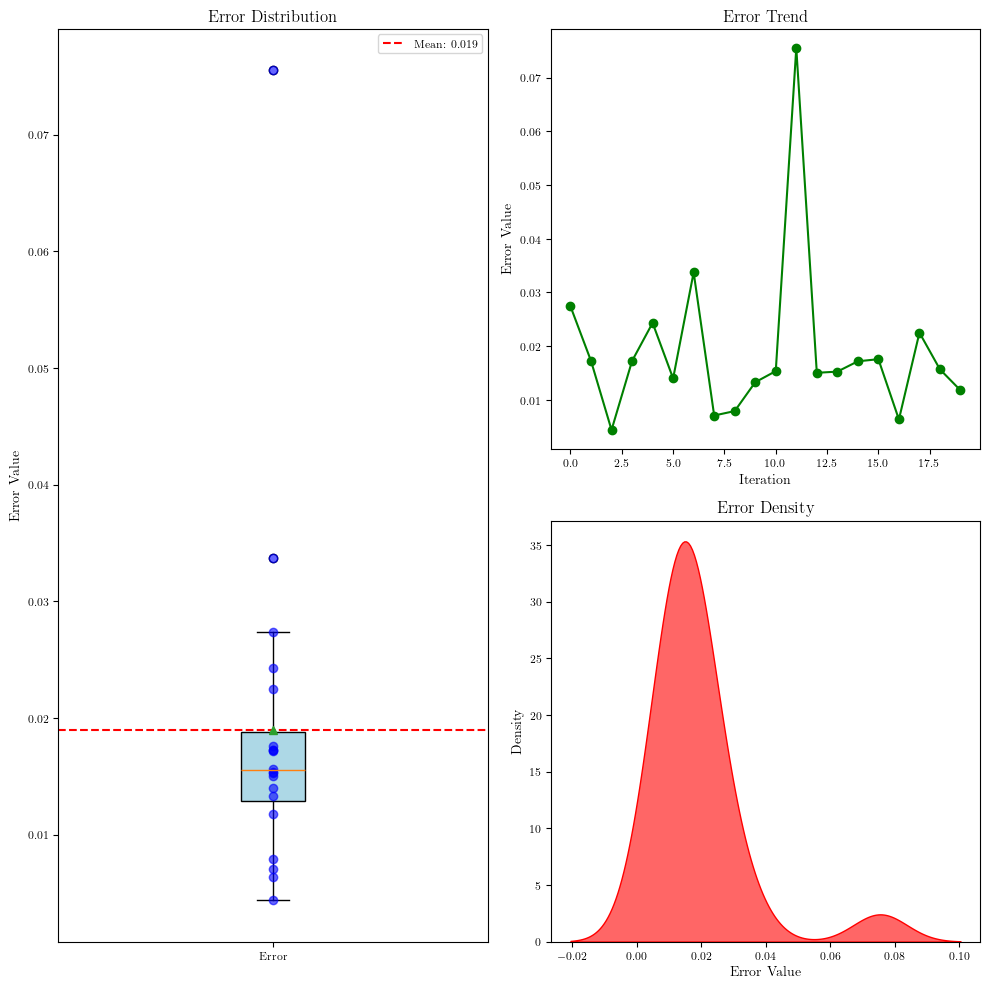

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # 导入seaborn库用于绘制密度图

# error = [0.5947221810612215, 0.7854634881268653, 1.0077722585678006, 0.5954742844285305, 0.4649590589316285, 0.41386083036181925, 0.6378457066743762, 0.6927021776896086, 0.44767318125257183, 0.28146649498710496, 0.8736713565859818, 0.8516792798779166, 0.37395951530223476, 0.8027823282496178, 0.804560887597274, 0.5182202889333846, 0.18454925778730633, 0.20862581035873265, 0.3739223144578929, 0.528249522241707]

plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列
mean_error = np.mean(error)
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

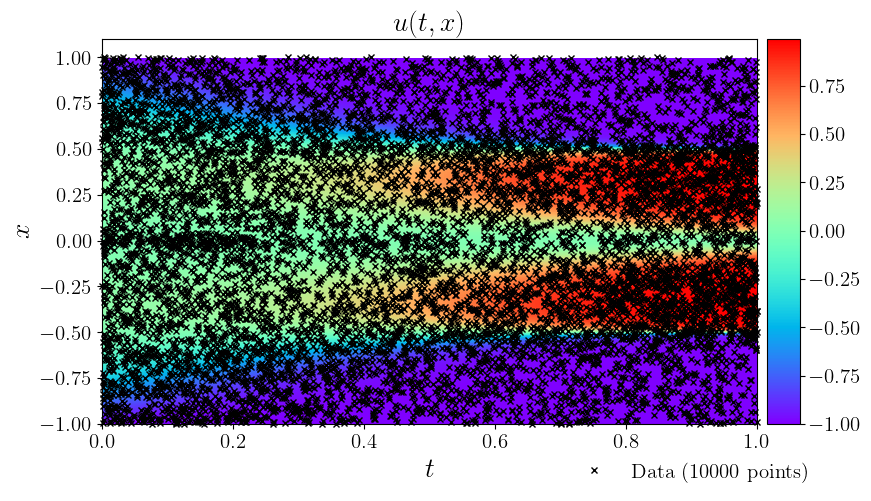

In [11]:
# data = scipy.io.loadmat('../data/AC.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['tt'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
# u_star = Exact.flatten()[:,None]   #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组     
# # X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')
U_star = griddata(X_star, u_star.flatten(), (X, T), method='cubic')

###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_star.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


#在图上绘制散点图
ax.plot(
    X_f[:,1], 
    X_f[:,0], 
    'kx', label = 'Data (%d points)' % (X_f.shape[0]), 
    markersize = 4,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

In [12]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()


testerror = torch.stack(model.test_error).cpu().detach().numpy()

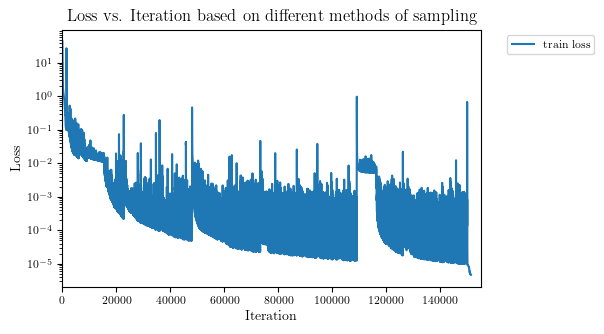

In [13]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,155000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

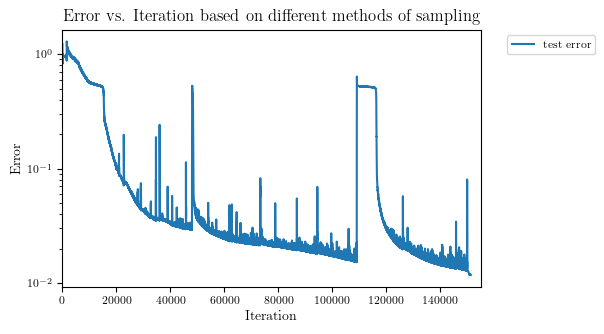

In [14]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
# labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(testerror, label='test error')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,155000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Error') # 设置y轴的标签
plt.title('Error vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


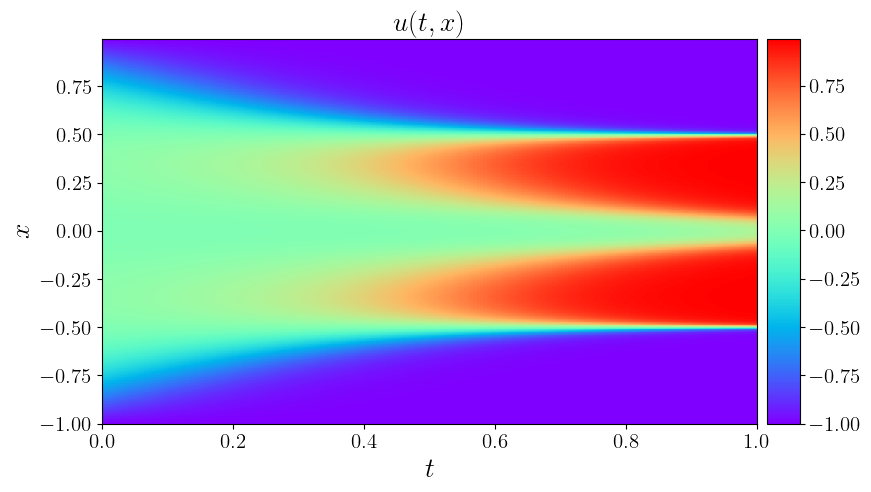

In [15]:
# data = scipy.io.loadmat('../../data/burgers_shock.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['t'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


# #在图上绘制散点图
# ax.plot(
#     X_f_train[:,1], 
#     X_f_train[:,0], 
#     'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
#     markersize = 4,  # marker size doubled
#     clip_on = False,
#     alpha=1.0
# ) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
#   #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

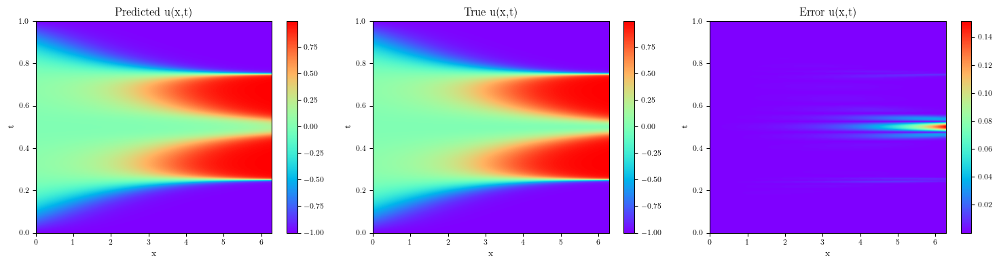

In [16]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_pred.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_star.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 绘制第三幅图像
axes[2].imshow(np.abs(U_pred - U_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()